<a href="https://colab.research.google.com/github/nicolycosta/SARIMA_vs_REDES_NEURAIS/blob/main/Redes_Neurais_Perceptron_Multicamadas_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Esse código será usado para procurar os melhores parâmetros da rede neural para cada um dos segmentos

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import random
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
import math

O arquivo baixado possui as séries temporais de segmentos econômicos e na última coluna tem a série temporal do ICMS total. Importante lembrar que a série temporal do ICMS foi dividido em segmento econômicos, ou seja, a **soma dos segmentos econômicos é igual a série do ICMS**

São 18 segmentos econômicos, porém um dos segmentos "Comércio" tem dois subsegmentos, neste trabalho será usado apenas esses dois subsegmentos(comércio varejista e comércio Atacadista), sendo assim 19 segmentos econômicos.

# Baixando arquivo

In [3]:
# Carregar o arquivo Excel
serie = pd.read_excel("seguimento_economico.xlsx")

# Converter a coluna 'date' para datetime
serie['date'] = pd.to_datetime(serie['date'])

# Definir a coluna 'date' como índice
serie = serie.set_index('date')

# Visualizar os primeiros dados
print(serie.head())

            Agricultura, Pecuária, Produção Florestal, Pesca e Aquicultura  \
date                                                                         
2017-04-01                                         8328942.00                
2017-05-01                                         9588393.77                
2017-06-01                                         9204288.11                
2017-07-01                                         9215243.14                
2017-08-01                                         7158261.49                

            Alojamento e Alimentação      Bebidas      Cigarro     Cimento  \
date                                                                         
2017-04-01                3976555.00  49033316.00  10334307.00  2675996.00   
2017-05-01                4097032.62  39522214.87   9865499.26  2419874.08   
2017-06-01                3805831.89  53472805.74  10486474.18  2308059.47   
2017-07-01                3806509.47  53421789.55   8074279.56 

# Separando em dados de treino e teste

In [4]:
# Determinar o número total de amostras na série temporal
nSamples = len(serie)

# Definir o número de amostras de teste
nTestSamples = 6

# Calcular o número de amostras para o modelo (dados de treinamento)
nModelSamples = nSamples - nTestSamples

# Separar os dados de treinamento (modelo) dos dados de teste
ZtModel = serie.iloc[:nModelSamples]
ZtTest = serie.iloc[nModelSamples:]

print(f'Número de amostras: {nSamples}')
print(f'Número de amostras para modelagem: {nModelSamples}')
print(f'Número de amostras para teste: {nTestSamples}')
print(f'Os dados de modelagem começam em {ZtModel.index[0].year}-{ZtModel.index[0].month}-{ZtModel.index[0].day} e terminam em {ZtModel.index[nModelSamples - 1].year}-{ZtModel.index[nModelSamples - 1].month}-{ZtModel.index[nModelSamples - 1].day}.')
print(f'Os dados de teste começam em {ZtTest.index[0].year}-{ZtTest.index[0].month}-{ZtTest.index[0].day} e terminam em {ZtTest.index[nTestSamples - 1].year}-{ZtTest.index[nTestSamples - 1].month}-{ZtTest.index[nTestSamples - 1].day}.')

Número de amostras: 81
Número de amostras para modelagem: 75
Número de amostras para teste: 6
Os dados de modelagem começam em 2017-4-1 e terminam em 2023-6-1.
Os dados de teste começam em 2023-7-1 e terminam em 2023-12-1.


# CAP3 - Normalização

In [5]:
# Normalizar cada coluna separadamente e manter os nomes das colunas e índices
# Criar uma cópia dos dados de treinamento para normalização
serienorm = ZtModel.copy()

# Loop para normalizar cada coluna individualmente
for coluna in range(20):
    # Calcular a média e o desvio padrão da coluna
    media = ZtModel.iloc[:, coluna].mean()
    desvio_padrao = ZtModel.iloc[:, coluna].std()

    # Salvar as médias e desvios padrão dinamicamente
    exec(f"media{coluna} = media")
    exec(f"desvio_padrao{coluna} = desvio_padrao")

    # Normalizar cada valor da coluna
    j = 0
    for i in ZtModel.iloc[:, coluna]:
        a = (i - media) / desvio_padrao
        serienorm.iloc[:, coluna][j] = a
        j = j + 1

<ipython-input-5-e1136e6a6308>:19: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  serienorm.iloc[:, coluna][j] = a
<ipython-input-5-e1136e6a6308>:19: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  serienorm.iloc[:, coluna][j] = a
<ipython-input-5-e1136e6a6308>:19: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  serienorm.iloc[:, coluna][j] = a
<ipython-input-5-e1136e6a6308>:19: FutureWarning: Series.__setitem__ treating k

Agora 'serienorm' contém as séries temporais normalizadas mantendo nomes das colunas e índices

In [6]:
# usados futuramente para desnormalização
medias = [media0, media1, media2, media3, media4, media5, media6, media7, media8, media9, media10, media11, media12,
          media13, media14, media15, media16, media17, media18, media19]

desvios_padroes = [desvio_padrao0, desvio_padrao1, desvio_padrao2, desvio_padrao3,
                   desvio_padrao4, desvio_padrao5, desvio_padrao6, desvio_padrao7, desvio_padrao8, desvio_padrao9,
                  desvio_padrao10, desvio_padrao11, desvio_padrao12, desvio_padrao13, desvio_padrao14, desvio_padrao15,
                  desvio_padrao16, desvio_padrao17, desvio_padrao18, desvio_padrao19]

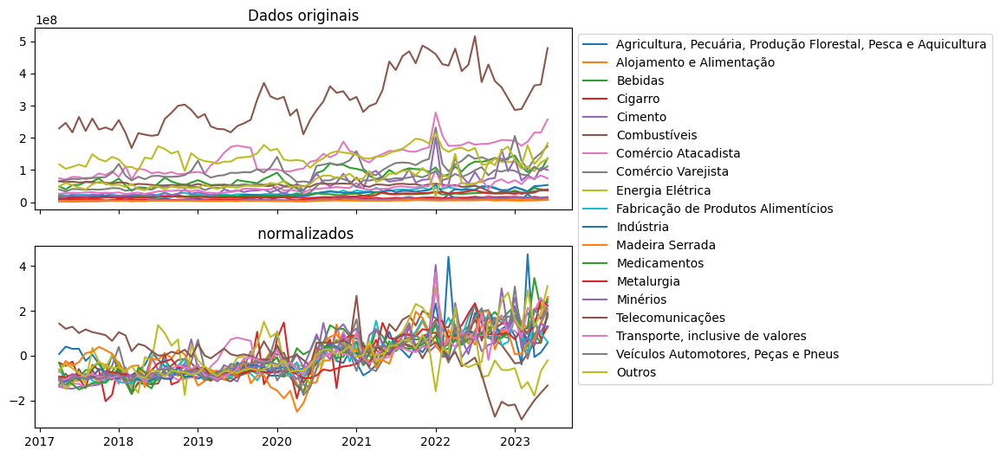

In [7]:
fig, axs = plt.subplots(2, 1, figsize=(8, 6), sharex=True)

# Plotar o primeiro gráfico no primeiro subplot
for coluna in ZtModel.iloc[:, :19]:
    axs[0].plot(ZtModel[coluna], label=coluna)
axs[0].set_title('Dados originais')
axs[0].legend(loc='upper left', bbox_to_anchor=(1, 1))

# Plotar o segundo gráfico no segundo subplot
for coluna in serienorm.iloc[:, :19]:
    axs[1].plot(serienorm[coluna], label=coluna)
axs[1].set_title(' normalizados')

plt.show()

# Dense (criação manual)- Perceptron

In [8]:
import numpy as np
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense
from sklearn.model_selection import train_test_split
from tensorflow.keras.activations import linear, relu, tanh

In [9]:
def prepare_data(df, window_size):
    """
    Prepara a estrutura dos dados de entrada para modelos de aprendizado de máquina com janelas deslizantes.

    Parâmetros:
    df (DataFrame): O DataFrame contendo a série temporal.
    window_size (int): O tamanho da janela deslizante.

    Retorna:
    tuple: Dois arrays numpy, X e Y.
           X contém as janelas de entrada.
           Y contém os valores alvo correspondentes.
    """
    X, Y = [], []

    # Loop sobre o DataFrame para criar janelas de entrada e valores alvo
    for i in range(len(df) - window_size):
        window = df.iloc[i:i+window_size].values  # Extrai uma janela de valores
        target = df.iloc[i+window_size].values  # Extrai o valor alvo correspondente
        X.append(window)  # Adiciona a janela à lista de entradas
        Y.append(target)  # Adiciona o valor alvo à lista de saídas

    return np.array(X), np.array(Y)

In [14]:
def find_best_parameters(X_train, Y_train, X_test, Y_test, activation1, activation2, activation3, dense1, dense2):
    """
    Encontra os melhores parâmetros para um modelo de rede neural testando várias combinações.

    Parâmetros:
    X_train (ndarray): Dados de treinamento de entrada.
    Y_train (ndarray): Dados de treinamento de saída.
    X_test (ndarray): Dados de teste de entrada.
    Y_test (ndarray): Dados de teste de saída.
    activation1 (list): Lista de funções de ativação para a primeira camada densa.
    activation2 (list): Lista de funções de ativação para a segunda camada densa.
    activation3 (list): Lista de funções de ativação para a camada de saída.
    dense1 (list): Lista de tamanhos de neurônios para a primeira camada densa.
    dense2 (list): Lista de tamanhos de neurônios para a segunda camada densa.

    Retorna:
    dict: Dicionário com os melhores parâmetros encontrados.
    """
    best_mae = float('inf')  # Inicializa o melhor MAE com infinito
    best_params = {}

    # Loop por todas as combinações de funções de ativação e tamanhos de camadas densas
    for i in activation1:
        for j in activation2:
            for k in activation3:
                for d1 in dense1:
                    for d2 in dense2:
                        model = Sequential()
                        model.add(tf.keras.Input(shape= (window_size,)))  # Camada de entrada inserida antes da camada atual
                        model.add(Dense(d1, activation=i, input_shape=(X_train.shape[1],)))  # Adicionando camada densa com a primeira ativação e o valor de dense1
                        model.add(Dense(d2, activation=j))
                        model.add(Dense(1, activation=k))  # Camada de saída com 1 neurônio

                        # Compilação do modelo
                        model.compile(optimizer='SGD', loss='mean_squared_error', metrics=['accuracy'])

                        # Treinamento do modelo
                        model.fit(X_train, Y_train, epochs=500, batch_size=32, validation_split=0.1)

                        # Avaliação do modelo
                        loss, mae = model.evaluate(X_test, Y_test)
                        print('Mean Absolute Error:', mae)

                        # Atualização dos melhores parâmetros se o MAE atual for menor
                        if mae < best_mae:
                            best_mae = mae
                            best_params = {
                                'activation1': i.__name__,
                                'activation2': j.__name__,
                                'activation3': k.__name__,
                                'dense1': d1,
                                'dense2': d2
                            }
                            print(best_params)

    return best_params

In [11]:
# as funções de ativações que serão testadas em todos os segmentos
activation1 = {relu, tanh, linear}
activation2 = {relu, tanh, linear}
activation3 = {relu, tanh, linear}
dense1 = [10,30]
dense2 = [10,30]

In [12]:
# Aqui serão armazenadas os melhores parâmetros para todas as séries
best_params_dict_0 = {}
best_params_dict_1 = {}
best_params_dict_2 = {}
best_params_dict_3 = {}
best_params_dict_4 = {}
best_params_dict_5 = {}
best_params_dict_6 = {}
best_params_dict_7 = {}
best_params_dict_8 = {}
best_params_dict_9 = {}
best_params_dict_10 = {}
best_params_dict_11 = {}
best_params_dict_12 = {}
best_params_dict_13 = {}
best_params_dict_14 = {}
best_params_dict_15 = {}
best_params_dict_16 = {}
best_params_dict_17 = {}
best_params_dict_18 = {}
best_params_dict_19 = {}
best_params_dict_20 = {}
dicts = [best_params_dict_0, best_params_dict_1, best_params_dict_2, best_params_dict_3, best_params_dict_4,
         best_params_dict_5, best_params_dict_6, best_params_dict_7, best_params_dict_8, best_params_dict_9,
         best_params_dict_10, best_params_dict_11, best_params_dict_12, best_params_dict_13, best_params_dict_14,
         best_params_dict_15, best_params_dict_16, best_params_dict_17, best_params_dict_18, best_params_dict_19,
         best_params_dict_20]

window_size parâmetro da rede neural, define o tamanho da janela deslizante de dados usada para criar as entradas do modelo. Especificamente, window_size = 12 significa que cada entrada para a rede neural consistirá de 12 pontos consecutivos da série temporal.

In [13]:
window_size = 12

Será feita a escolha dos melhores parâmetros, modelagem e previsão para cada um dos segmentos individualmente.

## 1 - Agricultura, Pecuária, Produção Florestal, Pesca e Aquicultura

In [15]:
# Aqui está sendo feito o teste dos melhores parâmertros para esse segmento específico

for i in range(0, 1): #usando a primeira série temporal
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna da série temporal (normalizada)
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1 ,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_0[f'best_params_{i}'] = best_params

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/5
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.0000e+00 - loss: 0.6165 - val_accuracy: 0.0000e+00 - val_loss: 3.5737
Epoch 2/5
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.0000e+00 - loss: 0.5473 - val_accuracy: 0.0000e+00 - val_loss: 3.6146
Epoch 3/5
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - accuracy: 0.0000e+00 - loss: 0.5204 - val_accuracy: 0.0000e+00 - val_loss: 3.6494
Epoch 4/5
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.0000e+00 - loss: 0.4593 - val_accuracy: 0.0000e+00 - val_loss: 3.6821
Epoch 5/5
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - accuracy: 0.0000e+00 - loss: 0.4379 - val_accuracy: 0.0000e+00 - val_loss: 3.7072
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - accuracy: 0.0000e+00 - loss: 2.0589
Mean Absolute Error: 0.0
{'activation1': 'relu', 'activation2': 'relu', 'activation3': 'relu', 'dense1': 10, 'dense2': 10}
Epoch 1/5
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 987ms/step - accuracy: 0.0000e+00 - loss: 0.4611 - val_accuracy: 0.0000e+00 - val_loss: 4.2114
Epoch 2/5

## 2 - Alojamento e Alimentação

In [ ]:
window_size = 12
for i in range(1, 2):
    ZtModelIterado = serienorm.iloc[:, i:i+1]
    X, Y = prepare_data(ZtModelIterado, window_size)
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)

    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    best_params_dict_1[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 1s 257ms/step - loss: 1.3783 - mae: 1.0456 - val_loss: 1.7874 - val_mae: 1.2695
Epoch 2/100
2/2 [==============================] - 0s 59ms/step - loss: 1.3088 - mae: 1.0155 - val_loss: 1.7259 - val_mae: 1.2447
Epoch 3/100
2/2 [==============================] - 0s 62ms/step - loss: 1.2429 - mae: 0.9841 - val_loss: 1.6634 - val_mae: 1.2188
Epoch 4/100
2/2 [==============================] - 0s 50ms/step - loss: 1.1762 - mae: 0.9537 - val_loss: 1.5998 - val_mae: 1.1918
Epoch 5/100
2/2 [==============================] - 0s 49ms/step - loss: 1.1122 - mae: 0.9207 - val_loss: 1.5351 - val_mae: 1.1638
Epoch 6/100
2/2 [==============================] - 0s 49ms/step - loss: 1.0440 - mae: 0.8887 - val_loss: 1.4716 - val_mae: 1.1355
Epoch 7/100
2/2 [==============================] - 0s 53ms/step - loss: 0.9842 - mae: 0.8560 - val_loss: 1.4064 - val_mae: 1.1059
Epoch 8/100
2/2 [==============================] - 0s 50ms/step - loss: 0.9239 - mae: 0.8

2/2 [==============================] - 0s 58ms/step - loss: 0.1808 - mae: 0.3143 - val_loss: 0.2255 - val_mae: 0.3857
Epoch 25/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1785 - mae: 0.3124 - val_loss: 0.2246 - val_mae: 0.3857
Epoch 26/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1755 - mae: 0.3099 - val_loss: 0.2233 - val_mae: 0.3855
Epoch 27/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1732 - mae: 0.3083 - val_loss: 0.2217 - val_mae: 0.3851
Epoch 28/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1703 - mae: 0.3066 - val_loss: 0.2208 - val_mae: 0.3851
Epoch 29/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1679 - mae: 0.3050 - val_loss: 0.2209 - val_mae: 0.3855
Epoch 30/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1663 - mae: 0.3043 - val_loss: 0.2217 - val_mae: 0.3863
Epoch 31/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1634 - mae: 0.3028 - 

2/2 [==============================] - 0s 47ms/step - loss: 0.1735 - mae: 0.3143 - val_loss: 0.2295 - val_mae: 0.3758
Epoch 48/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1705 - mae: 0.3100 - val_loss: 0.2235 - val_mae: 0.3722
Epoch 49/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1671 - mae: 0.3057 - val_loss: 0.2184 - val_mae: 0.3689
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1640 - mae: 0.3019 - val_loss: 0.2139 - val_mae: 0.3656
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1617 - mae: 0.2985 - val_loss: 0.2099 - val_mae: 0.3622
Epoch 52/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1589 - mae: 0.2953 - val_loss: 0.2057 - val_mae: 0.3585
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1563 - mae: 0.2923 - val_loss: 0.2016 - val_mae: 0.3549
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1539 - mae: 0.2895 - 

Epoch 9/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4447 - mae: 0.4665 - val_loss: 0.2210 - val_mae: 0.3986
Epoch 10/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4261 - mae: 0.4546 - val_loss: 0.2142 - val_mae: 0.3987
Epoch 11/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4072 - mae: 0.4413 - val_loss: 0.2102 - val_mae: 0.3995
Epoch 12/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3843 - mae: 0.4262 - val_loss: 0.2086 - val_mae: 0.4008
Epoch 13/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3650 - mae: 0.4114 - val_loss: 0.2087 - val_mae: 0.4024
Epoch 14/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3446 - mae: 0.4013 - val_loss: 0.2106 - val_mae: 0.4041
Epoch 15/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3260 - mae: 0.3941 - val_loss: 0.2150 - val_mae: 0.4060
Epoch 16/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3124 - ma

2/2 [==============================] - 0s 56ms/step - loss: 0.6033 - mae: 0.6645 - val_loss: 0.6469 - val_mae: 0.6467
Epoch 33/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6019 - mae: 0.6634 - val_loss: 0.6390 - val_mae: 0.6370
Epoch 34/100
2/2 [==============================] - 0s 45ms/step - loss: 0.6009 - mae: 0.6627 - val_loss: 0.6316 - val_mae: 0.6279
Epoch 35/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5998 - mae: 0.6618 - val_loss: 0.6247 - val_mae: 0.6190
Epoch 36/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5988 - mae: 0.6610 - val_loss: 0.6179 - val_mae: 0.6101
Epoch 37/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5976 - mae: 0.6603 - val_loss: 0.6106 - val_mae: 0.6002
Epoch 38/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5957 - mae: 0.6589 - val_loss: 0.6032 - val_mae: 0.5897
Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5939 - mae: 0.6578 - 

2/2 [==============================] - 0s 46ms/step - loss: 0.4681 - mae: 0.5670 - val_loss: 0.1141 - val_mae: 0.2413
Epoch 56/100
2/2 [==============================] - 0s 79ms/step - loss: 0.4670 - mae: 0.5663 - val_loss: 0.1214 - val_mae: 0.2553
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4655 - mae: 0.5657 - val_loss: 0.1294 - val_mae: 0.2681
Epoch 58/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4643 - mae: 0.5650 - val_loss: 0.1379 - val_mae: 0.2799
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4628 - mae: 0.5639 - val_loss: 0.1447 - val_mae: 0.2890
Epoch 60/100
2/2 [==============================] - 0s 88ms/step - loss: 0.4618 - mae: 0.5636 - val_loss: 0.1511 - val_mae: 0.2971
Epoch 61/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4608 - mae: 0.5634 - val_loss: 0.1570 - val_mae: 0.3042
Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4598 - mae: 0.5630 - 

Epoch 17/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4800 - mae: 0.5591 - val_loss: 0.2081 - val_mae: 0.3913
Epoch 18/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4791 - mae: 0.5573 - val_loss: 0.2018 - val_mae: 0.3818
Epoch 19/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4780 - mae: 0.5558 - val_loss: 0.1970 - val_mae: 0.3730
Epoch 20/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4769 - mae: 0.5539 - val_loss: 0.1932 - val_mae: 0.3644
Epoch 21/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4763 - mae: 0.5526 - val_loss: 0.1909 - val_mae: 0.3568
Epoch 22/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4754 - mae: 0.5498 - val_loss: 0.1898 - val_mae: 0.3501
Epoch 23/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4752 - mae: 0.5486 - val_loss: 0.1899 - val_mae: 0.3460
Epoch 24/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4750 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.5104 - mae: 0.5901 - val_loss: 0.2280 - val_mae: 0.3849
Epoch 41/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5101 - mae: 0.5899 - val_loss: 0.2278 - val_mae: 0.3848
Epoch 42/100
2/2 [==============================] - 0s 78ms/step - loss: 0.5097 - mae: 0.5897 - val_loss: 0.2274 - val_mae: 0.3847
Epoch 43/100
2/2 [==============================] - 0s 59ms/step - loss: 0.5094 - mae: 0.5895 - val_loss: 0.2267 - val_mae: 0.3850
Epoch 44/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5092 - mae: 0.5892 - val_loss: 0.2260 - val_mae: 0.3852
Epoch 45/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5089 - mae: 0.5890 - val_loss: 0.2253 - val_mae: 0.3853
Epoch 46/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5086 - mae: 0.5887 - val_loss: 0.2248 - val_mae: 0.3852
Epoch 47/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5084 - mae: 0.5886 - 

Epoch 2/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5111 - mae: 0.5882 - val_loss: 1.3513 - val_mae: 1.1256
Epoch 3/100
2/2 [==============================] - 0s 93ms/step - loss: 0.4706 - mae: 0.5542 - val_loss: 1.2641 - val_mae: 1.0859
Epoch 4/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4427 - mae: 0.5286 - val_loss: 1.1804 - val_mae: 1.0464
Epoch 5/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4129 - mae: 0.5000 - val_loss: 1.1000 - val_mae: 1.0070
Epoch 6/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3939 - mae: 0.4803 - val_loss: 1.0242 - val_mae: 0.9682
Epoch 7/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3765 - mae: 0.4625 - val_loss: 0.9551 - val_mae: 0.9313
Epoch 8/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3607 - mae: 0.4491 - val_loss: 0.8920 - val_mae: 0.8963
Epoch 9/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3504 - mae: 0.43

Epoch 26/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1554 - mae: 0.2903 - val_loss: 0.1131 - val_mae: 0.2921
Epoch 27/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1515 - mae: 0.2862 - val_loss: 0.1177 - val_mae: 0.2976
Epoch 28/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1476 - mae: 0.2836 - val_loss: 0.1219 - val_mae: 0.3021
Epoch 29/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1450 - mae: 0.2817 - val_loss: 0.1259 - val_mae: 0.3061
Epoch 30/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1413 - mae: 0.2791 - val_loss: 0.1295 - val_mae: 0.3095
Epoch 31/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1388 - mae: 0.2770 - val_loss: 0.1331 - val_mae: 0.3125
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1363 - mae: 0.2749 - val_loss: 0.1356 - val_mae: 0.3147
Epoch 33/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1340 - m

2/2 [==============================] - 0s 63ms/step - loss: 0.0929 - mae: 0.2272 - val_loss: 0.2080 - val_mae: 0.4387
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0918 - mae: 0.2254 - val_loss: 0.2071 - val_mae: 0.4386
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0913 - mae: 0.2249 - val_loss: 0.2065 - val_mae: 0.4385
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0903 - mae: 0.2230 - val_loss: 0.2074 - val_mae: 0.4395
Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0894 - mae: 0.2220 - val_loss: 0.2088 - val_mae: 0.4406
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0885 - mae: 0.2219 - val_loss: 0.2115 - val_mae: 0.4423
Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0882 - mae: 0.2224 - val_loss: 0.2141 - val_mae: 0.4438
Epoch 56/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0874 - mae: 0.2219 - 

Epoch 11/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3719 - mae: 0.4500 - val_loss: 0.3116 - val_mae: 0.3888
Epoch 12/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3699 - mae: 0.4501 - val_loss: 0.2900 - val_mae: 0.3680
Epoch 13/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3699 - mae: 0.4545 - val_loss: 0.2783 - val_mae: 0.3552
Epoch 14/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3644 - mae: 0.4555 - val_loss: 0.2739 - val_mae: 0.3492
Epoch 15/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3492 - mae: 0.4471 - val_loss: 0.2779 - val_mae: 0.3506
Epoch 16/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3301 - mae: 0.4309 - val_loss: 0.2878 - val_mae: 0.3570
Epoch 17/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3068 - mae: 0.4107 - val_loss: 0.3004 - val_mae: 0.3753
Epoch 18/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2847 - m

Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2780 - mae: 0.3877 - val_loss: 0.2804 - val_mae: 0.3965
Epoch 36/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2739 - mae: 0.3842 - val_loss: 0.2784 - val_mae: 0.3954
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2680 - mae: 0.3801 - val_loss: 0.2764 - val_mae: 0.3944
Epoch 38/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2642 - mae: 0.3773 - val_loss: 0.2745 - val_mae: 0.3935
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2595 - mae: 0.3740 - val_loss: 0.2728 - val_mae: 0.3926
Epoch 40/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2551 - mae: 0.3704 - val_loss: 0.2714 - val_mae: 0.3918
Epoch 41/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2501 - mae: 0.3668 - val_loss: 0.2703 - val_mae: 0.3911
Epoch 42/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2461 - m

Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1122 - mae: 0.2546 - val_loss: 0.1634 - val_mae: 0.3048
Epoch 60/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1107 - mae: 0.2525 - val_loss: 0.1621 - val_mae: 0.3066
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1094 - mae: 0.2508 - val_loss: 0.1610 - val_mae: 0.3082
Epoch 62/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1080 - mae: 0.2490 - val_loss: 0.1599 - val_mae: 0.3098
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1067 - mae: 0.2470 - val_loss: 0.1591 - val_mae: 0.3111
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1056 - mae: 0.2452 - val_loss: 0.1583 - val_mae: 0.3123
Epoch 65/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1043 - mae: 0.2431 - val_loss: 0.1576 - val_mae: 0.3134
Epoch 66/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1029 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0676 - mae: 0.1907 - val_loss: 0.1708 - val_mae: 0.3754
Epoch 83/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0675 - mae: 0.1920 - val_loss: 0.1706 - val_mae: 0.3760
Epoch 84/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0673 - mae: 0.1919 - val_loss: 0.1704 - val_mae: 0.3764
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0668 - mae: 0.1911 - val_loss: 0.1703 - val_mae: 0.3768
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0659 - mae: 0.1892 - val_loss: 0.1701 - val_mae: 0.3770
Epoch 87/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0653 - mae: 0.1875 - val_loss: 0.1699 - val_mae: 0.3772
Epoch 88/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0651 - mae: 0.1855 - val_loss: 0.1697 - val_mae: 0.3774
Epoch 89/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0643 - mae: 0.1834 - 

Epoch 44/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0927 - mae: 0.2285 - val_loss: 0.1676 - val_mae: 0.3713
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0914 - mae: 0.2265 - val_loss: 0.1682 - val_mae: 0.3715
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0903 - mae: 0.2251 - val_loss: 0.1687 - val_mae: 0.3719
Epoch 47/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0894 - mae: 0.2236 - val_loss: 0.1692 - val_mae: 0.3722
Epoch 48/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0886 - mae: 0.2222 - val_loss: 0.1696 - val_mae: 0.3724
Epoch 49/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0877 - mae: 0.2213 - val_loss: 0.1701 - val_mae: 0.3726
Epoch 50/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0869 - mae: 0.2197 - val_loss: 0.1705 - val_mae: 0.3728
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0857 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.4912 - mae: 0.5890 - val_loss: 0.2323 - val_mae: 0.4526
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4892 - mae: 0.5874 - val_loss: 0.2355 - val_mae: 0.4578
Epoch 69/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4872 - mae: 0.5853 - val_loss: 0.2393 - val_mae: 0.4630
Epoch 70/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4855 - mae: 0.5839 - val_loss: 0.2438 - val_mae: 0.4682
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4835 - mae: 0.5819 - val_loss: 0.2487 - val_mae: 0.4731
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4818 - mae: 0.5799 - val_loss: 0.2542 - val_mae: 0.4780
Epoch 73/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4802 - mae: 0.5784 - val_loss: 0.2598 - val_mae: 0.4826
Epoch 74/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4784 - mae: 0.5767 - 

2/2 [==============================] - 0s 51ms/step - loss: 0.4786 - mae: 0.5841 - val_loss: 0.2554 - val_mae: 0.4572
Epoch 29/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4773 - mae: 0.5829 - val_loss: 0.2538 - val_mae: 0.4560
Epoch 30/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4760 - mae: 0.5814 - val_loss: 0.2545 - val_mae: 0.4553
Epoch 31/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4749 - mae: 0.5799 - val_loss: 0.2578 - val_mae: 0.4552
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4739 - mae: 0.5780 - val_loss: 0.2624 - val_mae: 0.4554
Epoch 33/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4729 - mae: 0.5766 - val_loss: 0.2675 - val_mae: 0.4557
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4720 - mae: 0.5753 - val_loss: 0.2726 - val_mae: 0.4559
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4713 - mae: 0.5743 - 

Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4720 - mae: 0.5416 - val_loss: 0.1506 - val_mae: 0.2925
Epoch 53/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4718 - mae: 0.5410 - val_loss: 0.1499 - val_mae: 0.2922
Epoch 54/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4716 - mae: 0.5406 - val_loss: 0.1492 - val_mae: 0.2917
Epoch 55/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4714 - mae: 0.5400 - val_loss: 0.1485 - val_mae: 0.2910
Epoch 56/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4712 - mae: 0.5394 - val_loss: 0.1479 - val_mae: 0.2902
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4711 - mae: 0.5389 - val_loss: 0.1471 - val_mae: 0.2892
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4709 - mae: 0.5382 - val_loss: 0.1465 - val_mae: 0.2879
Epoch 59/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4708 - m

2/2 [==============================] - 0s 46ms/step - loss: 0.4425 - mae: 0.5281 - val_loss: 0.2455 - val_mae: 0.4811
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4424 - mae: 0.5276 - val_loss: 0.2482 - val_mae: 0.4836
Epoch 77/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4423 - mae: 0.5272 - val_loss: 0.2503 - val_mae: 0.4856
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4421 - mae: 0.5266 - val_loss: 0.2513 - val_mae: 0.4868
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4420 - mae: 0.5262 - val_loss: 0.2518 - val_mae: 0.4874
Epoch 80/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4418 - mae: 0.5259 - val_loss: 0.2516 - val_mae: 0.4877
Epoch 81/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4417 - mae: 0.5259 - val_loss: 0.2521 - val_mae: 0.4886
Epoch 82/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4417 - mae: 0.5259 - 

Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3138 - mae: 0.4169 - val_loss: 0.2902 - val_mae: 0.3615
Epoch 38/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3114 - mae: 0.4128 - val_loss: 0.2857 - val_mae: 0.3601
Epoch 39/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3088 - mae: 0.4094 - val_loss: 0.2817 - val_mae: 0.3587
Epoch 40/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3071 - mae: 0.4069 - val_loss: 0.2781 - val_mae: 0.3576
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3044 - mae: 0.4039 - val_loss: 0.2757 - val_mae: 0.3567
Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3020 - mae: 0.4019 - val_loss: 0.2733 - val_mae: 0.3559
Epoch 43/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2992 - mae: 0.4001 - val_loss: 0.2708 - val_mae: 0.3551
Epoch 44/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2970 - m

Epoch 61/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1045 - mae: 0.2534 - val_loss: 0.2103 - val_mae: 0.3224
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1036 - mae: 0.2523 - val_loss: 0.2078 - val_mae: 0.3211
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1027 - mae: 0.2517 - val_loss: 0.2047 - val_mae: 0.3195
Epoch 64/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1018 - mae: 0.2504 - val_loss: 0.2016 - val_mae: 0.3177
Epoch 65/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1009 - mae: 0.2493 - val_loss: 0.1987 - val_mae: 0.3162
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0999 - mae: 0.2478 - val_loss: 0.1955 - val_mae: 0.3146
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0991 - mae: 0.2467 - val_loss: 0.1926 - val_mae: 0.3129
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0980 - m

2/2 [==============================] - 0s 81ms/step - loss: 0.0527 - mae: 0.1760 - val_loss: 0.3763 - val_mae: 0.5111
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0523 - mae: 0.1753 - val_loss: 0.3778 - val_mae: 0.5120
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0516 - mae: 0.1738 - val_loss: 0.3801 - val_mae: 0.5134
Epoch 87/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0510 - mae: 0.1726 - val_loss: 0.3834 - val_mae: 0.5153
Epoch 88/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0514 - mae: 0.1728 - val_loss: 0.3874 - val_mae: 0.5178
Epoch 89/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0508 - mae: 0.1712 - val_loss: 0.3921 - val_mae: 0.5208
Epoch 90/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0504 - mae: 0.1705 - val_loss: 0.3967 - val_mae: 0.5238
Epoch 91/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0498 - mae: 0.1695 - 

2/2 [==============================] - 0s 46ms/step - loss: 0.0550 - mae: 0.1720 - val_loss: 0.1956 - val_mae: 0.4028
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0536 - mae: 0.1695 - val_loss: 0.2001 - val_mae: 0.4054
Epoch 47/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0526 - mae: 0.1672 - val_loss: 0.2047 - val_mae: 0.4078
Epoch 48/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0524 - mae: 0.1673 - val_loss: 0.2091 - val_mae: 0.4103
Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0525 - mae: 0.1679 - val_loss: 0.2132 - val_mae: 0.4126
Epoch 50/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0516 - mae: 0.1663 - val_loss: 0.2168 - val_mae: 0.4153
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0499 - mae: 0.1638 - val_loss: 0.2203 - val_mae: 0.4186
Epoch 52/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0495 - mae: 0.1635 - 

Epoch 7/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3806 - mae: 0.4648 - val_loss: 0.5316 - val_mae: 0.5638
Epoch 8/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3631 - mae: 0.4482 - val_loss: 0.5010 - val_mae: 0.5482
Epoch 9/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3499 - mae: 0.4341 - val_loss: 0.4725 - val_mae: 0.5331
Epoch 10/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3373 - mae: 0.4210 - val_loss: 0.4479 - val_mae: 0.5198
Epoch 11/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3231 - mae: 0.4090 - val_loss: 0.4276 - val_mae: 0.5091
Epoch 12/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3135 - mae: 0.3994 - val_loss: 0.4087 - val_mae: 0.4989
Epoch 13/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3001 - mae: 0.3893 - val_loss: 0.3917 - val_mae: 0.4893
Epoch 14/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2899 - mae:

Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1802 - mae: 0.3165 - val_loss: 0.1826 - val_mae: 0.2955
Epoch 32/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1761 - mae: 0.3141 - val_loss: 0.1782 - val_mae: 0.2932
Epoch 33/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1726 - mae: 0.3113 - val_loss: 0.1740 - val_mae: 0.2910
Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1693 - mae: 0.3086 - val_loss: 0.1698 - val_mae: 0.2888
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1669 - mae: 0.3065 - val_loss: 0.1660 - val_mae: 0.2896
Epoch 36/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1640 - mae: 0.3035 - val_loss: 0.1626 - val_mae: 0.2906
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1615 - mae: 0.3012 - val_loss: 0.1594 - val_mae: 0.2918
Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1586 - m

Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1071 - mae: 0.2339 - val_loss: 0.2034 - val_mae: 0.4389
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1069 - mae: 0.2337 - val_loss: 0.1994 - val_mae: 0.4353
Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1063 - mae: 0.2329 - val_loss: 0.1978 - val_mae: 0.4340
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1052 - mae: 0.2320 - val_loss: 0.1951 - val_mae: 0.4313
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1051 - mae: 0.2320 - val_loss: 0.1930 - val_mae: 0.4291
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1041 - mae: 0.2309 - val_loss: 0.1925 - val_mae: 0.4286
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1034 - mae: 0.2297 - val_loss: 0.1912 - val_mae: 0.4271
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1027 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.0885 - mae: 0.2185 - val_loss: 0.1898 - val_mae: 0.4005
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0882 - mae: 0.2176 - val_loss: 0.1904 - val_mae: 0.4011
Epoch 80/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0878 - mae: 0.2173 - val_loss: 0.1914 - val_mae: 0.4015
Epoch 81/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0872 - mae: 0.2171 - val_loss: 0.1919 - val_mae: 0.4016
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0865 - mae: 0.2160 - val_loss: 0.1921 - val_mae: 0.4020
Epoch 83/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0862 - mae: 0.2156 - val_loss: 0.1925 - val_mae: 0.4026
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0856 - mae: 0.2152 - val_loss: 0.1936 - val_mae: 0.4034
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0852 - mae: 0.2153 - 

Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5248 - mae: 0.6218 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5240 - mae: 0.6211 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5233 - mae: 0.6203 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 43/100
2/2 [==============================] - 0s 77ms/step - loss: 0.5222 - mae: 0.6194 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5216 - mae: 0.6188 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 45/100
2/2 [==============================] - 0s 69ms/step - loss: 0.5205 - mae: 0.6177 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 46/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5195 - mae: 0.6168 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 47/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5187 - m

Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5128 - mae: 0.5904 - val_loss: 0.6499 - val_mae: 0.7084
Epoch 65/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5118 - mae: 0.5892 - val_loss: 0.6695 - val_mae: 0.7178
Epoch 66/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5111 - mae: 0.5879 - val_loss: 0.6898 - val_mae: 0.7272
Epoch 67/100
2/2 [==============================] - 0s 79ms/step - loss: 0.5107 - mae: 0.5872 - val_loss: 0.7109 - val_mae: 0.7367
Epoch 68/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5101 - mae: 0.5869 - val_loss: 0.7303 - val_mae: 0.7453
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5095 - mae: 0.5865 - val_loss: 0.7463 - val_mae: 0.7524
Epoch 70/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5093 - mae: 0.5863 - val_loss: 0.7598 - val_mae: 0.7584
Epoch 71/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5088 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.5561 - mae: 0.6386 - val_loss: 0.7581 - val_mae: 0.7707
Epoch 88/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5559 - mae: 0.6384 - val_loss: 0.7583 - val_mae: 0.7710
Epoch 89/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5558 - mae: 0.6383 - val_loss: 0.7585 - val_mae: 0.7714
Epoch 90/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5556 - mae: 0.6381 - val_loss: 0.7582 - val_mae: 0.7716
Epoch 91/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5555 - mae: 0.6379 - val_loss: 0.7593 - val_mae: 0.7725
Epoch 92/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5553 - mae: 0.6378 - val_loss: 0.7596 - val_mae: 0.7729
Epoch 93/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5551 - mae: 0.6375 - val_loss: 0.7619 - val_mae: 0.7742
Epoch 94/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5549 - mae: 0.6373 - 

Epoch 49/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4966 - mae: 0.5703 - val_loss: 0.8038 - val_mae: 0.8016
Epoch 50/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4962 - mae: 0.5699 - val_loss: 0.8171 - val_mae: 0.8075
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4959 - mae: 0.5696 - val_loss: 0.8304 - val_mae: 0.8131
Epoch 52/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4956 - mae: 0.5687 - val_loss: 0.8416 - val_mae: 0.8176
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4955 - mae: 0.5688 - val_loss: 0.8513 - val_mae: 0.8212
Epoch 54/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4954 - mae: 0.5684 - val_loss: 0.8564 - val_mae: 0.8224
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4952 - mae: 0.5677 - val_loss: 0.8564 - val_mae: 0.8211
Epoch 56/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4950 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1980 - mae: 0.3209 - val_loss: 0.0972 - val_mae: 0.2695
Epoch 73/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1965 - mae: 0.3204 - val_loss: 0.0975 - val_mae: 0.2702
Epoch 74/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1949 - mae: 0.3206 - val_loss: 0.0977 - val_mae: 0.2708
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1930 - mae: 0.3198 - val_loss: 0.0982 - val_mae: 0.2717
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1916 - mae: 0.3192 - val_loss: 0.0985 - val_mae: 0.2725
Epoch 77/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1903 - mae: 0.3194 - val_loss: 0.0991 - val_mae: 0.2734
Epoch 78/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1889 - mae: 0.3191 - val_loss: 0.1000 - val_mae: 0.2746
Epoch 79/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1874 - mae: 0.3184 - 

Epoch 34/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0980 - mae: 0.2253 - val_loss: 0.3358 - val_mae: 0.4937
Epoch 35/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0966 - mae: 0.2237 - val_loss: 0.3363 - val_mae: 0.4935
Epoch 36/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0956 - mae: 0.2225 - val_loss: 0.3372 - val_mae: 0.4936
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0945 - mae: 0.2207 - val_loss: 0.3368 - val_mae: 0.4927
Epoch 38/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0937 - mae: 0.2204 - val_loss: 0.3353 - val_mae: 0.4912
Epoch 39/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0926 - mae: 0.2193 - val_loss: 0.3338 - val_mae: 0.4897
Epoch 40/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0918 - mae: 0.2187 - val_loss: 0.3326 - val_mae: 0.4884
Epoch 41/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0909 - m

Epoch 58/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0991 - mae: 0.2274 - val_loss: 0.1108 - val_mae: 0.3235
Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0983 - mae: 0.2274 - val_loss: 0.1102 - val_mae: 0.3220
Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0980 - mae: 0.2277 - val_loss: 0.1099 - val_mae: 0.3216
Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0980 - mae: 0.2280 - val_loss: 0.1099 - val_mae: 0.3226
Epoch 62/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0974 - mae: 0.2273 - val_loss: 0.1105 - val_mae: 0.3241
Epoch 63/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0967 - mae: 0.2265 - val_loss: 0.1114 - val_mae: 0.3257
Epoch 64/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0961 - mae: 0.2256 - val_loss: 0.1124 - val_mae: 0.3272
Epoch 65/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0955 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.0768 - mae: 0.1984 - val_loss: 0.1472 - val_mae: 0.3615
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0759 - mae: 0.1998 - val_loss: 0.1490 - val_mae: 0.3640
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0760 - mae: 0.2015 - val_loss: 0.1499 - val_mae: 0.3647
Epoch 84/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0752 - mae: 0.2006 - val_loss: 0.1496 - val_mae: 0.3631
Epoch 85/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0744 - mae: 0.1986 - val_loss: 0.1494 - val_mae: 0.3602
Epoch 86/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0738 - mae: 0.1955 - val_loss: 0.1502 - val_mae: 0.3600
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0743 - mae: 0.1953 - val_loss: 0.1511 - val_mae: 0.3611
Epoch 88/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0732 - mae: 0.1948 - 

Epoch 43/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3293 - mae: 0.4395 - val_loss: 0.2407 - val_mae: 0.3781
Epoch 44/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3225 - mae: 0.4350 - val_loss: 0.2334 - val_mae: 0.3750
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3164 - mae: 0.4310 - val_loss: 0.2270 - val_mae: 0.3722
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3100 - mae: 0.4267 - val_loss: 0.2213 - val_mae: 0.3696
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3039 - mae: 0.4228 - val_loss: 0.2163 - val_mae: 0.3672
Epoch 48/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2991 - mae: 0.4192 - val_loss: 0.2115 - val_mae: 0.3647
Epoch 49/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2930 - mae: 0.4150 - val_loss: 0.2071 - val_mae: 0.3624
Epoch 50/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2880 - m

Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1509 - mae: 0.2882 - val_loss: 0.1972 - val_mae: 0.4005
Epoch 68/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1488 - mae: 0.2864 - val_loss: 0.1971 - val_mae: 0.4005
Epoch 69/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1461 - mae: 0.2846 - val_loss: 0.1969 - val_mae: 0.4005
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1442 - mae: 0.2828 - val_loss: 0.1968 - val_mae: 0.4004
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1417 - mae: 0.2810 - val_loss: 0.1966 - val_mae: 0.4003
Epoch 72/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1398 - mae: 0.2789 - val_loss: 0.1965 - val_mae: 0.4003
Epoch 73/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1375 - mae: 0.2768 - val_loss: 0.1963 - val_mae: 0.4002
Epoch 74/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1354 - m

2/2 [==============================] - 0s 66ms/step - loss: 0.0958 - mae: 0.2165 - val_loss: 0.1846 - val_mae: 0.3782
Epoch 91/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0953 - mae: 0.2161 - val_loss: 0.1847 - val_mae: 0.3782
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0950 - mae: 0.2157 - val_loss: 0.1847 - val_mae: 0.3782
Epoch 93/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0945 - mae: 0.2153 - val_loss: 0.1847 - val_mae: 0.3782
Epoch 94/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0941 - mae: 0.2148 - val_loss: 0.1847 - val_mae: 0.3782
Epoch 95/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0936 - mae: 0.2143 - val_loss: 0.1847 - val_mae: 0.3783
Epoch 96/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0931 - mae: 0.2132 - val_loss: 0.1848 - val_mae: 0.3783
Epoch 97/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0926 - mae: 0.2127 - 

Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0966 - mae: 0.2268 - val_loss: 0.1541 - val_mae: 0.3493
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0954 - mae: 0.2258 - val_loss: 0.1546 - val_mae: 0.3499
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0942 - mae: 0.2250 - val_loss: 0.1551 - val_mae: 0.3505
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0933 - mae: 0.2242 - val_loss: 0.1555 - val_mae: 0.3510
Epoch 56/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0924 - mae: 0.2233 - val_loss: 0.1559 - val_mae: 0.3514
Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0913 - mae: 0.2219 - val_loss: 0.1564 - val_mae: 0.3518
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0901 - mae: 0.2202 - val_loss: 0.1567 - val_mae: 0.3521
Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0890 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.5039 - mae: 0.5809 - val_loss: 0.0427 - val_mae: 0.1906
Epoch 76/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5037 - mae: 0.5806 - val_loss: 0.0425 - val_mae: 0.1899
Epoch 77/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5034 - mae: 0.5803 - val_loss: 0.0422 - val_mae: 0.1890
Epoch 78/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5032 - mae: 0.5801 - val_loss: 0.0418 - val_mae: 0.1880
Epoch 79/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5030 - mae: 0.5798 - val_loss: 0.0414 - val_mae: 0.1871
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5027 - mae: 0.5794 - val_loss: 0.0411 - val_mae: 0.1864
Epoch 81/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5025 - mae: 0.5792 - val_loss: 0.0408 - val_mae: 0.1856
Epoch 82/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5023 - mae: 0.5789 - 

Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6007 - mae: 0.6482 - val_loss: 0.4338 - val_mae: 0.4822
Epoch 38/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6007 - mae: 0.6483 - val_loss: 0.4334 - val_mae: 0.4820
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6007 - mae: 0.6483 - val_loss: 0.4334 - val_mae: 0.4820
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6007 - mae: 0.6483 - val_loss: 0.4336 - val_mae: 0.4822
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6007 - mae: 0.6483 - val_loss: 0.4341 - val_mae: 0.4825
Epoch 42/100
2/2 [==============================] - 0s 46ms/step - loss: 0.6007 - mae: 0.6482 - val_loss: 0.4347 - val_mae: 0.4829
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6007 - mae: 0.6482 - val_loss: 0.4354 - val_mae: 0.4834
Epoch 44/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6007 - m

Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4720 - mae: 0.5306 - val_loss: 0.6610 - val_mae: 0.7371
Epoch 62/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4720 - mae: 0.5302 - val_loss: 0.6600 - val_mae: 0.7367
Epoch 63/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4720 - mae: 0.5301 - val_loss: 0.6593 - val_mae: 0.7365
Epoch 64/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4720 - mae: 0.5298 - val_loss: 0.6582 - val_mae: 0.7361
Epoch 65/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4719 - mae: 0.5296 - val_loss: 0.6579 - val_mae: 0.7359
Epoch 66/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4719 - mae: 0.5293 - val_loss: 0.6577 - val_mae: 0.7355
Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4719 - mae: 0.5290 - val_loss: 0.6577 - val_mae: 0.7353
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4719 - m

2/2 [==============================] - 0s 79ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 86/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 87/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 89/100
2/2 [==============================] - 0s 46ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 90/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 91/100
2/2 [==============================] - 0s 67ms/step - loss: 0.6429 - mae: 0.6913 - 

Epoch 46/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2674 - mae: 0.3705 - val_loss: 0.2418 - val_mae: 0.3636
Epoch 47/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2626 - mae: 0.3662 - val_loss: 0.2409 - val_mae: 0.3660
Epoch 48/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2576 - mae: 0.3614 - val_loss: 0.2403 - val_mae: 0.3681
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2533 - mae: 0.3579 - val_loss: 0.2400 - val_mae: 0.3702
Epoch 50/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2485 - mae: 0.3535 - val_loss: 0.2400 - val_mae: 0.3734
Epoch 51/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2442 - mae: 0.3504 - val_loss: 0.2404 - val_mae: 0.3804
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2399 - mae: 0.3465 - val_loss: 0.2410 - val_mae: 0.3875
Epoch 53/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2360 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.1108 - mae: 0.2565 - val_loss: 0.4128 - val_mae: 0.6170
Epoch 70/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1087 - mae: 0.2543 - val_loss: 0.4146 - val_mae: 0.6189
Epoch 71/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1071 - mae: 0.2521 - val_loss: 0.4193 - val_mae: 0.6230
Epoch 72/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1055 - mae: 0.2503 - val_loss: 0.4266 - val_mae: 0.6289
Epoch 73/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1041 - mae: 0.2485 - val_loss: 0.4330 - val_mae: 0.6338
Epoch 74/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1030 - mae: 0.2468 - val_loss: 0.4382 - val_mae: 0.6379
Epoch 75/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1011 - mae: 0.2437 - val_loss: 0.4424 - val_mae: 0.6412
Epoch 76/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0994 - mae: 0.2410 - 

Epoch 31/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2541 - mae: 0.3821 - val_loss: 0.4094 - val_mae: 0.4245
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2448 - mae: 0.3776 - val_loss: 0.3845 - val_mae: 0.4047
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2345 - mae: 0.3699 - val_loss: 0.3634 - val_mae: 0.3863
Epoch 34/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2249 - mae: 0.3612 - val_loss: 0.3446 - val_mae: 0.3686
Epoch 35/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2166 - mae: 0.3536 - val_loss: 0.3280 - val_mae: 0.3513
Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2080 - mae: 0.3451 - val_loss: 0.3135 - val_mae: 0.3370
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2003 - mae: 0.3376 - val_loss: 0.3005 - val_mae: 0.3310
Epoch 38/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1926 - m

Epoch 55/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0781 - mae: 0.2167 - val_loss: 0.2453 - val_mae: 0.4077
Epoch 56/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0772 - mae: 0.2158 - val_loss: 0.2450 - val_mae: 0.4123
Epoch 57/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0758 - mae: 0.2144 - val_loss: 0.2444 - val_mae: 0.4175
Epoch 58/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0744 - mae: 0.2123 - val_loss: 0.2440 - val_mae: 0.4228
Epoch 59/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0729 - mae: 0.2098 - val_loss: 0.2436 - val_mae: 0.4283
Epoch 60/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0718 - mae: 0.2087 - val_loss: 0.2433 - val_mae: 0.4339
Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0706 - mae: 0.2074 - val_loss: 0.2436 - val_mae: 0.4390
Epoch 62/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0695 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.1373 - mae: 0.2830 - val_loss: 0.1770 - val_mae: 0.3768
Epoch 79/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1364 - mae: 0.2823 - val_loss: 0.1763 - val_mae: 0.3753
Epoch 80/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1353 - mae: 0.2815 - val_loss: 0.1756 - val_mae: 0.3737
Epoch 81/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1348 - mae: 0.2810 - val_loss: 0.1749 - val_mae: 0.3722
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1337 - mae: 0.2802 - val_loss: 0.1743 - val_mae: 0.3707
Epoch 83/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1328 - mae: 0.2796 - val_loss: 0.1737 - val_mae: 0.3693
Epoch 84/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1318 - mae: 0.2789 - val_loss: 0.1731 - val_mae: 0.3679
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1310 - mae: 0.2782 - 

Epoch 40/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1857 - mae: 0.3214 - val_loss: 0.3461 - val_mae: 0.4668
Epoch 41/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1817 - mae: 0.3179 - val_loss: 0.3380 - val_mae: 0.4635
Epoch 42/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1778 - mae: 0.3146 - val_loss: 0.3304 - val_mae: 0.4602
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1750 - mae: 0.3121 - val_loss: 0.3238 - val_mae: 0.4571
Epoch 44/100
2/2 [==============================] - 0s 106ms/step - loss: 0.1707 - mae: 0.3083 - val_loss: 0.3180 - val_mae: 0.4544
Epoch 45/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1674 - mae: 0.3061 - val_loss: 0.3123 - val_mae: 0.4515
Epoch 46/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1647 - mae: 0.3037 - val_loss: 0.3074 - val_mae: 0.4489
Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1620 - 

Epoch 64/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1749 - mae: 0.2680 - val_loss: 0.1889 - val_mae: 0.3770
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1738 - mae: 0.2669 - val_loss: 0.1889 - val_mae: 0.3772
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1721 - mae: 0.2654 - val_loss: 0.1889 - val_mae: 0.3774
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1706 - mae: 0.2640 - val_loss: 0.1889 - val_mae: 0.3776
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1690 - mae: 0.2627 - val_loss: 0.1890 - val_mae: 0.3777
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1675 - mae: 0.2614 - val_loss: 0.1890 - val_mae: 0.3779
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1657 - mae: 0.2598 - val_loss: 0.1890 - val_mae: 0.3781
Epoch 71/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1641 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0724 - mae: 0.1945 - val_loss: 0.1839 - val_mae: 0.3837
Epoch 88/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0722 - mae: 0.1940 - val_loss: 0.1839 - val_mae: 0.3836
Epoch 89/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0714 - mae: 0.1929 - val_loss: 0.1840 - val_mae: 0.3835
Epoch 90/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0712 - mae: 0.1919 - val_loss: 0.1840 - val_mae: 0.3835
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0705 - mae: 0.1906 - val_loss: 0.1841 - val_mae: 0.3834
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0697 - mae: 0.1892 - val_loss: 0.1841 - val_mae: 0.3834
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0693 - mae: 0.1881 - val_loss: 0.1842 - val_mae: 0.3834
Epoch 94/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0689 - mae: 0.1871 - 

Epoch 49/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5835 - mae: 0.6377 - val_loss: 0.6121 - val_mae: 0.6369
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5820 - mae: 0.6371 - val_loss: 0.5946 - val_mae: 0.6191
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5797 - mae: 0.6355 - val_loss: 0.5783 - val_mae: 0.6022
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5783 - mae: 0.6346 - val_loss: 0.5626 - val_mae: 0.5852
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5761 - mae: 0.6330 - val_loss: 0.5451 - val_mae: 0.5682
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.5751 - mae: 0.6321 - val_loss: 0.5254 - val_mae: 0.5490
Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5734 - mae: 0.6309 - val_loss: 0.5078 - val_mae: 0.5313
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5718 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.4547 - mae: 0.5590 - val_loss: 0.3610 - val_mae: 0.5469
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4541 - mae: 0.5581 - val_loss: 0.3645 - val_mae: 0.5493
Epoch 74/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4536 - mae: 0.5575 - val_loss: 0.3676 - val_mae: 0.5513
Epoch 75/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4532 - mae: 0.5568 - val_loss: 0.3716 - val_mae: 0.5540
Epoch 76/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4527 - mae: 0.5561 - val_loss: 0.3760 - val_mae: 0.5571
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4525 - mae: 0.5557 - val_loss: 0.3809 - val_mae: 0.5604
Epoch 78/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4521 - mae: 0.5551 - val_loss: 0.3855 - val_mae: 0.5636
Epoch 79/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4517 - mae: 0.5545 - 

Epoch 34/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5122 - mae: 0.5948 - val_loss: 0.2779 - val_mae: 0.3817
Epoch 35/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5099 - mae: 0.5937 - val_loss: 0.2656 - val_mae: 0.3702
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5069 - mae: 0.5925 - val_loss: 0.2550 - val_mae: 0.3594
Epoch 37/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5046 - mae: 0.5904 - val_loss: 0.2457 - val_mae: 0.3491
Epoch 38/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5025 - mae: 0.5888 - val_loss: 0.2382 - val_mae: 0.3460
Epoch 39/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5005 - mae: 0.5875 - val_loss: 0.2319 - val_mae: 0.3445
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4990 - mae: 0.5863 - val_loss: 0.2260 - val_mae: 0.3428
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4978 - m

Epoch 58/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5006 - mae: 0.5549 - val_loss: 0.2467 - val_mae: 0.4566
Epoch 59/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5006 - mae: 0.5546 - val_loss: 0.2466 - val_mae: 0.4567
Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5006 - mae: 0.5545 - val_loss: 0.2466 - val_mae: 0.4569
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5006 - mae: 0.5544 - val_loss: 0.2465 - val_mae: 0.4569
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5006 - mae: 0.5544 - val_loss: 0.2465 - val_mae: 0.4570
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5006 - mae: 0.5544 - val_loss: 0.2465 - val_mae: 0.4571
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5006 - mae: 0.5544 - val_loss: 0.2466 - val_mae: 0.4573
Epoch 65/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5006 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.1591 - mae: 0.2831 - val_loss: 0.1876 - val_mae: 0.3728
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1559 - mae: 0.2796 - val_loss: 0.1968 - val_mae: 0.3812
Epoch 83/100
2/2 [==============================] - 0s 95ms/step - loss: 0.1531 - mae: 0.2761 - val_loss: 0.2076 - val_mae: 0.3930
Epoch 84/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1501 - mae: 0.2727 - val_loss: 0.2196 - val_mae: 0.4051
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1478 - mae: 0.2695 - val_loss: 0.2326 - val_mae: 0.4170
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1451 - mae: 0.2657 - val_loss: 0.2449 - val_mae: 0.4275
Epoch 87/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1427 - mae: 0.2622 - val_loss: 0.2582 - val_mae: 0.4381
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1406 - mae: 0.2592 - 

Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1419 - mae: 0.2726 - val_loss: 0.3993 - val_mae: 0.3547
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1376 - mae: 0.2673 - val_loss: 0.3923 - val_mae: 0.3542
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1345 - mae: 0.2640 - val_loss: 0.3863 - val_mae: 0.3536
Epoch 46/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1308 - mae: 0.2606 - val_loss: 0.3812 - val_mae: 0.3527
Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1280 - mae: 0.2582 - val_loss: 0.3757 - val_mae: 0.3514
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1251 - mae: 0.2570 - val_loss: 0.3710 - val_mae: 0.3546
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1222 - mae: 0.2560 - val_loss: 0.3671 - val_mae: 0.3576
Epoch 50/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1198 - m

Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0507 - mae: 0.1742 - val_loss: 0.2528 - val_mae: 0.3664
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0492 - mae: 0.1715 - val_loss: 0.2533 - val_mae: 0.3668
Epoch 69/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0475 - mae: 0.1677 - val_loss: 0.2542 - val_mae: 0.3675
Epoch 70/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0484 - mae: 0.1684 - val_loss: 0.2538 - val_mae: 0.3675
Epoch 71/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0485 - mae: 0.1688 - val_loss: 0.2521 - val_mae: 0.3670
Epoch 72/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0471 - mae: 0.1670 - val_loss: 0.2503 - val_mae: 0.3665
Epoch 73/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0461 - mae: 0.1662 - val_loss: 0.2484 - val_mae: 0.3657
Epoch 74/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0445 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.0361 - mae: 0.1374 - val_loss: 0.4984 - val_mae: 0.6263
Epoch 91/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0356 - mae: 0.1366 - val_loss: 0.5006 - val_mae: 0.6273
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0349 - mae: 0.1353 - val_loss: 0.5036 - val_mae: 0.6288
Epoch 93/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0346 - mae: 0.1343 - val_loss: 0.5075 - val_mae: 0.6311
Epoch 94/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0339 - mae: 0.1327 - val_loss: 0.5117 - val_mae: 0.6336
Epoch 95/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0336 - mae: 0.1314 - val_loss: 0.5158 - val_mae: 0.6361
Epoch 96/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0335 - mae: 0.1312 - val_loss: 0.5194 - val_mae: 0.6383
Epoch 97/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0328 - mae: 0.1294 - 

Epoch 52/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2008 - mae: 0.3409 - val_loss: 0.6480 - val_mae: 0.7170
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1987 - mae: 0.3383 - val_loss: 0.6389 - val_mae: 0.7107
Epoch 54/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1954 - mae: 0.3351 - val_loss: 0.6289 - val_mae: 0.7037
Epoch 55/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1928 - mae: 0.3321 - val_loss: 0.6187 - val_mae: 0.6963
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1905 - mae: 0.3298 - val_loss: 0.6080 - val_mae: 0.6885
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1879 - mae: 0.3272 - val_loss: 0.5985 - val_mae: 0.6814
Epoch 58/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1856 - mae: 0.3245 - val_loss: 0.5891 - val_mae: 0.6742
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1834 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.1678 - mae: 0.3027 - val_loss: 0.2901 - val_mae: 0.4201
Epoch 76/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1671 - mae: 0.3017 - val_loss: 0.2885 - val_mae: 0.4198
Epoch 77/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1663 - mae: 0.3009 - val_loss: 0.2869 - val_mae: 0.4194
Epoch 78/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1656 - mae: 0.3004 - val_loss: 0.2855 - val_mae: 0.4191
Epoch 79/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1644 - mae: 0.2987 - val_loss: 0.2840 - val_mae: 0.4188
Epoch 80/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1637 - mae: 0.2978 - val_loss: 0.2826 - val_mae: 0.4185
Epoch 81/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1629 - mae: 0.2966 - val_loss: 0.2812 - val_mae: 0.4182
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1620 - mae: 0.2952 - 

Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0840 - mae: 0.2139 - val_loss: 0.1859 - val_mae: 0.3795
Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0833 - mae: 0.2127 - val_loss: 0.1860 - val_mae: 0.3796
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0825 - mae: 0.2118 - val_loss: 0.1861 - val_mae: 0.3796
Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0816 - mae: 0.2109 - val_loss: 0.1862 - val_mae: 0.3796
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0808 - mae: 0.2105 - val_loss: 0.1863 - val_mae: 0.3796
Epoch 42/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0796 - mae: 0.2088 - val_loss: 0.1865 - val_mae: 0.3796
Epoch 43/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0788 - mae: 0.2074 - val_loss: 0.1866 - val_mae: 0.3796
Epoch 44/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0776 - m

Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1020 - mae: 0.2306 - val_loss: 0.1799 - val_mae: 0.3718
Epoch 62/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1000 - mae: 0.2272 - val_loss: 0.1802 - val_mae: 0.3722
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0980 - mae: 0.2237 - val_loss: 0.1803 - val_mae: 0.3725
Epoch 64/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0964 - mae: 0.2207 - val_loss: 0.1804 - val_mae: 0.3728
Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0949 - mae: 0.2183 - val_loss: 0.1805 - val_mae: 0.3729
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0936 - mae: 0.2158 - val_loss: 0.1806 - val_mae: 0.3730
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0922 - mae: 0.2139 - val_loss: 0.1806 - val_mae: 0.3730
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0910 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.5073 - mae: 0.5801 - val_loss: 0.2104 - val_mae: 0.4232
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5070 - mae: 0.5800 - val_loss: 0.2109 - val_mae: 0.4231
Epoch 86/100
2/2 [==============================] - 0s 59ms/step - loss: 0.5068 - mae: 0.5797 - val_loss: 0.2111 - val_mae: 0.4229
Epoch 87/100
2/2 [==============================] - 0s 73ms/step - loss: 0.5066 - mae: 0.5794 - val_loss: 0.2113 - val_mae: 0.4226
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5064 - mae: 0.5791 - val_loss: 0.2113 - val_mae: 0.4222
Epoch 89/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5062 - mae: 0.5786 - val_loss: 0.2112 - val_mae: 0.4218
Epoch 90/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5061 - mae: 0.5783 - val_loss: 0.2116 - val_mae: 0.4216
Epoch 91/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5059 - mae: 0.5780 - 

Epoch 46/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5015 - mae: 0.5779 - val_loss: 0.2879 - val_mae: 0.4279
Epoch 47/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5011 - mae: 0.5772 - val_loss: 0.2891 - val_mae: 0.4282
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5008 - mae: 0.5767 - val_loss: 0.2918 - val_mae: 0.4290
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5005 - mae: 0.5767 - val_loss: 0.2959 - val_mae: 0.4300
Epoch 50/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5011 - mae: 0.5775 - val_loss: 0.2996 - val_mae: 0.4308
Epoch 51/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5002 - mae: 0.5764 - val_loss: 0.2986 - val_mae: 0.4299
Epoch 52/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4999 - mae: 0.5751 - val_loss: 0.2982 - val_mae: 0.4294
Epoch 53/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4997 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.4968 - mae: 0.5598 - val_loss: 0.7999 - val_mae: 0.8425
Epoch 70/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4968 - mae: 0.5593 - val_loss: 0.7970 - val_mae: 0.8409
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4967 - mae: 0.5589 - val_loss: 0.7924 - val_mae: 0.8386
Epoch 72/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4966 - mae: 0.5584 - val_loss: 0.7864 - val_mae: 0.8358
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4966 - mae: 0.5582 - val_loss: 0.7797 - val_mae: 0.8327
Epoch 74/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4966 - mae: 0.5579 - val_loss: 0.7733 - val_mae: 0.8297
Epoch 75/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4965 - mae: 0.5577 - val_loss: 0.7690 - val_mae: 0.8276
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4965 - mae: 0.5575 - 

Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5253 - mae: 0.6212 - val_loss: 0.3553 - val_mae: 0.5074
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5229 - mae: 0.6172 - val_loss: 0.3473 - val_mae: 0.5105
Epoch 33/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5205 - mae: 0.6144 - val_loss: 0.3324 - val_mae: 0.5090
Epoch 34/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5171 - mae: 0.6105 - val_loss: 0.3138 - val_mae: 0.5036
Epoch 35/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5143 - mae: 0.6080 - val_loss: 0.2930 - val_mae: 0.4944
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5105 - mae: 0.6043 - val_loss: 0.2763 - val_mae: 0.4854
Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5068 - mae: 0.6000 - val_loss: 0.2625 - val_mae: 0.4765
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5047 - m

Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1806 - mae: 0.3120 - val_loss: 0.2238 - val_mae: 0.4247
Epoch 56/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1785 - mae: 0.3106 - val_loss: 0.2233 - val_mae: 0.4241
Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1768 - mae: 0.3093 - val_loss: 0.2239 - val_mae: 0.4242
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1754 - mae: 0.3089 - val_loss: 0.2238 - val_mae: 0.4239
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1734 - mae: 0.3079 - val_loss: 0.2241 - val_mae: 0.4238
Epoch 60/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1718 - mae: 0.3065 - val_loss: 0.2250 - val_mae: 0.4240
Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1701 - mae: 0.3052 - val_loss: 0.2266 - val_mae: 0.4246
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1683 - m

Epoch 17/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3045 - mae: 0.4486 - val_loss: 0.1993 - val_mae: 0.3925
Epoch 18/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2889 - mae: 0.4302 - val_loss: 0.1985 - val_mae: 0.4062
Epoch 19/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2756 - mae: 0.4130 - val_loss: 0.2037 - val_mae: 0.4207
Epoch 20/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2667 - mae: 0.3993 - val_loss: 0.2149 - val_mae: 0.4349
Epoch 21/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2582 - mae: 0.3883 - val_loss: 0.2313 - val_mae: 0.4487
Epoch 22/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2506 - mae: 0.3767 - val_loss: 0.2522 - val_mae: 0.4618
Epoch 23/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2437 - mae: 0.3692 - val_loss: 0.2775 - val_mae: 0.4745
Epoch 24/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2362 - m

Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0956 - mae: 0.2284 - val_loss: 0.1875 - val_mae: 0.3248
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0936 - mae: 0.2252 - val_loss: 0.1864 - val_mae: 0.3240
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0915 - mae: 0.2227 - val_loss: 0.1861 - val_mae: 0.3229
Epoch 44/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0898 - mae: 0.2204 - val_loss: 0.1855 - val_mae: 0.3219
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0877 - mae: 0.2175 - val_loss: 0.1849 - val_mae: 0.3206
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0857 - mae: 0.2155 - val_loss: 0.1842 - val_mae: 0.3198
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0841 - mae: 0.2140 - val_loss: 0.1823 - val_mae: 0.3198
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0828 - m

Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0580 - mae: 0.1770 - val_loss: 0.5083 - val_mae: 0.6809
Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0576 - mae: 0.1772 - val_loss: 0.5374 - val_mae: 0.6994
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0557 - mae: 0.1764 - val_loss: 0.5606 - val_mae: 0.7133
Epoch 68/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0542 - mae: 0.1757 - val_loss: 0.5771 - val_mae: 0.7224
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0544 - mae: 0.1789 - val_loss: 0.5856 - val_mae: 0.7265
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0541 - mae: 0.1788 - val_loss: 0.5851 - val_mae: 0.7253
Epoch 71/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0533 - mae: 0.1779 - val_loss: 0.5804 - val_mae: 0.7216
Epoch 72/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0521 - m

2/2 [==============================] - 0s 78ms/step - loss: 0.1919 - mae: 0.3270 - val_loss: 0.3653 - val_mae: 0.4535
Epoch 89/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1890 - mae: 0.3253 - val_loss: 0.3607 - val_mae: 0.4499
Epoch 90/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1869 - mae: 0.3240 - val_loss: 0.3575 - val_mae: 0.4477
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1849 - mae: 0.3228 - val_loss: 0.3550 - val_mae: 0.4464
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1828 - mae: 0.3220 - val_loss: 0.3512 - val_mae: 0.4437
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1806 - mae: 0.3206 - val_loss: 0.3469 - val_mae: 0.4402
Epoch 94/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1791 - mae: 0.3196 - val_loss: 0.3436 - val_mae: 0.4379
Epoch 95/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1769 - mae: 0.3181 - 

Epoch 50/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1415 - mae: 0.2822 - val_loss: 0.3068 - val_mae: 0.4741
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1385 - mae: 0.2790 - val_loss: 0.3084 - val_mae: 0.4769
Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1371 - mae: 0.2779 - val_loss: 0.3115 - val_mae: 0.4809
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1335 - mae: 0.2745 - val_loss: 0.3127 - val_mae: 0.4830
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1314 - mae: 0.2723 - val_loss: 0.3147 - val_mae: 0.4859
Epoch 55/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1302 - mae: 0.2708 - val_loss: 0.3170 - val_mae: 0.4889
Epoch 56/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1282 - mae: 0.2690 - val_loss: 0.3175 - val_mae: 0.4903
Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1267 - m

Epoch 12/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1222 - mae: 0.2608 - val_loss: 0.3203 - val_mae: 0.4942
Epoch 13/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1193 - mae: 0.2581 - val_loss: 0.3208 - val_mae: 0.4959
Epoch 14/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1165 - mae: 0.2554 - val_loss: 0.3204 - val_mae: 0.4969
Epoch 15/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1158 - mae: 0.2545 - val_loss: 0.3182 - val_mae: 0.4968
Epoch 16/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1140 - mae: 0.2523 - val_loss: 0.3104 - val_mae: 0.4924
Epoch 17/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1116 - mae: 0.2486 - val_loss: 0.2983 - val_mae: 0.4840
Epoch 18/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1094 - mae: 0.2460 - val_loss: 0.2863 - val_mae: 0.4748
Epoch 19/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1076 - m

Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0941 - mae: 0.2256 - val_loss: 0.2510 - val_mae: 0.4482
Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0931 - mae: 0.2245 - val_loss: 0.2507 - val_mae: 0.4484
Epoch 38/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0917 - mae: 0.2221 - val_loss: 0.2499 - val_mae: 0.4484
Epoch 39/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0905 - mae: 0.2194 - val_loss: 0.2503 - val_mae: 0.4496
Epoch 40/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0894 - mae: 0.2174 - val_loss: 0.2554 - val_mae: 0.4554
Epoch 41/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0884 - mae: 0.2171 - val_loss: 0.2630 - val_mae: 0.4637
Epoch 42/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0873 - mae: 0.2163 - val_loss: 0.2698 - val_mae: 0.4710
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0865 - m

Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4525 - mae: 0.5542 - val_loss: 0.1971 - val_mae: 0.3883
Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4523 - mae: 0.5539 - val_loss: 0.1964 - val_mae: 0.3880
Epoch 62/100
2/2 [==============================] - 0s 89ms/step - loss: 0.4521 - mae: 0.5537 - val_loss: 0.1960 - val_mae: 0.3879
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4520 - mae: 0.5538 - val_loss: 0.1958 - val_mae: 0.3880
Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4518 - mae: 0.5534 - val_loss: 0.1960 - val_mae: 0.3886
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4516 - mae: 0.5533 - val_loss: 0.1961 - val_mae: 0.3889
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4515 - mae: 0.5533 - val_loss: 0.1959 - val_mae: 0.3891
Epoch 67/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4512 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.4601 - mae: 0.5571 - val_loss: 0.2661 - val_mae: 0.4831
Epoch 84/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4596 - mae: 0.5571 - val_loss: 0.2648 - val_mae: 0.4823
Epoch 85/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4591 - mae: 0.5568 - val_loss: 0.2637 - val_mae: 0.4814
Epoch 86/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4587 - mae: 0.5567 - val_loss: 0.2620 - val_mae: 0.4799
Epoch 87/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4583 - mae: 0.5564 - val_loss: 0.2567 - val_mae: 0.4745
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4579 - mae: 0.5561 - val_loss: 0.2496 - val_mae: 0.4671
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4575 - mae: 0.5557 - val_loss: 0.2427 - val_mae: 0.4596
Epoch 90/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4572 - mae: 0.5553 - 

Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4756 - mae: 0.5465 - val_loss: 0.0504 - val_mae: 0.1494
Epoch 46/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4754 - mae: 0.5466 - val_loss: 0.0487 - val_mae: 0.1456
Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4753 - mae: 0.5464 - val_loss: 0.0477 - val_mae: 0.1431
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4751 - mae: 0.5460 - val_loss: 0.0468 - val_mae: 0.1415
Epoch 49/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4750 - mae: 0.5460 - val_loss: 0.0459 - val_mae: 0.1415
Epoch 50/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4749 - mae: 0.5457 - val_loss: 0.0453 - val_mae: 0.1415
Epoch 51/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4748 - mae: 0.5454 - val_loss: 0.0450 - val_mae: 0.1415
Epoch 52/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4746 - m

2/2 [==============================] - 0s 59ms/step - loss: 0.4978 - mae: 0.5681 - val_loss: 0.6233 - val_mae: 0.7243
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4978 - mae: 0.5677 - val_loss: 0.6252 - val_mae: 0.7252
Epoch 70/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4977 - mae: 0.5674 - val_loss: 0.6253 - val_mae: 0.7252
Epoch 71/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4977 - mae: 0.5670 - val_loss: 0.6251 - val_mae: 0.7252
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4976 - mae: 0.5666 - val_loss: 0.6247 - val_mae: 0.7251
Epoch 73/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4976 - mae: 0.5663 - val_loss: 0.6232 - val_mae: 0.7245
Epoch 74/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4975 - mae: 0.5661 - val_loss: 0.6193 - val_mae: 0.7226
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4975 - mae: 0.5656 - 

Epoch 30/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3480 - mae: 0.4281 - val_loss: 0.7394 - val_mae: 0.7475
Epoch 31/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3371 - mae: 0.4204 - val_loss: 0.7150 - val_mae: 0.7330
Epoch 32/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3250 - mae: 0.4129 - val_loss: 0.6919 - val_mae: 0.7191
Epoch 33/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3118 - mae: 0.4050 - val_loss: 0.6699 - val_mae: 0.7057
Epoch 34/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3033 - mae: 0.3989 - val_loss: 0.6492 - val_mae: 0.6930
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2920 - mae: 0.3914 - val_loss: 0.6303 - val_mae: 0.6813
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2814 - mae: 0.3842 - val_loss: 0.6139 - val_mae: 0.6712
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2729 - m

Epoch 54/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2374 - mae: 0.3586 - val_loss: 0.2797 - val_mae: 0.4731
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2347 - mae: 0.3568 - val_loss: 0.2668 - val_mae: 0.4597
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2293 - mae: 0.3538 - val_loss: 0.2550 - val_mae: 0.4471
Epoch 57/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2255 - mae: 0.3508 - val_loss: 0.2436 - val_mae: 0.4343
Epoch 58/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2211 - mae: 0.3484 - val_loss: 0.2331 - val_mae: 0.4227
Epoch 59/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2177 - mae: 0.3461 - val_loss: 0.2232 - val_mae: 0.4150
Epoch 60/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2140 - mae: 0.3434 - val_loss: 0.2157 - val_mae: 0.4089
Epoch 61/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2113 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0889 - mae: 0.2207 - val_loss: 0.3101 - val_mae: 0.4274
Epoch 78/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0884 - mae: 0.2203 - val_loss: 0.3133 - val_mae: 0.4296
Epoch 79/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0881 - mae: 0.2201 - val_loss: 0.3153 - val_mae: 0.4307
Epoch 80/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0874 - mae: 0.2193 - val_loss: 0.3124 - val_mae: 0.4280
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0866 - mae: 0.2191 - val_loss: 0.3105 - val_mae: 0.4264
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0862 - mae: 0.2192 - val_loss: 0.3087 - val_mae: 0.4250
Epoch 83/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0860 - mae: 0.2203 - val_loss: 0.3057 - val_mae: 0.4224
Epoch 84/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0856 - mae: 0.2202 - 

Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0945 - mae: 0.2256 - val_loss: 0.1476 - val_mae: 0.3646
Epoch 40/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0936 - mae: 0.2248 - val_loss: 0.1505 - val_mae: 0.3668
Epoch 41/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0929 - mae: 0.2244 - val_loss: 0.1527 - val_mae: 0.3688
Epoch 42/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0920 - mae: 0.2236 - val_loss: 0.1535 - val_mae: 0.3702
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0908 - mae: 0.2224 - val_loss: 0.1554 - val_mae: 0.3727
Epoch 44/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0899 - mae: 0.2220 - val_loss: 0.1559 - val_mae: 0.3743
Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0893 - mae: 0.2204 - val_loss: 0.1527 - val_mae: 0.3732
Epoch 46/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0894 - m

2/2 [==============================] - 0s 46ms/step - loss: 0.1663 - mae: 0.3025 - val_loss: 0.2796 - val_mae: 0.3819
Epoch 63/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1651 - mae: 0.3016 - val_loss: 0.2771 - val_mae: 0.3821
Epoch 64/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1635 - mae: 0.3003 - val_loss: 0.2746 - val_mae: 0.3822
Epoch 65/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1622 - mae: 0.2993 - val_loss: 0.2722 - val_mae: 0.3822
Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1612 - mae: 0.2986 - val_loss: 0.2698 - val_mae: 0.3824
Epoch 67/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1600 - mae: 0.2977 - val_loss: 0.2674 - val_mae: 0.3824
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1586 - mae: 0.2967 - val_loss: 0.2653 - val_mae: 0.3825
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1575 - mae: 0.2957 - 

Epoch 24/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1656 - mae: 0.3168 - val_loss: 0.1731 - val_mae: 0.3021
Epoch 25/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1635 - mae: 0.3141 - val_loss: 0.1694 - val_mae: 0.2985
Epoch 26/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1603 - mae: 0.3108 - val_loss: 0.1663 - val_mae: 0.2955
Epoch 27/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1580 - mae: 0.3083 - val_loss: 0.1635 - val_mae: 0.2924
Epoch 28/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1555 - mae: 0.3054 - val_loss: 0.1609 - val_mae: 0.2896
Epoch 29/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1533 - mae: 0.3025 - val_loss: 0.1587 - val_mae: 0.2869
Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1512 - mae: 0.2995 - val_loss: 0.1568 - val_mae: 0.2843
Epoch 31/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1489 - m

Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1213 - mae: 0.2508 - val_loss: 0.1634 - val_mae: 0.3361
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1195 - mae: 0.2481 - val_loss: 0.1637 - val_mae: 0.3366
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1174 - mae: 0.2454 - val_loss: 0.1641 - val_mae: 0.3373
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1151 - mae: 0.2422 - val_loss: 0.1646 - val_mae: 0.3380
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1137 - mae: 0.2392 - val_loss: 0.1651 - val_mae: 0.3388
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1122 - mae: 0.2368 - val_loss: 0.1657 - val_mae: 0.3397
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1108 - mae: 0.2350 - val_loss: 0.1666 - val_mae: 0.3409
Epoch 55/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1092 - m

2/2 [==============================] - 0s 59ms/step - loss: 0.0798 - mae: 0.2045 - val_loss: 0.1817 - val_mae: 0.3724
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0796 - mae: 0.2061 - val_loss: 0.1818 - val_mae: 0.3724
Epoch 73/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0796 - mae: 0.2070 - val_loss: 0.1819 - val_mae: 0.3725
Epoch 74/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0788 - mae: 0.2049 - val_loss: 0.1821 - val_mae: 0.3726
Epoch 75/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0775 - mae: 0.2014 - val_loss: 0.1822 - val_mae: 0.3727
Epoch 76/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0766 - mae: 0.1977 - val_loss: 0.1824 - val_mae: 0.3729
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0765 - mae: 0.1939 - val_loss: 0.1826 - val_mae: 0.3731
Epoch 78/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0763 - mae: 0.1926 - 

Epoch 33/100
2/2 [==============================] - 0s 59ms/step - loss: 0.6385 - mae: 0.6846 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 34/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6384 - mae: 0.6845 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6382 - mae: 0.6844 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.6382 - mae: 0.6843 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6381 - mae: 0.6842 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6380 - mae: 0.6841 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6379 - mae: 0.6839 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 40/100
2/2 [==============================] - 0s 78ms/step - loss: 0.6378 - m

Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 58/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 59/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 60/100
2/2 [==============================] - 0s 75ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 62/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 63/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6429 - mae: 0.6913 - val_loss: 0.8610 - val_mae: 0.8365
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6429 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.4757 - mae: 0.5557 - val_loss: 1.0831 - val_mae: 0.9763
Epoch 81/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4755 - mae: 0.5551 - val_loss: 1.0796 - val_mae: 0.9749
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4753 - mae: 0.5546 - val_loss: 1.0748 - val_mae: 0.9730
Epoch 83/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4751 - mae: 0.5542 - val_loss: 1.0716 - val_mae: 0.9716
Epoch 84/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4749 - mae: 0.5537 - val_loss: 1.0700 - val_mae: 0.9708
Epoch 85/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4748 - mae: 0.5535 - val_loss: 1.0666 - val_mae: 0.9693
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4745 - mae: 0.5529 - val_loss: 1.0617 - val_mae: 0.9674
Epoch 87/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4744 - mae: 0.5524 - 

Epoch 42/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4966 - mae: 0.5557 - val_loss: 0.7232 - val_mae: 0.7705
Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4966 - mae: 0.5556 - val_loss: 0.7227 - val_mae: 0.7702
Epoch 44/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4966 - mae: 0.5554 - val_loss: 0.7225 - val_mae: 0.7700
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4966 - mae: 0.5552 - val_loss: 0.7222 - val_mae: 0.7698
Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4966 - mae: 0.5551 - val_loss: 0.7221 - val_mae: 0.7697
Epoch 47/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4966 - mae: 0.5551 - val_loss: 0.7221 - val_mae: 0.7697
Epoch 48/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4966 - mae: 0.5552 - val_loss: 0.7221 - val_mae: 0.7697
Epoch 49/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4966 - m

Epoch 66/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1680 - mae: 0.3104 - val_loss: 0.2095 - val_mae: 0.3354
Epoch 67/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1655 - mae: 0.3081 - val_loss: 0.2047 - val_mae: 0.3328
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1632 - mae: 0.3060 - val_loss: 0.1989 - val_mae: 0.3289
Epoch 69/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1608 - mae: 0.3033 - val_loss: 0.1923 - val_mae: 0.3238
Epoch 70/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1584 - mae: 0.3005 - val_loss: 0.1861 - val_mae: 0.3185
Epoch 71/100
2/2 [==============================] - 0s 87ms/step - loss: 0.1559 - mae: 0.2977 - val_loss: 0.1804 - val_mae: 0.3134
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1538 - mae: 0.2948 - val_loss: 0.1751 - val_mae: 0.3088
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1516 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.0648 - mae: 0.1856 - val_loss: 1.1256 - val_mae: 1.0085
Epoch 90/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0641 - mae: 0.1842 - val_loss: 1.1350 - val_mae: 1.0123
Epoch 91/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0632 - mae: 0.1831 - val_loss: 1.1473 - val_mae: 1.0172
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0624 - mae: 0.1823 - val_loss: 1.1586 - val_mae: 1.0216
Epoch 93/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0617 - mae: 0.1817 - val_loss: 1.1640 - val_mae: 1.0237
Epoch 94/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0608 - mae: 0.1809 - val_loss: 1.1678 - val_mae: 1.0251
Epoch 95/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0602 - mae: 0.1801 - val_loss: 1.1701 - val_mae: 1.0261
Epoch 96/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0592 - mae: 0.1794 - 

Epoch 51/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1090 - mae: 0.2363 - val_loss: 0.7099 - val_mae: 0.7315
Epoch 52/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1081 - mae: 0.2349 - val_loss: 0.7115 - val_mae: 0.7333
Epoch 53/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1070 - mae: 0.2339 - val_loss: 0.7124 - val_mae: 0.7349
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1063 - mae: 0.2330 - val_loss: 0.7143 - val_mae: 0.7369
Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1054 - mae: 0.2322 - val_loss: 0.7157 - val_mae: 0.7383
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1043 - mae: 0.2307 - val_loss: 0.7176 - val_mae: 0.7398
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1035 - mae: 0.2296 - val_loss: 0.7175 - val_mae: 0.7403
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1024 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.0479 - mae: 0.1826 - val_loss: 1.1330 - val_mae: 0.9595
Epoch 75/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0476 - mae: 0.1820 - val_loss: 1.1260 - val_mae: 0.9572
Epoch 76/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0471 - mae: 0.1806 - val_loss: 1.1253 - val_mae: 0.9569
Epoch 77/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0464 - mae: 0.1798 - val_loss: 1.1233 - val_mae: 0.9562
Epoch 78/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0459 - mae: 0.1786 - val_loss: 1.1234 - val_mae: 0.9563
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0456 - mae: 0.1776 - val_loss: 1.1230 - val_mae: 0.9563
Epoch 80/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0453 - mae: 0.1763 - val_loss: 1.1226 - val_mae: 0.9559
Epoch 81/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0445 - mae: 0.1755 - 

Epoch 36/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3470 - mae: 0.4018 - val_loss: 0.2170 - val_mae: 0.3871
Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3366 - mae: 0.3990 - val_loss: 0.2165 - val_mae: 0.3854
Epoch 38/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3310 - mae: 0.3985 - val_loss: 0.2162 - val_mae: 0.3837
Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3232 - mae: 0.3970 - val_loss: 0.2159 - val_mae: 0.3820
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3142 - mae: 0.3944 - val_loss: 0.2156 - val_mae: 0.3804
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3095 - mae: 0.3937 - val_loss: 0.2157 - val_mae: 0.3786
Epoch 42/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3017 - mae: 0.3929 - val_loss: 0.2158 - val_mae: 0.3769
Epoch 43/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2976 - m

Epoch 60/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1860 - mae: 0.3141 - val_loss: 0.1434 - val_mae: 0.2973
Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1837 - mae: 0.3123 - val_loss: 0.1428 - val_mae: 0.2974
Epoch 62/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1814 - mae: 0.3105 - val_loss: 0.1423 - val_mae: 0.2973
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1785 - mae: 0.3076 - val_loss: 0.1421 - val_mae: 0.2967
Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1766 - mae: 0.3056 - val_loss: 0.1418 - val_mae: 0.2964
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1741 - mae: 0.3033 - val_loss: 0.1416 - val_mae: 0.2961
Epoch 66/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1717 - mae: 0.3008 - val_loss: 0.1415 - val_mae: 0.2961
Epoch 67/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1695 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.0933 - mae: 0.2239 - val_loss: 0.1733 - val_mae: 0.3784
Epoch 84/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0934 - mae: 0.2242 - val_loss: 0.1736 - val_mae: 0.3789
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0930 - mae: 0.2236 - val_loss: 0.1737 - val_mae: 0.3789
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0927 - mae: 0.2230 - val_loss: 0.1737 - val_mae: 0.3788
Epoch 87/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0925 - mae: 0.2223 - val_loss: 0.1737 - val_mae: 0.3785
Epoch 88/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0924 - mae: 0.2221 - val_loss: 0.1736 - val_mae: 0.3783
Epoch 89/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0917 - mae: 0.2209 - val_loss: 0.1736 - val_mae: 0.3784
Epoch 90/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0917 - mae: 0.2207 - 

Epoch 45/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1008 - mae: 0.2296 - val_loss: 0.1764 - val_mae: 0.3816
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1005 - mae: 0.2296 - val_loss: 0.1766 - val_mae: 0.3821
Epoch 47/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1000 - mae: 0.2285 - val_loss: 0.1763 - val_mae: 0.3820
Epoch 48/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0994 - mae: 0.2277 - val_loss: 0.1761 - val_mae: 0.3822
Epoch 49/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0991 - mae: 0.2269 - val_loss: 0.1759 - val_mae: 0.3823
Epoch 50/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0986 - mae: 0.2260 - val_loss: 0.1755 - val_mae: 0.3821
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0985 - mae: 0.2255 - val_loss: 0.1750 - val_mae: 0.3817
Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0980 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.4972 - mae: 0.5630 - val_loss: 0.6808 - val_mae: 0.6967
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4971 - mae: 0.5629 - val_loss: 0.6836 - val_mae: 0.6985
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4971 - mae: 0.5628 - val_loss: 0.6856 - val_mae: 0.6998
Epoch 71/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4971 - mae: 0.5627 - val_loss: 0.6874 - val_mae: 0.7010
Epoch 72/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4971 - mae: 0.5626 - val_loss: 0.6886 - val_mae: 0.7012
Epoch 73/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4971 - mae: 0.5624 - val_loss: 0.6896 - val_mae: 0.7012
Epoch 74/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4970 - mae: 0.5622 - val_loss: 0.6907 - val_mae: 0.7014
Epoch 75/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4970 - mae: 0.5621 - 

Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4833 - mae: 0.5885 - val_loss: 0.5601 - val_mae: 0.7147
Epoch 31/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4831 - mae: 0.5878 - val_loss: 0.5463 - val_mae: 0.7056
Epoch 32/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4817 - mae: 0.5861 - val_loss: 0.5369 - val_mae: 0.6986
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4808 - mae: 0.5848 - val_loss: 0.5298 - val_mae: 0.6926
Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4802 - mae: 0.5837 - val_loss: 0.5289 - val_mae: 0.6907
Epoch 35/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4794 - mae: 0.5830 - val_loss: 0.5315 - val_mae: 0.6913
Epoch 36/100
2/2 [==============================] - 0s 79ms/step - loss: 0.4786 - mae: 0.5825 - val_loss: 0.5325 - val_mae: 0.6911
Epoch 37/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4782 - m

Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5067 - mae: 0.5768 - val_loss: 1.0126 - val_mae: 0.9603
Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5066 - mae: 0.5766 - val_loss: 1.0113 - val_mae: 0.9594
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5066 - mae: 0.5764 - val_loss: 1.0125 - val_mae: 0.9598
Epoch 57/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5066 - mae: 0.5761 - val_loss: 1.0144 - val_mae: 0.9606
Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5066 - mae: 0.5760 - val_loss: 1.0181 - val_mae: 0.9623
Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5065 - mae: 0.5757 - val_loss: 1.0230 - val_mae: 0.9647
Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5065 - mae: 0.5755 - val_loss: 1.0249 - val_mae: 0.9655
Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5065 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.4845 - mae: 0.5592 - val_loss: 0.0743 - val_mae: 0.1973
Epoch 78/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4845 - mae: 0.5590 - val_loss: 0.0732 - val_mae: 0.1972
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4844 - mae: 0.5587 - val_loss: 0.0721 - val_mae: 0.1972
Epoch 80/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4843 - mae: 0.5584 - val_loss: 0.0713 - val_mae: 0.1972
Epoch 81/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4842 - mae: 0.5582 - val_loss: 0.0707 - val_mae: 0.1971
Epoch 82/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4841 - mae: 0.5580 - val_loss: 0.0701 - val_mae: 0.1971
Epoch 83/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4841 - mae: 0.5579 - val_loss: 0.0695 - val_mae: 0.1972
Epoch 84/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4840 - mae: 0.5577 - 

Epoch 39/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2539 - mae: 0.3752 - val_loss: 0.4870 - val_mae: 0.6095
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2512 - mae: 0.3736 - val_loss: 0.4718 - val_mae: 0.6004
Epoch 41/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2476 - mae: 0.3706 - val_loss: 0.4583 - val_mae: 0.5921
Epoch 42/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2451 - mae: 0.3686 - val_loss: 0.4455 - val_mae: 0.5840
Epoch 43/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2427 - mae: 0.3669 - val_loss: 0.4328 - val_mae: 0.5756
Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2395 - mae: 0.3643 - val_loss: 0.4202 - val_mae: 0.5665
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2370 - mae: 0.3618 - val_loss: 0.4092 - val_mae: 0.5583
Epoch 46/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2342 - m

Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1373 - mae: 0.2563 - val_loss: 0.1702 - val_mae: 0.3185
Epoch 63/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1361 - mae: 0.2560 - val_loss: 0.1719 - val_mae: 0.3205
Epoch 64/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1359 - mae: 0.2556 - val_loss: 0.1737 - val_mae: 0.3224
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1356 - mae: 0.2548 - val_loss: 0.1752 - val_mae: 0.3251
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1353 - mae: 0.2541 - val_loss: 0.1762 - val_mae: 0.3272
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1346 - mae: 0.2528 - val_loss: 0.1765 - val_mae: 0.3285
Epoch 68/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1344 - mae: 0.2518 - val_loss: 0.1755 - val_mae: 0.3283
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1335 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.1617 - mae: 0.2825 - val_loss: 0.3073 - val_mae: 0.4549
Epoch 86/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1608 - mae: 0.2815 - val_loss: 0.3066 - val_mae: 0.4538
Epoch 87/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1599 - mae: 0.2807 - val_loss: 0.3058 - val_mae: 0.4531
Epoch 88/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1596 - mae: 0.2804 - val_loss: 0.3052 - val_mae: 0.4521
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1582 - mae: 0.2794 - val_loss: 0.3047 - val_mae: 0.4508
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1581 - mae: 0.2793 - val_loss: 0.3043 - val_mae: 0.4497
Epoch 91/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1571 - mae: 0.2785 - val_loss: 0.3039 - val_mae: 0.4487
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1567 - mae: 0.2783 - 

Epoch 47/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1201 - mae: 0.2408 - val_loss: 0.1621 - val_mae: 0.3696
Epoch 48/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1192 - mae: 0.2406 - val_loss: 0.1606 - val_mae: 0.3635
Epoch 49/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1199 - mae: 0.2421 - val_loss: 0.1598 - val_mae: 0.3587
Epoch 50/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1190 - mae: 0.2422 - val_loss: 0.1597 - val_mae: 0.3587
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1184 - mae: 0.2422 - val_loss: 0.1593 - val_mae: 0.3588
Epoch 52/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1180 - mae: 0.2416 - val_loss: 0.1591 - val_mae: 0.3602
Epoch 53/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1174 - mae: 0.2395 - val_loss: 0.1605 - val_mae: 0.3654
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1167 - m

## 3 - Bebidas

In [ ]:
window_size = 12
for i in range(2, 3):
    ZtModelIterado = serienorm.iloc[:, i:i+1]
    X, Y = prepare_data(ZtModelIterado, window_size)
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)

    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    best_params_dict_2[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 1s 256ms/step - loss: 1.8677 - mae: 1.2661 - val_loss: 1.6580 - val_mae: 1.2121
Epoch 2/100
2/2 [==============================] - 0s 50ms/step - loss: 1.7913 - mae: 1.2383 - val_loss: 1.6142 - val_mae: 1.1928
Epoch 3/100
2/2 [==============================] - 0s 53ms/step - loss: 1.7119 - mae: 1.2087 - val_loss: 1.5686 - val_mae: 1.1722
Epoch 4/100
2/2 [==============================] - 0s 60ms/step - loss: 1.6235 - mae: 1.1743 - val_loss: 1.5210 - val_mae: 1.1503
Epoch 5/100
2/2 [==============================] - 0s 63ms/step - loss: 1.5338 - mae: 1.1387 - val_loss: 1.4706 - val_mae: 1.1265
Epoch 6/100
2/2 [==============================] - 0s 61ms/step - loss: 1.4394 - mae: 1.0992 - val_loss: 1.4174 - val_mae: 1.1007
Epoch 7/100
2/2 [==============================] - 0s 61ms/step - loss: 1.3355 - mae: 1.0552 - val_loss: 1.3628 - val_mae: 1.0736
Epoch 8/100
2/2 [==============================] - 0s 71ms/step - loss: 1.2350 - mae: 1.0

2/2 [==============================] - 0s 68ms/step - loss: 0.1718 - mae: 0.3446 - val_loss: 0.2725 - val_mae: 0.4783
Epoch 25/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1689 - mae: 0.3423 - val_loss: 0.2762 - val_mae: 0.4802
Epoch 26/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1658 - mae: 0.3397 - val_loss: 0.2800 - val_mae: 0.4819
Epoch 27/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1633 - mae: 0.3370 - val_loss: 0.2836 - val_mae: 0.4833
Epoch 28/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1603 - mae: 0.3333 - val_loss: 0.2871 - val_mae: 0.4846
Epoch 29/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1574 - mae: 0.3294 - val_loss: 0.2904 - val_mae: 0.4857
Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1557 - mae: 0.3266 - val_loss: 0.2939 - val_mae: 0.4868
Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1540 - mae: 0.3245 - 

2/2 [==============================] - 0s 53ms/step - loss: 0.1317 - mae: 0.3021 - val_loss: 0.2695 - val_mae: 0.4296
Epoch 48/100
2/2 [==============================] - 0s 41ms/step - loss: 0.1309 - mae: 0.3002 - val_loss: 0.2690 - val_mae: 0.4288
Epoch 49/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1297 - mae: 0.2986 - val_loss: 0.2682 - val_mae: 0.4280
Epoch 50/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1286 - mae: 0.2972 - val_loss: 0.2675 - val_mae: 0.4271
Epoch 51/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1285 - mae: 0.2973 - val_loss: 0.2666 - val_mae: 0.4261
Epoch 52/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1272 - mae: 0.2955 - val_loss: 0.2664 - val_mae: 0.4255
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1263 - mae: 0.2939 - val_loss: 0.2667 - val_mae: 0.4250
Epoch 54/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1255 - mae: 0.2923 - 

2/2 [==============================] - 0s 55ms/step - loss: 0.2778 - mae: 0.4087 - val_loss: 0.2389 - val_mae: 0.3946
Epoch 9/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2683 - mae: 0.4007 - val_loss: 0.2341 - val_mae: 0.3930
Epoch 10/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2600 - mae: 0.3944 - val_loss: 0.2323 - val_mae: 0.3927
Epoch 11/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2501 - mae: 0.3866 - val_loss: 0.2328 - val_mae: 0.3939
Epoch 12/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2405 - mae: 0.3790 - val_loss: 0.2345 - val_mae: 0.3958
Epoch 13/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2311 - mae: 0.3712 - val_loss: 0.2378 - val_mae: 0.3998
Epoch 14/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2201 - mae: 0.3628 - val_loss: 0.2414 - val_mae: 0.4042
Epoch 15/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2122 - mae: 0.3575 - v

Epoch 32/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5733 - mae: 0.6394 - val_loss: 0.4069 - val_mae: 0.5109
Epoch 33/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5722 - mae: 0.6384 - val_loss: 0.4066 - val_mae: 0.5114
Epoch 34/100
2/2 [==============================] - 0s 93ms/step - loss: 0.5716 - mae: 0.6376 - val_loss: 0.4060 - val_mae: 0.5118
Epoch 35/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5708 - mae: 0.6367 - val_loss: 0.4057 - val_mae: 0.5123
Epoch 36/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5700 - mae: 0.6356 - val_loss: 0.4049 - val_mae: 0.5126
Epoch 37/100
2/2 [==============================] - 0s 42ms/step - loss: 0.5695 - mae: 0.6348 - val_loss: 0.4042 - val_mae: 0.5128
Epoch 38/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5688 - mae: 0.6338 - val_loss: 0.4038 - val_mae: 0.5131
Epoch 39/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5681 - m

Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5063 - mae: 0.5772 - val_loss: 0.2838 - val_mae: 0.4238
Epoch 57/100
2/2 [==============================] - 0s 39ms/step - loss: 0.5062 - mae: 0.5769 - val_loss: 0.2845 - val_mae: 0.4280
Epoch 58/100
2/2 [==============================] - 0s 41ms/step - loss: 0.5054 - mae: 0.5756 - val_loss: 0.2845 - val_mae: 0.4289
Epoch 59/100
2/2 [==============================] - 0s 43ms/step - loss: 0.5050 - mae: 0.5749 - val_loss: 0.2843 - val_mae: 0.4290
Epoch 60/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5045 - mae: 0.5742 - val_loss: 0.2834 - val_mae: 0.4274
Epoch 61/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5039 - mae: 0.5734 - val_loss: 0.2828 - val_mae: 0.4265
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5034 - mae: 0.5724 - val_loss: 0.2819 - val_mae: 0.4250
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5030 - m

Epoch 17/100
2/2 [==============================] - 0s 63ms/step - loss: 0.6696 - mae: 0.7007 - val_loss: 0.3014 - val_mae: 0.4333
Epoch 18/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6677 - mae: 0.6990 - val_loss: 0.2981 - val_mae: 0.4274
Epoch 19/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6656 - mae: 0.6971 - val_loss: 0.2945 - val_mae: 0.4205
Epoch 20/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6633 - mae: 0.6952 - val_loss: 0.2908 - val_mae: 0.4129
Epoch 21/100
2/2 [==============================] - 0s 63ms/step - loss: 0.6610 - mae: 0.6934 - val_loss: 0.2870 - val_mae: 0.4047
Epoch 22/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6582 - mae: 0.6916 - val_loss: 0.2832 - val_mae: 0.3955
Epoch 23/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6562 - mae: 0.6897 - val_loss: 0.2794 - val_mae: 0.3854
Epoch 24/100
2/2 [==============================] - 0s 82ms/step - loss: 0.6535 - m

Epoch 41/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5235 - mae: 0.5898 - val_loss: 0.3929 - val_mae: 0.5154
Epoch 42/100
2/2 [==============================] - 0s 69ms/step - loss: 0.5222 - mae: 0.5888 - val_loss: 0.3914 - val_mae: 0.5125
Epoch 43/100
2/2 [==============================] - 0s 59ms/step - loss: 0.5211 - mae: 0.5887 - val_loss: 0.3902 - val_mae: 0.5099
Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5202 - mae: 0.5884 - val_loss: 0.3884 - val_mae: 0.5066
Epoch 45/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5190 - mae: 0.5881 - val_loss: 0.3872 - val_mae: 0.5034
Epoch 46/100
2/2 [==============================] - 0s 70ms/step - loss: 0.5185 - mae: 0.5879 - val_loss: 0.3860 - val_mae: 0.5001
Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5184 - mae: 0.5882 - val_loss: 0.3861 - val_mae: 0.4985
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5177 - m

Epoch 65/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1770 - mae: 0.3184 - val_loss: 0.3514 - val_mae: 0.4866
Epoch 66/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1755 - mae: 0.3173 - val_loss: 0.3502 - val_mae: 0.4840
Epoch 67/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1738 - mae: 0.3161 - val_loss: 0.3490 - val_mae: 0.4814
Epoch 68/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1726 - mae: 0.3154 - val_loss: 0.3480 - val_mae: 0.4789
Epoch 69/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1713 - mae: 0.3147 - val_loss: 0.3469 - val_mae: 0.4766
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1697 - mae: 0.3138 - val_loss: 0.3459 - val_mae: 0.4743
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1686 - mae: 0.3133 - val_loss: 0.3453 - val_mae: 0.4723
Epoch 72/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1671 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1274 - mae: 0.2925 - val_loss: 0.3715 - val_mae: 0.5279
Epoch 89/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1269 - mae: 0.2920 - val_loss: 0.3708 - val_mae: 0.5272
Epoch 90/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1263 - mae: 0.2911 - val_loss: 0.3703 - val_mae: 0.5265
Epoch 91/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1269 - mae: 0.2924 - val_loss: 0.3696 - val_mae: 0.5265
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1263 - mae: 0.2911 - val_loss: 0.3680 - val_mae: 0.5276
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1252 - mae: 0.2895 - val_loss: 0.3668 - val_mae: 0.5288
Epoch 94/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1243 - mae: 0.2878 - val_loss: 0.3660 - val_mae: 0.5304
Epoch 95/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1234 - mae: 0.2866 - 

Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1191 - mae: 0.2841 - val_loss: 0.2291 - val_mae: 0.4086
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1179 - mae: 0.2828 - val_loss: 0.2310 - val_mae: 0.4094
Epoch 52/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1162 - mae: 0.2805 - val_loss: 0.2327 - val_mae: 0.4092
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1148 - mae: 0.2780 - val_loss: 0.2345 - val_mae: 0.4086
Epoch 54/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1133 - mae: 0.2756 - val_loss: 0.2369 - val_mae: 0.4088
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1121 - mae: 0.2729 - val_loss: 0.2396 - val_mae: 0.4093
Epoch 56/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1108 - mae: 0.2702 - val_loss: 0.2419 - val_mae: 0.4094
Epoch 57/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1098 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.0812 - mae: 0.2321 - val_loss: 0.4027 - val_mae: 0.5379
Epoch 74/100
2/2 [==============================] - 0s 110ms/step - loss: 0.0803 - mae: 0.2305 - val_loss: 0.4015 - val_mae: 0.5381
Epoch 75/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0798 - mae: 0.2297 - val_loss: 0.4003 - val_mae: 0.5382
Epoch 76/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0797 - mae: 0.2283 - val_loss: 0.4003 - val_mae: 0.5384
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0790 - mae: 0.2277 - val_loss: 0.4019 - val_mae: 0.5393
Epoch 78/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0780 - mae: 0.2271 - val_loss: 0.4039 - val_mae: 0.5388
Epoch 79/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0779 - mae: 0.2265 - val_loss: 0.4056 - val_mae: 0.5387
Epoch 80/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0776 - mae: 0.2254 -

Epoch 35/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2516 - mae: 0.4033 - val_loss: 0.3153 - val_mae: 0.4308
Epoch 36/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2463 - mae: 0.3989 - val_loss: 0.3108 - val_mae: 0.4272
Epoch 37/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2416 - mae: 0.3947 - val_loss: 0.3066 - val_mae: 0.4238
Epoch 38/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2360 - mae: 0.3894 - val_loss: 0.3027 - val_mae: 0.4206
Epoch 39/100
2/2 [==============================] - 0s 39ms/step - loss: 0.2319 - mae: 0.3851 - val_loss: 0.2989 - val_mae: 0.4174
Epoch 40/100
2/2 [==============================] - 0s 37ms/step - loss: 0.2274 - mae: 0.3808 - val_loss: 0.2951 - val_mae: 0.4141
Epoch 41/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2226 - mae: 0.3763 - val_loss: 0.2913 - val_mae: 0.4108
Epoch 42/100
2/2 [==============================] - 0s 39ms/step - loss: 0.2180 - m

Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1684 - mae: 0.3241 - val_loss: 0.3050 - val_mae: 0.4730
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1671 - mae: 0.3224 - val_loss: 0.3060 - val_mae: 0.4739
Epoch 61/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1659 - mae: 0.3204 - val_loss: 0.3069 - val_mae: 0.4747
Epoch 62/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1646 - mae: 0.3187 - val_loss: 0.3077 - val_mae: 0.4753
Epoch 63/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1633 - mae: 0.3169 - val_loss: 0.3085 - val_mae: 0.4760
Epoch 64/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1626 - mae: 0.3157 - val_loss: 0.3092 - val_mae: 0.4768
Epoch 65/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1613 - mae: 0.3139 - val_loss: 0.3100 - val_mae: 0.4776
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1603 - m

2/2 [==============================] - 0s 45ms/step - loss: 0.1046 - mae: 0.2541 - val_loss: 0.1693 - val_mae: 0.3710
Epoch 83/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1037 - mae: 0.2528 - val_loss: 0.1694 - val_mae: 0.3713
Epoch 84/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1031 - mae: 0.2517 - val_loss: 0.1697 - val_mae: 0.3717
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1021 - mae: 0.2507 - val_loss: 0.1702 - val_mae: 0.3723
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1014 - mae: 0.2503 - val_loss: 0.1707 - val_mae: 0.3729
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1009 - mae: 0.2505 - val_loss: 0.1712 - val_mae: 0.3736
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1001 - mae: 0.2499 - val_loss: 0.1717 - val_mae: 0.3740
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0994 - mae: 0.2491 - 

Epoch 44/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1141 - mae: 0.2639 - val_loss: 0.2179 - val_mae: 0.3688
Epoch 45/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1125 - mae: 0.2629 - val_loss: 0.2191 - val_mae: 0.3687
Epoch 46/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1113 - mae: 0.2621 - val_loss: 0.2200 - val_mae: 0.3689
Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1110 - mae: 0.2623 - val_loss: 0.2206 - val_mae: 0.3694
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1095 - mae: 0.2607 - val_loss: 0.2204 - val_mae: 0.3699
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1077 - mae: 0.2580 - val_loss: 0.2201 - val_mae: 0.3702
Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1059 - mae: 0.2558 - val_loss: 0.2200 - val_mae: 0.3703
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1040 - m

2/2 [==============================] - 0s 46ms/step - loss: 0.5385 - mae: 0.5887 - val_loss: 0.0415 - val_mae: 0.1692
Epoch 68/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5383 - mae: 0.5881 - val_loss: 0.0413 - val_mae: 0.1693
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5379 - mae: 0.5874 - val_loss: 0.0411 - val_mae: 0.1691
Epoch 70/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5375 - mae: 0.5865 - val_loss: 0.0416 - val_mae: 0.1694
Epoch 71/100
2/2 [==============================] - 0s 133ms/step - loss: 0.5372 - mae: 0.5862 - val_loss: 0.0421 - val_mae: 0.1700
Epoch 72/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5369 - mae: 0.5857 - val_loss: 0.0425 - val_mae: 0.1703
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5367 - mae: 0.5852 - val_loss: 0.0428 - val_mae: 0.1706
Epoch 74/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5367 - mae: 0.5850 -

Epoch 29/100
2/2 [==============================] - 0s 96ms/step - loss: 0.5958 - mae: 0.6519 - val_loss: 0.3393 - val_mae: 0.4723
Epoch 30/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5933 - mae: 0.6492 - val_loss: 0.3325 - val_mae: 0.4692
Epoch 31/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5913 - mae: 0.6472 - val_loss: 0.3259 - val_mae: 0.4660
Epoch 32/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5895 - mae: 0.6457 - val_loss: 0.3197 - val_mae: 0.4630
Epoch 33/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5873 - mae: 0.6443 - val_loss: 0.3139 - val_mae: 0.4602
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5857 - mae: 0.6431 - val_loss: 0.3086 - val_mae: 0.4575
Epoch 35/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5842 - mae: 0.6420 - val_loss: 0.3032 - val_mae: 0.4548
Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5832 - m

Epoch 53/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5815 - mae: 0.6444 - val_loss: 0.2177 - val_mae: 0.3861
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5805 - mae: 0.6422 - val_loss: 0.2189 - val_mae: 0.3880
Epoch 55/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5786 - mae: 0.6399 - val_loss: 0.2194 - val_mae: 0.3894
Epoch 56/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5758 - mae: 0.6372 - val_loss: 0.2186 - val_mae: 0.3902
Epoch 57/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5699 - mae: 0.6318 - val_loss: 0.2170 - val_mae: 0.3905
Epoch 58/100
2/2 [==============================] - 0s 96ms/step - loss: 0.5657 - mae: 0.6285 - val_loss: 0.2146 - val_mae: 0.3903
Epoch 59/100
2/2 [==============================] - 0s 44ms/step - loss: 0.5604 - mae: 0.6229 - val_loss: 0.2120 - val_mae: 0.3900
Epoch 60/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5574 - m

2/2 [==============================] - 0s 43ms/step - loss: 0.5341 - mae: 0.5700 - val_loss: 0.3393 - val_mae: 0.4449
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5340 - mae: 0.5701 - val_loss: 0.3396 - val_mae: 0.4450
Epoch 78/100
2/2 [==============================] - 0s 42ms/step - loss: 0.5339 - mae: 0.5696 - val_loss: 0.3402 - val_mae: 0.4456
Epoch 79/100
2/2 [==============================] - 0s 36ms/step - loss: 0.5338 - mae: 0.5694 - val_loss: 0.3410 - val_mae: 0.4465
Epoch 80/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5337 - mae: 0.5690 - val_loss: 0.3419 - val_mae: 0.4472
Epoch 81/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5336 - mae: 0.5685 - val_loss: 0.3428 - val_mae: 0.4477
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5335 - mae: 0.5680 - val_loss: 0.3436 - val_mae: 0.4478
Epoch 83/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5335 - mae: 0.5678 - 

Epoch 38/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2665 - mae: 0.4078 - val_loss: 0.1789 - val_mae: 0.3604
Epoch 39/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2604 - mae: 0.4026 - val_loss: 0.1778 - val_mae: 0.3595
Epoch 40/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2549 - mae: 0.3980 - val_loss: 0.1767 - val_mae: 0.3586
Epoch 41/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2491 - mae: 0.3931 - val_loss: 0.1756 - val_mae: 0.3580
Epoch 42/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2436 - mae: 0.3879 - val_loss: 0.1747 - val_mae: 0.3572
Epoch 43/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2392 - mae: 0.3839 - val_loss: 0.1739 - val_mae: 0.3565
Epoch 44/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2332 - mae: 0.3782 - val_loss: 0.1731 - val_mae: 0.3555
Epoch 45/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2289 - m

Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1240 - mae: 0.2711 - val_loss: 0.1490 - val_mae: 0.3152
Epoch 63/100
2/2 [==============================] - 0s 102ms/step - loss: 0.1221 - mae: 0.2693 - val_loss: 0.1497 - val_mae: 0.3169
Epoch 64/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1202 - mae: 0.2679 - val_loss: 0.1505 - val_mae: 0.3187
Epoch 65/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1192 - mae: 0.2672 - val_loss: 0.1512 - val_mae: 0.3204
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1174 - mae: 0.2654 - val_loss: 0.1518 - val_mae: 0.3216
Epoch 67/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1159 - mae: 0.2638 - val_loss: 0.1523 - val_mae: 0.3225
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1145 - mae: 0.2619 - val_loss: 0.1527 - val_mae: 0.3235
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1131 - 

2/2 [==============================] - 0s 45ms/step - loss: 0.1479 - mae: 0.2806 - val_loss: 0.1146 - val_mae: 0.2393
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1464 - mae: 0.2801 - val_loss: 0.1149 - val_mae: 0.2394
Epoch 87/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1454 - mae: 0.2796 - val_loss: 0.1153 - val_mae: 0.2396
Epoch 88/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1438 - mae: 0.2790 - val_loss: 0.1156 - val_mae: 0.2397
Epoch 89/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1429 - mae: 0.2793 - val_loss: 0.1159 - val_mae: 0.2398
Epoch 90/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1422 - mae: 0.2797 - val_loss: 0.1161 - val_mae: 0.2398
Epoch 91/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1409 - mae: 0.2785 - val_loss: 0.1162 - val_mae: 0.2397
Epoch 92/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1397 - mae: 0.2768 - 

Epoch 47/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0844 - mae: 0.2210 - val_loss: 0.2940 - val_mae: 0.4140
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0832 - mae: 0.2199 - val_loss: 0.2968 - val_mae: 0.4142
Epoch 49/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0821 - mae: 0.2192 - val_loss: 0.2991 - val_mae: 0.4144
Epoch 50/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0811 - mae: 0.2181 - val_loss: 0.3008 - val_mae: 0.4152
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0804 - mae: 0.2180 - val_loss: 0.3019 - val_mae: 0.4162
Epoch 52/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0794 - mae: 0.2167 - val_loss: 0.3032 - val_mae: 0.4164
Epoch 53/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0784 - mae: 0.2154 - val_loss: 0.3046 - val_mae: 0.4170
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0779 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.1825 - mae: 0.3601 - val_loss: 0.3104 - val_mae: 0.5003
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1817 - mae: 0.3598 - val_loss: 0.3118 - val_mae: 0.5010
Epoch 72/100
2/2 [==============================] - 0s 114ms/step - loss: 0.1807 - mae: 0.3590 - val_loss: 0.3132 - val_mae: 0.5016
Epoch 73/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1797 - mae: 0.3580 - val_loss: 0.3142 - val_mae: 0.5020
Epoch 74/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1785 - mae: 0.3567 - val_loss: 0.3148 - val_mae: 0.5023
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1777 - mae: 0.3554 - val_loss: 0.3154 - val_mae: 0.5026
Epoch 76/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1763 - mae: 0.3535 - val_loss: 0.3160 - val_mae: 0.5028
Epoch 77/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1757 - mae: 0.3526 -

Epoch 32/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2558 - mae: 0.3942 - val_loss: 0.2407 - val_mae: 0.3788
Epoch 33/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2518 - mae: 0.3918 - val_loss: 0.2412 - val_mae: 0.3819
Epoch 34/100
2/2 [==============================] - 0s 89ms/step - loss: 0.2482 - mae: 0.3885 - val_loss: 0.2420 - val_mae: 0.3848
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2443 - mae: 0.3857 - val_loss: 0.2426 - val_mae: 0.3877
Epoch 36/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2407 - mae: 0.3823 - val_loss: 0.2432 - val_mae: 0.3904
Epoch 37/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2379 - mae: 0.3795 - val_loss: 0.2436 - val_mae: 0.3931
Epoch 38/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2344 - mae: 0.3761 - val_loss: 0.2435 - val_mae: 0.3958
Epoch 39/100
2/2 [==============================] - 0s 41ms/step - loss: 0.2308 - m

Epoch 56/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1253 - mae: 0.2774 - val_loss: 0.2523 - val_mae: 0.4482
Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1248 - mae: 0.2758 - val_loss: 0.2526 - val_mae: 0.4476
Epoch 58/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1243 - mae: 0.2747 - val_loss: 0.2534 - val_mae: 0.4485
Epoch 59/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1234 - mae: 0.2743 - val_loss: 0.2549 - val_mae: 0.4517
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1229 - mae: 0.2747 - val_loss: 0.2561 - val_mae: 0.4549
Epoch 61/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1219 - mae: 0.2746 - val_loss: 0.2569 - val_mae: 0.4571
Epoch 62/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1212 - mae: 0.2745 - val_loss: 0.2583 - val_mae: 0.4601
Epoch 63/100
2/2 [==============================] - 0s 126ms/step - loss: 0.1222 - 

2/2 [==============================] - 0s 60ms/step - loss: 0.1177 - mae: 0.2767 - val_loss: 0.2184 - val_mae: 0.3716
Epoch 80/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1171 - mae: 0.2749 - val_loss: 0.2198 - val_mae: 0.3724
Epoch 81/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1154 - mae: 0.2722 - val_loss: 0.2211 - val_mae: 0.3729
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1138 - mae: 0.2683 - val_loss: 0.2223 - val_mae: 0.3728
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1131 - mae: 0.2663 - val_loss: 0.2236 - val_mae: 0.3728
Epoch 84/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1141 - mae: 0.2652 - val_loss: 0.2244 - val_mae: 0.3723
Epoch 85/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1150 - mae: 0.2659 - val_loss: 0.2243 - val_mae: 0.3715
Epoch 86/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1156 - mae: 0.2663 - 

Epoch 41/100
2/2 [==============================] - 0s 44ms/step - loss: 0.6541 - mae: 0.7048 - val_loss: 0.2431 - val_mae: 0.3881
Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6519 - mae: 0.7026 - val_loss: 0.2446 - val_mae: 0.3901
Epoch 43/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6504 - mae: 0.7006 - val_loss: 0.2463 - val_mae: 0.3925
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6490 - mae: 0.6990 - val_loss: 0.2482 - val_mae: 0.3950
Epoch 45/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6472 - mae: 0.6967 - val_loss: 0.2501 - val_mae: 0.3974
Epoch 46/100
2/2 [==============================] - 0s 46ms/step - loss: 0.6458 - mae: 0.6948 - val_loss: 0.2522 - val_mae: 0.4001
Epoch 47/100
2/2 [==============================] - 0s 47ms/step - loss: 0.6445 - mae: 0.6927 - val_loss: 0.2545 - val_mae: 0.4029
Epoch 48/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6439 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.5924 - mae: 0.6411 - val_loss: 0.4154 - val_mae: 0.5468
Epoch 65/100
2/2 [==============================] - 0s 84ms/step - loss: 0.5921 - mae: 0.6408 - val_loss: 0.4155 - val_mae: 0.5441
Epoch 66/100
2/2 [==============================] - 0s 67ms/step - loss: 0.5917 - mae: 0.6405 - val_loss: 0.4152 - val_mae: 0.5386
Epoch 67/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5909 - mae: 0.6402 - val_loss: 0.4155 - val_mae: 0.5328
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5911 - mae: 0.6403 - val_loss: 0.4162 - val_mae: 0.5277
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5914 - mae: 0.6401 - val_loss: 0.4175 - val_mae: 0.5252
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5915 - mae: 0.6399 - val_loss: 0.4181 - val_mae: 0.5237
Epoch 71/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5914 - mae: 0.6396 - 

Epoch 26/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6012 - mae: 0.6511 - val_loss: 0.3973 - val_mae: 0.5131
Epoch 27/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5993 - mae: 0.6498 - val_loss: 0.3958 - val_mae: 0.5137
Epoch 28/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5980 - mae: 0.6490 - val_loss: 0.3941 - val_mae: 0.5142
Epoch 29/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5972 - mae: 0.6481 - val_loss: 0.3926 - val_mae: 0.5145
Epoch 30/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5963 - mae: 0.6475 - val_loss: 0.3912 - val_mae: 0.5148
Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5948 - mae: 0.6462 - val_loss: 0.3896 - val_mae: 0.5151
Epoch 32/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5944 - mae: 0.6456 - val_loss: 0.3879 - val_mae: 0.5154
Epoch 33/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5933 - m

Epoch 50/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5140 - mae: 0.5814 - val_loss: 0.4069 - val_mae: 0.5359
Epoch 51/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5136 - mae: 0.5808 - val_loss: 0.4083 - val_mae: 0.5377
Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5133 - mae: 0.5801 - val_loss: 0.4110 - val_mae: 0.5392
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5129 - mae: 0.5795 - val_loss: 0.4131 - val_mae: 0.5408
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5124 - mae: 0.5786 - val_loss: 0.4140 - val_mae: 0.5428
Epoch 55/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5121 - mae: 0.5782 - val_loss: 0.4154 - val_mae: 0.5444
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5118 - mae: 0.5777 - val_loss: 0.4174 - val_mae: 0.5460
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5115 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.1164 - mae: 0.2749 - val_loss: 0.5141 - val_mae: 0.6671
Epoch 74/100
2/2 [==============================] - 0s 109ms/step - loss: 0.1156 - mae: 0.2738 - val_loss: 0.5156 - val_mae: 0.6683
Epoch 75/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1152 - mae: 0.2735 - val_loss: 0.5167 - val_mae: 0.6691
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1147 - mae: 0.2730 - val_loss: 0.5175 - val_mae: 0.6696
Epoch 77/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1141 - mae: 0.2720 - val_loss: 0.5189 - val_mae: 0.6707
Epoch 78/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1139 - mae: 0.2715 - val_loss: 0.5198 - val_mae: 0.6715
Epoch 79/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1133 - mae: 0.2707 - val_loss: 0.5213 - val_mae: 0.6728
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1127 - mae: 0.2701 -

Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2138 - mae: 0.3732 - val_loss: 0.2369 - val_mae: 0.4584
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2095 - mae: 0.3700 - val_loss: 0.2402 - val_mae: 0.4628
Epoch 37/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2065 - mae: 0.3679 - val_loss: 0.2434 - val_mae: 0.4668
Epoch 38/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2029 - mae: 0.3655 - val_loss: 0.2464 - val_mae: 0.4702
Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1992 - mae: 0.3629 - val_loss: 0.2495 - val_mae: 0.4734
Epoch 40/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1961 - mae: 0.3606 - val_loss: 0.2523 - val_mae: 0.4761
Epoch 41/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1924 - mae: 0.3577 - val_loss: 0.2547 - val_mae: 0.4779
Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1897 - m

Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1641 - mae: 0.3416 - val_loss: 0.4652 - val_mae: 0.5835
Epoch 60/100
2/2 [==============================] - 0s 117ms/step - loss: 0.1622 - mae: 0.3393 - val_loss: 0.4660 - val_mae: 0.5847
Epoch 61/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1603 - mae: 0.3371 - val_loss: 0.4673 - val_mae: 0.5864
Epoch 62/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1586 - mae: 0.3354 - val_loss: 0.4685 - val_mae: 0.5880
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1567 - mae: 0.3332 - val_loss: 0.4698 - val_mae: 0.5899
Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1552 - mae: 0.3320 - val_loss: 0.4712 - val_mae: 0.5921
Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1539 - mae: 0.3302 - val_loss: 0.4726 - val_mae: 0.5941
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1521 - 

2/2 [==============================] - 0s 51ms/step - loss: 0.0880 - mae: 0.2311 - val_loss: 0.5688 - val_mae: 0.7334
Epoch 83/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0871 - mae: 0.2303 - val_loss: 0.5714 - val_mae: 0.7367
Epoch 84/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0858 - mae: 0.2310 - val_loss: 0.5739 - val_mae: 0.7395
Epoch 85/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0855 - mae: 0.2328 - val_loss: 0.5748 - val_mae: 0.7407
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0869 - mae: 0.2358 - val_loss: 0.5763 - val_mae: 0.7414
Epoch 87/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0857 - mae: 0.2323 - val_loss: 0.5764 - val_mae: 0.7396
Epoch 88/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0847 - mae: 0.2289 - val_loss: 0.5771 - val_mae: 0.7385
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0847 - mae: 0.2280 - 

Epoch 44/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1468 - mae: 0.3068 - val_loss: 0.1238 - val_mae: 0.2990
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1450 - mae: 0.3048 - val_loss: 0.1235 - val_mae: 0.2996
Epoch 46/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1432 - mae: 0.3030 - val_loss: 0.1231 - val_mae: 0.3002
Epoch 47/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1413 - mae: 0.3010 - val_loss: 0.1228 - val_mae: 0.3008
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1397 - mae: 0.2992 - val_loss: 0.1225 - val_mae: 0.3012
Epoch 49/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1379 - mae: 0.2970 - val_loss: 0.1223 - val_mae: 0.3016
Epoch 50/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1363 - mae: 0.2951 - val_loss: 0.1221 - val_mae: 0.3019
Epoch 51/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1347 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.1307 - mae: 0.2986 - val_loss: 0.3329 - val_mae: 0.4980
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1293 - mae: 0.2972 - val_loss: 0.3330 - val_mae: 0.4981
Epoch 69/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1283 - mae: 0.2967 - val_loss: 0.3327 - val_mae: 0.4981
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1276 - mae: 0.2966 - val_loss: 0.3321 - val_mae: 0.4981
Epoch 71/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1265 - mae: 0.2959 - val_loss: 0.3316 - val_mae: 0.4981
Epoch 72/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1259 - mae: 0.2955 - val_loss: 0.3311 - val_mae: 0.4981
Epoch 73/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1252 - mae: 0.2952 - val_loss: 0.3302 - val_mae: 0.4981
Epoch 74/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1245 - mae: 0.2944 - 

Epoch 29/100
2/2 [==============================] - 0s 111ms/step - loss: 0.1448 - mae: 0.3172 - val_loss: 0.1965 - val_mae: 0.3530
Epoch 30/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1419 - mae: 0.3139 - val_loss: 0.1956 - val_mae: 0.3509
Epoch 31/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1396 - mae: 0.3113 - val_loss: 0.1947 - val_mae: 0.3488
Epoch 32/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1370 - mae: 0.3083 - val_loss: 0.1940 - val_mae: 0.3469
Epoch 33/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1347 - mae: 0.3058 - val_loss: 0.1934 - val_mae: 0.3450
Epoch 34/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1321 - mae: 0.3028 - val_loss: 0.1927 - val_mae: 0.3434
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1301 - mae: 0.3003 - val_loss: 0.1921 - val_mae: 0.3443
Epoch 36/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1278 - 

Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1458 - mae: 0.3023 - val_loss: 0.1685 - val_mae: 0.3384
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1431 - mae: 0.3000 - val_loss: 0.1694 - val_mae: 0.3386
Epoch 55/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1400 - mae: 0.2974 - val_loss: 0.1702 - val_mae: 0.3381
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1382 - mae: 0.2962 - val_loss: 0.1710 - val_mae: 0.3373
Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1354 - mae: 0.2949 - val_loss: 0.1717 - val_mae: 0.3370
Epoch 58/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1333 - mae: 0.2932 - val_loss: 0.1725 - val_mae: 0.3370
Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1317 - mae: 0.2915 - val_loss: 0.1732 - val_mae: 0.3375
Epoch 60/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1301 - m

2/2 [==============================] - 0s 43ms/step - loss: 0.5582 - mae: 0.6148 - val_loss: 0.2032 - val_mae: 0.3978
Epoch 77/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5567 - mae: 0.6137 - val_loss: 0.2035 - val_mae: 0.3977
Epoch 78/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5560 - mae: 0.6129 - val_loss: 0.2038 - val_mae: 0.3975
Epoch 79/100
2/2 [==============================] - 0s 42ms/step - loss: 0.5547 - mae: 0.6118 - val_loss: 0.2045 - val_mae: 0.3976
Epoch 80/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5538 - mae: 0.6108 - val_loss: 0.2060 - val_mae: 0.3982
Epoch 81/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5528 - mae: 0.6099 - val_loss: 0.2086 - val_mae: 0.3998
Epoch 82/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5523 - mae: 0.6090 - val_loss: 0.2111 - val_mae: 0.4011
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5515 - mae: 0.6080 - 

Epoch 38/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6052 - mae: 0.6601 - val_loss: 0.3559 - val_mae: 0.5370
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5998 - mae: 0.6563 - val_loss: 0.3543 - val_mae: 0.5364
Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5925 - mae: 0.6531 - val_loss: 0.3528 - val_mae: 0.5357
Epoch 41/100
2/2 [==============================] - 0s 61ms/step - loss: 0.5860 - mae: 0.6506 - val_loss: 0.3510 - val_mae: 0.5345
Epoch 42/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5778 - mae: 0.6464 - val_loss: 0.3502 - val_mae: 0.5337
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5731 - mae: 0.6438 - val_loss: 0.3500 - val_mae: 0.5332
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5672 - mae: 0.6410 - val_loss: 0.3506 - val_mae: 0.5334
Epoch 45/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5610 - m

Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4824 - mae: 0.5340 - val_loss: 0.2930 - val_mae: 0.4442
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4823 - mae: 0.5338 - val_loss: 0.2933 - val_mae: 0.4442
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4821 - mae: 0.5333 - val_loss: 0.2935 - val_mae: 0.4437
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4821 - mae: 0.5330 - val_loss: 0.2934 - val_mae: 0.4429
Epoch 66/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4819 - mae: 0.5323 - val_loss: 0.2931 - val_mae: 0.4430
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4817 - mae: 0.5321 - val_loss: 0.2927 - val_mae: 0.4436
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4817 - mae: 0.5319 - val_loss: 0.2920 - val_mae: 0.4438
Epoch 69/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4815 - m

2/2 [==============================] - 0s 83ms/step - loss: 0.4938 - mae: 0.5380 - val_loss: 0.2387 - val_mae: 0.3816
Epoch 86/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4937 - mae: 0.5373 - val_loss: 0.2404 - val_mae: 0.3851
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4938 - mae: 0.5370 - val_loss: 0.2418 - val_mae: 0.3882
Epoch 88/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4937 - mae: 0.5367 - val_loss: 0.2419 - val_mae: 0.3879
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4937 - mae: 0.5364 - val_loss: 0.2417 - val_mae: 0.3867
Epoch 90/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4936 - mae: 0.5361 - val_loss: 0.2410 - val_mae: 0.3846
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4936 - mae: 0.5361 - val_loss: 0.2405 - val_mae: 0.3827
Epoch 92/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4937 - mae: 0.5365 - 

Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1909 - mae: 0.3547 - val_loss: 0.3686 - val_mae: 0.4618
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1875 - mae: 0.3513 - val_loss: 0.3739 - val_mae: 0.4665
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1833 - mae: 0.3462 - val_loss: 0.3779 - val_mae: 0.4699
Epoch 50/100
2/2 [==============================] - 0s 103ms/step - loss: 0.1802 - mae: 0.3420 - val_loss: 0.3813 - val_mae: 0.4725
Epoch 51/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1768 - mae: 0.3381 - val_loss: 0.3845 - val_mae: 0.4750
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1735 - mae: 0.3342 - val_loss: 0.3875 - val_mae: 0.4773
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1700 - mae: 0.3300 - val_loss: 0.3902 - val_mae: 0.4792
Epoch 54/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1666 - 

2/2 [==============================] - 0s 62ms/step - loss: 0.1124 - mae: 0.2674 - val_loss: 0.3404 - val_mae: 0.5346
Epoch 71/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1109 - mae: 0.2650 - val_loss: 0.3396 - val_mae: 0.5335
Epoch 72/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1097 - mae: 0.2633 - val_loss: 0.3387 - val_mae: 0.5324
Epoch 73/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1084 - mae: 0.2614 - val_loss: 0.3375 - val_mae: 0.5308
Epoch 74/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1074 - mae: 0.2594 - val_loss: 0.3364 - val_mae: 0.5294
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1061 - mae: 0.2576 - val_loss: 0.3353 - val_mae: 0.5281
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1052 - mae: 0.2563 - val_loss: 0.3341 - val_mae: 0.5266
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1041 - mae: 0.2549 - 

Epoch 32/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2049 - mae: 0.3801 - val_loss: 0.2995 - val_mae: 0.4677
Epoch 33/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2005 - mae: 0.3747 - val_loss: 0.3023 - val_mae: 0.4661
Epoch 34/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1958 - mae: 0.3696 - val_loss: 0.3047 - val_mae: 0.4641
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1923 - mae: 0.3659 - val_loss: 0.3079 - val_mae: 0.4621
Epoch 36/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1881 - mae: 0.3606 - val_loss: 0.3111 - val_mae: 0.4605
Epoch 37/100
2/2 [==============================] - 0s 109ms/step - loss: 0.1835 - mae: 0.3548 - val_loss: 0.3144 - val_mae: 0.4606
Epoch 38/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1803 - mae: 0.3501 - val_loss: 0.3193 - val_mae: 0.4666
Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1757 - 

2/2 [==============================] - 0s 80ms/step - loss: 0.0867 - mae: 0.2483 - val_loss: 0.3768 - val_mae: 0.5234
Epoch 56/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0858 - mae: 0.2465 - val_loss: 0.3783 - val_mae: 0.5251
Epoch 57/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0847 - mae: 0.2447 - val_loss: 0.3797 - val_mae: 0.5265
Epoch 58/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0836 - mae: 0.2427 - val_loss: 0.3809 - val_mae: 0.5278
Epoch 59/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0826 - mae: 0.2411 - val_loss: 0.3815 - val_mae: 0.5281
Epoch 60/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0815 - mae: 0.2394 - val_loss: 0.3825 - val_mae: 0.5290
Epoch 61/100
2/2 [==============================] - 0s 172ms/step - loss: 0.0804 - mae: 0.2375 - val_loss: 0.3836 - val_mae: 0.5304
Epoch 62/100
2/2 [==============================] - 0s 87ms/step - loss: 0.0795 - mae: 0.2360 -

Epoch 17/100
2/2 [==============================] - 0s 259ms/step - loss: 0.3580 - mae: 0.4735 - val_loss: 0.2744 - val_mae: 0.4241
Epoch 18/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3515 - mae: 0.4679 - val_loss: 0.2682 - val_mae: 0.4240
Epoch 19/100
2/2 [==============================] - 0s 123ms/step - loss: 0.3438 - mae: 0.4625 - val_loss: 0.2623 - val_mae: 0.4242
Epoch 20/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3370 - mae: 0.4574 - val_loss: 0.2564 - val_mae: 0.4243
Epoch 21/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3313 - mae: 0.4528 - val_loss: 0.2509 - val_mae: 0.4244
Epoch 22/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3256 - mae: 0.4485 - val_loss: 0.2468 - val_mae: 0.4255
Epoch 23/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3203 - mae: 0.4438 - val_loss: 0.2430 - val_mae: 0.4265
Epoch 24/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3156 -

Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1418 - mae: 0.2915 - val_loss: 0.3099 - val_mae: 0.4356
Epoch 42/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1409 - mae: 0.2897 - val_loss: 0.3108 - val_mae: 0.4364
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1398 - mae: 0.2878 - val_loss: 0.3114 - val_mae: 0.4374
Epoch 44/100
2/2 [==============================] - 0s 110ms/step - loss: 0.1390 - mae: 0.2863 - val_loss: 0.3120 - val_mae: 0.4383
Epoch 45/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1380 - mae: 0.2848 - val_loss: 0.3124 - val_mae: 0.4394
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1372 - mae: 0.2838 - val_loss: 0.3127 - val_mae: 0.4406
Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1363 - mae: 0.2826 - val_loss: 0.3133 - val_mae: 0.4417
Epoch 48/100
2/2 [==============================] - 0s 113ms/step - loss: 0.1356 -

Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1189 - mae: 0.2703 - val_loss: 0.2797 - val_mae: 0.4336
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1176 - mae: 0.2686 - val_loss: 0.2803 - val_mae: 0.4347
Epoch 67/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1159 - mae: 0.2668 - val_loss: 0.2808 - val_mae: 0.4357
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1142 - mae: 0.2646 - val_loss: 0.2814 - val_mae: 0.4365
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1128 - mae: 0.2628 - val_loss: 0.2821 - val_mae: 0.4371
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1112 - mae: 0.2607 - val_loss: 0.2831 - val_mae: 0.4379
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1098 - mae: 0.2586 - val_loss: 0.2841 - val_mae: 0.4388
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1085 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.0631 - mae: 0.1877 - val_loss: 0.1760 - val_mae: 0.3258
Epoch 89/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0623 - mae: 0.1862 - val_loss: 0.1758 - val_mae: 0.3259
Epoch 90/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0617 - mae: 0.1851 - val_loss: 0.1755 - val_mae: 0.3258
Epoch 91/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0612 - mae: 0.1847 - val_loss: 0.1752 - val_mae: 0.3255
Epoch 92/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0607 - mae: 0.1843 - val_loss: 0.1750 - val_mae: 0.3253
Epoch 93/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0602 - mae: 0.1835 - val_loss: 0.1749 - val_mae: 0.3252
Epoch 94/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0596 - mae: 0.1821 - val_loss: 0.1747 - val_mae: 0.3249
Epoch 95/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0592 - mae: 0.1807 - 

Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 53/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 54/100
2/2 [==============================] - 0s 47ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 55/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6855 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.5289 - mae: 0.5676 - val_loss: 0.2251 - val_mae: 0.4233
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5288 - mae: 0.5671 - val_loss: 0.2254 - val_mae: 0.4239
Epoch 75/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5286 - mae: 0.5667 - val_loss: 0.2258 - val_mae: 0.4246
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5284 - mae: 0.5660 - val_loss: 0.2262 - val_mae: 0.4253
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5283 - mae: 0.5655 - val_loss: 0.2266 - val_mae: 0.4260
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5282 - mae: 0.5650 - val_loss: 0.2267 - val_mae: 0.4264
Epoch 79/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5281 - mae: 0.5644 - val_loss: 0.2271 - val_mae: 0.4270
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5280 - mae: 0.5640 - 

Epoch 35/100
2/2 [==============================] - 0s 63ms/step - loss: 0.6847 - mae: 0.7303 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6847 - mae: 0.7303 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 37/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6847 - mae: 0.7303 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6847 - mae: 0.7303 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 39/100
2/2 [==============================] - 0s 59ms/step - loss: 0.6847 - mae: 0.7303 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6847 - mae: 0.7303 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 41/100
2/2 [==============================] - 0s 89ms/step - loss: 0.6847 - mae: 0.7303 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 42/100
2/2 [==============================] - 0s 66ms/step - loss: 0.6847 - m

Epoch 59/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4787 - mae: 0.5188 - val_loss: 0.3251 - val_mae: 0.4757
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4787 - mae: 0.5188 - val_loss: 0.3259 - val_mae: 0.4757
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4786 - mae: 0.5189 - val_loss: 0.3268 - val_mae: 0.4757
Epoch 62/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4785 - mae: 0.5183 - val_loss: 0.3271 - val_mae: 0.4761
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4785 - mae: 0.5175 - val_loss: 0.3270 - val_mae: 0.4766
Epoch 64/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4784 - mae: 0.5167 - val_loss: 0.3267 - val_mae: 0.4768
Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4783 - mae: 0.5162 - val_loss: 0.3262 - val_mae: 0.4772
Epoch 66/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4783 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.2201 - mae: 0.3357 - val_loss: 0.1990 - val_mae: 0.3839
Epoch 83/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2178 - mae: 0.3332 - val_loss: 0.1992 - val_mae: 0.3843
Epoch 84/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2154 - mae: 0.3312 - val_loss: 0.1991 - val_mae: 0.3845
Epoch 85/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2134 - mae: 0.3297 - val_loss: 0.1992 - val_mae: 0.3847
Epoch 86/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2110 - mae: 0.3281 - val_loss: 0.1992 - val_mae: 0.3850
Epoch 87/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2088 - mae: 0.3262 - val_loss: 0.1995 - val_mae: 0.3855
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2070 - mae: 0.3250 - val_loss: 0.1998 - val_mae: 0.3859
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2044 - mae: 0.3229 - 

Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1566 - mae: 0.2977 - val_loss: 0.2058 - val_mae: 0.4062
Epoch 45/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1535 - mae: 0.2936 - val_loss: 0.2050 - val_mae: 0.4041
Epoch 46/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1502 - mae: 0.2886 - val_loss: 0.2042 - val_mae: 0.4018
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1478 - mae: 0.2851 - val_loss: 0.2029 - val_mae: 0.3991
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1443 - mae: 0.2821 - val_loss: 0.2013 - val_mae: 0.3959
Epoch 49/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1408 - mae: 0.2795 - val_loss: 0.1994 - val_mae: 0.3924
Epoch 50/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1387 - mae: 0.2780 - val_loss: 0.1975 - val_mae: 0.3888
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1372 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0894 - mae: 0.2213 - val_loss: 0.2141 - val_mae: 0.3870
Epoch 68/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0880 - mae: 0.2194 - val_loss: 0.2148 - val_mae: 0.3872
Epoch 69/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0866 - mae: 0.2176 - val_loss: 0.2154 - val_mae: 0.3874
Epoch 70/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0854 - mae: 0.2163 - val_loss: 0.2159 - val_mae: 0.3876
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0843 - mae: 0.2152 - val_loss: 0.2162 - val_mae: 0.3876
Epoch 72/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0831 - mae: 0.2137 - val_loss: 0.2166 - val_mae: 0.3879
Epoch 73/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0820 - mae: 0.2120 - val_loss: 0.2173 - val_mae: 0.3884
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0805 - mae: 0.2093 - 

Epoch 29/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1481 - mae: 0.3067 - val_loss: 0.2143 - val_mae: 0.4286
Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1440 - mae: 0.3051 - val_loss: 0.2152 - val_mae: 0.4300
Epoch 31/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1416 - mae: 0.3046 - val_loss: 0.2161 - val_mae: 0.4305
Epoch 32/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1375 - mae: 0.3012 - val_loss: 0.2169 - val_mae: 0.4305
Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1342 - mae: 0.2979 - val_loss: 0.2176 - val_mae: 0.4291
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1302 - mae: 0.2922 - val_loss: 0.2184 - val_mae: 0.4269
Epoch 35/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1271 - mae: 0.2856 - val_loss: 0.2196 - val_mae: 0.4256
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1251 - m

Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3317 - mae: 0.4294 - val_loss: 0.1428 - val_mae: 0.3210
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3275 - mae: 0.4264 - val_loss: 0.1429 - val_mae: 0.3208
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3228 - mae: 0.4239 - val_loss: 0.1432 - val_mae: 0.3204
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3185 - mae: 0.4216 - val_loss: 0.1436 - val_mae: 0.3201
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3138 - mae: 0.4191 - val_loss: 0.1441 - val_mae: 0.3199
Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3092 - mae: 0.4163 - val_loss: 0.1446 - val_mae: 0.3195
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3055 - mae: 0.4139 - val_loss: 0.1452 - val_mae: 0.3190
Epoch 60/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3003 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0889 - mae: 0.2182 - val_loss: 0.2262 - val_mae: 0.3736
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0879 - mae: 0.2168 - val_loss: 0.2264 - val_mae: 0.3739
Epoch 78/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0869 - mae: 0.2158 - val_loss: 0.2266 - val_mae: 0.3743
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0860 - mae: 0.2152 - val_loss: 0.2270 - val_mae: 0.3752
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0854 - mae: 0.2147 - val_loss: 0.2271 - val_mae: 0.3755
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0845 - mae: 0.2134 - val_loss: 0.2271 - val_mae: 0.3751
Epoch 82/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0837 - mae: 0.2122 - val_loss: 0.2271 - val_mae: 0.3745
Epoch 83/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0828 - mae: 0.2107 - 

Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1595 - mae: 0.3180 - val_loss: 0.3816 - val_mae: 0.5251
Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1577 - mae: 0.3160 - val_loss: 0.3880 - val_mae: 0.5284
Epoch 40/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1551 - mae: 0.3125 - val_loss: 0.3929 - val_mae: 0.5314
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1527 - mae: 0.3087 - val_loss: 0.3976 - val_mae: 0.5341
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1504 - mae: 0.3049 - val_loss: 0.4014 - val_mae: 0.5366
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1487 - mae: 0.3024 - val_loss: 0.4049 - val_mae: 0.5389
Epoch 44/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1466 - mae: 0.2992 - val_loss: 0.4080 - val_mae: 0.5408
Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1445 - m

Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1046 - mae: 0.2579 - val_loss: 0.2296 - val_mae: 0.3967
Epoch 63/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1042 - mae: 0.2563 - val_loss: 0.2295 - val_mae: 0.3955
Epoch 64/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1035 - mae: 0.2554 - val_loss: 0.2296 - val_mae: 0.3947
Epoch 65/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1022 - mae: 0.2542 - val_loss: 0.2297 - val_mae: 0.3935
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1010 - mae: 0.2548 - val_loss: 0.2300 - val_mae: 0.3926
Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0991 - mae: 0.2531 - val_loss: 0.2305 - val_mae: 0.3922
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0979 - mae: 0.2522 - val_loss: 0.2310 - val_mae: 0.3921
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0975 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.6275 - mae: 0.6569 - val_loss: 0.1562 - val_mae: 0.3498
Epoch 86/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6275 - mae: 0.6568 - val_loss: 0.1550 - val_mae: 0.3486
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6274 - mae: 0.6567 - val_loss: 0.1547 - val_mae: 0.3485
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6274 - mae: 0.6566 - val_loss: 0.1544 - val_mae: 0.3483
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6274 - mae: 0.6565 - val_loss: 0.1547 - val_mae: 0.3488
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6273 - mae: 0.6564 - val_loss: 0.1550 - val_mae: 0.3493
Epoch 91/100
2/2 [==============================] - 0s 62ms/step - loss: 0.6273 - mae: 0.6563 - val_loss: 0.1544 - val_mae: 0.3486
Epoch 92/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6273 - mae: 0.6562 - 

Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5140 - mae: 0.5762 - val_loss: 0.2199 - val_mae: 0.4044
Epoch 48/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5129 - mae: 0.5753 - val_loss: 0.2214 - val_mae: 0.4051
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5114 - mae: 0.5749 - val_loss: 0.2222 - val_mae: 0.4054
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5102 - mae: 0.5742 - val_loss: 0.2232 - val_mae: 0.4058
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5091 - mae: 0.5741 - val_loss: 0.2230 - val_mae: 0.4058
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5077 - mae: 0.5734 - val_loss: 0.2232 - val_mae: 0.4060
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5065 - mae: 0.5723 - val_loss: 0.2233 - val_mae: 0.4062
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5059 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.4780 - mae: 0.5142 - val_loss: 0.2306 - val_mae: 0.3217
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4779 - mae: 0.5140 - val_loss: 0.2305 - val_mae: 0.3219
Epoch 72/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4779 - mae: 0.5137 - val_loss: 0.2304 - val_mae: 0.3227
Epoch 73/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4778 - mae: 0.5131 - val_loss: 0.2303 - val_mae: 0.3238
Epoch 74/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4778 - mae: 0.5124 - val_loss: 0.2301 - val_mae: 0.3246
Epoch 75/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4778 - mae: 0.5116 - val_loss: 0.2299 - val_mae: 0.3250
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4777 - mae: 0.5110 - val_loss: 0.2297 - val_mae: 0.3247
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4777 - mae: 0.5104 - 

Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5329 - mae: 0.5960 - val_loss: 0.2562 - val_mae: 0.3852
Epoch 33/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5311 - mae: 0.5918 - val_loss: 0.2507 - val_mae: 0.3775
Epoch 34/100
2/2 [==============================] - 0s 59ms/step - loss: 0.5291 - mae: 0.5886 - val_loss: 0.2465 - val_mae: 0.3713
Epoch 35/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5271 - mae: 0.5861 - val_loss: 0.2427 - val_mae: 0.3656
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5248 - mae: 0.5831 - val_loss: 0.2390 - val_mae: 0.3596
Epoch 37/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5223 - mae: 0.5801 - val_loss: 0.2343 - val_mae: 0.3518
Epoch 38/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5204 - mae: 0.5763 - val_loss: 0.2310 - val_mae: 0.3460
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5179 - m

Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1141 - mae: 0.2795 - val_loss: 0.2217 - val_mae: 0.3942
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1118 - mae: 0.2751 - val_loss: 0.2223 - val_mae: 0.3957
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1102 - mae: 0.2719 - val_loss: 0.2230 - val_mae: 0.3972
Epoch 59/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1079 - mae: 0.2681 - val_loss: 0.2238 - val_mae: 0.3986
Epoch 60/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1056 - mae: 0.2647 - val_loss: 0.2248 - val_mae: 0.4004
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1041 - mae: 0.2613 - val_loss: 0.2254 - val_mae: 0.4016
Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1023 - mae: 0.2580 - val_loss: 0.2259 - val_mae: 0.4025
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1004 - m

2/2 [==============================] - 0s 46ms/step - loss: 0.1623 - mae: 0.3322 - val_loss: 0.3796 - val_mae: 0.4488
Epoch 80/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1606 - mae: 0.3306 - val_loss: 0.3778 - val_mae: 0.4489
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1584 - mae: 0.3284 - val_loss: 0.3760 - val_mae: 0.4491
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1560 - mae: 0.3261 - val_loss: 0.3741 - val_mae: 0.4493
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1536 - mae: 0.3238 - val_loss: 0.3722 - val_mae: 0.4496
Epoch 84/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1516 - mae: 0.3216 - val_loss: 0.3703 - val_mae: 0.4498
Epoch 85/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1495 - mae: 0.3195 - val_loss: 0.3682 - val_mae: 0.4500
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1475 - mae: 0.3171 - 

Epoch 41/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1049 - mae: 0.2589 - val_loss: 0.1938 - val_mae: 0.3628
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1022 - mae: 0.2553 - val_loss: 0.1942 - val_mae: 0.3646
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0990 - mae: 0.2521 - val_loss: 0.1944 - val_mae: 0.3666
Epoch 44/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0962 - mae: 0.2492 - val_loss: 0.1948 - val_mae: 0.3681
Epoch 45/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0941 - mae: 0.2462 - val_loss: 0.1953 - val_mae: 0.3694
Epoch 46/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0920 - mae: 0.2432 - val_loss: 0.1956 - val_mae: 0.3702
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0902 - mae: 0.2401 - val_loss: 0.1959 - val_mae: 0.3709
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0879 - m

Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0707 - mae: 0.2052 - val_loss: 0.2776 - val_mae: 0.4750
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0701 - mae: 0.2043 - val_loss: 0.2722 - val_mae: 0.4708
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0696 - mae: 0.2034 - val_loss: 0.2694 - val_mae: 0.4682
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0680 - mae: 0.2007 - val_loss: 0.2678 - val_mae: 0.4663
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0670 - mae: 0.1985 - val_loss: 0.2665 - val_mae: 0.4646
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0662 - mae: 0.1972 - val_loss: 0.2641 - val_mae: 0.4623
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0659 - mae: 0.1965 - val_loss: 0.2613 - val_mae: 0.4597
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0652 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.1418 - mae: 0.3042 - val_loss: 0.2229 - val_mae: 0.4450
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1407 - mae: 0.3035 - val_loss: 0.2226 - val_mae: 0.4441
Epoch 90/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1399 - mae: 0.3031 - val_loss: 0.2225 - val_mae: 0.4432
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1390 - mae: 0.3025 - val_loss: 0.2222 - val_mae: 0.4426
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1380 - mae: 0.3019 - val_loss: 0.2219 - val_mae: 0.4423
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1373 - mae: 0.3015 - val_loss: 0.2217 - val_mae: 0.4422
Epoch 94/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1366 - mae: 0.3008 - val_loss: 0.2211 - val_mae: 0.4423
Epoch 95/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1356 - mae: 0.2995 - 

Epoch 50/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1392 - mae: 0.3110 - val_loss: 0.2702 - val_mae: 0.4291
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1389 - mae: 0.3101 - val_loss: 0.2698 - val_mae: 0.4295
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1379 - mae: 0.3084 - val_loss: 0.2693 - val_mae: 0.4293
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1374 - mae: 0.3074 - val_loss: 0.2688 - val_mae: 0.4288
Epoch 54/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1365 - mae: 0.3060 - val_loss: 0.2684 - val_mae: 0.4283
Epoch 55/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1360 - mae: 0.3054 - val_loss: 0.2680 - val_mae: 0.4276
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1348 - mae: 0.3039 - val_loss: 0.2675 - val_mae: 0.4269
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1343 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.1480 - mae: 0.3010 - val_loss: 0.3100 - val_mae: 0.4528
Epoch 74/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1469 - mae: 0.2994 - val_loss: 0.3102 - val_mae: 0.4546
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1457 - mae: 0.2983 - val_loss: 0.3112 - val_mae: 0.4568
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1446 - mae: 0.2977 - val_loss: 0.3133 - val_mae: 0.4596
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1432 - mae: 0.2970 - val_loss: 0.3153 - val_mae: 0.4624
Epoch 78/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1422 - mae: 0.2963 - val_loss: 0.3172 - val_mae: 0.4652
Epoch 79/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1411 - mae: 0.2957 - val_loss: 0.3190 - val_mae: 0.4679
Epoch 80/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1404 - mae: 0.2959 - 

Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1695 - mae: 0.3387 - val_loss: 0.4513 - val_mae: 0.5590
Epoch 36/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1678 - mae: 0.3372 - val_loss: 0.4480 - val_mae: 0.5597
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1667 - mae: 0.3359 - val_loss: 0.4447 - val_mae: 0.5603
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1656 - mae: 0.3351 - val_loss: 0.4410 - val_mae: 0.5606
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1647 - mae: 0.3346 - val_loss: 0.4373 - val_mae: 0.5606
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1637 - mae: 0.3337 - val_loss: 0.4342 - val_mae: 0.5605
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1628 - mae: 0.3329 - val_loss: 0.4321 - val_mae: 0.5604
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1616 - m

Epoch 59/100
2/2 [==============================] - 0s 73ms/step - loss: 0.5335 - mae: 0.6021 - val_loss: 0.3529 - val_mae: 0.4967
Epoch 60/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5318 - mae: 0.6009 - val_loss: 0.3479 - val_mae: 0.4947
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5306 - mae: 0.6000 - val_loss: 0.3410 - val_mae: 0.4917
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5298 - mae: 0.5995 - val_loss: 0.3336 - val_mae: 0.4884
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5279 - mae: 0.5984 - val_loss: 0.3271 - val_mae: 0.4853
Epoch 64/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5267 - mae: 0.5977 - val_loss: 0.3212 - val_mae: 0.4825
Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5268 - mae: 0.5977 - val_loss: 0.3179 - val_mae: 0.4808
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5266 - m

Epoch 21/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6805 - mae: 0.7392 - val_loss: 0.2315 - val_mae: 0.3792
Epoch 22/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6784 - mae: 0.7366 - val_loss: 0.2374 - val_mae: 0.3872
Epoch 23/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6772 - mae: 0.7352 - val_loss: 0.2430 - val_mae: 0.3943
Epoch 24/100
2/2 [==============================] - 0s 67ms/step - loss: 0.6748 - mae: 0.7323 - val_loss: 0.2476 - val_mae: 0.3997
Epoch 25/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6733 - mae: 0.7303 - val_loss: 0.2517 - val_mae: 0.4045
Epoch 26/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6722 - mae: 0.7286 - val_loss: 0.2557 - val_mae: 0.4089
Epoch 27/100
2/2 [==============================] - 0s 89ms/step - loss: 0.6712 - mae: 0.7269 - val_loss: 0.2592 - val_mae: 0.4126
Epoch 28/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6703 - m

Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5078 - mae: 0.5744 - val_loss: 0.3080 - val_mae: 0.4506
Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5073 - mae: 0.5739 - val_loss: 0.3083 - val_mae: 0.4520
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5067 - mae: 0.5735 - val_loss: 0.3088 - val_mae: 0.4531
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5066 - mae: 0.5733 - val_loss: 0.3079 - val_mae: 0.4533
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5062 - mae: 0.5732 - val_loss: 0.3073 - val_mae: 0.4538
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5057 - mae: 0.5727 - val_loss: 0.3071 - val_mae: 0.4546
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5051 - mae: 0.5725 - val_loss: 0.3070 - val_mae: 0.4558
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5050 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.4815 - mae: 0.5315 - val_loss: 0.3473 - val_mae: 0.5248
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4813 - mae: 0.5313 - val_loss: 0.3468 - val_mae: 0.5245
Epoch 70/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4812 - mae: 0.5305 - val_loss: 0.3472 - val_mae: 0.5245
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4809 - mae: 0.5293 - val_loss: 0.3472 - val_mae: 0.5244
Epoch 72/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4809 - mae: 0.5285 - val_loss: 0.3465 - val_mae: 0.5251
Epoch 73/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4808 - mae: 0.5291 - val_loss: 0.3450 - val_mae: 0.5244
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4806 - mae: 0.5282 - val_loss: 0.3423 - val_mae: 0.5230
Epoch 75/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4804 - mae: 0.5273 - 

Epoch 30/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3183 - mae: 0.4534 - val_loss: 0.1947 - val_mae: 0.3771
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3099 - mae: 0.4484 - val_loss: 0.1940 - val_mae: 0.3773
Epoch 32/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3031 - mae: 0.4443 - val_loss: 0.1935 - val_mae: 0.3777
Epoch 33/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2958 - mae: 0.4397 - val_loss: 0.1931 - val_mae: 0.3779
Epoch 34/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2886 - mae: 0.4343 - val_loss: 0.1935 - val_mae: 0.3788
Epoch 35/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2824 - mae: 0.4305 - val_loss: 0.1944 - val_mae: 0.3802
Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2759 - mae: 0.4264 - val_loss: 0.1957 - val_mae: 0.3816
Epoch 37/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2712 - m

Epoch 54/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1847 - mae: 0.3733 - val_loss: 0.2392 - val_mae: 0.3766
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1825 - mae: 0.3706 - val_loss: 0.2417 - val_mae: 0.3780
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1807 - mae: 0.3685 - val_loss: 0.2444 - val_mae: 0.3795
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1794 - mae: 0.3669 - val_loss: 0.2472 - val_mae: 0.3813
Epoch 58/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1777 - mae: 0.3647 - val_loss: 0.2498 - val_mae: 0.3849
Epoch 59/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1761 - mae: 0.3627 - val_loss: 0.2523 - val_mae: 0.3886
Epoch 60/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1752 - mae: 0.3615 - val_loss: 0.2547 - val_mae: 0.3921
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1734 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.1015 - mae: 0.2583 - val_loss: 0.3226 - val_mae: 0.5243
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1008 - mae: 0.2573 - val_loss: 0.3247 - val_mae: 0.5271
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1016 - mae: 0.2568 - val_loss: 0.3257 - val_mae: 0.5292
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1001 - mae: 0.2556 - val_loss: 0.3245 - val_mae: 0.5297
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0991 - mae: 0.2549 - val_loss: 0.3225 - val_mae: 0.5295
Epoch 82/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0990 - mae: 0.2553 - val_loss: 0.3210 - val_mae: 0.5294
Epoch 83/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0989 - mae: 0.2557 - val_loss: 0.3213 - val_mae: 0.5302
Epoch 84/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0982 - mae: 0.2543 - 

Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1918 - mae: 0.3509 - val_loss: 0.1755 - val_mae: 0.3373
Epoch 40/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1887 - mae: 0.3485 - val_loss: 0.1755 - val_mae: 0.3347
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1859 - mae: 0.3467 - val_loss: 0.1747 - val_mae: 0.3312
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1831 - mae: 0.3440 - val_loss: 0.1752 - val_mae: 0.3287
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1803 - mae: 0.3419 - val_loss: 0.1755 - val_mae: 0.3298
Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1774 - mae: 0.3398 - val_loss: 0.1758 - val_mae: 0.3323
Epoch 45/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1749 - mae: 0.3391 - val_loss: 0.1763 - val_mae: 0.3348
Epoch 46/100
2/2 [==============================] - 0s 97ms/step - loss: 0.1720 - m

2/2 [==============================] - 0s 62ms/step - loss: 0.2148 - mae: 0.3609 - val_loss: 0.2228 - val_mae: 0.4254
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2130 - mae: 0.3591 - val_loss: 0.2235 - val_mae: 0.4260
Epoch 64/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2108 - mae: 0.3567 - val_loss: 0.2240 - val_mae: 0.4268
Epoch 65/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2091 - mae: 0.3547 - val_loss: 0.2245 - val_mae: 0.4278
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2069 - mae: 0.3525 - val_loss: 0.2252 - val_mae: 0.4287
Epoch 67/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2053 - mae: 0.3506 - val_loss: 0.2260 - val_mae: 0.4296
Epoch 68/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2038 - mae: 0.3489 - val_loss: 0.2267 - val_mae: 0.4306
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2020 - mae: 0.3470 - 

Epoch 24/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4077 - mae: 0.4377 - val_loss: 0.6380 - val_mae: 0.6949
Epoch 25/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3998 - mae: 0.4325 - val_loss: 0.6290 - val_mae: 0.6912
Epoch 26/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3917 - mae: 0.4279 - val_loss: 0.6202 - val_mae: 0.6877
Epoch 27/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3839 - mae: 0.4216 - val_loss: 0.6116 - val_mae: 0.6844
Epoch 28/100
2/2 [==============================] - 0s 79ms/step - loss: 0.3765 - mae: 0.4172 - val_loss: 0.6028 - val_mae: 0.6811
Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3673 - mae: 0.4135 - val_loss: 0.5942 - val_mae: 0.6779
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3607 - mae: 0.4105 - val_loss: 0.5867 - val_mae: 0.6754
Epoch 31/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3516 - m

Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1180 - mae: 0.2636 - val_loss: 0.2522 - val_mae: 0.3830
Epoch 49/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1164 - mae: 0.2623 - val_loss: 0.2520 - val_mae: 0.3840
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1156 - mae: 0.2619 - val_loss: 0.2521 - val_mae: 0.3853
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1136 - mae: 0.2600 - val_loss: 0.2515 - val_mae: 0.3858
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1126 - mae: 0.2587 - val_loss: 0.2502 - val_mae: 0.3857
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1114 - mae: 0.2574 - val_loss: 0.2492 - val_mae: 0.3858
Epoch 54/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1103 - mae: 0.2559 - val_loss: 0.2473 - val_mae: 0.3850
Epoch 55/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1094 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0889 - mae: 0.2283 - val_loss: 0.1550 - val_mae: 0.3111
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0883 - mae: 0.2271 - val_loss: 0.1548 - val_mae: 0.3105
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0871 - mae: 0.2248 - val_loss: 0.1541 - val_mae: 0.3093
Epoch 74/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0862 - mae: 0.2226 - val_loss: 0.1528 - val_mae: 0.3075
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0856 - mae: 0.2213 - val_loss: 0.1518 - val_mae: 0.3060
Epoch 76/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0849 - mae: 0.2200 - val_loss: 0.1516 - val_mae: 0.3054
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0843 - mae: 0.2192 - val_loss: 0.1512 - val_mae: 0.3046
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0836 - mae: 0.2181 - 

Epoch 33/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5197 - mae: 0.5929 - val_loss: 0.3132 - val_mae: 0.4850
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5186 - mae: 0.5910 - val_loss: 0.3131 - val_mae: 0.4853
Epoch 35/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5174 - mae: 0.5891 - val_loss: 0.3130 - val_mae: 0.4855
Epoch 36/100
2/2 [==============================] - 0s 73ms/step - loss: 0.5161 - mae: 0.5872 - val_loss: 0.3129 - val_mae: 0.4856
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5153 - mae: 0.5856 - val_loss: 0.3128 - val_mae: 0.4858
Epoch 38/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5143 - mae: 0.5839 - val_loss: 0.3127 - val_mae: 0.4860
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5133 - mae: 0.5827 - val_loss: 0.3127 - val_mae: 0.4860
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5125 - m

Epoch 57/100
2/2 [==============================] - 0s 71ms/step - loss: 0.5278 - mae: 0.5649 - val_loss: 0.2137 - val_mae: 0.3605
Epoch 58/100
2/2 [==============================] - 0s 73ms/step - loss: 0.5276 - mae: 0.5642 - val_loss: 0.2133 - val_mae: 0.3601
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5273 - mae: 0.5636 - val_loss: 0.2130 - val_mae: 0.3597
Epoch 60/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5250 - mae: 0.5621 - val_loss: 0.2131 - val_mae: 0.3592
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5219 - mae: 0.5599 - val_loss: 0.2135 - val_mae: 0.3589
Epoch 62/100
2/2 [==============================] - 0s 66ms/step - loss: 0.5210 - mae: 0.5596 - val_loss: 0.2141 - val_mae: 0.3594
Epoch 63/100
2/2 [==============================] - 0s 69ms/step - loss: 0.5186 - mae: 0.5585 - val_loss: 0.2145 - val_mae: 0.3601
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5155 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.5009 - mae: 0.5586 - val_loss: 0.3105 - val_mae: 0.4456
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4998 - mae: 0.5565 - val_loss: 0.3109 - val_mae: 0.4460
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4988 - mae: 0.5551 - val_loss: 0.3097 - val_mae: 0.4450
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4982 - mae: 0.5540 - val_loss: 0.3060 - val_mae: 0.4415
Epoch 84/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4968 - mae: 0.5507 - val_loss: 0.3010 - val_mae: 0.4348
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4964 - mae: 0.5503 - val_loss: 0.2969 - val_mae: 0.4289
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4961 - mae: 0.5495 - val_loss: 0.2940 - val_mae: 0.4247
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4958 - mae: 0.5486 - 

Epoch 42/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6855 - mae: 0.7347 - val_loss: 0.4150 - val_mae: 0.5167
Epoch 49/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6855 - m

Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2192 - mae: 0.3578 - val_loss: 0.2134 - val_mae: 0.4095
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2164 - mae: 0.3552 - val_loss: 0.2118 - val_mae: 0.4078
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2142 - mae: 0.3529 - val_loss: 0.2102 - val_mae: 0.4060
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2118 - mae: 0.3508 - val_loss: 0.2085 - val_mae: 0.4043
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2096 - mae: 0.3495 - val_loss: 0.2069 - val_mae: 0.4027
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2082 - mae: 0.3480 - val_loss: 0.2056 - val_mae: 0.4012
Epoch 72/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2061 - mae: 0.3467 - val_loss: 0.2048 - val_mae: 0.4000
Epoch 73/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2045 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0652 - mae: 0.1959 - val_loss: 0.2649 - val_mae: 0.4507
Epoch 90/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0649 - mae: 0.1962 - val_loss: 0.2658 - val_mae: 0.4513
Epoch 91/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0644 - mae: 0.1959 - val_loss: 0.2664 - val_mae: 0.4513
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0641 - mae: 0.1958 - val_loss: 0.2666 - val_mae: 0.4509
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0635 - mae: 0.1951 - val_loss: 0.2665 - val_mae: 0.4504
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0634 - mae: 0.1953 - val_loss: 0.2667 - val_mae: 0.4502
Epoch 95/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0626 - mae: 0.1943 - val_loss: 0.2676 - val_mae: 0.4509
Epoch 96/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0623 - mae: 0.1940 - 

Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1377 - mae: 0.3102 - val_loss: 0.2093 - val_mae: 0.3925
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1357 - mae: 0.3078 - val_loss: 0.2054 - val_mae: 0.3888
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1336 - mae: 0.3054 - val_loss: 0.2022 - val_mae: 0.3867
Epoch 54/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1319 - mae: 0.3036 - val_loss: 0.1999 - val_mae: 0.3854
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1299 - mae: 0.3014 - val_loss: 0.1981 - val_mae: 0.3842
Epoch 56/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1282 - mae: 0.2995 - val_loss: 0.1969 - val_mae: 0.3831
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1270 - mae: 0.2981 - val_loss: 0.1952 - val_mae: 0.3820
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1254 - m

2/2 [==============================] - 0s 61ms/step - loss: 0.0499 - mae: 0.1769 - val_loss: 0.2011 - val_mae: 0.3591
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0495 - mae: 0.1761 - val_loss: 0.2013 - val_mae: 0.3594
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0488 - mae: 0.1747 - val_loss: 0.2019 - val_mae: 0.3600
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0481 - mae: 0.1734 - val_loss: 0.2021 - val_mae: 0.3602
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0471 - mae: 0.1712 - val_loss: 0.2022 - val_mae: 0.3603
Epoch 79/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0469 - mae: 0.1695 - val_loss: 0.2023 - val_mae: 0.3603
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0462 - mae: 0.1678 - val_loss: 0.2025 - val_mae: 0.3604
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0459 - mae: 0.1673 - 

Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1480 - mae: 0.3047 - val_loss: 0.2346 - val_mae: 0.4039
Epoch 37/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1475 - mae: 0.2987 - val_loss: 0.2346 - val_mae: 0.3959
Epoch 38/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1472 - mae: 0.2986 - val_loss: 0.2351 - val_mae: 0.3913
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1468 - mae: 0.2973 - val_loss: 0.2359 - val_mae: 0.3894
Epoch 40/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1484 - mae: 0.2990 - val_loss: 0.2367 - val_mae: 0.3893
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1471 - mae: 0.2980 - val_loss: 0.2378 - val_mae: 0.3919
Epoch 42/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1446 - mae: 0.2970 - val_loss: 0.2388 - val_mae: 0.3950
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1434 - m

Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1500 - mae: 0.3233 - val_loss: 0.2585 - val_mae: 0.4407
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1491 - mae: 0.3227 - val_loss: 0.2581 - val_mae: 0.4400
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1482 - mae: 0.3218 - val_loss: 0.2578 - val_mae: 0.4391
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1476 - mae: 0.3214 - val_loss: 0.2576 - val_mae: 0.4379
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1466 - mae: 0.3206 - val_loss: 0.2577 - val_mae: 0.4361
Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1457 - mae: 0.3205 - val_loss: 0.2580 - val_mae: 0.4345
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1452 - mae: 0.3205 - val_loss: 0.2580 - val_mae: 0.4333
Epoch 67/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1443 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.1371 - mae: 0.2977 - val_loss: 0.2499 - val_mae: 0.4225
Epoch 84/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1350 - mae: 0.2961 - val_loss: 0.2503 - val_mae: 0.4227
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1345 - mae: 0.2956 - val_loss: 0.2510 - val_mae: 0.4233
Epoch 86/100
2/2 [==============================] - 0s 87ms/step - loss: 0.1340 - mae: 0.2959 - val_loss: 0.2520 - val_mae: 0.4242
Epoch 87/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1336 - mae: 0.2954 - val_loss: 0.2533 - val_mae: 0.4253
Epoch 88/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1333 - mae: 0.2956 - val_loss: 0.2546 - val_mae: 0.4264
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1325 - mae: 0.2941 - val_loss: 0.2552 - val_mae: 0.4268
Epoch 90/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1323 - mae: 0.2936 - 

Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1314 - mae: 0.3029 - val_loss: 0.3019 - val_mae: 0.4733
Epoch 46/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1306 - mae: 0.3019 - val_loss: 0.3002 - val_mae: 0.4711
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1301 - mae: 0.3004 - val_loss: 0.2987 - val_mae: 0.4689
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1303 - mae: 0.2992 - val_loss: 0.2967 - val_mae: 0.4663
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1302 - mae: 0.2982 - val_loss: 0.2939 - val_mae: 0.4629
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1288 - mae: 0.2949 - val_loss: 0.2919 - val_mae: 0.4598
Epoch 51/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1275 - mae: 0.2941 - val_loss: 0.2903 - val_mae: 0.4571
Epoch 52/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1272 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.5333 - mae: 0.6053 - val_loss: 0.4347 - val_mae: 0.5575
Epoch 69/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5324 - mae: 0.6043 - val_loss: 0.4338 - val_mae: 0.5566
Epoch 70/100
2/2 [==============================] - 0s 73ms/step - loss: 0.5317 - mae: 0.6034 - val_loss: 0.4328 - val_mae: 0.5557
Epoch 71/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5312 - mae: 0.6028 - val_loss: 0.4324 - val_mae: 0.5559
Epoch 72/100
2/2 [==============================] - 0s 66ms/step - loss: 0.5311 - mae: 0.6022 - val_loss: 0.4320 - val_mae: 0.5559
Epoch 73/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5305 - mae: 0.6015 - val_loss: 0.4316 - val_mae: 0.5560
Epoch 74/100
2/2 [==============================] - 0s 74ms/step - loss: 0.5297 - mae: 0.6006 - val_loss: 0.4313 - val_mae: 0.5564
Epoch 75/100
2/2 [==============================] - 0s 70ms/step - loss: 0.5291 - mae: 0.5998 - 

Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5216 - mae: 0.5993 - val_loss: 0.3043 - val_mae: 0.4595
Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5202 - mae: 0.5978 - val_loss: 0.3038 - val_mae: 0.4613
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5190 - mae: 0.5963 - val_loss: 0.3035 - val_mae: 0.4623
Epoch 33/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5178 - mae: 0.5944 - val_loss: 0.3031 - val_mae: 0.4631
Epoch 34/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5175 - mae: 0.5932 - val_loss: 0.3027 - val_mae: 0.4637
Epoch 35/100
2/2 [==============================] - 0s 67ms/step - loss: 0.5171 - mae: 0.5922 - val_loss: 0.3021 - val_mae: 0.4632
Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5169 - mae: 0.5913 - val_loss: 0.3012 - val_mae: 0.4615
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5163 - m

Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6466 - mae: 0.6883 - val_loss: 0.3544 - val_mae: 0.5055
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6465 - mae: 0.6882 - val_loss: 0.3523 - val_mae: 0.5047
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6464 - mae: 0.6880 - val_loss: 0.3504 - val_mae: 0.5040
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6463 - mae: 0.6878 - val_loss: 0.3491 - val_mae: 0.5034
Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6462 - mae: 0.6875 - val_loss: 0.3481 - val_mae: 0.5029
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6462 - mae: 0.6874 - val_loss: 0.3469 - val_mae: 0.5023
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6460 - mae: 0.6871 - val_loss: 0.3469 - val_mae: 0.5023
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6459 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.6163 - mae: 0.6512 - val_loss: 0.4320 - val_mae: 0.4842
Epoch 78/100
2/2 [==============================] - 0s 59ms/step - loss: 0.6162 - mae: 0.6508 - val_loss: 0.4310 - val_mae: 0.4832
Epoch 79/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6161 - mae: 0.6500 - val_loss: 0.4297 - val_mae: 0.4821
Epoch 80/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6160 - mae: 0.6495 - val_loss: 0.4287 - val_mae: 0.4814
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6159 - mae: 0.6491 - val_loss: 0.4280 - val_mae: 0.4808
Epoch 82/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6158 - mae: 0.6487 - val_loss: 0.4269 - val_mae: 0.4795
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6157 - mae: 0.6483 - val_loss: 0.4252 - val_mae: 0.4777
Epoch 84/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6156 - mae: 0.6475 - 

Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2311 - mae: 0.3972 - val_loss: 0.5724 - val_mae: 0.6092
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2281 - mae: 0.3956 - val_loss: 0.5692 - val_mae: 0.6082
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2254 - mae: 0.3932 - val_loss: 0.5654 - val_mae: 0.6070
Epoch 42/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2225 - mae: 0.3910 - val_loss: 0.5613 - val_mae: 0.6055
Epoch 43/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2196 - mae: 0.3888 - val_loss: 0.5570 - val_mae: 0.6039
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2173 - mae: 0.3871 - val_loss: 0.5530 - val_mae: 0.6026
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2149 - mae: 0.3853 - val_loss: 0.5496 - val_mae: 0.6014
Epoch 46/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2127 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.1333 - mae: 0.3086 - val_loss: 0.3886 - val_mae: 0.5300
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1327 - mae: 0.3092 - val_loss: 0.3881 - val_mae: 0.5311
Epoch 64/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1324 - mae: 0.3091 - val_loss: 0.3876 - val_mae: 0.5323
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1320 - mae: 0.3084 - val_loss: 0.3870 - val_mae: 0.5339
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1314 - mae: 0.3072 - val_loss: 0.3862 - val_mae: 0.5358
Epoch 67/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1307 - mae: 0.3056 - val_loss: 0.3854 - val_mae: 0.5374
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1303 - mae: 0.3039 - val_loss: 0.3850 - val_mae: 0.5384
Epoch 69/100
2/2 [==============================] - 0s 113ms/step - loss: 0.1293 - mae: 0.3029 -

Epoch 24/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1663 - mae: 0.3374 - val_loss: 0.3466 - val_mae: 0.5073
Epoch 25/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1632 - mae: 0.3348 - val_loss: 0.3544 - val_mae: 0.5134
Epoch 26/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1602 - mae: 0.3323 - val_loss: 0.3619 - val_mae: 0.5185
Epoch 27/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1580 - mae: 0.3303 - val_loss: 0.3685 - val_mae: 0.5220
Epoch 28/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1559 - mae: 0.3285 - val_loss: 0.3741 - val_mae: 0.5245
Epoch 29/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1536 - mae: 0.3266 - val_loss: 0.3776 - val_mae: 0.5252
Epoch 30/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1523 - mae: 0.3242 - val_loss: 0.3799 - val_mae: 0.5250
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1520 - m

Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1353 - mae: 0.3080 - val_loss: 0.3450 - val_mae: 0.5131
Epoch 49/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1345 - mae: 0.3067 - val_loss: 0.3445 - val_mae: 0.5148
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1344 - mae: 0.3066 - val_loss: 0.3437 - val_mae: 0.5165
Epoch 51/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1337 - mae: 0.3058 - val_loss: 0.3420 - val_mae: 0.5180
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1337 - mae: 0.3051 - val_loss: 0.3387 - val_mae: 0.5179
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1311 - mae: 0.3030 - val_loss: 0.3346 - val_mae: 0.5161
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1304 - mae: 0.3033 - val_loss: 0.3308 - val_mae: 0.5135
Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1312 - m

## 4 - Cigarro

In [ ]:
window_size = 12
for i in range(3, 4):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_3[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 299ms/step - loss: 0.8010 - mae: 0.7333 - val_loss: 0.3890 - val_mae: 0.4691
Epoch 2/100
2/2 [==============================] - 0s 71ms/step - loss: 0.7777 - mae: 0.7152 - val_loss: 0.3547 - val_mae: 0.4536
Epoch 3/100
2/2 [==============================] - 0s 71ms/step - loss: 0.7497 - mae: 0.6951 - val_loss: 0.3256 - val_mae: 0.4393
Epoch 4/100
2/2 [==============================] - 0s 61ms/step - loss: 0.7333 - mae: 0.6821 - val_loss: 0.3002 - val_mae: 0.4261
Epoch 5/100
2/2 [==============================] - 0s 60ms/step - loss: 0.7128 - mae: 0.6679 - val_loss: 0.2777 - val_mae: 0.4137
Epoch 6/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6991 - mae: 0.6586 - val_loss: 0.2574 - val_mae: 0.4017
Epoch 7/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6835 - mae: 0.6483 - val_loss: 0.2391 - val_mae: 0.3902
Epoch 8/100
2/2 [==============================] - 0s 75ms/step - loss: 0.6734 - mae: 0.6

2/2 [==============================] - 0s 49ms/step - loss: 0.4016 - mae: 0.5018 - val_loss: 0.0444 - val_mae: 0.1731
Epoch 25/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3979 - mae: 0.5000 - val_loss: 0.0439 - val_mae: 0.1731
Epoch 26/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3941 - mae: 0.4973 - val_loss: 0.0436 - val_mae: 0.1732
Epoch 27/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3898 - mae: 0.4946 - val_loss: 0.0434 - val_mae: 0.1729
Epoch 28/100
2/2 [==============================] - 0s 120ms/step - loss: 0.3870 - mae: 0.4925 - val_loss: 0.0432 - val_mae: 0.1727
Epoch 29/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3833 - mae: 0.4901 - val_loss: 0.0432 - val_mae: 0.1724
Epoch 30/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3812 - mae: 0.4889 - val_loss: 0.0432 - val_mae: 0.1721
Epoch 31/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3783 - mae: 0.4864 -

Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3915 - mae: 0.4749 - val_loss: 0.0421 - val_mae: 0.1574
Epoch 48/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3890 - mae: 0.4729 - val_loss: 0.0414 - val_mae: 0.1553
Epoch 49/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3864 - mae: 0.4711 - val_loss: 0.0407 - val_mae: 0.1524
Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3841 - mae: 0.4684 - val_loss: 0.0399 - val_mae: 0.1484
Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3821 - mae: 0.4657 - val_loss: 0.0392 - val_mae: 0.1450
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3791 - mae: 0.4633 - val_loss: 0.0386 - val_mae: 0.1433
Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3769 - mae: 0.4630 - val_loss: 0.0380 - val_mae: 0.1428
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3740 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.2693 - mae: 0.3719 - val_loss: 0.0457 - val_mae: 0.1520
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2678 - mae: 0.3707 - val_loss: 0.0457 - val_mae: 0.1517
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2660 - mae: 0.3692 - val_loss: 0.0459 - val_mae: 0.1520
Epoch 73/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2647 - mae: 0.3686 - val_loss: 0.0456 - val_mae: 0.1509
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2630 - mae: 0.3684 - val_loss: 0.0457 - val_mae: 0.1510
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2617 - mae: 0.3673 - val_loss: 0.0458 - val_mae: 0.1509
Epoch 76/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2605 - mae: 0.3668 - val_loss: 0.0457 - val_mae: 0.1501
Epoch 77/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2592 - mae: 0.3654 - 

2/2 [==============================] - 0s 53ms/step - loss: 0.6891 - mae: 0.7138 - val_loss: 0.2063 - val_mae: 0.4145
Epoch 32/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6882 - mae: 0.7132 - val_loss: 0.2035 - val_mae: 0.4096
Epoch 33/100
2/2 [==============================] - 0s 72ms/step - loss: 0.6868 - mae: 0.7123 - val_loss: 0.2012 - val_mae: 0.4049
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6863 - mae: 0.7119 - val_loss: 0.1993 - val_mae: 0.4002
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6856 - mae: 0.7109 - val_loss: 0.1982 - val_mae: 0.3963
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6849 - mae: 0.7106 - val_loss: 0.1975 - val_mae: 0.3928
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6839 - mae: 0.7097 - val_loss: 0.1972 - val_mae: 0.3900
Epoch 38/100
2/2 [==============================] - 0s 72ms/step - loss: 0.6835 - mae: 0.7095 - 

Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6905 - mae: 0.6769 - val_loss: 0.1260 - val_mae: 0.3244
Epoch 56/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6904 - mae: 0.6763 - val_loss: 0.1266 - val_mae: 0.3256
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6903 - mae: 0.6756 - val_loss: 0.1285 - val_mae: 0.3284
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6902 - mae: 0.6747 - val_loss: 0.1304 - val_mae: 0.3315
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6901 - mae: 0.6739 - val_loss: 0.1329 - val_mae: 0.3354
Epoch 60/100
2/2 [==============================] - 0s 73ms/step - loss: 0.6900 - mae: 0.6735 - val_loss: 0.1355 - val_mae: 0.3393
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6899 - mae: 0.6728 - val_loss: 0.1369 - val_mae: 0.3414
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6898 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.6819 - mae: 0.6612 - val_loss: 0.2305 - val_mae: 0.3853
Epoch 79/100
2/2 [==============================] - 0s 62ms/step - loss: 0.6818 - mae: 0.6608 - val_loss: 0.2311 - val_mae: 0.3861
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6817 - mae: 0.6603 - val_loss: 0.2316 - val_mae: 0.3868
Epoch 81/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6817 - mae: 0.6598 - val_loss: 0.2320 - val_mae: 0.3875
Epoch 82/100
2/2 [==============================] - 0s 59ms/step - loss: 0.6816 - mae: 0.6595 - val_loss: 0.2326 - val_mae: 0.3884
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6816 - mae: 0.6591 - val_loss: 0.2329 - val_mae: 0.3889
Epoch 84/100
2/2 [==============================] - 0s 74ms/step - loss: 0.6816 - mae: 0.6587 - val_loss: 0.2328 - val_mae: 0.3887
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6815 - mae: 0.6586 - 

Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6708 - mae: 0.6729 - val_loss: 0.0431 - val_mae: 0.1332
Epoch 41/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6706 - mae: 0.6724 - val_loss: 0.0431 - val_mae: 0.1349
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6704 - mae: 0.6717 - val_loss: 0.0430 - val_mae: 0.1360
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6702 - mae: 0.6713 - val_loss: 0.0432 - val_mae: 0.1366
Epoch 44/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6701 - mae: 0.6708 - val_loss: 0.0435 - val_mae: 0.1367
Epoch 45/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6699 - mae: 0.6704 - val_loss: 0.0441 - val_mae: 0.1358
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6697 - mae: 0.6699 - val_loss: 0.0448 - val_mae: 0.1352
Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6697 - m

Epoch 1/100
2/2 [==============================] - 2s 308ms/step - loss: 0.9941 - mae: 0.7699 - val_loss: 0.4875 - val_mae: 0.6614
Epoch 2/100
2/2 [==============================] - 0s 58ms/step - loss: 0.9627 - mae: 0.7572 - val_loss: 0.4485 - val_mae: 0.6350
Epoch 3/100
2/2 [==============================] - 0s 57ms/step - loss: 0.9356 - mae: 0.7460 - val_loss: 0.4174 - val_mae: 0.6129
Epoch 4/100
2/2 [==============================] - 0s 63ms/step - loss: 0.9110 - mae: 0.7349 - val_loss: 0.3872 - val_mae: 0.5896
Epoch 5/100
2/2 [==============================] - 0s 50ms/step - loss: 0.8884 - mae: 0.7251 - val_loss: 0.3593 - val_mae: 0.5666
Epoch 6/100
2/2 [==============================] - 0s 51ms/step - loss: 0.8658 - mae: 0.7158 - val_loss: 0.3357 - val_mae: 0.5457
Epoch 7/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8486 - mae: 0.7084 - val_loss: 0.3173 - val_mae: 0.5287
Epoch 8/100
2/2 [==============================] - 0s 51ms/step - loss: 0.8285 - mae: 0.7

Epoch 25/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5498 - mae: 0.5266 - val_loss: 0.1249 - val_mae: 0.2833
Epoch 26/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5451 - mae: 0.5264 - val_loss: 0.1216 - val_mae: 0.2792
Epoch 27/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5404 - mae: 0.5274 - val_loss: 0.1182 - val_mae: 0.2751
Epoch 28/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5351 - mae: 0.5281 - val_loss: 0.1155 - val_mae: 0.2718
Epoch 29/100
2/2 [==============================] - 0s 80ms/step - loss: 0.5319 - mae: 0.5290 - val_loss: 0.1130 - val_mae: 0.2688
Epoch 30/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5281 - mae: 0.5305 - val_loss: 0.1105 - val_mae: 0.2661
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5241 - mae: 0.5311 - val_loss: 0.1080 - val_mae: 0.2635
Epoch 32/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5207 - m

Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3938 - mae: 0.4718 - val_loss: 0.0398 - val_mae: 0.1259
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3902 - mae: 0.4701 - val_loss: 0.0407 - val_mae: 0.1282
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3868 - mae: 0.4701 - val_loss: 0.0414 - val_mae: 0.1289
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3838 - mae: 0.4705 - val_loss: 0.0424 - val_mae: 0.1305
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3805 - mae: 0.4708 - val_loss: 0.0433 - val_mae: 0.1311
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3773 - mae: 0.4715 - val_loss: 0.0441 - val_mae: 0.1312
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3741 - mae: 0.4719 - val_loss: 0.0451 - val_mae: 0.1321
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3721 - m

2/2 [==============================] - 0s 72ms/step - loss: 0.2862 - mae: 0.4105 - val_loss: 0.0822 - val_mae: 0.2123
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2862 - mae: 0.4138 - val_loss: 0.0807 - val_mae: 0.2108
Epoch 74/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2855 - mae: 0.4150 - val_loss: 0.0810 - val_mae: 0.2118
Epoch 75/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2835 - mae: 0.4136 - val_loss: 0.0839 - val_mae: 0.2176
Epoch 76/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2805 - mae: 0.4108 - val_loss: 0.0886 - val_mae: 0.2258
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2769 - mae: 0.4049 - val_loss: 0.0965 - val_mae: 0.2381
Epoch 78/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2730 - mae: 0.3978 - val_loss: 0.1085 - val_mae: 0.2554
Epoch 79/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2708 - mae: 0.3913 - 

Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5567 - mae: 0.5972 - val_loss: 0.3976 - val_mae: 0.5339
Epoch 35/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5499 - mae: 0.5931 - val_loss: 0.3805 - val_mae: 0.5199
Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5439 - mae: 0.5892 - val_loss: 0.3646 - val_mae: 0.5067
Epoch 37/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5376 - mae: 0.5851 - val_loss: 0.3492 - val_mae: 0.4977
Epoch 38/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5318 - mae: 0.5816 - val_loss: 0.3329 - val_mae: 0.4880
Epoch 39/100
2/2 [==============================] - 0s 81ms/step - loss: 0.5263 - mae: 0.5783 - val_loss: 0.3162 - val_mae: 0.4775
Epoch 40/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5201 - mae: 0.5747 - val_loss: 0.3003 - val_mae: 0.4672
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5145 - m

Epoch 58/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3517 - mae: 0.4678 - val_loss: 0.1967 - val_mae: 0.4104
Epoch 59/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3496 - mae: 0.4662 - val_loss: 0.1938 - val_mae: 0.4071
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3472 - mae: 0.4646 - val_loss: 0.1911 - val_mae: 0.4040
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3456 - mae: 0.4634 - val_loss: 0.1888 - val_mae: 0.4013
Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3432 - mae: 0.4618 - val_loss: 0.1860 - val_mae: 0.3981
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3411 - mae: 0.4606 - val_loss: 0.1830 - val_mae: 0.3945
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3396 - mae: 0.4592 - val_loss: 0.1803 - val_mae: 0.3912
Epoch 65/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3373 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.2566 - mae: 0.3760 - val_loss: 0.0199 - val_mae: 0.1052
Epoch 82/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2557 - mae: 0.3748 - val_loss: 0.0200 - val_mae: 0.1046
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2545 - mae: 0.3737 - val_loss: 0.0202 - val_mae: 0.1041
Epoch 84/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2532 - mae: 0.3726 - val_loss: 0.0203 - val_mae: 0.1038
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2522 - mae: 0.3718 - val_loss: 0.0204 - val_mae: 0.1036
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2513 - mae: 0.3708 - val_loss: 0.0206 - val_mae: 0.1038
Epoch 87/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2504 - mae: 0.3695 - val_loss: 0.0208 - val_mae: 0.1040
Epoch 88/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2493 - mae: 0.3686 - 

Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2599 - mae: 0.3871 - val_loss: 0.0214 - val_mae: 0.1145
Epoch 44/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2570 - mae: 0.3848 - val_loss: 0.0209 - val_mae: 0.1134
Epoch 45/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2540 - mae: 0.3817 - val_loss: 0.0205 - val_mae: 0.1124
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2516 - mae: 0.3785 - val_loss: 0.0200 - val_mae: 0.1113
Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2491 - mae: 0.3752 - val_loss: 0.0196 - val_mae: 0.1106
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2465 - mae: 0.3720 - val_loss: 0.0192 - val_mae: 0.1100
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2439 - mae: 0.3692 - val_loss: 0.0189 - val_mae: 0.1096
Epoch 50/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2416 - m

2/2 [==============================] - 0s 106ms/step - loss: 0.7870 - mae: 0.7883 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 67/100
2/2 [==============================] - 0s 71ms/step - loss: 0.7870 - mae: 0.7883 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7870 - mae: 0.7882 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 69/100
2/2 [==============================] - 0s 67ms/step - loss: 0.7870 - mae: 0.7882 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 70/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7870 - mae: 0.7882 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 71/100
2/2 [==============================] - 0s 54ms/step - loss: 0.7870 - mae: 0.7881 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 72/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7870 - mae: 0.7881 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 73/100
2/2 [==============================] - 0s 53ms/step - loss: 0.7870 - mae: 0.7881 -

Epoch 28/100
2/2 [==============================] - 0s 62ms/step - loss: 0.7087 - mae: 0.7265 - val_loss: 0.0551 - val_mae: 0.2112
Epoch 29/100
2/2 [==============================] - 0s 62ms/step - loss: 0.7076 - mae: 0.7254 - val_loss: 0.0525 - val_mae: 0.2081
Epoch 30/100
2/2 [==============================] - 0s 70ms/step - loss: 0.7067 - mae: 0.7241 - val_loss: 0.0511 - val_mae: 0.2062
Epoch 31/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7044 - mae: 0.7223 - val_loss: 0.0508 - val_mae: 0.2054
Epoch 32/100
2/2 [==============================] - 0s 51ms/step - loss: 0.7030 - mae: 0.7210 - val_loss: 0.0510 - val_mae: 0.2053
Epoch 33/100
2/2 [==============================] - 0s 59ms/step - loss: 0.7022 - mae: 0.7199 - val_loss: 0.0512 - val_mae: 0.2048
Epoch 34/100
2/2 [==============================] - 0s 65ms/step - loss: 0.7015 - mae: 0.7190 - val_loss: 0.0516 - val_mae: 0.2045
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7006 - m

Epoch 52/100
2/2 [==============================] - 0s 59ms/step - loss: 0.7052 - mae: 0.7089 - val_loss: 0.0314 - val_mae: 0.1653
Epoch 53/100
2/2 [==============================] - 0s 61ms/step - loss: 0.7042 - mae: 0.7072 - val_loss: 0.0325 - val_mae: 0.1660
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.7034 - mae: 0.7056 - val_loss: 0.0333 - val_mae: 0.1660
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.7024 - mae: 0.7034 - val_loss: 0.0338 - val_mae: 0.1659
Epoch 56/100
2/2 [==============================] - 0s 60ms/step - loss: 0.7017 - mae: 0.7020 - val_loss: 0.0342 - val_mae: 0.1656
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7009 - mae: 0.7001 - val_loss: 0.0340 - val_mae: 0.1646
Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.7004 - mae: 0.6984 - val_loss: 0.0338 - val_mae: 0.1636
Epoch 59/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6997 - m

2/2 [==============================] - 0s 254ms/step - loss: 0.6587 - mae: 0.6394 - val_loss: 0.1969 - val_mae: 0.3710
Epoch 76/100
2/2 [==============================] - 0s 200ms/step - loss: 0.6587 - mae: 0.6394 - val_loss: 0.1972 - val_mae: 0.3713
Epoch 77/100
2/2 [==============================] - 0s 59ms/step - loss: 0.6587 - mae: 0.6394 - val_loss: 0.1973 - val_mae: 0.3715
Epoch 78/100
2/2 [==============================] - 0s 116ms/step - loss: 0.6587 - mae: 0.6394 - val_loss: 0.1974 - val_mae: 0.3716
Epoch 79/100
2/2 [==============================] - 0s 121ms/step - loss: 0.6587 - mae: 0.6394 - val_loss: 0.1974 - val_mae: 0.3716
Epoch 80/100
2/2 [==============================] - 0s 75ms/step - loss: 0.6587 - mae: 0.6394 - val_loss: 0.1973 - val_mae: 0.3715
Epoch 81/100
2/2 [==============================] - 0s 122ms/step - loss: 0.6587 - mae: 0.6394 - val_loss: 0.1972 - val_mae: 0.3713
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6587 - mae: 0.63

Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5570 - mae: 0.6484 - val_loss: 0.1056 - val_mae: 0.2778
Epoch 37/100
2/2 [==============================] - 0s 60ms/step - loss: 0.5466 - mae: 0.6395 - val_loss: 0.0971 - val_mae: 0.2607
Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.5386 - mae: 0.6320 - val_loss: 0.0900 - val_mae: 0.2456
Epoch 39/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5302 - mae: 0.6236 - val_loss: 0.0841 - val_mae: 0.2395
Epoch 40/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5226 - mae: 0.6154 - val_loss: 0.0790 - val_mae: 0.2339
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5140 - mae: 0.6070 - val_loss: 0.0745 - val_mae: 0.2283
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5072 - mae: 0.5998 - val_loss: 0.0700 - val_mae: 0.2222
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4992 - m

Epoch 60/100
2/2 [==============================] - 0s 80ms/step - loss: 0.2835 - mae: 0.4009 - val_loss: 0.0829 - val_mae: 0.2610
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2797 - mae: 0.3984 - val_loss: 0.0830 - val_mae: 0.2601
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2771 - mae: 0.3964 - val_loss: 0.0838 - val_mae: 0.2607
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2736 - mae: 0.3938 - val_loss: 0.0846 - val_mae: 0.2612
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2704 - mae: 0.3916 - val_loss: 0.0847 - val_mae: 0.2603
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2670 - mae: 0.3893 - val_loss: 0.0854 - val_mae: 0.2606
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2640 - mae: 0.3873 - val_loss: 0.0862 - val_mae: 0.2612
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2611 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.1595 - mae: 0.2614 - val_loss: 0.2108 - val_mae: 0.3734
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1586 - mae: 0.2608 - val_loss: 0.2181 - val_mae: 0.3812
Epoch 85/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1570 - mae: 0.2586 - val_loss: 0.2265 - val_mae: 0.3895
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1560 - mae: 0.2559 - val_loss: 0.2340 - val_mae: 0.3969
Epoch 87/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1552 - mae: 0.2531 - val_loss: 0.2407 - val_mae: 0.4035
Epoch 88/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1552 - mae: 0.2505 - val_loss: 0.2476 - val_mae: 0.4097
Epoch 89/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1542 - mae: 0.2482 - val_loss: 0.2529 - val_mae: 0.4146
Epoch 90/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1534 - mae: 0.2488 - 

Epoch 45/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2839 - mae: 0.4141 - val_loss: 0.1472 - val_mae: 0.3460
Epoch 46/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2790 - mae: 0.4089 - val_loss: 0.1421 - val_mae: 0.3393
Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2754 - mae: 0.4042 - val_loss: 0.1382 - val_mae: 0.3344
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2705 - mae: 0.3991 - val_loss: 0.1355 - val_mae: 0.3312
Epoch 49/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2663 - mae: 0.3949 - val_loss: 0.1320 - val_mae: 0.3266
Epoch 50/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2621 - mae: 0.3902 - val_loss: 0.1279 - val_mae: 0.3207
Epoch 51/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2593 - mae: 0.3862 - val_loss: 0.1237 - val_mae: 0.3147
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2559 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.4094 - mae: 0.4949 - val_loss: 0.0267 - val_mae: 0.1361
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4075 - mae: 0.4922 - val_loss: 0.0268 - val_mae: 0.1362
Epoch 70/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4052 - mae: 0.4908 - val_loss: 0.0268 - val_mae: 0.1360
Epoch 71/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4036 - mae: 0.4904 - val_loss: 0.0269 - val_mae: 0.1359
Epoch 72/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4014 - mae: 0.4895 - val_loss: 0.0270 - val_mae: 0.1357
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3987 - mae: 0.4879 - val_loss: 0.0271 - val_mae: 0.1357
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3968 - mae: 0.4869 - val_loss: 0.0273 - val_mae: 0.1360
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3950 - mae: 0.4862 - 

Epoch 30/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4233 - mae: 0.5016 - val_loss: 0.0504 - val_mae: 0.1997
Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4211 - mae: 0.4993 - val_loss: 0.0505 - val_mae: 0.1989
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4188 - mae: 0.4970 - val_loss: 0.0506 - val_mae: 0.1981
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4156 - mae: 0.4939 - val_loss: 0.0508 - val_mae: 0.1975
Epoch 34/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4135 - mae: 0.4916 - val_loss: 0.0509 - val_mae: 0.1968
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4113 - mae: 0.4892 - val_loss: 0.0511 - val_mae: 0.1961
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4089 - mae: 0.4863 - val_loss: 0.0513 - val_mae: 0.1957
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4068 - m

Epoch 54/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3730 - mae: 0.4585 - val_loss: 0.0262 - val_mae: 0.1090
Epoch 55/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3711 - mae: 0.4566 - val_loss: 0.0265 - val_mae: 0.1095
Epoch 56/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3694 - mae: 0.4552 - val_loss: 0.0266 - val_mae: 0.1098
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3672 - mae: 0.4535 - val_loss: 0.0268 - val_mae: 0.1098
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3653 - mae: 0.4524 - val_loss: 0.0267 - val_mae: 0.1092
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3636 - mae: 0.4515 - val_loss: 0.0269 - val_mae: 0.1095
Epoch 60/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3617 - mae: 0.4503 - val_loss: 0.0272 - val_mae: 0.1102
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3596 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.2508 - mae: 0.3650 - val_loss: 0.0530 - val_mae: 0.1740
Epoch 78/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2506 - mae: 0.3642 - val_loss: 0.0538 - val_mae: 0.1761
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2470 - mae: 0.3596 - val_loss: 0.0542 - val_mae: 0.1771
Epoch 80/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2451 - mae: 0.3571 - val_loss: 0.0549 - val_mae: 0.1791
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2449 - mae: 0.3533 - val_loss: 0.0560 - val_mae: 0.1820
Epoch 82/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2423 - mae: 0.3489 - val_loss: 0.0563 - val_mae: 0.1824
Epoch 83/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2412 - mae: 0.3471 - val_loss: 0.0560 - val_mae: 0.1815
Epoch 84/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2401 - mae: 0.3465 - 

Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.7683 - mae: 0.7699 - val_loss: 0.1877 - val_mae: 0.3507
Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.7671 - mae: 0.7692 - val_loss: 0.1831 - val_mae: 0.3448
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7652 - mae: 0.7682 - val_loss: 0.1785 - val_mae: 0.3386
Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.7639 - mae: 0.7672 - val_loss: 0.1740 - val_mae: 0.3326
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7620 - mae: 0.7661 - val_loss: 0.1697 - val_mae: 0.3268
Epoch 44/100
2/2 [==============================] - 0s 54ms/step - loss: 0.7607 - mae: 0.7651 - val_loss: 0.1652 - val_mae: 0.3207
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.7589 - mae: 0.7641 - val_loss: 0.1610 - val_mae: 0.3146
Epoch 46/100
2/2 [==============================] - 0s 65ms/step - loss: 0.7573 - m

Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6984 - mae: 0.7220 - val_loss: 0.2839 - val_mae: 0.4456
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6974 - mae: 0.7213 - val_loss: 0.2819 - val_mae: 0.4442
Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6968 - mae: 0.7211 - val_loss: 0.2786 - val_mae: 0.4417
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6960 - mae: 0.7205 - val_loss: 0.2756 - val_mae: 0.4393
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6954 - mae: 0.7204 - val_loss: 0.2727 - val_mae: 0.4368
Epoch 68/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6945 - mae: 0.7201 - val_loss: 0.2700 - val_mae: 0.4343
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6941 - mae: 0.7198 - val_loss: 0.2665 - val_mae: 0.4307
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6936 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.6164 - mae: 0.6679 - val_loss: 0.1487 - val_mae: 0.3343
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6158 - mae: 0.6671 - val_loss: 0.1499 - val_mae: 0.3365
Epoch 88/100
2/2 [==============================] - 0s 62ms/step - loss: 0.6159 - mae: 0.6671 - val_loss: 0.1504 - val_mae: 0.3371
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6157 - mae: 0.6667 - val_loss: 0.1492 - val_mae: 0.3346
Epoch 90/100
2/2 [==============================] - 0s 82ms/step - loss: 0.6158 - mae: 0.6661 - val_loss: 0.1486 - val_mae: 0.3340
Epoch 91/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6155 - mae: 0.6655 - val_loss: 0.1473 - val_mae: 0.3330
Epoch 92/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6149 - mae: 0.6651 - val_loss: 0.1468 - val_mae: 0.3337
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6143 - mae: 0.6644 - 

Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6828 - mae: 0.7046 - val_loss: 0.1374 - val_mae: 0.3420
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6828 - mae: 0.7056 - val_loss: 0.1306 - val_mae: 0.3358
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6825 - mae: 0.7058 - val_loss: 0.1247 - val_mae: 0.3302
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6823 - mae: 0.7056 - val_loss: 0.1185 - val_mae: 0.3239
Epoch 52/100
2/2 [==============================] - 0s 66ms/step - loss: 0.6818 - mae: 0.7046 - val_loss: 0.1129 - val_mae: 0.3176
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6812 - mae: 0.7034 - val_loss: 0.1079 - val_mae: 0.3116
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6806 - mae: 0.7021 - val_loss: 0.1028 - val_mae: 0.3051
Epoch 55/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6804 - m

2/2 [==============================] - 0s 73ms/step - loss: 0.4263 - mae: 0.5054 - val_loss: 0.0841 - val_mae: 0.2239
Epoch 72/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4242 - mae: 0.5029 - val_loss: 0.0833 - val_mae: 0.2203
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4227 - mae: 0.5011 - val_loss: 0.0828 - val_mae: 0.2165
Epoch 74/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4214 - mae: 0.4998 - val_loss: 0.0823 - val_mae: 0.2130
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4198 - mae: 0.4983 - val_loss: 0.0820 - val_mae: 0.2098
Epoch 76/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4186 - mae: 0.4974 - val_loss: 0.0817 - val_mae: 0.2067
Epoch 77/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4176 - mae: 0.4966 - val_loss: 0.0819 - val_mae: 0.2036
Epoch 78/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4160 - mae: 0.4951 - 

Epoch 33/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3903 - mae: 0.4852 - val_loss: 0.0260 - val_mae: 0.1367
Epoch 34/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3872 - mae: 0.4811 - val_loss: 0.0272 - val_mae: 0.1374
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3846 - mae: 0.4762 - val_loss: 0.0286 - val_mae: 0.1420
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3835 - mae: 0.4720 - val_loss: 0.0302 - val_mae: 0.1470
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3805 - mae: 0.4668 - val_loss: 0.0315 - val_mae: 0.1512
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3782 - mae: 0.4628 - val_loss: 0.0334 - val_mae: 0.1563
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3761 - mae: 0.4585 - val_loss: 0.0356 - val_mae: 0.1615
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3749 - m

Epoch 56/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3714 - mae: 0.4860 - val_loss: 0.0892 - val_mae: 0.2668
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3688 - mae: 0.4832 - val_loss: 0.0919 - val_mae: 0.2673
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3681 - mae: 0.4807 - val_loss: 0.0952 - val_mae: 0.2684
Epoch 59/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3660 - mae: 0.4784 - val_loss: 0.0985 - val_mae: 0.2702
Epoch 60/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3644 - mae: 0.4766 - val_loss: 0.1021 - val_mae: 0.2715
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3626 - mae: 0.4737 - val_loss: 0.1056 - val_mae: 0.2726
Epoch 62/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3618 - mae: 0.4720 - val_loss: 0.1083 - val_mae: 0.2733
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3601 - m

Epoch 17/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5320 - mae: 0.5286 - val_loss: 0.0903 - val_mae: 0.2542
Epoch 18/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5121 - mae: 0.5205 - val_loss: 0.0935 - val_mae: 0.2623
Epoch 19/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4934 - mae: 0.5154 - val_loss: 0.0969 - val_mae: 0.2706
Epoch 20/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4801 - mae: 0.5142 - val_loss: 0.1008 - val_mae: 0.2793
Epoch 21/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4728 - mae: 0.5167 - val_loss: 0.1027 - val_mae: 0.2845
Epoch 22/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4659 - mae: 0.5211 - val_loss: 0.1011 - val_mae: 0.2830
Epoch 23/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4616 - mae: 0.5242 - val_loss: 0.0963 - val_mae: 0.2753
Epoch 24/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4546 - m

Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5810 - mae: 0.5968 - val_loss: 0.1786 - val_mae: 0.3441
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5765 - mae: 0.5947 - val_loss: 0.1731 - val_mae: 0.3376
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5736 - mae: 0.5928 - val_loss: 0.1677 - val_mae: 0.3312
Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5691 - mae: 0.5904 - val_loss: 0.1625 - val_mae: 0.3249
Epoch 45/100
2/2 [==============================] - 0s 83ms/step - loss: 0.5652 - mae: 0.5877 - val_loss: 0.1579 - val_mae: 0.3192
Epoch 46/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5622 - mae: 0.5854 - val_loss: 0.1536 - val_mae: 0.3138
Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5571 - mae: 0.5820 - val_loss: 0.1502 - val_mae: 0.3094
Epoch 48/100
2/2 [==============================] - 0s 61ms/step - loss: 0.5538 - m

Epoch 65/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3457 - mae: 0.4474 - val_loss: 0.0950 - val_mae: 0.2697
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3433 - mae: 0.4451 - val_loss: 0.0941 - val_mae: 0.2680
Epoch 67/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3410 - mae: 0.4436 - val_loss: 0.0933 - val_mae: 0.2665
Epoch 68/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3381 - mae: 0.4418 - val_loss: 0.0924 - val_mae: 0.2646
Epoch 69/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3361 - mae: 0.4411 - val_loss: 0.0913 - val_mae: 0.2624
Epoch 70/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3349 - mae: 0.4406 - val_loss: 0.0908 - val_mae: 0.2614
Epoch 71/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3318 - mae: 0.4389 - val_loss: 0.0913 - val_mae: 0.2624
Epoch 72/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3294 - m

2/2 [==============================] - 0s 112ms/step - loss: 0.2189 - mae: 0.3195 - val_loss: 0.0645 - val_mae: 0.2024
Epoch 89/100
2/2 [==============================] - 0s 91ms/step - loss: 0.2177 - mae: 0.3176 - val_loss: 0.0646 - val_mae: 0.2026
Epoch 90/100
2/2 [==============================] - 0s 117ms/step - loss: 0.2165 - mae: 0.3153 - val_loss: 0.0646 - val_mae: 0.2026
Epoch 91/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2163 - mae: 0.3137 - val_loss: 0.0644 - val_mae: 0.2023
Epoch 92/100
2/2 [==============================] - 0s 89ms/step - loss: 0.2150 - mae: 0.3114 - val_loss: 0.0641 - val_mae: 0.2020
Epoch 93/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2140 - mae: 0.3101 - val_loss: 0.0638 - val_mae: 0.2016
Epoch 94/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2132 - mae: 0.3097 - val_loss: 0.0635 - val_mae: 0.2012
Epoch 95/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2121 - mae: 0.3084 

Epoch 50/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2900 - mae: 0.3983 - val_loss: 0.0626 - val_mae: 0.1989
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2883 - mae: 0.3972 - val_loss: 0.0627 - val_mae: 0.1986
Epoch 52/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2859 - mae: 0.3952 - val_loss: 0.0629 - val_mae: 0.1984
Epoch 53/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2836 - mae: 0.3937 - val_loss: 0.0632 - val_mae: 0.1982
Epoch 54/100
2/2 [==============================] - 0s 319ms/step - loss: 0.2823 - mae: 0.3923 - val_loss: 0.0636 - val_mae: 0.1980
Epoch 55/100
2/2 [==============================] - 0s 349ms/step - loss: 0.2801 - mae: 0.3903 - val_loss: 0.0639 - val_mae: 0.1978
Epoch 56/100
2/2 [==============================] - 0s 357ms/step - loss: 0.2780 - mae: 0.3880 - val_loss: 0.0641 - val_mae: 0.1976
Epoch 57/100
2/2 [==============================] - 0s 114ms/step - loss: 0.2761

2/2 [==============================] - 0s 75ms/step - loss: 0.7849 - mae: 0.7893 - val_loss: 0.5549 - val_mae: 0.7218
Epoch 74/100
2/2 [==============================] - 0s 62ms/step - loss: 0.7839 - mae: 0.7889 - val_loss: 0.5534 - val_mae: 0.7207
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7835 - mae: 0.7887 - val_loss: 0.5519 - val_mae: 0.7196
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.7828 - mae: 0.7884 - val_loss: 0.5504 - val_mae: 0.7185
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7817 - mae: 0.7879 - val_loss: 0.5490 - val_mae: 0.7174
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7810 - mae: 0.7876 - val_loss: 0.5475 - val_mae: 0.7163
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7804 - mae: 0.7873 - val_loss: 0.5458 - val_mae: 0.7150
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7792 - mae: 0.7868 - 

Epoch 35/100
2/2 [==============================] - 0s 79ms/step - loss: 0.6894 - mae: 0.7103 - val_loss: 0.2651 - val_mae: 0.4478
Epoch 36/100
2/2 [==============================] - 0s 66ms/step - loss: 0.6869 - mae: 0.7070 - val_loss: 0.2427 - val_mae: 0.4239
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6851 - mae: 0.7042 - val_loss: 0.2222 - val_mae: 0.4008
Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.6831 - mae: 0.7012 - val_loss: 0.2039 - val_mae: 0.3790
Epoch 39/100
2/2 [==============================] - 0s 62ms/step - loss: 0.6810 - mae: 0.6987 - val_loss: 0.1886 - val_mae: 0.3599
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6786 - mae: 0.6960 - val_loss: 0.1735 - val_mae: 0.3464
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6773 - mae: 0.6938 - val_loss: 0.1599 - val_mae: 0.3344
Epoch 42/100
2/2 [==============================] - 0s 74ms/step - loss: 0.6759 - m

Epoch 59/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6383 - mae: 0.6423 - val_loss: 0.1029 - val_mae: 0.2969
Epoch 60/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6379 - mae: 0.6417 - val_loss: 0.1018 - val_mae: 0.2958
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6374 - mae: 0.6410 - val_loss: 0.1019 - val_mae: 0.2964
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6370 - mae: 0.6403 - val_loss: 0.1026 - val_mae: 0.2977
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6370 - mae: 0.6398 - val_loss: 0.1035 - val_mae: 0.2992
Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6365 - mae: 0.6390 - val_loss: 0.1041 - val_mae: 0.3004
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6363 - mae: 0.6382 - val_loss: 0.1044 - val_mae: 0.3011
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6361 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.5945 - mae: 0.6041 - val_loss: 0.1414 - val_mae: 0.3386
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5945 - mae: 0.6037 - val_loss: 0.1423 - val_mae: 0.3397
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5944 - mae: 0.6032 - val_loss: 0.1434 - val_mae: 0.3408
Epoch 85/100
2/2 [==============================] - 0s 66ms/step - loss: 0.5944 - mae: 0.6028 - val_loss: 0.1444 - val_mae: 0.3417
Epoch 86/100
2/2 [==============================] - 0s 63ms/step - loss: 0.5946 - mae: 0.6028 - val_loss: 0.1434 - val_mae: 0.3402
Epoch 87/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5943 - mae: 0.6027 - val_loss: 0.1429 - val_mae: 0.3392
Epoch 88/100
2/2 [==============================] - 0s 74ms/step - loss: 0.5943 - mae: 0.6025 - val_loss: 0.1429 - val_mae: 0.3388
Epoch 89/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5942 - mae: 0.6022 - 

Epoch 44/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4616 - mae: 0.5452 - val_loss: 0.2165 - val_mae: 0.4138
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4582 - mae: 0.5416 - val_loss: 0.2099 - val_mae: 0.4087
Epoch 46/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4555 - mae: 0.5382 - val_loss: 0.2039 - val_mae: 0.4038
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4527 - mae: 0.5346 - val_loss: 0.1977 - val_mae: 0.3986
Epoch 48/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4495 - mae: 0.5310 - val_loss: 0.1913 - val_mae: 0.3932
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4467 - mae: 0.5282 - val_loss: 0.1847 - val_mae: 0.3873
Epoch 50/100
2/2 [==============================] - 0s 161ms/step - loss: 0.4436 - mae: 0.5252 - val_loss: 0.1784 - val_mae: 0.3815
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4415 - 

2/2 [==============================] - 0s 57ms/step - loss: 0.3353 - mae: 0.4412 - val_loss: 0.1452 - val_mae: 0.3188
Epoch 68/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3334 - mae: 0.4399 - val_loss: 0.1421 - val_mae: 0.3143
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3309 - mae: 0.4391 - val_loss: 0.1394 - val_mae: 0.3103
Epoch 70/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3290 - mae: 0.4382 - val_loss: 0.1361 - val_mae: 0.3053
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3264 - mae: 0.4359 - val_loss: 0.1314 - val_mae: 0.2988
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3245 - mae: 0.4337 - val_loss: 0.1290 - val_mae: 0.2949
Epoch 73/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3220 - mae: 0.4314 - val_loss: 0.1260 - val_mae: 0.2903
Epoch 74/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3199 - mae: 0.4300 - 

Epoch 28/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3711 - mae: 0.4629 - val_loss: 0.0758 - val_mae: 0.2121
Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3639 - mae: 0.4576 - val_loss: 0.0755 - val_mae: 0.2098
Epoch 30/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3590 - mae: 0.4534 - val_loss: 0.0743 - val_mae: 0.2058
Epoch 31/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3544 - mae: 0.4493 - val_loss: 0.0731 - val_mae: 0.2013
Epoch 32/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3492 - mae: 0.4456 - val_loss: 0.0717 - val_mae: 0.1965
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3426 - mae: 0.4404 - val_loss: 0.0697 - val_mae: 0.1909
Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3375 - mae: 0.4369 - val_loss: 0.0677 - val_mae: 0.1877
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3334 - m

Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2154 - mae: 0.3441 - val_loss: 0.0960 - val_mae: 0.2876
Epoch 53/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2133 - mae: 0.3406 - val_loss: 0.0988 - val_mae: 0.2918
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2106 - mae: 0.3373 - val_loss: 0.1013 - val_mae: 0.2949
Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2075 - mae: 0.3344 - val_loss: 0.1037 - val_mae: 0.2978
Epoch 56/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2024 - mae: 0.3300 - val_loss: 0.1062 - val_mae: 0.3009
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1986 - mae: 0.3266 - val_loss: 0.1088 - val_mae: 0.3042
Epoch 58/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1944 - mae: 0.3232 - val_loss: 0.1122 - val_mae: 0.3081
Epoch 59/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1911 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.3480 - mae: 0.4225 - val_loss: 0.0666 - val_mae: 0.2114
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3469 - mae: 0.4212 - val_loss: 0.0655 - val_mae: 0.2096
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3456 - mae: 0.4200 - val_loss: 0.0644 - val_mae: 0.2075
Epoch 78/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3444 - mae: 0.4188 - val_loss: 0.0631 - val_mae: 0.2052
Epoch 79/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3432 - mae: 0.4177 - val_loss: 0.0621 - val_mae: 0.2032
Epoch 80/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3419 - mae: 0.4164 - val_loss: 0.0612 - val_mae: 0.2014
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3405 - mae: 0.4150 - val_loss: 0.0603 - val_mae: 0.1997
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3395 - mae: 0.4139 - 

Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4355 - mae: 0.5329 - val_loss: 0.4744 - val_mae: 0.6591
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4313 - mae: 0.5297 - val_loss: 0.4674 - val_mae: 0.6539
Epoch 39/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4270 - mae: 0.5264 - val_loss: 0.4602 - val_mae: 0.6486
Epoch 40/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4232 - mae: 0.5239 - val_loss: 0.4525 - val_mae: 0.6429
Epoch 41/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4190 - mae: 0.5213 - val_loss: 0.4452 - val_mae: 0.6374
Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4155 - mae: 0.5189 - val_loss: 0.4373 - val_mae: 0.6314
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4117 - mae: 0.5166 - val_loss: 0.4301 - val_mae: 0.6260
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4080 - m

Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2990 - mae: 0.4150 - val_loss: 0.1182 - val_mae: 0.3031
Epoch 62/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2966 - mae: 0.4127 - val_loss: 0.1186 - val_mae: 0.3037
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2943 - mae: 0.4106 - val_loss: 0.1195 - val_mae: 0.3048
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2920 - mae: 0.4085 - val_loss: 0.1205 - val_mae: 0.3061
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2897 - mae: 0.4065 - val_loss: 0.1212 - val_mae: 0.3068
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2879 - mae: 0.4049 - val_loss: 0.1215 - val_mae: 0.3072
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2858 - mae: 0.4032 - val_loss: 0.1223 - val_mae: 0.3082
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2837 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1865 - mae: 0.2887 - val_loss: 0.0662 - val_mae: 0.1929
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1852 - mae: 0.2876 - val_loss: 0.0664 - val_mae: 0.1931
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1837 - mae: 0.2868 - val_loss: 0.0664 - val_mae: 0.1927
Epoch 87/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1831 - mae: 0.2868 - val_loss: 0.0665 - val_mae: 0.1925
Epoch 88/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1818 - mae: 0.2865 - val_loss: 0.0667 - val_mae: 0.1925
Epoch 89/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1806 - mae: 0.2853 - val_loss: 0.0667 - val_mae: 0.1922
Epoch 90/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1791 - mae: 0.2838 - val_loss: 0.0668 - val_mae: 0.1917
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1778 - mae: 0.2823 - 

Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.7552 - mae: 0.7634 - val_loss: 0.3608 - val_mae: 0.5614
Epoch 47/100
2/2 [==============================] - 0s 73ms/step - loss: 0.7535 - mae: 0.7620 - val_loss: 0.3475 - val_mae: 0.5480
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7513 - mae: 0.7608 - val_loss: 0.3340 - val_mae: 0.5344
Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.7493 - mae: 0.7594 - val_loss: 0.3205 - val_mae: 0.5202
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7476 - mae: 0.7584 - val_loss: 0.3069 - val_mae: 0.5053
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.7459 - mae: 0.7573 - val_loss: 0.2938 - val_mae: 0.4904
Epoch 52/100
2/2 [==============================] - 0s 73ms/step - loss: 0.7438 - mae: 0.7561 - val_loss: 0.2810 - val_mae: 0.4749
Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.7395 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.7062 - mae: 0.7095 - val_loss: 0.1761 - val_mae: 0.3373
Epoch 70/100
2/2 [==============================] - 0s 64ms/step - loss: 0.7060 - mae: 0.7090 - val_loss: 0.1795 - val_mae: 0.3425
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7057 - mae: 0.7086 - val_loss: 0.1836 - val_mae: 0.3484
Epoch 72/100
2/2 [==============================] - 0s 80ms/step - loss: 0.7056 - mae: 0.7084 - val_loss: 0.1877 - val_mae: 0.3541
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7054 - mae: 0.7079 - val_loss: 0.1902 - val_mae: 0.3574
Epoch 74/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7052 - mae: 0.7075 - val_loss: 0.1912 - val_mae: 0.3586
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7050 - mae: 0.7071 - val_loss: 0.1925 - val_mae: 0.3604
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7047 - mae: 0.7064 - 

Epoch 31/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6509 - mae: 0.6859 - val_loss: 0.0315 - val_mae: 0.1589
Epoch 32/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6490 - mae: 0.6840 - val_loss: 0.0335 - val_mae: 0.1649
Epoch 33/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6467 - mae: 0.6819 - val_loss: 0.0352 - val_mae: 0.1697
Epoch 34/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6451 - mae: 0.6799 - val_loss: 0.0365 - val_mae: 0.1732
Epoch 35/100
2/2 [==============================] - 0s 72ms/step - loss: 0.6431 - mae: 0.6777 - val_loss: 0.0375 - val_mae: 0.1757
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6414 - mae: 0.6758 - val_loss: 0.0379 - val_mae: 0.1764
Epoch 37/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6398 - mae: 0.6740 - val_loss: 0.0384 - val_mae: 0.1773
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6380 - m

Epoch 55/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5894 - mae: 0.6015 - val_loss: 0.0693 - val_mae: 0.1825
Epoch 56/100
2/2 [==============================] - 0s 68ms/step - loss: 0.5887 - mae: 0.6006 - val_loss: 0.0696 - val_mae: 0.1857
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5880 - mae: 0.5996 - val_loss: 0.0700 - val_mae: 0.1880
Epoch 58/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5874 - mae: 0.5986 - val_loss: 0.0704 - val_mae: 0.1897
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5865 - mae: 0.5973 - val_loss: 0.0707 - val_mae: 0.1912
Epoch 60/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5859 - mae: 0.5962 - val_loss: 0.0710 - val_mae: 0.1938
Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5851 - mae: 0.5951 - val_loss: 0.0713 - val_mae: 0.1965
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5846 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.3319 - mae: 0.4423 - val_loss: 0.1851 - val_mae: 0.3863
Epoch 79/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3286 - mae: 0.4404 - val_loss: 0.1819 - val_mae: 0.3814
Epoch 80/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3253 - mae: 0.4383 - val_loss: 0.1785 - val_mae: 0.3764
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3222 - mae: 0.4363 - val_loss: 0.1747 - val_mae: 0.3705
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3192 - mae: 0.4344 - val_loss: 0.1706 - val_mae: 0.3641
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3164 - mae: 0.4327 - val_loss: 0.1663 - val_mae: 0.3572
Epoch 84/100
2/2 [==============================] - 0s 98ms/step - loss: 0.3131 - mae: 0.4306 - val_loss: 0.1617 - val_mae: 0.3501
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3105 - mae: 0.4286 - 

Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4868 - mae: 0.5681 - val_loss: 0.1731 - val_mae: 0.3499
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4816 - mae: 0.5648 - val_loss: 0.1631 - val_mae: 0.3404
Epoch 42/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4773 - mae: 0.5620 - val_loss: 0.1533 - val_mae: 0.3320
Epoch 43/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4726 - mae: 0.5591 - val_loss: 0.1441 - val_mae: 0.3236
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4676 - mae: 0.5559 - val_loss: 0.1358 - val_mae: 0.3156
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4627 - mae: 0.5530 - val_loss: 0.1265 - val_mae: 0.3061
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4586 - mae: 0.5516 - val_loss: 0.1171 - val_mae: 0.2957
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4540 - m

Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2506 - mae: 0.3656 - val_loss: 0.1477 - val_mae: 0.3169
Epoch 65/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2475 - mae: 0.3636 - val_loss: 0.1503 - val_mae: 0.3185
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2448 - mae: 0.3616 - val_loss: 0.1523 - val_mae: 0.3197
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2409 - mae: 0.3587 - val_loss: 0.1542 - val_mae: 0.3207
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2387 - mae: 0.3564 - val_loss: 0.1560 - val_mae: 0.3215
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2356 - mae: 0.3539 - val_loss: 0.1581 - val_mae: 0.3224
Epoch 70/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2325 - mae: 0.3507 - val_loss: 0.1605 - val_mae: 0.3234
Epoch 71/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2303 - m

2/2 [==============================] - 0s 83ms/step - loss: 0.1127 - mae: 0.2015 - val_loss: 0.1855 - val_mae: 0.3763
Epoch 88/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1111 - mae: 0.1996 - val_loss: 0.1888 - val_mae: 0.3799
Epoch 89/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1096 - mae: 0.1985 - val_loss: 0.1914 - val_mae: 0.3826
Epoch 90/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1081 - mae: 0.1962 - val_loss: 0.1923 - val_mae: 0.3837
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1065 - mae: 0.1941 - val_loss: 0.1934 - val_mae: 0.3850
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1051 - mae: 0.1921 - val_loss: 0.1945 - val_mae: 0.3862
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1034 - mae: 0.1891 - val_loss: 0.1960 - val_mae: 0.3874
Epoch 94/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1030 - mae: 0.1865 - 

Epoch 49/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4562 - mae: 0.5253 - val_loss: 0.0427 - val_mae: 0.1722
Epoch 50/100
2/2 [==============================] - 0s 110ms/step - loss: 0.4533 - mae: 0.5237 - val_loss: 0.0420 - val_mae: 0.1709
Epoch 51/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4513 - mae: 0.5225 - val_loss: 0.0412 - val_mae: 0.1697
Epoch 52/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4487 - mae: 0.5207 - val_loss: 0.0407 - val_mae: 0.1688
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4463 - mae: 0.5190 - val_loss: 0.0402 - val_mae: 0.1681
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4440 - mae: 0.5179 - val_loss: 0.0397 - val_mae: 0.1675
Epoch 55/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4413 - mae: 0.5165 - val_loss: 0.0394 - val_mae: 0.1670
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4393 - 

2/2 [==============================] - 0s 56ms/step - loss: 0.3633 - mae: 0.4427 - val_loss: 0.1190 - val_mae: 0.2937
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3614 - mae: 0.4407 - val_loss: 0.1209 - val_mae: 0.2958
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3597 - mae: 0.4386 - val_loss: 0.1228 - val_mae: 0.2996
Epoch 75/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3580 - mae: 0.4363 - val_loss: 0.1246 - val_mae: 0.3031
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3566 - mae: 0.4343 - val_loss: 0.1256 - val_mae: 0.3053
Epoch 77/100
2/2 [==============================] - 0s 106ms/step - loss: 0.3549 - mae: 0.4320 - val_loss: 0.1262 - val_mae: 0.3070
Epoch 78/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3537 - mae: 0.4303 - val_loss: 0.1265 - val_mae: 0.3080
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3521 - mae: 0.4287 -

Epoch 34/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3084 - mae: 0.4204 - val_loss: 0.0795 - val_mae: 0.2069
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3043 - mae: 0.4172 - val_loss: 0.0790 - val_mae: 0.2074
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3013 - mae: 0.4143 - val_loss: 0.0786 - val_mae: 0.2076
Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2994 - mae: 0.4126 - val_loss: 0.0782 - val_mae: 0.2080
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2955 - mae: 0.4087 - val_loss: 0.0778 - val_mae: 0.2078
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2930 - mae: 0.4059 - val_loss: 0.0774 - val_mae: 0.2074
Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2898 - mae: 0.4036 - val_loss: 0.0770 - val_mae: 0.2070
Epoch 41/100
2/2 [==============================] - 0s 117ms/step - loss: 0.2868 - 

Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2630 - mae: 0.3639 - val_loss: 0.0824 - val_mae: 0.2271
Epoch 59/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2614 - mae: 0.3628 - val_loss: 0.0815 - val_mae: 0.2256
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2598 - mae: 0.3632 - val_loss: 0.0803 - val_mae: 0.2237
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2594 - mae: 0.3643 - val_loss: 0.0793 - val_mae: 0.2231
Epoch 62/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2576 - mae: 0.3634 - val_loss: 0.0789 - val_mae: 0.2229
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2561 - mae: 0.3608 - val_loss: 0.0787 - val_mae: 0.2231
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2539 - mae: 0.3574 - val_loss: 0.0782 - val_mae: 0.2230
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2540 - m

2/2 [==============================] - 0s 67ms/step - loss: 0.6959 - mae: 0.7200 - val_loss: 0.3007 - val_mae: 0.4823
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6955 - mae: 0.7194 - val_loss: 0.3018 - val_mae: 0.4836
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6952 - mae: 0.7188 - val_loss: 0.3028 - val_mae: 0.4850
Epoch 84/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6949 - mae: 0.7183 - val_loss: 0.3041 - val_mae: 0.4866
Epoch 85/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6946 - mae: 0.7178 - val_loss: 0.3061 - val_mae: 0.4884
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6944 - mae: 0.7173 - val_loss: 0.3083 - val_mae: 0.4902
Epoch 87/100
2/2 [==============================] - 0s 60ms/step - loss: 0.6941 - mae: 0.7167 - val_loss: 0.3099 - val_mae: 0.4919
Epoch 88/100
2/2 [==============================] - 0s 47ms/step - loss: 0.6938 - mae: 0.7161 - 

Epoch 43/100
2/2 [==============================] - 0s 47ms/step - loss: 0.7676 - mae: 0.7873 - val_loss: 0.4438 - val_mae: 0.6443
Epoch 44/100
2/2 [==============================] - 0s 61ms/step - loss: 0.7667 - mae: 0.7869 - val_loss: 0.4436 - val_mae: 0.6440
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.7662 - mae: 0.7866 - val_loss: 0.4433 - val_mae: 0.6437
Epoch 46/100
2/2 [==============================] - 0s 99ms/step - loss: 0.7656 - mae: 0.7863 - val_loss: 0.4430 - val_mae: 0.6433
Epoch 47/100
2/2 [==============================] - 0s 69ms/step - loss: 0.7650 - mae: 0.7859 - val_loss: 0.4426 - val_mae: 0.6429
Epoch 48/100
2/2 [==============================] - 0s 50ms/step - loss: 0.7646 - mae: 0.7856 - val_loss: 0.4422 - val_mae: 0.6424
Epoch 49/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7644 - mae: 0.7854 - val_loss: 0.4416 - val_mae: 0.6417
Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.7639 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.7108 - mae: 0.7296 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 67/100
2/2 [==============================] - 0s 72ms/step - loss: 0.7107 - mae: 0.7293 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 68/100
2/2 [==============================] - 0s 81ms/step - loss: 0.7106 - mae: 0.7288 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.7106 - mae: 0.7287 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 70/100
2/2 [==============================] - 0s 104ms/step - loss: 0.7106 - mae: 0.7286 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 71/100
2/2 [==============================] - 0s 73ms/step - loss: 0.7106 - mae: 0.7285 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 72/100
2/2 [==============================] - 0s 64ms/step - loss: 0.7105 - mae: 0.7284 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.7104 - mae: 0.7280 -

Epoch 28/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6993 - mae: 0.7122 - val_loss: 0.1763 - val_mae: 0.3792
Epoch 29/100
2/2 [==============================] - 0s 82ms/step - loss: 0.6975 - mae: 0.7120 - val_loss: 0.1842 - val_mae: 0.3826
Epoch 30/100
2/2 [==============================] - 0s 89ms/step - loss: 0.6961 - mae: 0.7116 - val_loss: 0.1900 - val_mae: 0.3847
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6943 - mae: 0.7104 - val_loss: 0.1947 - val_mae: 0.3861
Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6935 - mae: 0.7099 - val_loss: 0.1988 - val_mae: 0.3869
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6920 - mae: 0.7083 - val_loss: 0.1997 - val_mae: 0.3862
Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6907 - mae: 0.7065 - val_loss: 0.2016 - val_mae: 0.3857
Epoch 35/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6896 - m

Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3623 - mae: 0.4532 - val_loss: 0.3025 - val_mae: 0.4800
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3577 - mae: 0.4493 - val_loss: 0.3097 - val_mae: 0.4827
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3530 - mae: 0.4448 - val_loss: 0.3162 - val_mae: 0.4851
Epoch 55/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3494 - mae: 0.4417 - val_loss: 0.3222 - val_mae: 0.4871
Epoch 56/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3454 - mae: 0.4386 - val_loss: 0.3275 - val_mae: 0.4889
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3412 - mae: 0.4348 - val_loss: 0.3331 - val_mae: 0.4907
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3379 - mae: 0.4327 - val_loss: 0.3386 - val_mae: 0.4924
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3350 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.4679 - mae: 0.5376 - val_loss: 0.1039 - val_mae: 0.2440
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4653 - mae: 0.5359 - val_loss: 0.1008 - val_mae: 0.2425
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4634 - mae: 0.5344 - val_loss: 0.0975 - val_mae: 0.2408
Epoch 78/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4616 - mae: 0.5334 - val_loss: 0.0945 - val_mae: 0.2429
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4595 - mae: 0.5320 - val_loss: 0.0921 - val_mae: 0.2447
Epoch 80/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4578 - mae: 0.5310 - val_loss: 0.0902 - val_mae: 0.2464
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4560 - mae: 0.5296 - val_loss: 0.0885 - val_mae: 0.2476
Epoch 82/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4538 - mae: 0.5279 - 

Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4256 - mae: 0.4813 - val_loss: 0.0631 - val_mae: 0.2116
Epoch 38/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4203 - mae: 0.4792 - val_loss: 0.0604 - val_mae: 0.2071
Epoch 39/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4148 - mae: 0.4764 - val_loss: 0.0580 - val_mae: 0.2041
Epoch 40/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4095 - mae: 0.4739 - val_loss: 0.0557 - val_mae: 0.2015
Epoch 41/100
2/2 [==============================] - 0s 75ms/step - loss: 0.4048 - mae: 0.4716 - val_loss: 0.0541 - val_mae: 0.2000
Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4012 - mae: 0.4695 - val_loss: 0.0530 - val_mae: 0.1993
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3966 - mae: 0.4671 - val_loss: 0.0516 - val_mae: 0.1980
Epoch 44/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3927 - m

Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2300 - mae: 0.3778 - val_loss: 0.1023 - val_mae: 0.3145
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2265 - mae: 0.3746 - val_loss: 0.0992 - val_mae: 0.3101
Epoch 63/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2221 - mae: 0.3699 - val_loss: 0.0933 - val_mae: 0.3010
Epoch 64/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2182 - mae: 0.3641 - val_loss: 0.0886 - val_mae: 0.2937
Epoch 65/100
2/2 [==============================] - 0s 68ms/step - loss: 0.2142 - mae: 0.3589 - val_loss: 0.0859 - val_mae: 0.2897
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2104 - mae: 0.3547 - val_loss: 0.0837 - val_mae: 0.2863
Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2068 - mae: 0.3509 - val_loss: 0.0799 - val_mae: 0.2798
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2036 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.4486 - mae: 0.5318 - val_loss: 0.0984 - val_mae: 0.2563
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4466 - mae: 0.5308 - val_loss: 0.0969 - val_mae: 0.2542
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4446 - mae: 0.5297 - val_loss: 0.0955 - val_mae: 0.2523
Epoch 87/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4427 - mae: 0.5288 - val_loss: 0.0941 - val_mae: 0.2504
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4411 - mae: 0.5281 - val_loss: 0.0929 - val_mae: 0.2487
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4395 - mae: 0.5278 - val_loss: 0.0917 - val_mae: 0.2471
Epoch 90/100
2/2 [==============================] - 0s 83ms/step - loss: 0.4375 - mae: 0.5270 - val_loss: 0.0905 - val_mae: 0.2453
Epoch 91/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4360 - mae: 0.5263 - 

Epoch 46/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4967 - mae: 0.5301 - val_loss: 0.0818 - val_mae: 0.2203
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4917 - mae: 0.5287 - val_loss: 0.0802 - val_mae: 0.2196
Epoch 48/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4889 - mae: 0.5281 - val_loss: 0.0785 - val_mae: 0.2188
Epoch 49/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4850 - mae: 0.5267 - val_loss: 0.0769 - val_mae: 0.2181
Epoch 50/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4817 - mae: 0.5258 - val_loss: 0.0752 - val_mae: 0.2171
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4782 - mae: 0.5242 - val_loss: 0.0733 - val_mae: 0.2160
Epoch 52/100
2/2 [==============================] - 0s 84ms/step - loss: 0.4748 - mae: 0.5224 - val_loss: 0.0710 - val_mae: 0.2152
Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4716 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.3191 - mae: 0.4279 - val_loss: 0.0320 - val_mae: 0.1325
Epoch 70/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3180 - mae: 0.4263 - val_loss: 0.0322 - val_mae: 0.1335
Epoch 71/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3162 - mae: 0.4245 - val_loss: 0.0324 - val_mae: 0.1348
Epoch 72/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3145 - mae: 0.4231 - val_loss: 0.0326 - val_mae: 0.1360
Epoch 73/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3126 - mae: 0.4216 - val_loss: 0.0329 - val_mae: 0.1372
Epoch 74/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3115 - mae: 0.4210 - val_loss: 0.0330 - val_mae: 0.1382
Epoch 75/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3096 - mae: 0.4206 - val_loss: 0.0333 - val_mae: 0.1393
Epoch 76/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3078 - mae: 0.4189 - 

Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5235 - mae: 0.4985 - val_loss: 0.0599 - val_mae: 0.1886
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5109 - mae: 0.4942 - val_loss: 0.0592 - val_mae: 0.1895
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5019 - mae: 0.4921 - val_loss: 0.0582 - val_mae: 0.1890
Epoch 34/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4867 - mae: 0.4843 - val_loss: 0.0568 - val_mae: 0.1869
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4760 - mae: 0.4811 - val_loss: 0.0554 - val_mae: 0.1851
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4636 - mae: 0.4782 - val_loss: 0.0540 - val_mae: 0.1826
Epoch 37/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4526 - mae: 0.4737 - val_loss: 0.0527 - val_mae: 0.1810
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4432 - m

Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6877 - mae: 0.6972 - val_loss: 0.3630 - val_mae: 0.5717
Epoch 56/100
2/2 [==============================] - 0s 63ms/step - loss: 0.6874 - mae: 0.6966 - val_loss: 0.3630 - val_mae: 0.5716
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6872 - mae: 0.6959 - val_loss: 0.3628 - val_mae: 0.5714
Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6870 - mae: 0.6954 - val_loss: 0.3628 - val_mae: 0.5714
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6868 - mae: 0.6947 - val_loss: 0.3627 - val_mae: 0.5713
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6866 - mae: 0.6943 - val_loss: 0.3627 - val_mae: 0.5713
Epoch 61/100
2/2 [==============================] - 0s 71ms/step - loss: 0.6864 - mae: 0.6940 - val_loss: 0.3624 - val_mae: 0.5711
Epoch 62/100
2/2 [==============================] - 0s 82ms/step - loss: 0.6862 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.6839 - mae: 0.7077 - val_loss: 0.2384 - val_mae: 0.4593
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6836 - mae: 0.7073 - val_loss: 0.2358 - val_mae: 0.4564
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6831 - mae: 0.7067 - val_loss: 0.2328 - val_mae: 0.4531
Epoch 81/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6827 - mae: 0.7064 - val_loss: 0.2268 - val_mae: 0.4464
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6824 - mae: 0.7061 - val_loss: 0.2211 - val_mae: 0.4400
Epoch 83/100
2/2 [==============================] - 0s 60ms/step - loss: 0.6820 - mae: 0.7056 - val_loss: 0.2148 - val_mae: 0.4329
Epoch 84/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6815 - mae: 0.7051 - val_loss: 0.2080 - val_mae: 0.4252
Epoch 85/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6812 - mae: 0.7049 - 

Epoch 40/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6789 - mae: 0.6793 - val_loss: 0.1287 - val_mae: 0.3134
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6789 - mae: 0.6785 - val_loss: 0.1299 - val_mae: 0.3141
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6786 - mae: 0.6776 - val_loss: 0.1315 - val_mae: 0.3151
Epoch 43/100
2/2 [==============================] - 0s 80ms/step - loss: 0.6785 - mae: 0.6769 - val_loss: 0.1333 - val_mae: 0.3162
Epoch 44/100
2/2 [==============================] - 0s 66ms/step - loss: 0.6784 - mae: 0.6761 - val_loss: 0.1349 - val_mae: 0.3173
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6783 - mae: 0.6754 - val_loss: 0.1365 - val_mae: 0.3186
Epoch 46/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6782 - mae: 0.6747 - val_loss: 0.1384 - val_mae: 0.3202
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6781 - m

Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6851 - mae: 0.6955 - val_loss: 0.1517 - val_mae: 0.3403
Epoch 65/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6849 - mae: 0.6954 - val_loss: 0.1524 - val_mae: 0.3409
Epoch 66/100
2/2 [==============================] - 0s 59ms/step - loss: 0.6846 - mae: 0.6948 - val_loss: 0.1527 - val_mae: 0.3410
Epoch 67/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6843 - mae: 0.6941 - val_loss: 0.1530 - val_mae: 0.3410
Epoch 68/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6841 - mae: 0.6935 - val_loss: 0.1543 - val_mae: 0.3414
Epoch 69/100
2/2 [==============================] - 0s 73ms/step - loss: 0.6838 - mae: 0.6930 - val_loss: 0.1558 - val_mae: 0.3419
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6834 - mae: 0.6921 - val_loss: 0.1572 - val_mae: 0.3421
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6832 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.3444 - mae: 0.4421 - val_loss: 0.0754 - val_mae: 0.2068
Epoch 88/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3431 - mae: 0.4415 - val_loss: 0.0756 - val_mae: 0.2061
Epoch 89/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3418 - mae: 0.4411 - val_loss: 0.0758 - val_mae: 0.2053
Epoch 90/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3402 - mae: 0.4406 - val_loss: 0.0759 - val_mae: 0.2046
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3391 - mae: 0.4399 - val_loss: 0.0761 - val_mae: 0.2039
Epoch 92/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3376 - mae: 0.4388 - val_loss: 0.0762 - val_mae: 0.2033
Epoch 93/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3365 - mae: 0.4379 - val_loss: 0.0764 - val_mae: 0.2027
Epoch 94/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3348 - mae: 0.4365 - 

Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3562 - mae: 0.4600 - val_loss: 0.0516 - val_mae: 0.1900
Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3550 - mae: 0.4566 - val_loss: 0.0565 - val_mae: 0.2009
Epoch 51/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3536 - mae: 0.4534 - val_loss: 0.0597 - val_mae: 0.2074
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3531 - mae: 0.4525 - val_loss: 0.0616 - val_mae: 0.2103
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3498 - mae: 0.4502 - val_loss: 0.0598 - val_mae: 0.2041
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3469 - mae: 0.4501 - val_loss: 0.0565 - val_mae: 0.1967
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3440 - mae: 0.4515 - val_loss: 0.0538 - val_mae: 0.1935
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3422 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.2396 - mae: 0.3781 - val_loss: 0.1263 - val_mae: 0.2566
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2372 - mae: 0.3760 - val_loss: 0.1324 - val_mae: 0.2636
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2364 - mae: 0.3739 - val_loss: 0.1363 - val_mae: 0.2679
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2348 - mae: 0.3726 - val_loss: 0.1374 - val_mae: 0.2693
Epoch 76/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2330 - mae: 0.3709 - val_loss: 0.1411 - val_mae: 0.2735
Epoch 77/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2312 - mae: 0.3687 - val_loss: 0.1415 - val_mae: 0.2745
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2299 - mae: 0.3681 - val_loss: 0.1390 - val_mae: 0.2727
Epoch 79/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2280 - mae: 0.3685 - 

Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3877 - mae: 0.4988 - val_loss: 0.0440 - val_mae: 0.1724
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3827 - mae: 0.4934 - val_loss: 0.0472 - val_mae: 0.1724
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3770 - mae: 0.4877 - val_loss: 0.0498 - val_mae: 0.1700
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3724 - mae: 0.4848 - val_loss: 0.0518 - val_mae: 0.1660
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3691 - mae: 0.4833 - val_loss: 0.0533 - val_mae: 0.1615
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3650 - mae: 0.4814 - val_loss: 0.0551 - val_mae: 0.1574
Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3624 - mae: 0.4792 - val_loss: 0.0576 - val_mae: 0.1603
Epoch 41/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3586 - m

Epoch 58/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4377 - mae: 0.5128 - val_loss: 0.1160 - val_mae: 0.3310
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4315 - mae: 0.5098 - val_loss: 0.1119 - val_mae: 0.3249
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4253 - mae: 0.5069 - val_loss: 0.1081 - val_mae: 0.3190
Epoch 61/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4198 - mae: 0.5039 - val_loss: 0.1047 - val_mae: 0.3136
Epoch 62/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4139 - mae: 0.5008 - val_loss: 0.1013 - val_mae: 0.3081
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4075 - mae: 0.4973 - val_loss: 0.0981 - val_mae: 0.3029
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4013 - mae: 0.4942 - val_loss: 0.0950 - val_mae: 0.2977
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3959 - m

Epoch 20/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4350 - mae: 0.5257 - val_loss: 0.0267 - val_mae: 0.1337
Epoch 21/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4265 - mae: 0.5217 - val_loss: 0.0283 - val_mae: 0.1365
Epoch 22/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4180 - mae: 0.5174 - val_loss: 0.0299 - val_mae: 0.1391
Epoch 23/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4121 - mae: 0.5146 - val_loss: 0.0312 - val_mae: 0.1422
Epoch 24/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4059 - mae: 0.5114 - val_loss: 0.0325 - val_mae: 0.1456
Epoch 25/100
2/2 [==============================] - 0s 87ms/step - loss: 0.3999 - mae: 0.5080 - val_loss: 0.0338 - val_mae: 0.1487
Epoch 26/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3935 - mae: 0.5038 - val_loss: 0.0350 - val_mae: 0.1516
Epoch 27/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3869 - m

Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3061 - mae: 0.4130 - val_loss: 0.0253 - val_mae: 0.1412
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3027 - mae: 0.4101 - val_loss: 0.0256 - val_mae: 0.1411
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3002 - mae: 0.4083 - val_loss: 0.0264 - val_mae: 0.1423
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2969 - mae: 0.4061 - val_loss: 0.0274 - val_mae: 0.1440
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2951 - mae: 0.4050 - val_loss: 0.0286 - val_mae: 0.1460
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2923 - mae: 0.4031 - val_loss: 0.0297 - val_mae: 0.1476
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2898 - mae: 0.4012 - val_loss: 0.0307 - val_mae: 0.1489
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2891 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.2234 - mae: 0.3374 - val_loss: 0.0463 - val_mae: 0.1731
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2217 - mae: 0.3358 - val_loss: 0.0465 - val_mae: 0.1736
Epoch 69/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2201 - mae: 0.3336 - val_loss: 0.0467 - val_mae: 0.1744
Epoch 70/100
2/2 [==============================] - 0s 122ms/step - loss: 0.2193 - mae: 0.3339 - val_loss: 0.0470 - val_mae: 0.1760
Epoch 71/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2169 - mae: 0.3325 - val_loss: 0.0472 - val_mae: 0.1769
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2157 - mae: 0.3320 - val_loss: 0.0474 - val_mae: 0.1780
Epoch 73/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2145 - mae: 0.3322 - val_loss: 0.0477 - val_mae: 0.1789
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2134 - mae: 0.3323 -

Epoch 29/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7882 - mae: 0.7944 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 30/100
2/2 [==============================] - 0s 52ms/step - loss: 0.7882 - mae: 0.7944 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 31/100
2/2 [==============================] - 0s 52ms/step - loss: 0.7882 - mae: 0.7944 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 32/100
2/2 [==============================] - 0s 47ms/step - loss: 0.7882 - mae: 0.7944 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 33/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7882 - mae: 0.7944 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7882 - mae: 0.7944 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 35/100
2/2 [==============================] - 0s 78ms/step - loss: 0.7882 - mae: 0.7944 - val_loss: 0.6195 - val_mae: 0.7630
Epoch 36/100
2/2 [==============================] - 0s 64ms/step - loss: 0.7882 - m

Epoch 53/100
2/2 [==============================] - 0s 48ms/step - loss: 0.7030 - mae: 0.7163 - val_loss: 0.1254 - val_mae: 0.2680
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7020 - mae: 0.7154 - val_loss: 0.1281 - val_mae: 0.2716
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7002 - mae: 0.7140 - val_loss: 0.1306 - val_mae: 0.2749
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6995 - mae: 0.7132 - val_loss: 0.1336 - val_mae: 0.2785
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6984 - mae: 0.7119 - val_loss: 0.1366 - val_mae: 0.2819
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6972 - mae: 0.7106 - val_loss: 0.1395 - val_mae: 0.2848
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6962 - mae: 0.7095 - val_loss: 0.1423 - val_mae: 0.2875
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6952 - m

2/2 [==============================] - 0s 61ms/step - loss: 0.6115 - mae: 0.6396 - val_loss: 0.2775 - val_mae: 0.5232
Epoch 77/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6110 - mae: 0.6386 - val_loss: 0.2773 - val_mae: 0.5228
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6109 - mae: 0.6386 - val_loss: 0.2769 - val_mae: 0.5224
Epoch 79/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6105 - mae: 0.6381 - val_loss: 0.2760 - val_mae: 0.5214
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6101 - mae: 0.6376 - val_loss: 0.2752 - val_mae: 0.5205
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6098 - mae: 0.6372 - val_loss: 0.2739 - val_mae: 0.5191
Epoch 82/100
2/2 [==============================] - 0s 180ms/step - loss: 0.6093 - mae: 0.6366 - val_loss: 0.2724 - val_mae: 0.5174
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6088 - mae: 0.6358 -

Epoch 38/100
2/2 [==============================] - 0s 77ms/step - loss: 0.7187 - mae: 0.7238 - val_loss: 0.2577 - val_mae: 0.4656
Epoch 39/100
2/2 [==============================] - 0s 87ms/step - loss: 0.7187 - mae: 0.7237 - val_loss: 0.2584 - val_mae: 0.4666
Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.7187 - mae: 0.7234 - val_loss: 0.2589 - val_mae: 0.4674
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7187 - mae: 0.7232 - val_loss: 0.2594 - val_mae: 0.4683
Epoch 42/100
2/2 [==============================] - 0s 75ms/step - loss: 0.7187 - mae: 0.7231 - val_loss: 0.2598 - val_mae: 0.4689
Epoch 43/100
2/2 [==============================] - 0s 71ms/step - loss: 0.7187 - mae: 0.7229 - val_loss: 0.2601 - val_mae: 0.4694
Epoch 44/100
2/2 [==============================] - 0s 65ms/step - loss: 0.7187 - mae: 0.7227 - val_loss: 0.2604 - val_mae: 0.4698
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7187 - m

Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4271 - mae: 0.4685 - val_loss: 0.0603 - val_mae: 0.2256
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4231 - mae: 0.4652 - val_loss: 0.0578 - val_mae: 0.2212
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4195 - mae: 0.4631 - val_loss: 0.0550 - val_mae: 0.2164
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4158 - mae: 0.4600 - val_loss: 0.0519 - val_mae: 0.2108
Epoch 66/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4126 - mae: 0.4577 - val_loss: 0.0489 - val_mae: 0.2050
Epoch 67/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4086 - mae: 0.4549 - val_loss: 0.0467 - val_mae: 0.2002
Epoch 68/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4053 - mae: 0.4527 - val_loss: 0.0446 - val_mae: 0.1952
Epoch 69/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4018 - m

2/2 [==============================] - 0s 61ms/step - loss: 0.2486 - mae: 0.3808 - val_loss: 0.0489 - val_mae: 0.2035
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2458 - mae: 0.3773 - val_loss: 0.0487 - val_mae: 0.2022
Epoch 87/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2435 - mae: 0.3745 - val_loss: 0.0485 - val_mae: 0.2010
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2417 - mae: 0.3717 - val_loss: 0.0484 - val_mae: 0.1993
Epoch 89/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2392 - mae: 0.3690 - val_loss: 0.0482 - val_mae: 0.1977
Epoch 90/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2371 - mae: 0.3666 - val_loss: 0.0479 - val_mae: 0.1958
Epoch 91/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2364 - mae: 0.3650 - val_loss: 0.0476 - val_mae: 0.1940
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2342 - mae: 0.3629 - 

Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3637 - mae: 0.4324 - val_loss: 0.0451 - val_mae: 0.1992
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3613 - mae: 0.4295 - val_loss: 0.0444 - val_mae: 0.1969
Epoch 49/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3584 - mae: 0.4267 - val_loss: 0.0438 - val_mae: 0.1944
Epoch 50/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3563 - mae: 0.4248 - val_loss: 0.0435 - val_mae: 0.1912
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3542 - mae: 0.4234 - val_loss: 0.0437 - val_mae: 0.1879
Epoch 52/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3522 - mae: 0.4217 - val_loss: 0.0442 - val_mae: 0.1851
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3498 - mae: 0.4195 - val_loss: 0.0449 - val_mae: 0.1829
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3482 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.2268 - mae: 0.3592 - val_loss: 0.0416 - val_mae: 0.2035
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2246 - mae: 0.3569 - val_loss: 0.0410 - val_mae: 0.2021
Epoch 72/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2223 - mae: 0.3546 - val_loss: 0.0402 - val_mae: 0.2000
Epoch 73/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2196 - mae: 0.3515 - val_loss: 0.0396 - val_mae: 0.1987
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2176 - mae: 0.3485 - val_loss: 0.0393 - val_mae: 0.1976
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2156 - mae: 0.3456 - val_loss: 0.0390 - val_mae: 0.1966
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2134 - mae: 0.3429 - val_loss: 0.0384 - val_mae: 0.1947
Epoch 77/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2113 - mae: 0.3406 - 

Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5768 - mae: 0.5422 - val_loss: 0.3114 - val_mae: 0.4738
Epoch 33/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5710 - mae: 0.5385 - val_loss: 0.2973 - val_mae: 0.4652
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5661 - mae: 0.5352 - val_loss: 0.2852 - val_mae: 0.4578
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5601 - mae: 0.5313 - val_loss: 0.2751 - val_mae: 0.4515
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5546 - mae: 0.5281 - val_loss: 0.2667 - val_mae: 0.4463
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5490 - mae: 0.5260 - val_loss: 0.2585 - val_mae: 0.4409
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5438 - mae: 0.5241 - val_loss: 0.2507 - val_mae: 0.4358
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5387 - m

Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4538 - mae: 0.5137 - val_loss: 0.0462 - val_mae: 0.1673
Epoch 57/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4514 - mae: 0.5117 - val_loss: 0.0448 - val_mae: 0.1642
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4504 - mae: 0.5090 - val_loss: 0.0436 - val_mae: 0.1616
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4490 - mae: 0.5075 - val_loss: 0.0426 - val_mae: 0.1594
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4471 - mae: 0.5069 - val_loss: 0.0419 - val_mae: 0.1577
Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4448 - mae: 0.5064 - val_loss: 0.0412 - val_mae: 0.1561
Epoch 62/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4445 - mae: 0.5076 - val_loss: 0.0404 - val_mae: 0.1544
Epoch 63/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4422 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.3269 - mae: 0.4194 - val_loss: 0.0550 - val_mae: 0.1869
Epoch 80/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3251 - mae: 0.4195 - val_loss: 0.0547 - val_mae: 0.1861
Epoch 81/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3247 - mae: 0.4205 - val_loss: 0.0540 - val_mae: 0.1845
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3237 - mae: 0.4209 - val_loss: 0.0534 - val_mae: 0.1834
Epoch 83/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3238 - mae: 0.4223 - val_loss: 0.0530 - val_mae: 0.1824
Epoch 84/100
2/2 [==============================] - 0s 89ms/step - loss: 0.3229 - mae: 0.4229 - val_loss: 0.0522 - val_mae: 0.1804
Epoch 85/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3229 - mae: 0.4259 - val_loss: 0.0509 - val_mae: 0.1773
Epoch 86/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3245 - mae: 0.4304 - 

Epoch 41/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3353 - mae: 0.4308 - val_loss: 0.0399 - val_mae: 0.1456
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3333 - mae: 0.4277 - val_loss: 0.0408 - val_mae: 0.1481
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3321 - mae: 0.4253 - val_loss: 0.0422 - val_mae: 0.1520
Epoch 44/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3322 - mae: 0.4223 - val_loss: 0.0438 - val_mae: 0.1561
Epoch 45/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3313 - mae: 0.4189 - val_loss: 0.0451 - val_mae: 0.1594
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3307 - mae: 0.4176 - val_loss: 0.0461 - val_mae: 0.1621
Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3315 - mae: 0.4170 - val_loss: 0.0469 - val_mae: 0.1641
Epoch 48/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3302 - m

Epoch 65/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6962 - mae: 0.7124 - val_loss: 0.0969 - val_mae: 0.2770
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6959 - mae: 0.7121 - val_loss: 0.0975 - val_mae: 0.2783
Epoch 67/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6957 - mae: 0.7120 - val_loss: 0.0972 - val_mae: 0.2783
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6953 - mae: 0.7116 - val_loss: 0.0971 - val_mae: 0.2785
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6949 - mae: 0.7113 - val_loss: 0.0963 - val_mae: 0.2775
Epoch 70/100
2/2 [==============================] - 0s 78ms/step - loss: 0.6946 - mae: 0.7110 - val_loss: 0.0950 - val_mae: 0.2759
Epoch 71/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6942 - mae: 0.7107 - val_loss: 0.0937 - val_mae: 0.2739
Epoch 72/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6941 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.6724 - mae: 0.7050 - val_loss: 0.0253 - val_mae: 0.1266
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6711 - mae: 0.7048 - val_loss: 0.0244 - val_mae: 0.1236
Epoch 90/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6704 - mae: 0.7043 - val_loss: 0.0238 - val_mae: 0.1222
Epoch 91/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6711 - mae: 0.7053 - val_loss: 0.0231 - val_mae: 0.1212
Epoch 92/100
2/2 [==============================] - 0s 46ms/step - loss: 0.6717 - mae: 0.7057 - val_loss: 0.0222 - val_mae: 0.1202
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6719 - mae: 0.7059 - val_loss: 0.0215 - val_mae: 0.1188
Epoch 94/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6717 - mae: 0.7054 - val_loss: 0.0213 - val_mae: 0.1175
Epoch 95/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6714 - mae: 0.7051 - 

Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.7395 - mae: 0.7533 - val_loss: 0.1846 - val_mae: 0.3580
Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.7384 - mae: 0.7523 - val_loss: 0.1819 - val_mae: 0.3550
Epoch 52/100
2/2 [==============================] - 0s 63ms/step - loss: 0.7374 - mae: 0.7513 - val_loss: 0.1792 - val_mae: 0.3522
Epoch 53/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7365 - mae: 0.7503 - val_loss: 0.1767 - val_mae: 0.3495
Epoch 54/100
2/2 [==============================] - 0s 67ms/step - loss: 0.7355 - mae: 0.7493 - val_loss: 0.1741 - val_mae: 0.3468
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.7349 - mae: 0.7486 - val_loss: 0.1716 - val_mae: 0.3440
Epoch 56/100
2/2 [==============================] - 0s 50ms/step - loss: 0.7340 - mae: 0.7475 - val_loss: 0.1691 - val_mae: 0.3413
Epoch 57/100
2/2 [==============================] - 0s 51ms/step - loss: 0.7332 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.6030 - mae: 0.6299 - val_loss: 0.6974 - val_mae: 0.7507
Epoch 74/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6025 - mae: 0.6293 - val_loss: 0.6913 - val_mae: 0.7485
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6030 - mae: 0.6294 - val_loss: 0.6882 - val_mae: 0.7479
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6021 - mae: 0.6282 - val_loss: 0.6882 - val_mae: 0.7489
Epoch 77/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6034 - mae: 0.6285 - val_loss: 0.7005 - val_mae: 0.7558
Epoch 78/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6021 - mae: 0.6301 - val_loss: 0.7223 - val_mae: 0.7670
Epoch 79/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6018 - mae: 0.6308 - val_loss: 0.7415 - val_mae: 0.7757
Epoch 80/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6020 - mae: 0.6330 - 

Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 1.0583 - mae: 0.7978 - val_loss: 1.2671 - val_mae: 0.9349
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 1.0456 - mae: 0.7945 - val_loss: 1.2519 - val_mae: 0.9314
Epoch 37/100
2/2 [==============================] - 0s 66ms/step - loss: 1.0281 - mae: 0.7889 - val_loss: 1.2361 - val_mae: 0.9273
Epoch 38/100
2/2 [==============================] - 0s 49ms/step - loss: 1.0136 - mae: 0.7845 - val_loss: 1.2203 - val_mae: 0.9229
Epoch 39/100
2/2 [==============================] - 0s 54ms/step - loss: 1.0007 - mae: 0.7799 - val_loss: 1.2045 - val_mae: 0.9185
Epoch 40/100
2/2 [==============================] - 0s 54ms/step - loss: 0.9894 - mae: 0.7761 - val_loss: 1.1876 - val_mae: 0.9131
Epoch 41/100
2/2 [==============================] - 0s 49ms/step - loss: 0.9759 - mae: 0.7718 - val_loss: 1.1706 - val_mae: 0.9076
Epoch 42/100
2/2 [==============================] - 0s 60ms/step - loss: 0.9692 - m

Epoch 59/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3906 - mae: 0.4771 - val_loss: 0.0641 - val_mae: 0.1918
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3900 - mae: 0.4764 - val_loss: 0.0651 - val_mae: 0.1933
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3899 - mae: 0.4764 - val_loss: 0.0658 - val_mae: 0.1944
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3892 - mae: 0.4767 - val_loss: 0.0661 - val_mae: 0.1952
Epoch 63/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3877 - mae: 0.4769 - val_loss: 0.0668 - val_mae: 0.1968
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3865 - mae: 0.4767 - val_loss: 0.0671 - val_mae: 0.1987
Epoch 65/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3860 - mae: 0.4773 - val_loss: 0.0665 - val_mae: 0.1990
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3850 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.4006 - mae: 0.4864 - val_loss: 0.0395 - val_mae: 0.1640
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3983 - mae: 0.4848 - val_loss: 0.0409 - val_mae: 0.1678
Epoch 84/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3972 - mae: 0.4837 - val_loss: 0.0433 - val_mae: 0.1743
Epoch 85/100
2/2 [==============================] - 0s 83ms/step - loss: 0.3960 - mae: 0.4820 - val_loss: 0.0467 - val_mae: 0.1830
Epoch 86/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3952 - mae: 0.4802 - val_loss: 0.0500 - val_mae: 0.1909
Epoch 87/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3947 - mae: 0.4789 - val_loss: 0.0518 - val_mae: 0.1947
Epoch 88/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3932 - mae: 0.4778 - val_loss: 0.0516 - val_mae: 0.1932
Epoch 89/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3921 - mae: 0.4768 - 

Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3858 - mae: 0.4685 - val_loss: 0.0412 - val_mae: 0.1384
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3862 - mae: 0.4678 - val_loss: 0.0448 - val_mae: 0.1521
Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3867 - mae: 0.4685 - val_loss: 0.0474 - val_mae: 0.1622
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3873 - mae: 0.4692 - val_loss: 0.0482 - val_mae: 0.1657
Epoch 48/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3864 - mae: 0.4693 - val_loss: 0.0465 - val_mae: 0.1603
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3841 - mae: 0.4675 - val_loss: 0.0443 - val_mae: 0.1534
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3815 - mae: 0.4667 - val_loss: 0.0422 - val_mae: 0.1460
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3811 - m

## 5 - Cimento

In [ ]:
window_size = 12
for i in range(4, 5):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_4[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 406ms/step - loss: 1.7135 - mae: 1.1806 - val_loss: 1.2932 - val_mae: 0.9236
Epoch 2/100
2/2 [==============================] - 0s 68ms/step - loss: 1.6508 - mae: 1.1529 - val_loss: 1.2711 - val_mae: 0.9268
Epoch 3/100
2/2 [==============================] - 0s 58ms/step - loss: 1.5816 - mae: 1.1223 - val_loss: 1.2486 - val_mae: 0.9288
Epoch 4/100
2/2 [==============================] - 0s 56ms/step - loss: 1.5088 - mae: 1.0904 - val_loss: 1.2255 - val_mae: 0.9300
Epoch 5/100
2/2 [==============================] - 0s 57ms/step - loss: 1.4355 - mae: 1.0585 - val_loss: 1.2021 - val_mae: 0.9309
Epoch 6/100
2/2 [==============================] - 0s 54ms/step - loss: 1.3591 - mae: 1.0231 - val_loss: 1.1779 - val_mae: 0.9308
Epoch 7/100
2/2 [==============================] - 0s 64ms/step - loss: 1.2854 - mae: 0.9906 - val_loss: 1.1541 - val_mae: 0.9301
Epoch 8/100
2/2 [==============================] - 0s 57ms/step - loss: 1.2087 - mae: 0.9

2/2 [==============================] - 0s 116ms/step - loss: 0.3488 - mae: 0.4550 - val_loss: 0.4285 - val_mae: 0.5613
Epoch 25/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3423 - mae: 0.4531 - val_loss: 0.4286 - val_mae: 0.5621
Epoch 26/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3376 - mae: 0.4521 - val_loss: 0.4288 - val_mae: 0.5626
Epoch 27/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3315 - mae: 0.4499 - val_loss: 0.4290 - val_mae: 0.5629
Epoch 28/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3272 - mae: 0.4482 - val_loss: 0.4290 - val_mae: 0.5630
Epoch 29/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3227 - mae: 0.4460 - val_loss: 0.4288 - val_mae: 0.5628
Epoch 30/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3178 - mae: 0.4433 - val_loss: 0.4288 - val_mae: 0.5627
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3140 - mae: 0.4406 -

2/2 [==============================] - 0s 53ms/step - loss: 0.1943 - mae: 0.3281 - val_loss: 0.5299 - val_mae: 0.5590
Epoch 48/100
2/2 [==============================] - 0s 109ms/step - loss: 0.1934 - mae: 0.3267 - val_loss: 0.5270 - val_mae: 0.5562
Epoch 49/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1927 - mae: 0.3242 - val_loss: 0.5239 - val_mae: 0.5531
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1920 - mae: 0.3222 - val_loss: 0.5206 - val_mae: 0.5500
Epoch 51/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1915 - mae: 0.3207 - val_loss: 0.5183 - val_mae: 0.5476
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1909 - mae: 0.3200 - val_loss: 0.5170 - val_mae: 0.5456
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1901 - mae: 0.3190 - val_loss: 0.5156 - val_mae: 0.5433
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1904 - mae: 0.3186 -

Epoch 9/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3296 - mae: 0.4113 - val_loss: 0.3564 - val_mae: 0.4644
Epoch 10/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3174 - mae: 0.4115 - val_loss: 0.3757 - val_mae: 0.4558
Epoch 11/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3022 - mae: 0.4075 - val_loss: 0.3966 - val_mae: 0.4485
Epoch 12/100
2/2 [==============================] - 0s 153ms/step - loss: 0.2874 - mae: 0.4026 - val_loss: 0.4175 - val_mae: 0.4433
Epoch 13/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2818 - mae: 0.4025 - val_loss: 0.4397 - val_mae: 0.4498
Epoch 14/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2755 - mae: 0.4009 - val_loss: 0.4581 - val_mae: 0.4601
Epoch 15/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2702 - mae: 0.3989 - val_loss: 0.4721 - val_mae: 0.4683
Epoch 16/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2649 - m

Epoch 33/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5546 - mae: 0.6133 - val_loss: 0.2273 - val_mae: 0.3364
Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5532 - mae: 0.6126 - val_loss: 0.2239 - val_mae: 0.3352
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5522 - mae: 0.6121 - val_loss: 0.2206 - val_mae: 0.3342
Epoch 36/100
2/2 [==============================] - 0s 130ms/step - loss: 0.5509 - mae: 0.6115 - val_loss: 0.2174 - val_mae: 0.3331
Epoch 37/100
2/2 [==============================] - 0s 73ms/step - loss: 0.5501 - mae: 0.6109 - val_loss: 0.2143 - val_mae: 0.3319
Epoch 38/100
2/2 [==============================] - 0s 74ms/step - loss: 0.5490 - mae: 0.6106 - val_loss: 0.2112 - val_mae: 0.3308
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5482 - mae: 0.6100 - val_loss: 0.2084 - val_mae: 0.3296
Epoch 40/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5472 - 

Epoch 57/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4998 - mae: 0.5977 - val_loss: 0.3681 - val_mae: 0.4745
Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4993 - mae: 0.5973 - val_loss: 0.3657 - val_mae: 0.4755
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4984 - mae: 0.5963 - val_loss: 0.3633 - val_mae: 0.4762
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4978 - mae: 0.5955 - val_loss: 0.3607 - val_mae: 0.4766
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4969 - mae: 0.5942 - val_loss: 0.3594 - val_mae: 0.4760
Epoch 62/100
2/2 [==============================] - 0s 94ms/step - loss: 0.4961 - mae: 0.5933 - val_loss: 0.3584 - val_mae: 0.4750
Epoch 63/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4955 - mae: 0.5924 - val_loss: 0.3573 - val_mae: 0.4740
Epoch 64/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4947 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.4249 - mae: 0.5408 - val_loss: 0.5411 - val_mae: 0.5983
Epoch 81/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4244 - mae: 0.5399 - val_loss: 0.5415 - val_mae: 0.5988
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4239 - mae: 0.5392 - val_loss: 0.5425 - val_mae: 0.5997
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4236 - mae: 0.5385 - val_loss: 0.5418 - val_mae: 0.5991
Epoch 84/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4232 - mae: 0.5378 - val_loss: 0.5400 - val_mae: 0.5975
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4228 - mae: 0.5372 - val_loss: 0.5362 - val_mae: 0.5940
Epoch 86/100
2/2 [==============================] - 0s 98ms/step - loss: 0.4223 - mae: 0.5363 - val_loss: 0.5334 - val_mae: 0.5914
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4219 - mae: 0.5355 - 

Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3900 - mae: 0.5115 - val_loss: 0.5183 - val_mae: 0.5003
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3884 - mae: 0.5092 - val_loss: 0.5219 - val_mae: 0.4995
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3873 - mae: 0.5074 - val_loss: 0.5251 - val_mae: 0.4993
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3860 - mae: 0.5051 - val_loss: 0.5274 - val_mae: 0.4992
Epoch 46/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3851 - mae: 0.5041 - val_loss: 0.5284 - val_mae: 0.4997
Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3837 - mae: 0.5025 - val_loss: 0.5266 - val_mae: 0.5003
Epoch 48/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3830 - mae: 0.5016 - val_loss: 0.5241 - val_mae: 0.5010
Epoch 49/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3821 - m

Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3593 - mae: 0.4418 - val_loss: 0.2556 - val_mae: 0.4221
Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3567 - mae: 0.4405 - val_loss: 0.2553 - val_mae: 0.4193
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3540 - mae: 0.4393 - val_loss: 0.2552 - val_mae: 0.4169
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3525 - mae: 0.4391 - val_loss: 0.2552 - val_mae: 0.4151
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3492 - mae: 0.4373 - val_loss: 0.2553 - val_mae: 0.4143
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3469 - mae: 0.4359 - val_loss: 0.2556 - val_mae: 0.4138
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3450 - mae: 0.4349 - val_loss: 0.2560 - val_mae: 0.4131
Epoch 73/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3431 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.1759 - mae: 0.3040 - val_loss: 0.6273 - val_mae: 0.5720
Epoch 90/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1766 - mae: 0.2994 - val_loss: 0.6316 - val_mae: 0.5756
Epoch 91/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1768 - mae: 0.2973 - val_loss: 0.6349 - val_mae: 0.5760
Epoch 92/100
2/2 [==============================] - 0s 122ms/step - loss: 0.1766 - mae: 0.2969 - val_loss: 0.6387 - val_mae: 0.5770
Epoch 93/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1756 - mae: 0.2943 - val_loss: 0.6433 - val_mae: 0.5793
Epoch 94/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1756 - mae: 0.2929 - val_loss: 0.6470 - val_mae: 0.5784
Epoch 95/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1739 - mae: 0.2931 - val_loss: 0.6486 - val_mae: 0.5710
Epoch 96/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1715 - mae: 0.2946 -

Epoch 51/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2200 - mae: 0.3560 - val_loss: 0.6590 - val_mae: 0.6361
Epoch 52/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2187 - mae: 0.3536 - val_loss: 0.6592 - val_mae: 0.6366
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2167 - mae: 0.3515 - val_loss: 0.6607 - val_mae: 0.6371
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2152 - mae: 0.3501 - val_loss: 0.6627 - val_mae: 0.6379
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2135 - mae: 0.3483 - val_loss: 0.6639 - val_mae: 0.6385
Epoch 56/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2125 - mae: 0.3461 - val_loss: 0.6654 - val_mae: 0.6388
Epoch 57/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2107 - mae: 0.3444 - val_loss: 0.6673 - val_mae: 0.6385
Epoch 58/100
2/2 [==============================] - 0s 97ms/step - loss: 0.2095 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1666 - mae: 0.3129 - val_loss: 0.6392 - val_mae: 0.6102
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1651 - mae: 0.3086 - val_loss: 0.6397 - val_mae: 0.6113
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1628 - mae: 0.3029 - val_loss: 0.6400 - val_mae: 0.6127
Epoch 77/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1608 - mae: 0.2945 - val_loss: 0.6402 - val_mae: 0.6145
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1621 - mae: 0.2892 - val_loss: 0.6416 - val_mae: 0.6182
Epoch 79/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1597 - mae: 0.2835 - val_loss: 0.6443 - val_mae: 0.6208
Epoch 80/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1583 - mae: 0.2818 - val_loss: 0.6432 - val_mae: 0.6227
Epoch 81/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1578 - mae: 0.2795 - 

Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2353 - mae: 0.3746 - val_loss: 0.5421 - val_mae: 0.4760
Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2332 - mae: 0.3726 - val_loss: 0.5379 - val_mae: 0.4755
Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2314 - mae: 0.3709 - val_loss: 0.5331 - val_mae: 0.4754
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2298 - mae: 0.3689 - val_loss: 0.5278 - val_mae: 0.4773
Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2281 - mae: 0.3667 - val_loss: 0.5226 - val_mae: 0.4786
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2260 - mae: 0.3640 - val_loss: 0.5178 - val_mae: 0.4795
Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2243 - mae: 0.3612 - val_loss: 0.5134 - val_mae: 0.4806
Epoch 43/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2223 - m

Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1875 - mae: 0.3189 - val_loss: 0.4110 - val_mae: 0.5728
Epoch 61/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1863 - mae: 0.3173 - val_loss: 0.4124 - val_mae: 0.5732
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1853 - mae: 0.3165 - val_loss: 0.4136 - val_mae: 0.5731
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1843 - mae: 0.3156 - val_loss: 0.4148 - val_mae: 0.5728
Epoch 64/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1832 - mae: 0.3144 - val_loss: 0.4159 - val_mae: 0.5719
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1826 - mae: 0.3135 - val_loss: 0.4168 - val_mae: 0.5708
Epoch 66/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1813 - mae: 0.3127 - val_loss: 0.4179 - val_mae: 0.5703
Epoch 67/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1806 - m

Epoch 21/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5152 - mae: 0.5314 - val_loss: 0.2605 - val_mae: 0.2906
Epoch 22/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4974 - mae: 0.5220 - val_loss: 0.2592 - val_mae: 0.2991
Epoch 23/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4802 - mae: 0.5116 - val_loss: 0.2592 - val_mae: 0.3056
Epoch 24/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4588 - mae: 0.5007 - val_loss: 0.2600 - val_mae: 0.3210
Epoch 25/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4451 - mae: 0.4933 - val_loss: 0.2620 - val_mae: 0.3397
Epoch 26/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4281 - mae: 0.4826 - val_loss: 0.2651 - val_mae: 0.3579
Epoch 27/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4107 - mae: 0.4721 - val_loss: 0.2690 - val_mae: 0.3757
Epoch 28/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3967 - m

Epoch 45/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1611 - mae: 0.2912 - val_loss: 0.4335 - val_mae: 0.5916
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1595 - mae: 0.2907 - val_loss: 0.4346 - val_mae: 0.5923
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1584 - mae: 0.2900 - val_loss: 0.4353 - val_mae: 0.5930
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1568 - mae: 0.2883 - val_loss: 0.4360 - val_mae: 0.5927
Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1554 - mae: 0.2874 - val_loss: 0.4367 - val_mae: 0.5920
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1542 - mae: 0.2869 - val_loss: 0.4377 - val_mae: 0.5907
Epoch 51/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1528 - mae: 0.2855 - val_loss: 0.4380 - val_mae: 0.5899
Epoch 52/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1515 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4290 - mae: 0.5434 - val_loss: 0.4551 - val_mae: 0.4997
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4287 - mae: 0.5433 - val_loss: 0.4557 - val_mae: 0.5006
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4284 - mae: 0.5430 - val_loss: 0.4565 - val_mae: 0.5017
Epoch 71/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4282 - mae: 0.5427 - val_loss: 0.4575 - val_mae: 0.5031
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4279 - mae: 0.5423 - val_loss: 0.4586 - val_mae: 0.5047
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4277 - mae: 0.5419 - val_loss: 0.4600 - val_mae: 0.5068
Epoch 74/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4274 - mae: 0.5414 - val_loss: 0.4614 - val_mae: 0.5087
Epoch 75/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4271 - mae: 0.5408 - 

Epoch 30/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4953 - mae: 0.5755 - val_loss: 0.4804 - val_mae: 0.5216
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4950 - mae: 0.5747 - val_loss: 0.4846 - val_mae: 0.5205
Epoch 32/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4947 - mae: 0.5736 - val_loss: 0.4882 - val_mae: 0.5195
Epoch 33/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4944 - mae: 0.5726 - val_loss: 0.4918 - val_mae: 0.5186
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4942 - mae: 0.5722 - val_loss: 0.4955 - val_mae: 0.5178
Epoch 35/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4939 - mae: 0.5715 - val_loss: 0.4974 - val_mae: 0.5168
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4938 - mae: 0.5710 - val_loss: 0.4968 - val_mae: 0.5149
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4936 - m

Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3598 - mae: 0.4883 - val_loss: 0.3095 - val_mae: 0.3810
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3589 - mae: 0.4875 - val_loss: 0.3098 - val_mae: 0.3812
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3585 - mae: 0.4867 - val_loss: 0.3106 - val_mae: 0.3818
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3573 - mae: 0.4851 - val_loss: 0.3114 - val_mae: 0.3825
Epoch 58/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3567 - mae: 0.4836 - val_loss: 0.3120 - val_mae: 0.3825
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3562 - mae: 0.4823 - val_loss: 0.3126 - val_mae: 0.3822
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3558 - mae: 0.4814 - val_loss: 0.3135 - val_mae: 0.3820
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3552 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.4871 - mae: 0.5479 - val_loss: 0.5896 - val_mae: 0.6086
Epoch 78/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4871 - mae: 0.5479 - val_loss: 0.5898 - val_mae: 0.6087
Epoch 79/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4871 - mae: 0.5479 - val_loss: 0.5899 - val_mae: 0.6087
Epoch 80/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4871 - mae: 0.5479 - val_loss: 0.5900 - val_mae: 0.6088
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4871 - mae: 0.5480 - val_loss: 0.5901 - val_mae: 0.6088
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4871 - mae: 0.5480 - val_loss: 0.5901 - val_mae: 0.6089
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4871 - mae: 0.5479 - val_loss: 0.5901 - val_mae: 0.6089
Epoch 84/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4871 - mae: 0.5479 - 

Epoch 39/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3164 - mae: 0.4346 - val_loss: 0.5674 - val_mae: 0.4857
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3140 - mae: 0.4307 - val_loss: 0.5660 - val_mae: 0.4847
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3107 - mae: 0.4258 - val_loss: 0.5647 - val_mae: 0.4839
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3077 - mae: 0.4219 - val_loss: 0.5632 - val_mae: 0.4829
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3048 - mae: 0.4181 - val_loss: 0.5618 - val_mae: 0.4820
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3028 - mae: 0.4149 - val_loss: 0.5606 - val_mae: 0.4813
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3004 - mae: 0.4115 - val_loss: 0.5594 - val_mae: 0.4805
Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2980 - m

Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2034 - mae: 0.3345 - val_loss: 0.3234 - val_mae: 0.4354
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2019 - mae: 0.3328 - val_loss: 0.3255 - val_mae: 0.4371
Epoch 65/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2002 - mae: 0.3304 - val_loss: 0.3273 - val_mae: 0.4385
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1986 - mae: 0.3283 - val_loss: 0.3288 - val_mae: 0.4397
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1969 - mae: 0.3267 - val_loss: 0.3300 - val_mae: 0.4406
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1956 - mae: 0.3254 - val_loss: 0.3316 - val_mae: 0.4414
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1940 - mae: 0.3236 - val_loss: 0.3326 - val_mae: 0.4423
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1922 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.1495 - mae: 0.2756 - val_loss: 0.3962 - val_mae: 0.4417
Epoch 87/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1487 - mae: 0.2751 - val_loss: 0.3969 - val_mae: 0.4408
Epoch 88/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1480 - mae: 0.2752 - val_loss: 0.3977 - val_mae: 0.4403
Epoch 89/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1472 - mae: 0.2745 - val_loss: 0.3987 - val_mae: 0.4400
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1460 - mae: 0.2727 - val_loss: 0.3997 - val_mae: 0.4402
Epoch 91/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1450 - mae: 0.2699 - val_loss: 0.4006 - val_mae: 0.4403
Epoch 92/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1438 - mae: 0.2672 - val_loss: 0.4013 - val_mae: 0.4407
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1426 - mae: 0.2648 - 

Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1658 - mae: 0.3029 - val_loss: 0.4836 - val_mae: 0.5474
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1633 - mae: 0.3001 - val_loss: 0.4860 - val_mae: 0.5494
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1612 - mae: 0.2983 - val_loss: 0.4885 - val_mae: 0.5514
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1588 - mae: 0.2966 - val_loss: 0.4913 - val_mae: 0.5534
Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1567 - mae: 0.2950 - val_loss: 0.4946 - val_mae: 0.5555
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1551 - mae: 0.2936 - val_loss: 0.4976 - val_mae: 0.5573
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1543 - mae: 0.2944 - val_loss: 0.4997 - val_mae: 0.5591
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1519 - m

Epoch 10/100
2/2 [==============================] - 0s 74ms/step - loss: 1.3712 - mae: 1.0374 - val_loss: 1.3895 - val_mae: 0.8776
Epoch 11/100
2/2 [==============================] - 0s 63ms/step - loss: 1.2970 - mae: 0.9989 - val_loss: 1.3706 - val_mae: 0.8525
Epoch 12/100
2/2 [==============================] - 0s 65ms/step - loss: 1.2173 - mae: 0.9540 - val_loss: 1.3525 - val_mae: 0.8273
Epoch 13/100
2/2 [==============================] - 0s 66ms/step - loss: 1.1272 - mae: 0.9087 - val_loss: 1.3354 - val_mae: 0.8022
Epoch 14/100
2/2 [==============================] - 0s 57ms/step - loss: 1.0376 - mae: 0.8640 - val_loss: 1.3186 - val_mae: 0.7766
Epoch 15/100
2/2 [==============================] - 0s 65ms/step - loss: 0.9625 - mae: 0.8220 - val_loss: 1.3017 - val_mae: 0.7642
Epoch 16/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8869 - mae: 0.7791 - val_loss: 1.2855 - val_mae: 0.7691
Epoch 17/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8117 - m

Epoch 34/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2309 - mae: 0.3694 - val_loss: 0.4373 - val_mae: 0.5000
Epoch 35/100
2/2 [==============================] - 0s 99ms/step - loss: 0.2296 - mae: 0.3678 - val_loss: 0.4387 - val_mae: 0.5031
Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2282 - mae: 0.3655 - val_loss: 0.4397 - val_mae: 0.5063
Epoch 37/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2271 - mae: 0.3635 - val_loss: 0.4408 - val_mae: 0.5094
Epoch 38/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2257 - mae: 0.3615 - val_loss: 0.4416 - val_mae: 0.5124
Epoch 39/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2246 - mae: 0.3602 - val_loss: 0.4425 - val_mae: 0.5153
Epoch 40/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2238 - mae: 0.3590 - val_loss: 0.4438 - val_mae: 0.5177
Epoch 41/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2230 - m

Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2029 - mae: 0.3403 - val_loss: 0.4860 - val_mae: 0.5877
Epoch 58/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2024 - mae: 0.3408 - val_loss: 0.4884 - val_mae: 0.5879
Epoch 59/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2018 - mae: 0.3401 - val_loss: 0.4910 - val_mae: 0.5884
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2012 - mae: 0.3388 - val_loss: 0.4940 - val_mae: 0.5895
Epoch 61/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2007 - mae: 0.3373 - val_loss: 0.4971 - val_mae: 0.5917
Epoch 62/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2007 - mae: 0.3348 - val_loss: 0.4999 - val_mae: 0.5947
Epoch 63/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2001 - mae: 0.3335 - val_loss: 0.5035 - val_mae: 0.5972
Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2003 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1864 - mae: 0.3158 - val_loss: 0.5256 - val_mae: 0.5112
Epoch 81/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1848 - mae: 0.3143 - val_loss: 0.5303 - val_mae: 0.5144
Epoch 82/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1820 - mae: 0.3141 - val_loss: 0.5402 - val_mae: 0.5228
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1812 - mae: 0.3172 - val_loss: 0.5520 - val_mae: 0.5324
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1825 - mae: 0.3272 - val_loss: 0.5576 - val_mae: 0.5364
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1827 - mae: 0.3266 - val_loss: 0.5535 - val_mae: 0.5330
Epoch 86/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1817 - mae: 0.3243 - val_loss: 0.5488 - val_mae: 0.5292
Epoch 87/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1801 - mae: 0.3197 - 

Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4483 - mae: 0.5725 - val_loss: 0.6280 - val_mae: 0.6049
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4474 - mae: 0.5715 - val_loss: 0.6250 - val_mae: 0.6034
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4465 - mae: 0.5705 - val_loss: 0.6216 - val_mae: 0.6016
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4443 - mae: 0.5692 - val_loss: 0.6193 - val_mae: 0.6005
Epoch 46/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4424 - mae: 0.5679 - val_loss: 0.6180 - val_mae: 0.5999
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4418 - mae: 0.5670 - val_loss: 0.6164 - val_mae: 0.5990
Epoch 48/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4401 - mae: 0.5655 - val_loss: 0.6152 - val_mae: 0.5984
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4389 - m

Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4138 - mae: 0.5468 - val_loss: 0.1890 - val_mae: 0.2754
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4129 - mae: 0.5459 - val_loss: 0.1872 - val_mae: 0.2764
Epoch 68/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4126 - mae: 0.5456 - val_loss: 0.1872 - val_mae: 0.2771
Epoch 69/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4117 - mae: 0.5443 - val_loss: 0.1888 - val_mae: 0.2782
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4113 - mae: 0.5435 - val_loss: 0.1922 - val_mae: 0.2791
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4103 - mae: 0.5416 - val_loss: 0.1976 - val_mae: 0.2803
Epoch 72/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4096 - mae: 0.5402 - val_loss: 0.2019 - val_mae: 0.2823
Epoch 73/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4087 - m

Epoch 27/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4829 - mae: 0.5722 - val_loss: 1.0795 - val_mae: 0.6976
Epoch 28/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4796 - mae: 0.5696 - val_loss: 1.0725 - val_mae: 0.6972
Epoch 29/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4774 - mae: 0.5674 - val_loss: 1.0655 - val_mae: 0.6962
Epoch 30/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4742 - mae: 0.5647 - val_loss: 1.0592 - val_mae: 0.6936
Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4716 - mae: 0.5621 - val_loss: 1.0539 - val_mae: 0.6908
Epoch 32/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4687 - mae: 0.5589 - val_loss: 1.0491 - val_mae: 0.6881
Epoch 33/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4669 - mae: 0.5566 - val_loss: 1.0434 - val_mae: 0.6850
Epoch 34/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4645 - m

Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3769 - mae: 0.4924 - val_loss: 0.4758 - val_mae: 0.4712
Epoch 52/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3764 - mae: 0.4913 - val_loss: 0.4765 - val_mae: 0.4703
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3761 - mae: 0.4911 - val_loss: 0.4766 - val_mae: 0.4693
Epoch 54/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3760 - mae: 0.4908 - val_loss: 0.4758 - val_mae: 0.4681
Epoch 55/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3755 - mae: 0.4898 - val_loss: 0.4735 - val_mae: 0.4663
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3749 - mae: 0.4888 - val_loss: 0.4698 - val_mae: 0.4636
Epoch 57/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3744 - mae: 0.4877 - val_loss: 0.4661 - val_mae: 0.4606
Epoch 58/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3737 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.2317 - mae: 0.3528 - val_loss: 0.5386 - val_mae: 0.4991
Epoch 75/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2312 - mae: 0.3536 - val_loss: 0.5402 - val_mae: 0.5018
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2306 - mae: 0.3538 - val_loss: 0.5416 - val_mae: 0.5041
Epoch 77/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2301 - mae: 0.3534 - val_loss: 0.5422 - val_mae: 0.5059
Epoch 78/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2295 - mae: 0.3521 - val_loss: 0.5427 - val_mae: 0.5075
Epoch 79/100
2/2 [==============================] - 0s 88ms/step - loss: 0.2292 - mae: 0.3510 - val_loss: 0.5434 - val_mae: 0.5090
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2286 - mae: 0.3504 - val_loss: 0.5442 - val_mae: 0.5108
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2277 - mae: 0.3501 - 

Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2365 - mae: 0.3867 - val_loss: 0.5270 - val_mae: 0.5166
Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2358 - mae: 0.3854 - val_loss: 0.5312 - val_mae: 0.5219
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2345 - mae: 0.3833 - val_loss: 0.5348 - val_mae: 0.5270
Epoch 38/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2328 - mae: 0.3809 - val_loss: 0.5368 - val_mae: 0.5311
Epoch 39/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2317 - mae: 0.3792 - val_loss: 0.5393 - val_mae: 0.5375
Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2305 - mae: 0.3775 - val_loss: 0.5418 - val_mae: 0.5429
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2300 - mae: 0.3761 - val_loss: 0.5438 - val_mae: 0.5472
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2282 - m

Epoch 59/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1898 - mae: 0.3319 - val_loss: 0.6070 - val_mae: 0.5779
Epoch 60/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1907 - mae: 0.3335 - val_loss: 0.6095 - val_mae: 0.5798
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1889 - mae: 0.3308 - val_loss: 0.6077 - val_mae: 0.5776
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1871 - mae: 0.3241 - val_loss: 0.6046 - val_mae: 0.5792
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1855 - mae: 0.3159 - val_loss: 0.6014 - val_mae: 0.5814
Epoch 64/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1871 - mae: 0.3093 - val_loss: 0.5990 - val_mae: 0.5832
Epoch 65/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1890 - mae: 0.3023 - val_loss: 0.5979 - val_mae: 0.5826
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1891 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.1784 - mae: 0.2920 - val_loss: 0.6892 - val_mae: 0.6381
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1774 - mae: 0.2877 - val_loss: 0.6933 - val_mae: 0.6412
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1762 - mae: 0.2882 - val_loss: 0.6975 - val_mae: 0.6454
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1755 - mae: 0.2928 - val_loss: 0.7015 - val_mae: 0.6499
Epoch 86/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1744 - mae: 0.2994 - val_loss: 0.7029 - val_mae: 0.6522
Epoch 87/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1749 - mae: 0.3060 - val_loss: 0.7048 - val_mae: 0.6541
Epoch 88/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1749 - mae: 0.3098 - val_loss: 0.7015 - val_mae: 0.6519
Epoch 89/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1752 - mae: 0.3062 - 

Epoch 44/100
2/2 [==============================] - 0s 92ms/step - loss: 0.2997 - mae: 0.4223 - val_loss: 0.3366 - val_mae: 0.5616
Epoch 45/100
2/2 [==============================] - 0s 123ms/step - loss: 0.2952 - mae: 0.4198 - val_loss: 0.3348 - val_mae: 0.5592
Epoch 46/100
2/2 [==============================] - 0s 83ms/step - loss: 0.2924 - mae: 0.4181 - val_loss: 0.3328 - val_mae: 0.5565
Epoch 47/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2881 - mae: 0.4151 - val_loss: 0.3306 - val_mae: 0.5537
Epoch 48/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2854 - mae: 0.4133 - val_loss: 0.3283 - val_mae: 0.5505
Epoch 49/100
2/2 [==============================] - 0s 113ms/step - loss: 0.2820 - mae: 0.4108 - val_loss: 0.3257 - val_mae: 0.5469
Epoch 50/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2789 - mae: 0.4079 - val_loss: 0.3239 - val_mae: 0.5441
Epoch 51/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2754 -

2/2 [==============================] - 0s 75ms/step - loss: 0.2184 - mae: 0.3737 - val_loss: 0.4073 - val_mae: 0.5444
Epoch 68/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2173 - mae: 0.3728 - val_loss: 0.4088 - val_mae: 0.5452
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2163 - mae: 0.3721 - val_loss: 0.4106 - val_mae: 0.5466
Epoch 70/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2153 - mae: 0.3713 - val_loss: 0.4121 - val_mae: 0.5478
Epoch 71/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2144 - mae: 0.3703 - val_loss: 0.4135 - val_mae: 0.5492
Epoch 72/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2135 - mae: 0.3696 - val_loss: 0.4150 - val_mae: 0.5500
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2125 - mae: 0.3685 - val_loss: 0.4166 - val_mae: 0.5503
Epoch 74/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2115 - mae: 0.3669 - 

Epoch 29/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2317 - mae: 0.3505 - val_loss: 0.3449 - val_mae: 0.5085
Epoch 30/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2280 - mae: 0.3484 - val_loss: 0.3453 - val_mae: 0.5119
Epoch 31/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2241 - mae: 0.3472 - val_loss: 0.3457 - val_mae: 0.5152
Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2208 - mae: 0.3461 - val_loss: 0.3461 - val_mae: 0.5177
Epoch 33/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2176 - mae: 0.3453 - val_loss: 0.3465 - val_mae: 0.5200
Epoch 34/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2146 - mae: 0.3435 - val_loss: 0.3469 - val_mae: 0.5223
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2123 - mae: 0.3429 - val_loss: 0.3472 - val_mae: 0.5241
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2095 - m

Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1826 - mae: 0.3125 - val_loss: 0.4382 - val_mae: 0.4724
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1808 - mae: 0.3118 - val_loss: 0.4428 - val_mae: 0.4770
Epoch 55/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1795 - mae: 0.3104 - val_loss: 0.4477 - val_mae: 0.4814
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1779 - mae: 0.3094 - val_loss: 0.4524 - val_mae: 0.4856
Epoch 57/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1766 - mae: 0.3091 - val_loss: 0.4570 - val_mae: 0.4897
Epoch 58/100
2/2 [==============================] - 0s 134ms/step - loss: 0.1754 - mae: 0.3090 - val_loss: 0.4621 - val_mae: 0.4940
Epoch 59/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1749 - mae: 0.3101 - val_loss: 0.4677 - val_mae: 0.4986
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1737 - 

2/2 [==============================] - 0s 59ms/step - loss: 0.4818 - mae: 0.5630 - val_loss: 0.6379 - val_mae: 0.5812
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4817 - mae: 0.5622 - val_loss: 0.6385 - val_mae: 0.5813
Epoch 78/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4815 - mae: 0.5617 - val_loss: 0.6391 - val_mae: 0.5822
Epoch 79/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4813 - mae: 0.5615 - val_loss: 0.6398 - val_mae: 0.5836
Epoch 80/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4811 - mae: 0.5612 - val_loss: 0.6407 - val_mae: 0.5849
Epoch 81/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4808 - mae: 0.5608 - val_loss: 0.6423 - val_mae: 0.5875
Epoch 82/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4806 - mae: 0.5608 - val_loss: 0.6441 - val_mae: 0.5903
Epoch 83/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4801 - mae: 0.5603 - 

Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 39/100
2/2 [==============================] - 0s 59ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 41/100
2/2 [==============================] - 0s 75ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 42/100
2/2 [==============================] - 0s 76ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 44/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 45/100
2/2 [==============================] - 0s 66ms/step - loss: 0.5743 - m

Epoch 62/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3819 - mae: 0.4891 - val_loss: 0.4191 - val_mae: 0.5000
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3808 - mae: 0.4871 - val_loss: 0.4185 - val_mae: 0.4999
Epoch 64/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3800 - mae: 0.4859 - val_loss: 0.4182 - val_mae: 0.5002
Epoch 65/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3792 - mae: 0.4848 - val_loss: 0.4184 - val_mae: 0.5008
Epoch 66/100
2/2 [==============================] - 0s 86ms/step - loss: 0.3783 - mae: 0.4837 - val_loss: 0.4187 - val_mae: 0.5015
Epoch 67/100
2/2 [==============================] - 0s 83ms/step - loss: 0.3774 - mae: 0.4826 - val_loss: 0.4190 - val_mae: 0.5021
Epoch 68/100
2/2 [==============================] - 0s 90ms/step - loss: 0.3768 - mae: 0.4819 - val_loss: 0.4196 - val_mae: 0.5029
Epoch 69/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3761 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.3949 - mae: 0.4733 - val_loss: 0.6669 - val_mae: 0.6233
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3948 - mae: 0.4729 - val_loss: 0.6667 - val_mae: 0.6232
Epoch 87/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3948 - mae: 0.4727 - val_loss: 0.6667 - val_mae: 0.6232
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3947 - mae: 0.4723 - val_loss: 0.6676 - val_mae: 0.6236
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3947 - mae: 0.4719 - val_loss: 0.6691 - val_mae: 0.6243
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3947 - mae: 0.4716 - val_loss: 0.6707 - val_mae: 0.6250
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3946 - mae: 0.4714 - val_loss: 0.6724 - val_mae: 0.6258
Epoch 92/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3946 - mae: 0.4714 - 

Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2929 - mae: 0.4385 - val_loss: 0.1859 - val_mae: 0.3135
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2896 - mae: 0.4355 - val_loss: 0.1866 - val_mae: 0.3172
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2863 - mae: 0.4326 - val_loss: 0.1881 - val_mae: 0.3216
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2828 - mae: 0.4295 - val_loss: 0.1900 - val_mae: 0.3261
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2797 - mae: 0.4264 - val_loss: 0.1917 - val_mae: 0.3304
Epoch 52/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2765 - mae: 0.4232 - val_loss: 0.1934 - val_mae: 0.3345
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2737 - mae: 0.4205 - val_loss: 0.1949 - val_mae: 0.3383
Epoch 54/100
2/2 [==============================] - 0s 101ms/step - loss: 0.2715 - 

2/2 [==============================] - 0s 65ms/step - loss: 0.2278 - mae: 0.3581 - val_loss: 0.5091 - val_mae: 0.5054
Epoch 71/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2271 - mae: 0.3588 - val_loss: 0.5108 - val_mae: 0.5075
Epoch 72/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2257 - mae: 0.3586 - val_loss: 0.5131 - val_mae: 0.5089
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2249 - mae: 0.3582 - val_loss: 0.5157 - val_mae: 0.5098
Epoch 74/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2238 - mae: 0.3577 - val_loss: 0.5181 - val_mae: 0.5107
Epoch 75/100
2/2 [==============================] - 0s 78ms/step - loss: 0.2229 - mae: 0.3572 - val_loss: 0.5203 - val_mae: 0.5112
Epoch 76/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2214 - mae: 0.3542 - val_loss: 0.5232 - val_mae: 0.5117
Epoch 77/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2198 - mae: 0.3509 - 

Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1991 - mae: 0.3265 - val_loss: 0.4238 - val_mae: 0.4113
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1968 - mae: 0.3240 - val_loss: 0.4244 - val_mae: 0.4147
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1945 - mae: 0.3220 - val_loss: 0.4236 - val_mae: 0.4176
Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1919 - mae: 0.3205 - val_loss: 0.4227 - val_mae: 0.4202
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1895 - mae: 0.3196 - val_loss: 0.4211 - val_mae: 0.4226
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1884 - mae: 0.3195 - val_loss: 0.4203 - val_mae: 0.4253
Epoch 38/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1857 - mae: 0.3181 - val_loss: 0.4209 - val_mae: 0.4281
Epoch 39/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1833 - m

Epoch 56/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1546 - mae: 0.2853 - val_loss: 0.5161 - val_mae: 0.4750
Epoch 57/100
2/2 [==============================] - 0s 107ms/step - loss: 0.1507 - mae: 0.2844 - val_loss: 0.5126 - val_mae: 0.4837
Epoch 58/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1476 - mae: 0.2825 - val_loss: 0.5093 - val_mae: 0.4924
Epoch 59/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1459 - mae: 0.2826 - val_loss: 0.5066 - val_mae: 0.5007
Epoch 60/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1456 - mae: 0.2840 - val_loss: 0.5051 - val_mae: 0.5085
Epoch 61/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1440 - mae: 0.2823 - val_loss: 0.5046 - val_mae: 0.5109
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1427 - mae: 0.2799 - val_loss: 0.5049 - val_mae: 0.5107
Epoch 63/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1411 - 

2/2 [==============================] - 0s 59ms/step - loss: 0.1978 - mae: 0.3196 - val_loss: 0.2884 - val_mae: 0.4008
Epoch 80/100
2/2 [==============================] - 0s 115ms/step - loss: 0.1971 - mae: 0.3187 - val_loss: 0.2891 - val_mae: 0.4010
Epoch 81/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1964 - mae: 0.3181 - val_loss: 0.2899 - val_mae: 0.4014
Epoch 82/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1956 - mae: 0.3176 - val_loss: 0.2907 - val_mae: 0.4019
Epoch 83/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1950 - mae: 0.3171 - val_loss: 0.2916 - val_mae: 0.4027
Epoch 84/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1943 - mae: 0.3167 - val_loss: 0.2929 - val_mae: 0.4036
Epoch 85/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1940 - mae: 0.3168 - val_loss: 0.2940 - val_mae: 0.4044
Epoch 86/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1932 - mae: 0.3160 -

Epoch 41/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2802 - mae: 0.3878 - val_loss: 0.3169 - val_mae: 0.4626
Epoch 42/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2778 - mae: 0.3864 - val_loss: 0.3166 - val_mae: 0.4610
Epoch 43/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2754 - mae: 0.3846 - val_loss: 0.3164 - val_mae: 0.4588
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2730 - mae: 0.3832 - val_loss: 0.3162 - val_mae: 0.4565
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2709 - mae: 0.3818 - val_loss: 0.3159 - val_mae: 0.4544
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2683 - mae: 0.3802 - val_loss: 0.3159 - val_mae: 0.4522
Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2663 - mae: 0.3783 - val_loss: 0.3162 - val_mae: 0.4501
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2641 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.1838 - mae: 0.3221 - val_loss: 0.2884 - val_mae: 0.4410
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1818 - mae: 0.3207 - val_loss: 0.2892 - val_mae: 0.4411
Epoch 66/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1802 - mae: 0.3192 - val_loss: 0.2901 - val_mae: 0.4413
Epoch 67/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1787 - mae: 0.3182 - val_loss: 0.2911 - val_mae: 0.4419
Epoch 68/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1774 - mae: 0.3177 - val_loss: 0.2922 - val_mae: 0.4425
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1754 - mae: 0.3162 - val_loss: 0.2928 - val_mae: 0.4420
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1740 - mae: 0.3147 - val_loss: 0.2932 - val_mae: 0.4408
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1726 - mae: 0.3133 - 

Epoch 26/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2188 - mae: 0.3514 - val_loss: 0.3007 - val_mae: 0.3972
Epoch 27/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2147 - mae: 0.3477 - val_loss: 0.3041 - val_mae: 0.3985
Epoch 28/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2103 - mae: 0.3434 - val_loss: 0.3081 - val_mae: 0.3997
Epoch 29/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2067 - mae: 0.3398 - val_loss: 0.3124 - val_mae: 0.4010
Epoch 30/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2027 - mae: 0.3356 - val_loss: 0.3164 - val_mae: 0.4020
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1994 - mae: 0.3318 - val_loss: 0.3201 - val_mae: 0.4027
Epoch 32/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1961 - mae: 0.3284 - val_loss: 0.3238 - val_mae: 0.4030
Epoch 33/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1932 - m

Epoch 50/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4758 - mae: 0.5874 - val_loss: 0.3741 - val_mae: 0.4969
Epoch 51/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4748 - mae: 0.5866 - val_loss: 0.3759 - val_mae: 0.4985
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4736 - mae: 0.5854 - val_loss: 0.3774 - val_mae: 0.4996
Epoch 53/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4726 - mae: 0.5844 - val_loss: 0.3792 - val_mae: 0.5012
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4714 - mae: 0.5833 - val_loss: 0.3808 - val_mae: 0.5026
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4703 - mae: 0.5823 - val_loss: 0.3823 - val_mae: 0.5040
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4695 - mae: 0.5814 - val_loss: 0.3838 - val_mae: 0.5052
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4687 - m

2/2 [==============================] - 0s 59ms/step - loss: 0.3869 - mae: 0.5092 - val_loss: 0.4885 - val_mae: 0.5571
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3863 - mae: 0.5084 - val_loss: 0.4880 - val_mae: 0.5566
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3860 - mae: 0.5081 - val_loss: 0.4875 - val_mae: 0.5559
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3852 - mae: 0.5071 - val_loss: 0.4870 - val_mae: 0.5551
Epoch 77/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3847 - mae: 0.5064 - val_loss: 0.4864 - val_mae: 0.5545
Epoch 78/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3845 - mae: 0.5061 - val_loss: 0.4849 - val_mae: 0.5528
Epoch 79/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3843 - mae: 0.5056 - val_loss: 0.4838 - val_mae: 0.5513
Epoch 80/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3836 - mae: 0.5046 - 

Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4818 - mae: 0.5749 - val_loss: 0.3474 - val_mae: 0.3761
Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4801 - mae: 0.5731 - val_loss: 0.3470 - val_mae: 0.3748
Epoch 37/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4778 - mae: 0.5713 - val_loss: 0.3467 - val_mae: 0.3733
Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4759 - mae: 0.5692 - val_loss: 0.3463 - val_mae: 0.3720
Epoch 39/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4742 - mae: 0.5681 - val_loss: 0.3464 - val_mae: 0.3708
Epoch 40/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4720 - mae: 0.5668 - val_loss: 0.3472 - val_mae: 0.3699
Epoch 41/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4702 - mae: 0.5662 - val_loss: 0.3483 - val_mae: 0.3692
Epoch 42/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4687 - m

Epoch 59/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3687 - mae: 0.4664 - val_loss: 0.3942 - val_mae: 0.4736
Epoch 60/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3683 - mae: 0.4653 - val_loss: 0.3958 - val_mae: 0.4747
Epoch 61/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3679 - mae: 0.4640 - val_loss: 0.3967 - val_mae: 0.4759
Epoch 62/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3676 - mae: 0.4632 - val_loss: 0.3982 - val_mae: 0.4769
Epoch 63/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3672 - mae: 0.4622 - val_loss: 0.4006 - val_mae: 0.4779
Epoch 64/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3669 - mae: 0.4613 - val_loss: 0.4033 - val_mae: 0.4788
Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3667 - mae: 0.4610 - val_loss: 0.4059 - val_mae: 0.4795
Epoch 66/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3664 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.2712 - mae: 0.3908 - val_loss: 0.3895 - val_mae: 0.5258
Epoch 83/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2693 - mae: 0.3902 - val_loss: 0.3903 - val_mae: 0.5272
Epoch 84/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2676 - mae: 0.3891 - val_loss: 0.3916 - val_mae: 0.5292
Epoch 85/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2663 - mae: 0.3888 - val_loss: 0.3928 - val_mae: 0.5311
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2648 - mae: 0.3888 - val_loss: 0.3938 - val_mae: 0.5327
Epoch 87/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2628 - mae: 0.3880 - val_loss: 0.3947 - val_mae: 0.5340
Epoch 88/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2615 - mae: 0.3875 - val_loss: 0.3954 - val_mae: 0.5353
Epoch 89/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2596 - mae: 0.3865 - 

Epoch 44/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2147 - mae: 0.3503 - val_loss: 0.2623 - val_mae: 0.3735
Epoch 45/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2113 - mae: 0.3485 - val_loss: 0.2629 - val_mae: 0.3747
Epoch 46/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2088 - mae: 0.3457 - val_loss: 0.2639 - val_mae: 0.3761
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2069 - mae: 0.3422 - val_loss: 0.2654 - val_mae: 0.3777
Epoch 48/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2039 - mae: 0.3373 - val_loss: 0.2667 - val_mae: 0.3793
Epoch 49/100
2/2 [==============================] - 0s 84ms/step - loss: 0.2019 - mae: 0.3343 - val_loss: 0.2677 - val_mae: 0.3813
Epoch 50/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1991 - mae: 0.3313 - val_loss: 0.2681 - val_mae: 0.3835
Epoch 51/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1969 - m

Epoch 5/100
2/2 [==============================] - 0s 66ms/step - loss: 0.7754 - mae: 0.6851 - val_loss: 0.8044 - val_mae: 0.7025
Epoch 6/100
2/2 [==============================] - 0s 70ms/step - loss: 0.7395 - mae: 0.6647 - val_loss: 0.7596 - val_mae: 0.6708
Epoch 7/100
2/2 [==============================] - 0s 68ms/step - loss: 0.7024 - mae: 0.6455 - val_loss: 0.7185 - val_mae: 0.6398
Epoch 8/100
2/2 [==============================] - 0s 70ms/step - loss: 0.6680 - mae: 0.6294 - val_loss: 0.6874 - val_mae: 0.6117
Epoch 9/100
2/2 [==============================] - 0s 69ms/step - loss: 0.6386 - mae: 0.6133 - val_loss: 0.6594 - val_mae: 0.5845
Epoch 10/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6097 - mae: 0.5983 - val_loss: 0.6312 - val_mae: 0.5574
Epoch 11/100
2/2 [==============================] - 0s 66ms/step - loss: 0.5852 - mae: 0.5863 - val_loss: 0.6017 - val_mae: 0.5303
Epoch 12/100
2/2 [==============================] - 0s 67ms/step - loss: 0.5640 - mae: 0

Epoch 29/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1844 - mae: 0.3178 - val_loss: 0.3765 - val_mae: 0.5181
Epoch 30/100
2/2 [==============================] - 0s 97ms/step - loss: 0.1801 - mae: 0.3137 - val_loss: 0.3803 - val_mae: 0.5194
Epoch 31/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1763 - mae: 0.3098 - val_loss: 0.3839 - val_mae: 0.5210
Epoch 32/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1726 - mae: 0.3070 - val_loss: 0.3877 - val_mae: 0.5235
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1685 - mae: 0.3025 - val_loss: 0.3915 - val_mae: 0.5258
Epoch 34/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1647 - mae: 0.2967 - val_loss: 0.3950 - val_mae: 0.5277
Epoch 35/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1612 - mae: 0.2902 - val_loss: 0.3981 - val_mae: 0.5293
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1578 - m

Epoch 53/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2355 - mae: 0.3581 - val_loss: 0.2382 - val_mae: 0.3366
Epoch 54/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2348 - mae: 0.3584 - val_loss: 0.2383 - val_mae: 0.3358
Epoch 55/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2332 - mae: 0.3575 - val_loss: 0.2384 - val_mae: 0.3349
Epoch 56/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2322 - mae: 0.3562 - val_loss: 0.2384 - val_mae: 0.3340
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2311 - mae: 0.3551 - val_loss: 0.2386 - val_mae: 0.3330
Epoch 58/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2301 - mae: 0.3536 - val_loss: 0.2390 - val_mae: 0.3320
Epoch 59/100
2/2 [==============================] - 0s 87ms/step - loss: 0.2289 - mae: 0.3519 - val_loss: 0.2397 - val_mae: 0.3309
Epoch 60/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2280 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.2355 - mae: 0.3891 - val_loss: 0.2983 - val_mae: 0.4623
Epoch 77/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2345 - mae: 0.3894 - val_loss: 0.2984 - val_mae: 0.4606
Epoch 78/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2345 - mae: 0.3900 - val_loss: 0.2981 - val_mae: 0.4579
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2330 - mae: 0.3894 - val_loss: 0.2984 - val_mae: 0.4559
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2315 - mae: 0.3880 - val_loss: 0.2993 - val_mae: 0.4553
Epoch 81/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2299 - mae: 0.3861 - val_loss: 0.3002 - val_mae: 0.4539
Epoch 82/100
2/2 [==============================] - 0s 89ms/step - loss: 0.2291 - mae: 0.3846 - val_loss: 0.3015 - val_mae: 0.4530
Epoch 83/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2274 - mae: 0.3827 - 

Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2676 - mae: 0.3966 - val_loss: 0.6080 - val_mae: 0.6674
Epoch 39/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2647 - mae: 0.3958 - val_loss: 0.6089 - val_mae: 0.6674
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2613 - mae: 0.3946 - val_loss: 0.6092 - val_mae: 0.6675
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2579 - mae: 0.3925 - val_loss: 0.6094 - val_mae: 0.6677
Epoch 42/100
2/2 [==============================] - 0s 86ms/step - loss: 0.2546 - mae: 0.3899 - val_loss: 0.6097 - val_mae: 0.6673
Epoch 43/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2520 - mae: 0.3876 - val_loss: 0.6108 - val_mae: 0.6672
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2494 - mae: 0.3855 - val_loss: 0.6117 - val_mae: 0.6665
Epoch 45/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2462 - m

Epoch 62/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1504 - mae: 0.2734 - val_loss: 0.3699 - val_mae: 0.4231
Epoch 63/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1488 - mae: 0.2718 - val_loss: 0.3727 - val_mae: 0.4235
Epoch 64/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1472 - mae: 0.2709 - val_loss: 0.3755 - val_mae: 0.4241
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1455 - mae: 0.2691 - val_loss: 0.3785 - val_mae: 0.4249
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1441 - mae: 0.2669 - val_loss: 0.3815 - val_mae: 0.4301
Epoch 67/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1427 - mae: 0.2643 - val_loss: 0.3840 - val_mae: 0.4348
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1412 - mae: 0.2623 - val_loss: 0.3863 - val_mae: 0.4392
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1399 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.5545 - mae: 0.6383 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 86/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5542 - mae: 0.6382 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 87/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5539 - mae: 0.6381 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 88/100
2/2 [==============================] - 0s 68ms/step - loss: 0.5542 - mae: 0.6383 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5539 - mae: 0.6381 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5533 - mae: 0.6378 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 91/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5530 - mae: 0.6376 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5528 - mae: 0.6375 - 

Epoch 47/100
2/2 [==============================] - 0s 70ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 49/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 51/100
2/2 [==============================] - 0s 63ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 54/100
2/2 [==============================] - 0s 68ms/step - loss: 0.5743 - m

2/2 [==============================] - 0s 110ms/step - loss: 0.4533 - mae: 0.5206 - val_loss: 0.4539 - val_mae: 0.4426
Epoch 71/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4532 - mae: 0.5202 - val_loss: 0.4552 - val_mae: 0.4438
Epoch 72/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4532 - mae: 0.5198 - val_loss: 0.4551 - val_mae: 0.4441
Epoch 73/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4531 - mae: 0.5193 - val_loss: 0.4548 - val_mae: 0.4442
Epoch 74/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4531 - mae: 0.5189 - val_loss: 0.4541 - val_mae: 0.4438
Epoch 75/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4530 - mae: 0.5187 - val_loss: 0.4535 - val_mae: 0.4435
Epoch 76/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4530 - mae: 0.5185 - val_loss: 0.4535 - val_mae: 0.4438
Epoch 77/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4530 - mae: 0.5180 -

Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4978 - mae: 0.5772 - val_loss: 0.3032 - val_mae: 0.3945
Epoch 33/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4968 - mae: 0.5742 - val_loss: 0.3056 - val_mae: 0.3966
Epoch 34/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4960 - mae: 0.5721 - val_loss: 0.3077 - val_mae: 0.3969
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4953 - mae: 0.5699 - val_loss: 0.3095 - val_mae: 0.3969
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4946 - mae: 0.5680 - val_loss: 0.3101 - val_mae: 0.3968
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4941 - mae: 0.5665 - val_loss: 0.3085 - val_mae: 0.3963
Epoch 38/100
2/2 [==============================] - 0s 97ms/step - loss: 0.4935 - mae: 0.5657 - val_loss: 0.3076 - val_mae: 0.3961
Epoch 39/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4930 - m

Epoch 56/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2721 - mae: 0.4143 - val_loss: 0.5523 - val_mae: 0.5882
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2706 - mae: 0.4132 - val_loss: 0.5503 - val_mae: 0.5864
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2684 - mae: 0.4113 - val_loss: 0.5490 - val_mae: 0.5844
Epoch 59/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2670 - mae: 0.4100 - val_loss: 0.5479 - val_mae: 0.5821
Epoch 60/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2656 - mae: 0.4086 - val_loss: 0.5479 - val_mae: 0.5799
Epoch 61/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2640 - mae: 0.4073 - val_loss: 0.5470 - val_mae: 0.5778
Epoch 62/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2620 - mae: 0.4056 - val_loss: 0.5469 - val_mae: 0.5760
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2605 - m

2/2 [==============================] - 0s 116ms/step - loss: 0.2278 - mae: 0.3634 - val_loss: 0.3536 - val_mae: 0.5175
Epoch 80/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2270 - mae: 0.3641 - val_loss: 0.3559 - val_mae: 0.5221
Epoch 81/100
2/2 [==============================] - 0s 110ms/step - loss: 0.2267 - mae: 0.3643 - val_loss: 0.3588 - val_mae: 0.5274
Epoch 82/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2255 - mae: 0.3637 - val_loss: 0.3596 - val_mae: 0.5282
Epoch 83/100
2/2 [==============================] - 0s 123ms/step - loss: 0.2249 - mae: 0.3629 - val_loss: 0.3611 - val_mae: 0.5295
Epoch 84/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2235 - mae: 0.3620 - val_loss: 0.3622 - val_mae: 0.5301
Epoch 85/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2227 - mae: 0.3614 - val_loss: 0.3645 - val_mae: 0.5330
Epoch 86/100
2/2 [==============================] - 0s 149ms/step - loss: 0.2221 - mae: 0.361

Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2058 - mae: 0.3591 - val_loss: 0.4478 - val_mae: 0.5026
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2033 - mae: 0.3562 - val_loss: 0.4471 - val_mae: 0.5015
Epoch 42/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2013 - mae: 0.3535 - val_loss: 0.4462 - val_mae: 0.5004
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1997 - mae: 0.3508 - val_loss: 0.4449 - val_mae: 0.4991
Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1980 - mae: 0.3474 - val_loss: 0.4439 - val_mae: 0.4982
Epoch 45/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1964 - mae: 0.3449 - val_loss: 0.4433 - val_mae: 0.4977
Epoch 46/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1947 - mae: 0.3422 - val_loss: 0.4428 - val_mae: 0.4972
Epoch 47/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1927 - m

Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1204 - mae: 0.2510 - val_loss: 0.7786 - val_mae: 0.8221
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1197 - mae: 0.2524 - val_loss: 0.7839 - val_mae: 0.8246
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1175 - mae: 0.2480 - val_loss: 0.7876 - val_mae: 0.8264
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1152 - mae: 0.2411 - val_loss: 0.7908 - val_mae: 0.8279
Epoch 68/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1136 - mae: 0.2330 - val_loss: 0.7941 - val_mae: 0.8293
Epoch 69/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1137 - mae: 0.2267 - val_loss: 0.7964 - val_mae: 0.8309
Epoch 70/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1150 - mae: 0.2253 - val_loss: 0.7992 - val_mae: 0.8325
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1137 - m

2/2 [==============================] - 0s 81ms/step - loss: 0.2408 - mae: 0.3905 - val_loss: 0.4775 - val_mae: 0.6547
Epoch 88/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2394 - mae: 0.3889 - val_loss: 0.4766 - val_mae: 0.6544
Epoch 89/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2387 - mae: 0.3873 - val_loss: 0.4756 - val_mae: 0.6539
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2376 - mae: 0.3861 - val_loss: 0.4748 - val_mae: 0.6532
Epoch 91/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2368 - mae: 0.3852 - val_loss: 0.4741 - val_mae: 0.6527
Epoch 92/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2360 - mae: 0.3847 - val_loss: 0.4736 - val_mae: 0.6522
Epoch 93/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2353 - mae: 0.3839 - val_loss: 0.4730 - val_mae: 0.6517
Epoch 94/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2344 - mae: 0.3829 - 

Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1992 - mae: 0.3246 - val_loss: 0.3567 - val_mae: 0.4402
Epoch 50/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1984 - mae: 0.3236 - val_loss: 0.3574 - val_mae: 0.4417
Epoch 51/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1982 - mae: 0.3223 - val_loss: 0.3579 - val_mae: 0.4429
Epoch 52/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1975 - mae: 0.3209 - val_loss: 0.3586 - val_mae: 0.4433
Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1971 - mae: 0.3199 - val_loss: 0.3592 - val_mae: 0.4441
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1969 - mae: 0.3193 - val_loss: 0.3595 - val_mae: 0.4445
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1969 - mae: 0.3184 - val_loss: 0.3598 - val_mae: 0.4441
Epoch 56/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1964 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1359 - mae: 0.2633 - val_loss: 0.5966 - val_mae: 0.5946
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1347 - mae: 0.2614 - val_loss: 0.6040 - val_mae: 0.5941
Epoch 74/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1340 - mae: 0.2614 - val_loss: 0.6116 - val_mae: 0.5937
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1334 - mae: 0.2626 - val_loss: 0.6170 - val_mae: 0.5932
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1326 - mae: 0.2623 - val_loss: 0.6179 - val_mae: 0.5932
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1315 - mae: 0.2605 - val_loss: 0.6167 - val_mae: 0.5937
Epoch 78/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1314 - mae: 0.2578 - val_loss: 0.6156 - val_mae: 0.5948
Epoch 79/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1303 - mae: 0.2561 - 

Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2248 - mae: 0.3627 - val_loss: 0.4132 - val_mae: 0.5025
Epoch 35/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2221 - mae: 0.3626 - val_loss: 0.4189 - val_mae: 0.5057
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2186 - mae: 0.3614 - val_loss: 0.4239 - val_mae: 0.5079
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2167 - mae: 0.3616 - val_loss: 0.4294 - val_mae: 0.5105
Epoch 38/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2152 - mae: 0.3620 - val_loss: 0.4351 - val_mae: 0.5129
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2137 - mae: 0.3633 - val_loss: 0.4390 - val_mae: 0.5137
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2126 - mae: 0.3643 - val_loss: 0.4430 - val_mae: 0.5141
Epoch 41/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2121 - m

Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4731 - mae: 0.5544 - val_loss: 0.5685 - val_mae: 0.5427
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4729 - mae: 0.5539 - val_loss: 0.5698 - val_mae: 0.5426
Epoch 60/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4727 - mae: 0.5534 - val_loss: 0.5710 - val_mae: 0.5423
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4726 - mae: 0.5529 - val_loss: 0.5721 - val_mae: 0.5423
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4724 - mae: 0.5524 - val_loss: 0.5730 - val_mae: 0.5421
Epoch 63/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4722 - mae: 0.5520 - val_loss: 0.5733 - val_mae: 0.5416
Epoch 64/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4721 - mae: 0.5517 - val_loss: 0.5738 - val_mae: 0.5412
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4719 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.3777 - mae: 0.4967 - val_loss: 0.3296 - val_mae: 0.4449
Epoch 82/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3774 - mae: 0.4961 - val_loss: 0.3313 - val_mae: 0.4466
Epoch 83/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3770 - mae: 0.4953 - val_loss: 0.3321 - val_mae: 0.4484
Epoch 84/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3769 - mae: 0.4945 - val_loss: 0.3326 - val_mae: 0.4507
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3764 - mae: 0.4935 - val_loss: 0.3347 - val_mae: 0.4533
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3762 - mae: 0.4930 - val_loss: 0.3373 - val_mae: 0.4560
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3759 - mae: 0.4925 - val_loss: 0.3401 - val_mae: 0.4580
Epoch 88/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3754 - mae: 0.4918 - 

Epoch 43/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3873 - mae: 0.5077 - val_loss: 0.4734 - val_mae: 0.4879
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3863 - mae: 0.5061 - val_loss: 0.4737 - val_mae: 0.4873
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3853 - mae: 0.5046 - val_loss: 0.4755 - val_mae: 0.4882
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3842 - mae: 0.5031 - val_loss: 0.4788 - val_mae: 0.4905
Epoch 47/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3832 - mae: 0.5017 - val_loss: 0.4836 - val_mae: 0.4941
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3827 - mae: 0.5010 - val_loss: 0.4875 - val_mae: 0.4971
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3819 - mae: 0.4997 - val_loss: 0.4892 - val_mae: 0.4982
Epoch 50/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3810 - m

Epoch 67/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3760 - mae: 0.4915 - val_loss: 0.5059 - val_mae: 0.5540
Epoch 68/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3758 - mae: 0.4909 - val_loss: 0.5079 - val_mae: 0.5548
Epoch 69/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3751 - mae: 0.4902 - val_loss: 0.5080 - val_mae: 0.5549
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3747 - mae: 0.4892 - val_loss: 0.5081 - val_mae: 0.5550
Epoch 71/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3744 - mae: 0.4883 - val_loss: 0.5089 - val_mae: 0.5556
Epoch 72/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3740 - mae: 0.4872 - val_loss: 0.5098 - val_mae: 0.5561
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3736 - mae: 0.4863 - val_loss: 0.5115 - val_mae: 0.5569
Epoch 74/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3732 - m

2/2 [==============================] - 0s 89ms/step - loss: 0.2126 - mae: 0.3587 - val_loss: 0.5284 - val_mae: 0.6317
Epoch 91/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2117 - mae: 0.3575 - val_loss: 0.5288 - val_mae: 0.6317
Epoch 92/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2110 - mae: 0.3564 - val_loss: 0.5288 - val_mae: 0.6313
Epoch 93/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2101 - mae: 0.3553 - val_loss: 0.5287 - val_mae: 0.6304
Epoch 94/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2091 - mae: 0.3546 - val_loss: 0.5292 - val_mae: 0.6297
Epoch 95/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2081 - mae: 0.3537 - val_loss: 0.5294 - val_mae: 0.6291
Epoch 96/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2075 - mae: 0.3533 - val_loss: 0.5299 - val_mae: 0.6288
Epoch 97/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2064 - mae: 0.3521 - 

Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2121 - mae: 0.3442 - val_loss: 0.5007 - val_mae: 0.5407
Epoch 53/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2108 - mae: 0.3428 - val_loss: 0.5023 - val_mae: 0.5396
Epoch 54/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2099 - mae: 0.3425 - val_loss: 0.5037 - val_mae: 0.5385
Epoch 55/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2081 - mae: 0.3416 - val_loss: 0.5051 - val_mae: 0.5376
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2075 - mae: 0.3406 - val_loss: 0.5063 - val_mae: 0.5366
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2068 - mae: 0.3422 - val_loss: 0.5079 - val_mae: 0.5357
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2053 - mae: 0.3417 - val_loss: 0.5105 - val_mae: 0.5367
Epoch 59/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2034 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.1824 - mae: 0.3149 - val_loss: 0.6888 - val_mae: 0.6190
Epoch 76/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1814 - mae: 0.3141 - val_loss: 0.6916 - val_mae: 0.6202
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1804 - mae: 0.3128 - val_loss: 0.6953 - val_mae: 0.6214
Epoch 78/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1794 - mae: 0.3122 - val_loss: 0.7006 - val_mae: 0.6233
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1780 - mae: 0.3115 - val_loss: 0.7074 - val_mae: 0.6251
Epoch 80/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1771 - mae: 0.3116 - val_loss: 0.7162 - val_mae: 0.6272
Epoch 81/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1772 - mae: 0.3142 - val_loss: 0.7253 - val_mae: 0.6298
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1768 - mae: 0.3159 - 

Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2369 - mae: 0.3625 - val_loss: 0.3239 - val_mae: 0.4525
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2335 - mae: 0.3590 - val_loss: 0.3287 - val_mae: 0.4558
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2306 - mae: 0.3558 - val_loss: 0.3339 - val_mae: 0.4583
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2278 - mae: 0.3530 - val_loss: 0.3401 - val_mae: 0.4598
Epoch 41/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2254 - mae: 0.3521 - val_loss: 0.3465 - val_mae: 0.4617
Epoch 42/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2228 - mae: 0.3502 - val_loss: 0.3522 - val_mae: 0.4638
Epoch 43/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2208 - mae: 0.3487 - val_loss: 0.3578 - val_mae: 0.4651
Epoch 44/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2187 - m

Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2137 - mae: 0.3326 - val_loss: 0.2785 - val_mae: 0.4383
Epoch 62/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2103 - mae: 0.3298 - val_loss: 0.2780 - val_mae: 0.4378
Epoch 63/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2075 - mae: 0.3279 - val_loss: 0.2770 - val_mae: 0.4365
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2054 - mae: 0.3266 - val_loss: 0.2758 - val_mae: 0.4352
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2030 - mae: 0.3254 - val_loss: 0.2750 - val_mae: 0.4344
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2005 - mae: 0.3236 - val_loss: 0.2745 - val_mae: 0.4336
Epoch 67/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1986 - mae: 0.3222 - val_loss: 0.2739 - val_mae: 0.4318
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1964 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.1601 - mae: 0.2958 - val_loss: 0.3165 - val_mae: 0.4443
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1595 - mae: 0.2940 - val_loss: 0.3167 - val_mae: 0.4447
Epoch 86/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1592 - mae: 0.2928 - val_loss: 0.3169 - val_mae: 0.4454
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1594 - mae: 0.2918 - val_loss: 0.3170 - val_mae: 0.4457
Epoch 88/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1582 - mae: 0.2909 - val_loss: 0.3166 - val_mae: 0.4450
Epoch 89/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1574 - mae: 0.2910 - val_loss: 0.3160 - val_mae: 0.4439
Epoch 90/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1572 - mae: 0.2921 - val_loss: 0.3152 - val_mae: 0.4418
Epoch 91/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1564 - mae: 0.2918 - 

Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1970 - mae: 0.3280 - val_loss: 0.3874 - val_mae: 0.3703
Epoch 47/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1956 - mae: 0.3267 - val_loss: 0.3880 - val_mae: 0.3717
Epoch 48/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1944 - mae: 0.3252 - val_loss: 0.3886 - val_mae: 0.3730
Epoch 49/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1930 - mae: 0.3235 - val_loss: 0.3895 - val_mae: 0.3745
Epoch 50/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1919 - mae: 0.3225 - val_loss: 0.3905 - val_mae: 0.3763
Epoch 51/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1907 - mae: 0.3217 - val_loss: 0.3920 - val_mae: 0.3785
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1896 - mae: 0.3208 - val_loss: 0.3933 - val_mae: 0.3805
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1885 - m

2/2 [==============================] - 0s 67ms/step - loss: 0.1287 - mae: 0.2525 - val_loss: 0.3298 - val_mae: 0.4297
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1276 - mae: 0.2515 - val_loss: 0.3311 - val_mae: 0.4316
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1267 - mae: 0.2517 - val_loss: 0.3320 - val_mae: 0.4337
Epoch 72/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1260 - mae: 0.2531 - val_loss: 0.3321 - val_mae: 0.4353
Epoch 73/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1246 - mae: 0.2530 - val_loss: 0.3318 - val_mae: 0.4367
Epoch 74/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1234 - mae: 0.2508 - val_loss: 0.3319 - val_mae: 0.4383
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1226 - mae: 0.2483 - val_loss: 0.3329 - val_mae: 0.4403
Epoch 76/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1218 - mae: 0.2464 - 

Epoch 31/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5167 - mae: 0.6129 - val_loss: 0.2539 - val_mae: 0.4536
Epoch 32/100
2/2 [==============================] - 0s 80ms/step - loss: 0.5113 - mae: 0.6092 - val_loss: 0.2528 - val_mae: 0.4528
Epoch 33/100
2/2 [==============================] - 0s 79ms/step - loss: 0.5073 - mae: 0.6063 - val_loss: 0.2512 - val_mae: 0.4517
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5025 - mae: 0.6027 - val_loss: 0.2502 - val_mae: 0.4509
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4990 - mae: 0.5995 - val_loss: 0.2495 - val_mae: 0.4506
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4947 - mae: 0.5955 - val_loss: 0.2499 - val_mae: 0.4510
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4876 - mae: 0.5906 - val_loss: 0.2506 - val_mae: 0.4516
Epoch 38/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4789 - m

Epoch 55/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3859 - mae: 0.5127 - val_loss: 0.4422 - val_mae: 0.4545
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3849 - mae: 0.5114 - val_loss: 0.4443 - val_mae: 0.4556
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3840 - mae: 0.5103 - val_loss: 0.4466 - val_mae: 0.4563
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3831 - mae: 0.5092 - val_loss: 0.4488 - val_mae: 0.4563
Epoch 59/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3824 - mae: 0.5085 - val_loss: 0.4508 - val_mae: 0.4564
Epoch 60/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3811 - mae: 0.5073 - val_loss: 0.4528 - val_mae: 0.4570
Epoch 61/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3801 - mae: 0.5072 - val_loss: 0.4550 - val_mae: 0.4570
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3796 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 79/100
2/2 [==============================] - 0s 68ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 80/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 81/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 83/100
2/2 [==============================] - 0s 61ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 84/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5743 - mae: 0.6434 - val_loss: 0.4254 - val_mae: 0.4195
Epoch 85/100
2/2 [==============================] - 0s 60ms/step - loss: 0.5743 - mae: 0.6434 - 

Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3702 - mae: 0.4749 - val_loss: 0.4518 - val_mae: 0.4767
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3691 - mae: 0.4728 - val_loss: 0.4511 - val_mae: 0.4720
Epoch 42/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3685 - mae: 0.4714 - val_loss: 0.4503 - val_mae: 0.4672
Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3680 - mae: 0.4702 - val_loss: 0.4494 - val_mae: 0.4624
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3673 - mae: 0.4684 - val_loss: 0.4488 - val_mae: 0.4595
Epoch 45/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3667 - mae: 0.4672 - val_loss: 0.4484 - val_mae: 0.4568
Epoch 46/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3663 - mae: 0.4665 - val_loss: 0.4486 - val_mae: 0.4538
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3659 - m

Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2578 - mae: 0.3541 - val_loss: 0.4942 - val_mae: 0.5397
Epoch 65/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2562 - mae: 0.3525 - val_loss: 0.4944 - val_mae: 0.5397
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2545 - mae: 0.3509 - val_loss: 0.4945 - val_mae: 0.5396
Epoch 67/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2528 - mae: 0.3494 - val_loss: 0.4946 - val_mae: 0.5394
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2513 - mae: 0.3479 - val_loss: 0.4948 - val_mae: 0.5393
Epoch 69/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2498 - mae: 0.3467 - val_loss: 0.4950 - val_mae: 0.5392
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2482 - mae: 0.3449 - val_loss: 0.4948 - val_mae: 0.5388
Epoch 71/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2468 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.1586 - mae: 0.3026 - val_loss: 0.3990 - val_mae: 0.4942
Epoch 88/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1571 - mae: 0.3014 - val_loss: 0.4005 - val_mae: 0.4944
Epoch 89/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1556 - mae: 0.3009 - val_loss: 0.4015 - val_mae: 0.4938
Epoch 90/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1544 - mae: 0.3013 - val_loss: 0.4023 - val_mae: 0.4926
Epoch 91/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1535 - mae: 0.3027 - val_loss: 0.4026 - val_mae: 0.4907
Epoch 92/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1537 - mae: 0.3056 - val_loss: 0.4035 - val_mae: 0.4898
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1522 - mae: 0.3049 - val_loss: 0.4050 - val_mae: 0.4898
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1505 - mae: 0.3023 - 

Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2005 - mae: 0.3315 - val_loss: 0.2927 - val_mae: 0.4854
Epoch 50/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1985 - mae: 0.3293 - val_loss: 0.2938 - val_mae: 0.4861
Epoch 51/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1967 - mae: 0.3274 - val_loss: 0.2953 - val_mae: 0.4871
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1944 - mae: 0.3253 - val_loss: 0.2967 - val_mae: 0.4880
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1930 - mae: 0.3239 - val_loss: 0.2975 - val_mae: 0.4887
Epoch 54/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1910 - mae: 0.3224 - val_loss: 0.2984 - val_mae: 0.4895
Epoch 55/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1894 - mae: 0.3214 - val_loss: 0.2991 - val_mae: 0.4902
Epoch 56/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1877 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1199 - mae: 0.2280 - val_loss: 0.4922 - val_mae: 0.4789
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1188 - mae: 0.2250 - val_loss: 0.4937 - val_mae: 0.4799
Epoch 74/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1176 - mae: 0.2230 - val_loss: 0.4951 - val_mae: 0.4806
Epoch 75/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1167 - mae: 0.2220 - val_loss: 0.4955 - val_mae: 0.4821
Epoch 76/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1157 - mae: 0.2210 - val_loss: 0.4953 - val_mae: 0.4845
Epoch 77/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1144 - mae: 0.2203 - val_loss: 0.4948 - val_mae: 0.4863
Epoch 78/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1140 - mae: 0.2186 - val_loss: 0.4948 - val_mae: 0.4877
Epoch 79/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1123 - mae: 0.2183 - 

Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3719 - mae: 0.4426 - val_loss: 0.2505 - val_mae: 0.3527
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3687 - mae: 0.4410 - val_loss: 0.2512 - val_mae: 0.3552
Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3642 - mae: 0.4392 - val_loss: 0.2520 - val_mae: 0.3575
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3611 - mae: 0.4389 - val_loss: 0.2530 - val_mae: 0.3601
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3568 - mae: 0.4381 - val_loss: 0.2542 - val_mae: 0.3628
Epoch 39/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3547 - mae: 0.4378 - val_loss: 0.2554 - val_mae: 0.3653
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3512 - mae: 0.4382 - val_loss: 0.2566 - val_mae: 0.3675
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3473 - m

Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2207 - mae: 0.3458 - val_loss: 0.4473 - val_mae: 0.5169
Epoch 59/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2202 - mae: 0.3473 - val_loss: 0.4473 - val_mae: 0.5160
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2201 - mae: 0.3481 - val_loss: 0.4478 - val_mae: 0.5155
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2195 - mae: 0.3489 - val_loss: 0.4481 - val_mae: 0.5153
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2192 - mae: 0.3488 - val_loss: 0.4481 - val_mae: 0.5149
Epoch 63/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2191 - mae: 0.3495 - val_loss: 0.4484 - val_mae: 0.5141
Epoch 64/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2193 - mae: 0.3515 - val_loss: 0.4492 - val_mae: 0.5133
Epoch 65/100
2/2 [==============================] - 0s 131ms/step - loss: 0.2190 - 

2/2 [==============================] - 0s 56ms/step - loss: 0.2165 - mae: 0.3585 - val_loss: 0.4880 - val_mae: 0.5237
Epoch 82/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2155 - mae: 0.3578 - val_loss: 0.4917 - val_mae: 0.5243
Epoch 83/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2157 - mae: 0.3584 - val_loss: 0.4931 - val_mae: 0.5239
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2153 - mae: 0.3570 - val_loss: 0.4926 - val_mae: 0.5230
Epoch 85/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2147 - mae: 0.3535 - val_loss: 0.4901 - val_mae: 0.5218
Epoch 86/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2140 - mae: 0.3506 - val_loss: 0.4884 - val_mae: 0.5249
Epoch 87/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2144 - mae: 0.3495 - val_loss: 0.4853 - val_mae: 0.5293
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2145 - mae: 0.3486 - 

Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2159 - mae: 0.3447 - val_loss: 0.5006 - val_mae: 0.5350
Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2171 - mae: 0.3438 - val_loss: 0.4967 - val_mae: 0.5338
Epoch 45/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2173 - mae: 0.3438 - val_loss: 0.4951 - val_mae: 0.5334
Epoch 46/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2171 - mae: 0.3435 - val_loss: 0.4960 - val_mae: 0.5330
Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2168 - mae: 0.3445 - val_loss: 0.5019 - val_mae: 0.5334
Epoch 48/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2153 - mae: 0.3462 - val_loss: 0.5072 - val_mae: 0.5339
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2147 - mae: 0.3467 - val_loss: 0.5122 - val_mae: 0.5389
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2150 - m

Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4941 - mae: 0.5748 - val_loss: 0.4304 - val_mae: 0.4436
Epoch 68/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4940 - mae: 0.5746 - val_loss: 0.4300 - val_mae: 0.4431
Epoch 69/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4939 - mae: 0.5744 - val_loss: 0.4295 - val_mae: 0.4426
Epoch 70/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4938 - mae: 0.5742 - val_loss: 0.4289 - val_mae: 0.4418
Epoch 71/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4937 - mae: 0.5740 - val_loss: 0.4285 - val_mae: 0.4411
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4936 - mae: 0.5736 - val_loss: 0.4281 - val_mae: 0.4406
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4935 - mae: 0.5732 - val_loss: 0.4279 - val_mae: 0.4401
Epoch 74/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4934 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.4600 - mae: 0.5711 - val_loss: 0.5030 - val_mae: 0.5600
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4586 - mae: 0.5699 - val_loss: 0.5018 - val_mae: 0.5590
Epoch 92/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4575 - mae: 0.5692 - val_loss: 0.5024 - val_mae: 0.5621
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4569 - mae: 0.5686 - val_loss: 0.5032 - val_mae: 0.5654
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4552 - mae: 0.5667 - val_loss: 0.5008 - val_mae: 0.5630
Epoch 95/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4543 - mae: 0.5661 - val_loss: 0.4998 - val_mae: 0.5638
Epoch 96/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4536 - mae: 0.5652 - val_loss: 0.4991 - val_mae: 0.5665
Epoch 97/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4521 - mae: 0.5640 - 

Epoch 52/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3930 - mae: 0.5233 - val_loss: 0.3969 - val_mae: 0.4910
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3922 - mae: 0.5230 - val_loss: 0.4018 - val_mae: 0.4946
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3914 - mae: 0.5214 - val_loss: 0.4099 - val_mae: 0.4980
Epoch 55/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3907 - mae: 0.5192 - val_loss: 0.4175 - val_mae: 0.5007
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3904 - mae: 0.5185 - val_loss: 0.4242 - val_mae: 0.5033
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3898 - mae: 0.5171 - val_loss: 0.4298 - val_mae: 0.5055
Epoch 58/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3893 - mae: 0.5166 - val_loss: 0.4345 - val_mae: 0.5073
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3887 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.3713 - mae: 0.4785 - val_loss: 0.4736 - val_mae: 0.4914
Epoch 76/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3711 - mae: 0.4778 - val_loss: 0.4754 - val_mae: 0.4942
Epoch 77/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3706 - mae: 0.4763 - val_loss: 0.4766 - val_mae: 0.4967
Epoch 78/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3704 - mae: 0.4749 - val_loss: 0.4777 - val_mae: 0.4982
Epoch 79/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3704 - mae: 0.4738 - val_loss: 0.4783 - val_mae: 0.4989
Epoch 80/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3703 - mae: 0.4726 - val_loss: 0.4785 - val_mae: 0.4988
Epoch 81/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3701 - mae: 0.4718 - val_loss: 0.4787 - val_mae: 0.4986
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3698 - mae: 0.4712 - 

Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2982 - mae: 0.4310 - val_loss: 0.4290 - val_mae: 0.5390
Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2957 - mae: 0.4297 - val_loss: 0.4317 - val_mae: 0.5383
Epoch 39/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2932 - mae: 0.4285 - val_loss: 0.4342 - val_mae: 0.5376
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2907 - mae: 0.4270 - val_loss: 0.4362 - val_mae: 0.5370
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2892 - mae: 0.4256 - val_loss: 0.4387 - val_mae: 0.5381
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2863 - mae: 0.4231 - val_loss: 0.4413 - val_mae: 0.5396
Epoch 43/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2836 - mae: 0.4200 - val_loss: 0.4438 - val_mae: 0.5407
Epoch 44/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2814 - m

Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2358 - mae: 0.3626 - val_loss: 0.4870 - val_mae: 0.4973
Epoch 62/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2352 - mae: 0.3615 - val_loss: 0.4885 - val_mae: 0.4943
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2349 - mae: 0.3643 - val_loss: 0.4904 - val_mae: 0.4918
Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2340 - mae: 0.3687 - val_loss: 0.4921 - val_mae: 0.4896
Epoch 65/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2350 - mae: 0.3780 - val_loss: 0.4929 - val_mae: 0.4893
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2339 - mae: 0.3809 - val_loss: 0.4920 - val_mae: 0.4918
Epoch 67/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2335 - mae: 0.3783 - val_loss: 0.4915 - val_mae: 0.4945
Epoch 68/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2313 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.2166 - mae: 0.3483 - val_loss: 0.6417 - val_mae: 0.6052
Epoch 85/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2173 - mae: 0.3452 - val_loss: 0.6437 - val_mae: 0.6042
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2169 - mae: 0.3400 - val_loss: 0.6453 - val_mae: 0.6040
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2171 - mae: 0.3395 - val_loss: 0.6460 - val_mae: 0.6037
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2168 - mae: 0.3385 - val_loss: 0.6445 - val_mae: 0.6014
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2167 - mae: 0.3366 - val_loss: 0.6421 - val_mae: 0.5993
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2160 - mae: 0.3363 - val_loss: 0.6389 - val_mae: 0.5968
Epoch 91/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2157 - mae: 0.3372 - 

Epoch 46/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2339 - mae: 0.3549 - val_loss: 0.5724 - val_mae: 0.5216
Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2334 - mae: 0.3531 - val_loss: 0.5709 - val_mae: 0.5248
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2335 - mae: 0.3516 - val_loss: 0.5707 - val_mae: 0.5268
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2323 - mae: 0.3501 - val_loss: 0.5725 - val_mae: 0.5269
Epoch 50/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2310 - mae: 0.3521 - val_loss: 0.5755 - val_mae: 0.5253
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2303 - mae: 0.3547 - val_loss: 0.5779 - val_mae: 0.5233
Epoch 52/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2293 - mae: 0.3559 - val_loss: 0.5799 - val_mae: 0.5219
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2293 - m

## 6 - Combustíveis

In [ ]:
window_size = 12
for i in range(5, 6):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_5[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 347ms/step - loss: 0.7904 - mae: 0.7519 - val_loss: 1.2261 - val_mae: 1.0601
Epoch 2/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7415 - mae: 0.7233 - val_loss: 1.1041 - val_mae: 1.0013
Epoch 3/100
2/2 [==============================] - 0s 53ms/step - loss: 0.7059 - mae: 0.7017 - val_loss: 0.9957 - val_mae: 0.9459
Epoch 4/100
2/2 [==============================] - 0s 55ms/step - loss: 0.6683 - mae: 0.6771 - val_loss: 0.9088 - val_mae: 0.8989
Epoch 5/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6419 - mae: 0.6576 - val_loss: 0.8328 - val_mae: 0.8557
Epoch 6/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6221 - mae: 0.6431 - val_loss: 0.7704 - val_mae: 0.8185
Epoch 7/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6003 - mae: 0.6258 - val_loss: 0.7189 - val_mae: 0.7866
Epoch 8/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5821 - mae: 0.6

2/2 [==============================] - 0s 64ms/step - loss: 0.1823 - mae: 0.3409 - val_loss: 0.3551 - val_mae: 0.5115
Epoch 25/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1806 - mae: 0.3385 - val_loss: 0.3496 - val_mae: 0.5064
Epoch 26/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1792 - mae: 0.3367 - val_loss: 0.3447 - val_mae: 0.5019
Epoch 27/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1782 - mae: 0.3350 - val_loss: 0.3406 - val_mae: 0.4980
Epoch 28/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1772 - mae: 0.3338 - val_loss: 0.3370 - val_mae: 0.4946
Epoch 29/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1762 - mae: 0.3321 - val_loss: 0.3339 - val_mae: 0.4917
Epoch 30/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1751 - mae: 0.3309 - val_loss: 0.3319 - val_mae: 0.4897
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1742 - mae: 0.3299 - 

2/2 [==============================] - 0s 57ms/step - loss: 0.1328 - mae: 0.2760 - val_loss: 0.3846 - val_mae: 0.5415
Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1320 - mae: 0.2747 - val_loss: 0.3908 - val_mae: 0.5464
Epoch 49/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1314 - mae: 0.2731 - val_loss: 0.3955 - val_mae: 0.5501
Epoch 50/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1304 - mae: 0.2719 - val_loss: 0.3972 - val_mae: 0.5513
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1296 - mae: 0.2704 - val_loss: 0.3966 - val_mae: 0.5506
Epoch 52/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1291 - mae: 0.2694 - val_loss: 0.3949 - val_mae: 0.5490
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1285 - mae: 0.2677 - val_loss: 0.3945 - val_mae: 0.5484
Epoch 54/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1280 - mae: 0.2667 - 

2/2 [==============================] - 0s 56ms/step - loss: 0.3498 - mae: 0.4671 - val_loss: 0.5234 - val_mae: 0.6417
Epoch 9/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3243 - mae: 0.4505 - val_loss: 0.4737 - val_mae: 0.6065
Epoch 10/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3014 - mae: 0.4337 - val_loss: 0.4417 - val_mae: 0.5827
Epoch 11/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2846 - mae: 0.4198 - val_loss: 0.4216 - val_mae: 0.5674
Epoch 12/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2694 - mae: 0.4060 - val_loss: 0.4087 - val_mae: 0.5573
Epoch 13/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2601 - mae: 0.3973 - val_loss: 0.3989 - val_mae: 0.5495
Epoch 14/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2482 - mae: 0.3876 - val_loss: 0.3922 - val_mae: 0.5440
Epoch 15/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2396 - mae: 0.3834 - v

Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4243 - mae: 0.5204 - val_loss: 0.1474 - val_mae: 0.3376
Epoch 33/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4223 - mae: 0.5186 - val_loss: 0.1522 - val_mae: 0.3487
Epoch 34/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4211 - mae: 0.5173 - val_loss: 0.1575 - val_mae: 0.3595
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4198 - mae: 0.5158 - val_loss: 0.1629 - val_mae: 0.3693
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4183 - mae: 0.5143 - val_loss: 0.1681 - val_mae: 0.3780
Epoch 37/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4172 - mae: 0.5135 - val_loss: 0.1737 - val_mae: 0.3866
Epoch 38/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4164 - mae: 0.5126 - val_loss: 0.1795 - val_mae: 0.3950
Epoch 39/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4154 - m

Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3964 - mae: 0.4837 - val_loss: 1.2042 - val_mae: 0.9688
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3962 - mae: 0.4834 - val_loss: 1.2078 - val_mae: 0.9715
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3959 - mae: 0.4830 - val_loss: 1.2072 - val_mae: 0.9720
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3957 - mae: 0.4827 - val_loss: 1.2065 - val_mae: 0.9724
Epoch 60/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3955 - mae: 0.4822 - val_loss: 1.2045 - val_mae: 0.9722
Epoch 61/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3952 - mae: 0.4820 - val_loss: 1.2120 - val_mae: 0.9771
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3951 - mae: 0.4819 - val_loss: 1.2213 - val_mae: 0.9828
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3947 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.3857 - mae: 0.4640 - val_loss: 0.8538 - val_mae: 0.8507
Epoch 80/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3857 - mae: 0.4637 - val_loss: 0.8566 - val_mae: 0.8523
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3855 - mae: 0.4633 - val_loss: 0.8575 - val_mae: 0.8527
Epoch 82/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3855 - mae: 0.4631 - val_loss: 0.8586 - val_mae: 0.8533
Epoch 83/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3854 - mae: 0.4629 - val_loss: 0.8604 - val_mae: 0.8543
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3853 - mae: 0.4628 - val_loss: 0.8619 - val_mae: 0.8551
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3853 - mae: 0.4628 - val_loss: 0.8633 - val_mae: 0.8558
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3852 - mae: 0.4626 - 

Epoch 41/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3986 - mae: 0.4904 - val_loss: 0.6635 - val_mae: 0.7024
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3982 - mae: 0.4902 - val_loss: 0.6633 - val_mae: 0.7021
Epoch 43/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3976 - mae: 0.4895 - val_loss: 0.6686 - val_mae: 0.7058
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3968 - mae: 0.4883 - val_loss: 0.6757 - val_mae: 0.7106
Epoch 45/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3958 - mae: 0.4866 - val_loss: 0.6844 - val_mae: 0.7165
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3946 - mae: 0.4849 - val_loss: 0.6939 - val_mae: 0.7230
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3937 - mae: 0.4835 - val_loss: 0.7081 - val_mae: 0.7325
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3925 - m

Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0914 - mae: 0.2376 - val_loss: 0.2082 - val_mae: 0.3762
Epoch 66/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0906 - mae: 0.2362 - val_loss: 0.2072 - val_mae: 0.3743
Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0897 - mae: 0.2348 - val_loss: 0.2039 - val_mae: 0.3701
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0886 - mae: 0.2333 - val_loss: 0.1971 - val_mae: 0.3616
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0881 - mae: 0.2315 - val_loss: 0.1902 - val_mae: 0.3522
Epoch 70/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0873 - mae: 0.2303 - val_loss: 0.1861 - val_mae: 0.3459
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0866 - mae: 0.2287 - val_loss: 0.1840 - val_mae: 0.3420
Epoch 72/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0857 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0763 - mae: 0.2175 - val_loss: 0.1892 - val_mae: 0.3488
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0761 - mae: 0.2175 - val_loss: 0.1892 - val_mae: 0.3491
Epoch 90/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0760 - mae: 0.2176 - val_loss: 0.1900 - val_mae: 0.3510
Epoch 91/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0757 - mae: 0.2170 - val_loss: 0.1910 - val_mae: 0.3534
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0756 - mae: 0.2165 - val_loss: 0.1922 - val_mae: 0.3560
Epoch 93/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0751 - mae: 0.2154 - val_loss: 0.1922 - val_mae: 0.3561
Epoch 94/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0749 - mae: 0.2148 - val_loss: 0.1924 - val_mae: 0.3563
Epoch 95/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0745 - mae: 0.2142 - 

Epoch 50/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1095 - mae: 0.2620 - val_loss: 0.0666 - val_mae: 0.2320
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1089 - mae: 0.2599 - val_loss: 0.0685 - val_mae: 0.2358
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1075 - mae: 0.2578 - val_loss: 0.0681 - val_mae: 0.2347
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1066 - mae: 0.2586 - val_loss: 0.0666 - val_mae: 0.2302
Epoch 54/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1053 - mae: 0.2579 - val_loss: 0.0663 - val_mae: 0.2285
Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1043 - mae: 0.2570 - val_loss: 0.0668 - val_mae: 0.2290
Epoch 56/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1029 - mae: 0.2549 - val_loss: 0.0676 - val_mae: 0.2307
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1022 - m

2/2 [==============================] - 0s 73ms/step - loss: 0.0729 - mae: 0.2071 - val_loss: 0.1932 - val_mae: 0.4062
Epoch 74/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0718 - mae: 0.2076 - val_loss: 0.1919 - val_mae: 0.4034
Epoch 75/100
2/2 [==============================] - 0s 104ms/step - loss: 0.0719 - mae: 0.2087 - val_loss: 0.1919 - val_mae: 0.4026
Epoch 76/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0708 - mae: 0.2074 - val_loss: 0.1931 - val_mae: 0.4041
Epoch 77/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0703 - mae: 0.2055 - val_loss: 0.1949 - val_mae: 0.4063
Epoch 78/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0691 - mae: 0.2032 - val_loss: 0.1959 - val_mae: 0.4074
Epoch 79/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0689 - mae: 0.2019 - val_loss: 0.1976 - val_mae: 0.4090
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0687 - mae: 0.2005 -

Epoch 34/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3342 - mae: 0.4742 - val_loss: 0.5231 - val_mae: 0.6758
Epoch 35/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3275 - mae: 0.4699 - val_loss: 0.5130 - val_mae: 0.6679
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3210 - mae: 0.4650 - val_loss: 0.5037 - val_mae: 0.6604
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3153 - mae: 0.4609 - val_loss: 0.4951 - val_mae: 0.6536
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3097 - mae: 0.4565 - val_loss: 0.4870 - val_mae: 0.6470
Epoch 39/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3043 - mae: 0.4524 - val_loss: 0.4790 - val_mae: 0.6405
Epoch 40/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2995 - mae: 0.4486 - val_loss: 0.4715 - val_mae: 0.6343
Epoch 41/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2951 - m

Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1924 - mae: 0.3477 - val_loss: 0.4282 - val_mae: 0.5934
Epoch 59/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1907 - mae: 0.3465 - val_loss: 0.4228 - val_mae: 0.5886
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1893 - mae: 0.3454 - val_loss: 0.4177 - val_mae: 0.5840
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1880 - mae: 0.3445 - val_loss: 0.4127 - val_mae: 0.5796
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1866 - mae: 0.3434 - val_loss: 0.4082 - val_mae: 0.5755
Epoch 63/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1853 - mae: 0.3427 - val_loss: 0.4034 - val_mae: 0.5711
Epoch 64/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1840 - mae: 0.3416 - val_loss: 0.3989 - val_mae: 0.5670
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1827 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.1545 - mae: 0.3106 - val_loss: 0.2829 - val_mae: 0.4429
Epoch 82/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1536 - mae: 0.3097 - val_loss: 0.2827 - val_mae: 0.4427
Epoch 83/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1526 - mae: 0.3084 - val_loss: 0.2825 - val_mae: 0.4426
Epoch 84/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1513 - mae: 0.3068 - val_loss: 0.2824 - val_mae: 0.4424
Epoch 85/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1504 - mae: 0.3057 - val_loss: 0.2822 - val_mae: 0.4422
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1493 - mae: 0.3043 - val_loss: 0.2821 - val_mae: 0.4421
Epoch 87/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1483 - mae: 0.3029 - val_loss: 0.2819 - val_mae: 0.4419
Epoch 88/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1472 - mae: 0.3013 - 

Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1666 - mae: 0.3260 - val_loss: 0.2904 - val_mae: 0.4531
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1644 - mae: 0.3234 - val_loss: 0.2898 - val_mae: 0.4524
Epoch 45/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1626 - mae: 0.3215 - val_loss: 0.2892 - val_mae: 0.4517
Epoch 46/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1606 - mae: 0.3187 - val_loss: 0.2887 - val_mae: 0.4511
Epoch 47/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1589 - mae: 0.3168 - val_loss: 0.2882 - val_mae: 0.4505
Epoch 48/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1574 - mae: 0.3147 - val_loss: 0.2878 - val_mae: 0.4499
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1557 - mae: 0.3123 - val_loss: 0.2874 - val_mae: 0.4494
Epoch 50/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1545 - m

Epoch 67/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4178 - mae: 0.4999 - val_loss: 0.1936 - val_mae: 0.3513
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4158 - mae: 0.4984 - val_loss: 0.1935 - val_mae: 0.3498
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4147 - mae: 0.4970 - val_loss: 0.1933 - val_mae: 0.3482
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4133 - mae: 0.4958 - val_loss: 0.1931 - val_mae: 0.3466
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4114 - mae: 0.4940 - val_loss: 0.1930 - val_mae: 0.3450
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4105 - mae: 0.4928 - val_loss: 0.1930 - val_mae: 0.3442
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4091 - mae: 0.4911 - val_loss: 0.1931 - val_mae: 0.3438
Epoch 74/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4079 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.3944 - mae: 0.4936 - val_loss: 2.1094 - val_mae: 1.3941
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3941 - mae: 0.4931 - val_loss: 2.1505 - val_mae: 1.4088
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3937 - mae: 0.4925 - val_loss: 2.1857 - val_mae: 1.4213
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3934 - mae: 0.4918 - val_loss: 2.2154 - val_mae: 1.4316
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3930 - mae: 0.4911 - val_loss: 2.2432 - val_mae: 1.4412
Epoch 95/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3926 - mae: 0.4902 - val_loss: 2.2708 - val_mae: 1.4505
Epoch 96/100
2/2 [==============================] - 0s 77ms/step - loss: 0.3921 - mae: 0.4895 - val_loss: 2.2962 - val_mae: 1.4589
Epoch 97/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3917 - mae: 0.4888 - 

Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3937 - mae: 0.4763 - val_loss: 0.8084 - val_mae: 0.8079
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3934 - mae: 0.4760 - val_loss: 0.8086 - val_mae: 0.8081
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3932 - mae: 0.4755 - val_loss: 0.8113 - val_mae: 0.8099
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3929 - mae: 0.4749 - val_loss: 0.8158 - val_mae: 0.8128
Epoch 56/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3927 - mae: 0.4744 - val_loss: 0.8178 - val_mae: 0.8143
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3924 - mae: 0.4738 - val_loss: 0.8206 - val_mae: 0.8162
Epoch 58/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3921 - mae: 0.4733 - val_loss: 0.8239 - val_mae: 0.8183
Epoch 59/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3919 - m

2/2 [==============================] - 0s 72ms/step - loss: 0.3839 - mae: 0.4608 - val_loss: 2.6325 - val_mae: 1.5584
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3838 - mae: 0.4602 - val_loss: 2.6512 - val_mae: 1.5644
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3836 - mae: 0.4596 - val_loss: 2.6784 - val_mae: 1.5731
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3835 - mae: 0.4593 - val_loss: 2.7085 - val_mae: 1.5826
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3832 - mae: 0.4586 - val_loss: 2.7275 - val_mae: 1.5885
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3831 - mae: 0.4579 - val_loss: 2.7510 - val_mae: 1.5959
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3830 - mae: 0.4575 - val_loss: 2.7691 - val_mae: 1.6015
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3828 - mae: 0.4571 - 

Epoch 37/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1968 - mae: 0.3487 - val_loss: 0.2413 - val_mae: 0.3738
Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1908 - mae: 0.3428 - val_loss: 0.2290 - val_mae: 0.3569
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1854 - mae: 0.3377 - val_loss: 0.2167 - val_mae: 0.3461
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1802 - mae: 0.3324 - val_loss: 0.2047 - val_mae: 0.3350
Epoch 41/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1752 - mae: 0.3281 - val_loss: 0.1932 - val_mae: 0.3237
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1703 - mae: 0.3238 - val_loss: 0.1829 - val_mae: 0.3129
Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1660 - mae: 0.3208 - val_loss: 0.1735 - val_mae: 0.3022
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1619 - m

Epoch 61/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0887 - mae: 0.2394 - val_loss: 0.3828 - val_mae: 0.5169
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0872 - mae: 0.2369 - val_loss: 0.4061 - val_mae: 0.5379
Epoch 63/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0856 - mae: 0.2350 - val_loss: 0.4282 - val_mae: 0.5573
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0839 - mae: 0.2319 - val_loss: 0.4477 - val_mae: 0.5741
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0824 - mae: 0.2292 - val_loss: 0.4655 - val_mae: 0.5891
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0808 - mae: 0.2268 - val_loss: 0.4855 - val_mae: 0.6054
Epoch 67/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0796 - mae: 0.2245 - val_loss: 0.5063 - val_mae: 0.6219
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0783 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0509 - mae: 0.1833 - val_loss: 1.7159 - val_mae: 1.1968
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0506 - mae: 0.1826 - val_loss: 1.7189 - val_mae: 1.1988
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0500 - mae: 0.1819 - val_loss: 1.7171 - val_mae: 1.1983
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0497 - mae: 0.1817 - val_loss: 1.7110 - val_mae: 1.1958
Epoch 88/100
2/2 [==============================] - 0s 112ms/step - loss: 0.0491 - mae: 0.1806 - val_loss: 1.7101 - val_mae: 1.1956
Epoch 89/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0486 - mae: 0.1796 - val_loss: 1.7133 - val_mae: 1.1973
Epoch 90/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0481 - mae: 0.1791 - val_loss: 1.7185 - val_mae: 1.1996
Epoch 91/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0478 - mae: 0.1787 -

Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0502 - mae: 0.1831 - val_loss: 0.9644 - val_mae: 0.8746
Epoch 47/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0489 - mae: 0.1800 - val_loss: 0.9970 - val_mae: 0.8916
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0479 - mae: 0.1775 - val_loss: 1.0323 - val_mae: 0.9100
Epoch 49/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0469 - mae: 0.1757 - val_loss: 1.0678 - val_mae: 0.9281
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0462 - mae: 0.1745 - val_loss: 1.1019 - val_mae: 0.9451
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0452 - mae: 0.1723 - val_loss: 1.1342 - val_mae: 0.9610
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0442 - mae: 0.1702 - val_loss: 1.1623 - val_mae: 0.9746
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0435 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.1706 - mae: 0.3367 - val_loss: 0.3055 - val_mae: 0.4724
Epoch 70/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1697 - mae: 0.3358 - val_loss: 0.3055 - val_mae: 0.4722
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1692 - mae: 0.3356 - val_loss: 0.3054 - val_mae: 0.4721
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1685 - mae: 0.3349 - val_loss: 0.3052 - val_mae: 0.4717
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1679 - mae: 0.3345 - val_loss: 0.3050 - val_mae: 0.4713
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1672 - mae: 0.3339 - val_loss: 0.3047 - val_mae: 0.4708
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1667 - mae: 0.3335 - val_loss: 0.3048 - val_mae: 0.4709
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1658 - mae: 0.3327 - 

Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2342 - mae: 0.3880 - val_loss: 0.3619 - val_mae: 0.5192
Epoch 32/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2307 - mae: 0.3853 - val_loss: 0.3593 - val_mae: 0.5166
Epoch 33/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2277 - mae: 0.3839 - val_loss: 0.3566 - val_mae: 0.5140
Epoch 34/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2243 - mae: 0.3817 - val_loss: 0.3535 - val_mae: 0.5109
Epoch 35/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2215 - mae: 0.3797 - val_loss: 0.3506 - val_mae: 0.5081
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2185 - mae: 0.3772 - val_loss: 0.3478 - val_mae: 0.5053
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2166 - mae: 0.3759 - val_loss: 0.3454 - val_mae: 0.5029
Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2139 - m

Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1757 - mae: 0.3407 - val_loss: 0.3511 - val_mae: 0.5064
Epoch 56/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1750 - mae: 0.3402 - val_loss: 0.3499 - val_mae: 0.5053
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1741 - mae: 0.3395 - val_loss: 0.3492 - val_mae: 0.5045
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1734 - mae: 0.3391 - val_loss: 0.3485 - val_mae: 0.5038
Epoch 59/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1728 - mae: 0.3392 - val_loss: 0.3476 - val_mae: 0.5029
Epoch 60/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1720 - mae: 0.3385 - val_loss: 0.3461 - val_mae: 0.5014
Epoch 61/100
2/2 [==============================] - 0s 100ms/step - loss: 0.1713 - mae: 0.3380 - val_loss: 0.3440 - val_mae: 0.4995
Epoch 62/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1705 - 

Epoch 16/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2136 - mae: 0.3672 - val_loss: 0.4511 - val_mae: 0.5643
Epoch 17/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2056 - mae: 0.3614 - val_loss: 0.4627 - val_mae: 0.5714
Epoch 18/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1984 - mae: 0.3565 - val_loss: 0.4727 - val_mae: 0.5776
Epoch 19/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1947 - mae: 0.3534 - val_loss: 0.4812 - val_mae: 0.5828
Epoch 20/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1948 - mae: 0.3547 - val_loss: 0.4861 - val_mae: 0.5858
Epoch 21/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1892 - mae: 0.3500 - val_loss: 0.4802 - val_mae: 0.5823
Epoch 22/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1857 - mae: 0.3466 - val_loss: 0.4705 - val_mae: 0.5763
Epoch 23/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1805 - m

Epoch 40/100
2/2 [==============================] - 0s 186ms/step - loss: 0.6712 - mae: 0.6465 - val_loss: 1.7588 - val_mae: 1.1460
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6695 - mae: 0.6449 - val_loss: 1.7582 - val_mae: 1.1493
Epoch 42/100
2/2 [==============================] - 0s 74ms/step - loss: 0.6676 - mae: 0.6430 - val_loss: 1.7579 - val_mae: 1.1521
Epoch 43/100
2/2 [==============================] - 0s 62ms/step - loss: 0.6664 - mae: 0.6418 - val_loss: 1.7604 - val_mae: 1.1552
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6647 - mae: 0.6399 - val_loss: 1.7661 - val_mae: 1.1588
Epoch 45/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6629 - mae: 0.6386 - val_loss: 1.7745 - val_mae: 1.1627
Epoch 46/100
2/2 [==============================] - 0s 71ms/step - loss: 0.6588 - mae: 0.6362 - val_loss: 1.7849 - val_mae: 1.1663
Epoch 47/100
2/2 [==============================] - 0s 99ms/step - loss: 0.6555 - 

Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3908 - mae: 0.4782 - val_loss: 1.7494 - val_mae: 1.2614
Epoch 65/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3905 - mae: 0.4780 - val_loss: 1.7894 - val_mae: 1.2775
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3901 - mae: 0.4775 - val_loss: 1.8180 - val_mae: 1.2889
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3900 - mae: 0.4771 - val_loss: 1.8389 - val_mae: 1.2974
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3897 - mae: 0.4764 - val_loss: 1.8470 - val_mae: 1.3008
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3895 - mae: 0.4758 - val_loss: 1.8534 - val_mae: 1.3036
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3893 - mae: 0.4751 - val_loss: 1.8473 - val_mae: 1.3014
Epoch 71/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3890 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.3877 - mae: 0.4741 - val_loss: 1.8909 - val_mae: 1.3316
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3876 - mae: 0.4740 - val_loss: 1.8971 - val_mae: 1.3336
Epoch 89/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3875 - mae: 0.4737 - val_loss: 1.8908 - val_mae: 1.3311
Epoch 90/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3873 - mae: 0.4733 - val_loss: 1.8841 - val_mae: 1.3283
Epoch 91/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3872 - mae: 0.4729 - val_loss: 1.8834 - val_mae: 1.3279
Epoch 92/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3871 - mae: 0.4726 - val_loss: 1.8893 - val_mae: 1.3301
Epoch 93/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3871 - mae: 0.4724 - val_loss: 1.8962 - val_mae: 1.3326
Epoch 94/100
2/2 [==============================] - 0s 94ms/step - loss: 0.3870 - mae: 0.4720 - 

Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4401 - mae: 0.5099 - val_loss: 0.2262 - val_mae: 0.4281
Epoch 50/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4392 - mae: 0.5088 - val_loss: 0.2085 - val_mae: 0.4124
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4386 - mae: 0.5085 - val_loss: 0.1828 - val_mae: 0.3867
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4378 - mae: 0.5073 - val_loss: 0.1622 - val_mae: 0.3623
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4361 - mae: 0.5082 - val_loss: 0.1469 - val_mae: 0.3397
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4336 - mae: 0.5093 - val_loss: 0.1425 - val_mae: 0.3304
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4325 - mae: 0.5100 - val_loss: 0.1532 - val_mae: 0.3425
Epoch 56/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4284 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.0948 - mae: 0.2587 - val_loss: 0.2624 - val_mae: 0.4100
Epoch 73/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0942 - mae: 0.2577 - val_loss: 0.2610 - val_mae: 0.4058
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0935 - mae: 0.2565 - val_loss: 0.2601 - val_mae: 0.4024
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0930 - mae: 0.2557 - val_loss: 0.2595 - val_mae: 0.3989
Epoch 76/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0926 - mae: 0.2548 - val_loss: 0.2594 - val_mae: 0.3979
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0921 - mae: 0.2539 - val_loss: 0.2595 - val_mae: 0.3995
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0915 - mae: 0.2530 - val_loss: 0.2599 - val_mae: 0.4036
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0912 - mae: 0.2524 - 

Epoch 34/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1507 - mae: 0.2988 - val_loss: 0.1216 - val_mae: 0.2891
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1493 - mae: 0.2986 - val_loss: 0.1233 - val_mae: 0.2913
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1476 - mae: 0.2983 - val_loss: 0.1254 - val_mae: 0.2937
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1460 - mae: 0.2979 - val_loss: 0.1262 - val_mae: 0.2950
Epoch 38/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1449 - mae: 0.2979 - val_loss: 0.1261 - val_mae: 0.2955
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1433 - mae: 0.2975 - val_loss: 0.1262 - val_mae: 0.2961
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1420 - mae: 0.2972 - val_loss: 0.1261 - val_mae: 0.2964
Epoch 41/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1409 - m

Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0938 - mae: 0.2526 - val_loss: 0.2025 - val_mae: 0.3613
Epoch 59/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0933 - mae: 0.2517 - val_loss: 0.2020 - val_mae: 0.3615
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0926 - mae: 0.2508 - val_loss: 0.2009 - val_mae: 0.3623
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0921 - mae: 0.2502 - val_loss: 0.1995 - val_mae: 0.3634
Epoch 62/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0917 - mae: 0.2495 - val_loss: 0.1975 - val_mae: 0.3646
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0911 - mae: 0.2487 - val_loss: 0.1958 - val_mae: 0.3649
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0907 - mae: 0.2482 - val_loss: 0.1948 - val_mae: 0.3644
Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0903 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.0916 - mae: 0.2425 - val_loss: 0.1300 - val_mae: 0.3045
Epoch 82/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0912 - mae: 0.2426 - val_loss: 0.1282 - val_mae: 0.3056
Epoch 83/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0909 - mae: 0.2431 - val_loss: 0.1270 - val_mae: 0.3059
Epoch 84/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0904 - mae: 0.2429 - val_loss: 0.1266 - val_mae: 0.3052
Epoch 85/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0897 - mae: 0.2411 - val_loss: 0.1272 - val_mae: 0.3025
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0885 - mae: 0.2381 - val_loss: 0.1287 - val_mae: 0.3023
Epoch 87/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0874 - mae: 0.2351 - val_loss: 0.1301 - val_mae: 0.3041
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0871 - mae: 0.2333 - 

Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2604 - mae: 0.4159 - val_loss: 0.4094 - val_mae: 0.5516
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2570 - mae: 0.4134 - val_loss: 0.4035 - val_mae: 0.5471
Epoch 45/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2544 - mae: 0.4117 - val_loss: 0.3976 - val_mae: 0.5426
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2518 - mae: 0.4099 - val_loss: 0.3922 - val_mae: 0.5383
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2489 - mae: 0.4079 - val_loss: 0.3872 - val_mae: 0.5344
Epoch 48/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2465 - mae: 0.4064 - val_loss: 0.3824 - val_mae: 0.5306
Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2441 - mae: 0.4046 - val_loss: 0.3779 - val_mae: 0.5270
Epoch 50/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2418 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1880 - mae: 0.3492 - val_loss: 0.2919 - val_mae: 0.4513
Epoch 67/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1868 - mae: 0.3480 - val_loss: 0.2914 - val_mae: 0.4508
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1860 - mae: 0.3471 - val_loss: 0.2908 - val_mae: 0.4503
Epoch 69/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1846 - mae: 0.3458 - val_loss: 0.2903 - val_mae: 0.4498
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1835 - mae: 0.3445 - val_loss: 0.2898 - val_mae: 0.4493
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1821 - mae: 0.3432 - val_loss: 0.2894 - val_mae: 0.4489
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1809 - mae: 0.3420 - val_loss: 0.2889 - val_mae: 0.4484
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1797 - mae: 0.3404 - 

Epoch 28/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2275 - mae: 0.3876 - val_loss: 0.3754 - val_mae: 0.5389
Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2212 - mae: 0.3824 - val_loss: 0.3687 - val_mae: 0.5326
Epoch 30/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2159 - mae: 0.3769 - val_loss: 0.3629 - val_mae: 0.5271
Epoch 31/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2107 - mae: 0.3718 - val_loss: 0.3576 - val_mae: 0.5220
Epoch 32/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2062 - mae: 0.3674 - val_loss: 0.3527 - val_mae: 0.5172
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2025 - mae: 0.3632 - val_loss: 0.3482 - val_mae: 0.5128
Epoch 34/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1983 - mae: 0.3586 - val_loss: 0.3441 - val_mae: 0.5087
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1951 - m

Epoch 52/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1473 - mae: 0.3124 - val_loss: 0.2935 - val_mae: 0.4530
Epoch 53/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1460 - mae: 0.3102 - val_loss: 0.2929 - val_mae: 0.4524
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1447 - mae: 0.3082 - val_loss: 0.2923 - val_mae: 0.4518
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1433 - mae: 0.3059 - val_loss: 0.2917 - val_mae: 0.4512
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1421 - mae: 0.3040 - val_loss: 0.2912 - val_mae: 0.4507
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1410 - mae: 0.3021 - val_loss: 0.2906 - val_mae: 0.4502
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1402 - mae: 0.3003 - val_loss: 0.2902 - val_mae: 0.4497
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1391 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.4008 - mae: 0.4955 - val_loss: 2.8786 - val_mae: 1.6284
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4005 - mae: 0.4950 - val_loss: 2.8619 - val_mae: 1.6233
Epoch 77/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4003 - mae: 0.4945 - val_loss: 2.8472 - val_mae: 1.6189
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4001 - mae: 0.4940 - val_loss: 2.8297 - val_mae: 1.6135
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3998 - mae: 0.4935 - val_loss: 2.8078 - val_mae: 1.6067
Epoch 80/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3996 - mae: 0.4931 - val_loss: 2.7871 - val_mae: 1.6003
Epoch 81/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3994 - mae: 0.4928 - val_loss: 2.7645 - val_mae: 1.5934
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3992 - mae: 0.4925 - 

Epoch 37/100
2/2 [==============================] - 0s 68ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 38/100
2/2 [==============================] - 0s 61ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 39/100
2/2 [==============================] - 0s 51ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 40/100
2/2 [==============================] - 0s 65ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.7959 - m

Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3949 - mae: 0.4898 - val_loss: 0.7982 - val_mae: 0.7917
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3944 - mae: 0.4890 - val_loss: 0.8086 - val_mae: 0.7977
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3941 - mae: 0.4882 - val_loss: 0.8180 - val_mae: 0.8031
Epoch 64/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3938 - mae: 0.4876 - val_loss: 0.8289 - val_mae: 0.8095
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3934 - mae: 0.4867 - val_loss: 0.8424 - val_mae: 0.8176
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3931 - mae: 0.4861 - val_loss: 0.8582 - val_mae: 0.8271
Epoch 67/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3928 - mae: 0.4854 - val_loss: 0.8740 - val_mae: 0.8365
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3925 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 85/100
2/2 [==============================] - 0s 59ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 86/100
2/2 [==============================] - 0s 55ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 87/100
2/2 [==============================] - 0s 53ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 88/100
2/2 [==============================] - 0s 65ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 90/100
2/2 [==============================] - 0s 79ms/step - loss: 0.7959 - mae: 0.7122 - val_loss: 2.1570 - val_mae: 1.4389
Epoch 91/100
2/2 [==============================] - 0s 51ms/step - loss: 0.7959 - mae: 0.7122 - 

Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2353 - mae: 0.3833 - val_loss: 0.1982 - val_mae: 0.3864
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2318 - mae: 0.3799 - val_loss: 0.2078 - val_mae: 0.3900
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2282 - mae: 0.3761 - val_loss: 0.2176 - val_mae: 0.3934
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2253 - mae: 0.3730 - val_loss: 0.2281 - val_mae: 0.3968
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2223 - mae: 0.3699 - val_loss: 0.2386 - val_mae: 0.4001
Epoch 51/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2191 - mae: 0.3670 - val_loss: 0.2496 - val_mae: 0.4034
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2165 - mae: 0.3645 - val_loss: 0.2611 - val_mae: 0.4115
Epoch 53/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2135 - m

2/2 [==============================] - 0s 97ms/step - loss: 0.0904 - mae: 0.2461 - val_loss: 1.8560 - val_mae: 1.3146
Epoch 70/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0892 - mae: 0.2449 - val_loss: 1.8544 - val_mae: 1.3142
Epoch 71/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0880 - mae: 0.2433 - val_loss: 1.8519 - val_mae: 1.3134
Epoch 72/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0872 - mae: 0.2423 - val_loss: 1.8588 - val_mae: 1.3163
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0861 - mae: 0.2402 - val_loss: 1.8720 - val_mae: 1.3216
Epoch 74/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0850 - mae: 0.2384 - val_loss: 1.8917 - val_mae: 1.3292
Epoch 75/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0834 - mae: 0.2358 - val_loss: 1.9071 - val_mae: 1.3352
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0828 - mae: 0.2338 - 

Epoch 31/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0971 - mae: 0.2611 - val_loss: 0.2005 - val_mae: 0.4194
Epoch 32/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0956 - mae: 0.2587 - val_loss: 0.2151 - val_mae: 0.4308
Epoch 33/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0934 - mae: 0.2553 - val_loss: 0.2309 - val_mae: 0.4425
Epoch 34/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0906 - mae: 0.2515 - val_loss: 0.2446 - val_mae: 0.4522
Epoch 35/100
2/2 [==============================] - 0s 89ms/step - loss: 0.0889 - mae: 0.2485 - val_loss: 0.2607 - val_mae: 0.4629
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0874 - mae: 0.2465 - val_loss: 0.2788 - val_mae: 0.4744
Epoch 37/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0861 - mae: 0.2444 - val_loss: 0.2967 - val_mae: 0.4850
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0847 - m

Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0777 - mae: 0.2250 - val_loss: 1.0773 - val_mae: 0.9425
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0766 - mae: 0.2231 - val_loss: 1.1101 - val_mae: 0.9584
Epoch 57/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0757 - mae: 0.2216 - val_loss: 1.1484 - val_mae: 0.9768
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0742 - mae: 0.2189 - val_loss: 1.1922 - val_mae: 0.9978
Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0728 - mae: 0.2160 - val_loss: 1.2357 - val_mae: 1.0184
Epoch 60/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0711 - mae: 0.2126 - val_loss: 1.2810 - val_mae: 1.0397
Epoch 61/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0698 - mae: 0.2093 - val_loss: 1.3280 - val_mae: 1.0612
Epoch 62/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0686 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.2599 - mae: 0.3782 - val_loss: 0.3326 - val_mae: 0.4892
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2565 - mae: 0.3761 - val_loss: 0.3301 - val_mae: 0.4869
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2529 - mae: 0.3737 - val_loss: 0.3279 - val_mae: 0.4848
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2500 - mae: 0.3718 - val_loss: 0.3257 - val_mae: 0.4827
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2474 - mae: 0.3699 - val_loss: 0.3236 - val_mae: 0.4807
Epoch 83/100
2/2 [==============================] - 0s 104ms/step - loss: 0.2444 - mae: 0.3680 - val_loss: 0.3217 - val_mae: 0.4789
Epoch 84/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2417 - mae: 0.3662 - val_loss: 0.3199 - val_mae: 0.4771
Epoch 85/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2389 - mae: 0.3644 -

Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2467 - mae: 0.4000 - val_loss: 0.3221 - val_mae: 0.4855
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2423 - mae: 0.3963 - val_loss: 0.3191 - val_mae: 0.4824
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2382 - mae: 0.3924 - val_loss: 0.3163 - val_mae: 0.4795
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2340 - mae: 0.3890 - val_loss: 0.3138 - val_mae: 0.4768
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2305 - mae: 0.3859 - val_loss: 0.3114 - val_mae: 0.4743
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2268 - mae: 0.3823 - val_loss: 0.3092 - val_mae: 0.4720
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2234 - mae: 0.3793 - val_loss: 0.3072 - val_mae: 0.4698
Epoch 47/100
2/2 [==============================] - 0s 86ms/step - loss: 0.2200 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.1708 - mae: 0.3313 - val_loss: 0.2802 - val_mae: 0.4398
Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1688 - mae: 0.3293 - val_loss: 0.2801 - val_mae: 0.4398
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1670 - mae: 0.3274 - val_loss: 0.2801 - val_mae: 0.4397
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1652 - mae: 0.3252 - val_loss: 0.2800 - val_mae: 0.4397
Epoch 67/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1638 - mae: 0.3232 - val_loss: 0.2800 - val_mae: 0.4396
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1622 - mae: 0.3210 - val_loss: 0.2799 - val_mae: 0.4396
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1606 - mae: 0.3194 - val_loss: 0.2799 - val_mae: 0.4396
Epoch 70/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1588 - mae: 0.3175 - 

Epoch 25/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2739 - mae: 0.4184 - val_loss: 0.2850 - val_mae: 0.4448
Epoch 26/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2681 - mae: 0.4132 - val_loss: 0.2844 - val_mae: 0.4442
Epoch 27/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2627 - mae: 0.4085 - val_loss: 0.2838 - val_mae: 0.4436
Epoch 28/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2580 - mae: 0.4040 - val_loss: 0.2833 - val_mae: 0.4431
Epoch 29/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2524 - mae: 0.3988 - val_loss: 0.2829 - val_mae: 0.4427
Epoch 30/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2476 - mae: 0.3939 - val_loss: 0.2825 - val_mae: 0.4423
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2426 - mae: 0.3885 - val_loss: 0.2822 - val_mae: 0.4420
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2379 - m

Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7649 - mae: 0.6941 - val_loss: 0.1771 - val_mae: 0.2805
Epoch 50/100
2/2 [==============================] - 0s 68ms/step - loss: 0.7483 - mae: 0.6844 - val_loss: 0.1980 - val_mae: 0.2895
Epoch 51/100
2/2 [==============================] - 0s 54ms/step - loss: 0.7331 - mae: 0.6757 - val_loss: 0.2224 - val_mae: 0.3005
Epoch 52/100
2/2 [==============================] - 0s 61ms/step - loss: 0.7200 - mae: 0.6679 - val_loss: 0.2496 - val_mae: 0.3302
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7071 - mae: 0.6608 - val_loss: 0.2796 - val_mae: 0.3722
Epoch 54/100
2/2 [==============================] - 0s 65ms/step - loss: 0.6961 - mae: 0.6540 - val_loss: 0.3115 - val_mae: 0.4122
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6851 - mae: 0.6471 - val_loss: 0.3455 - val_mae: 0.4510
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6764 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.4265 - mae: 0.5058 - val_loss: 2.5063 - val_mae: 1.5247
Epoch 73/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4257 - mae: 0.5049 - val_loss: 2.5250 - val_mae: 1.5300
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4250 - mae: 0.5042 - val_loss: 2.5386 - val_mae: 1.5337
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4241 - mae: 0.5033 - val_loss: 2.5580 - val_mae: 1.5393
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4231 - mae: 0.5025 - val_loss: 2.5831 - val_mae: 1.5466
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4220 - mae: 0.5015 - val_loss: 2.6127 - val_mae: 1.5553
Epoch 78/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4208 - mae: 0.5004 - val_loss: 2.6371 - val_mae: 1.5623
Epoch 79/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4195 - mae: 0.4993 - 

Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4208 - mae: 0.5124 - val_loss: 0.7914 - val_mae: 0.8082
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4195 - mae: 0.5111 - val_loss: 0.8039 - val_mae: 0.8160
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4182 - mae: 0.5100 - val_loss: 0.8207 - val_mae: 0.8264
Epoch 37/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4170 - mae: 0.5086 - val_loss: 0.8416 - val_mae: 0.8390
Epoch 38/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4157 - mae: 0.5074 - val_loss: 0.8624 - val_mae: 0.8514
Epoch 39/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4147 - mae: 0.5063 - val_loss: 0.8872 - val_mae: 0.8658
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4131 - mae: 0.5045 - val_loss: 0.9122 - val_mae: 0.8802
Epoch 41/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4121 - m

Epoch 58/100
2/2 [==============================] - 0s 105ms/step - loss: 0.3822 - mae: 0.4531 - val_loss: 7.9952 - val_mae: 2.6280
Epoch 59/100
2/2 [==============================] - 0s 99ms/step - loss: 0.3820 - mae: 0.4524 - val_loss: 8.0202 - val_mae: 2.6322
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3819 - mae: 0.4518 - val_loss: 8.0392 - val_mae: 2.6354
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3817 - mae: 0.4511 - val_loss: 8.0647 - val_mae: 2.6396
Epoch 62/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3816 - mae: 0.4505 - val_loss: 8.1109 - val_mae: 2.6478
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3814 - mae: 0.4500 - val_loss: 8.1517 - val_mae: 2.6553
Epoch 64/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3813 - mae: 0.4494 - val_loss: 8.1743 - val_mae: 2.6594
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3812 - 

2/2 [==============================] - 0s 53ms/step - loss: 0.1176 - mae: 0.2783 - val_loss: 2.9379 - val_mae: 1.6689
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1158 - mae: 0.2760 - val_loss: 2.9740 - val_mae: 1.6795
Epoch 83/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1139 - mae: 0.2731 - val_loss: 2.9997 - val_mae: 1.6870
Epoch 84/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1123 - mae: 0.2705 - val_loss: 3.0310 - val_mae: 1.6960
Epoch 85/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1112 - mae: 0.2685 - val_loss: 3.0634 - val_mae: 1.7053
Epoch 86/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1094 - mae: 0.2659 - val_loss: 3.0880 - val_mae: 1.7122
Epoch 87/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1077 - mae: 0.2632 - val_loss: 3.1059 - val_mae: 1.7173
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1062 - mae: 0.2612 - 

Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1775 - mae: 0.3301 - val_loss: 0.3046 - val_mae: 0.5290
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1726 - mae: 0.3255 - val_loss: 0.2815 - val_mae: 0.5074
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1683 - mae: 0.3228 - val_loss: 0.2627 - val_mae: 0.4860
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1639 - mae: 0.3193 - val_loss: 0.2490 - val_mae: 0.4663
Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1601 - mae: 0.3171 - val_loss: 0.2394 - val_mae: 0.4479
Epoch 48/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1562 - mae: 0.3145 - val_loss: 0.2329 - val_mae: 0.4300
Epoch 49/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1528 - mae: 0.3115 - val_loss: 0.2290 - val_mae: 0.4111
Epoch 50/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1496 - m

Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0780 - mae: 0.2187 - val_loss: 1.5184 - val_mae: 1.0114
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0765 - mae: 0.2169 - val_loss: 1.5806 - val_mae: 1.0391
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0754 - mae: 0.2162 - val_loss: 1.6539 - val_mae: 1.0709
Epoch 70/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0741 - mae: 0.2140 - val_loss: 1.7148 - val_mae: 1.0968
Epoch 71/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0723 - mae: 0.2117 - val_loss: 1.7665 - val_mae: 1.1183
Epoch 72/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0711 - mae: 0.2098 - val_loss: 1.8305 - val_mae: 1.1443
Epoch 73/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0697 - mae: 0.2078 - val_loss: 1.8895 - val_mae: 1.1675
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0681 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.0203 - mae: 0.1045 - val_loss: 4.1185 - val_mae: 1.8659
Epoch 91/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0201 - mae: 0.1032 - val_loss: 4.1389 - val_mae: 1.8716
Epoch 92/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0198 - mae: 0.1025 - val_loss: 4.1599 - val_mae: 1.8774
Epoch 93/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0193 - mae: 0.1015 - val_loss: 4.1824 - val_mae: 1.8833
Epoch 94/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0190 - mae: 0.1002 - val_loss: 4.2150 - val_mae: 1.8917
Epoch 95/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0188 - mae: 0.0993 - val_loss: 4.2527 - val_mae: 1.9015
Epoch 96/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0185 - mae: 0.0989 - val_loss: 4.2897 - val_mae: 1.9107
Epoch 97/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0181 - mae: 0.0992 - 

Epoch 52/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3041 - mae: 0.4578 - val_loss: 0.3409 - val_mae: 0.4933
Epoch 53/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2995 - mae: 0.4552 - val_loss: 0.3350 - val_mae: 0.4882
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2944 - mae: 0.4517 - val_loss: 0.3298 - val_mae: 0.4838
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2896 - mae: 0.4490 - val_loss: 0.3251 - val_mae: 0.4797
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2853 - mae: 0.4467 - val_loss: 0.3208 - val_mae: 0.4760
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2813 - mae: 0.4436 - val_loss: 0.3169 - val_mae: 0.4725
Epoch 58/100
2/2 [==============================] - 0s 88ms/step - loss: 0.2767 - mae: 0.4406 - val_loss: 0.3135 - val_mae: 0.4695
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2732 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1688 - mae: 0.3341 - val_loss: 0.2822 - val_mae: 0.4414
Epoch 76/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1679 - mae: 0.3336 - val_loss: 0.2821 - val_mae: 0.4412
Epoch 77/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1673 - mae: 0.3334 - val_loss: 0.2819 - val_mae: 0.4411
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1665 - mae: 0.3324 - val_loss: 0.2818 - val_mae: 0.4410
Epoch 79/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1660 - mae: 0.3319 - val_loss: 0.2817 - val_mae: 0.4409
Epoch 80/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1651 - mae: 0.3308 - val_loss: 0.2816 - val_mae: 0.4408
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1643 - mae: 0.3297 - val_loss: 0.2815 - val_mae: 0.4408
Epoch 82/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1633 - mae: 0.3286 - 

Epoch 37/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1900 - mae: 0.3514 - val_loss: 0.5493 - val_mae: 0.6870
Epoch 38/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1884 - mae: 0.3509 - val_loss: 0.5383 - val_mae: 0.6802
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1863 - mae: 0.3493 - val_loss: 0.5275 - val_mae: 0.6734
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1855 - mae: 0.3487 - val_loss: 0.5177 - val_mae: 0.6672
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1831 - mae: 0.3467 - val_loss: 0.5066 - val_mae: 0.6600
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1820 - mae: 0.3457 - val_loss: 0.4970 - val_mae: 0.6538
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1803 - mae: 0.3444 - val_loss: 0.4877 - val_mae: 0.6476
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1793 - m

2/2 [==============================] - 0s 80ms/step - loss: 0.1531 - mae: 0.3152 - val_loss: 0.2800 - val_mae: 0.4398
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1517 - mae: 0.3121 - val_loss: 0.2799 - val_mae: 0.4397
Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1506 - mae: 0.3106 - val_loss: 0.2798 - val_mae: 0.4396
Epoch 63/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1493 - mae: 0.3085 - val_loss: 0.2798 - val_mae: 0.4396
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1481 - mae: 0.3068 - val_loss: 0.2797 - val_mae: 0.4395
Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1467 - mae: 0.3051 - val_loss: 0.2797 - val_mae: 0.4395
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1452 - mae: 0.3034 - val_loss: 0.2797 - val_mae: 0.4395
Epoch 67/100
2/2 [==============================] - 0s 111ms/step - loss: 0.1438 - mae: 0.3018 -

Epoch 22/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7625 - mae: 0.6995 - val_loss: 1.4174 - val_mae: 1.1043
Epoch 23/100
2/2 [==============================] - 0s 65ms/step - loss: 0.7604 - mae: 0.6985 - val_loss: 1.3484 - val_mae: 1.0708
Epoch 24/100
2/2 [==============================] - 0s 73ms/step - loss: 0.7571 - mae: 0.6970 - val_loss: 1.2832 - val_mae: 1.0381
Epoch 25/100
2/2 [==============================] - 0s 69ms/step - loss: 0.7545 - mae: 0.6958 - val_loss: 1.2172 - val_mae: 1.0039
Epoch 26/100
2/2 [==============================] - 0s 54ms/step - loss: 0.7524 - mae: 0.6945 - val_loss: 1.1534 - val_mae: 0.9696
Epoch 27/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7495 - mae: 0.6925 - val_loss: 1.0962 - val_mae: 0.9376
Epoch 28/100
2/2 [==============================] - 0s 90ms/step - loss: 0.7461 - mae: 0.6900 - val_loss: 1.0466 - val_mae: 0.9084
Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7437 - m

Epoch 46/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4083 - mae: 0.5055 - val_loss: 5.6201 - val_mae: 2.0274
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4073 - mae: 0.5047 - val_loss: 5.7812 - val_mae: 2.0577
Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4067 - mae: 0.5045 - val_loss: 5.9628 - val_mae: 2.0921
Epoch 49/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4056 - mae: 0.5033 - val_loss: 6.2113 - val_mae: 2.1408
Epoch 50/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4050 - mae: 0.5025 - val_loss: 6.4938 - val_mae: 2.1970
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4044 - mae: 0.5024 - val_loss: 6.7543 - val_mae: 2.2476
Epoch 52/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4034 - mae: 0.5014 - val_loss: 6.9637 - val_mae: 2.2870
Epoch 53/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4026 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.3838 - mae: 0.4607 - val_loss: 2.3090 - val_mae: 1.4108
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3835 - mae: 0.4599 - val_loss: 2.3423 - val_mae: 1.4220
Epoch 71/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3834 - mae: 0.4592 - val_loss: 2.3762 - val_mae: 1.4331
Epoch 72/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3833 - mae: 0.4587 - val_loss: 2.4152 - val_mae: 1.4458
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3831 - mae: 0.4580 - val_loss: 2.4438 - val_mae: 1.4552
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3830 - mae: 0.4578 - val_loss: 2.4713 - val_mae: 1.4641
Epoch 75/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3829 - mae: 0.4573 - val_loss: 2.4885 - val_mae: 1.4694
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3827 - mae: 0.4567 - 

Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3950 - mae: 0.4840 - val_loss: 1.1679 - val_mae: 0.8841
Epoch 32/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3943 - mae: 0.4830 - val_loss: 1.1921 - val_mae: 0.8959
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3938 - mae: 0.4819 - val_loss: 1.2316 - val_mae: 0.9155
Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3930 - mae: 0.4804 - val_loss: 1.2698 - val_mae: 0.9342
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3923 - mae: 0.4787 - val_loss: 1.3030 - val_mae: 0.9501
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3916 - mae: 0.4772 - val_loss: 1.3335 - val_mae: 0.9643
Epoch 37/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3911 - mae: 0.4763 - val_loss: 1.3643 - val_mae: 0.9786
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3905 - m

Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1267 - mae: 0.2743 - val_loss: 3.2278 - val_mae: 1.5906
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1242 - mae: 0.2727 - val_loss: 3.3248 - val_mae: 1.6190
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1216 - mae: 0.2710 - val_loss: 3.4172 - val_mae: 1.6455
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1197 - mae: 0.2698 - val_loss: 3.5087 - val_mae: 1.6713
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1178 - mae: 0.2679 - val_loss: 3.5985 - val_mae: 1.6965
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1153 - mae: 0.2656 - val_loss: 3.6842 - val_mae: 1.7202
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1137 - mae: 0.2641 - val_loss: 3.7723 - val_mae: 1.7442
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1121 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.1128 - mae: 0.2799 - val_loss: 0.0664 - val_mae: 0.2084
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1115 - mae: 0.2765 - val_loss: 0.0674 - val_mae: 0.2179
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1102 - mae: 0.2742 - val_loss: 0.0689 - val_mae: 0.2265
Epoch 81/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1085 - mae: 0.2729 - val_loss: 0.0714 - val_mae: 0.2372
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1072 - mae: 0.2731 - val_loss: 0.0750 - val_mae: 0.2484
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1050 - mae: 0.2717 - val_loss: 0.0801 - val_mae: 0.2615
Epoch 84/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1034 - mae: 0.2695 - val_loss: 0.0872 - val_mae: 0.2763
Epoch 85/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1016 - mae: 0.2675 - 

Epoch 40/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1255 - mae: 0.2858 - val_loss: 0.9941 - val_mae: 0.7844
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1238 - mae: 0.2842 - val_loss: 1.0582 - val_mae: 0.8221
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1221 - mae: 0.2835 - val_loss: 1.1147 - val_mae: 0.8536
Epoch 43/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1204 - mae: 0.2832 - val_loss: 1.1631 - val_mae: 0.8794
Epoch 44/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1185 - mae: 0.2827 - val_loss: 1.2026 - val_mae: 0.8997
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1169 - mae: 0.2827 - val_loss: 1.2391 - val_mae: 0.9180
Epoch 46/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1155 - mae: 0.2827 - val_loss: 1.2756 - val_mae: 0.9359
Epoch 47/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1145 - m

Epoch 64/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0515 - mae: 0.1855 - val_loss: 3.8019 - val_mae: 1.9029
Epoch 65/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0505 - mae: 0.1828 - val_loss: 3.8900 - val_mae: 1.9255
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0499 - mae: 0.1800 - val_loss: 3.9809 - val_mae: 1.9486
Epoch 67/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0495 - mae: 0.1792 - val_loss: 4.0469 - val_mae: 1.9652
Epoch 68/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0488 - mae: 0.1774 - val_loss: 4.1150 - val_mae: 1.9822
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0482 - mae: 0.1764 - val_loss: 4.1775 - val_mae: 1.9977
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0470 - mae: 0.1737 - val_loss: 4.2068 - val_mae: 2.0048
Epoch 71/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0466 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1498 - mae: 0.3116 - val_loss: 0.3239 - val_mae: 0.4845
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1492 - mae: 0.3110 - val_loss: 0.3235 - val_mae: 0.4840
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1487 - mae: 0.3103 - val_loss: 0.3231 - val_mae: 0.4837
Epoch 90/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1482 - mae: 0.3096 - val_loss: 0.3227 - val_mae: 0.4832
Epoch 91/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1478 - mae: 0.3090 - val_loss: 0.3228 - val_mae: 0.4833
Epoch 92/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1470 - mae: 0.3075 - val_loss: 0.3237 - val_mae: 0.4841
Epoch 93/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1462 - mae: 0.3063 - val_loss: 0.3246 - val_mae: 0.4851
Epoch 94/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1456 - mae: 0.3051 - 

Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2040 - mae: 0.3716 - val_loss: 0.3762 - val_mae: 0.5329
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2026 - mae: 0.3711 - val_loss: 0.3734 - val_mae: 0.5303
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2016 - mae: 0.3705 - val_loss: 0.3706 - val_mae: 0.5277
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2005 - mae: 0.3700 - val_loss: 0.3673 - val_mae: 0.5247
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1993 - mae: 0.3694 - val_loss: 0.3639 - val_mae: 0.5215
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1981 - mae: 0.3685 - val_loss: 0.3603 - val_mae: 0.5182
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1975 - mae: 0.3685 - val_loss: 0.3566 - val_mae: 0.5149
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1964 - m

2/2 [==============================] - 0s 67ms/step - loss: 0.1506 - mae: 0.3115 - val_loss: 0.3355 - val_mae: 0.4931
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1502 - mae: 0.3110 - val_loss: 0.3350 - val_mae: 0.4925
Epoch 74/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1499 - mae: 0.3105 - val_loss: 0.3347 - val_mae: 0.4921
Epoch 75/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1494 - mae: 0.3100 - val_loss: 0.3358 - val_mae: 0.4930
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1487 - mae: 0.3089 - val_loss: 0.3375 - val_mae: 0.4944
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1481 - mae: 0.3084 - val_loss: 0.3392 - val_mae: 0.4958
Epoch 78/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1474 - mae: 0.3067 - val_loss: 0.3409 - val_mae: 0.4972
Epoch 79/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1467 - mae: 0.3055 - 

Epoch 34/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1684 - mae: 0.3311 - val_loss: 0.3199 - val_mae: 0.4790
Epoch 35/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1678 - mae: 0.3301 - val_loss: 0.3188 - val_mae: 0.4778
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1673 - mae: 0.3293 - val_loss: 0.3182 - val_mae: 0.4772
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1665 - mae: 0.3280 - val_loss: 0.3181 - val_mae: 0.4771
Epoch 38/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1662 - mae: 0.3278 - val_loss: 0.3177 - val_mae: 0.4766
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1655 - mae: 0.3269 - val_loss: 0.3161 - val_mae: 0.4751
Epoch 40/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1645 - mae: 0.3254 - val_loss: 0.3148 - val_mae: 0.4738
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1639 - m

Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4831 - mae: 0.5608 - val_loss: 0.1967 - val_mae: 0.4039
Epoch 59/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4823 - mae: 0.5604 - val_loss: 0.1860 - val_mae: 0.3904
Epoch 60/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4812 - mae: 0.5597 - val_loss: 0.1761 - val_mae: 0.3775
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4802 - mae: 0.5589 - val_loss: 0.1663 - val_mae: 0.3644
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4792 - mae: 0.5584 - val_loss: 0.1564 - val_mae: 0.3507
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4788 - mae: 0.5580 - val_loss: 0.1466 - val_mae: 0.3364
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4778 - mae: 0.5572 - val_loss: 0.1383 - val_mae: 0.3239
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4770 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.3892 - mae: 0.4668 - val_loss: 1.1588 - val_mae: 1.0080
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3890 - mae: 0.4665 - val_loss: 1.1723 - val_mae: 1.0149
Epoch 83/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3889 - mae: 0.4660 - val_loss: 1.1836 - val_mae: 1.0205
Epoch 84/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3888 - mae: 0.4659 - val_loss: 1.1908 - val_mae: 1.0242
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3887 - mae: 0.4659 - val_loss: 1.2003 - val_mae: 1.0290
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3886 - mae: 0.4661 - val_loss: 1.2068 - val_mae: 1.0322
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3885 - mae: 0.4661 - val_loss: 1.2156 - val_mae: 1.0365
Epoch 88/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3884 - mae: 0.4660 - 

Epoch 43/100
2/2 [==============================] - 0s 87ms/step - loss: 0.3900 - mae: 0.4732 - val_loss: 0.5048 - val_mae: 0.6464
Epoch 44/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3900 - mae: 0.4731 - val_loss: 0.5044 - val_mae: 0.6464
Epoch 45/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3898 - mae: 0.4727 - val_loss: 0.5068 - val_mae: 0.6485
Epoch 46/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3897 - mae: 0.4725 - val_loss: 0.5090 - val_mae: 0.6504
Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3895 - mae: 0.4721 - val_loss: 0.5097 - val_mae: 0.6512
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3893 - mae: 0.4718 - val_loss: 0.5122 - val_mae: 0.6534
Epoch 49/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3892 - mae: 0.4717 - val_loss: 0.5163 - val_mae: 0.6568
Epoch 50/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3890 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.3837 - mae: 0.4597 - val_loss: 2.0212 - val_mae: 1.3567
Epoch 67/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3835 - mae: 0.4593 - val_loss: 2.0196 - val_mae: 1.3560
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3834 - mae: 0.4592 - val_loss: 2.0122 - val_mae: 1.3533
Epoch 69/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3833 - mae: 0.4586 - val_loss: 2.0063 - val_mae: 1.3510
Epoch 70/100
2/2 [==============================] - 0s 90ms/step - loss: 0.3831 - mae: 0.4582 - val_loss: 2.0028 - val_mae: 1.3494
Epoch 71/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3830 - mae: 0.4577 - val_loss: 2.0015 - val_mae: 1.3485
Epoch 72/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3828 - mae: 0.4572 - val_loss: 1.9969 - val_mae: 1.3461
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3827 - mae: 0.4566 - 

Epoch 28/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3537 - mae: 0.4939 - val_loss: 0.0727 - val_mae: 0.2213
Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3385 - mae: 0.4819 - val_loss: 0.0729 - val_mae: 0.2203
Epoch 30/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3245 - mae: 0.4711 - val_loss: 0.0727 - val_mae: 0.2184
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3113 - mae: 0.4598 - val_loss: 0.0730 - val_mae: 0.2173
Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2984 - mae: 0.4485 - val_loss: 0.0720 - val_mae: 0.2139
Epoch 33/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2879 - mae: 0.4390 - val_loss: 0.0714 - val_mae: 0.2110
Epoch 34/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2759 - mae: 0.4290 - val_loss: 0.0705 - val_mae: 0.2075
Epoch 35/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2668 - m

Epoch 52/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1135 - mae: 0.2681 - val_loss: 0.1975 - val_mae: 0.3827
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1129 - mae: 0.2666 - val_loss: 0.1992 - val_mae: 0.3851
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1121 - mae: 0.2641 - val_loss: 0.1995 - val_mae: 0.3863
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1115 - mae: 0.2624 - val_loss: 0.1990 - val_mae: 0.3869
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1107 - mae: 0.2607 - val_loss: 0.1986 - val_mae: 0.3874
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1098 - mae: 0.2598 - val_loss: 0.1975 - val_mae: 0.3875
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1088 - mae: 0.2593 - val_loss: 0.1968 - val_mae: 0.3877
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1080 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.0585 - mae: 0.1815 - val_loss: 0.3064 - val_mae: 0.4638
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0571 - mae: 0.1803 - val_loss: 0.3048 - val_mae: 0.4597
Epoch 77/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0563 - mae: 0.1801 - val_loss: 0.3037 - val_mae: 0.4555
Epoch 78/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0558 - mae: 0.1808 - val_loss: 0.3031 - val_mae: 0.4535
Epoch 79/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0557 - mae: 0.1820 - val_loss: 0.3026 - val_mae: 0.4529
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0547 - mae: 0.1807 - val_loss: 0.3029 - val_mae: 0.4582
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0540 - mae: 0.1782 - val_loss: 0.3046 - val_mae: 0.4652
Epoch 82/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0545 - mae: 0.1784 - 

Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1058 - mae: 0.2547 - val_loss: 0.2653 - val_mae: 0.3763
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1049 - mae: 0.2539 - val_loss: 0.2675 - val_mae: 0.3761
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1033 - mae: 0.2517 - val_loss: 0.2646 - val_mae: 0.3741
Epoch 40/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1021 - mae: 0.2501 - val_loss: 0.2586 - val_mae: 0.3710
Epoch 41/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1009 - mae: 0.2486 - val_loss: 0.2502 - val_mae: 0.3668
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0999 - mae: 0.2464 - val_loss: 0.2433 - val_mae: 0.3631
Epoch 43/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0989 - mae: 0.2449 - val_loss: 0.2388 - val_mae: 0.3603
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0977 - m

Epoch 61/100
2/2 [==============================] - 0s 96ms/step - loss: 0.2153 - mae: 0.3628 - val_loss: 0.2935 - val_mae: 0.4542
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2135 - mae: 0.3615 - val_loss: 0.2927 - val_mae: 0.4533
Epoch 63/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2120 - mae: 0.3607 - val_loss: 0.2919 - val_mae: 0.4524
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2098 - mae: 0.3589 - val_loss: 0.2911 - val_mae: 0.4516
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2080 - mae: 0.3577 - val_loss: 0.2904 - val_mae: 0.4509
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2062 - mae: 0.3563 - val_loss: 0.2897 - val_mae: 0.4501
Epoch 67/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2044 - mae: 0.3549 - val_loss: 0.2891 - val_mae: 0.4494
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2028 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.1317 - mae: 0.2703 - val_loss: 0.2813 - val_mae: 0.4408
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1309 - mae: 0.2693 - val_loss: 0.2812 - val_mae: 0.4407
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1299 - mae: 0.2680 - val_loss: 0.2811 - val_mae: 0.4406
Epoch 87/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1290 - mae: 0.2668 - val_loss: 0.2810 - val_mae: 0.4405
Epoch 88/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1283 - mae: 0.2658 - val_loss: 0.2809 - val_mae: 0.4404
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1275 - mae: 0.2644 - val_loss: 0.2808 - val_mae: 0.4403
Epoch 90/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1266 - mae: 0.2632 - val_loss: 0.2807 - val_mae: 0.4402
Epoch 91/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1259 - mae: 0.2618 - 

Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2132 - mae: 0.3647 - val_loss: 0.2894 - val_mae: 0.4488
Epoch 47/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2099 - mae: 0.3622 - val_loss: 0.2887 - val_mae: 0.4481
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2072 - mae: 0.3596 - val_loss: 0.2880 - val_mae: 0.4474
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2040 - mae: 0.3569 - val_loss: 0.2873 - val_mae: 0.4468
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2010 - mae: 0.3543 - val_loss: 0.2867 - val_mae: 0.4463
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1983 - mae: 0.3518 - val_loss: 0.2862 - val_mae: 0.4458
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1961 - mae: 0.3494 - val_loss: 0.2857 - val_mae: 0.4453
Epoch 53/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1931 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.1257 - mae: 0.2744 - val_loss: 0.2802 - val_mae: 0.4400
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1249 - mae: 0.2729 - val_loss: 0.2802 - val_mae: 0.4399
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1243 - mae: 0.2721 - val_loss: 0.2801 - val_mae: 0.4399
Epoch 72/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1233 - mae: 0.2703 - val_loss: 0.2801 - val_mae: 0.4398
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1229 - mae: 0.2692 - val_loss: 0.2800 - val_mae: 0.4398
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1225 - mae: 0.2683 - val_loss: 0.2800 - val_mae: 0.4398
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1220 - mae: 0.2675 - val_loss: 0.2799 - val_mae: 0.4397
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1213 - mae: 0.2664 - 

Epoch 31/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6340 - mae: 0.6430 - val_loss: 0.4333 - val_mae: 0.5432
Epoch 32/100
2/2 [==============================] - 0s 75ms/step - loss: 0.6175 - mae: 0.6370 - val_loss: 0.3631 - val_mae: 0.4994
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.6031 - mae: 0.6303 - val_loss: 0.3028 - val_mae: 0.4570
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5900 - mae: 0.6254 - val_loss: 0.2526 - val_mae: 0.4426
Epoch 35/100
2/2 [==============================] - 0s 74ms/step - loss: 0.5770 - mae: 0.6189 - val_loss: 0.2159 - val_mae: 0.4285
Epoch 36/100
2/2 [==============================] - 0s 70ms/step - loss: 0.5637 - mae: 0.6121 - val_loss: 0.1936 - val_mae: 0.4161
Epoch 37/100
2/2 [==============================] - 0s 75ms/step - loss: 0.5533 - mae: 0.6094 - val_loss: 0.1827 - val_mae: 0.4025
Epoch 38/100
2/2 [==============================] - 0s 68ms/step - loss: 0.5416 - m

Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3914 - mae: 0.4819 - val_loss: 4.4869 - val_mae: 1.9550
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3911 - mae: 0.4815 - val_loss: 4.5295 - val_mae: 1.9655
Epoch 57/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3906 - mae: 0.4808 - val_loss: 4.5720 - val_mae: 1.9757
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3902 - mae: 0.4802 - val_loss: 4.6218 - val_mae: 1.9875
Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3898 - mae: 0.4795 - val_loss: 4.6781 - val_mae: 2.0009
Epoch 60/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3894 - mae: 0.4789 - val_loss: 4.7384 - val_mae: 2.0152
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3891 - mae: 0.4786 - val_loss: 4.7972 - val_mae: 2.0290
Epoch 62/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3887 - m

Epoch 17/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4990 - mae: 0.5853 - val_loss: 0.2908 - val_mae: 0.4725
Epoch 18/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4853 - mae: 0.5788 - val_loss: 0.1835 - val_mae: 0.3913
Epoch 19/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4703 - mae: 0.5707 - val_loss: 0.1275 - val_mae: 0.3151
Epoch 20/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4604 - mae: 0.5634 - val_loss: 0.1151 - val_mae: 0.2711
Epoch 21/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4471 - mae: 0.5524 - val_loss: 0.1403 - val_mae: 0.2752
Epoch 22/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4417 - mae: 0.5469 - val_loss: 0.1994 - val_mae: 0.3002
Epoch 23/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4365 - mae: 0.5405 - val_loss: 0.2840 - val_mae: 0.3862
Epoch 24/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4315 - m

Epoch 41/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3911 - mae: 0.4768 - val_loss: 2.7330 - val_mae: 1.5717
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3908 - mae: 0.4758 - val_loss: 2.7701 - val_mae: 1.5832
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3904 - mae: 0.4748 - val_loss: 2.8224 - val_mae: 1.5994
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3900 - mae: 0.4740 - val_loss: 2.8768 - val_mae: 1.6162
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3895 - mae: 0.4732 - val_loss: 2.9268 - val_mae: 1.6314
Epoch 46/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3890 - mae: 0.4722 - val_loss: 3.0102 - val_mae: 1.6568
Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3885 - mae: 0.4713 - val_loss: 3.1174 - val_mae: 1.6890
Epoch 48/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3883 - m

Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2045 - mae: 0.3724 - val_loss: 1.6453 - val_mae: 1.0620
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1982 - mae: 0.3667 - val_loss: 1.7330 - val_mae: 1.0878
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1929 - mae: 0.3611 - val_loss: 1.8206 - val_mae: 1.1124
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1869 - mae: 0.3568 - val_loss: 1.9059 - val_mae: 1.1354
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1822 - mae: 0.3535 - val_loss: 1.9938 - val_mae: 1.1705
Epoch 70/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1772 - mae: 0.3500 - val_loss: 2.0789 - val_mae: 1.2049
Epoch 71/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1724 - mae: 0.3459 - val_loss: 2.1637 - val_mae: 1.2379
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1679 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0776 - mae: 0.2276 - val_loss: 1.3398 - val_mae: 1.0941
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0771 - mae: 0.2270 - val_loss: 1.3510 - val_mae: 1.0992
Epoch 90/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0762 - mae: 0.2257 - val_loss: 1.3605 - val_mae: 1.1034
Epoch 91/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0756 - mae: 0.2252 - val_loss: 1.3804 - val_mae: 1.1121
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0745 - mae: 0.2232 - val_loss: 1.4086 - val_mae: 1.1243
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0741 - mae: 0.2231 - val_loss: 1.4329 - val_mae: 1.1347
Epoch 94/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0739 - mae: 0.2231 - val_loss: 1.4433 - val_mae: 1.1392
Epoch 95/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0728 - mae: 0.2219 - 

Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1100 - mae: 0.2555 - val_loss: 0.0982 - val_mae: 0.2181
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1077 - mae: 0.2531 - val_loss: 0.0944 - val_mae: 0.2230
Epoch 52/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1056 - mae: 0.2501 - val_loss: 0.0913 - val_mae: 0.2281
Epoch 53/100
2/2 [==============================] - 0s 96ms/step - loss: 0.1032 - mae: 0.2471 - val_loss: 0.0888 - val_mae: 0.2329
Epoch 54/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1008 - mae: 0.2443 - val_loss: 0.0868 - val_mae: 0.2371
Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0986 - mae: 0.2414 - val_loss: 0.0851 - val_mae: 0.2407
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0969 - mae: 0.2394 - val_loss: 0.0839 - val_mae: 0.2445
Epoch 57/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0948 - m

Epoch 12/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1947 - mae: 0.3308 - val_loss: 0.3444 - val_mae: 0.4735
Epoch 13/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1805 - mae: 0.3215 - val_loss: 0.3428 - val_mae: 0.4758
Epoch 14/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1649 - mae: 0.3154 - val_loss: 0.3311 - val_mae: 0.4711
Epoch 15/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1518 - mae: 0.3097 - val_loss: 0.3167 - val_mae: 0.4634
Epoch 16/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1404 - mae: 0.3033 - val_loss: 0.3067 - val_mae: 0.4558
Epoch 17/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1346 - mae: 0.3018 - val_loss: 0.2984 - val_mae: 0.4451
Epoch 18/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1287 - mae: 0.2967 - val_loss: 0.2940 - val_mae: 0.4368
Epoch 19/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1240 - m

Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2562 - mae: 0.4014 - val_loss: 0.2907 - val_mae: 0.4503
Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2479 - mae: 0.4015 - val_loss: 0.2920 - val_mae: 0.4515
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2400 - mae: 0.4008 - val_loss: 0.2934 - val_mae: 0.4528
Epoch 39/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2353 - mae: 0.4036 - val_loss: 0.2951 - val_mae: 0.4543
Epoch 40/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2290 - mae: 0.4012 - val_loss: 0.2968 - val_mae: 0.4558
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2256 - mae: 0.3986 - val_loss: 0.2988 - val_mae: 0.4576
Epoch 42/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2218 - mae: 0.3972 - val_loss: 0.3005 - val_mae: 0.4592
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2189 - m

Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1755 - mae: 0.3504 - val_loss: 0.3083 - val_mae: 0.4658
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1750 - mae: 0.3503 - val_loss: 0.3079 - val_mae: 0.4655
Epoch 62/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1746 - mae: 0.3499 - val_loss: 0.3073 - val_mae: 0.4649
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1741 - mae: 0.3497 - val_loss: 0.3068 - val_mae: 0.4644
Epoch 64/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1738 - mae: 0.3491 - val_loss: 0.3064 - val_mae: 0.4640
Epoch 65/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1735 - mae: 0.3490 - val_loss: 0.3062 - val_mae: 0.4638
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1730 - mae: 0.3485 - val_loss: 0.3057 - val_mae: 0.4634
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1729 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.1534 - mae: 0.3150 - val_loss: 0.2966 - val_mae: 0.4536
Epoch 84/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1539 - mae: 0.3150 - val_loss: 0.2970 - val_mae: 0.4540
Epoch 85/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1543 - mae: 0.3158 - val_loss: 0.2970 - val_mae: 0.4539
Epoch 86/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1540 - mae: 0.3151 - val_loss: 0.2966 - val_mae: 0.4536
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1536 - mae: 0.3147 - val_loss: 0.2956 - val_mae: 0.4527
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1529 - mae: 0.3135 - val_loss: 0.2941 - val_mae: 0.4515
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1531 - mae: 0.3152 - val_loss: 0.2930 - val_mae: 0.4506
Epoch 90/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1531 - mae: 0.3156 - 

Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1628 - mae: 0.3341 - val_loss: 0.2923 - val_mae: 0.4531
Epoch 46/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1627 - mae: 0.3354 - val_loss: 0.2917 - val_mae: 0.4525
Epoch 47/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1620 - mae: 0.3349 - val_loss: 0.2915 - val_mae: 0.4522
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1616 - mae: 0.3345 - val_loss: 0.2913 - val_mae: 0.4519
Epoch 49/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1626 - mae: 0.3355 - val_loss: 0.2912 - val_mae: 0.4517
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1612 - mae: 0.3343 - val_loss: 0.2922 - val_mae: 0.4528
Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1620 - mae: 0.3362 - val_loss: 0.2940 - val_mae: 0.4546
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1605 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.4275 - mae: 0.5158 - val_loss: 4.5350 - val_mae: 2.0990
Epoch 69/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4271 - mae: 0.5157 - val_loss: 4.5152 - val_mae: 2.0931
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4264 - mae: 0.5154 - val_loss: 4.5292 - val_mae: 2.0955
Epoch 71/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4257 - mae: 0.5150 - val_loss: 4.5729 - val_mae: 2.1050
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4252 - mae: 0.5146 - val_loss: 4.6453 - val_mae: 2.1213
Epoch 73/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4246 - mae: 0.5142 - val_loss: 4.6931 - val_mae: 2.1317
Epoch 74/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4239 - mae: 0.5139 - val_loss: 4.7654 - val_mae: 2.1479
Epoch 75/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4236 - mae: 0.5137 - 

Epoch 30/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4262 - mae: 0.5181 - val_loss: 1.2541 - val_mae: 0.9300
Epoch 31/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4256 - mae: 0.5175 - val_loss: 1.2742 - val_mae: 0.9404
Epoch 32/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4246 - mae: 0.5163 - val_loss: 1.2947 - val_mae: 0.9514
Epoch 33/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4240 - mae: 0.5157 - val_loss: 1.3110 - val_mae: 0.9599
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4233 - mae: 0.5149 - val_loss: 1.3240 - val_mae: 0.9667
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4226 - mae: 0.5141 - val_loss: 1.3359 - val_mae: 0.9727
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4218 - mae: 0.5133 - val_loss: 1.3557 - val_mae: 0.9827
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4214 - m

Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3920 - mae: 0.4819 - val_loss: 2.8453 - val_mae: 1.6315
Epoch 55/100
2/2 [==============================] - 0s 79ms/step - loss: 0.3918 - mae: 0.4816 - val_loss: 2.8833 - val_mae: 1.6425
Epoch 56/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3916 - mae: 0.4810 - val_loss: 2.8921 - val_mae: 1.6446
Epoch 57/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3915 - mae: 0.4808 - val_loss: 2.8908 - val_mae: 1.6436
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3912 - mae: 0.4802 - val_loss: 2.8508 - val_mae: 1.6307
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3910 - mae: 0.4795 - val_loss: 2.8142 - val_mae: 1.6187
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3910 - mae: 0.4793 - val_loss: 2.7834 - val_mae: 1.6082
Epoch 61/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3908 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.3860 - mae: 0.4643 - val_loss: 5.5765 - val_mae: 2.1238
Epoch 78/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3862 - mae: 0.4647 - val_loss: 5.7266 - val_mae: 2.1566
Epoch 79/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3863 - mae: 0.4650 - val_loss: 5.8504 - val_mae: 2.1835
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3862 - mae: 0.4646 - val_loss: 5.9197 - val_mae: 2.1980
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3863 - mae: 0.4647 - val_loss: 5.9465 - val_mae: 2.2032
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3861 - mae: 0.4642 - val_loss: 5.9380 - val_mae: 2.2010
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3859 - mae: 0.4637 - val_loss: 5.9346 - val_mae: 2.1995
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3859 - mae: 0.4635 - 

Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1352 - mae: 0.2937 - val_loss: 0.5245 - val_mae: 0.5561
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1342 - mae: 0.2923 - val_loss: 0.5274 - val_mae: 0.5596
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1330 - mae: 0.2909 - val_loss: 0.5281 - val_mae: 0.5615
Epoch 42/100
2/2 [==============================] - 0s 102ms/step - loss: 0.1319 - mae: 0.2897 - val_loss: 0.5337 - val_mae: 0.5676
Epoch 43/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1312 - mae: 0.2884 - val_loss: 0.5370 - val_mae: 0.5716
Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1308 - mae: 0.2876 - val_loss: 0.5396 - val_mae: 0.5750
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1296 - mae: 0.2858 - val_loss: 0.5447 - val_mae: 0.5802
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1289 - 

2/2 [==============================] - 0s 53ms/step - loss: 0.1664 - mae: 0.3105 - val_loss: 0.1518 - val_mae: 0.2993
Epoch 63/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1641 - mae: 0.3084 - val_loss: 0.1521 - val_mae: 0.3060
Epoch 64/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1614 - mae: 0.3059 - val_loss: 0.1533 - val_mae: 0.3123
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1588 - mae: 0.3033 - val_loss: 0.1550 - val_mae: 0.3180
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1563 - mae: 0.3013 - val_loss: 0.1573 - val_mae: 0.3238
Epoch 67/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1542 - mae: 0.2991 - val_loss: 0.1600 - val_mae: 0.3296
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1517 - mae: 0.2963 - val_loss: 0.1638 - val_mae: 0.3361
Epoch 69/100
2/2 [==============================] - 0s 87ms/step - loss: 0.1498 - mae: 0.2938 - 

Epoch 24/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2349 - mae: 0.3590 - val_loss: 0.1535 - val_mae: 0.3581
Epoch 25/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2271 - mae: 0.3508 - val_loss: 0.1357 - val_mae: 0.3503
Epoch 26/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2186 - mae: 0.3417 - val_loss: 0.1271 - val_mae: 0.3429
Epoch 27/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2133 - mae: 0.3370 - val_loss: 0.1263 - val_mae: 0.3379
Epoch 28/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2056 - mae: 0.3297 - val_loss: 0.1290 - val_mae: 0.3358
Epoch 29/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1997 - mae: 0.3256 - val_loss: 0.1333 - val_mae: 0.3340
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1947 - mae: 0.3222 - val_loss: 0.1389 - val_mae: 0.3316
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1883 - m

Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1304 - mae: 0.2880 - val_loss: 0.1788 - val_mae: 0.4164
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1283 - mae: 0.2851 - val_loss: 0.1954 - val_mae: 0.4338
Epoch 50/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1271 - mae: 0.2842 - val_loss: 0.2174 - val_mae: 0.4541
Epoch 51/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1258 - mae: 0.2838 - val_loss: 0.2374 - val_mae: 0.4708
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1255 - mae: 0.2843 - val_loss: 0.2541 - val_mae: 0.4840
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1249 - mae: 0.2836 - val_loss: 0.2672 - val_mae: 0.4941
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1240 - mae: 0.2831 - val_loss: 0.2817 - val_mae: 0.5049
Epoch 55/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1228 - m

## 7 - Comércio Atacadista

In [ ]:
window_size = 12
for i in range(6, 7):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_6[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 3s 440ms/step - loss: 0.4016 - mae: 0.4976 - val_loss: 1.3572 - val_mae: 0.8380
Epoch 2/100
2/2 [==============================] - 0s 79ms/step - loss: 0.3739 - mae: 0.4814 - val_loss: 1.3545 - val_mae: 0.8342
Epoch 3/100
2/2 [==============================] - 0s 79ms/step - loss: 0.3567 - mae: 0.4698 - val_loss: 1.3511 - val_mae: 0.8301
Epoch 4/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3335 - mae: 0.4538 - val_loss: 1.3474 - val_mae: 0.8271
Epoch 5/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3167 - mae: 0.4425 - val_loss: 1.3454 - val_mae: 0.8279
Epoch 6/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2972 - mae: 0.4294 - val_loss: 1.3414 - val_mae: 0.8280
Epoch 7/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2804 - mae: 0.4174 - val_loss: 1.3393 - val_mae: 0.8287
Epoch 8/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2623 - mae: 0.4

Epoch 24/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2766 - mae: 0.4511 - val_loss: 2.0301 - val_mae: 1.0677
Epoch 25/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2697 - mae: 0.4457 - val_loss: 1.9870 - val_mae: 1.0508
Epoch 26/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2638 - mae: 0.4413 - val_loss: 1.9464 - val_mae: 1.0346
Epoch 27/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2579 - mae: 0.4363 - val_loss: 1.9086 - val_mae: 1.0188
Epoch 28/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2530 - mae: 0.4315 - val_loss: 1.8717 - val_mae: 1.0024
Epoch 29/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2473 - mae: 0.4257 - val_loss: 1.8334 - val_mae: 0.9844
Epoch 30/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2418 - mae: 0.4197 - val_loss: 1.7970 - val_mae: 0.9669
Epoch 31/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2374 - m

Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1183 - mae: 0.2618 - val_loss: 1.2626 - val_mae: 0.6957
Epoch 49/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1168 - mae: 0.2611 - val_loss: 1.2642 - val_mae: 0.6970
Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1156 - mae: 0.2603 - val_loss: 1.2665 - val_mae: 0.6986
Epoch 51/100
2/2 [==============================] - 0s 94ms/step - loss: 0.1142 - mae: 0.2592 - val_loss: 1.2678 - val_mae: 0.6996
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1127 - mae: 0.2581 - val_loss: 1.2680 - val_mae: 0.7002
Epoch 53/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1119 - mae: 0.2568 - val_loss: 1.2692 - val_mae: 0.7011
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1114 - mae: 0.2570 - val_loss: 1.2695 - val_mae: 0.7019
Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1100 - m

2/2 [==============================] - 0s 66ms/step - loss: 0.0951 - mae: 0.2367 - val_loss: 1.2757 - val_mae: 0.6987
Epoch 72/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0944 - mae: 0.2354 - val_loss: 1.2693 - val_mae: 0.6972
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0944 - mae: 0.2342 - val_loss: 1.2638 - val_mae: 0.6960
Epoch 74/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0934 - mae: 0.2325 - val_loss: 1.2628 - val_mae: 0.6957
Epoch 75/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0924 - mae: 0.2317 - val_loss: 1.2605 - val_mae: 0.6948
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0919 - mae: 0.2309 - val_loss: 1.2597 - val_mae: 0.6942
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0908 - mae: 0.2302 - val_loss: 1.2592 - val_mae: 0.6939
Epoch 78/100
2/2 [==============================] - 0s 89ms/step - loss: 0.0897 - mae: 0.2295 - 

2/2 [==============================] - 0s 56ms/step - loss: 0.4169 - mae: 0.5469 - val_loss: 2.0592 - val_mae: 1.0428
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4163 - mae: 0.5470 - val_loss: 2.0658 - val_mae: 1.0495
Epoch 34/100
2/2 [==============================] - 0s 109ms/step - loss: 0.4159 - mae: 0.5471 - val_loss: 2.0726 - val_mae: 1.0562
Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4154 - mae: 0.5474 - val_loss: 2.0783 - val_mae: 1.0619
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4147 - mae: 0.5472 - val_loss: 2.0836 - val_mae: 1.0670
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4142 - mae: 0.5470 - val_loss: 2.0894 - val_mae: 1.0726
Epoch 38/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4143 - mae: 0.5474 - val_loss: 2.0917 - val_mae: 1.0749
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4132 - mae: 0.5469 -

Epoch 56/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4277 - mae: 0.5406 - val_loss: 1.0540 - val_mae: 0.6133
Epoch 57/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4277 - mae: 0.5405 - val_loss: 1.0537 - val_mae: 0.6132
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4277 - mae: 0.5404 - val_loss: 1.0535 - val_mae: 0.6132
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4276 - mae: 0.5403 - val_loss: 1.0532 - val_mae: 0.6132
Epoch 60/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4276 - mae: 0.5403 - val_loss: 1.0530 - val_mae: 0.6132
Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4276 - mae: 0.5401 - val_loss: 1.0518 - val_mae: 0.6124
Epoch 62/100
2/2 [==============================] - 0s 106ms/step - loss: 0.4276 - mae: 0.5400 - val_loss: 1.0512 - val_mae: 0.6121
Epoch 63/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4276 - 

Epoch 17/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4542 - mae: 0.5916 - val_loss: 1.6266 - val_mae: 0.8368
Epoch 18/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4537 - mae: 0.5906 - val_loss: 1.6132 - val_mae: 0.8258
Epoch 19/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4532 - mae: 0.5898 - val_loss: 1.5995 - val_mae: 0.8146
Epoch 20/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4529 - mae: 0.5892 - val_loss: 1.5869 - val_mae: 0.8041
Epoch 21/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4528 - mae: 0.5888 - val_loss: 1.5745 - val_mae: 0.7937
Epoch 22/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4525 - mae: 0.5885 - val_loss: 1.5639 - val_mae: 0.7846
Epoch 23/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4525 - mae: 0.5880 - val_loss: 1.5545 - val_mae: 0.7764
Epoch 24/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4522 - m

Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4230 - mae: 0.5266 - val_loss: 0.9690 - val_mae: 0.5707
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4231 - mae: 0.5270 - val_loss: 0.9773 - val_mae: 0.5748
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4231 - mae: 0.5271 - val_loss: 0.9828 - val_mae: 0.5782
Epoch 44/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4231 - mae: 0.5274 - val_loss: 0.9859 - val_mae: 0.5808
Epoch 45/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4232 - mae: 0.5276 - val_loss: 0.9870 - val_mae: 0.5831
Epoch 46/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4232 - mae: 0.5274 - val_loss: 0.9866 - val_mae: 0.5852
Epoch 47/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4231 - mae: 0.5271 - val_loss: 0.9853 - val_mae: 0.5869
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4231 - m

Epoch 2/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5596 - mae: 0.6349 - val_loss: 1.2495 - val_mae: 0.8466
Epoch 3/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4958 - mae: 0.5979 - val_loss: 1.1946 - val_mae: 0.8095
Epoch 4/100
2/2 [==============================] - 0s 98ms/step - loss: 0.4335 - mae: 0.5610 - val_loss: 1.1493 - val_mae: 0.7770
Epoch 5/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3930 - mae: 0.5359 - val_loss: 1.1085 - val_mae: 0.7461
Epoch 6/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3572 - mae: 0.5139 - val_loss: 1.0723 - val_mae: 0.7175
Epoch 7/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3335 - mae: 0.4965 - val_loss: 1.0413 - val_mae: 0.6916
Epoch 8/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3158 - mae: 0.4782 - val_loss: 1.0172 - val_mae: 0.6707
Epoch 9/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3030 - mae: 0.46

Epoch 26/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1725 - mae: 0.3281 - val_loss: 1.5799 - val_mae: 0.6994
Epoch 27/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1697 - mae: 0.3252 - val_loss: 1.5638 - val_mae: 0.6894
Epoch 28/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1669 - mae: 0.3218 - val_loss: 1.5465 - val_mae: 0.6799
Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1644 - mae: 0.3181 - val_loss: 1.5330 - val_mae: 0.6728
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1622 - mae: 0.3151 - val_loss: 1.5242 - val_mae: 0.6676
Epoch 31/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1607 - mae: 0.3128 - val_loss: 1.5180 - val_mae: 0.6635
Epoch 32/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1586 - mae: 0.3114 - val_loss: 1.5119 - val_mae: 0.6589
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1568 - m

Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1347 - mae: 0.2906 - val_loss: 1.0550 - val_mae: 0.6485
Epoch 51/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1326 - mae: 0.2885 - val_loss: 1.0493 - val_mae: 0.6488
Epoch 52/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1307 - mae: 0.2865 - val_loss: 1.0432 - val_mae: 0.6489
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1286 - mae: 0.2846 - val_loss: 1.0368 - val_mae: 0.6491
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1265 - mae: 0.2816 - val_loss: 1.0314 - val_mae: 0.6494
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1248 - mae: 0.2787 - val_loss: 1.0265 - val_mae: 0.6498
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1238 - mae: 0.2755 - val_loss: 1.0198 - val_mae: 0.6499
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1212 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.0711 - mae: 0.1885 - val_loss: 1.2744 - val_mae: 0.8447
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0705 - mae: 0.1849 - val_loss: 1.2580 - val_mae: 0.8398
Epoch 75/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0703 - mae: 0.1819 - val_loss: 1.2453 - val_mae: 0.8355
Epoch 76/100
2/2 [==============================] - 0s 116ms/step - loss: 0.0709 - mae: 0.1814 - val_loss: 1.2407 - val_mae: 0.8339
Epoch 77/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0709 - mae: 0.1814 - val_loss: 1.2456 - val_mae: 0.8360
Epoch 78/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0700 - mae: 0.1808 - val_loss: 1.2575 - val_mae: 0.8401
Epoch 79/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0702 - mae: 0.1839 - val_loss: 1.2702 - val_mae: 0.8445
Epoch 80/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0686 - mae: 0.1818 -

Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1605 - mae: 0.3151 - val_loss: 1.3217 - val_mae: 0.7598
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1578 - mae: 0.3125 - val_loss: 1.3287 - val_mae: 0.7629
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1552 - mae: 0.3096 - val_loss: 1.3341 - val_mae: 0.7651
Epoch 38/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1526 - mae: 0.3069 - val_loss: 1.3382 - val_mae: 0.7667
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1501 - mae: 0.3040 - val_loss: 1.3427 - val_mae: 0.7685
Epoch 40/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1476 - mae: 0.3015 - val_loss: 1.3477 - val_mae: 0.7704
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1451 - mae: 0.2990 - val_loss: 1.3519 - val_mae: 0.7719
Epoch 42/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1433 - m

Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0940 - mae: 0.2503 - val_loss: 1.5241 - val_mae: 0.7486
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0926 - mae: 0.2483 - val_loss: 1.5225 - val_mae: 0.7494
Epoch 61/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0914 - mae: 0.2466 - val_loss: 1.5192 - val_mae: 0.7494
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0901 - mae: 0.2448 - val_loss: 1.5152 - val_mae: 0.7492
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0890 - mae: 0.2432 - val_loss: 1.5121 - val_mae: 0.7494
Epoch 64/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0879 - mae: 0.2420 - val_loss: 1.5097 - val_mae: 0.7500
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0865 - mae: 0.2406 - val_loss: 1.5074 - val_mae: 0.7507
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0855 - m

2/2 [==============================] - 0s 73ms/step - loss: 0.0705 - mae: 0.2106 - val_loss: 1.6103 - val_mae: 0.9389
Epoch 83/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0699 - mae: 0.2094 - val_loss: 1.6050 - val_mae: 0.9367
Epoch 84/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0691 - mae: 0.2076 - val_loss: 1.6009 - val_mae: 0.9352
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0685 - mae: 0.2065 - val_loss: 1.5950 - val_mae: 0.9328
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0679 - mae: 0.2051 - val_loss: 1.5902 - val_mae: 0.9310
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0675 - mae: 0.2040 - val_loss: 1.5857 - val_mae: 0.9293
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0669 - mae: 0.2026 - val_loss: 1.5836 - val_mae: 0.9289
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0664 - mae: 0.2014 - 

Epoch 44/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0606 - mae: 0.1869 - val_loss: 1.1438 - val_mae: 0.6512
Epoch 45/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0595 - mae: 0.1857 - val_loss: 1.1453 - val_mae: 0.6574
Epoch 46/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0584 - mae: 0.1852 - val_loss: 1.1472 - val_mae: 0.6640
Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0574 - mae: 0.1840 - val_loss: 1.1490 - val_mae: 0.6704
Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0576 - mae: 0.1843 - val_loss: 1.1511 - val_mae: 0.6768
Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0569 - mae: 0.1839 - val_loss: 1.1534 - val_mae: 0.6831
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0558 - mae: 0.1820 - val_loss: 1.1552 - val_mae: 0.6885
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0552 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4390 - mae: 0.5634 - val_loss: 1.5262 - val_mae: 0.9375
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4389 - mae: 0.5632 - val_loss: 1.5261 - val_mae: 0.9387
Epoch 69/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4389 - mae: 0.5631 - val_loss: 1.5244 - val_mae: 0.9389
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4388 - mae: 0.5630 - val_loss: 1.5202 - val_mae: 0.9377
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4387 - mae: 0.5628 - val_loss: 1.5150 - val_mae: 0.9358
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4387 - mae: 0.5626 - val_loss: 1.5074 - val_mae: 0.9326
Epoch 73/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4386 - mae: 0.5624 - val_loss: 1.4998 - val_mae: 0.9293
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4384 - mae: 0.5621 - 

Epoch 29/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4406 - mae: 0.5713 - val_loss: 1.9000 - val_mae: 1.0205
Epoch 30/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4397 - mae: 0.5692 - val_loss: 1.8613 - val_mae: 0.9987
Epoch 31/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4388 - mae: 0.5678 - val_loss: 1.8235 - val_mae: 0.9767
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4383 - mae: 0.5667 - val_loss: 1.7872 - val_mae: 0.9552
Epoch 33/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4374 - mae: 0.5650 - val_loss: 1.7542 - val_mae: 0.9352
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4369 - mae: 0.5643 - val_loss: 1.7222 - val_mae: 0.9154
Epoch 35/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4364 - mae: 0.5635 - val_loss: 1.6931 - val_mae: 0.8971
Epoch 36/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4359 - m

Epoch 53/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4303 - mae: 0.5523 - val_loss: 1.4707 - val_mae: 0.8610
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4303 - mae: 0.5522 - val_loss: 1.4686 - val_mae: 0.8607
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4302 - mae: 0.5520 - val_loss: 1.4658 - val_mae: 0.8597
Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4302 - mae: 0.5518 - val_loss: 1.4636 - val_mae: 0.8590
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4301 - mae: 0.5516 - val_loss: 1.4613 - val_mae: 0.8581
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4301 - mae: 0.5514 - val_loss: 1.4581 - val_mae: 0.8562
Epoch 59/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4300 - mae: 0.5512 - val_loss: 1.4539 - val_mae: 0.8532
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4300 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.4290 - mae: 0.5462 - val_loss: 1.3038 - val_mae: 0.6946
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4289 - mae: 0.5463 - val_loss: 1.2962 - val_mae: 0.6905
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4289 - mae: 0.5463 - val_loss: 1.2897 - val_mae: 0.6870
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4288 - mae: 0.5461 - val_loss: 1.2843 - val_mae: 0.6839
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4288 - mae: 0.5461 - val_loss: 1.2793 - val_mae: 0.6810
Epoch 81/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4288 - mae: 0.5459 - val_loss: 1.2756 - val_mae: 0.6789
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4287 - mae: 0.5457 - val_loss: 1.2727 - val_mae: 0.6773
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4286 - mae: 0.5454 - 

2/2 [==============================] - 0s 56ms/step - loss: 0.1567 - mae: 0.3143 - val_loss: 1.9831 - val_mae: 1.1159
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1547 - mae: 0.3112 - val_loss: 1.9689 - val_mae: 1.1088
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1524 - mae: 0.3077 - val_loss: 1.9555 - val_mae: 1.1021
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1504 - mae: 0.3047 - val_loss: 1.9418 - val_mae: 1.0952
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1487 - mae: 0.3020 - val_loss: 1.9285 - val_mae: 1.0885
Epoch 42/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1467 - mae: 0.2992 - val_loss: 1.9155 - val_mae: 1.0817
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1449 - mae: 0.2962 - val_loss: 1.9034 - val_mae: 1.0753
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1429 - mae: 0.2930 - 

Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0931 - mae: 0.2342 - val_loss: 1.1349 - val_mae: 0.5905
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0923 - mae: 0.2332 - val_loss: 1.1329 - val_mae: 0.5898
Epoch 63/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0915 - mae: 0.2319 - val_loss: 1.1298 - val_mae: 0.5895
Epoch 64/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0905 - mae: 0.2303 - val_loss: 1.1275 - val_mae: 0.5892
Epoch 65/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0896 - mae: 0.2289 - val_loss: 1.1242 - val_mae: 0.5891
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0890 - mae: 0.2275 - val_loss: 1.1204 - val_mae: 0.5892
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0879 - mae: 0.2260 - val_loss: 1.1173 - val_mae: 0.5887
Epoch 68/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0873 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0616 - mae: 0.1730 - val_loss: 1.4226 - val_mae: 0.8500
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0613 - mae: 0.1717 - val_loss: 1.4198 - val_mae: 0.8484
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0610 - mae: 0.1716 - val_loss: 1.4170 - val_mae: 0.8468
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0605 - mae: 0.1701 - val_loss: 1.4148 - val_mae: 0.8453
Epoch 88/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0602 - mae: 0.1691 - val_loss: 1.4112 - val_mae: 0.8421
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0596 - mae: 0.1686 - val_loss: 1.4076 - val_mae: 0.8393
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0591 - mae: 0.1690 - val_loss: 1.4023 - val_mae: 0.8350
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0586 - mae: 0.1699 - 

Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0850 - mae: 0.2065 - val_loss: 1.5160 - val_mae: 0.8495
Epoch 47/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0837 - mae: 0.2053 - val_loss: 1.5085 - val_mae: 0.8442
Epoch 48/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0820 - mae: 0.2044 - val_loss: 1.5001 - val_mae: 0.8396
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0805 - mae: 0.2028 - val_loss: 1.4914 - val_mae: 0.8358
Epoch 50/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0790 - mae: 0.2005 - val_loss: 1.4824 - val_mae: 0.8319
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0776 - mae: 0.1993 - val_loss: 1.4734 - val_mae: 0.8275
Epoch 52/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0763 - mae: 0.1978 - val_loss: 1.4664 - val_mae: 0.8236
Epoch 53/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0749 - m

Epoch 7/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3584 - mae: 0.4760 - val_loss: 1.9934 - val_mae: 1.0029
Epoch 8/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3480 - mae: 0.4696 - val_loss: 1.9614 - val_mae: 0.9923
Epoch 9/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3369 - mae: 0.4627 - val_loss: 1.9319 - val_mae: 0.9825
Epoch 10/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3284 - mae: 0.4566 - val_loss: 1.9048 - val_mae: 0.9733
Epoch 11/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3175 - mae: 0.4493 - val_loss: 1.8786 - val_mae: 0.9641
Epoch 12/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3085 - mae: 0.4425 - val_loss: 1.8565 - val_mae: 0.9561
Epoch 13/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2991 - mae: 0.4348 - val_loss: 1.8304 - val_mae: 0.9468
Epoch 14/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2918 - mae:

Epoch 31/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1438 - mae: 0.2901 - val_loss: 1.7329 - val_mae: 0.9840
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1400 - mae: 0.2843 - val_loss: 1.7049 - val_mae: 0.9768
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1377 - mae: 0.2804 - val_loss: 1.6753 - val_mae: 0.9685
Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1349 - mae: 0.2769 - val_loss: 1.6485 - val_mae: 0.9605
Epoch 35/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1319 - mae: 0.2729 - val_loss: 1.6222 - val_mae: 0.9519
Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1299 - mae: 0.2693 - val_loss: 1.5972 - val_mae: 0.9437
Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1277 - mae: 0.2659 - val_loss: 1.5767 - val_mae: 0.9372
Epoch 38/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1263 - m

Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1261 - mae: 0.2546 - val_loss: 1.0747 - val_mae: 0.6050
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1250 - mae: 0.2542 - val_loss: 1.0790 - val_mae: 0.6075
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1228 - mae: 0.2520 - val_loss: 1.0808 - val_mae: 0.6088
Epoch 58/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1226 - mae: 0.2505 - val_loss: 1.0814 - val_mae: 0.6098
Epoch 59/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1221 - mae: 0.2492 - val_loss: 1.0813 - val_mae: 0.6103
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1201 - mae: 0.2476 - val_loss: 1.0803 - val_mae: 0.6103
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1188 - mae: 0.2465 - val_loss: 1.0797 - val_mae: 0.6104
Epoch 62/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1172 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.1060 - mae: 0.2326 - val_loss: 1.1892 - val_mae: 0.6608
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1057 - mae: 0.2322 - val_loss: 1.1905 - val_mae: 0.6626
Epoch 80/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1052 - mae: 0.2315 - val_loss: 1.1890 - val_mae: 0.6627
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1049 - mae: 0.2314 - val_loss: 1.1871 - val_mae: 0.6625
Epoch 82/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1039 - mae: 0.2304 - val_loss: 1.1853 - val_mae: 0.6624
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1037 - mae: 0.2303 - val_loss: 1.1832 - val_mae: 0.6620
Epoch 84/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1030 - mae: 0.2299 - val_loss: 1.1803 - val_mae: 0.6612
Epoch 85/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1021 - mae: 0.2291 - 

Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4315 - mae: 0.5512 - val_loss: 1.6726 - val_mae: 1.0137
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4315 - mae: 0.5510 - val_loss: 1.6696 - val_mae: 1.0126
Epoch 42/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4314 - mae: 0.5510 - val_loss: 1.6652 - val_mae: 1.0114
Epoch 43/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4313 - mae: 0.5509 - val_loss: 1.6588 - val_mae: 1.0098
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4312 - mae: 0.5506 - val_loss: 1.6512 - val_mae: 1.0081
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4311 - mae: 0.5503 - val_loss: 1.6435 - val_mae: 1.0065
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4310 - mae: 0.5498 - val_loss: 1.6378 - val_mae: 1.0055
Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4309 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.3764 - mae: 0.4997 - val_loss: 1.3741 - val_mae: 0.8189
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3759 - mae: 0.4984 - val_loss: 1.3806 - val_mae: 0.8176
Epoch 65/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3757 - mae: 0.4980 - val_loss: 1.3863 - val_mae: 0.8171
Epoch 66/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3757 - mae: 0.4978 - val_loss: 1.3902 - val_mae: 0.8173
Epoch 67/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3752 - mae: 0.4974 - val_loss: 1.3909 - val_mae: 0.8181
Epoch 68/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3748 - mae: 0.4969 - val_loss: 1.3958 - val_mae: 0.8193
Epoch 69/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3745 - mae: 0.4964 - val_loss: 1.4052 - val_mae: 0.8203
Epoch 70/100
2/2 [==============================] - 0s 102ms/step - loss: 0.3741 - mae: 0.4956 -

Epoch 25/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4475 - mae: 0.5886 - val_loss: 2.2825 - val_mae: 1.1264
Epoch 26/100
2/2 [==============================] - 0s 98ms/step - loss: 0.4472 - mae: 0.5882 - val_loss: 2.2629 - val_mae: 1.1237
Epoch 27/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4466 - mae: 0.5875 - val_loss: 2.2450 - val_mae: 1.1212
Epoch 28/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4462 - mae: 0.5869 - val_loss: 2.2267 - val_mae: 1.1186
Epoch 29/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4457 - mae: 0.5861 - val_loss: 2.2080 - val_mae: 1.1160
Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4454 - mae: 0.5857 - val_loss: 2.1883 - val_mae: 1.1132
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4451 - mae: 0.5853 - val_loss: 2.1687 - val_mae: 1.1104
Epoch 32/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4447 - m

Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4479 - mae: 0.5827 - val_loss: 2.3016 - val_mae: 1.1306
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4478 - mae: 0.5826 - val_loss: 2.2980 - val_mae: 1.1311
Epoch 51/100
2/2 [==============================] - 0s 88ms/step - loss: 0.4478 - mae: 0.5827 - val_loss: 2.2934 - val_mae: 1.1314
Epoch 52/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4477 - mae: 0.5826 - val_loss: 2.2889 - val_mae: 1.1316
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4476 - mae: 0.5826 - val_loss: 2.2845 - val_mae: 1.1316
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4476 - mae: 0.5826 - val_loss: 2.2801 - val_mae: 1.1315
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4475 - mae: 0.5825 - val_loss: 2.2756 - val_mae: 1.1313
Epoch 56/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4474 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.2063 - mae: 0.3601 - val_loss: 1.7098 - val_mae: 1.0349
Epoch 73/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2043 - mae: 0.3578 - val_loss: 1.7059 - val_mae: 1.0347
Epoch 74/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2026 - mae: 0.3561 - val_loss: 1.7032 - val_mae: 1.0352
Epoch 75/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2016 - mae: 0.3554 - val_loss: 1.7007 - val_mae: 1.0360
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1996 - mae: 0.3535 - val_loss: 1.6970 - val_mae: 1.0357
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1980 - mae: 0.3518 - val_loss: 1.6915 - val_mae: 1.0345
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1964 - mae: 0.3503 - val_loss: 1.6860 - val_mae: 1.0330
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1951 - mae: 0.3490 - 

Epoch 34/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1704 - mae: 0.3326 - val_loss: 1.3291 - val_mae: 0.8320
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1672 - mae: 0.3287 - val_loss: 1.3098 - val_mae: 0.8270
Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1641 - mae: 0.3253 - val_loss: 1.2922 - val_mae: 0.8222
Epoch 37/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1602 - mae: 0.3211 - val_loss: 1.2791 - val_mae: 0.8186
Epoch 38/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1585 - mae: 0.3200 - val_loss: 1.2676 - val_mae: 0.8154
Epoch 39/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1546 - mae: 0.3158 - val_loss: 1.2563 - val_mae: 0.8123
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1533 - mae: 0.3142 - val_loss: 1.2452 - val_mae: 0.8090
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1498 - m

Epoch 58/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1040 - mae: 0.2373 - val_loss: 1.1136 - val_mae: 0.6615
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1040 - mae: 0.2390 - val_loss: 1.1219 - val_mae: 0.6700
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1034 - mae: 0.2399 - val_loss: 1.1276 - val_mae: 0.6754
Epoch 61/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1028 - mae: 0.2394 - val_loss: 1.1313 - val_mae: 0.6795
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1027 - mae: 0.2389 - val_loss: 1.1347 - val_mae: 0.6832
Epoch 63/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1019 - mae: 0.2381 - val_loss: 1.1340 - val_mae: 0.6847
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1010 - mae: 0.2363 - val_loss: 1.1326 - val_mae: 0.6853
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1004 - m

2/2 [==============================] - 0s 72ms/step - loss: 0.0810 - mae: 0.2016 - val_loss: 1.4040 - val_mae: 0.9013
Epoch 82/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0824 - mae: 0.2041 - val_loss: 1.3994 - val_mae: 0.9002
Epoch 83/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0826 - mae: 0.2040 - val_loss: 1.3880 - val_mae: 0.8959
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0814 - mae: 0.2005 - val_loss: 1.3710 - val_mae: 0.8887
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0793 - mae: 0.1958 - val_loss: 1.3531 - val_mae: 0.8810
Epoch 86/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0787 - mae: 0.1945 - val_loss: 1.3384 - val_mae: 0.8737
Epoch 87/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0792 - mae: 0.1951 - val_loss: 1.3289 - val_mae: 0.8676
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0807 - mae: 0.1955 - 

Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0969 - mae: 0.2531 - val_loss: 1.6704 - val_mae: 0.8760
Epoch 44/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0957 - mae: 0.2517 - val_loss: 1.6651 - val_mae: 0.8724
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0941 - mae: 0.2491 - val_loss: 1.6595 - val_mae: 0.8687
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0931 - mae: 0.2476 - val_loss: 1.6546 - val_mae: 0.8653
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0914 - mae: 0.2448 - val_loss: 1.6491 - val_mae: 0.8616
Epoch 48/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0901 - mae: 0.2427 - val_loss: 1.6422 - val_mae: 0.8573
Epoch 49/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0890 - mae: 0.2409 - val_loss: 1.6346 - val_mae: 0.8525
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0878 - m

Epoch 67/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1128 - mae: 0.2674 - val_loss: 1.1250 - val_mae: 0.6202
Epoch 68/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1108 - mae: 0.2640 - val_loss: 1.1224 - val_mae: 0.6192
Epoch 69/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1089 - mae: 0.2605 - val_loss: 1.1200 - val_mae: 0.6182
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1071 - mae: 0.2574 - val_loss: 1.1177 - val_mae: 0.6172
Epoch 71/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1053 - mae: 0.2540 - val_loss: 1.1173 - val_mae: 0.6167
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1037 - mae: 0.2511 - val_loss: 1.1166 - val_mae: 0.6161
Epoch 73/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1025 - mae: 0.2486 - val_loss: 1.1147 - val_mae: 0.6153
Epoch 74/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1011 - m

2/2 [==============================] - 0s 72ms/step - loss: 0.0597 - mae: 0.1811 - val_loss: 1.1316 - val_mae: 0.6611
Epoch 91/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0591 - mae: 0.1803 - val_loss: 1.1325 - val_mae: 0.6618
Epoch 92/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0586 - mae: 0.1795 - val_loss: 1.1332 - val_mae: 0.6624
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0579 - mae: 0.1786 - val_loss: 1.1339 - val_mae: 0.6630
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0574 - mae: 0.1781 - val_loss: 1.1354 - val_mae: 0.6640
Epoch 95/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0569 - mae: 0.1772 - val_loss: 1.1370 - val_mae: 0.6650
Epoch 96/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0562 - mae: 0.1767 - val_loss: 1.1379 - val_mae: 0.6657
Epoch 97/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0557 - mae: 0.1760 - 

Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0574 - mae: 0.1836 - val_loss: 1.1616 - val_mae: 0.6844
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0565 - mae: 0.1827 - val_loss: 1.1643 - val_mae: 0.6890
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0563 - mae: 0.1826 - val_loss: 1.1684 - val_mae: 0.6950
Epoch 55/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0550 - mae: 0.1815 - val_loss: 1.1686 - val_mae: 0.6969
Epoch 56/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0543 - mae: 0.1810 - val_loss: 1.1674 - val_mae: 0.6974
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0535 - mae: 0.1803 - val_loss: 1.1660 - val_mae: 0.6974
Epoch 58/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0527 - mae: 0.1792 - val_loss: 1.1626 - val_mae: 0.6953
Epoch 59/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0522 - m

2/2 [==============================] - 0s 92ms/step - loss: 0.4293 - mae: 0.5448 - val_loss: 1.2951 - val_mae: 0.7906
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4293 - mae: 0.5446 - val_loss: 1.2967 - val_mae: 0.7917
Epoch 77/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4292 - mae: 0.5445 - val_loss: 1.2980 - val_mae: 0.7927
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4292 - mae: 0.5443 - val_loss: 1.2987 - val_mae: 0.7932
Epoch 79/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4291 - mae: 0.5442 - val_loss: 1.2984 - val_mae: 0.7932
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4291 - mae: 0.5440 - val_loss: 1.2978 - val_mae: 0.7928
Epoch 81/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4290 - mae: 0.5438 - val_loss: 1.2997 - val_mae: 0.7944
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4290 - mae: 0.5437 - 

Epoch 37/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4310 - mae: 0.5547 - val_loss: 1.2284 - val_mae: 0.8466
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4308 - mae: 0.5541 - val_loss: 1.2268 - val_mae: 0.8446
Epoch 39/100
2/2 [==============================] - 0s 75ms/step - loss: 0.4307 - mae: 0.5535 - val_loss: 1.2248 - val_mae: 0.8430
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4305 - mae: 0.5529 - val_loss: 1.2227 - val_mae: 0.8410
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4303 - mae: 0.5522 - val_loss: 1.2208 - val_mae: 0.8394
Epoch 42/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4302 - mae: 0.5517 - val_loss: 1.2187 - val_mae: 0.8380
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4301 - mae: 0.5512 - val_loss: 1.2166 - val_mae: 0.8360
Epoch 44/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4299 - m

Epoch 61/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3544 - mae: 0.4591 - val_loss: 1.6261 - val_mae: 0.9546
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3542 - mae: 0.4587 - val_loss: 1.6154 - val_mae: 0.9494
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3537 - mae: 0.4578 - val_loss: 1.5994 - val_mae: 0.9409
Epoch 64/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3534 - mae: 0.4569 - val_loss: 1.5775 - val_mae: 0.9286
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3541 - mae: 0.4563 - val_loss: 1.5668 - val_mae: 0.9230
Epoch 66/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3530 - mae: 0.4563 - val_loss: 1.5647 - val_mae: 0.9227
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3531 - mae: 0.4576 - val_loss: 1.5589 - val_mae: 0.9201
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3533 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.3588 - mae: 0.4721 - val_loss: 1.3940 - val_mae: 0.7715
Epoch 85/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3585 - mae: 0.4716 - val_loss: 1.4133 - val_mae: 0.7723
Epoch 86/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3575 - mae: 0.4700 - val_loss: 1.4273 - val_mae: 0.7726
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3574 - mae: 0.4692 - val_loss: 1.4330 - val_mae: 0.7722
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3572 - mae: 0.4684 - val_loss: 1.4286 - val_mae: 0.7709
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3570 - mae: 0.4677 - val_loss: 1.4264 - val_mae: 0.7693
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3569 - mae: 0.4672 - val_loss: 1.4203 - val_mae: 0.7674
Epoch 91/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3567 - mae: 0.4668 - 

Epoch 46/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1968 - mae: 0.3620 - val_loss: 2.0368 - val_mae: 1.0330
Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1945 - mae: 0.3588 - val_loss: 2.0166 - val_mae: 1.0262
Epoch 48/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1916 - mae: 0.3557 - val_loss: 1.9959 - val_mae: 1.0193
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1885 - mae: 0.3521 - val_loss: 1.9762 - val_mae: 1.0125
Epoch 50/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1861 - mae: 0.3494 - val_loss: 1.9602 - val_mae: 1.0067
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1830 - mae: 0.3456 - val_loss: 1.9439 - val_mae: 1.0015
Epoch 52/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1805 - mae: 0.3425 - val_loss: 1.9300 - val_mae: 0.9990
Epoch 53/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1777 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.0673 - mae: 0.1894 - val_loss: 1.1684 - val_mae: 0.6236
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0668 - mae: 0.1881 - val_loss: 1.1670 - val_mae: 0.6249
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0659 - mae: 0.1864 - val_loss: 1.1660 - val_mae: 0.6269
Epoch 72/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0651 - mae: 0.1855 - val_loss: 1.1640 - val_mae: 0.6300
Epoch 73/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0646 - mae: 0.1846 - val_loss: 1.1631 - val_mae: 0.6322
Epoch 74/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0640 - mae: 0.1833 - val_loss: 1.1624 - val_mae: 0.6343
Epoch 75/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0632 - mae: 0.1821 - val_loss: 1.1612 - val_mae: 0.6372
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0627 - mae: 0.1815 - 

Epoch 31/100
2/2 [==============================] - 0s 103ms/step - loss: 0.0658 - mae: 0.1857 - val_loss: 1.2109 - val_mae: 0.6946
Epoch 32/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0647 - mae: 0.1820 - val_loss: 1.2079 - val_mae: 0.6941
Epoch 33/100
2/2 [==============================] - 0s 105ms/step - loss: 0.0640 - mae: 0.1795 - val_loss: 1.2067 - val_mae: 0.6950
Epoch 34/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0631 - mae: 0.1777 - val_loss: 1.2059 - val_mae: 0.6962
Epoch 35/100
2/2 [==============================] - 0s 108ms/step - loss: 0.0622 - mae: 0.1758 - val_loss: 1.2051 - val_mae: 0.6973
Epoch 36/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0613 - mae: 0.1748 - val_loss: 1.2021 - val_mae: 0.6970
Epoch 37/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0601 - mae: 0.1747 - val_loss: 1.1975 - val_mae: 0.6951
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0588 

Epoch 55/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0485 - mae: 0.1720 - val_loss: 1.3409 - val_mae: 0.8005
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0477 - mae: 0.1695 - val_loss: 1.3341 - val_mae: 0.7989
Epoch 57/100
2/2 [==============================] - 0s 146ms/step - loss: 0.0468 - mae: 0.1672 - val_loss: 1.3281 - val_mae: 0.7974
Epoch 58/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0462 - mae: 0.1654 - val_loss: 1.3223 - val_mae: 0.7961
Epoch 59/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0456 - mae: 0.1637 - val_loss: 1.3175 - val_mae: 0.7950
Epoch 60/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0447 - mae: 0.1620 - val_loss: 1.3123 - val_mae: 0.7939
Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0439 - mae: 0.1603 - val_loss: 1.3073 - val_mae: 0.7930
Epoch 62/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0432 - 

2/2 [==============================] - 0s 48ms/step - loss: 0.0851 - mae: 0.2406 - val_loss: 1.3379 - val_mae: 0.6393
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0842 - mae: 0.2388 - val_loss: 1.3346 - val_mae: 0.6378
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0829 - mae: 0.2370 - val_loss: 1.3304 - val_mae: 0.6360
Epoch 81/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0819 - mae: 0.2353 - val_loss: 1.3256 - val_mae: 0.6342
Epoch 82/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0809 - mae: 0.2339 - val_loss: 1.3198 - val_mae: 0.6322
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0799 - mae: 0.2324 - val_loss: 1.3146 - val_mae: 0.6303
Epoch 84/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0790 - mae: 0.2309 - val_loss: 1.3097 - val_mae: 0.6286
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0781 - mae: 0.2294 - 

Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0955 - mae: 0.2525 - val_loss: 1.5619 - val_mae: 0.7332
Epoch 41/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0942 - mae: 0.2503 - val_loss: 1.5460 - val_mae: 0.7294
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0927 - mae: 0.2480 - val_loss: 1.5290 - val_mae: 0.7252
Epoch 43/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0911 - mae: 0.2451 - val_loss: 1.5135 - val_mae: 0.7214
Epoch 44/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0897 - mae: 0.2429 - val_loss: 1.4979 - val_mae: 0.7175
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0884 - mae: 0.2411 - val_loss: 1.4869 - val_mae: 0.7150
Epoch 46/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0869 - mae: 0.2387 - val_loss: 1.4773 - val_mae: 0.7127
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0855 - m

Epoch 64/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0645 - mae: 0.2001 - val_loss: 1.3258 - val_mae: 0.6685
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0635 - mae: 0.1983 - val_loss: 1.3192 - val_mae: 0.6673
Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0627 - mae: 0.1963 - val_loss: 1.3143 - val_mae: 0.6664
Epoch 67/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0620 - mae: 0.1942 - val_loss: 1.3110 - val_mae: 0.6659
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0614 - mae: 0.1927 - val_loss: 1.3073 - val_mae: 0.6652
Epoch 69/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0609 - mae: 0.1920 - val_loss: 1.3025 - val_mae: 0.6643
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0602 - mae: 0.1907 - val_loss: 1.2977 - val_mae: 0.6633
Epoch 71/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0594 - m

2/2 [==============================] - 0s 63ms/step - loss: 0.0244 - mae: 0.1142 - val_loss: 1.1600 - val_mae: 0.6504
Epoch 88/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0241 - mae: 0.1134 - val_loss: 1.1598 - val_mae: 0.6506
Epoch 89/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0237 - mae: 0.1127 - val_loss: 1.1604 - val_mae: 0.6513
Epoch 90/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0234 - mae: 0.1121 - val_loss: 1.1602 - val_mae: 0.6514
Epoch 91/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0231 - mae: 0.1115 - val_loss: 1.1592 - val_mae: 0.6510
Epoch 92/100
2/2 [==============================] - 0s 99ms/step - loss: 0.0228 - mae: 0.1106 - val_loss: 1.1579 - val_mae: 0.6505
Epoch 93/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0226 - mae: 0.1101 - val_loss: 1.1570 - val_mae: 0.6502
Epoch 94/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0223 - mae: 0.1093 - 

Epoch 49/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3959 - mae: 0.5095 - val_loss: 1.2858 - val_mae: 0.6680
Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3942 - mae: 0.5073 - val_loss: 1.2848 - val_mae: 0.6638
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3920 - mae: 0.5045 - val_loss: 1.2855 - val_mae: 0.6591
Epoch 52/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3902 - mae: 0.5030 - val_loss: 1.2869 - val_mae: 0.6545
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3882 - mae: 0.5013 - val_loss: 1.2876 - val_mae: 0.6498
Epoch 54/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3867 - mae: 0.5003 - val_loss: 1.2877 - val_mae: 0.6447
Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3848 - mae: 0.4984 - val_loss: 1.2884 - val_mae: 0.6473
Epoch 56/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3836 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.3848 - mae: 0.4915 - val_loss: 1.2464 - val_mae: 0.7510
Epoch 73/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3825 - mae: 0.4890 - val_loss: 1.2457 - val_mae: 0.7532
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3797 - mae: 0.4871 - val_loss: 1.2439 - val_mae: 0.7551
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3762 - mae: 0.4830 - val_loss: 1.2436 - val_mae: 0.7576
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3768 - mae: 0.4817 - val_loss: 1.2488 - val_mae: 0.7627
Epoch 77/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3752 - mae: 0.4807 - val_loss: 1.2570 - val_mae: 0.7687
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3719 - mae: 0.4790 - val_loss: 1.2637 - val_mae: 0.7735
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3718 - mae: 0.4792 - 

Epoch 34/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4458 - mae: 0.5827 - val_loss: 1.8292 - val_mae: 0.9207
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4449 - mae: 0.5814 - val_loss: 1.8112 - val_mae: 0.9078
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4443 - mae: 0.5804 - val_loss: 1.7928 - val_mae: 0.8943
Epoch 37/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4438 - mae: 0.5792 - val_loss: 1.7749 - val_mae: 0.8810
Epoch 38/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4432 - mae: 0.5782 - val_loss: 1.7585 - val_mae: 0.8686
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4425 - mae: 0.5768 - val_loss: 1.7437 - val_mae: 0.8570
Epoch 40/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4421 - mae: 0.5760 - val_loss: 1.7275 - val_mae: 0.8443
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4416 - m

Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4292 - mae: 0.5429 - val_loss: 1.2181 - val_mae: 0.7897
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4292 - mae: 0.5427 - val_loss: 1.2171 - val_mae: 0.7887
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4291 - mae: 0.5425 - val_loss: 1.2165 - val_mae: 0.7889
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4291 - mae: 0.5423 - val_loss: 1.2158 - val_mae: 0.7889
Epoch 62/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4290 - mae: 0.5420 - val_loss: 1.2151 - val_mae: 0.7890
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4290 - mae: 0.5418 - val_loss: 1.2145 - val_mae: 0.7899
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4290 - mae: 0.5416 - val_loss: 1.2141 - val_mae: 0.7911
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4289 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0654 - mae: 0.1824 - val_loss: 1.5610 - val_mae: 0.9292
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0650 - mae: 0.1814 - val_loss: 1.5610 - val_mae: 0.9293
Epoch 83/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0644 - mae: 0.1799 - val_loss: 1.5625 - val_mae: 0.9301
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0641 - mae: 0.1783 - val_loss: 1.5644 - val_mae: 0.9311
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0635 - mae: 0.1766 - val_loss: 1.5655 - val_mae: 0.9317
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0632 - mae: 0.1753 - val_loss: 1.5660 - val_mae: 0.9319
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0627 - mae: 0.1742 - val_loss: 1.5657 - val_mae: 0.9317
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0620 - mae: 0.1726 - 

Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0761 - mae: 0.2174 - val_loss: 1.6283 - val_mae: 0.9866
Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0753 - mae: 0.2160 - val_loss: 1.6148 - val_mae: 0.9801
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0736 - mae: 0.2134 - val_loss: 1.6039 - val_mae: 0.9747
Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0717 - mae: 0.2099 - val_loss: 1.5955 - val_mae: 0.9706
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0702 - mae: 0.2067 - val_loss: 1.5897 - val_mae: 0.9679
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0687 - mae: 0.2047 - val_loss: 1.5823 - val_mae: 0.9643
Epoch 49/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0673 - mae: 0.2021 - val_loss: 1.5741 - val_mae: 0.9603
Epoch 50/100
2/2 [==============================] - 0s 89ms/step - loss: 0.0663 - m

Epoch 67/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0519 - mae: 0.1611 - val_loss: 1.8250 - val_mae: 0.9848
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0514 - mae: 0.1618 - val_loss: 1.8074 - val_mae: 0.9740
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0509 - mae: 0.1617 - val_loss: 1.7911 - val_mae: 0.9637
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0503 - mae: 0.1605 - val_loss: 1.7754 - val_mae: 0.9535
Epoch 71/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0491 - mae: 0.1571 - val_loss: 1.7620 - val_mae: 0.9446
Epoch 72/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0482 - mae: 0.1541 - val_loss: 1.7480 - val_mae: 0.9354
Epoch 73/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0478 - mae: 0.1510 - val_loss: 1.7338 - val_mae: 0.9260
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0470 - m

2/2 [==============================] - 0s 73ms/step - loss: 0.0433 - mae: 0.1354 - val_loss: 1.1710 - val_mae: 0.7046
Epoch 91/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0434 - mae: 0.1349 - val_loss: 1.1694 - val_mae: 0.7029
Epoch 92/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0438 - mae: 0.1355 - val_loss: 1.1657 - val_mae: 0.7015
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0434 - mae: 0.1343 - val_loss: 1.1579 - val_mae: 0.6999
Epoch 94/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0425 - mae: 0.1341 - val_loss: 1.1479 - val_mae: 0.6989
Epoch 95/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0415 - mae: 0.1339 - val_loss: 1.1401 - val_mae: 0.6978
Epoch 96/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0423 - mae: 0.1382 - val_loss: 1.1354 - val_mae: 0.6969
Epoch 97/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0425 - mae: 0.1403 - 

Epoch 52/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1165 - mae: 0.2608 - val_loss: 0.9776 - val_mae: 0.6292
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1153 - mae: 0.2591 - val_loss: 0.9766 - val_mae: 0.6282
Epoch 54/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1141 - mae: 0.2576 - val_loss: 0.9758 - val_mae: 0.6273
Epoch 55/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1135 - mae: 0.2564 - val_loss: 0.9754 - val_mae: 0.6265
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1122 - mae: 0.2547 - val_loss: 0.9741 - val_mae: 0.6253
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1111 - mae: 0.2534 - val_loss: 0.9727 - val_mae: 0.6240
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1099 - mae: 0.2517 - val_loss: 0.9721 - val_mae: 0.6233
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1088 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.0703 - mae: 0.2041 - val_loss: 1.3436 - val_mae: 0.7814
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0700 - mae: 0.2036 - val_loss: 1.3406 - val_mae: 0.7807
Epoch 77/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0690 - mae: 0.2023 - val_loss: 1.3456 - val_mae: 0.7835
Epoch 78/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0685 - mae: 0.2009 - val_loss: 1.3536 - val_mae: 0.7874
Epoch 79/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0679 - mae: 0.1992 - val_loss: 1.3647 - val_mae: 0.7948
Epoch 80/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0676 - mae: 0.1982 - val_loss: 1.3752 - val_mae: 0.8030
Epoch 81/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0678 - mae: 0.1977 - val_loss: 1.3856 - val_mae: 0.8112
Epoch 82/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0679 - mae: 0.1976 - 

Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1177 - mae: 0.2603 - val_loss: 1.3133 - val_mae: 0.6979
Epoch 38/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1145 - mae: 0.2575 - val_loss: 1.3165 - val_mae: 0.6966
Epoch 39/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1114 - mae: 0.2546 - val_loss: 1.3151 - val_mae: 0.6949
Epoch 40/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1087 - mae: 0.2512 - val_loss: 1.3122 - val_mae: 0.6931
Epoch 41/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1057 - mae: 0.2477 - val_loss: 1.3120 - val_mae: 0.6917
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1037 - mae: 0.2457 - val_loss: 1.3146 - val_mae: 0.6906
Epoch 43/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1016 - mae: 0.2435 - val_loss: 1.3179 - val_mae: 0.6896
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0994 - m

Epoch 61/100
2/2 [==============================] - 0s 109ms/step - loss: 0.0317 - mae: 0.1337 - val_loss: 1.1221 - val_mae: 0.6264
Epoch 62/100
2/2 [==============================] - 0s 221ms/step - loss: 0.0314 - mae: 0.1333 - val_loss: 1.1193 - val_mae: 0.6259
Epoch 63/100
2/2 [==============================] - 0s 137ms/step - loss: 0.0310 - mae: 0.1331 - val_loss: 1.1168 - val_mae: 0.6256
Epoch 64/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0306 - mae: 0.1322 - val_loss: 1.1154 - val_mae: 0.6261
Epoch 65/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0302 - mae: 0.1313 - val_loss: 1.1150 - val_mae: 0.6272
Epoch 66/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0299 - mae: 0.1305 - val_loss: 1.1163 - val_mae: 0.6295
Epoch 67/100
2/2 [==============================] - 0s 225ms/step - loss: 0.0294 - mae: 0.1303 - val_loss: 1.1183 - val_mae: 0.6323
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0291

2/2 [==============================] - 0s 66ms/step - loss: 0.4437 - mae: 0.5698 - val_loss: 1.6994 - val_mae: 0.9555
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4434 - mae: 0.5696 - val_loss: 1.6970 - val_mae: 0.9544
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4429 - mae: 0.5693 - val_loss: 1.6947 - val_mae: 0.9534
Epoch 87/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4424 - mae: 0.5690 - val_loss: 1.6926 - val_mae: 0.9523
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4421 - mae: 0.5688 - val_loss: 1.6903 - val_mae: 0.9513
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4417 - mae: 0.5685 - val_loss: 1.6882 - val_mae: 0.9503
Epoch 90/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4413 - mae: 0.5682 - val_loss: 1.6863 - val_mae: 0.9494
Epoch 91/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4410 - mae: 0.5679 - 

Epoch 46/100
2/2 [==============================] - 0s 79ms/step - loss: 0.4291 - mae: 0.5598 - val_loss: 2.3775 - val_mae: 1.2857
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4280 - mae: 0.5586 - val_loss: 2.3778 - val_mae: 1.2858
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4268 - mae: 0.5576 - val_loss: 2.3785 - val_mae: 1.2862
Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4257 - mae: 0.5568 - val_loss: 2.3799 - val_mae: 1.2868
Epoch 50/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4242 - mae: 0.5560 - val_loss: 2.3820 - val_mae: 1.2879
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4236 - mae: 0.5558 - val_loss: 2.3855 - val_mae: 1.2896
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4227 - mae: 0.5557 - val_loss: 2.3878 - val_mae: 1.2907
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4216 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.3621 - mae: 0.4691 - val_loss: 1.1494 - val_mae: 0.6857
Epoch 70/100
2/2 [==============================] - 0s 97ms/step - loss: 0.3616 - mae: 0.4683 - val_loss: 1.1488 - val_mae: 0.6868
Epoch 71/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3616 - mae: 0.4678 - val_loss: 1.1486 - val_mae: 0.6883
Epoch 72/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3615 - mae: 0.4671 - val_loss: 1.1480 - val_mae: 0.6892
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3612 - mae: 0.4664 - val_loss: 1.1468 - val_mae: 0.6898
Epoch 74/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3608 - mae: 0.4657 - val_loss: 1.1456 - val_mae: 0.6901
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3610 - mae: 0.4652 - val_loss: 1.1446 - val_mae: 0.6905
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3606 - mae: 0.4650 - 

Epoch 31/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4029 - mae: 0.5238 - val_loss: 1.0693 - val_mae: 0.7433
Epoch 32/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3967 - mae: 0.5146 - val_loss: 1.0662 - val_mae: 0.7401
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3935 - mae: 0.5106 - val_loss: 1.0591 - val_mae: 0.7222
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3969 - mae: 0.5103 - val_loss: 1.0521 - val_mae: 0.6896
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3942 - mae: 0.5085 - val_loss: 1.0477 - val_mae: 0.6503
Epoch 36/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3844 - mae: 0.5001 - val_loss: 1.0494 - val_mae: 0.6335
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3831 - mae: 0.4970 - val_loss: 1.0574 - val_mae: 0.6165
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3831 - m

Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1082 - mae: 0.2544 - val_loss: 1.9561 - val_mae: 1.0809
Epoch 56/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1063 - mae: 0.2518 - val_loss: 1.9451 - val_mae: 1.0786
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1045 - mae: 0.2497 - val_loss: 1.9375 - val_mae: 1.0774
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1029 - mae: 0.2479 - val_loss: 1.9295 - val_mae: 1.0759
Epoch 59/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1012 - mae: 0.2456 - val_loss: 1.9254 - val_mae: 1.0756
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0995 - mae: 0.2439 - val_loss: 1.9209 - val_mae: 1.0751
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0979 - mae: 0.2422 - val_loss: 1.9174 - val_mae: 1.0749
Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0961 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.0700 - mae: 0.2136 - val_loss: 1.0156 - val_mae: 0.7187
Epoch 79/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0686 - mae: 0.2113 - val_loss: 1.0146 - val_mae: 0.7195
Epoch 80/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0681 - mae: 0.2105 - val_loss: 1.0140 - val_mae: 0.7203
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0673 - mae: 0.2090 - val_loss: 1.0136 - val_mae: 0.7210
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0662 - mae: 0.2078 - val_loss: 1.0135 - val_mae: 0.7231
Epoch 83/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0655 - mae: 0.2068 - val_loss: 1.0130 - val_mae: 0.7262
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0648 - mae: 0.2048 - val_loss: 1.0131 - val_mae: 0.7293
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0648 - mae: 0.2035 - 

Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0790 - mae: 0.2087 - val_loss: 1.7105 - val_mae: 0.8382
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0779 - mae: 0.2077 - val_loss: 1.7136 - val_mae: 0.8400
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0761 - mae: 0.2059 - val_loss: 1.7139 - val_mae: 0.8406
Epoch 43/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0750 - mae: 0.2052 - val_loss: 1.7161 - val_mae: 0.8421
Epoch 44/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0740 - mae: 0.2043 - val_loss: 1.7209 - val_mae: 0.8451
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0730 - mae: 0.2038 - val_loss: 1.7240 - val_mae: 0.8470
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0723 - mae: 0.2032 - val_loss: 1.7261 - val_mae: 0.8481
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0711 - m

Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0455 - mae: 0.1399 - val_loss: 1.7483 - val_mae: 1.1841
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0452 - mae: 0.1388 - val_loss: 1.7367 - val_mae: 1.1767
Epoch 66/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0451 - mae: 0.1382 - val_loss: 1.7295 - val_mae: 1.1722
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0446 - mae: 0.1389 - val_loss: 1.7285 - val_mae: 1.1712
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0436 - mae: 0.1390 - val_loss: 1.7258 - val_mae: 1.1696
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0431 - mae: 0.1389 - val_loss: 1.7239 - val_mae: 1.1685
Epoch 70/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0427 - mae: 0.1392 - val_loss: 1.7209 - val_mae: 1.1669
Epoch 71/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0422 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0967 - mae: 0.2527 - val_loss: 1.1683 - val_mae: 0.7301
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0957 - mae: 0.2513 - val_loss: 1.1658 - val_mae: 0.7293
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0948 - mae: 0.2500 - val_loss: 1.1639 - val_mae: 0.7291
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0941 - mae: 0.2490 - val_loss: 1.1631 - val_mae: 0.7298
Epoch 91/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0932 - mae: 0.2481 - val_loss: 1.1637 - val_mae: 0.7319
Epoch 92/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0924 - mae: 0.2479 - val_loss: 1.1645 - val_mae: 0.7340
Epoch 93/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0917 - mae: 0.2477 - val_loss: 1.1657 - val_mae: 0.7362
Epoch 94/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0912 - mae: 0.2481 - 

Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1105 - mae: 0.2480 - val_loss: 1.3007 - val_mae: 0.7766
Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1099 - mae: 0.2466 - val_loss: 1.2981 - val_mae: 0.7770
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1084 - mae: 0.2446 - val_loss: 1.2960 - val_mae: 0.7779
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1073 - mae: 0.2439 - val_loss: 1.2950 - val_mae: 0.7796
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1074 - mae: 0.2432 - val_loss: 1.2949 - val_mae: 0.7818
Epoch 54/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1060 - mae: 0.2425 - val_loss: 1.2960 - val_mae: 0.7842
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1059 - mae: 0.2417 - val_loss: 1.2969 - val_mae: 0.7861
Epoch 56/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1050 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0747 - mae: 0.2131 - val_loss: 1.0627 - val_mae: 0.6207
Epoch 73/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0736 - mae: 0.2112 - val_loss: 1.0591 - val_mae: 0.6197
Epoch 74/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0719 - mae: 0.2078 - val_loss: 1.0569 - val_mae: 0.6190
Epoch 75/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0713 - mae: 0.2057 - val_loss: 1.0559 - val_mae: 0.6187
Epoch 76/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0711 - mae: 0.2043 - val_loss: 1.0554 - val_mae: 0.6187
Epoch 77/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0713 - mae: 0.2038 - val_loss: 1.0553 - val_mae: 0.6191
Epoch 78/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0713 - mae: 0.2032 - val_loss: 1.0549 - val_mae: 0.6195
Epoch 79/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0709 - mae: 0.2025 - 

Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1129 - mae: 0.2568 - val_loss: 1.2149 - val_mae: 0.7317
Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1111 - mae: 0.2544 - val_loss: 1.2101 - val_mae: 0.7326
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1090 - mae: 0.2512 - val_loss: 1.2038 - val_mae: 0.7322
Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1076 - mae: 0.2481 - val_loss: 1.1984 - val_mae: 0.7327
Epoch 38/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1056 - mae: 0.2442 - val_loss: 1.1904 - val_mae: 0.7310
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1056 - mae: 0.2435 - val_loss: 1.1816 - val_mae: 0.7286
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1034 - mae: 0.2410 - val_loss: 1.1746 - val_mae: 0.7267
Epoch 41/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1019 - m

Epoch 58/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4327 - mae: 0.5517 - val_loss: 1.2539 - val_mae: 0.7553
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4327 - mae: 0.5515 - val_loss: 1.2494 - val_mae: 0.7541
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4326 - mae: 0.5511 - val_loss: 1.2456 - val_mae: 0.7531
Epoch 61/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4326 - mae: 0.5508 - val_loss: 1.2424 - val_mae: 0.7522
Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4325 - mae: 0.5505 - val_loss: 1.2392 - val_mae: 0.7513
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4325 - mae: 0.5503 - val_loss: 1.2357 - val_mae: 0.7503
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4324 - mae: 0.5500 - val_loss: 1.2333 - val_mae: 0.7496
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4324 - m

2/2 [==============================] - 0s 45ms/step - loss: 0.3911 - mae: 0.5054 - val_loss: 1.8456 - val_mae: 0.8815
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3910 - mae: 0.5048 - val_loss: 1.8481 - val_mae: 0.8826
Epoch 83/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3909 - mae: 0.5048 - val_loss: 1.8479 - val_mae: 0.8831
Epoch 84/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3907 - mae: 0.5043 - val_loss: 1.8494 - val_mae: 0.8834
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3907 - mae: 0.5037 - val_loss: 1.8561 - val_mae: 0.8851
Epoch 86/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3902 - mae: 0.5029 - val_loss: 1.8646 - val_mae: 0.8881
Epoch 87/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3900 - mae: 0.5032 - val_loss: 1.8736 - val_mae: 0.8917
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3911 - mae: 0.5054 - 

Epoch 43/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3694 - mae: 0.4807 - val_loss: 1.3879 - val_mae: 0.8394
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3684 - mae: 0.4793 - val_loss: 1.3755 - val_mae: 0.8336
Epoch 45/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3681 - mae: 0.4790 - val_loss: 1.3643 - val_mae: 0.8296
Epoch 46/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3680 - mae: 0.4789 - val_loss: 1.3580 - val_mae: 0.8286
Epoch 47/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3675 - mae: 0.4784 - val_loss: 1.3593 - val_mae: 0.8293
Epoch 48/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3673 - mae: 0.4780 - val_loss: 1.3598 - val_mae: 0.8296
Epoch 49/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3667 - mae: 0.4775 - val_loss: 1.3596 - val_mae: 0.8304
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3664 - m

2/2 [==============================] - 0s 61ms/step - loss: 0.4347 - mae: 0.5523 - val_loss: 1.4617 - val_mae: 0.7664
Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4347 - mae: 0.5521 - val_loss: 1.4613 - val_mae: 0.7664
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4347 - mae: 0.5519 - val_loss: 1.4617 - val_mae: 0.7670
Epoch 69/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4347 - mae: 0.5518 - val_loss: 1.4626 - val_mae: 0.7683
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4346 - mae: 0.5516 - val_loss: 1.4635 - val_mae: 0.7698
Epoch 71/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4346 - mae: 0.5515 - val_loss: 1.4645 - val_mae: 0.7713
Epoch 72/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4346 - mae: 0.5513 - val_loss: 1.4646 - val_mae: 0.7719
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4346 - mae: 0.5511 - 

Epoch 28/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1438 - mae: 0.2983 - val_loss: 1.1792 - val_mae: 0.6035
Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1410 - mae: 0.2956 - val_loss: 1.1805 - val_mae: 0.6066
Epoch 30/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1390 - mae: 0.2936 - val_loss: 1.1827 - val_mae: 0.6102
Epoch 31/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1365 - mae: 0.2912 - val_loss: 1.1827 - val_mae: 0.6110
Epoch 32/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1338 - mae: 0.2880 - val_loss: 1.1813 - val_mae: 0.6101
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1318 - mae: 0.2853 - val_loss: 1.1814 - val_mae: 0.6104
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1297 - mae: 0.2828 - val_loss: 1.1806 - val_mae: 0.6099
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1276 - m

Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1117 - mae: 0.2519 - val_loss: 1.3392 - val_mae: 0.8513
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1112 - mae: 0.2518 - val_loss: 1.3356 - val_mae: 0.8475
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1107 - mae: 0.2511 - val_loss: 1.3324 - val_mae: 0.8442
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1102 - mae: 0.2506 - val_loss: 1.3308 - val_mae: 0.8413
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1094 - mae: 0.2499 - val_loss: 1.3284 - val_mae: 0.8389
Epoch 57/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1089 - mae: 0.2490 - val_loss: 1.3271 - val_mae: 0.8369
Epoch 58/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1081 - mae: 0.2478 - val_loss: 1.3270 - val_mae: 0.8353
Epoch 59/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1076 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.1202 - mae: 0.2618 - val_loss: 0.9269 - val_mae: 0.5151
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1187 - mae: 0.2600 - val_loss: 0.9317 - val_mae: 0.5217
Epoch 77/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1180 - mae: 0.2591 - val_loss: 0.9367 - val_mae: 0.5284
Epoch 78/100
2/2 [==============================] - 0s 97ms/step - loss: 0.1173 - mae: 0.2585 - val_loss: 0.9406 - val_mae: 0.5337
Epoch 79/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1167 - mae: 0.2577 - val_loss: 0.9450 - val_mae: 0.5395
Epoch 80/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1162 - mae: 0.2573 - val_loss: 0.9467 - val_mae: 0.5421
Epoch 81/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1156 - mae: 0.2562 - val_loss: 0.9466 - val_mae: 0.5425
Epoch 82/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1152 - mae: 0.2553 - 

Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0933 - mae: 0.2138 - val_loss: 1.2334 - val_mae: 0.8243
Epoch 38/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0929 - mae: 0.2143 - val_loss: 1.2343 - val_mae: 0.8288
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0916 - mae: 0.2123 - val_loss: 1.2355 - val_mae: 0.8325
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0914 - mae: 0.2127 - val_loss: 1.2384 - val_mae: 0.8377
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0906 - mae: 0.2130 - val_loss: 1.2408 - val_mae: 0.8413
Epoch 42/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0902 - mae: 0.2139 - val_loss: 1.2426 - val_mae: 0.8441
Epoch 43/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0900 - mae: 0.2143 - val_loss: 1.2443 - val_mae: 0.8472
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0902 - m

Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0995 - mae: 0.2376 - val_loss: 1.9736 - val_mae: 1.1723
Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0985 - mae: 0.2363 - val_loss: 1.9709 - val_mae: 1.1710
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0972 - mae: 0.2346 - val_loss: 1.9672 - val_mae: 1.1692
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0965 - mae: 0.2327 - val_loss: 1.9653 - val_mae: 1.1683
Epoch 65/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0950 - mae: 0.2309 - val_loss: 1.9626 - val_mae: 1.1670
Epoch 66/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0942 - mae: 0.2297 - val_loss: 1.9603 - val_mae: 1.1660
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0930 - mae: 0.2279 - val_loss: 1.9559 - val_mae: 1.1639
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0922 - m

Epoch 23/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1689 - mae: 0.3397 - val_loss: 1.4360 - val_mae: 0.6969
Epoch 24/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1630 - mae: 0.3336 - val_loss: 1.4225 - val_mae: 0.6891
Epoch 25/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1573 - mae: 0.3268 - val_loss: 1.4117 - val_mae: 0.6827
Epoch 26/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1517 - mae: 0.3209 - val_loss: 1.4012 - val_mae: 0.6766
Epoch 27/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1457 - mae: 0.3142 - val_loss: 1.3914 - val_mae: 0.6712
Epoch 28/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1414 - mae: 0.3097 - val_loss: 1.3816 - val_mae: 0.6659
Epoch 29/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1360 - mae: 0.3040 - val_loss: 1.3725 - val_mae: 0.6608
Epoch 30/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1309 - m

Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1105 - mae: 0.2623 - val_loss: 1.4246 - val_mae: 0.8501
Epoch 48/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1088 - mae: 0.2593 - val_loss: 1.4102 - val_mae: 0.8426
Epoch 49/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1071 - mae: 0.2570 - val_loss: 1.3969 - val_mae: 0.8356
Epoch 50/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1057 - mae: 0.2549 - val_loss: 1.3861 - val_mae: 0.8298
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1043 - mae: 0.2528 - val_loss: 1.3805 - val_mae: 0.8270
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1031 - mae: 0.2510 - val_loss: 1.3758 - val_mae: 0.8245
Epoch 53/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1021 - mae: 0.2494 - val_loss: 1.3722 - val_mae: 0.8227
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1014 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0391 - mae: 0.1494 - val_loss: 1.2261 - val_mae: 0.6318
Epoch 71/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0384 - mae: 0.1474 - val_loss: 1.2215 - val_mae: 0.6303
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0377 - mae: 0.1442 - val_loss: 1.2177 - val_mae: 0.6291
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0378 - mae: 0.1426 - val_loss: 1.2156 - val_mae: 0.6287
Epoch 74/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0371 - mae: 0.1400 - val_loss: 1.2162 - val_mae: 0.6295
Epoch 75/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0366 - mae: 0.1389 - val_loss: 1.2186 - val_mae: 0.6312
Epoch 76/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0362 - mae: 0.1390 - val_loss: 1.2205 - val_mae: 0.6326
Epoch 77/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0364 - mae: 0.1397 - 

Epoch 32/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4139 - mae: 0.5448 - val_loss: 2.3256 - val_mae: 1.1581
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4128 - mae: 0.5437 - val_loss: 2.3181 - val_mae: 1.1555
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4117 - mae: 0.5423 - val_loss: 2.3112 - val_mae: 1.1528
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4111 - mae: 0.5420 - val_loss: 2.2977 - val_mae: 1.1480
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4102 - mae: 0.5410 - val_loss: 2.2855 - val_mae: 1.1435
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4094 - mae: 0.5397 - val_loss: 2.2756 - val_mae: 1.1394
Epoch 38/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4080 - mae: 0.5378 - val_loss: 2.2659 - val_mae: 1.1352
Epoch 39/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4074 - m

Epoch 56/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4362 - mae: 0.5596 - val_loss: 1.5265 - val_mae: 0.8389
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4362 - mae: 0.5595 - val_loss: 1.5254 - val_mae: 0.8381
Epoch 58/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4362 - mae: 0.5594 - val_loss: 1.5246 - val_mae: 0.8373
Epoch 59/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4362 - mae: 0.5593 - val_loss: 1.5230 - val_mae: 0.8367
Epoch 60/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4361 - mae: 0.5591 - val_loss: 1.5203 - val_mae: 0.8362
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4361 - mae: 0.5590 - val_loss: 1.5173 - val_mae: 0.8357
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4361 - mae: 0.5588 - val_loss: 1.5150 - val_mae: 0.8351
Epoch 63/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4361 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.4575 - mae: 0.5911 - val_loss: 2.0404 - val_mae: 1.1505
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4575 - mae: 0.5910 - val_loss: 2.0381 - val_mae: 1.1495
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4575 - mae: 0.5910 - val_loss: 2.0354 - val_mae: 1.1483
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4575 - mae: 0.5910 - val_loss: 2.0334 - val_mae: 1.1475
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4574 - mae: 0.5909 - val_loss: 2.0268 - val_mae: 1.1437
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4573 - mae: 0.5908 - val_loss: 2.0139 - val_mae: 1.1357
Epoch 85/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4569 - mae: 0.5905 - val_loss: 2.0006 - val_mae: 1.1273
Epoch 86/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4564 - mae: 0.5899 - 

Epoch 41/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4314 - mae: 0.5509 - val_loss: 1.1952 - val_mae: 0.7040
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4310 - mae: 0.5504 - val_loss: 1.1875 - val_mae: 0.7115
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4307 - mae: 0.5500 - val_loss: 1.1802 - val_mae: 0.7189
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4303 - mae: 0.5494 - val_loss: 1.1737 - val_mae: 0.7254
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4300 - mae: 0.5491 - val_loss: 1.1681 - val_mae: 0.7313
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4297 - mae: 0.5486 - val_loss: 1.1630 - val_mae: 0.7352
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4294 - mae: 0.5479 - val_loss: 1.1579 - val_mae: 0.7370
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4293 - m

Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1294 - mae: 0.2930 - val_loss: 2.2195 - val_mae: 1.2555
Epoch 66/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1268 - mae: 0.2895 - val_loss: 2.2074 - val_mae: 1.2482
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1249 - mae: 0.2859 - val_loss: 2.1977 - val_mae: 1.2432
Epoch 68/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1231 - mae: 0.2830 - val_loss: 2.1879 - val_mae: 1.2381
Epoch 69/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1212 - mae: 0.2798 - val_loss: 2.1794 - val_mae: 1.2336
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1197 - mae: 0.2768 - val_loss: 2.1712 - val_mae: 1.2291
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1185 - mae: 0.2747 - val_loss: 2.1680 - val_mae: 1.2264
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1172 - m

2/2 [==============================] - 0s 66ms/step - loss: 0.0666 - mae: 0.1780 - val_loss: 1.3747 - val_mae: 0.8246
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0657 - mae: 0.1780 - val_loss: 1.3782 - val_mae: 0.8257
Epoch 90/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0655 - mae: 0.1782 - val_loss: 1.3824 - val_mae: 0.8271
Epoch 91/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0654 - mae: 0.1784 - val_loss: 1.3846 - val_mae: 0.8279
Epoch 92/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0652 - mae: 0.1779 - val_loss: 1.3841 - val_mae: 0.8276
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0648 - mae: 0.1774 - val_loss: 1.3856 - val_mae: 0.8280
Epoch 94/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0646 - mae: 0.1772 - val_loss: 1.3867 - val_mae: 0.8284
Epoch 95/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0644 - mae: 0.1773 - 

Epoch 50/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0650 - mae: 0.1801 - val_loss: 1.3080 - val_mae: 0.7218
Epoch 51/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0642 - mae: 0.1789 - val_loss: 1.3161 - val_mae: 0.7250
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0635 - mae: 0.1778 - val_loss: 1.3224 - val_mae: 0.7279
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0632 - mae: 0.1769 - val_loss: 1.3261 - val_mae: 0.7308
Epoch 54/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0629 - mae: 0.1763 - val_loss: 1.3290 - val_mae: 0.7338
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0627 - mae: 0.1756 - val_loss: 1.3315 - val_mae: 0.7365
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0620 - mae: 0.1736 - val_loss: 1.3379 - val_mae: 0.7408
Epoch 57/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0614 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.0508 - mae: 0.1696 - val_loss: 1.3066 - val_mae: 0.6995
Epoch 74/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0501 - mae: 0.1682 - val_loss: 1.3028 - val_mae: 0.6977
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0494 - mae: 0.1673 - val_loss: 1.2994 - val_mae: 0.6968
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0491 - mae: 0.1666 - val_loss: 1.2967 - val_mae: 0.6968
Epoch 77/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0489 - mae: 0.1674 - val_loss: 1.2947 - val_mae: 0.6967
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0484 - mae: 0.1660 - val_loss: 1.2918 - val_mae: 0.6958
Epoch 79/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0480 - mae: 0.1644 - val_loss: 1.2889 - val_mae: 0.6947
Epoch 80/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0473 - mae: 0.1623 - 

Epoch 35/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1724 - mae: 0.3148 - val_loss: 1.3904 - val_mae: 0.7140
Epoch 36/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1706 - mae: 0.3128 - val_loss: 1.3895 - val_mae: 0.7156
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1690 - mae: 0.3110 - val_loss: 1.3882 - val_mae: 0.7169
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1677 - mae: 0.3097 - val_loss: 1.3861 - val_mae: 0.7177
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1661 - mae: 0.3079 - val_loss: 1.3848 - val_mae: 0.7190
Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1652 - mae: 0.3067 - val_loss: 1.3817 - val_mae: 0.7194
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1641 - mae: 0.3060 - val_loss: 1.3795 - val_mae: 0.7202
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1628 - m

Epoch 59/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1037 - mae: 0.2364 - val_loss: 1.2470 - val_mae: 0.6942
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1032 - mae: 0.2364 - val_loss: 1.2504 - val_mae: 0.6984
Epoch 61/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1034 - mae: 0.2374 - val_loss: 1.2567 - val_mae: 0.7044
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1027 - mae: 0.2374 - val_loss: 1.2621 - val_mae: 0.7099
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1028 - mae: 0.2379 - val_loss: 1.2677 - val_mae: 0.7152
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1028 - mae: 0.2390 - val_loss: 1.2716 - val_mae: 0.7194
Epoch 65/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1026 - mae: 0.2396 - val_loss: 1.2754 - val_mae: 0.7236
Epoch 66/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1027 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.1150 - mae: 0.2507 - val_loss: 1.1851 - val_mae: 0.6682
Epoch 83/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1138 - mae: 0.2496 - val_loss: 1.1835 - val_mae: 0.6695
Epoch 84/100
2/2 [==============================] - 0s 41ms/step - loss: 0.1136 - mae: 0.2490 - val_loss: 1.1832 - val_mae: 0.6719
Epoch 85/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1127 - mae: 0.2482 - val_loss: 1.1834 - val_mae: 0.6742
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1122 - mae: 0.2478 - val_loss: 1.1836 - val_mae: 0.6763
Epoch 87/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1118 - mae: 0.2479 - val_loss: 1.1822 - val_mae: 0.6771
Epoch 88/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1112 - mae: 0.2471 - val_loss: 1.1783 - val_mae: 0.6755
Epoch 89/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1112 - mae: 0.2464 - 

Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1018 - mae: 0.2354 - val_loss: 1.1022 - val_mae: 0.7195
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1015 - mae: 0.2342 - val_loss: 1.1059 - val_mae: 0.7215
Epoch 46/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1008 - mae: 0.2338 - val_loss: 1.1140 - val_mae: 0.7266
Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1021 - mae: 0.2351 - val_loss: 1.1282 - val_mae: 0.7369
Epoch 48/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1024 - mae: 0.2368 - val_loss: 1.1442 - val_mae: 0.7493
Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1016 - mae: 0.2373 - val_loss: 1.1581 - val_mae: 0.7604
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1000 - mae: 0.2369 - val_loss: 1.1716 - val_mae: 0.7716
Epoch 51/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0978 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4304 - mae: 0.5511 - val_loss: 1.4294 - val_mae: 0.8886
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4304 - mae: 0.5510 - val_loss: 1.4308 - val_mae: 0.8889
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4304 - mae: 0.5509 - val_loss: 1.4323 - val_mae: 0.8889
Epoch 70/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4303 - mae: 0.5507 - val_loss: 1.4332 - val_mae: 0.8901
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4303 - mae: 0.5504 - val_loss: 1.4341 - val_mae: 0.8909
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4302 - mae: 0.5502 - val_loss: 1.4349 - val_mae: 0.8921
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4302 - mae: 0.5499 - val_loss: 1.4354 - val_mae: 0.8939
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4302 - mae: 0.5495 - 

Epoch 29/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4309 - mae: 0.5523 - val_loss: 1.4814 - val_mae: 1.0234
Epoch 30/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4306 - mae: 0.5522 - val_loss: 1.4812 - val_mae: 1.0246
Epoch 31/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4304 - mae: 0.5519 - val_loss: 1.4790 - val_mae: 1.0242
Epoch 32/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4303 - mae: 0.5516 - val_loss: 1.4746 - val_mae: 1.0221
Epoch 33/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4302 - mae: 0.5516 - val_loss: 1.4676 - val_mae: 1.0180
Epoch 34/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4301 - mae: 0.5511 - val_loss: 1.4602 - val_mae: 1.0134
Epoch 35/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4299 - mae: 0.5504 - val_loss: 1.4526 - val_mae: 1.0085
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4305 - m

Epoch 53/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4380 - mae: 0.5690 - val_loss: 2.2346 - val_mae: 1.3083
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4379 - mae: 0.5687 - val_loss: 2.2368 - val_mae: 1.3106
Epoch 55/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4378 - mae: 0.5686 - val_loss: 2.2393 - val_mae: 1.3133
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4377 - mae: 0.5683 - val_loss: 2.2407 - val_mae: 1.3155
Epoch 57/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4377 - mae: 0.5681 - val_loss: 2.2427 - val_mae: 1.3191
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4376 - mae: 0.5679 - val_loss: 2.2434 - val_mae: 1.3210
Epoch 59/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4376 - mae: 0.5677 - val_loss: 2.2417 - val_mae: 1.3210
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4375 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.4275 - mae: 0.5484 - val_loss: 1.5455 - val_mae: 0.9124
Epoch 77/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4273 - mae: 0.5480 - val_loss: 1.5399 - val_mae: 0.9090
Epoch 78/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4268 - mae: 0.5472 - val_loss: 1.5380 - val_mae: 0.9099
Epoch 79/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4275 - mae: 0.5472 - val_loss: 1.5338 - val_mae: 0.9091
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4266 - mae: 0.5462 - val_loss: 1.5203 - val_mae: 0.8957
Epoch 81/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4262 - mae: 0.5459 - val_loss: 1.5110 - val_mae: 0.8890
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4262 - mae: 0.5457 - val_loss: 1.5046 - val_mae: 0.8842
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4261 - mae: 0.5454 - 

Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3443 - mae: 0.4888 - val_loss: 2.7774 - val_mae: 1.5352
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3327 - mae: 0.4820 - val_loss: 2.7139 - val_mae: 1.5191
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3221 - mae: 0.4751 - val_loss: 2.6561 - val_mae: 1.5038
Epoch 41/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3106 - mae: 0.4677 - val_loss: 2.6033 - val_mae: 1.4893
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3020 - mae: 0.4621 - val_loss: 2.5535 - val_mae: 1.4750
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2919 - mae: 0.4548 - val_loss: 2.5078 - val_mae: 1.4615
Epoch 44/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2850 - mae: 0.4499 - val_loss: 2.4637 - val_mae: 1.4480
Epoch 45/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2761 - m

Epoch 62/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1075 - mae: 0.2546 - val_loss: 1.4755 - val_mae: 0.8970
Epoch 63/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1076 - mae: 0.2560 - val_loss: 1.4708 - val_mae: 0.8947
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1072 - mae: 0.2574 - val_loss: 1.4699 - val_mae: 0.8956
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1071 - mae: 0.2573 - val_loss: 1.4700 - val_mae: 0.9004
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1071 - mae: 0.2563 - val_loss: 1.4726 - val_mae: 0.9087
Epoch 67/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1057 - mae: 0.2528 - val_loss: 1.4773 - val_mae: 0.9161
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1047 - mae: 0.2489 - val_loss: 1.4815 - val_mae: 0.9220
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1052 - m

2/2 [==============================] - 0s 74ms/step - loss: 0.1093 - mae: 0.2494 - val_loss: 1.3757 - val_mae: 0.8711
Epoch 86/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1087 - mae: 0.2480 - val_loss: 1.3772 - val_mae: 0.8726
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1084 - mae: 0.2477 - val_loss: 1.3795 - val_mae: 0.8730
Epoch 88/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1079 - mae: 0.2475 - val_loss: 1.3813 - val_mae: 0.8766
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1076 - mae: 0.2478 - val_loss: 1.3828 - val_mae: 0.8804
Epoch 90/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1071 - mae: 0.2476 - val_loss: 1.3843 - val_mae: 0.8837
Epoch 91/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1066 - mae: 0.2476 - val_loss: 1.3853 - val_mae: 0.8858
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1065 - mae: 0.2478 - 

Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0965 - mae: 0.2273 - val_loss: 1.4299 - val_mae: 0.9325
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0964 - mae: 0.2248 - val_loss: 1.4306 - val_mae: 0.9327
Epoch 49/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0965 - mae: 0.2239 - val_loss: 1.4326 - val_mae: 0.9356
Epoch 50/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0961 - mae: 0.2249 - val_loss: 1.4355 - val_mae: 0.9403
Epoch 51/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0953 - mae: 0.2264 - val_loss: 1.4398 - val_mae: 0.9456
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0968 - mae: 0.2304 - val_loss: 1.4416 - val_mae: 0.9487
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0980 - mae: 0.2314 - val_loss: 1.4428 - val_mae: 0.9495
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0973 - m

## 8 - Comércio Varejista

In [ ]:
window_size = 12
for i in range(7, 8):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_7[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 373ms/step - loss: 0.5929 - mae: 0.6820 - val_loss: 2.9024 - val_mae: 0.9425
Epoch 2/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5615 - mae: 0.6628 - val_loss: 2.8864 - val_mae: 0.9439
Epoch 3/100
2/2 [==============================] - 0s 130ms/step - loss: 0.5339 - mae: 0.6450 - val_loss: 2.8722 - val_mae: 0.9456
Epoch 4/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5083 - mae: 0.6268 - val_loss: 2.8590 - val_mae: 0.9478
Epoch 5/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4847 - mae: 0.6091 - val_loss: 2.8466 - val_mae: 0.9502
Epoch 6/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4603 - mae: 0.5902 - val_loss: 2.8341 - val_mae: 0.9521
Epoch 7/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4405 - mae: 0.5725 - val_loss: 2.8216 - val_mae: 0.9536
Epoch 8/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4228 - mae: 0.

2/2 [==============================] - 0s 58ms/step - loss: 0.1691 - mae: 0.3069 - val_loss: 2.3059 - val_mae: 1.0430
Epoch 25/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1668 - mae: 0.3051 - val_loss: 2.2932 - val_mae: 1.0432
Epoch 26/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1640 - mae: 0.3028 - val_loss: 2.2790 - val_mae: 1.0420
Epoch 27/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1615 - mae: 0.3007 - val_loss: 2.2613 - val_mae: 1.0393
Epoch 28/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1590 - mae: 0.2985 - val_loss: 2.2414 - val_mae: 1.0358
Epoch 29/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1570 - mae: 0.2969 - val_loss: 2.2208 - val_mae: 1.0317
Epoch 30/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1548 - mae: 0.2950 - val_loss: 2.2040 - val_mae: 1.0293
Epoch 31/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1528 - mae: 0.2933 - 

2/2 [==============================] - 0s 52ms/step - loss: 0.1326 - mae: 0.2825 - val_loss: 2.0371 - val_mae: 0.9864
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1317 - mae: 0.2814 - val_loss: 2.0388 - val_mae: 0.9872
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1304 - mae: 0.2800 - val_loss: 2.0395 - val_mae: 0.9873
Epoch 50/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1295 - mae: 0.2788 - val_loss: 2.0413 - val_mae: 0.9874
Epoch 51/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1284 - mae: 0.2773 - val_loss: 2.0427 - val_mae: 0.9875
Epoch 52/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1272 - mae: 0.2760 - val_loss: 2.0445 - val_mae: 0.9885
Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1263 - mae: 0.2751 - val_loss: 2.0465 - val_mae: 0.9899
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1255 - mae: 0.2744 - 

Epoch 9/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2150 - mae: 0.3436 - val_loss: 2.4821 - val_mae: 1.2232
Epoch 10/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2076 - mae: 0.3358 - val_loss: 2.4998 - val_mae: 1.2256
Epoch 11/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1974 - mae: 0.3290 - val_loss: 2.5160 - val_mae: 1.2272
Epoch 12/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1904 - mae: 0.3249 - val_loss: 2.5324 - val_mae: 1.2278
Epoch 13/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1838 - mae: 0.3230 - val_loss: 2.5451 - val_mae: 1.2274
Epoch 14/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1761 - mae: 0.3187 - val_loss: 2.5548 - val_mae: 1.2265
Epoch 15/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1706 - mae: 0.3157 - val_loss: 2.5638 - val_mae: 1.2252
Epoch 16/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1681 - ma

Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4377 - mae: 0.5671 - val_loss: 2.1943 - val_mae: 0.8557
Epoch 34/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4357 - mae: 0.5640 - val_loss: 2.1858 - val_mae: 0.8563
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4338 - mae: 0.5617 - val_loss: 2.1776 - val_mae: 0.8568
Epoch 36/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4322 - mae: 0.5588 - val_loss: 2.1667 - val_mae: 0.8577
Epoch 37/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4315 - mae: 0.5569 - val_loss: 2.1546 - val_mae: 0.8586
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4302 - mae: 0.5541 - val_loss: 2.1435 - val_mae: 0.8593
Epoch 39/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4294 - mae: 0.5522 - val_loss: 2.1337 - val_mae: 0.8600
Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4287 - m

Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4660 - mae: 0.5601 - val_loss: 2.2576 - val_mae: 0.9793
Epoch 58/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4612 - mae: 0.5599 - val_loss: 2.2167 - val_mae: 0.9787
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4578 - mae: 0.5620 - val_loss: 2.1763 - val_mae: 0.9775
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4542 - mae: 0.5620 - val_loss: 2.1404 - val_mae: 0.9750
Epoch 61/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4512 - mae: 0.5619 - val_loss: 2.1082 - val_mae: 0.9715
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4487 - mae: 0.5620 - val_loss: 2.0784 - val_mae: 0.9671
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4466 - mae: 0.5618 - val_loss: 2.0516 - val_mae: 0.9621
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4449 - m

2/2 [==============================] - 0s 74ms/step - loss: 0.3938 - mae: 0.5106 - val_loss: 0.9839 - val_mae: 0.7467
Epoch 81/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3938 - mae: 0.5105 - val_loss: 0.9845 - val_mae: 0.7469
Epoch 82/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3938 - mae: 0.5105 - val_loss: 0.9850 - val_mae: 0.7470
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3938 - mae: 0.5104 - val_loss: 0.9855 - val_mae: 0.7471
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3938 - mae: 0.5104 - val_loss: 0.9860 - val_mae: 0.7472
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3938 - mae: 0.5104 - val_loss: 0.9866 - val_mae: 0.7474
Epoch 86/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3938 - mae: 0.5103 - val_loss: 0.9872 - val_mae: 0.7475
Epoch 87/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3938 - mae: 0.5103 - 

Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4862 - mae: 0.5714 - val_loss: 3.0242 - val_mae: 1.0207
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4848 - mae: 0.5701 - val_loss: 2.9998 - val_mae: 1.0162
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4841 - mae: 0.5698 - val_loss: 2.9713 - val_mae: 1.0103
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4827 - mae: 0.5679 - val_loss: 2.9392 - val_mae: 1.0031
Epoch 46/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4812 - mae: 0.5661 - val_loss: 2.9058 - val_mae: 0.9954
Epoch 47/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4806 - mae: 0.5651 - val_loss: 2.8670 - val_mae: 0.9863
Epoch 48/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4796 - mae: 0.5645 - val_loss: 2.8303 - val_mae: 0.9774
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4786 - m

Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1175 - mae: 0.2616 - val_loss: 1.5925 - val_mae: 1.0532
Epoch 67/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1166 - mae: 0.2607 - val_loss: 1.5895 - val_mae: 1.0528
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1154 - mae: 0.2598 - val_loss: 1.5881 - val_mae: 1.0518
Epoch 69/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1143 - mae: 0.2589 - val_loss: 1.5883 - val_mae: 1.0508
Epoch 70/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1135 - mae: 0.2583 - val_loss: 1.5898 - val_mae: 1.0499
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1125 - mae: 0.2578 - val_loss: 1.5911 - val_mae: 1.0494
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1113 - mae: 0.2572 - val_loss: 1.5921 - val_mae: 1.0493
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1106 - m

2/2 [==============================] - 0s 135ms/step - loss: 0.0884 - mae: 0.2474 - val_loss: 2.1392 - val_mae: 1.1645
Epoch 90/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0877 - mae: 0.2468 - val_loss: 2.1343 - val_mae: 1.1654
Epoch 91/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0869 - mae: 0.2463 - val_loss: 2.1332 - val_mae: 1.1675
Epoch 92/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0860 - mae: 0.2458 - val_loss: 2.1332 - val_mae: 1.1687
Epoch 93/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0853 - mae: 0.2455 - val_loss: 2.1333 - val_mae: 1.1698
Epoch 94/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0845 - mae: 0.2449 - val_loss: 2.1332 - val_mae: 1.1698
Epoch 95/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0837 - mae: 0.2437 - val_loss: 2.1352 - val_mae: 1.1714
Epoch 96/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0831 - mae: 0.2436 -

Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1247 - mae: 0.2755 - val_loss: 1.4004 - val_mae: 0.9067
Epoch 52/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1241 - mae: 0.2750 - val_loss: 1.3887 - val_mae: 0.9044
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1236 - mae: 0.2736 - val_loss: 1.3789 - val_mae: 0.9014
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1227 - mae: 0.2723 - val_loss: 1.3683 - val_mae: 0.8991
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1223 - mae: 0.2718 - val_loss: 1.3576 - val_mae: 0.8965
Epoch 56/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1214 - mae: 0.2711 - val_loss: 1.3465 - val_mae: 0.8929
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1205 - mae: 0.2710 - val_loss: 1.3387 - val_mae: 0.8904
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1199 - m

Epoch 12/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3304 - mae: 0.4113 - val_loss: 3.5603 - val_mae: 1.1937
Epoch 13/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3095 - mae: 0.4007 - val_loss: 3.4965 - val_mae: 1.1857
Epoch 14/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2855 - mae: 0.3904 - val_loss: 3.4420 - val_mae: 1.1858
Epoch 15/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2630 - mae: 0.3770 - val_loss: 3.3924 - val_mae: 1.1923
Epoch 16/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2454 - mae: 0.3669 - val_loss: 3.3503 - val_mae: 1.1989
Epoch 17/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2329 - mae: 0.3616 - val_loss: 3.3115 - val_mae: 1.2055
Epoch 18/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2214 - mae: 0.3563 - val_loss: 3.2715 - val_mae: 1.2114
Epoch 19/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2141 - m

Epoch 36/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2430 - mae: 0.3935 - val_loss: 2.5612 - val_mae: 1.0993
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2372 - mae: 0.3864 - val_loss: 2.5559 - val_mae: 1.0983
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2320 - mae: 0.3796 - val_loss: 2.5506 - val_mae: 1.0977
Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2262 - mae: 0.3726 - val_loss: 2.5440 - val_mae: 1.0970
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2210 - mae: 0.3670 - val_loss: 2.5372 - val_mae: 1.0964
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2167 - mae: 0.3615 - val_loss: 2.5299 - val_mae: 1.0958
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2125 - mae: 0.3558 - val_loss: 2.5217 - val_mae: 1.0950
Epoch 43/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2080 - m

Epoch 60/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0897 - mae: 0.2316 - val_loss: 2.0134 - val_mae: 0.9450
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0885 - mae: 0.2304 - val_loss: 2.0105 - val_mae: 0.9441
Epoch 62/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0873 - mae: 0.2289 - val_loss: 2.0075 - val_mae: 0.9434
Epoch 63/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0864 - mae: 0.2277 - val_loss: 2.0047 - val_mae: 0.9430
Epoch 64/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0853 - mae: 0.2264 - val_loss: 2.0024 - val_mae: 0.9425
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0842 - mae: 0.2248 - val_loss: 2.0003 - val_mae: 0.9422
Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0832 - mae: 0.2235 - val_loss: 1.9981 - val_mae: 0.9418
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0824 - m

2/2 [==============================] - 0s 59ms/step - loss: 0.0725 - mae: 0.1903 - val_loss: 1.9184 - val_mae: 0.8564
Epoch 84/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0717 - mae: 0.1892 - val_loss: 1.9156 - val_mae: 0.8559
Epoch 85/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0710 - mae: 0.1881 - val_loss: 1.9127 - val_mae: 0.8551
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0703 - mae: 0.1871 - val_loss: 1.9096 - val_mae: 0.8541
Epoch 87/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0697 - mae: 0.1862 - val_loss: 1.9068 - val_mae: 0.8532
Epoch 88/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0690 - mae: 0.1852 - val_loss: 1.9041 - val_mae: 0.8524
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0684 - mae: 0.1843 - val_loss: 1.9013 - val_mae: 0.8513
Epoch 90/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0678 - mae: 0.1831 - 

Epoch 45/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0737 - mae: 0.1962 - val_loss: 2.3526 - val_mae: 1.0732
Epoch 46/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0723 - mae: 0.1941 - val_loss: 2.3407 - val_mae: 1.0715
Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0709 - mae: 0.1922 - val_loss: 2.3301 - val_mae: 1.0700
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0696 - mae: 0.1907 - val_loss: 2.3205 - val_mae: 1.0681
Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0685 - mae: 0.1893 - val_loss: 2.3125 - val_mae: 1.0660
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0675 - mae: 0.1879 - val_loss: 2.3066 - val_mae: 1.0647
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0665 - mae: 0.1866 - val_loss: 2.3033 - val_mae: 1.0630
Epoch 52/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0653 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4054 - mae: 0.5472 - val_loss: 1.5086 - val_mae: 0.8350
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4052 - mae: 0.5469 - val_loss: 1.5062 - val_mae: 0.8346
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4050 - mae: 0.5466 - val_loss: 1.5031 - val_mae: 0.8339
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4049 - mae: 0.5464 - val_loss: 1.4996 - val_mae: 0.8332
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4047 - mae: 0.5462 - val_loss: 1.4958 - val_mae: 0.8318
Epoch 73/100
2/2 [==============================] - 0s 84ms/step - loss: 0.4040 - mae: 0.5456 - val_loss: 1.4920 - val_mae: 0.8308
Epoch 74/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4033 - mae: 0.5450 - val_loss: 1.4887 - val_mae: 0.8299
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4023 - mae: 0.5441 - 

Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4298 - mae: 0.5494 - val_loss: 2.0858 - val_mae: 0.8486
Epoch 31/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4290 - mae: 0.5484 - val_loss: 2.0728 - val_mae: 0.8470
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4280 - mae: 0.5474 - val_loss: 2.0607 - val_mae: 0.8455
Epoch 33/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4272 - mae: 0.5465 - val_loss: 2.0496 - val_mae: 0.8442
Epoch 34/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4263 - mae: 0.5454 - val_loss: 2.0397 - val_mae: 0.8432
Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4254 - mae: 0.5443 - val_loss: 2.0306 - val_mae: 0.8424
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4247 - mae: 0.5434 - val_loss: 2.0221 - val_mae: 0.8420
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4237 - m

Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3991 - mae: 0.5075 - val_loss: 2.0720 - val_mae: 0.9806
Epoch 55/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3978 - mae: 0.5063 - val_loss: 2.0586 - val_mae: 0.9790
Epoch 56/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3969 - mae: 0.5054 - val_loss: 2.0443 - val_mae: 0.9776
Epoch 57/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3956 - mae: 0.5043 - val_loss: 2.0308 - val_mae: 0.9760
Epoch 58/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3944 - mae: 0.5033 - val_loss: 2.0182 - val_mae: 0.9742
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3933 - mae: 0.5022 - val_loss: 2.0062 - val_mae: 0.9716
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3922 - mae: 0.5011 - val_loss: 1.9946 - val_mae: 0.9684
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3913 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.2995 - val_mae: 1.2169
Epoch 78/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.2995 - val_mae: 1.2169
Epoch 79/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.2995 - val_mae: 1.2169
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.2995 - val_mae: 1.2169
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.2995 - val_mae: 1.2169
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.2995 - val_mae: 1.2169
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.2995 - val_mae: 1.2169
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5214 - mae: 0.6300 - 

Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2029 - mae: 0.3658 - val_loss: 2.1377 - val_mae: 0.9053
Epoch 40/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1975 - mae: 0.3604 - val_loss: 2.1192 - val_mae: 0.9077
Epoch 41/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1923 - mae: 0.3551 - val_loss: 2.1013 - val_mae: 0.9097
Epoch 42/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1866 - mae: 0.3495 - val_loss: 2.0850 - val_mae: 0.9123
Epoch 43/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1824 - mae: 0.3450 - val_loss: 2.0676 - val_mae: 0.9155
Epoch 44/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1778 - mae: 0.3403 - val_loss: 2.0517 - val_mae: 0.9190
Epoch 45/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1734 - mae: 0.3367 - val_loss: 2.0361 - val_mae: 0.9227
Epoch 46/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1690 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.1157 - mae: 0.2455 - val_loss: 1.9941 - val_mae: 0.9171
Epoch 63/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1127 - mae: 0.2420 - val_loss: 1.9754 - val_mae: 0.9149
Epoch 64/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1105 - mae: 0.2391 - val_loss: 1.9546 - val_mae: 0.9116
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1077 - mae: 0.2362 - val_loss: 1.9341 - val_mae: 0.9080
Epoch 66/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1055 - mae: 0.2333 - val_loss: 1.9141 - val_mae: 0.9044
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1030 - mae: 0.2302 - val_loss: 1.8917 - val_mae: 0.8999
Epoch 68/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1010 - mae: 0.2280 - val_loss: 1.8696 - val_mae: 0.8957
Epoch 69/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0988 - mae: 0.2245 - 

Epoch 24/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1867 - mae: 0.3140 - val_loss: 2.9649 - val_mae: 1.0756
Epoch 25/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1804 - mae: 0.3106 - val_loss: 2.9319 - val_mae: 1.0679
Epoch 26/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1741 - mae: 0.3074 - val_loss: 2.8996 - val_mae: 1.0604
Epoch 27/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1685 - mae: 0.3032 - val_loss: 2.8690 - val_mae: 1.0532
Epoch 28/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1640 - mae: 0.3012 - val_loss: 2.8409 - val_mae: 1.0458
Epoch 29/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1584 - mae: 0.2983 - val_loss: 2.8146 - val_mae: 1.0386
Epoch 30/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1529 - mae: 0.2945 - val_loss: 2.7869 - val_mae: 1.0312
Epoch 31/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1477 - m

Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0644 - mae: 0.2030 - val_loss: 2.0961 - val_mae: 0.9417
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0635 - mae: 0.2027 - val_loss: 2.0809 - val_mae: 0.9376
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0622 - mae: 0.2007 - val_loss: 2.0683 - val_mae: 0.9339
Epoch 51/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0608 - mae: 0.1988 - val_loss: 2.0571 - val_mae: 0.9298
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0591 - mae: 0.1961 - val_loss: 2.0479 - val_mae: 0.9259
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0575 - mae: 0.1932 - val_loss: 2.0385 - val_mae: 0.9220
Epoch 54/100
2/2 [==============================] - 0s 85ms/step - loss: 0.0556 - mae: 0.1899 - val_loss: 2.0274 - val_mae: 0.9189
Epoch 55/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0541 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.1179 - mae: 0.2696 - val_loss: 2.3843 - val_mae: 1.2236
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1174 - mae: 0.2699 - val_loss: 2.3821 - val_mae: 1.2215
Epoch 73/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1165 - mae: 0.2697 - val_loss: 2.3795 - val_mae: 1.2194
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1159 - mae: 0.2693 - val_loss: 2.3762 - val_mae: 1.2174
Epoch 75/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1152 - mae: 0.2689 - val_loss: 2.3728 - val_mae: 1.2152
Epoch 76/100
2/2 [==============================] - 0s 105ms/step - loss: 0.1145 - mae: 0.2681 - val_loss: 2.3696 - val_mae: 1.2127
Epoch 77/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1137 - mae: 0.2670 - val_loss: 2.3666 - val_mae: 1.2102
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1131 - mae: 0.2657 -

Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1954 - mae: 0.3415 - val_loss: 2.4119 - val_mae: 1.0492
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1914 - mae: 0.3383 - val_loss: 2.3900 - val_mae: 1.0479
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1874 - mae: 0.3354 - val_loss: 2.3674 - val_mae: 1.0456
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1842 - mae: 0.3324 - val_loss: 2.3456 - val_mae: 1.0431
Epoch 37/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1797 - mae: 0.3294 - val_loss: 2.3290 - val_mae: 1.0424
Epoch 38/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1772 - mae: 0.3277 - val_loss: 2.3148 - val_mae: 1.0427
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1741 - mae: 0.3254 - val_loss: 2.3048 - val_mae: 1.0465
Epoch 40/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1711 - m

Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1029 - mae: 0.2457 - val_loss: 2.3458 - val_mae: 1.1692
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1024 - mae: 0.2452 - val_loss: 2.3435 - val_mae: 1.1675
Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1022 - mae: 0.2450 - val_loss: 2.3406 - val_mae: 1.1655
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1016 - mae: 0.2440 - val_loss: 2.3347 - val_mae: 1.1618
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1010 - mae: 0.2432 - val_loss: 2.3275 - val_mae: 1.1570
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1012 - mae: 0.2426 - val_loss: 2.3203 - val_mae: 1.1523
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1010 - mae: 0.2414 - val_loss: 2.3166 - val_mae: 1.1497
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1009 - m

Epoch 18/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1691 - mae: 0.3213 - val_loss: 2.3347 - val_mae: 1.1576
Epoch 19/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1637 - mae: 0.3173 - val_loss: 2.3452 - val_mae: 1.1640
Epoch 20/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1586 - mae: 0.3162 - val_loss: 2.3530 - val_mae: 1.1686
Epoch 21/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1536 - mae: 0.3133 - val_loss: 2.3568 - val_mae: 1.1720
Epoch 22/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1497 - mae: 0.3104 - val_loss: 2.3633 - val_mae: 1.1748
Epoch 23/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1465 - mae: 0.3084 - val_loss: 2.3693 - val_mae: 1.1765
Epoch 24/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1428 - mae: 0.3052 - val_loss: 2.3698 - val_mae: 1.1768
Epoch 25/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1399 - m

Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5016 - mae: 0.5920 - val_loss: 3.2058 - val_mae: 1.1004
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5014 - mae: 0.5917 - val_loss: 3.2051 - val_mae: 1.0985
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5013 - mae: 0.5913 - val_loss: 3.2044 - val_mae: 1.0966
Epoch 45/100
2/2 [==============================] - 0s 60ms/step - loss: 0.5012 - mae: 0.5912 - val_loss: 3.2038 - val_mae: 1.0951
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5010 - mae: 0.5910 - val_loss: 3.2032 - val_mae: 1.0958
Epoch 47/100
2/2 [==============================] - 0s 82ms/step - loss: 0.5009 - mae: 0.5910 - val_loss: 3.2027 - val_mae: 1.0966
Epoch 48/100
2/2 [==============================] - 0s 70ms/step - loss: 0.5007 - mae: 0.5909 - val_loss: 3.2022 - val_mae: 1.0974
Epoch 49/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5006 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.4931 - mae: 0.5815 - val_loss: 3.2061 - val_mae: 1.1391
Epoch 66/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4930 - mae: 0.5814 - val_loss: 3.2060 - val_mae: 1.1390
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4930 - mae: 0.5812 - val_loss: 3.2057 - val_mae: 1.1387
Epoch 68/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4929 - mae: 0.5812 - val_loss: 3.2054 - val_mae: 1.1383
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4929 - mae: 0.5812 - val_loss: 3.2051 - val_mae: 1.1379
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4929 - mae: 0.5811 - val_loss: 3.2049 - val_mae: 1.1377
Epoch 71/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4928 - mae: 0.5809 - val_loss: 3.2047 - val_mae: 1.1374
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4928 - mae: 0.5809 - 

Epoch 27/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4145 - mae: 0.5564 - val_loss: 1.6940 - val_mae: 0.8933
Epoch 28/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4135 - mae: 0.5555 - val_loss: 1.6886 - val_mae: 0.8939
Epoch 29/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4122 - mae: 0.5541 - val_loss: 1.6824 - val_mae: 0.8928
Epoch 30/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4112 - mae: 0.5532 - val_loss: 1.6758 - val_mae: 0.8916
Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4104 - mae: 0.5522 - val_loss: 1.6685 - val_mae: 0.8903
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4094 - mae: 0.5511 - val_loss: 1.6628 - val_mae: 0.8893
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4084 - mae: 0.5497 - val_loss: 1.6576 - val_mae: 0.8883
Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4076 - m

Epoch 51/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3651 - mae: 0.4699 - val_loss: 1.0645 - val_mae: 0.7088
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3652 - mae: 0.4703 - val_loss: 1.0633 - val_mae: 0.7093
Epoch 53/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3651 - mae: 0.4707 - val_loss: 1.0608 - val_mae: 0.7089
Epoch 54/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3649 - mae: 0.4704 - val_loss: 1.0627 - val_mae: 0.7106
Epoch 55/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3644 - mae: 0.4691 - val_loss: 1.0618 - val_mae: 0.7112
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3637 - mae: 0.4673 - val_loss: 1.0584 - val_mae: 0.7106
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3637 - mae: 0.4666 - val_loss: 1.0570 - val_mae: 0.7115
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3634 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.1716 - mae: 0.3098 - val_loss: 2.0069 - val_mae: 0.8794
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1706 - mae: 0.3088 - val_loss: 1.9990 - val_mae: 0.8770
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1699 - mae: 0.3076 - val_loss: 1.9924 - val_mae: 0.8756
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1689 - mae: 0.3073 - val_loss: 1.9857 - val_mae: 0.8743
Epoch 78/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1681 - mae: 0.3064 - val_loss: 1.9790 - val_mae: 0.8739
Epoch 79/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1678 - mae: 0.3063 - val_loss: 1.9726 - val_mae: 0.8746
Epoch 80/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1668 - mae: 0.3057 - val_loss: 1.9663 - val_mae: 0.8753
Epoch 81/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1660 - mae: 0.3054 - 

Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1568 - mae: 0.3007 - val_loss: 2.2536 - val_mae: 1.2912
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1548 - mae: 0.2988 - val_loss: 2.2373 - val_mae: 1.2891
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1535 - mae: 0.2980 - val_loss: 2.2220 - val_mae: 1.2871
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1518 - mae: 0.2957 - val_loss: 2.2051 - val_mae: 1.2845
Epoch 40/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1508 - mae: 0.2951 - val_loss: 2.1846 - val_mae: 1.2808
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1486 - mae: 0.2945 - val_loss: 2.1651 - val_mae: 1.2768
Epoch 42/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1470 - mae: 0.2948 - val_loss: 2.1462 - val_mae: 1.2728
Epoch 43/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1461 - m

Epoch 59/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1178 - mae: 0.2700 - val_loss: 1.4411 - val_mae: 0.9108
Epoch 60/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1168 - mae: 0.2686 - val_loss: 1.4440 - val_mae: 0.9107
Epoch 61/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1155 - mae: 0.2673 - val_loss: 1.4486 - val_mae: 0.9107
Epoch 62/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1148 - mae: 0.2664 - val_loss: 1.4541 - val_mae: 0.9118
Epoch 63/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1145 - mae: 0.2658 - val_loss: 1.4598 - val_mae: 0.9131
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1137 - mae: 0.2648 - val_loss: 1.4649 - val_mae: 0.9133
Epoch 65/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1131 - mae: 0.2638 - val_loss: 1.4686 - val_mae: 0.9133
Epoch 66/100
2/2 [==============================] - 0s 91ms/step - loss: 0.1123 - m

Epoch 20/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1420 - mae: 0.2881 - val_loss: 1.8168 - val_mae: 0.9607
Epoch 21/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1354 - mae: 0.2826 - val_loss: 1.7869 - val_mae: 0.9499
Epoch 22/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1306 - mae: 0.2782 - val_loss: 1.7590 - val_mae: 0.9409
Epoch 23/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1264 - mae: 0.2737 - val_loss: 1.7290 - val_mae: 0.9427
Epoch 24/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1233 - mae: 0.2703 - val_loss: 1.6998 - val_mae: 0.9424
Epoch 25/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1205 - mae: 0.2674 - val_loss: 1.6725 - val_mae: 0.9400
Epoch 26/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1184 - mae: 0.2654 - val_loss: 1.6499 - val_mae: 0.9376
Epoch 27/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1188 - m

Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2346 - mae: 0.3745 - val_loss: 2.7931 - val_mae: 1.1672
Epoch 45/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2286 - mae: 0.3689 - val_loss: 2.7645 - val_mae: 1.1640
Epoch 46/100
2/2 [==============================] - 0s 89ms/step - loss: 0.2226 - mae: 0.3639 - val_loss: 2.7337 - val_mae: 1.1602
Epoch 47/100
2/2 [==============================] - 0s 91ms/step - loss: 0.2161 - mae: 0.3579 - val_loss: 2.7045 - val_mae: 1.1571
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2103 - mae: 0.3530 - val_loss: 2.6730 - val_mae: 1.1536
Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2048 - mae: 0.3486 - val_loss: 2.6431 - val_mae: 1.1505
Epoch 50/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1987 - mae: 0.3435 - val_loss: 2.6177 - val_mae: 1.1485
Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1924 - m

2/2 [==============================] - 0s 72ms/step - loss: 0.1290 - mae: 0.2903 - val_loss: 2.2259 - val_mae: 1.1311
Epoch 68/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1261 - mae: 0.2868 - val_loss: 2.2281 - val_mae: 1.1346
Epoch 69/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1244 - mae: 0.2840 - val_loss: 2.2312 - val_mae: 1.1384
Epoch 70/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1213 - mae: 0.2798 - val_loss: 2.2352 - val_mae: 1.1422
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1187 - mae: 0.2766 - val_loss: 2.2387 - val_mae: 1.1457
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1168 - mae: 0.2740 - val_loss: 2.2422 - val_mae: 1.1490
Epoch 73/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1140 - mae: 0.2705 - val_loss: 2.2462 - val_mae: 1.1523
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1118 - mae: 0.2674 - 

Epoch 29/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1268 - mae: 0.2490 - val_loss: 2.7737 - val_mae: 1.1952
Epoch 30/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1224 - mae: 0.2464 - val_loss: 2.7575 - val_mae: 1.1976
Epoch 31/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1189 - mae: 0.2443 - val_loss: 2.7449 - val_mae: 1.2010
Epoch 32/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1151 - mae: 0.2411 - val_loss: 2.7347 - val_mae: 1.2051
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1122 - mae: 0.2394 - val_loss: 2.7274 - val_mae: 1.2099
Epoch 34/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1092 - mae: 0.2372 - val_loss: 2.7225 - val_mae: 1.2154
Epoch 35/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1060 - mae: 0.2344 - val_loss: 2.7182 - val_mae: 1.2208
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1036 - m

Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0839 - mae: 0.2148 - val_loss: 2.0511 - val_mae: 1.0226
Epoch 54/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0824 - mae: 0.2126 - val_loss: 2.0453 - val_mae: 1.0193
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0812 - mae: 0.2107 - val_loss: 2.0394 - val_mae: 1.0163
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0800 - mae: 0.2093 - val_loss: 2.0337 - val_mae: 1.0131
Epoch 57/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0786 - mae: 0.2076 - val_loss: 2.0277 - val_mae: 1.0094
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0775 - mae: 0.2062 - val_loss: 2.0218 - val_mae: 1.0061
Epoch 59/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0764 - mae: 0.2050 - val_loss: 2.0168 - val_mae: 1.0037
Epoch 60/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0752 - m

2/2 [==============================] - 0s 71ms/step - loss: 0.3798 - mae: 0.5033 - val_loss: 1.5580 - val_mae: 0.9120
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3796 - mae: 0.5026 - val_loss: 1.5522 - val_mae: 0.9102
Epoch 78/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3794 - mae: 0.5020 - val_loss: 1.5467 - val_mae: 0.9085
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3792 - mae: 0.5013 - val_loss: 1.5409 - val_mae: 0.9071
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3790 - mae: 0.5006 - val_loss: 1.5357 - val_mae: 0.9057
Epoch 81/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3788 - mae: 0.5000 - val_loss: 1.5315 - val_mae: 0.9046
Epoch 82/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3786 - mae: 0.4994 - val_loss: 1.5267 - val_mae: 0.9036
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3784 - mae: 0.4988 - 

Epoch 38/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4212 - mae: 0.5285 - val_loss: 2.4973 - val_mae: 0.9716
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4195 - mae: 0.5259 - val_loss: 2.4950 - val_mae: 0.9651
Epoch 40/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4180 - mae: 0.5240 - val_loss: 2.4979 - val_mae: 0.9584
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4171 - mae: 0.5232 - val_loss: 2.5009 - val_mae: 0.9518
Epoch 42/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4160 - mae: 0.5226 - val_loss: 2.5014 - val_mae: 0.9458
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4152 - mae: 0.5225 - val_loss: 2.4940 - val_mae: 0.9403
Epoch 44/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4145 - mae: 0.5221 - val_loss: 2.4875 - val_mae: 0.9356
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4138 - m

Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3687 - mae: 0.4777 - val_loss: 1.7185 - val_mae: 0.8956
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3683 - mae: 0.4767 - val_loss: 1.7067 - val_mae: 0.8935
Epoch 64/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3678 - mae: 0.4757 - val_loss: 1.6944 - val_mae: 0.8914
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3674 - mae: 0.4748 - val_loss: 1.6817 - val_mae: 0.8893
Epoch 66/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3670 - mae: 0.4739 - val_loss: 1.6693 - val_mae: 0.8871
Epoch 67/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3666 - mae: 0.4729 - val_loss: 1.6574 - val_mae: 0.8849
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3663 - mae: 0.4720 - val_loss: 1.6462 - val_mae: 0.8826
Epoch 69/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3659 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.3573 - mae: 0.4398 - val_loss: 1.5413 - val_mae: 0.8464
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3573 - mae: 0.4396 - val_loss: 1.5388 - val_mae: 0.8451
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3572 - mae: 0.4391 - val_loss: 1.5350 - val_mae: 0.8438
Epoch 88/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3572 - mae: 0.4390 - val_loss: 1.5308 - val_mae: 0.8426
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3572 - mae: 0.4392 - val_loss: 1.5269 - val_mae: 0.8419
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3572 - mae: 0.4397 - val_loss: 1.5235 - val_mae: 0.8415
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3572 - mae: 0.4399 - val_loss: 1.5225 - val_mae: 0.8418
Epoch 92/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3572 - mae: 0.4397 - 

Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2060 - mae: 0.3148 - val_loss: 3.5802 - val_mae: 1.2995
Epoch 48/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2032 - mae: 0.3116 - val_loss: 3.5739 - val_mae: 1.2994
Epoch 49/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2006 - mae: 0.3090 - val_loss: 3.5664 - val_mae: 1.2989
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1988 - mae: 0.3071 - val_loss: 3.5590 - val_mae: 1.2983
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1962 - mae: 0.3044 - val_loss: 3.5545 - val_mae: 1.2987
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1939 - mae: 0.3019 - val_loss: 3.5499 - val_mae: 1.2990
Epoch 53/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1919 - mae: 0.2998 - val_loss: 3.5434 - val_mae: 1.2987
Epoch 54/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1895 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1037 - mae: 0.2576 - val_loss: 2.0347 - val_mae: 1.1063
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1022 - mae: 0.2549 - val_loss: 2.0255 - val_mae: 1.1024
Epoch 72/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1005 - mae: 0.2519 - val_loss: 2.0178 - val_mae: 1.0994
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0992 - mae: 0.2497 - val_loss: 2.0128 - val_mae: 1.0975
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0974 - mae: 0.2472 - val_loss: 2.0072 - val_mae: 1.0958
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0961 - mae: 0.2453 - val_loss: 1.9989 - val_mae: 1.0937
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0945 - mae: 0.2431 - val_loss: 1.9925 - val_mae: 1.0917
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0929 - mae: 0.2407 - 

Epoch 32/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1439 - mae: 0.2898 - val_loss: 1.8623 - val_mae: 0.9424
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1387 - mae: 0.2855 - val_loss: 1.8433 - val_mae: 0.9424
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1329 - mae: 0.2806 - val_loss: 1.8263 - val_mae: 0.9424
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1274 - mae: 0.2753 - val_loss: 1.8083 - val_mae: 0.9421
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1232 - mae: 0.2710 - val_loss: 1.7879 - val_mae: 0.9407
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1175 - mae: 0.2655 - val_loss: 1.7704 - val_mae: 0.9400
Epoch 38/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1133 - mae: 0.2613 - val_loss: 1.7521 - val_mae: 0.9388
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1087 - m

Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0381 - mae: 0.1556 - val_loss: 1.6210 - val_mae: 0.9419
Epoch 57/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0377 - mae: 0.1542 - val_loss: 1.6136 - val_mae: 0.9398
Epoch 58/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0368 - mae: 0.1517 - val_loss: 1.6101 - val_mae: 0.9400
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0364 - mae: 0.1510 - val_loss: 1.6093 - val_mae: 0.9416
Epoch 60/100
2/2 [==============================] - 0s 86ms/step - loss: 0.0357 - mae: 0.1491 - val_loss: 1.6117 - val_mae: 0.9448
Epoch 61/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0350 - mae: 0.1473 - val_loss: 1.6161 - val_mae: 0.9493
Epoch 62/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0343 - mae: 0.1458 - val_loss: 1.6216 - val_mae: 0.9544
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0337 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1493 - mae: 0.2880 - val_loss: 2.4417 - val_mae: 0.9875
Epoch 80/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1469 - mae: 0.2861 - val_loss: 2.4288 - val_mae: 0.9870
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1441 - mae: 0.2841 - val_loss: 2.4161 - val_mae: 0.9871
Epoch 82/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1420 - mae: 0.2827 - val_loss: 2.4030 - val_mae: 0.9871
Epoch 83/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1400 - mae: 0.2816 - val_loss: 2.3908 - val_mae: 0.9870
Epoch 84/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1375 - mae: 0.2793 - val_loss: 2.3830 - val_mae: 0.9870
Epoch 85/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1355 - mae: 0.2773 - val_loss: 2.3759 - val_mae: 0.9868
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1332 - mae: 0.2750 - 

Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1881 - mae: 0.3246 - val_loss: 2.4706 - val_mae: 0.9495
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1844 - mae: 0.3206 - val_loss: 2.4586 - val_mae: 0.9471
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1804 - mae: 0.3165 - val_loss: 2.4487 - val_mae: 0.9441
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1762 - mae: 0.3124 - val_loss: 2.4393 - val_mae: 0.9408
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1728 - mae: 0.3088 - val_loss: 2.4289 - val_mae: 0.9375
Epoch 46/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1689 - mae: 0.3050 - val_loss: 2.4185 - val_mae: 0.9343
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1650 - mae: 0.3013 - val_loss: 2.4077 - val_mae: 0.9306
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1619 - m

Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0822 - mae: 0.2062 - val_loss: 2.0902 - val_mae: 0.8397
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0811 - mae: 0.2044 - val_loss: 2.0870 - val_mae: 0.8393
Epoch 67/100
2/2 [==============================] - 0s 111ms/step - loss: 0.0801 - mae: 0.2023 - val_loss: 2.0839 - val_mae: 0.8408
Epoch 68/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0790 - mae: 0.2005 - val_loss: 2.0810 - val_mae: 0.8426
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0780 - mae: 0.1986 - val_loss: 2.0784 - val_mae: 0.8442
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0772 - mae: 0.1970 - val_loss: 2.0757 - val_mae: 0.8452
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0761 - mae: 0.1952 - val_loss: 2.0730 - val_mae: 0.8468
Epoch 72/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0752 - 

2/2 [==============================] - 0s 64ms/step - loss: 0.0363 - mae: 0.1257 - val_loss: 1.8574 - val_mae: 0.7923
Epoch 89/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0360 - mae: 0.1248 - val_loss: 1.8565 - val_mae: 0.7925
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0358 - mae: 0.1238 - val_loss: 1.8553 - val_mae: 0.7927
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0355 - mae: 0.1228 - val_loss: 1.8541 - val_mae: 0.7927
Epoch 92/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0353 - mae: 0.1217 - val_loss: 1.8530 - val_mae: 0.7924
Epoch 93/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0351 - mae: 0.1211 - val_loss: 1.8517 - val_mae: 0.7919
Epoch 94/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0349 - mae: 0.1204 - val_loss: 1.8508 - val_mae: 0.7916
Epoch 95/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0347 - mae: 0.1198 - 

Epoch 50/100
2/2 [==============================] - 0s 73ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 51/100
2/2 [==============================] - 0s 74ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 52/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 53/100
2/2 [==============================] - 0s 82ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 54/100
2/2 [==============================] - 0s 66ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 55/100
2/2 [==============================] - 0s 118ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 56/100
2/2 [==============================] - 0s 75ms/step - loss: 0.5214 - mae: 0.6300 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 57/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5214 - 

2/2 [==============================] - 0s 57ms/step - loss: 0.3750 - mae: 0.4894 - val_loss: 2.1336 - val_mae: 0.9423
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3745 - mae: 0.4883 - val_loss: 2.1255 - val_mae: 0.9403
Epoch 75/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3737 - mae: 0.4870 - val_loss: 2.1171 - val_mae: 0.9387
Epoch 76/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3730 - mae: 0.4859 - val_loss: 2.1075 - val_mae: 0.9375
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3724 - mae: 0.4849 - val_loss: 2.0966 - val_mae: 0.9352
Epoch 78/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3716 - mae: 0.4837 - val_loss: 2.0841 - val_mae: 0.9325
Epoch 79/100
2/2 [==============================] - 0s 127ms/step - loss: 0.3718 - mae: 0.4837 - val_loss: 2.0735 - val_mae: 0.9283
Epoch 80/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3708 - mae: 0.4822 -

Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4144 - mae: 0.5181 - val_loss: 2.3114 - val_mae: 0.9017
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4125 - mae: 0.5161 - val_loss: 2.2916 - val_mae: 0.9028
Epoch 37/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4102 - mae: 0.5137 - val_loss: 2.2726 - val_mae: 0.9035
Epoch 38/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4088 - mae: 0.5123 - val_loss: 2.2515 - val_mae: 0.9046
Epoch 39/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4070 - mae: 0.5105 - val_loss: 2.2313 - val_mae: 0.9055
Epoch 40/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4055 - mae: 0.5094 - val_loss: 2.2117 - val_mae: 0.9063
Epoch 41/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4039 - mae: 0.5080 - val_loss: 2.1932 - val_mae: 0.9068
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4023 - m

Epoch 59/100
2/2 [==============================] - 0s 83ms/step - loss: 0.3641 - mae: 0.4582 - val_loss: 2.0845 - val_mae: 0.8904
Epoch 60/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3640 - mae: 0.4576 - val_loss: 2.0830 - val_mae: 0.8891
Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3640 - mae: 0.4571 - val_loss: 2.0802 - val_mae: 0.8889
Epoch 62/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3639 - mae: 0.4568 - val_loss: 2.0769 - val_mae: 0.8887
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3638 - mae: 0.4564 - val_loss: 2.0736 - val_mae: 0.8883
Epoch 64/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3638 - mae: 0.4561 - val_loss: 2.0700 - val_mae: 0.8877
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3637 - mae: 0.4559 - val_loss: 2.0663 - val_mae: 0.8869
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3636 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0995 - mae: 0.2302 - val_loss: 2.8546 - val_mae: 1.0664
Epoch 83/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0975 - mae: 0.2277 - val_loss: 2.8488 - val_mae: 1.0644
Epoch 84/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0956 - mae: 0.2259 - val_loss: 2.8418 - val_mae: 1.0620
Epoch 85/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0937 - mae: 0.2238 - val_loss: 2.8330 - val_mae: 1.0593
Epoch 86/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0918 - mae: 0.2219 - val_loss: 2.8235 - val_mae: 1.0564
Epoch 87/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0903 - mae: 0.2201 - val_loss: 2.8143 - val_mae: 1.0536
Epoch 88/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0882 - mae: 0.2178 - val_loss: 2.8049 - val_mae: 1.0508
Epoch 89/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0869 - mae: 0.2165 - 

Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1834 - mae: 0.3220 - val_loss: 2.8806 - val_mae: 1.1697
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1789 - mae: 0.3189 - val_loss: 2.8702 - val_mae: 1.1691
Epoch 46/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1748 - mae: 0.3160 - val_loss: 2.8603 - val_mae: 1.1688
Epoch 47/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1709 - mae: 0.3129 - val_loss: 2.8548 - val_mae: 1.1699
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1663 - mae: 0.3089 - val_loss: 2.8530 - val_mae: 1.1721
Epoch 49/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1613 - mae: 0.3046 - val_loss: 2.8520 - val_mae: 1.1744
Epoch 50/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1581 - mae: 0.3028 - val_loss: 2.8493 - val_mae: 1.1763
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1545 - m

2/2 [==============================] - 0s 105ms/step - loss: 0.0500 - mae: 0.1711 - val_loss: 1.9937 - val_mae: 1.0718
Epoch 68/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0490 - mae: 0.1692 - val_loss: 1.9882 - val_mae: 1.0682
Epoch 69/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0480 - mae: 0.1674 - val_loss: 1.9831 - val_mae: 1.0647
Epoch 70/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0470 - mae: 0.1657 - val_loss: 1.9779 - val_mae: 1.0620
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0461 - mae: 0.1638 - val_loss: 1.9733 - val_mae: 1.0603
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0448 - mae: 0.1612 - val_loss: 1.9672 - val_mae: 1.0584
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0438 - mae: 0.1589 - val_loss: 1.9604 - val_mae: 1.0566
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0429 - mae: 0.1569 -

Epoch 29/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1284 - mae: 0.2594 - val_loss: 2.9832 - val_mae: 1.1943
Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1239 - mae: 0.2558 - val_loss: 2.9654 - val_mae: 1.1891
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1205 - mae: 0.2521 - val_loss: 2.9446 - val_mae: 1.1827
Epoch 32/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1168 - mae: 0.2496 - val_loss: 2.9224 - val_mae: 1.1752
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1125 - mae: 0.2451 - val_loss: 2.9033 - val_mae: 1.1679
Epoch 34/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1096 - mae: 0.2421 - val_loss: 2.8823 - val_mae: 1.1610
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1060 - mae: 0.2391 - val_loss: 2.8613 - val_mae: 1.1543
Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1023 - m

Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1623 - mae: 0.2939 - val_loss: 2.3196 - val_mae: 0.9108
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1601 - mae: 0.2915 - val_loss: 2.3137 - val_mae: 0.9151
Epoch 55/100
2/2 [==============================] - 0s 121ms/step - loss: 0.1580 - mae: 0.2899 - val_loss: 2.3077 - val_mae: 0.9191
Epoch 56/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1560 - mae: 0.2880 - val_loss: 2.3006 - val_mae: 0.9225
Epoch 57/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1541 - mae: 0.2869 - val_loss: 2.2924 - val_mae: 0.9254
Epoch 58/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1519 - mae: 0.2853 - val_loss: 2.2847 - val_mae: 0.9284
Epoch 59/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1499 - mae: 0.2837 - val_loss: 2.2778 - val_mae: 0.9317
Epoch 60/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1479 - 

2/2 [==============================] - 0s 52ms/step - loss: 0.0833 - mae: 0.2151 - val_loss: 2.2758 - val_mae: 0.9126
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0825 - mae: 0.2135 - val_loss: 2.2693 - val_mae: 0.9104
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0818 - mae: 0.2127 - val_loss: 2.2622 - val_mae: 0.9078
Epoch 79/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0815 - mae: 0.2127 - val_loss: 2.2557 - val_mae: 0.9053
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0809 - mae: 0.2115 - val_loss: 2.2508 - val_mae: 0.9033
Epoch 81/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0804 - mae: 0.2108 - val_loss: 2.2463 - val_mae: 0.9010
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0798 - mae: 0.2098 - val_loss: 2.2416 - val_mae: 0.8983
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0793 - mae: 0.2091 - 

Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3116 - mae: 0.3994 - val_loss: 2.5770 - val_mae: 1.0480
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3041 - mae: 0.3940 - val_loss: 2.5338 - val_mae: 1.0466
Epoch 40/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2973 - mae: 0.3890 - val_loss: 2.4949 - val_mae: 1.0449
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2896 - mae: 0.3829 - val_loss: 2.4602 - val_mae: 1.0428
Epoch 42/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2833 - mae: 0.3764 - val_loss: 2.4261 - val_mae: 1.0404
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2761 - mae: 0.3705 - val_loss: 2.3949 - val_mae: 1.0379
Epoch 44/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2699 - mae: 0.3657 - val_loss: 2.3650 - val_mae: 1.0354
Epoch 45/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2647 - m

Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0664 - mae: 0.1825 - val_loss: 2.2653 - val_mae: 1.1543
Epoch 63/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0651 - mae: 0.1794 - val_loss: 2.2602 - val_mae: 1.1511
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0649 - mae: 0.1789 - val_loss: 2.2544 - val_mae: 1.1474
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0644 - mae: 0.1786 - val_loss: 2.2487 - val_mae: 1.1439
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0641 - mae: 0.1784 - val_loss: 2.2415 - val_mae: 1.1399
Epoch 67/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0637 - mae: 0.1777 - val_loss: 2.2357 - val_mae: 1.1369
Epoch 68/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0631 - mae: 0.1765 - val_loss: 2.2323 - val_mae: 1.1355
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0626 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.4900 - mae: 0.5908 - val_loss: 2.7502 - val_mae: 1.4043
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4846 - mae: 0.5888 - val_loss: 2.7357 - val_mae: 1.4201
Epoch 87/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4768 - mae: 0.5858 - val_loss: 2.7253 - val_mae: 1.4369
Epoch 88/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4713 - mae: 0.5840 - val_loss: 2.7170 - val_mae: 1.4561
Epoch 89/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4688 - mae: 0.5843 - val_loss: 2.7117 - val_mae: 1.4762
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4617 - mae: 0.5811 - val_loss: 2.7083 - val_mae: 1.4936
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4571 - mae: 0.5796 - val_loss: 2.7088 - val_mae: 1.5103
Epoch 92/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4523 - mae: 0.5775 - 

Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4932 - mae: 0.5652 - val_loss: 3.1862 - val_mae: 1.1126
Epoch 48/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4932 - mae: 0.5650 - val_loss: 3.1850 - val_mae: 1.1108
Epoch 49/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4931 - mae: 0.5648 - val_loss: 3.1838 - val_mae: 1.1091
Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4931 - mae: 0.5647 - val_loss: 3.1830 - val_mae: 1.1078
Epoch 51/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4931 - mae: 0.5647 - val_loss: 3.1823 - val_mae: 1.1067
Epoch 52/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4931 - mae: 0.5646 - val_loss: 3.1815 - val_mae: 1.1054
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4931 - mae: 0.5646 - val_loss: 3.1806 - val_mae: 1.1041
Epoch 54/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4931 - m

2/2 [==============================] - 0s 66ms/step - loss: 0.4888 - mae: 0.5834 - val_loss: 3.1651 - val_mae: 1.0667
Epoch 71/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4888 - mae: 0.5832 - val_loss: 3.1649 - val_mae: 1.0669
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4888 - mae: 0.5831 - val_loss: 3.1646 - val_mae: 1.0671
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4888 - mae: 0.5830 - val_loss: 3.1643 - val_mae: 1.0674
Epoch 74/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4888 - mae: 0.5828 - val_loss: 3.1641 - val_mae: 1.0676
Epoch 75/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4887 - mae: 0.5827 - val_loss: 3.1639 - val_mae: 1.0677
Epoch 76/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4887 - mae: 0.5826 - val_loss: 3.1639 - val_mae: 1.0679
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4887 - mae: 0.5825 - 

Epoch 32/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5091 - mae: 0.6094 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 33/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5091 - mae: 0.6090 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 34/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5090 - mae: 0.6086 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5088 - mae: 0.6080 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 36/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5087 - mae: 0.6075 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5086 - mae: 0.6069 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 38/100
2/2 [==============================] - 0s 66ms/step - loss: 0.5085 - mae: 0.6066 - val_loss: 3.1916 - val_mae: 1.1199
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5084 - m

Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1772 - mae: 0.3403 - val_loss: 2.6574 - val_mae: 1.3044
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1742 - mae: 0.3381 - val_loss: 2.6561 - val_mae: 1.3024
Epoch 58/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1713 - mae: 0.3361 - val_loss: 2.6537 - val_mae: 1.3003
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1684 - mae: 0.3339 - val_loss: 2.6498 - val_mae: 1.2983
Epoch 60/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1660 - mae: 0.3320 - val_loss: 2.6478 - val_mae: 1.2966
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1633 - mae: 0.3299 - val_loss: 2.6458 - val_mae: 1.2942
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1609 - mae: 0.3281 - val_loss: 2.6432 - val_mae: 1.2918
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1586 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.0807 - mae: 0.2225 - val_loss: 1.8866 - val_mae: 0.9565
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0798 - mae: 0.2222 - val_loss: 1.8856 - val_mae: 0.9559
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0793 - mae: 0.2215 - val_loss: 1.8836 - val_mae: 0.9555
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0788 - mae: 0.2213 - val_loss: 1.8821 - val_mae: 0.9549
Epoch 83/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0783 - mae: 0.2210 - val_loss: 1.8816 - val_mae: 0.9541
Epoch 84/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0779 - mae: 0.2208 - val_loss: 1.8822 - val_mae: 0.9528
Epoch 85/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0776 - mae: 0.2213 - val_loss: 1.8833 - val_mae: 0.9520
Epoch 86/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0773 - mae: 0.2219 - 

Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0953 - mae: 0.2381 - val_loss: 2.4345 - val_mae: 0.9278
Epoch 41/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0933 - mae: 0.2366 - val_loss: 2.4318 - val_mae: 0.9234
Epoch 42/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0912 - mae: 0.2346 - val_loss: 2.4265 - val_mae: 0.9187
Epoch 43/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0894 - mae: 0.2333 - val_loss: 2.4211 - val_mae: 0.9145
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0870 - mae: 0.2312 - val_loss: 2.4189 - val_mae: 0.9117
Epoch 45/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0853 - mae: 0.2298 - val_loss: 2.4184 - val_mae: 0.9101
Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0831 - mae: 0.2275 - val_loss: 2.4207 - val_mae: 0.9123
Epoch 47/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0815 - m

Epoch 64/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0569 - mae: 0.1916 - val_loss: 1.9897 - val_mae: 1.1324
Epoch 65/100
2/2 [==============================] - 0s 86ms/step - loss: 0.0553 - mae: 0.1887 - val_loss: 1.9718 - val_mae: 1.1247
Epoch 66/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0544 - mae: 0.1867 - val_loss: 1.9519 - val_mae: 1.1161
Epoch 67/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0537 - mae: 0.1845 - val_loss: 1.9305 - val_mae: 1.1075
Epoch 68/100
2/2 [==============================] - 0s 109ms/step - loss: 0.0530 - mae: 0.1830 - val_loss: 1.9094 - val_mae: 1.0999
Epoch 69/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0522 - mae: 0.1803 - val_loss: 1.8941 - val_mae: 1.0956
Epoch 70/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0515 - mae: 0.1788 - val_loss: 1.8836 - val_mae: 1.0929
Epoch 71/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0508 - 

2/2 [==============================] - 0s 64ms/step - loss: 0.1327 - mae: 0.2880 - val_loss: 2.3709 - val_mae: 1.1762
Epoch 88/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1321 - mae: 0.2868 - val_loss: 2.3681 - val_mae: 1.1756
Epoch 89/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1316 - mae: 0.2859 - val_loss: 2.3659 - val_mae: 1.1755
Epoch 90/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1312 - mae: 0.2852 - val_loss: 2.3642 - val_mae: 1.1757
Epoch 91/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1305 - mae: 0.2846 - val_loss: 2.3622 - val_mae: 1.1757
Epoch 92/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1300 - mae: 0.2841 - val_loss: 2.3606 - val_mae: 1.1758
Epoch 93/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1294 - mae: 0.2835 - val_loss: 2.3586 - val_mae: 1.1759
Epoch 94/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1289 - mae: 0.2829 - 

Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1213 - mae: 0.2689 - val_loss: 2.6105 - val_mae: 1.2652
Epoch 50/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1207 - mae: 0.2681 - val_loss: 2.6046 - val_mae: 1.2633
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1197 - mae: 0.2664 - val_loss: 2.5997 - val_mae: 1.2605
Epoch 52/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1190 - mae: 0.2651 - val_loss: 2.5947 - val_mae: 1.2575
Epoch 53/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1183 - mae: 0.2638 - val_loss: 2.5912 - val_mae: 1.2545
Epoch 54/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1176 - mae: 0.2629 - val_loss: 2.5882 - val_mae: 1.2520
Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1172 - mae: 0.2627 - val_loss: 2.5855 - val_mae: 1.2497
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1164 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0970 - mae: 0.2458 - val_loss: 2.0596 - val_mae: 0.9802
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0966 - mae: 0.2450 - val_loss: 2.0586 - val_mae: 0.9802
Epoch 74/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0963 - mae: 0.2442 - val_loss: 2.0574 - val_mae: 0.9802
Epoch 75/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0958 - mae: 0.2437 - val_loss: 2.0563 - val_mae: 0.9803
Epoch 76/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0955 - mae: 0.2435 - val_loss: 2.0545 - val_mae: 0.9798
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0950 - mae: 0.2430 - val_loss: 2.0524 - val_mae: 0.9794
Epoch 78/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0945 - mae: 0.2422 - val_loss: 2.0506 - val_mae: 0.9794
Epoch 79/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0941 - mae: 0.2417 - 

Epoch 34/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1304 - mae: 0.2873 - val_loss: 2.2485 - val_mae: 1.0684
Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1282 - mae: 0.2854 - val_loss: 2.2539 - val_mae: 1.0733
Epoch 36/100
2/2 [==============================] - 0s 97ms/step - loss: 0.1260 - mae: 0.2834 - val_loss: 2.2572 - val_mae: 1.0767
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1242 - mae: 0.2810 - val_loss: 2.2630 - val_mae: 1.0818
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1223 - mae: 0.2790 - val_loss: 2.2654 - val_mae: 1.0848
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1207 - mae: 0.2770 - val_loss: 2.2724 - val_mae: 1.0897
Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1192 - mae: 0.2759 - val_loss: 2.2769 - val_mae: 1.0927
Epoch 41/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1180 - m

Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4859 - mae: 0.5894 - val_loss: 3.1324 - val_mae: 1.0569
Epoch 59/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4858 - mae: 0.5893 - val_loss: 3.1325 - val_mae: 1.0570
Epoch 60/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4858 - mae: 0.5892 - val_loss: 3.1325 - val_mae: 1.0570
Epoch 61/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4857 - mae: 0.5891 - val_loss: 3.1324 - val_mae: 1.0570
Epoch 62/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4857 - mae: 0.5890 - val_loss: 3.1325 - val_mae: 1.0571
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4856 - mae: 0.5888 - val_loss: 3.1325 - val_mae: 1.0572
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4856 - mae: 0.5887 - val_loss: 3.1326 - val_mae: 1.0574
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4856 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.4877 - mae: 0.5824 - val_loss: 3.1162 - val_mae: 1.0209
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4876 - mae: 0.5820 - val_loss: 3.1162 - val_mae: 1.0209
Epoch 83/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4875 - mae: 0.5816 - val_loss: 3.1162 - val_mae: 1.0210
Epoch 84/100
2/2 [==============================] - 0s 87ms/step - loss: 0.4874 - mae: 0.5812 - val_loss: 3.1164 - val_mae: 1.0213
Epoch 85/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4873 - mae: 0.5807 - val_loss: 3.1167 - val_mae: 1.0217
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4872 - mae: 0.5802 - val_loss: 3.1170 - val_mae: 1.0222
Epoch 87/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4874 - mae: 0.5796 - val_loss: 3.1176 - val_mae: 1.0231
Epoch 88/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4873 - mae: 0.5793 - 

Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4947 - mae: 0.5703 - val_loss: 3.2836 - val_mae: 1.2050
Epoch 44/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4947 - mae: 0.5702 - val_loss: 3.2829 - val_mae: 1.2050
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4947 - mae: 0.5699 - val_loss: 3.2824 - val_mae: 1.2051
Epoch 46/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4946 - mae: 0.5698 - val_loss: 3.2822 - val_mae: 1.2053
Epoch 47/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4946 - mae: 0.5695 - val_loss: 3.2820 - val_mae: 1.2055
Epoch 48/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4946 - mae: 0.5694 - val_loss: 3.2817 - val_mae: 1.2054
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4946 - mae: 0.5691 - val_loss: 3.2809 - val_mae: 1.2049
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4946 - m

Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4754 - mae: 0.5546 - val_loss: 3.2003 - val_mae: 1.1351
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4754 - mae: 0.5545 - val_loss: 3.2004 - val_mae: 1.1351
Epoch 69/100
2/2 [==============================] - 0s 89ms/step - loss: 0.4754 - mae: 0.5543 - val_loss: 3.2004 - val_mae: 1.1352
Epoch 70/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4754 - mae: 0.5541 - val_loss: 3.2005 - val_mae: 1.1352
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4754 - mae: 0.5540 - val_loss: 3.2005 - val_mae: 1.1352
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4754 - mae: 0.5539 - val_loss: 3.2006 - val_mae: 1.1352
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4754 - mae: 0.5538 - val_loss: 3.2007 - val_mae: 1.1352
Epoch 74/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4754 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1524 - mae: 0.2924 - val_loss: 2.3988 - val_mae: 1.1554
Epoch 91/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1508 - mae: 0.2916 - val_loss: 2.3861 - val_mae: 1.1546
Epoch 92/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1491 - mae: 0.2911 - val_loss: 2.3726 - val_mae: 1.1530
Epoch 93/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1482 - mae: 0.2909 - val_loss: 2.3574 - val_mae: 1.1510
Epoch 94/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1465 - mae: 0.2899 - val_loss: 2.3430 - val_mae: 1.1495
Epoch 95/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1451 - mae: 0.2889 - val_loss: 2.3282 - val_mae: 1.1474
Epoch 96/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1436 - mae: 0.2871 - val_loss: 2.3119 - val_mae: 1.1444
Epoch 97/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1422 - mae: 0.2851 - 

Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1310 - mae: 0.2853 - val_loss: 1.7961 - val_mae: 1.0715
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1298 - mae: 0.2845 - val_loss: 1.7877 - val_mae: 1.0690
Epoch 54/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1288 - mae: 0.2838 - val_loss: 1.7826 - val_mae: 1.0669
Epoch 55/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1278 - mae: 0.2828 - val_loss: 1.7781 - val_mae: 1.0646
Epoch 56/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1268 - mae: 0.2816 - val_loss: 1.7714 - val_mae: 1.0628
Epoch 57/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1259 - mae: 0.2808 - val_loss: 1.7650 - val_mae: 1.0619
Epoch 58/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1249 - mae: 0.2801 - val_loss: 1.7551 - val_mae: 1.0586
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1241 - m

Epoch 14/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2604 - mae: 0.3776 - val_loss: 3.5440 - val_mae: 1.3529
Epoch 15/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2501 - mae: 0.3704 - val_loss: 3.5075 - val_mae: 1.3502
Epoch 16/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2375 - mae: 0.3630 - val_loss: 3.4761 - val_mae: 1.3478
Epoch 17/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2272 - mae: 0.3580 - val_loss: 3.4468 - val_mae: 1.3460
Epoch 18/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2169 - mae: 0.3509 - val_loss: 3.4173 - val_mae: 1.3442
Epoch 19/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2070 - mae: 0.3446 - val_loss: 3.3904 - val_mae: 1.3417
Epoch 20/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1998 - mae: 0.3399 - val_loss: 3.3661 - val_mae: 1.3390
Epoch 21/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1928 - m

Epoch 38/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0772 - mae: 0.2255 - val_loss: 1.5980 - val_mae: 0.9284
Epoch 39/100
2/2 [==============================] - 0s 91ms/step - loss: 0.0755 - mae: 0.2229 - val_loss: 1.6080 - val_mae: 0.9294
Epoch 40/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0738 - mae: 0.2208 - val_loss: 1.6167 - val_mae: 0.9276
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0734 - mae: 0.2215 - val_loss: 1.6273 - val_mae: 0.9242
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0715 - mae: 0.2189 - val_loss: 1.6376 - val_mae: 0.9206
Epoch 43/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0702 - mae: 0.2169 - val_loss: 1.6550 - val_mae: 0.9154
Epoch 44/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0701 - mae: 0.2173 - val_loss: 1.6643 - val_mae: 0.9085
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0687 - m

Epoch 62/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1936 - mae: 0.3518 - val_loss: 2.4868 - val_mae: 1.3294
Epoch 63/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1918 - mae: 0.3499 - val_loss: 2.4820 - val_mae: 1.3273
Epoch 64/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1899 - mae: 0.3479 - val_loss: 2.4765 - val_mae: 1.3249
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1880 - mae: 0.3459 - val_loss: 2.4715 - val_mae: 1.3226
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1861 - mae: 0.3439 - val_loss: 2.4665 - val_mae: 1.3204
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1846 - mae: 0.3422 - val_loss: 2.4619 - val_mae: 1.3185
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1823 - mae: 0.3400 - val_loss: 2.4582 - val_mae: 1.3169
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1806 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0917 - mae: 0.2200 - val_loss: 2.2249 - val_mae: 0.8210
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0909 - mae: 0.2189 - val_loss: 2.2191 - val_mae: 0.8204
Epoch 87/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0903 - mae: 0.2176 - val_loss: 2.2138 - val_mae: 0.8211
Epoch 88/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0895 - mae: 0.2166 - val_loss: 2.2096 - val_mae: 0.8220
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0889 - mae: 0.2156 - val_loss: 2.2060 - val_mae: 0.8230
Epoch 90/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0882 - mae: 0.2144 - val_loss: 2.2012 - val_mae: 0.8234
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0875 - mae: 0.2134 - val_loss: 2.1961 - val_mae: 0.8232
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0867 - mae: 0.2122 - 

Epoch 47/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2100 - mae: 0.3622 - val_loss: 2.3673 - val_mae: 1.0521
Epoch 48/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2035 - mae: 0.3549 - val_loss: 2.3619 - val_mae: 1.0533
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1974 - mae: 0.3479 - val_loss: 2.3564 - val_mae: 1.0542
Epoch 50/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1916 - mae: 0.3410 - val_loss: 2.3516 - val_mae: 1.0547
Epoch 51/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1864 - mae: 0.3349 - val_loss: 2.3467 - val_mae: 1.0552
Epoch 52/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1806 - mae: 0.3283 - val_loss: 2.3425 - val_mae: 1.0558
Epoch 53/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1758 - mae: 0.3226 - val_loss: 2.3389 - val_mae: 1.0564
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1709 - m

2/2 [==============================] - 0s 76ms/step - loss: 0.0520 - mae: 0.1661 - val_loss: 1.9227 - val_mae: 0.9071
Epoch 71/100
2/2 [==============================] - 0s 99ms/step - loss: 0.0516 - mae: 0.1655 - val_loss: 1.9201 - val_mae: 0.9056
Epoch 72/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0511 - mae: 0.1649 - val_loss: 1.9176 - val_mae: 0.9042
Epoch 73/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0508 - mae: 0.1645 - val_loss: 1.9149 - val_mae: 0.9023
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0504 - mae: 0.1639 - val_loss: 1.9123 - val_mae: 0.9006
Epoch 75/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0501 - mae: 0.1634 - val_loss: 1.9103 - val_mae: 0.8996
Epoch 76/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0499 - mae: 0.1629 - val_loss: 1.9084 - val_mae: 0.8988
Epoch 77/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0498 - mae: 0.1628 - 

Epoch 32/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4525 - mae: 0.5984 - val_loss: 3.0523 - val_mae: 1.0670
Epoch 33/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4517 - mae: 0.5979 - val_loss: 3.0462 - val_mae: 1.0660
Epoch 34/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4504 - mae: 0.5970 - val_loss: 3.0401 - val_mae: 1.0649
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4494 - mae: 0.5964 - val_loss: 3.0339 - val_mae: 1.0639
Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4484 - mae: 0.5955 - val_loss: 3.0276 - val_mae: 1.0629
Epoch 37/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4472 - mae: 0.5947 - val_loss: 3.0216 - val_mae: 1.0619
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4463 - mae: 0.5940 - val_loss: 3.0157 - val_mae: 1.0610
Epoch 39/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4453 - m

Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3988 - mae: 0.5288 - val_loss: 1.8656 - val_mae: 0.8641
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3979 - mae: 0.5276 - val_loss: 1.8570 - val_mae: 0.8638
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3971 - mae: 0.5264 - val_loss: 1.8502 - val_mae: 0.8641
Epoch 59/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3964 - mae: 0.5254 - val_loss: 1.8432 - val_mae: 0.8642
Epoch 60/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3956 - mae: 0.5243 - val_loss: 1.8388 - val_mae: 0.8652
Epoch 61/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3949 - mae: 0.5234 - val_loss: 1.8360 - val_mae: 0.8668
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3943 - mae: 0.5223 - val_loss: 1.8321 - val_mae: 0.8678
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3936 - m

2/2 [==============================] - 0s 59ms/step - loss: 0.3554 - mae: 0.4432 - val_loss: 1.5918 - val_mae: 0.9769
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3553 - mae: 0.4430 - val_loss: 1.5933 - val_mae: 0.9776
Epoch 81/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3553 - mae: 0.4427 - val_loss: 1.5935 - val_mae: 0.9782
Epoch 82/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3553 - mae: 0.4425 - val_loss: 1.5933 - val_mae: 0.9787
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3552 - mae: 0.4421 - val_loss: 1.5925 - val_mae: 0.9792
Epoch 84/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3552 - mae: 0.4419 - val_loss: 1.5912 - val_mae: 0.9795
Epoch 85/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3552 - mae: 0.4419 - val_loss: 1.5898 - val_mae: 0.9797
Epoch 86/100
2/2 [==============================] - 0s 113ms/step - loss: 0.3551 - mae: 0.4418 -

Epoch 41/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3830 - mae: 0.5053 - val_loss: 2.1653 - val_mae: 0.9740
Epoch 42/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3825 - mae: 0.5043 - val_loss: 2.1590 - val_mae: 0.9725
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3819 - mae: 0.5029 - val_loss: 2.1538 - val_mae: 0.9712
Epoch 44/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3816 - mae: 0.5021 - val_loss: 2.1499 - val_mae: 0.9698
Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3812 - mae: 0.5010 - val_loss: 2.1461 - val_mae: 0.9686
Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3809 - mae: 0.5003 - val_loss: 2.1414 - val_mae: 0.9674
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3807 - mae: 0.4997 - val_loss: 2.1370 - val_mae: 0.9668
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3804 - m

Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1992 - mae: 0.3391 - val_loss: 2.9547 - val_mae: 1.2932
Epoch 66/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1961 - mae: 0.3367 - val_loss: 2.9349 - val_mae: 1.2916
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1933 - mae: 0.3342 - val_loss: 2.9128 - val_mae: 1.2895
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1911 - mae: 0.3327 - val_loss: 2.8905 - val_mae: 1.2875
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1884 - mae: 0.3308 - val_loss: 2.8704 - val_mae: 1.2858
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1858 - mae: 0.3282 - val_loss: 2.8526 - val_mae: 1.2844
Epoch 71/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1834 - mae: 0.3255 - val_loss: 2.8366 - val_mae: 1.2834
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1809 - m

2/2 [==============================] - 0s 63ms/step - loss: 0.0738 - mae: 0.1999 - val_loss: 2.2314 - val_mae: 1.0179
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0727 - mae: 0.1975 - val_loss: 2.2266 - val_mae: 1.0163
Epoch 90/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0716 - mae: 0.1958 - val_loss: 2.2217 - val_mae: 1.0147
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0709 - mae: 0.1944 - val_loss: 2.2161 - val_mae: 1.0132
Epoch 92/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0701 - mae: 0.1932 - val_loss: 2.2111 - val_mae: 1.0113
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0690 - mae: 0.1913 - val_loss: 2.2070 - val_mae: 1.0084
Epoch 94/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0681 - mae: 0.1902 - val_loss: 2.2028 - val_mae: 1.0060
Epoch 95/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0671 - mae: 0.1891 - 

Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1525 - mae: 0.2720 - val_loss: 3.6601 - val_mae: 1.4140
Epoch 51/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1495 - mae: 0.2697 - val_loss: 3.6506 - val_mae: 1.4136
Epoch 52/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1465 - mae: 0.2677 - val_loss: 3.6380 - val_mae: 1.4114
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1440 - mae: 0.2664 - val_loss: 3.6245 - val_mae: 1.4087
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1408 - mae: 0.2636 - val_loss: 3.6121 - val_mae: 1.4058
Epoch 55/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1381 - mae: 0.2620 - val_loss: 3.5994 - val_mae: 1.4026
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1346 - mae: 0.2600 - val_loss: 3.5865 - val_mae: 1.3998
Epoch 57/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1322 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0360 - mae: 0.1524 - val_loss: 2.7191 - val_mae: 1.1493
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0355 - mae: 0.1510 - val_loss: 2.7128 - val_mae: 1.1519
Epoch 75/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0347 - mae: 0.1492 - val_loss: 2.7057 - val_mae: 1.1539
Epoch 76/100
2/2 [==============================] - 0s 87ms/step - loss: 0.0338 - mae: 0.1468 - val_loss: 2.6938 - val_mae: 1.1537
Epoch 77/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0331 - mae: 0.1448 - val_loss: 2.6822 - val_mae: 1.1535
Epoch 78/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0325 - mae: 0.1427 - val_loss: 2.6735 - val_mae: 1.1544
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0317 - mae: 0.1407 - val_loss: 2.6676 - val_mae: 1.1566
Epoch 80/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0311 - mae: 0.1393 - 

Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3322 - mae: 0.4093 - val_loss: 3.7537 - val_mae: 1.3079
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3237 - mae: 0.4064 - val_loss: 3.6994 - val_mae: 1.3055
Epoch 37/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3140 - mae: 0.4031 - val_loss: 3.6422 - val_mae: 1.3015
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3038 - mae: 0.3986 - val_loss: 3.5787 - val_mae: 1.2955
Epoch 39/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2977 - mae: 0.3953 - val_loss: 3.5137 - val_mae: 1.2887
Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2853 - mae: 0.3906 - val_loss: 3.4518 - val_mae: 1.2818
Epoch 41/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2809 - mae: 0.3901 - val_loss: 3.3838 - val_mae: 1.2734
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2698 - m

Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1185 - mae: 0.2703 - val_loss: 2.2283 - val_mae: 1.1045
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1183 - mae: 0.2702 - val_loss: 2.2277 - val_mae: 1.1053
Epoch 61/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1180 - mae: 0.2699 - val_loss: 2.2264 - val_mae: 1.1056
Epoch 62/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1178 - mae: 0.2698 - val_loss: 2.2253 - val_mae: 1.1059
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1176 - mae: 0.2695 - val_loss: 2.2248 - val_mae: 1.1064
Epoch 64/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1174 - mae: 0.2694 - val_loss: 2.2247 - val_mae: 1.1071
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1172 - mae: 0.2693 - val_loss: 2.2243 - val_mae: 1.1075
Epoch 66/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1170 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.1153 - mae: 0.2652 - val_loss: 2.3048 - val_mae: 1.1829
Epoch 83/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1155 - mae: 0.2661 - val_loss: 2.3027 - val_mae: 1.1825
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1150 - mae: 0.2660 - val_loss: 2.2990 - val_mae: 1.1805
Epoch 85/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1148 - mae: 0.2659 - val_loss: 2.2938 - val_mae: 1.1774
Epoch 86/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1146 - mae: 0.2654 - val_loss: 2.2914 - val_mae: 1.1764
Epoch 87/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1143 - mae: 0.2650 - val_loss: 2.2908 - val_mae: 1.1771
Epoch 88/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1143 - mae: 0.2650 - val_loss: 2.2893 - val_mae: 1.1773
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1143 - mae: 0.2645 - 

Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1304 - mae: 0.2706 - val_loss: 2.2248 - val_mae: 1.1409
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1294 - mae: 0.2700 - val_loss: 2.2180 - val_mae: 1.1392
Epoch 46/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1289 - mae: 0.2698 - val_loss: 2.2128 - val_mae: 1.1382
Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1277 - mae: 0.2684 - val_loss: 2.2138 - val_mae: 1.1410
Epoch 48/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1272 - mae: 0.2684 - val_loss: 2.2166 - val_mae: 1.1445
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1262 - mae: 0.2677 - val_loss: 2.2152 - val_mae: 1.1453
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1255 - mae: 0.2673 - val_loss: 2.2138 - val_mae: 1.1456
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1247 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.4390 - mae: 0.5661 - val_loss: 2.4828 - val_mae: 1.3015
Epoch 68/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4384 - mae: 0.5654 - val_loss: 2.4718 - val_mae: 1.2996
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4380 - mae: 0.5650 - val_loss: 2.4602 - val_mae: 1.2972
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4375 - mae: 0.5644 - val_loss: 2.4488 - val_mae: 1.2952
Epoch 71/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4372 - mae: 0.5642 - val_loss: 2.4380 - val_mae: 1.2934
Epoch 72/100
2/2 [==============================] - 0s 85ms/step - loss: 0.4367 - mae: 0.5637 - val_loss: 2.4278 - val_mae: 1.2913
Epoch 73/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4363 - mae: 0.5631 - val_loss: 2.4143 - val_mae: 1.2876
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4355 - mae: 0.5626 - 

Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4525 - mae: 0.5787 - val_loss: 2.1817 - val_mae: 0.9226
Epoch 30/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4512 - mae: 0.5778 - val_loss: 2.1738 - val_mae: 0.9208
Epoch 31/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4496 - mae: 0.5769 - val_loss: 2.1657 - val_mae: 0.9191
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4481 - mae: 0.5758 - val_loss: 2.1581 - val_mae: 0.9175
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4468 - mae: 0.5753 - val_loss: 2.1538 - val_mae: 0.9156
Epoch 34/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4458 - mae: 0.5744 - val_loss: 2.1453 - val_mae: 0.9141
Epoch 35/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4451 - mae: 0.5740 - val_loss: 2.1329 - val_mae: 0.9132
Epoch 36/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4441 - m

Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5043 - mae: 0.6022 - val_loss: 3.8538 - val_mae: 1.4265
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5042 - mae: 0.6020 - val_loss: 3.8501 - val_mae: 1.4255
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5040 - mae: 0.6018 - val_loss: 3.8467 - val_mae: 1.4246
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5039 - mae: 0.6016 - val_loss: 3.8436 - val_mae: 1.4238
Epoch 57/100
2/2 [==============================] - 0s 83ms/step - loss: 0.5038 - mae: 0.6014 - val_loss: 3.8407 - val_mae: 1.4230
Epoch 58/100
2/2 [==============================] - 0s 66ms/step - loss: 0.5037 - mae: 0.6012 - val_loss: 3.8378 - val_mae: 1.4222
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5036 - mae: 0.6011 - val_loss: 3.8351 - val_mae: 1.4214
Epoch 60/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5034 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.3735 - mae: 0.4963 - val_loss: 1.2983 - val_mae: 0.8660
Epoch 77/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3712 - mae: 0.4912 - val_loss: 1.2804 - val_mae: 0.8631
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3691 - mae: 0.4878 - val_loss: 1.2638 - val_mae: 0.8568
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3688 - mae: 0.4844 - val_loss: 1.2499 - val_mae: 0.8448
Epoch 80/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3672 - mae: 0.4807 - val_loss: 1.2300 - val_mae: 0.8282
Epoch 81/100
2/2 [==============================] - 0s 83ms/step - loss: 0.3655 - mae: 0.4783 - val_loss: 1.2082 - val_mae: 0.8140
Epoch 82/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3649 - mae: 0.4772 - val_loss: 1.1766 - val_mae: 0.8028
Epoch 83/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3639 - mae: 0.4739 - 

Epoch 38/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4299 - mae: 0.5136 - val_loss: 4.7244 - val_mae: 1.7988
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4187 - mae: 0.5076 - val_loss: 4.6757 - val_mae: 1.7972
Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4080 - mae: 0.5019 - val_loss: 4.6207 - val_mae: 1.7933
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3978 - mae: 0.4953 - val_loss: 4.5664 - val_mae: 1.7891
Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3886 - mae: 0.4897 - val_loss: 4.5116 - val_mae: 1.7835
Epoch 43/100
2/2 [==============================] - 0s 103ms/step - loss: 0.3789 - mae: 0.4836 - val_loss: 4.4600 - val_mae: 1.7776
Epoch 44/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3699 - mae: 0.4772 - val_loss: 4.4138 - val_mae: 1.7725
Epoch 45/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3617 - 

Epoch 62/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1449 - mae: 0.3005 - val_loss: 2.0788 - val_mae: 1.0444
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1439 - mae: 0.3004 - val_loss: 2.0665 - val_mae: 1.0410
Epoch 64/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1434 - mae: 0.3001 - val_loss: 2.0573 - val_mae: 1.0395
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1429 - mae: 0.2995 - val_loss: 2.0479 - val_mae: 1.0383
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1420 - mae: 0.2989 - val_loss: 2.0383 - val_mae: 1.0351
Epoch 67/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1410 - mae: 0.2979 - val_loss: 2.0304 - val_mae: 1.0310
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1410 - mae: 0.2977 - val_loss: 2.0235 - val_mae: 1.0260
Epoch 69/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1402 - m

2/2 [==============================] - 0s 91ms/step - loss: 0.1276 - mae: 0.2878 - val_loss: 1.7267 - val_mae: 1.0032
Epoch 86/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1273 - mae: 0.2874 - val_loss: 1.7198 - val_mae: 0.9972
Epoch 87/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1270 - mae: 0.2865 - val_loss: 1.7135 - val_mae: 0.9918
Epoch 88/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1266 - mae: 0.2858 - val_loss: 1.7064 - val_mae: 0.9841
Epoch 89/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1268 - mae: 0.2852 - val_loss: 1.6983 - val_mae: 0.9766
Epoch 90/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1273 - mae: 0.2849 - val_loss: 1.6918 - val_mae: 0.9723
Epoch 91/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1275 - mae: 0.2855 - val_loss: 1.6870 - val_mae: 0.9708
Epoch 92/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1279 - mae: 0.2853 - 

Epoch 47/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1279 - mae: 0.2806 - val_loss: 1.5795 - val_mae: 0.9423
Epoch 48/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1274 - mae: 0.2796 - val_loss: 1.5868 - val_mae: 0.9458
Epoch 49/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1264 - mae: 0.2776 - val_loss: 1.5958 - val_mae: 0.9479
Epoch 50/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1258 - mae: 0.2754 - val_loss: 1.6016 - val_mae: 0.9474
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1270 - mae: 0.2793 - val_loss: 1.6086 - val_mae: 0.9475
Epoch 52/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1279 - mae: 0.2818 - val_loss: 1.6118 - val_mae: 0.9446
Epoch 53/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1283 - mae: 0.2818 - val_loss: 1.6103 - val_mae: 0.9431
Epoch 54/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1259 - m

## 9 - Energia Elétrica

In [ ]:
window_size = 12
for i in range(8, 9):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_8[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 3s 502ms/step - loss: 0.8606 - mae: 0.6915 - val_loss: 3.6220 - val_mae: 1.6931
Epoch 2/100
2/2 [==============================] - 0s 58ms/step - loss: 0.8298 - mae: 0.6778 - val_loss: 3.5417 - val_mae: 1.6715
Epoch 3/100
2/2 [==============================] - 0s 57ms/step - loss: 0.8062 - mae: 0.6668 - val_loss: 3.4661 - val_mae: 1.6508
Epoch 4/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7770 - mae: 0.6535 - val_loss: 3.4073 - val_mae: 1.6347
Epoch 5/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7574 - mae: 0.6452 - val_loss: 3.3407 - val_mae: 1.6161
Epoch 6/100
2/2 [==============================] - 0s 72ms/step - loss: 0.7387 - mae: 0.6361 - val_loss: 3.2735 - val_mae: 1.5969
Epoch 7/100
2/2 [==============================] - 0s 119ms/step - loss: 0.7179 - mae: 0.6274 - val_loss: 3.2197 - val_mae: 1.5815
Epoch 8/100
2/2 [==============================] - 0s 60ms/step - loss: 0.7002 - mae: 0.

Epoch 24/100
2/2 [==============================] - 0s 148ms/step - loss: 0.4762 - mae: 0.5294 - val_loss: 1.5559 - val_mae: 0.9856
Epoch 25/100
2/2 [==============================] - 0s 245ms/step - loss: 0.4735 - mae: 0.5277 - val_loss: 1.5628 - val_mae: 0.9898
Epoch 26/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4702 - mae: 0.5259 - val_loss: 1.5713 - val_mae: 0.9947
Epoch 27/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4679 - mae: 0.5246 - val_loss: 1.5826 - val_mae: 1.0009
Epoch 28/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4654 - mae: 0.5234 - val_loss: 1.5892 - val_mae: 1.0046
Epoch 29/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4618 - mae: 0.5211 - val_loss: 1.5968 - val_mae: 1.0087
Epoch 30/100
2/2 [==============================] - 0s 75ms/step - loss: 0.4601 - mae: 0.5195 - val_loss: 1.6068 - val_mae: 1.0140
Epoch 31/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4573 -

Epoch 47/100
2/2 [==============================] - 0s 152ms/step - loss: 0.4561 - mae: 0.5150 - val_loss: 1.8774 - val_mae: 1.1130
Epoch 48/100
2/2 [==============================] - 0s 146ms/step - loss: 0.4527 - mae: 0.5129 - val_loss: 1.8822 - val_mae: 1.1140
Epoch 49/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4494 - mae: 0.5111 - val_loss: 1.8886 - val_mae: 1.1156
Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4452 - mae: 0.5093 - val_loss: 1.8935 - val_mae: 1.1166
Epoch 51/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4420 - mae: 0.5079 - val_loss: 1.9002 - val_mae: 1.1185
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4396 - mae: 0.5068 - val_loss: 1.9055 - val_mae: 1.1198
Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4361 - mae: 0.5053 - val_loss: 1.9113 - val_mae: 1.1213
Epoch 54/100
2/2 [==============================] - 0s 97ms/step - loss: 0.4325 -

2/2 [==============================] - 0s 56ms/step - loss: 0.3013 - mae: 0.3992 - val_loss: 2.4052 - val_mae: 1.3065
Epoch 71/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3002 - mae: 0.3974 - val_loss: 2.4133 - val_mae: 1.3084
Epoch 72/100
2/2 [==============================] - 0s 246ms/step - loss: 0.2998 - mae: 0.3976 - val_loss: 2.4256 - val_mae: 1.3119
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2985 - mae: 0.3969 - val_loss: 2.4351 - val_mae: 1.3147
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2973 - mae: 0.3962 - val_loss: 2.4367 - val_mae: 1.3148
Epoch 75/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2955 - mae: 0.3949 - val_loss: 2.4208 - val_mae: 1.3081
Epoch 76/100
2/2 [==============================] - 0s 118ms/step - loss: 0.2936 - mae: 0.3926 - val_loss: 2.3906 - val_mae: 1.2959
Epoch 77/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2922 - mae: 0.3907 

Epoch 31/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4810 - mae: 0.5272 - val_loss: 1.4525 - val_mae: 0.7791
Epoch 32/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4732 - mae: 0.5223 - val_loss: 1.4096 - val_mae: 0.7566
Epoch 33/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4647 - mae: 0.5166 - val_loss: 1.3685 - val_mae: 0.7423
Epoch 34/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4587 - mae: 0.5121 - val_loss: 1.3269 - val_mae: 0.7271
Epoch 35/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4514 - mae: 0.5061 - val_loss: 1.2869 - val_mae: 0.7119
Epoch 36/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4468 - mae: 0.5020 - val_loss: 1.2482 - val_mae: 0.6965
Epoch 37/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4419 - mae: 0.4972 - val_loss: 1.2156 - val_mae: 0.6830
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4362 - m

Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3817 - mae: 0.4716 - val_loss: 1.1818 - val_mae: 0.8285
Epoch 56/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3784 - mae: 0.4683 - val_loss: 1.1802 - val_mae: 0.8290
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3745 - mae: 0.4641 - val_loss: 1.1799 - val_mae: 0.8296
Epoch 58/100
2/2 [==============================] - 0s 113ms/step - loss: 0.3715 - mae: 0.4614 - val_loss: 1.1783 - val_mae: 0.8296
Epoch 59/100
2/2 [==============================] - 0s 101ms/step - loss: 0.3683 - mae: 0.4577 - val_loss: 1.1738 - val_mae: 0.8284
Epoch 60/100
2/2 [==============================] - 0s 111ms/step - loss: 0.3658 - mae: 0.4544 - val_loss: 1.1703 - val_mae: 0.8274
Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3625 - mae: 0.4507 - val_loss: 1.1601 - val_mae: 0.8237
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3609 

2/2 [==============================] - 0s 79ms/step - loss: 0.3354 - mae: 0.3946 - val_loss: 1.0102 - val_mae: 0.7750
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3351 - mae: 0.3939 - val_loss: 1.0177 - val_mae: 0.7758
Epoch 80/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3346 - mae: 0.3930 - val_loss: 1.0197 - val_mae: 0.7761
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3342 - mae: 0.3921 - val_loss: 1.0206 - val_mae: 0.7764
Epoch 82/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3339 - mae: 0.3918 - val_loss: 1.0223 - val_mae: 0.7769
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3337 - mae: 0.3915 - val_loss: 1.0262 - val_mae: 0.7774
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3333 - mae: 0.3910 - val_loss: 1.0343 - val_mae: 0.7782
Epoch 85/100
2/2 [==============================] - 0s 134ms/step - loss: 0.3330 - mae: 0.3903 -

Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3190 - mae: 0.4136 - val_loss: 1.2739 - val_mae: 0.9355
Epoch 41/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3178 - mae: 0.4122 - val_loss: 1.2766 - val_mae: 0.9365
Epoch 42/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3164 - mae: 0.4106 - val_loss: 1.2802 - val_mae: 0.9386
Epoch 43/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3150 - mae: 0.4091 - val_loss: 1.2818 - val_mae: 0.9403
Epoch 44/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3128 - mae: 0.4063 - val_loss: 1.2820 - val_mae: 0.9407
Epoch 45/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3113 - mae: 0.4045 - val_loss: 1.2806 - val_mae: 0.9405
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3100 - mae: 0.4028 - val_loss: 1.2811 - val_mae: 0.9413
Epoch 47/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3096 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.3827 - mae: 0.4664 - val_loss: 1.0082 - val_mae: 0.7400
Epoch 64/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3804 - mae: 0.4646 - val_loss: 1.0108 - val_mae: 0.7419
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3770 - mae: 0.4628 - val_loss: 1.0106 - val_mae: 0.7435
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3735 - mae: 0.4606 - val_loss: 1.0105 - val_mae: 0.7455
Epoch 67/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3704 - mae: 0.4586 - val_loss: 1.0119 - val_mae: 0.7475
Epoch 68/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3670 - mae: 0.4568 - val_loss: 1.0124 - val_mae: 0.7493
Epoch 69/100
2/2 [==============================] - 0s 146ms/step - loss: 0.3637 - mae: 0.4550 - val_loss: 1.0148 - val_mae: 0.7513
Epoch 70/100
2/2 [==============================] - 0s 117ms/step - loss: 0.3613 - mae: 0.4535 

Epoch 25/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3200 - mae: 0.4168 - val_loss: 1.7622 - val_mae: 1.0846
Epoch 26/100
2/2 [==============================] - 0s 111ms/step - loss: 0.3171 - mae: 0.4144 - val_loss: 1.7388 - val_mae: 1.0792
Epoch 27/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3139 - mae: 0.4123 - val_loss: 1.7207 - val_mae: 1.0752
Epoch 28/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3110 - mae: 0.4097 - val_loss: 1.7053 - val_mae: 1.0720
Epoch 29/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3082 - mae: 0.4082 - val_loss: 1.6928 - val_mae: 1.0698
Epoch 30/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3054 - mae: 0.4069 - val_loss: 1.6904 - val_mae: 1.0712
Epoch 31/100
2/2 [==============================] - 0s 83ms/step - loss: 0.3031 - mae: 0.4046 - val_loss: 1.6874 - val_mae: 1.0725
Epoch 32/100
2/2 [==============================] - 0s 109ms/step - loss: 0.3009 -

Epoch 49/100
2/2 [==============================] - 0s 85ms/step - loss: 0.2664 - mae: 0.3747 - val_loss: 1.5622 - val_mae: 0.9485
Epoch 50/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2635 - mae: 0.3722 - val_loss: 1.5704 - val_mae: 0.9548
Epoch 51/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2606 - mae: 0.3702 - val_loss: 1.5878 - val_mae: 0.9637
Epoch 52/100
2/2 [==============================] - 0s 137ms/step - loss: 0.2580 - mae: 0.3685 - val_loss: 1.6055 - val_mae: 0.9724
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2560 - mae: 0.3678 - val_loss: 1.6241 - val_mae: 0.9809
Epoch 54/100
2/2 [==============================] - 0s 111ms/step - loss: 0.2532 - mae: 0.3659 - val_loss: 1.6402 - val_mae: 0.9882
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2517 - mae: 0.3654 - val_loss: 1.6551 - val_mae: 0.9963
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2506 -

2/2 [==============================] - 0s 86ms/step - loss: 0.1920 - mae: 0.3339 - val_loss: 1.4377 - val_mae: 0.8932
Epoch 73/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1918 - mae: 0.3361 - val_loss: 1.4432 - val_mae: 0.8935
Epoch 74/100
2/2 [==============================] - 0s 111ms/step - loss: 0.1890 - mae: 0.3347 - val_loss: 1.4351 - val_mae: 0.8919
Epoch 75/100
2/2 [==============================] - 0s 115ms/step - loss: 0.1877 - mae: 0.3325 - val_loss: 1.4202 - val_mae: 0.8893
Epoch 76/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1865 - mae: 0.3315 - val_loss: 1.4083 - val_mae: 0.8869
Epoch 77/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1848 - mae: 0.3291 - val_loss: 1.3899 - val_mae: 0.8842
Epoch 78/100
2/2 [==============================] - 0s 109ms/step - loss: 0.1827 - mae: 0.3261 - val_loss: 1.3739 - val_mae: 0.8822
Epoch 79/100
2/2 [==============================] - 0s 96ms/step - loss: 0.1802 - mae: 0.3224

2/2 [==============================] - 0s 44ms/step - loss: 0.2770 - mae: 0.3765 - val_loss: 1.3724 - val_mae: 0.7941
Epoch 96/100
2/2 [==============================] - 0s 120ms/step - loss: 0.2751 - mae: 0.3750 - val_loss: 1.3651 - val_mae: 0.7922
Epoch 97/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2734 - mae: 0.3733 - val_loss: 1.3591 - val_mae: 0.7908
Epoch 98/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2716 - mae: 0.3715 - val_loss: 1.3545 - val_mae: 0.7900
Epoch 99/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2701 - mae: 0.3700 - val_loss: 1.3509 - val_mae: 0.7894
Epoch 100/100
1/1 [==============================] - 0s 58ms/step - loss: 0.7900 - mae: 0.7405
Mean Absolute Error: 0.7404947876930237
Epoch 1/100
2/2 [==============================] - 2s 341ms/step - loss: 0.9570 - mae: 0.7684 - val_loss: 5.1936 - val_mae: 2.1136
Epoch 2/100
2/2 [==============================] - 0s 62ms/step - loss: 0.9324 - mae: 0.755

Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3643 - mae: 0.4472 - val_loss: 2.8474 - val_mae: 1.5107
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3614 - mae: 0.4458 - val_loss: 2.8405 - val_mae: 1.5082
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3579 - mae: 0.4435 - val_loss: 2.8349 - val_mae: 1.5060
Epoch 60/100
2/2 [==============================] - 0s 113ms/step - loss: 0.3548 - mae: 0.4414 - val_loss: 2.8322 - val_mae: 1.5048
Epoch 61/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3518 - mae: 0.4396 - val_loss: 2.8314 - val_mae: 1.5043
Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3487 - mae: 0.4376 - val_loss: 2.8287 - val_mae: 1.5031
Epoch 63/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3455 - mae: 0.4355 - val_loss: 2.8196 - val_mae: 1.4999
Epoch 64/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3422 - 

2/2 [==============================] - 0s 146ms/step - loss: 0.2349 - mae: 0.3428 - val_loss: 1.4815 - val_mae: 0.9241
Epoch 81/100
2/2 [==============================] - 0s 122ms/step - loss: 0.2332 - mae: 0.3408 - val_loss: 1.4721 - val_mae: 0.9218
Epoch 82/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2315 - mae: 0.3389 - val_loss: 1.4636 - val_mae: 0.9192
Epoch 83/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2301 - mae: 0.3371 - val_loss: 1.4576 - val_mae: 0.9173
Epoch 84/100
2/2 [==============================] - 0s 75ms/step - loss: 0.2289 - mae: 0.3356 - val_loss: 1.4502 - val_mae: 0.9148
Epoch 85/100
2/2 [==============================] - 0s 118ms/step - loss: 0.2272 - mae: 0.3338 - val_loss: 1.4404 - val_mae: 0.9117
Epoch 86/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2259 - mae: 0.3322 - val_loss: 1.4337 - val_mae: 0.9094
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2244 - mae: 0.3309

Epoch 2/100
2/2 [==============================] - 0s 59ms/step - loss: 0.7945 - mae: 0.7160 - val_loss: 0.9197 - val_mae: 0.6325
Epoch 3/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7780 - mae: 0.7077 - val_loss: 0.9243 - val_mae: 0.6394
Epoch 4/100
2/2 [==============================] - 0s 58ms/step - loss: 0.7604 - mae: 0.6989 - val_loss: 0.9306 - val_mae: 0.6472
Epoch 5/100
2/2 [==============================] - 0s 49ms/step - loss: 0.7446 - mae: 0.6908 - val_loss: 0.9359 - val_mae: 0.6544
Epoch 6/100
2/2 [==============================] - 0s 58ms/step - loss: 0.7311 - mae: 0.6833 - val_loss: 0.9362 - val_mae: 0.6577
Epoch 7/100
2/2 [==============================] - 0s 181ms/step - loss: 0.7191 - mae: 0.6760 - val_loss: 0.9353 - val_mae: 0.6596
Epoch 8/100
2/2 [==============================] - 0s 90ms/step - loss: 0.7063 - mae: 0.6687 - val_loss: 0.9376 - val_mae: 0.6629
Epoch 9/100
2/2 [==============================] - 0s 72ms/step - loss: 0.6953 - mae: 0.6

Epoch 26/100
2/2 [==============================] - 0s 246ms/step - loss: 0.3872 - mae: 0.4633 - val_loss: 0.9221 - val_mae: 0.7325
Epoch 27/100
2/2 [==============================] - 0s 98ms/step - loss: 0.3795 - mae: 0.4560 - val_loss: 0.9034 - val_mae: 0.7320
Epoch 28/100
2/2 [==============================] - 0s 137ms/step - loss: 0.3726 - mae: 0.4506 - val_loss: 0.8882 - val_mae: 0.7316
Epoch 29/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3673 - mae: 0.4453 - val_loss: 0.8757 - val_mae: 0.7312
Epoch 30/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3620 - mae: 0.4407 - val_loss: 0.8665 - val_mae: 0.7317
Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3586 - mae: 0.4364 - val_loss: 0.8589 - val_mae: 0.7326
Epoch 32/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3541 - mae: 0.4322 - val_loss: 0.8532 - val_mae: 0.7339
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3500 -

2/2 [==============================] - 0s 62ms/step - loss: 0.3581 - mae: 0.4189 - val_loss: 0.7542 - val_mae: 0.7361
Epoch 50/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3570 - mae: 0.4186 - val_loss: 0.7558 - val_mae: 0.7353
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3554 - mae: 0.4174 - val_loss: 0.7567 - val_mae: 0.7341
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3542 - mae: 0.4167 - val_loss: 0.7579 - val_mae: 0.7332
Epoch 53/100
2/2 [==============================] - 0s 106ms/step - loss: 0.3528 - mae: 0.4154 - val_loss: 0.7599 - val_mae: 0.7334
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3517 - mae: 0.4140 - val_loss: 0.7619 - val_mae: 0.7332
Epoch 55/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3506 - mae: 0.4129 - val_loss: 0.7646 - val_mae: 0.7325
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3497 - mae: 0.4130 -

Epoch 11/100
2/2 [==============================] - 0s 61ms/step - loss: 0.7561 - mae: 0.6429 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 12/100
2/2 [==============================] - 0s 58ms/step - loss: 0.7501 - mae: 0.6375 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 13/100
2/2 [==============================] - 0s 60ms/step - loss: 0.7439 - mae: 0.6321 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 14/100
2/2 [==============================] - 0s 56ms/step - loss: 0.7379 - mae: 0.6262 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 15/100
2/2 [==============================] - 0s 121ms/step - loss: 0.7320 - mae: 0.6211 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 16/100
2/2 [==============================] - 0s 51ms/step - loss: 0.7270 - mae: 0.6172 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 17/100
2/2 [==============================] - 0s 59ms/step - loss: 0.7196 - mae: 0.6118 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 18/100
2/2 [==============================] - 0s 74ms/step - loss: 0.7143 - 

Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6812 - mae: 0.6235 - val_loss: 3.7479 - val_mae: 1.7267
Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6692 - mae: 0.6185 - val_loss: 3.7184 - val_mae: 1.7172
Epoch 37/100
2/2 [==============================] - 0s 43ms/step - loss: 0.6614 - mae: 0.6153 - val_loss: 3.6864 - val_mae: 1.7066
Epoch 38/100
2/2 [==============================] - 0s 63ms/step - loss: 0.6503 - mae: 0.6118 - val_loss: 3.6553 - val_mae: 1.6963
Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6414 - mae: 0.6080 - val_loss: 3.6252 - val_mae: 1.6860
Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6314 - mae: 0.6045 - val_loss: 3.5994 - val_mae: 1.6770
Epoch 41/100
2/2 [==============================] - 0s 45ms/step - loss: 0.6212 - mae: 0.6006 - val_loss: 3.5725 - val_mae: 1.6677
Epoch 42/100
2/2 [==============================] - 0s 109ms/step - loss: 0.6136 - 

Epoch 59/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2190 - mae: 0.3681 - val_loss: 0.8052 - val_mae: 0.6479
Epoch 60/100
2/2 [==============================] - 0s 41ms/step - loss: 0.2167 - mae: 0.3652 - val_loss: 0.7978 - val_mae: 0.6449
Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2143 - mae: 0.3622 - val_loss: 0.7898 - val_mae: 0.6411
Epoch 62/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2123 - mae: 0.3596 - val_loss: 0.7820 - val_mae: 0.6368
Epoch 63/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2100 - mae: 0.3563 - val_loss: 0.7750 - val_mae: 0.6323
Epoch 64/100
2/2 [==============================] - 0s 41ms/step - loss: 0.2078 - mae: 0.3539 - val_loss: 0.7675 - val_mae: 0.6274
Epoch 65/100
2/2 [==============================] - 0s 80ms/step - loss: 0.2058 - mae: 0.3515 - val_loss: 0.7622 - val_mae: 0.6238
Epoch 66/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2033 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0961 - mae: 0.2264 - val_loss: 0.9063 - val_mae: 0.8332
Epoch 83/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0945 - mae: 0.2246 - val_loss: 0.9080 - val_mae: 0.8355
Epoch 84/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0928 - mae: 0.2227 - val_loss: 0.9101 - val_mae: 0.8381
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0911 - mae: 0.2207 - val_loss: 0.9120 - val_mae: 0.8399
Epoch 86/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0896 - mae: 0.2192 - val_loss: 0.9142 - val_mae: 0.8417
Epoch 87/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0879 - mae: 0.2176 - val_loss: 0.9162 - val_mae: 0.8433
Epoch 88/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0864 - mae: 0.2166 - val_loss: 0.9173 - val_mae: 0.8443
Epoch 89/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0851 - mae: 0.2153 - 

Epoch 44/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1979 - mae: 0.3333 - val_loss: 0.6961 - val_mae: 0.7065
Epoch 45/100
2/2 [==============================] - 0s 35ms/step - loss: 0.1940 - mae: 0.3305 - val_loss: 0.7002 - val_mae: 0.7058
Epoch 46/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1905 - mae: 0.3285 - val_loss: 0.7043 - val_mae: 0.7052
Epoch 47/100
2/2 [==============================] - 0s 85ms/step - loss: 0.1864 - mae: 0.3259 - val_loss: 0.7079 - val_mae: 0.7036
Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1829 - mae: 0.3233 - val_loss: 0.7119 - val_mae: 0.7019
Epoch 49/100
2/2 [==============================] - 0s 109ms/step - loss: 0.1798 - mae: 0.3208 - val_loss: 0.7165 - val_mae: 0.7002
Epoch 50/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1764 - mae: 0.3186 - val_loss: 0.7208 - val_mae: 0.6982
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1730 - 

2/2 [==============================] - 0s 61ms/step - loss: 0.3808 - mae: 0.4729 - val_loss: 2.0499 - val_mae: 1.1067
Epoch 68/100
2/2 [==============================] - 0s 94ms/step - loss: 0.3795 - mae: 0.4717 - val_loss: 2.0430 - val_mae: 1.1030
Epoch 69/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3785 - mae: 0.4704 - val_loss: 2.0376 - val_mae: 1.1000
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3772 - mae: 0.4693 - val_loss: 2.0365 - val_mae: 1.0997
Epoch 71/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3764 - mae: 0.4688 - val_loss: 2.0376 - val_mae: 1.1013
Epoch 72/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3748 - mae: 0.4675 - val_loss: 2.0417 - val_mae: 1.1031
Epoch 73/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3736 - mae: 0.4668 - val_loss: 2.0482 - val_mae: 1.1056
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3722 - mae: 0.4657 - 

Epoch 29/100
2/2 [==============================] - 0s 156ms/step - loss: 0.4438 - mae: 0.5039 - val_loss: 2.0789 - val_mae: 1.1626
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4412 - mae: 0.5026 - val_loss: 2.0658 - val_mae: 1.1574
Epoch 31/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4395 - mae: 0.5015 - val_loss: 2.0572 - val_mae: 1.1542
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4360 - mae: 0.4996 - val_loss: 2.0437 - val_mae: 1.1489
Epoch 33/100
2/2 [==============================] - 0s 192ms/step - loss: 0.4337 - mae: 0.4989 - val_loss: 2.0290 - val_mae: 1.1428
Epoch 34/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4309 - mae: 0.4968 - val_loss: 2.0104 - val_mae: 1.1357
Epoch 35/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4277 - mae: 0.4950 - val_loss: 1.9966 - val_mae: 1.1311
Epoch 36/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4253 -

Epoch 53/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3624 - mae: 0.4628 - val_loss: 2.2449 - val_mae: 1.2710
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3604 - mae: 0.4613 - val_loss: 2.2607 - val_mae: 1.2770
Epoch 55/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3582 - mae: 0.4601 - val_loss: 2.2689 - val_mae: 1.2798
Epoch 56/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3562 - mae: 0.4577 - val_loss: 2.2745 - val_mae: 1.2813
Epoch 57/100
2/2 [==============================] - 0s 240ms/step - loss: 0.3554 - mae: 0.4565 - val_loss: 2.2809 - val_mae: 1.2832
Epoch 58/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3529 - mae: 0.4540 - val_loss: 2.2862 - val_mae: 1.2845
Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3508 - mae: 0.4520 - val_loss: 2.2976 - val_mae: 1.2883
Epoch 60/100
2/2 [==============================] - 0s 130ms/step - loss: 0.3493 -

2/2 [==============================] - 0s 101ms/step - loss: 0.3049 - mae: 0.3966 - val_loss: 2.1176 - val_mae: 1.1992
Epoch 77/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3053 - mae: 0.3977 - val_loss: 2.1211 - val_mae: 1.2008
Epoch 78/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3038 - mae: 0.3970 - val_loss: 2.1205 - val_mae: 1.2004
Epoch 79/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3019 - mae: 0.3954 - val_loss: 2.1103 - val_mae: 1.1959
Epoch 80/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3006 - mae: 0.3928 - val_loss: 2.0875 - val_mae: 1.1858
Epoch 81/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2995 - mae: 0.3882 - val_loss: 2.0657 - val_mae: 1.1762
Epoch 82/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2987 - mae: 0.3866 - val_loss: 2.0471 - val_mae: 1.1677
Epoch 83/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2975 - mae: 0.3855 -

Epoch 38/100
2/2 [==============================] - 0s 113ms/step - loss: 0.4410 - mae: 0.5060 - val_loss: 1.4900 - val_mae: 0.9920
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4377 - mae: 0.5033 - val_loss: 1.4764 - val_mae: 0.9878
Epoch 40/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4347 - mae: 0.5012 - val_loss: 1.4621 - val_mae: 0.9831
Epoch 41/100
2/2 [==============================] - 0s 146ms/step - loss: 0.4318 - mae: 0.4989 - val_loss: 1.4477 - val_mae: 0.9780
Epoch 42/100
2/2 [==============================] - 0s 134ms/step - loss: 0.4288 - mae: 0.4964 - val_loss: 1.4364 - val_mae: 0.9738
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4266 - mae: 0.4944 - val_loss: 1.4247 - val_mae: 0.9694
Epoch 44/100
2/2 [==============================] - 0s 137ms/step - loss: 0.4244 - mae: 0.4925 - val_loss: 1.4177 - val_mae: 0.9670
Epoch 45/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4218

Epoch 62/100
2/2 [==============================] - 0s 107ms/step - loss: 0.3103 - mae: 0.3944 - val_loss: 1.0556 - val_mae: 0.9055
Epoch 63/100
2/2 [==============================] - 0s 100ms/step - loss: 0.3092 - mae: 0.3932 - val_loss: 1.0607 - val_mae: 0.9071
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3081 - mae: 0.3919 - val_loss: 1.0678 - val_mae: 0.9086
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3072 - mae: 0.3902 - val_loss: 1.0776 - val_mae: 0.9103
Epoch 66/100
2/2 [==============================] - 0s 119ms/step - loss: 0.3065 - mae: 0.3890 - val_loss: 1.0900 - val_mae: 0.9126
Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3059 - mae: 0.3881 - val_loss: 1.1032 - val_mae: 0.9148
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3052 - mae: 0.3874 - val_loss: 1.1150 - val_mae: 0.9169
Epoch 69/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3047 

2/2 [==============================] - 0s 47ms/step - loss: 0.3760 - mae: 0.4171 - val_loss: 0.7778 - val_mae: 0.7451
Epoch 86/100
2/2 [==============================] - 0s 93ms/step - loss: 0.3755 - mae: 0.4162 - val_loss: 0.7805 - val_mae: 0.7445
Epoch 87/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3751 - mae: 0.4162 - val_loss: 0.7839 - val_mae: 0.7430
Epoch 88/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3750 - mae: 0.4164 - val_loss: 0.7880 - val_mae: 0.7408
Epoch 89/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3749 - mae: 0.4166 - val_loss: 0.7902 - val_mae: 0.7394
Epoch 90/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3746 - mae: 0.4162 - val_loss: 0.7910 - val_mae: 0.7386
Epoch 91/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3747 - mae: 0.4168 - val_loss: 0.7925 - val_mae: 0.7373
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3749 - mae: 0.4164 - 

Epoch 8/100
2/2 [==============================] - 0s 54ms/step - loss: 1.3037 - mae: 0.9380 - val_loss: 2.9261 - val_mae: 1.5028
Epoch 9/100
2/2 [==============================] - 0s 70ms/step - loss: 1.2611 - mae: 0.9213 - val_loss: 2.8792 - val_mae: 1.4895
Epoch 10/100
2/2 [==============================] - 0s 87ms/step - loss: 1.2185 - mae: 0.9046 - val_loss: 2.8318 - val_mae: 1.4757
Epoch 11/100
2/2 [==============================] - 0s 111ms/step - loss: 1.1814 - mae: 0.8897 - val_loss: 2.7770 - val_mae: 1.4591
Epoch 12/100
2/2 [==============================] - 0s 97ms/step - loss: 1.1429 - mae: 0.8742 - val_loss: 2.7267 - val_mae: 1.4439
Epoch 13/100
2/2 [==============================] - 0s 38ms/step - loss: 1.1096 - mae: 0.8598 - val_loss: 2.6807 - val_mae: 1.4300
Epoch 14/100
2/2 [==============================] - 0s 85ms/step - loss: 1.0724 - mae: 0.8455 - val_loss: 2.6315 - val_mae: 1.4146
Epoch 15/100
2/2 [==============================] - 0s 69ms/step - loss: 1.0447 - ma

Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3843 - mae: 0.4558 - val_loss: 1.0958 - val_mae: 0.8484
Epoch 33/100
2/2 [==============================] - 0s 120ms/step - loss: 0.3806 - mae: 0.4525 - val_loss: 1.0901 - val_mae: 0.8540
Epoch 34/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3776 - mae: 0.4504 - val_loss: 1.0842 - val_mae: 0.8593
Epoch 35/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3747 - mae: 0.4487 - val_loss: 1.0807 - val_mae: 0.8644
Epoch 36/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3732 - mae: 0.4486 - val_loss: 1.0777 - val_mae: 0.8689
Epoch 37/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3706 - mae: 0.4470 - val_loss: 1.0808 - val_mae: 0.8736
Epoch 38/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3678 - mae: 0.4450 - val_loss: 1.0843 - val_mae: 0.8780
Epoch 39/100
2/2 [==============================] - 0s 160ms/step - loss: 0.3671 -

Epoch 56/100
2/2 [==============================] - 0s 110ms/step - loss: 0.2921 - mae: 0.3861 - val_loss: 1.2219 - val_mae: 0.8829
Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2898 - mae: 0.3854 - val_loss: 1.2482 - val_mae: 0.8900
Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2883 - mae: 0.3855 - val_loss: 1.2895 - val_mae: 0.8993
Epoch 59/100
2/2 [==============================] - 0s 110ms/step - loss: 0.2860 - mae: 0.3854 - val_loss: 1.3273 - val_mae: 0.9088
Epoch 60/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2839 - mae: 0.3858 - val_loss: 1.3589 - val_mae: 0.9174
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2825 - mae: 0.3867 - val_loss: 1.3918 - val_mae: 0.9261
Epoch 62/100
2/2 [==============================] - 0s 113ms/step - loss: 0.2803 - mae: 0.3865 - val_loss: 1.4017 - val_mae: 0.9321
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2776 

2/2 [==============================] - 0s 49ms/step - loss: 0.2497 - mae: 0.3734 - val_loss: 1.6475 - val_mae: 1.1558
Epoch 80/100
2/2 [==============================] - 0s 105ms/step - loss: 0.2475 - mae: 0.3716 - val_loss: 1.6419 - val_mae: 1.1579
Epoch 81/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2461 - mae: 0.3690 - val_loss: 1.6295 - val_mae: 1.1581
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2436 - mae: 0.3659 - val_loss: 1.6241 - val_mae: 1.1573
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2415 - mae: 0.3638 - val_loss: 1.6321 - val_mae: 1.1581
Epoch 84/100
2/2 [==============================] - 0s 91ms/step - loss: 0.2405 - mae: 0.3621 - val_loss: 1.6320 - val_mae: 1.1581
Epoch 85/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2383 - mae: 0.3600 - val_loss: 1.6080 - val_mae: 1.1558
Epoch 86/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2359 - mae: 0.3564 -

2/2 [==============================] - 2s 346ms/step - loss: 1.0910 - mae: 0.8181 - val_loss: 3.0541 - val_mae: 1.6043
Epoch 2/100
2/2 [==============================] - 0s 46ms/step - loss: 1.0492 - mae: 0.8019 - val_loss: 3.0068 - val_mae: 1.5889
Epoch 3/100
2/2 [==============================] - 0s 53ms/step - loss: 1.0111 - mae: 0.7864 - val_loss: 2.9501 - val_mae: 1.5705
Epoch 4/100
2/2 [==============================] - 0s 39ms/step - loss: 0.9762 - mae: 0.7724 - val_loss: 2.8810 - val_mae: 1.5479
Epoch 5/100
2/2 [==============================] - 0s 83ms/step - loss: 0.9366 - mae: 0.7559 - val_loss: 2.8094 - val_mae: 1.5242
Epoch 6/100
2/2 [==============================] - 0s 136ms/step - loss: 0.9054 - mae: 0.7430 - val_loss: 2.7421 - val_mae: 1.5015
Epoch 7/100
2/2 [==============================] - 0s 71ms/step - loss: 0.8660 - mae: 0.7260 - val_loss: 2.6823 - val_mae: 1.4810
Epoch 8/100
2/2 [==============================] - 0s 56ms/step - loss: 0.8400 - mae: 0.7142 - val_l

Epoch 24/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3834 - mae: 0.4699 - val_loss: 1.2232 - val_mae: 0.8031
Epoch 25/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3789 - mae: 0.4669 - val_loss: 1.2173 - val_mae: 0.8000
Epoch 26/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3733 - mae: 0.4634 - val_loss: 1.2095 - val_mae: 0.7960
Epoch 27/100
2/2 [==============================] - 0s 262ms/step - loss: 0.3685 - mae: 0.4603 - val_loss: 1.2005 - val_mae: 0.7914
Epoch 28/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3627 - mae: 0.4564 - val_loss: 1.1920 - val_mae: 0.7870
Epoch 29/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3581 - mae: 0.4534 - val_loss: 1.1827 - val_mae: 0.7823
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3529 - mae: 0.4499 - val_loss: 1.1736 - val_mae: 0.7776
Epoch 31/100
2/2 [==============================] - 0s 226ms/step - loss: 0.3487 -

Epoch 48/100
2/2 [==============================] - 0s 162ms/step - loss: 0.2784 - mae: 0.3946 - val_loss: 1.1553 - val_mae: 0.7311
Epoch 49/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2754 - mae: 0.3916 - val_loss: 1.1311 - val_mae: 0.7207
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2715 - mae: 0.3870 - val_loss: 1.1105 - val_mae: 0.7115
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2686 - mae: 0.3838 - val_loss: 1.0925 - val_mae: 0.7035
Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2662 - mae: 0.3810 - val_loss: 1.0749 - val_mae: 0.6956
Epoch 53/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2639 - mae: 0.3781 - val_loss: 1.0612 - val_mae: 0.6891
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2612 - mae: 0.3748 - val_loss: 1.0524 - val_mae: 0.6849
Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2586 - 

2/2 [==============================] - 0s 119ms/step - loss: 0.4890 - mae: 0.5490 - val_loss: 0.9127 - val_mae: 0.8732
Epoch 72/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4863 - mae: 0.5469 - val_loss: 0.9199 - val_mae: 0.8782
Epoch 73/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4846 - mae: 0.5457 - val_loss: 0.9270 - val_mae: 0.8832
Epoch 74/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4812 - mae: 0.5431 - val_loss: 0.9325 - val_mae: 0.8869
Epoch 75/100
2/2 [==============================] - 0s 144ms/step - loss: 0.4789 - mae: 0.5412 - val_loss: 0.9399 - val_mae: 0.8920
Epoch 76/100
2/2 [==============================] - 0s 122ms/step - loss: 0.4762 - mae: 0.5390 - val_loss: 0.9479 - val_mae: 0.8974
Epoch 77/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4736 - mae: 0.5371 - val_loss: 0.9562 - val_mae: 0.9029
Epoch 78/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4705 - mae: 0.5336

Epoch 33/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3720 - mae: 0.4560 - val_loss: 0.8680 - val_mae: 0.8037
Epoch 34/100
2/2 [==============================] - 0s 83ms/step - loss: 0.3679 - mae: 0.4531 - val_loss: 0.8714 - val_mae: 0.8048
Epoch 35/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3644 - mae: 0.4505 - val_loss: 0.8745 - val_mae: 0.8055
Epoch 36/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3617 - mae: 0.4484 - val_loss: 0.8774 - val_mae: 0.8057
Epoch 37/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3588 - mae: 0.4457 - val_loss: 0.8786 - val_mae: 0.8048
Epoch 38/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3563 - mae: 0.4433 - val_loss: 0.8784 - val_mae: 0.8025
Epoch 39/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3537 - mae: 0.4404 - val_loss: 0.8779 - val_mae: 0.7998
Epoch 40/100
2/2 [==============================] - 0s 112ms/step - loss: 0.3513 - 

2/2 [==============================] - 0s 110ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 57/100
2/2 [==============================] - 0s 111ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 58/100
2/2 [==============================] - 0s 278ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 59/100
2/2 [==============================] - 0s 133ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 60/100
2/2 [==============================] - 0s 250ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 61/100
2/2 [==============================] - 0s 103ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 62/100
2/2 [==============================] - 0s 82ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 63/100
2/2 [==============================] - 0s 62ms/step - loss: 0.8440 - mae: 0.7

2/2 [==============================] - 0s 95ms/step - loss: 0.2809 - mae: 0.3561 - val_loss: 1.3580 - val_mae: 0.9050
Epoch 80/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2779 - mae: 0.3544 - val_loss: 1.3582 - val_mae: 0.9095
Epoch 81/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2754 - mae: 0.3509 - val_loss: 1.3593 - val_mae: 0.9134
Epoch 82/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2736 - mae: 0.3483 - val_loss: 1.3614 - val_mae: 0.9169
Epoch 83/100
2/2 [==============================] - 0s 119ms/step - loss: 0.2718 - mae: 0.3451 - val_loss: 1.3614 - val_mae: 0.9193
Epoch 84/100
2/2 [==============================] - 0s 89ms/step - loss: 0.2710 - mae: 0.3431 - val_loss: 1.3626 - val_mae: 0.9215
Epoch 85/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2698 - mae: 0.3404 - val_loss: 1.3614 - val_mae: 0.9228
Epoch 86/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2684 - mae: 0.3374 -

Epoch 41/100
2/2 [==============================] - 0s 117ms/step - loss: 0.3971 - mae: 0.4927 - val_loss: 1.3622 - val_mae: 0.8484
Epoch 42/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3933 - mae: 0.4895 - val_loss: 1.3350 - val_mae: 0.8370
Epoch 43/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3893 - mae: 0.4857 - val_loss: 1.3080 - val_mae: 0.8255
Epoch 44/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3855 - mae: 0.4824 - val_loss: 1.2807 - val_mae: 0.8135
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3827 - mae: 0.4799 - val_loss: 1.2543 - val_mae: 0.8078
Epoch 46/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3790 - mae: 0.4775 - val_loss: 1.2326 - val_mae: 0.8056
Epoch 47/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3755 - mae: 0.4748 - val_loss: 1.2146 - val_mae: 0.8042
Epoch 48/100
2/2 [==============================] - 0s 152ms/step - loss: 0.3721 -

2/2 [==============================] - 0s 66ms/step - loss: 0.2586 - mae: 0.4007 - val_loss: 0.7415 - val_mae: 0.7939
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2564 - mae: 0.3992 - val_loss: 0.7437 - val_mae: 0.7973
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2539 - mae: 0.3971 - val_loss: 0.7456 - val_mae: 0.7999
Epoch 67/100
2/2 [==============================] - 0s 97ms/step - loss: 0.2513 - mae: 0.3953 - val_loss: 0.7471 - val_mae: 0.8012
Epoch 68/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2486 - mae: 0.3933 - val_loss: 0.7488 - val_mae: 0.8031
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2465 - mae: 0.3915 - val_loss: 0.7497 - val_mae: 0.8039
Epoch 70/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2444 - mae: 0.3898 - val_loss: 0.7505 - val_mae: 0.8047
Epoch 71/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2425 - mae: 0.3879 - 

Epoch 26/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3201 - mae: 0.4465 - val_loss: 1.0019 - val_mae: 0.6278
Epoch 27/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3137 - mae: 0.4422 - val_loss: 0.9810 - val_mae: 0.6327
Epoch 28/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3048 - mae: 0.4356 - val_loss: 0.9655 - val_mae: 0.6373
Epoch 29/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2970 - mae: 0.4300 - val_loss: 0.9530 - val_mae: 0.6419
Epoch 30/100
2/2 [==============================] - 0s 172ms/step - loss: 0.2894 - mae: 0.4247 - val_loss: 0.9400 - val_mae: 0.6464
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2823 - mae: 0.4202 - val_loss: 0.9266 - val_mae: 0.6512
Epoch 32/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2751 - mae: 0.4156 - val_loss: 0.9161 - val_mae: 0.6553
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2686 - 

Epoch 50/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1344 - mae: 0.2624 - val_loss: 1.2208 - val_mae: 1.0028
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1302 - mae: 0.2593 - val_loss: 1.2333 - val_mae: 1.0054
Epoch 52/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1258 - mae: 0.2563 - val_loss: 1.2461 - val_mae: 1.0064
Epoch 53/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1221 - mae: 0.2544 - val_loss: 1.2571 - val_mae: 1.0061
Epoch 54/100
2/2 [==============================] - 0s 99ms/step - loss: 0.1184 - mae: 0.2512 - val_loss: 1.2597 - val_mae: 1.0052
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1144 - mae: 0.2466 - val_loss: 1.2601 - val_mae: 1.0039
Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1107 - mae: 0.2436 - val_loss: 1.2569 - val_mae: 1.0011
Epoch 57/100
2/2 [==============================] - 0s 106ms/step - loss: 0.1078 - 

2/2 [==============================] - 0s 66ms/step - loss: 0.4318 - mae: 0.4759 - val_loss: 2.1355 - val_mae: 1.1766
Epoch 74/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4289 - mae: 0.4742 - val_loss: 2.1451 - val_mae: 1.1796
Epoch 75/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4253 - mae: 0.4722 - val_loss: 2.1545 - val_mae: 1.1825
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4222 - mae: 0.4704 - val_loss: 2.1663 - val_mae: 1.1861
Epoch 77/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4195 - mae: 0.4686 - val_loss: 2.1776 - val_mae: 1.1894
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4162 - mae: 0.4667 - val_loss: 2.1881 - val_mae: 1.1920
Epoch 79/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4133 - mae: 0.4649 - val_loss: 2.2029 - val_mae: 1.1955
Epoch 80/100
2/2 [==============================] - 0s 169ms/step - loss: 0.4108 - mae: 0.4633 -

Epoch 35/100
2/2 [==============================] - 0s 242ms/step - loss: 0.5004 - mae: 0.5337 - val_loss: 2.0726 - val_mae: 1.2001
Epoch 36/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4953 - mae: 0.5314 - val_loss: 2.0666 - val_mae: 1.1974
Epoch 37/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4894 - mae: 0.5278 - val_loss: 2.0575 - val_mae: 1.1933
Epoch 38/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4843 - mae: 0.5252 - val_loss: 2.0464 - val_mae: 1.1885
Epoch 39/100
2/2 [==============================] - 0s 136ms/step - loss: 0.4785 - mae: 0.5221 - val_loss: 2.0327 - val_mae: 1.1824
Epoch 40/100
2/2 [==============================] - 0s 91ms/step - loss: 0.4732 - mae: 0.5191 - val_loss: 2.0254 - val_mae: 1.1789
Epoch 41/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4677 - mae: 0.5163 - val_loss: 2.0249 - val_mae: 1.1786
Epoch 42/100
2/2 [==============================] - 0s 224ms/step - loss: 0.4633 

Epoch 59/100
2/2 [==============================] - 0s 91ms/step - loss: 0.2879 - mae: 0.3879 - val_loss: 1.7687 - val_mae: 1.0279
Epoch 60/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2832 - mae: 0.3838 - val_loss: 1.7494 - val_mae: 1.0183
Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2797 - mae: 0.3800 - val_loss: 1.7303 - val_mae: 1.0085
Epoch 62/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2760 - mae: 0.3767 - val_loss: 1.7097 - val_mae: 0.9981
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2726 - mae: 0.3736 - val_loss: 1.6872 - val_mae: 0.9887
Epoch 64/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2686 - mae: 0.3699 - val_loss: 1.6704 - val_mae: 0.9848
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2652 - mae: 0.3671 - val_loss: 1.6561 - val_mae: 0.9812
Epoch 66/100
2/2 [==============================] - 0s 93ms/step - loss: 0.2618 - m

2/2 [==============================] - 0s 119ms/step - loss: 0.1742 - mae: 0.2648 - val_loss: 1.9147 - val_mae: 1.0956
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1733 - mae: 0.2638 - val_loss: 1.9067 - val_mae: 1.0911
Epoch 84/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1720 - mae: 0.2620 - val_loss: 1.8922 - val_mae: 1.0845
Epoch 85/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1708 - mae: 0.2598 - val_loss: 1.8782 - val_mae: 1.0814
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1698 - mae: 0.2579 - val_loss: 1.8608 - val_mae: 1.0773
Epoch 87/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1688 - mae: 0.2562 - val_loss: 1.8417 - val_mae: 1.0726
Epoch 88/100
2/2 [==============================] - 0s 87ms/step - loss: 0.1678 - mae: 0.2542 - val_loss: 1.8277 - val_mae: 1.0691
Epoch 89/100
2/2 [==============================] - 0s 114ms/step - loss: 0.1668 - mae: 0.2523 

Epoch 44/100
2/2 [==============================] - 0s 119ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6694 - val_mae: 1.4004
Epoch 45/100
2/2 [==============================] - 0s 62ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6694 - val_mae: 1.4004
Epoch 46/100
2/2 [==============================] - 0s 61ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6694 - val_mae: 1.4004
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6694 - val_mae: 1.4004
Epoch 48/100
2/2 [==============================] - 0s 182ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6694 - val_mae: 1.4004
Epoch 49/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6694 - val_mae: 1.4004
Epoch 50/100
2/2 [==============================] - 0s 41ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6694 - val_mae: 1.4004
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.8440 -

2/2 [==============================] - 0s 98ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 68/100
2/2 [==============================] - 0s 43ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 70/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 71/100
2/2 [==============================] - 0s 54ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 72/100
2/2 [==============================] - 0s 153ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 73/100
2/2 [==============================] - 0s 59ms/step - loss: 0.8440 - mae: 0.7113 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.8440 - mae: 0.7113 -

Epoch 29/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3723 - mae: 0.4495 - val_loss: 1.1284 - val_mae: 0.9705
Epoch 30/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3691 - mae: 0.4466 - val_loss: 1.1619 - val_mae: 0.9878
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3655 - mae: 0.4434 - val_loss: 1.1950 - val_mae: 1.0043
Epoch 32/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3624 - mae: 0.4407 - val_loss: 1.2273 - val_mae: 1.0203
Epoch 33/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3588 - mae: 0.4378 - val_loss: 1.2550 - val_mae: 1.0339
Epoch 34/100
2/2 [==============================] - 0s 82ms/step - loss: 0.3561 - mae: 0.4347 - val_loss: 1.2766 - val_mae: 1.0447
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3533 - mae: 0.4318 - val_loss: 1.2976 - val_mae: 1.0550
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3502 - m

Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3022 - mae: 0.3786 - val_loss: 0.9335 - val_mae: 0.8390
Epoch 54/100
2/2 [==============================] - 0s 123ms/step - loss: 0.2999 - mae: 0.3754 - val_loss: 0.9334 - val_mae: 0.8360
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2970 - mae: 0.3722 - val_loss: 0.9291 - val_mae: 0.8274
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2950 - mae: 0.3692 - val_loss: 0.9244 - val_mae: 0.8198
Epoch 57/100
2/2 [==============================] - 0s 36ms/step - loss: 0.2923 - mae: 0.3660 - val_loss: 0.9208 - val_mae: 0.8135
Epoch 58/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2902 - mae: 0.3631 - val_loss: 0.9192 - val_mae: 0.8093
Epoch 59/100
2/2 [==============================] - 0s 106ms/step - loss: 0.2886 - mae: 0.3606 - val_loss: 0.9169 - val_mae: 0.8027
Epoch 60/100
2/2 [==============================] - 0s 128ms/step - loss: 0.2867 

2/2 [==============================] - 0s 159ms/step - loss: 0.4576 - mae: 0.5221 - val_loss: 0.7971 - val_mae: 0.7246
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4531 - mae: 0.5188 - val_loss: 0.8004 - val_mae: 0.7380
Epoch 78/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4481 - mae: 0.5153 - val_loss: 0.8053 - val_mae: 0.7521
Epoch 79/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4431 - mae: 0.5118 - val_loss: 0.8110 - val_mae: 0.7658
Epoch 80/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4375 - mae: 0.5073 - val_loss: 0.8183 - val_mae: 0.7800
Epoch 81/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4332 - mae: 0.5038 - val_loss: 0.8269 - val_mae: 0.7947
Epoch 82/100
2/2 [==============================] - 0s 144ms/step - loss: 0.4286 - mae: 0.5001 - val_loss: 0.8351 - val_mae: 0.8075
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4237 - mae: 0.4962 

Epoch 38/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4261 - mae: 0.4946 - val_loss: 1.6186 - val_mae: 1.0452
Epoch 39/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4167 - mae: 0.4892 - val_loss: 1.5535 - val_mae: 1.0133
Epoch 40/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4044 - mae: 0.4826 - val_loss: 1.4903 - val_mae: 0.9810
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3937 - mae: 0.4761 - val_loss: 1.4313 - val_mae: 0.9498
Epoch 42/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3840 - mae: 0.4705 - val_loss: 1.3723 - val_mae: 0.9174
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3742 - mae: 0.4652 - val_loss: 1.3183 - val_mae: 0.8864
Epoch 44/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3650 - mae: 0.4590 - val_loss: 1.2669 - val_mae: 0.8559
Epoch 45/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3555 - m

Epoch 62/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3154 - mae: 0.3841 - val_loss: 0.7962 - val_mae: 0.6360
Epoch 63/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3072 - mae: 0.3771 - val_loss: 0.7903 - val_mae: 0.6367
Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2996 - mae: 0.3714 - val_loss: 0.7859 - val_mae: 0.6379
Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2921 - mae: 0.3668 - val_loss: 0.7801 - val_mae: 0.6387
Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2844 - mae: 0.3619 - val_loss: 0.7753 - val_mae: 0.6397
Epoch 67/100
2/2 [==============================] - 0s 97ms/step - loss: 0.2766 - mae: 0.3569 - val_loss: 0.7722 - val_mae: 0.6402
Epoch 68/100
2/2 [==============================] - 0s 68ms/step - loss: 0.2713 - mae: 0.3533 - val_loss: 0.7690 - val_mae: 0.6408
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2642 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.0438 - mae: 0.1525 - val_loss: 1.0322 - val_mae: 0.8467
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0425 - mae: 0.1497 - val_loss: 1.0377 - val_mae: 0.8479
Epoch 87/100
2/2 [==============================] - 0s 129ms/step - loss: 0.0410 - mae: 0.1476 - val_loss: 1.0448 - val_mae: 0.8500
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0394 - mae: 0.1450 - val_loss: 1.0535 - val_mae: 0.8529
Epoch 89/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0380 - mae: 0.1426 - val_loss: 1.0658 - val_mae: 0.8574
Epoch 90/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0366 - mae: 0.1403 - val_loss: 1.0816 - val_mae: 0.8634
Epoch 91/100
2/2 [==============================] - 0s 227ms/step - loss: 0.0354 - mae: 0.1380 - val_loss: 1.0984 - val_mae: 0.8698
Epoch 92/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0340 - mae: 0.1348 

2/2 [==============================] - 0s 50ms/step - loss: 0.6887 - mae: 0.6462 - val_loss: 1.8833 - val_mae: 1.1062
Epoch 8/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6604 - mae: 0.6292 - val_loss: 1.8449 - val_mae: 1.0905
Epoch 9/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6367 - mae: 0.6147 - val_loss: 1.8144 - val_mae: 1.0777
Epoch 10/100
2/2 [==============================] - 0s 182ms/step - loss: 0.6173 - mae: 0.6016 - val_loss: 1.7897 - val_mae: 1.0670
Epoch 11/100
2/2 [==============================] - 0s 70ms/step - loss: 0.6010 - mae: 0.5909 - val_loss: 1.7744 - val_mae: 1.0602
Epoch 12/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5837 - mae: 0.5804 - val_loss: 1.7619 - val_mae: 1.0544
Epoch 13/100
2/2 [==============================] - 0s 67ms/step - loss: 0.5695 - mae: 0.5718 - val_loss: 1.7459 - val_mae: 1.0465
Epoch 14/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5581 - mae: 0.5636 - v

Epoch 31/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4015 - mae: 0.4767 - val_loss: 1.4080 - val_mae: 0.8955
Epoch 32/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3968 - mae: 0.4727 - val_loss: 1.4134 - val_mae: 0.8992
Epoch 33/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3911 - mae: 0.4691 - val_loss: 1.4162 - val_mae: 0.9015
Epoch 34/100
2/2 [==============================] - 0s 104ms/step - loss: 0.3870 - mae: 0.4664 - val_loss: 1.4199 - val_mae: 0.9040
Epoch 35/100
2/2 [==============================] - 0s 124ms/step - loss: 0.3831 - mae: 0.4644 - val_loss: 1.4175 - val_mae: 0.9039
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3776 - mae: 0.4606 - val_loss: 1.4113 - val_mae: 0.9022
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3733 - mae: 0.4572 - val_loss: 1.4043 - val_mae: 0.9002
Epoch 38/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3694 -

Epoch 55/100
2/2 [==============================] - 0s 133ms/step - loss: 0.2564 - mae: 0.3658 - val_loss: 1.4532 - val_mae: 0.9403
Epoch 56/100
2/2 [==============================] - 0s 83ms/step - loss: 0.2543 - mae: 0.3636 - val_loss: 1.4482 - val_mae: 0.9389
Epoch 57/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2522 - mae: 0.3609 - val_loss: 1.4495 - val_mae: 0.9410
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2500 - mae: 0.3581 - val_loss: 1.4511 - val_mae: 0.9431
Epoch 59/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2484 - mae: 0.3554 - val_loss: 1.4582 - val_mae: 0.9479
Epoch 60/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2472 - mae: 0.3536 - val_loss: 1.4672 - val_mae: 0.9533
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2454 - mae: 0.3514 - val_loss: 1.4580 - val_mae: 0.9499
Epoch 62/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2434 - 

Epoch 16/100
2/2 [==============================] - 0s 82ms/step - loss: 0.6391 - mae: 0.6276 - val_loss: 1.8928 - val_mae: 1.1803
Epoch 17/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6291 - mae: 0.6228 - val_loss: 1.7737 - val_mae: 1.1288
Epoch 18/100
2/2 [==============================] - 0s 47ms/step - loss: 0.6187 - mae: 0.6186 - val_loss: 1.6732 - val_mae: 1.0837
Epoch 19/100
2/2 [==============================] - 0s 42ms/step - loss: 0.6078 - mae: 0.6145 - val_loss: 1.5890 - val_mae: 1.0446
Epoch 20/100
2/2 [==============================] - 0s 141ms/step - loss: 0.5996 - mae: 0.6116 - val_loss: 1.5097 - val_mae: 1.0064
Epoch 21/100
2/2 [==============================] - 0s 121ms/step - loss: 0.5896 - mae: 0.6074 - val_loss: 1.4392 - val_mae: 0.9711
Epoch 22/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5811 - mae: 0.6048 - val_loss: 1.3718 - val_mae: 0.9360
Epoch 23/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5714 -

Epoch 40/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3507 - mae: 0.4077 - val_loss: 1.2118 - val_mae: 0.8967
Epoch 41/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3499 - mae: 0.4063 - val_loss: 1.2156 - val_mae: 0.8972
Epoch 42/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3489 - mae: 0.4048 - val_loss: 1.2236 - val_mae: 0.8986
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3480 - mae: 0.4035 - val_loss: 1.2319 - val_mae: 0.9000
Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3468 - mae: 0.4023 - val_loss: 1.2391 - val_mae: 0.9012
Epoch 45/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3459 - mae: 0.4009 - val_loss: 1.2493 - val_mae: 0.9031
Epoch 46/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3454 - mae: 0.4000 - val_loss: 1.2623 - val_mae: 0.9057
Epoch 47/100
2/2 [==============================] - 0s 82ms/step - loss: 0.3446 - m

2/2 [==============================] - 0s 98ms/step - loss: 0.3572 - mae: 0.4278 - val_loss: 1.5264 - val_mae: 1.1959
Epoch 64/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3556 - mae: 0.4259 - val_loss: 1.5240 - val_mae: 1.1951
Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3544 - mae: 0.4244 - val_loss: 1.5133 - val_mae: 1.1913
Epoch 66/100
2/2 [==============================] - 0s 167ms/step - loss: 0.3531 - mae: 0.4229 - val_loss: 1.5134 - val_mae: 1.1912
Epoch 67/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3519 - mae: 0.4218 - val_loss: 1.5150 - val_mae: 1.1915
Epoch 68/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3509 - mae: 0.4207 - val_loss: 1.5079 - val_mae: 1.1893
Epoch 69/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3495 - mae: 0.4193 - val_loss: 1.4917 - val_mae: 1.1842
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3486 - mae: 0.4182 -

Epoch 25/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6988 - mae: 0.6016 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 26/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6967 - mae: 0.5998 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 27/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6953 - mae: 0.5978 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 28/100
2/2 [==============================] - 0s 118ms/step - loss: 0.6946 - mae: 0.5965 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 29/100
2/2 [==============================] - 0s 47ms/step - loss: 0.6947 - mae: 0.5962 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 30/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6936 - mae: 0.5940 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 31/100
2/2 [==============================] - 0s 40ms/step - loss: 0.6925 - mae: 0.5920 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 32/100
2/2 [==============================] - 0s 131ms/step - loss: 0.6915 -

2/2 [==============================] - 0s 178ms/step - loss: 0.4004 - mae: 0.5105 - val_loss: 1.0760 - val_mae: 0.7364
Epoch 49/100
2/2 [==============================] - 0s 114ms/step - loss: 0.3942 - mae: 0.5072 - val_loss: 1.0691 - val_mae: 0.7373
Epoch 50/100
2/2 [==============================] - 0s 135ms/step - loss: 0.3867 - mae: 0.5022 - val_loss: 1.0629 - val_mae: 0.7421
Epoch 51/100
2/2 [==============================] - 0s 151ms/step - loss: 0.3811 - mae: 0.4981 - val_loss: 1.0566 - val_mae: 0.7473
Epoch 52/100
2/2 [==============================] - 0s 124ms/step - loss: 0.3750 - mae: 0.4937 - val_loss: 1.0508 - val_mae: 0.7517
Epoch 53/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3687 - mae: 0.4894 - val_loss: 1.0451 - val_mae: 0.7562
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3622 - mae: 0.4849 - val_loss: 1.0399 - val_mae: 0.7606
Epoch 55/100
2/2 [==============================] - 0s 115ms/step - loss: 0.3574 - mae: 0.4

Epoch 10/100
2/2 [==============================] - 0s 50ms/step - loss: 0.9479 - mae: 0.7695 - val_loss: 2.1433 - val_mae: 1.1447
Epoch 11/100
2/2 [==============================] - 0s 36ms/step - loss: 0.9130 - mae: 0.7480 - val_loss: 2.2119 - val_mae: 1.1837
Epoch 12/100
2/2 [==============================] - 0s 110ms/step - loss: 0.8772 - mae: 0.7259 - val_loss: 2.2698 - val_mae: 1.2164
Epoch 13/100
2/2 [==============================] - 0s 60ms/step - loss: 0.8472 - mae: 0.7087 - val_loss: 2.3201 - val_mae: 1.2445
Epoch 14/100
2/2 [==============================] - 0s 39ms/step - loss: 0.8219 - mae: 0.6922 - val_loss: 2.3689 - val_mae: 1.2709
Epoch 15/100
2/2 [==============================] - 0s 51ms/step - loss: 0.8013 - mae: 0.6786 - val_loss: 2.4193 - val_mae: 1.2971
Epoch 16/100
2/2 [==============================] - 0s 87ms/step - loss: 0.7803 - mae: 0.6663 - val_loss: 2.4546 - val_mae: 1.3168
Epoch 17/100
2/2 [==============================] - 0s 40ms/step - loss: 0.7632 - 

Epoch 34/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3005 - mae: 0.3987 - val_loss: 0.8245 - val_mae: 0.7458
Epoch 35/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2950 - mae: 0.3938 - val_loss: 0.8311 - val_mae: 0.7487
Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2901 - mae: 0.3898 - val_loss: 0.8350 - val_mae: 0.7498
Epoch 37/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2850 - mae: 0.3863 - val_loss: 0.8426 - val_mae: 0.7531
Epoch 38/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2806 - mae: 0.3827 - val_loss: 0.8523 - val_mae: 0.7579
Epoch 39/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2753 - mae: 0.3789 - val_loss: 0.8641 - val_mae: 0.7643
Epoch 40/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2712 - mae: 0.3774 - val_loss: 0.8740 - val_mae: 0.7694
Epoch 41/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2667 - m

Epoch 58/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1411 - mae: 0.3055 - val_loss: 2.5463 - val_mae: 1.3174
Epoch 59/100
2/2 [==============================] - 0s 99ms/step - loss: 0.1382 - mae: 0.3024 - val_loss: 2.5734 - val_mae: 1.3284
Epoch 60/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1358 - mae: 0.2997 - val_loss: 2.6003 - val_mae: 1.3395
Epoch 61/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1331 - mae: 0.2964 - val_loss: 2.6320 - val_mae: 1.3517
Epoch 62/100
2/2 [==============================] - 0s 37ms/step - loss: 0.1320 - mae: 0.2944 - val_loss: 2.6496 - val_mae: 1.3587
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1295 - mae: 0.2917 - val_loss: 2.6162 - val_mae: 1.3468
Epoch 64/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1267 - mae: 0.2892 - val_loss: 2.5647 - val_mae: 1.3279
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1234 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.3921 - mae: 0.4798 - val_loss: 3.1799 - val_mae: 1.6149
Epoch 82/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3892 - mae: 0.4780 - val_loss: 3.1815 - val_mae: 1.6150
Epoch 83/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3861 - mae: 0.4763 - val_loss: 3.1828 - val_mae: 1.6151
Epoch 84/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3839 - mae: 0.4744 - val_loss: 3.1893 - val_mae: 1.6169
Epoch 85/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3816 - mae: 0.4727 - val_loss: 3.1961 - val_mae: 1.6189
Epoch 86/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3789 - mae: 0.4708 - val_loss: 3.1963 - val_mae: 1.6188
Epoch 87/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3764 - mae: 0.4687 - val_loss: 3.1892 - val_mae: 1.6163
Epoch 88/100
2/2 [==============================] - 0s 128ms/step - loss: 0.3743 - mae: 0.4668 -

2/2 [==============================] - 0s 117ms/step - loss: 1.3056 - mae: 0.9462 - val_loss: 2.1200 - val_mae: 1.1938
Epoch 4/100
2/2 [==============================] - 0s 99ms/step - loss: 1.2287 - mae: 0.9159 - val_loss: 2.0884 - val_mae: 1.1867
Epoch 5/100
2/2 [==============================] - 0s 51ms/step - loss: 1.1578 - mae: 0.8859 - val_loss: 2.0652 - val_mae: 1.1827
Epoch 6/100
2/2 [==============================] - 0s 59ms/step - loss: 1.0871 - mae: 0.8563 - val_loss: 2.0453 - val_mae: 1.1794
Epoch 7/100
2/2 [==============================] - 0s 56ms/step - loss: 1.0234 - mae: 0.8270 - val_loss: 2.0229 - val_mae: 1.1745
Epoch 8/100
2/2 [==============================] - 0s 51ms/step - loss: 0.9610 - mae: 0.7967 - val_loss: 2.0248 - val_mae: 1.1793
Epoch 9/100
2/2 [==============================] - 0s 52ms/step - loss: 0.9031 - mae: 0.7681 - val_loss: 2.0359 - val_mae: 1.1875
Epoch 10/100
2/2 [==============================] - 0s 61ms/step - loss: 0.8503 - mae: 0.7406 - val_l

Epoch 27/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3744 - mae: 0.4560 - val_loss: 1.5561 - val_mae: 0.9565
Epoch 28/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3727 - mae: 0.4561 - val_loss: 1.5790 - val_mae: 0.9675
Epoch 29/100
2/2 [==============================] - 0s 107ms/step - loss: 0.3702 - mae: 0.4560 - val_loss: 1.6011 - val_mae: 0.9778
Epoch 30/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3685 - mae: 0.4559 - val_loss: 1.6158 - val_mae: 0.9842
Epoch 31/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3659 - mae: 0.4559 - val_loss: 1.6439 - val_mae: 0.9967
Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3643 - mae: 0.4555 - val_loss: 1.6795 - val_mae: 1.0124
Epoch 33/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3622 - mae: 0.4546 - val_loss: 1.7084 - val_mae: 1.0245
Epoch 34/100
2/2 [==============================] - 0s 95ms/step - loss: 0.3602 - 

Epoch 51/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3878 - mae: 0.4640 - val_loss: 1.2285 - val_mae: 0.8060
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3849 - mae: 0.4619 - val_loss: 1.2191 - val_mae: 0.8036
Epoch 53/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3826 - mae: 0.4602 - val_loss: 1.2106 - val_mae: 0.8019
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3806 - mae: 0.4581 - val_loss: 1.2014 - val_mae: 0.8011
Epoch 55/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3781 - mae: 0.4562 - val_loss: 1.1944 - val_mae: 0.8033
Epoch 56/100
2/2 [==============================] - 0s 99ms/step - loss: 0.3758 - mae: 0.4542 - val_loss: 1.1883 - val_mae: 0.8055
Epoch 57/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3741 - mae: 0.4528 - val_loss: 1.1858 - val_mae: 0.8079
Epoch 58/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3721 - m

2/2 [==============================] - 0s 44ms/step - loss: 0.3821 - mae: 0.4442 - val_loss: 1.0062 - val_mae: 0.8665
Epoch 75/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3797 - mae: 0.4427 - val_loss: 1.0136 - val_mae: 0.8695
Epoch 76/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3763 - mae: 0.4403 - val_loss: 1.0226 - val_mae: 0.8727
Epoch 77/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3739 - mae: 0.4391 - val_loss: 1.0383 - val_mae: 0.8781
Epoch 78/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3717 - mae: 0.4376 - val_loss: 1.0598 - val_mae: 0.8863
Epoch 79/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3693 - mae: 0.4365 - val_loss: 1.0805 - val_mae: 0.8940
Epoch 80/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3678 - mae: 0.4352 - val_loss: 1.1020 - val_mae: 0.9022
Epoch 81/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3652 - mae: 0.4335 - 

Epoch 36/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2937 - mae: 0.3897 - val_loss: 1.0433 - val_mae: 0.7677
Epoch 37/100
2/2 [==============================] - 0s 75ms/step - loss: 0.2914 - mae: 0.3859 - val_loss: 1.0532 - val_mae: 0.7666
Epoch 38/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2896 - mae: 0.3825 - val_loss: 1.0582 - val_mae: 0.7652
Epoch 39/100
2/2 [==============================] - 0s 43ms/step - loss: 0.2875 - mae: 0.3785 - val_loss: 1.0606 - val_mae: 0.7637
Epoch 40/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2859 - mae: 0.3753 - val_loss: 1.0598 - val_mae: 0.7617
Epoch 41/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2852 - mae: 0.3727 - val_loss: 1.0624 - val_mae: 0.7614
Epoch 42/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2847 - mae: 0.3702 - val_loss: 1.0729 - val_mae: 0.7625
Epoch 43/100
2/2 [==============================] - 0s 101ms/step - loss: 0.2833 - 

Epoch 60/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3911 - mae: 0.4511 - val_loss: 0.8918 - val_mae: 0.8518
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3898 - mae: 0.4493 - val_loss: 0.8707 - val_mae: 0.8262
Epoch 62/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3878 - mae: 0.4465 - val_loss: 0.8570 - val_mae: 0.8063
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3858 - mae: 0.4430 - val_loss: 0.8474 - val_mae: 0.7962
Epoch 64/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3843 - mae: 0.4399 - val_loss: 0.8395 - val_mae: 0.7950
Epoch 65/100
2/2 [==============================] - 0s 104ms/step - loss: 0.3828 - mae: 0.4368 - val_loss: 0.8345 - val_mae: 0.7940
Epoch 66/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3810 - mae: 0.4330 - val_loss: 0.8320 - val_mae: 0.7920
Epoch 67/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3786 - 

2/2 [==============================] - 0s 34ms/step - loss: 0.2222 - mae: 0.3586 - val_loss: 2.1205 - val_mae: 1.1888
Epoch 84/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2204 - mae: 0.3572 - val_loss: 2.1226 - val_mae: 1.1891
Epoch 85/100
2/2 [==============================] - 0s 35ms/step - loss: 0.2189 - mae: 0.3558 - val_loss: 2.1227 - val_mae: 1.1884
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2174 - mae: 0.3541 - val_loss: 2.1206 - val_mae: 1.1866
Epoch 87/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2159 - mae: 0.3529 - val_loss: 2.1172 - val_mae: 1.1845
Epoch 88/100
2/2 [==============================] - 0s 110ms/step - loss: 0.2147 - mae: 0.3519 - val_loss: 2.1132 - val_mae: 1.1820
Epoch 89/100
2/2 [==============================] - 0s 113ms/step - loss: 0.2132 - mae: 0.3509 - val_loss: 2.1036 - val_mae: 1.1774
Epoch 90/100
2/2 [==============================] - 0s 36ms/step - loss: 0.2115 - mae: 0.3495 

Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3399 - mae: 0.4318 - val_loss: 2.0460 - val_mae: 1.1379
Epoch 46/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3370 - mae: 0.4287 - val_loss: 2.0376 - val_mae: 1.1320
Epoch 47/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3343 - mae: 0.4258 - val_loss: 2.0298 - val_mae: 1.1264
Epoch 48/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3312 - mae: 0.4226 - val_loss: 2.0278 - val_mae: 1.1232
Epoch 49/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3288 - mae: 0.4196 - val_loss: 2.0262 - val_mae: 1.1201
Epoch 50/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3263 - mae: 0.4165 - val_loss: 2.0358 - val_mae: 1.1218
Epoch 51/100
2/2 [==============================] - 0s 111ms/step - loss: 0.3238 - mae: 0.4137 - val_loss: 2.0471 - val_mae: 1.1247
Epoch 52/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3212 - 

2/2 [==============================] - 0s 30ms/step - loss: 0.1992 - mae: 0.3237 - val_loss: 1.5340 - val_mae: 0.9751
Epoch 69/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1972 - mae: 0.3217 - val_loss: 1.5485 - val_mae: 0.9799
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1951 - mae: 0.3207 - val_loss: 1.5585 - val_mae: 0.9831
Epoch 71/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1941 - mae: 0.3200 - val_loss: 1.5630 - val_mae: 0.9854
Epoch 72/100
2/2 [==============================] - 0s 109ms/step - loss: 0.1915 - mae: 0.3176 - val_loss: 1.5525 - val_mae: 0.9847
Epoch 73/100
2/2 [==============================] - 0s 35ms/step - loss: 0.1893 - mae: 0.3158 - val_loss: 1.5532 - val_mae: 0.9892
Epoch 74/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1875 - mae: 0.3152 - val_loss: 1.5445 - val_mae: 0.9898
Epoch 75/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1860 - mae: 0.3152 -

Epoch 30/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2932 - mae: 0.4002 - val_loss: 1.8008 - val_mae: 1.0771
Epoch 31/100
2/2 [==============================] - 0s 34ms/step - loss: 0.2878 - mae: 0.3959 - val_loss: 1.8097 - val_mae: 1.0810
Epoch 32/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2840 - mae: 0.3912 - val_loss: 1.8486 - val_mae: 1.0935
Epoch 33/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2772 - mae: 0.3852 - val_loss: 1.9201 - val_mae: 1.1151
Epoch 34/100
2/2 [==============================] - 0s 41ms/step - loss: 0.2734 - mae: 0.3826 - val_loss: 1.9901 - val_mae: 1.1357
Epoch 35/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2675 - mae: 0.3793 - val_loss: 2.0480 - val_mae: 1.1521
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2634 - mae: 0.3766 - val_loss: 2.1070 - val_mae: 1.1705
Epoch 37/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2597 - m

Epoch 54/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4073 - mae: 0.4787 - val_loss: 3.7323 - val_mae: 1.8279
Epoch 55/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4044 - mae: 0.4769 - val_loss: 3.7331 - val_mae: 1.8278
Epoch 56/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4015 - mae: 0.4756 - val_loss: 3.7348 - val_mae: 1.8278
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3992 - mae: 0.4744 - val_loss: 3.7411 - val_mae: 1.8291
Epoch 58/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3965 - mae: 0.4735 - val_loss: 3.7459 - val_mae: 1.8300
Epoch 59/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3935 - mae: 0.4722 - val_loss: 3.7499 - val_mae: 1.8306
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3919 - mae: 0.4722 - val_loss: 3.7609 - val_mae: 1.8331
Epoch 61/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3891 - m

2/2 [==============================] - 0s 111ms/step - loss: 0.2773 - mae: 0.4056 - val_loss: 1.1887 - val_mae: 0.8104
Epoch 78/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2752 - mae: 0.4039 - val_loss: 1.1913 - val_mae: 0.8119
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2735 - mae: 0.4026 - val_loss: 1.1931 - val_mae: 0.8130
Epoch 80/100
2/2 [==============================] - 0s 35ms/step - loss: 0.2720 - mae: 0.4015 - val_loss: 1.1960 - val_mae: 0.8147
Epoch 81/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2699 - mae: 0.3997 - val_loss: 1.2006 - val_mae: 0.8173
Epoch 82/100
2/2 [==============================] - 0s 34ms/step - loss: 0.2683 - mae: 0.3979 - val_loss: 1.2036 - val_mae: 0.8191
Epoch 83/100
2/2 [==============================] - 0s 144ms/step - loss: 0.2665 - mae: 0.3959 - val_loss: 1.2057 - val_mae: 0.8205
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2648 - mae: 0.3943 

Epoch 39/100
2/2 [==============================] - 0s 106ms/step - loss: 0.3204 - mae: 0.4219 - val_loss: 2.3714 - val_mae: 1.2738
Epoch 40/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3160 - mae: 0.4189 - val_loss: 2.3518 - val_mae: 1.2675
Epoch 41/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3117 - mae: 0.4158 - val_loss: 2.3241 - val_mae: 1.2568
Epoch 42/100
2/2 [==============================] - 0s 90ms/step - loss: 0.3074 - mae: 0.4125 - val_loss: 2.2956 - val_mae: 1.2450
Epoch 43/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3038 - mae: 0.4093 - val_loss: 2.2702 - val_mae: 1.2342
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3005 - mae: 0.4067 - val_loss: 2.2482 - val_mae: 1.2244
Epoch 45/100
2/2 [==============================] - 0s 39ms/step - loss: 0.2967 - mae: 0.4038 - val_loss: 2.2265 - val_mae: 1.2145
Epoch 46/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2934 - 

2/2 [==============================] - 0s 49ms/step - loss: 0.2083 - mae: 0.3257 - val_loss: 2.2279 - val_mae: 1.2446
Epoch 63/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2069 - mae: 0.3237 - val_loss: 2.2264 - val_mae: 1.2439
Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2053 - mae: 0.3216 - val_loss: 2.2275 - val_mae: 1.2440
Epoch 65/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2039 - mae: 0.3203 - val_loss: 2.2312 - val_mae: 1.2450
Epoch 66/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2024 - mae: 0.3183 - val_loss: 2.2342 - val_mae: 1.2457
Epoch 67/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2013 - mae: 0.3166 - val_loss: 2.2352 - val_mae: 1.2458
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1999 - mae: 0.3145 - val_loss: 2.2339 - val_mae: 1.2453
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1985 - mae: 0.3128 - 

Epoch 24/100
2/2 [==============================] - 0s 64ms/step - loss: 0.8069 - mae: 0.6888 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 25/100
2/2 [==============================] - 0s 47ms/step - loss: 0.8051 - mae: 0.6878 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 26/100
2/2 [==============================] - 0s 119ms/step - loss: 0.8024 - mae: 0.6867 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 27/100
2/2 [==============================] - 0s 102ms/step - loss: 0.8004 - mae: 0.6856 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 28/100
2/2 [==============================] - 0s 38ms/step - loss: 0.7992 - mae: 0.6847 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 29/100
2/2 [==============================] - 0s 50ms/step - loss: 0.7982 - mae: 0.6841 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 30/100
2/2 [==============================] - 0s 43ms/step - loss: 0.7969 - mae: 0.6833 - val_loss: 2.6727 - val_mae: 1.4020
Epoch 31/100
2/2 [==============================] - 0s 91ms/step - loss: 0.7960 -

Epoch 48/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3459 - mae: 0.4383 - val_loss: 1.3794 - val_mae: 0.9852
Epoch 49/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3410 - mae: 0.4343 - val_loss: 1.3834 - val_mae: 0.9871
Epoch 50/100
2/2 [==============================] - 0s 120ms/step - loss: 0.3356 - mae: 0.4286 - val_loss: 1.3863 - val_mae: 0.9873
Epoch 51/100
2/2 [==============================] - 0s 89ms/step - loss: 0.3316 - mae: 0.4243 - val_loss: 1.3900 - val_mae: 0.9863
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3280 - mae: 0.4207 - val_loss: 1.3977 - val_mae: 0.9859
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3231 - mae: 0.4150 - val_loss: 1.4079 - val_mae: 0.9864
Epoch 54/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3205 - mae: 0.4114 - val_loss: 1.4189 - val_mae: 0.9866
Epoch 55/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3175 - 

2/2 [==============================] - 0s 52ms/step - loss: 0.4008 - mae: 0.4398 - val_loss: 0.8739 - val_mae: 0.7839
Epoch 72/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4003 - mae: 0.4397 - val_loss: 0.8630 - val_mae: 0.7796
Epoch 73/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3999 - mae: 0.4396 - val_loss: 0.8528 - val_mae: 0.7749
Epoch 74/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3992 - mae: 0.4390 - val_loss: 0.8477 - val_mae: 0.7727
Epoch 75/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3990 - mae: 0.4392 - val_loss: 0.8417 - val_mae: 0.7703
Epoch 76/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3985 - mae: 0.4384 - val_loss: 0.8385 - val_mae: 0.7691
Epoch 77/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3982 - mae: 0.4379 - val_loss: 0.8345 - val_mae: 0.7665
Epoch 78/100
2/2 [==============================] - 0s 162ms/step - loss: 0.3978 - mae: 0.4371 -

Epoch 33/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4340 - mae: 0.4875 - val_loss: 1.8661 - val_mae: 1.2374
Epoch 34/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4309 - mae: 0.4847 - val_loss: 1.8278 - val_mae: 1.2222
Epoch 35/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4272 - mae: 0.4826 - val_loss: 1.7924 - val_mae: 1.2075
Epoch 36/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4242 - mae: 0.4810 - val_loss: 1.7630 - val_mae: 1.1948
Epoch 37/100
2/2 [==============================] - 0s 102ms/step - loss: 0.4202 - mae: 0.4782 - val_loss: 1.7344 - val_mae: 1.1822
Epoch 38/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4159 - mae: 0.4753 - val_loss: 1.7074 - val_mae: 1.1700
Epoch 39/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4119 - mae: 0.4730 - val_loss: 1.6740 - val_mae: 1.1547
Epoch 40/100
2/2 [==============================] - 0s 115ms/step - loss: 0.4084 -

Epoch 57/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4249 - mae: 0.4899 - val_loss: 1.2378 - val_mae: 0.9553
Epoch 58/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4189 - mae: 0.4855 - val_loss: 1.2361 - val_mae: 0.9554
Epoch 59/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4129 - mae: 0.4816 - val_loss: 1.2353 - val_mae: 0.9560
Epoch 60/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4065 - mae: 0.4771 - val_loss: 1.2346 - val_mae: 0.9558
Epoch 61/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4013 - mae: 0.4734 - val_loss: 1.2334 - val_mae: 0.9546
Epoch 62/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3952 - mae: 0.4695 - val_loss: 1.2325 - val_mae: 0.9534
Epoch 63/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3888 - mae: 0.4657 - val_loss: 1.2314 - val_mae: 0.9512
Epoch 64/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3838 - m

2/2 [==============================] - 0s 30ms/step - loss: 0.2333 - mae: 0.3673 - val_loss: 1.2130 - val_mae: 0.8984
Epoch 81/100
2/2 [==============================] - 0s 29ms/step - loss: 0.2305 - mae: 0.3650 - val_loss: 1.1996 - val_mae: 0.8929
Epoch 82/100
2/2 [==============================] - 0s 28ms/step - loss: 0.2276 - mae: 0.3629 - val_loss: 1.1911 - val_mae: 0.8893
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2250 - mae: 0.3608 - val_loss: 1.1828 - val_mae: 0.8881
Epoch 84/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2222 - mae: 0.3583 - val_loss: 1.1755 - val_mae: 0.8892
Epoch 85/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2197 - mae: 0.3563 - val_loss: 1.1711 - val_mae: 0.8905
Epoch 86/100
2/2 [==============================] - 0s 43ms/step - loss: 0.2173 - mae: 0.3543 - val_loss: 1.1667 - val_mae: 0.8921
Epoch 87/100
2/2 [==============================] - 0s 83ms/step - loss: 0.2148 - mae: 0.3523 - 

Epoch 42/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2421 - mae: 0.3781 - val_loss: 2.6419 - val_mae: 1.5624
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2386 - mae: 0.3752 - val_loss: 2.6468 - val_mae: 1.5639
Epoch 44/100
2/2 [==============================] - 0s 98ms/step - loss: 0.2349 - mae: 0.3711 - val_loss: 2.6644 - val_mae: 1.5681
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2315 - mae: 0.3673 - val_loss: 2.6892 - val_mae: 1.5740
Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2290 - mae: 0.3634 - val_loss: 2.7170 - val_mae: 1.5806
Epoch 47/100
2/2 [==============================] - 0s 111ms/step - loss: 0.2260 - mae: 0.3591 - val_loss: 2.7487 - val_mae: 1.5878
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2234 - mae: 0.3554 - val_loss: 2.7776 - val_mae: 1.5944
Epoch 49/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2209 - 

2/2 [==============================] - 0s 83ms/step - loss: 0.0890 - mae: 0.2392 - val_loss: 0.9456 - val_mae: 0.9315
Epoch 66/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0869 - mae: 0.2363 - val_loss: 0.9429 - val_mae: 0.9290
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0846 - mae: 0.2333 - val_loss: 0.9374 - val_mae: 0.9247
Epoch 68/100
2/2 [==============================] - 0s 127ms/step - loss: 0.0822 - mae: 0.2306 - val_loss: 0.9336 - val_mae: 0.9214
Epoch 69/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0800 - mae: 0.2275 - val_loss: 0.9308 - val_mae: 0.9187
Epoch 70/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0779 - mae: 0.2246 - val_loss: 0.9210 - val_mae: 0.9109
Epoch 71/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0762 - mae: 0.2220 - val_loss: 0.9122 - val_mae: 0.9039
Epoch 72/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0743 - mae: 0.2195 -

2/2 [==============================] - 0s 52ms/step - loss: 0.5764 - mae: 0.5833 - val_loss: 2.2583 - val_mae: 1.2133
Epoch 89/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5736 - mae: 0.5813 - val_loss: 2.2667 - val_mae: 1.2153
Epoch 90/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5712 - mae: 0.5792 - val_loss: 2.2670 - val_mae: 1.2140
Epoch 91/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5687 - mae: 0.5776 - val_loss: 2.2612 - val_mae: 1.2103
Epoch 92/100
2/2 [==============================] - 0s 34ms/step - loss: 0.5663 - mae: 0.5761 - val_loss: 2.2612 - val_mae: 1.2088
Epoch 93/100
2/2 [==============================] - 0s 90ms/step - loss: 0.5644 - mae: 0.5743 - val_loss: 2.2705 - val_mae: 1.2110
Epoch 94/100
2/2 [==============================] - 0s 110ms/step - loss: 0.5611 - mae: 0.5717 - val_loss: 2.2762 - val_mae: 1.2119
Epoch 95/100
2/2 [==============================] - 0s 122ms/step - loss: 0.5581 - mae: 0.5696 

Epoch 50/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4321 - mae: 0.5193 - val_loss: 2.8975 - val_mae: 1.5028
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4308 - mae: 0.5196 - val_loss: 2.9374 - val_mae: 1.5173
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4291 - mae: 0.5189 - val_loss: 2.9627 - val_mae: 1.5259
Epoch 53/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4277 - mae: 0.5188 - val_loss: 2.9801 - val_mae: 1.5316
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4269 - mae: 0.5186 - val_loss: 2.9996 - val_mae: 1.5381
Epoch 55/100
2/2 [==============================] - 0s 34ms/step - loss: 0.4257 - mae: 0.5186 - val_loss: 3.0124 - val_mae: 1.5420
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4246 - mae: 0.5183 - val_loss: 2.9943 - val_mae: 1.5338
Epoch 57/100
2/2 [==============================] - 0s 41ms/step - loss: 0.4235 - m

2/2 [==============================] - 0s 93ms/step - loss: 0.3742 - mae: 0.4806 - val_loss: 2.3413 - val_mae: 1.2757
Epoch 74/100
2/2 [==============================] - 0s 115ms/step - loss: 0.3737 - mae: 0.4799 - val_loss: 2.3682 - val_mae: 1.2834
Epoch 75/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3734 - mae: 0.4799 - val_loss: 2.3929 - val_mae: 1.2902
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3729 - mae: 0.4799 - val_loss: 2.4157 - val_mae: 1.2963
Epoch 77/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3723 - mae: 0.4798 - val_loss: 2.4375 - val_mae: 1.3019
Epoch 78/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3723 - mae: 0.4798 - val_loss: 2.4557 - val_mae: 1.3064
Epoch 79/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3720 - mae: 0.4795 - val_loss: 2.4695 - val_mae: 1.3096
Epoch 80/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3721 - mae: 0.4787 -

Epoch 35/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3763 - mae: 0.4724 - val_loss: 2.1128 - val_mae: 1.1347
Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3774 - mae: 0.4746 - val_loss: 2.1514 - val_mae: 1.1435
Epoch 37/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3781 - mae: 0.4762 - val_loss: 2.1709 - val_mae: 1.1498
Epoch 38/100
2/2 [==============================] - 0s 104ms/step - loss: 0.3797 - mae: 0.4775 - val_loss: 2.1811 - val_mae: 1.1541
Epoch 39/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3793 - mae: 0.4777 - val_loss: 2.1838 - val_mae: 1.1549
Epoch 40/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3777 - mae: 0.4771 - val_loss: 2.1859 - val_mae: 1.1549
Epoch 41/100
2/2 [==============================] - 0s 97ms/step - loss: 0.3774 - mae: 0.4782 - val_loss: 2.2037 - val_mae: 1.1608
Epoch 42/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3753 - 

Epoch 59/100
2/2 [==============================] - 0s 41ms/step - loss: 0.8128 - mae: 0.6856 - val_loss: 2.6215 - val_mae: 1.3534
Epoch 60/100
2/2 [==============================] - 0s 49ms/step - loss: 0.8091 - mae: 0.6841 - val_loss: 2.6230 - val_mae: 1.3552
Epoch 61/100
2/2 [==============================] - 0s 46ms/step - loss: 0.8067 - mae: 0.6829 - val_loss: 2.6251 - val_mae: 1.3577
Epoch 62/100
2/2 [==============================] - 0s 67ms/step - loss: 0.8028 - mae: 0.6805 - val_loss: 2.6288 - val_mae: 1.3620
Epoch 63/100
2/2 [==============================] - 0s 71ms/step - loss: 0.7991 - mae: 0.6787 - val_loss: 2.6332 - val_mae: 1.3668
Epoch 64/100
2/2 [==============================] - 0s 40ms/step - loss: 0.7954 - mae: 0.6760 - val_loss: 2.6387 - val_mae: 1.3724
Epoch 65/100
2/2 [==============================] - 0s 101ms/step - loss: 0.7931 - mae: 0.6742 - val_loss: 2.6435 - val_mae: 1.3771
Epoch 66/100
2/2 [==============================] - 0s 36ms/step - loss: 0.7904 - 

2/2 [==============================] - 0s 85ms/step - loss: 0.3298 - mae: 0.4161 - val_loss: 1.4187 - val_mae: 1.0982
Epoch 83/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3283 - mae: 0.4157 - val_loss: 1.4443 - val_mae: 1.1075
Epoch 84/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3277 - mae: 0.4158 - val_loss: 1.4682 - val_mae: 1.1174
Epoch 85/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3268 - mae: 0.4153 - val_loss: 1.4922 - val_mae: 1.1268
Epoch 86/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3266 - mae: 0.4141 - val_loss: 1.5017 - val_mae: 1.1293
Epoch 87/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3255 - mae: 0.4129 - val_loss: 1.5055 - val_mae: 1.1321
Epoch 88/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3248 - mae: 0.4128 - val_loss: 1.5054 - val_mae: 1.1351
Epoch 89/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3239 - mae: 0.4119 - 

Epoch 44/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4677 - mae: 0.5249 - val_loss: 3.2681 - val_mae: 1.6938
Epoch 45/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4669 - mae: 0.5234 - val_loss: 3.2246 - val_mae: 1.6833
Epoch 46/100
2/2 [==============================] - 0s 93ms/step - loss: 0.4658 - mae: 0.5224 - val_loss: 3.1990 - val_mae: 1.6769
Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4647 - mae: 0.5217 - val_loss: 3.1977 - val_mae: 1.6759
Epoch 48/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4638 - mae: 0.5211 - val_loss: 3.2000 - val_mae: 1.6760
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4632 - mae: 0.5208 - val_loss: 3.2101 - val_mae: 1.6782
Epoch 50/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4626 - mae: 0.5201 - val_loss: 3.1980 - val_mae: 1.6750
Epoch 51/100
2/2 [==============================] - 0s 104ms/step - loss: 0.4620 - 

2/2 [==============================] - 0s 60ms/step - loss: 0.3533 - mae: 0.4331 - val_loss: 1.5330 - val_mae: 1.0918
Epoch 68/100
2/2 [==============================] - 0s 136ms/step - loss: 0.3511 - mae: 0.4333 - val_loss: 1.5542 - val_mae: 1.0975
Epoch 69/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3550 - mae: 0.4361 - val_loss: 1.5758 - val_mae: 1.1019
Epoch 70/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3575 - mae: 0.4373 - val_loss: 1.5814 - val_mae: 1.1013
Epoch 71/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3545 - mae: 0.4351 - val_loss: 1.5773 - val_mae: 1.0951
Epoch 72/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3507 - mae: 0.4327 - val_loss: 1.5638 - val_mae: 1.0898
Epoch 73/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3518 - mae: 0.4293 - val_loss: 1.5625 - val_mae: 1.0895
Epoch 74/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3526 - mae: 0.4285 -

Epoch 29/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4753 - mae: 0.5164 - val_loss: 1.2984 - val_mae: 0.8500
Epoch 30/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4693 - mae: 0.5119 - val_loss: 1.3112 - val_mae: 0.8552
Epoch 31/100
2/2 [==============================] - 0s 96ms/step - loss: 0.4641 - mae: 0.5067 - val_loss: 1.3209 - val_mae: 0.8582
Epoch 32/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4608 - mae: 0.5026 - val_loss: 1.3249 - val_mae: 0.8601
Epoch 33/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4550 - mae: 0.4980 - val_loss: 1.3226 - val_mae: 0.8615
Epoch 34/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4519 - mae: 0.4952 - val_loss: 1.3157 - val_mae: 0.8608
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4468 - mae: 0.4914 - val_loss: 1.3135 - val_mae: 0.8618
Epoch 36/100
2/2 [==============================] - 0s 42ms/step - loss: 0.4433 - m

Epoch 53/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3577 - mae: 0.4345 - val_loss: 1.2193 - val_mae: 0.9663
Epoch 54/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3567 - mae: 0.4336 - val_loss: 1.2211 - val_mae: 0.9656
Epoch 55/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3560 - mae: 0.4334 - val_loss: 1.2253 - val_mae: 0.9650
Epoch 56/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3562 - mae: 0.4341 - val_loss: 1.2310 - val_mae: 0.9646
Epoch 57/100
2/2 [==============================] - 0s 112ms/step - loss: 0.3559 - mae: 0.4341 - val_loss: 1.2384 - val_mae: 0.9653
Epoch 58/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3551 - mae: 0.4339 - val_loss: 1.2479 - val_mae: 0.9669
Epoch 59/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3547 - mae: 0.4340 - val_loss: 1.2556 - val_mae: 0.9680
Epoch 60/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3545 - 

2/2 [==============================] - 0s 110ms/step - loss: 0.3422 - mae: 0.4265 - val_loss: 1.5797 - val_mae: 1.0733
Epoch 77/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3440 - mae: 0.4270 - val_loss: 1.5812 - val_mae: 1.0719
Epoch 78/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3438 - mae: 0.4269 - val_loss: 1.5535 - val_mae: 1.0701
Epoch 79/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3433 - mae: 0.4252 - val_loss: 1.5094 - val_mae: 1.0663
Epoch 80/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3421 - mae: 0.4235 - val_loss: 1.4724 - val_mae: 1.0623
Epoch 81/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3424 - mae: 0.4227 - val_loss: 1.4350 - val_mae: 1.0589
Epoch 82/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3426 - mae: 0.4224 - val_loss: 1.4139 - val_mae: 1.0573
Epoch 83/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3422 - mae: 0.4225 -

Epoch 38/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3695 - mae: 0.4629 - val_loss: 1.2918 - val_mae: 0.9771
Epoch 39/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3672 - mae: 0.4584 - val_loss: 1.2892 - val_mae: 0.9809
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3665 - mae: 0.4556 - val_loss: 1.2869 - val_mae: 0.9857
Epoch 41/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3654 - mae: 0.4526 - val_loss: 1.2976 - val_mae: 0.9907
Epoch 42/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3648 - mae: 0.4504 - val_loss: 1.3203 - val_mae: 0.9956
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3635 - mae: 0.4490 - val_loss: 1.3439 - val_mae: 0.9975
Epoch 44/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3611 - mae: 0.4474 - val_loss: 1.3632 - val_mae: 0.9990
Epoch 45/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3593 - m

## 10 - Fabricação de produtos alimentícios

In [ ]:
window_size = 12
for i in range(9, 10):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_9[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 1s 286ms/step - loss: 1.0758 - mae: 0.9227 - val_loss: 2.5198 - val_mae: 1.5669
Epoch 2/100
2/2 [==============================] - 0s 64ms/step - loss: 0.9648 - mae: 0.8611 - val_loss: 2.3103 - val_mae: 1.4983
Epoch 3/100
2/2 [==============================] - 0s 50ms/step - loss: 0.8790 - mae: 0.8106 - val_loss: 2.1038 - val_mae: 1.4274
Epoch 4/100
2/2 [==============================] - 0s 61ms/step - loss: 0.7886 - mae: 0.7605 - val_loss: 1.9024 - val_mae: 1.3546
Epoch 5/100
2/2 [==============================] - 0s 61ms/step - loss: 0.7206 - mae: 0.7133 - val_loss: 1.7099 - val_mae: 1.2811
Epoch 6/100
2/2 [==============================] - 0s 69ms/step - loss: 0.6621 - mae: 0.6734 - val_loss: 1.5298 - val_mae: 1.2083
Epoch 7/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6102 - mae: 0.6368 - val_loss: 1.3641 - val_mae: 1.1372
Epoch 8/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5710 - mae: 0.6

2/2 [==============================] - 0s 48ms/step - loss: 0.2153 - mae: 0.3426 - val_loss: 0.2507 - val_mae: 0.4287
Epoch 25/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2122 - mae: 0.3424 - val_loss: 0.2465 - val_mae: 0.4251
Epoch 26/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2069 - mae: 0.3414 - val_loss: 0.2427 - val_mae: 0.4218
Epoch 27/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2026 - mae: 0.3410 - val_loss: 0.2386 - val_mae: 0.4183
Epoch 28/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1978 - mae: 0.3402 - val_loss: 0.2346 - val_mae: 0.4147
Epoch 29/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1948 - mae: 0.3388 - val_loss: 0.2308 - val_mae: 0.4113
Epoch 30/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1911 - mae: 0.3378 - val_loss: 0.2269 - val_mae: 0.4079
Epoch 31/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1878 - mae: 0.3364 - 

2/2 [==============================] - 0s 47ms/step - loss: 0.1085 - mae: 0.2619 - val_loss: 0.1945 - val_mae: 0.3755
Epoch 48/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1083 - mae: 0.2618 - val_loss: 0.1934 - val_mae: 0.3745
Epoch 49/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1078 - mae: 0.2612 - val_loss: 0.1920 - val_mae: 0.3731
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1075 - mae: 0.2609 - val_loss: 0.1908 - val_mae: 0.3718
Epoch 51/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1071 - mae: 0.2605 - val_loss: 0.1896 - val_mae: 0.3706
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1071 - mae: 0.2604 - val_loss: 0.1884 - val_mae: 0.3694
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1069 - mae: 0.2601 - val_loss: 0.1877 - val_mae: 0.3686
Epoch 54/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1065 - mae: 0.2595 - 

2/2 [==============================] - 0s 59ms/step - loss: 0.2357 - mae: 0.3779 - val_loss: 0.4355 - val_mae: 0.5605
Epoch 9/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2249 - mae: 0.3599 - val_loss: 0.3735 - val_mae: 0.5125
Epoch 10/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2174 - mae: 0.3498 - val_loss: 0.3323 - val_mae: 0.4846
Epoch 11/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2077 - mae: 0.3391 - val_loss: 0.3047 - val_mae: 0.4644
Epoch 12/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2018 - mae: 0.3321 - val_loss: 0.2851 - val_mae: 0.4492
Epoch 13/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1933 - mae: 0.3238 - val_loss: 0.2714 - val_mae: 0.4381
Epoch 14/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1849 - mae: 0.3148 - val_loss: 0.2612 - val_mae: 0.4295
Epoch 15/100
2/2 [==============================] - 0s 37ms/step - loss: 0.1768 - mae: 0.3075 - v

Epoch 32/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5446 - mae: 0.6459 - val_loss: 0.9267 - val_mae: 0.9060
Epoch 33/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5419 - mae: 0.6441 - val_loss: 0.9075 - val_mae: 0.8935
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5390 - mae: 0.6424 - val_loss: 0.8855 - val_mae: 0.8791
Epoch 35/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5366 - mae: 0.6407 - val_loss: 0.8623 - val_mae: 0.8635
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5346 - mae: 0.6392 - val_loss: 0.8391 - val_mae: 0.8473
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5321 - mae: 0.6373 - val_loss: 0.8184 - val_mae: 0.8326
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5294 - mae: 0.6350 - val_loss: 0.7909 - val_mae: 0.8156
Epoch 39/100
2/2 [==============================] - 0s 67ms/step - loss: 0.5276 - m

Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4171 - mae: 0.5407 - val_loss: 0.1271 - val_mae: 0.3351
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4163 - mae: 0.5392 - val_loss: 0.1264 - val_mae: 0.3318
Epoch 58/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4160 - mae: 0.5387 - val_loss: 0.1261 - val_mae: 0.3283
Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4156 - mae: 0.5378 - val_loss: 0.1265 - val_mae: 0.3261
Epoch 60/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4153 - mae: 0.5374 - val_loss: 0.1266 - val_mae: 0.3246
Epoch 61/100
2/2 [==============================] - 0s 98ms/step - loss: 0.4149 - mae: 0.5370 - val_loss: 0.1268 - val_mae: 0.3254
Epoch 62/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4144 - mae: 0.5361 - val_loss: 0.1276 - val_mae: 0.3297
Epoch 63/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4140 - m

Epoch 17/100
2/2 [==============================] - 0s 61ms/step - loss: 0.5328 - mae: 0.6342 - val_loss: 0.4384 - val_mae: 0.5493
Epoch 18/100
2/2 [==============================] - 0s 63ms/step - loss: 0.5314 - mae: 0.6332 - val_loss: 0.4138 - val_mae: 0.5250
Epoch 19/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5308 - mae: 0.6327 - val_loss: 0.3913 - val_mae: 0.5016
Epoch 20/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5297 - mae: 0.6318 - val_loss: 0.3718 - val_mae: 0.4802
Epoch 21/100
2/2 [==============================] - 0s 60ms/step - loss: 0.5289 - mae: 0.6313 - val_loss: 0.3534 - val_mae: 0.4585
Epoch 22/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5276 - mae: 0.6305 - val_loss: 0.3368 - val_mae: 0.4375
Epoch 23/100
2/2 [==============================] - 0s 68ms/step - loss: 0.5244 - mae: 0.6290 - val_loss: 0.3200 - val_mae: 0.4151
Epoch 24/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5215 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4350 - mae: 0.5665 - val_loss: 0.0956 - val_mae: 0.2675
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4347 - mae: 0.5661 - val_loss: 0.0958 - val_mae: 0.2676
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4343 - mae: 0.5656 - val_loss: 0.0960 - val_mae: 0.2679
Epoch 43/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4339 - mae: 0.5651 - val_loss: 0.0961 - val_mae: 0.2679
Epoch 44/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4335 - mae: 0.5644 - val_loss: 0.0961 - val_mae: 0.2674
Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4331 - mae: 0.5641 - val_loss: 0.0962 - val_mae: 0.2669
Epoch 46/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4327 - mae: 0.5635 - val_loss: 0.0963 - val_mae: 0.2667
Epoch 47/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4323 - mae: 0.5630 - 

Epoch 2/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3722 - mae: 0.5028 - val_loss: 0.6291 - val_mae: 0.6729
Epoch 3/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3388 - mae: 0.4747 - val_loss: 0.5643 - val_mae: 0.6403
Epoch 4/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3188 - mae: 0.4542 - val_loss: 0.5064 - val_mae: 0.6087
Epoch 5/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3009 - mae: 0.4350 - val_loss: 0.4580 - val_mae: 0.5798
Epoch 6/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2931 - mae: 0.4242 - val_loss: 0.4182 - val_mae: 0.5540
Epoch 7/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2817 - mae: 0.4108 - val_loss: 0.3880 - val_mae: 0.5330
Epoch 8/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2783 - mae: 0.4046 - val_loss: 0.3615 - val_mae: 0.5135
Epoch 9/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2739 - mae: 0.39

Epoch 26/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1510 - mae: 0.3129 - val_loss: 0.1247 - val_mae: 0.2668
Epoch 27/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1503 - mae: 0.3136 - val_loss: 0.1254 - val_mae: 0.2660
Epoch 28/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1479 - mae: 0.3113 - val_loss: 0.1241 - val_mae: 0.2641
Epoch 29/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1469 - mae: 0.3097 - val_loss: 0.1228 - val_mae: 0.2620
Epoch 30/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1458 - mae: 0.3080 - val_loss: 0.1224 - val_mae: 0.2605
Epoch 31/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1448 - mae: 0.3066 - val_loss: 0.1225 - val_mae: 0.2596
Epoch 32/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1436 - mae: 0.3054 - val_loss: 0.1231 - val_mae: 0.2595
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1427 - m

Epoch 50/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0993 - mae: 0.2534 - val_loss: 0.1967 - val_mae: 0.3003
Epoch 51/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0975 - mae: 0.2514 - val_loss: 0.1966 - val_mae: 0.3042
Epoch 52/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0960 - mae: 0.2487 - val_loss: 0.1978 - val_mae: 0.3161
Epoch 53/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0948 - mae: 0.2466 - val_loss: 0.2008 - val_mae: 0.3314
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0967 - mae: 0.2488 - val_loss: 0.2037 - val_mae: 0.3426
Epoch 55/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0957 - mae: 0.2485 - val_loss: 0.2022 - val_mae: 0.3385
Epoch 56/100
2/2 [==============================] - 0s 140ms/step - loss: 0.0943 - mae: 0.2459 - val_loss: 0.2004 - val_mae: 0.3339
Epoch 57/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0931 - 

Epoch 11/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1950 - mae: 0.3418 - val_loss: 0.2635 - val_mae: 0.4394
Epoch 12/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1830 - mae: 0.3369 - val_loss: 0.2834 - val_mae: 0.4428
Epoch 13/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1767 - mae: 0.3352 - val_loss: 0.2932 - val_mae: 0.4432
Epoch 14/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1779 - mae: 0.3391 - val_loss: 0.2903 - val_mae: 0.4406
Epoch 15/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1752 - mae: 0.3407 - val_loss: 0.2739 - val_mae: 0.4346
Epoch 16/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1696 - mae: 0.3359 - val_loss: 0.2494 - val_mae: 0.4261
Epoch 17/100
2/2 [==============================] - 0s 41ms/step - loss: 0.1602 - mae: 0.3286 - val_loss: 0.2243 - val_mae: 0.4164
Epoch 18/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1494 - m

Epoch 35/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1755 - mae: 0.3410 - val_loss: 0.4196 - val_mae: 0.5557
Epoch 36/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1731 - mae: 0.3388 - val_loss: 0.4121 - val_mae: 0.5492
Epoch 37/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1708 - mae: 0.3369 - val_loss: 0.4041 - val_mae: 0.5422
Epoch 38/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1687 - mae: 0.3352 - val_loss: 0.3970 - val_mae: 0.5359
Epoch 39/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1673 - mae: 0.3338 - val_loss: 0.3905 - val_mae: 0.5301
Epoch 40/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1652 - mae: 0.3320 - val_loss: 0.3846 - val_mae: 0.5247
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1632 - mae: 0.3307 - val_loss: 0.3790 - val_mae: 0.5196
Epoch 42/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1612 - m

Epoch 59/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1375 - mae: 0.2997 - val_loss: 0.1807 - val_mae: 0.3547
Epoch 60/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1365 - mae: 0.2984 - val_loss: 0.1803 - val_mae: 0.3542
Epoch 61/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1353 - mae: 0.2971 - val_loss: 0.1801 - val_mae: 0.3539
Epoch 62/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1341 - mae: 0.2958 - val_loss: 0.1799 - val_mae: 0.3537
Epoch 63/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1327 - mae: 0.2943 - val_loss: 0.1799 - val_mae: 0.3537
Epoch 64/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1317 - mae: 0.2930 - val_loss: 0.1798 - val_mae: 0.3535
Epoch 65/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1306 - mae: 0.2918 - val_loss: 0.1797 - val_mae: 0.3533
Epoch 66/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1294 - m

2/2 [==============================] - 0s 45ms/step - loss: 0.1059 - mae: 0.2584 - val_loss: 0.1790 - val_mae: 0.3492
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1051 - mae: 0.2566 - val_loss: 0.1789 - val_mae: 0.3489
Epoch 84/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1045 - mae: 0.2552 - val_loss: 0.1789 - val_mae: 0.3487
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1037 - mae: 0.2537 - val_loss: 0.1790 - val_mae: 0.3487
Epoch 86/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1030 - mae: 0.2532 - val_loss: 0.1792 - val_mae: 0.3488
Epoch 87/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1021 - mae: 0.2526 - val_loss: 0.1794 - val_mae: 0.3488
Epoch 88/100
2/2 [==============================] - 0s 103ms/step - loss: 0.1020 - mae: 0.2535 - val_loss: 0.1795 - val_mae: 0.3489
Epoch 89/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1010 - mae: 0.2535 -

Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1166 - mae: 0.2677 - val_loss: 0.1783 - val_mae: 0.3533
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1157 - mae: 0.2667 - val_loss: 0.1779 - val_mae: 0.3528
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1148 - mae: 0.2662 - val_loss: 0.1775 - val_mae: 0.3523
Epoch 47/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1139 - mae: 0.2651 - val_loss: 0.1770 - val_mae: 0.3516
Epoch 48/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1130 - mae: 0.2641 - val_loss: 0.1765 - val_mae: 0.3509
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1122 - mae: 0.2632 - val_loss: 0.1759 - val_mae: 0.3502
Epoch 50/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1113 - mae: 0.2620 - val_loss: 0.1753 - val_mae: 0.3494
Epoch 51/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1107 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.4019 - mae: 0.5232 - val_loss: 0.3797 - val_mae: 0.4662
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4016 - mae: 0.5227 - val_loss: 0.3818 - val_mae: 0.4655
Epoch 69/100
2/2 [==============================] - 0s 104ms/step - loss: 0.4015 - mae: 0.5224 - val_loss: 0.3841 - val_mae: 0.4651
Epoch 70/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4012 - mae: 0.5218 - val_loss: 0.3842 - val_mae: 0.4653
Epoch 71/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4009 - mae: 0.5212 - val_loss: 0.3841 - val_mae: 0.4658
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4007 - mae: 0.5206 - val_loss: 0.3846 - val_mae: 0.4664
Epoch 73/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4004 - mae: 0.5200 - val_loss: 0.3846 - val_mae: 0.4664
Epoch 74/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4002 - mae: 0.5194 -

Epoch 29/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4411 - mae: 0.5584 - val_loss: 0.1828 - val_mae: 0.3669
Epoch 30/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4395 - mae: 0.5567 - val_loss: 0.1842 - val_mae: 0.3680
Epoch 31/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4378 - mae: 0.5547 - val_loss: 0.1848 - val_mae: 0.3684
Epoch 32/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4366 - mae: 0.5531 - val_loss: 0.1852 - val_mae: 0.3686
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4349 - mae: 0.5508 - val_loss: 0.1859 - val_mae: 0.3691
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4335 - mae: 0.5491 - val_loss: 0.1878 - val_mae: 0.3708
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4322 - mae: 0.5474 - val_loss: 0.1903 - val_mae: 0.3729
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4307 - m

Epoch 53/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4633 - mae: 0.5579 - val_loss: 0.2209 - val_mae: 0.3956
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4630 - mae: 0.5573 - val_loss: 0.2230 - val_mae: 0.3990
Epoch 55/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4629 - mae: 0.5569 - val_loss: 0.2241 - val_mae: 0.4007
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4626 - mae: 0.5565 - val_loss: 0.2249 - val_mae: 0.4021
Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4625 - mae: 0.5562 - val_loss: 0.2262 - val_mae: 0.4041
Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4623 - mae: 0.5558 - val_loss: 0.2268 - val_mae: 0.4050
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4622 - mae: 0.5555 - val_loss: 0.2282 - val_mae: 0.4071
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4620 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4196 - mae: 0.5287 - val_loss: 0.2690 - val_mae: 0.4376
Epoch 77/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4193 - mae: 0.5285 - val_loss: 0.2702 - val_mae: 0.4393
Epoch 78/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4191 - mae: 0.5283 - val_loss: 0.2717 - val_mae: 0.4412
Epoch 79/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4188 - mae: 0.5281 - val_loss: 0.2725 - val_mae: 0.4423
Epoch 80/100
2/2 [==============================] - 0s 76ms/step - loss: 0.4185 - mae: 0.5279 - val_loss: 0.2722 - val_mae: 0.4420
Epoch 81/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4182 - mae: 0.5276 - val_loss: 0.2708 - val_mae: 0.4406
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4179 - mae: 0.5273 - val_loss: 0.2694 - val_mae: 0.4392
Epoch 83/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4176 - mae: 0.5272 - 

2/2 [==============================] - 0s 40ms/step - loss: 0.1648 - mae: 0.3247 - val_loss: 0.1081 - val_mae: 0.2926
Epoch 38/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1631 - mae: 0.3224 - val_loss: 0.1103 - val_mae: 0.2966
Epoch 39/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1609 - mae: 0.3212 - val_loss: 0.1125 - val_mae: 0.3003
Epoch 40/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1590 - mae: 0.3200 - val_loss: 0.1141 - val_mae: 0.3028
Epoch 41/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1572 - mae: 0.3190 - val_loss: 0.1146 - val_mae: 0.3032
Epoch 42/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1558 - mae: 0.3177 - val_loss: 0.1143 - val_mae: 0.3021
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1537 - mae: 0.3158 - val_loss: 0.1144 - val_mae: 0.3016
Epoch 44/100
2/2 [==============================] - 0s 85ms/step - loss: 0.1522 - mae: 0.3139 - 

Epoch 61/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1553 - mae: 0.3189 - val_loss: 0.1979 - val_mae: 0.3345
Epoch 62/100
2/2 [==============================] - 0s 132ms/step - loss: 0.1543 - mae: 0.3182 - val_loss: 0.1971 - val_mae: 0.3343
Epoch 63/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1535 - mae: 0.3176 - val_loss: 0.1966 - val_mae: 0.3342
Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1527 - mae: 0.3170 - val_loss: 0.1957 - val_mae: 0.3339
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1518 - mae: 0.3165 - val_loss: 0.1949 - val_mae: 0.3336
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1511 - mae: 0.3159 - val_loss: 0.1943 - val_mae: 0.3333
Epoch 67/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1502 - mae: 0.3153 - val_loss: 0.1942 - val_mae: 0.3333
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1492 - 

2/2 [==============================] - 0s 46ms/step - loss: 0.0591 - mae: 0.1951 - val_loss: 0.1509 - val_mae: 0.3459
Epoch 85/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0585 - mae: 0.1944 - val_loss: 0.1515 - val_mae: 0.3474
Epoch 86/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0577 - mae: 0.1913 - val_loss: 0.1521 - val_mae: 0.3483
Epoch 87/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0569 - mae: 0.1871 - val_loss: 0.1524 - val_mae: 0.3488
Epoch 88/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0582 - mae: 0.1850 - val_loss: 0.1522 - val_mae: 0.3487
Epoch 89/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0574 - mae: 0.1816 - val_loss: 0.1516 - val_mae: 0.3489
Epoch 90/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0564 - mae: 0.1803 - val_loss: 0.1512 - val_mae: 0.3493
Epoch 91/100
2/2 [==============================] - 0s 89ms/step - loss: 0.0560 - mae: 0.1807 - 

Epoch 46/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1018 - mae: 0.2358 - val_loss: 0.4510 - val_mae: 0.5517
Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1002 - mae: 0.2302 - val_loss: 0.4518 - val_mae: 0.5534
Epoch 48/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0997 - mae: 0.2265 - val_loss: 0.4519 - val_mae: 0.5546
Epoch 49/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0998 - mae: 0.2255 - val_loss: 0.4520 - val_mae: 0.5554
Epoch 50/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0974 - mae: 0.2232 - val_loss: 0.4523 - val_mae: 0.5556
Epoch 51/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0946 - mae: 0.2221 - val_loss: 0.4528 - val_mae: 0.5558
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0935 - mae: 0.2250 - val_loss: 0.4516 - val_mae: 0.5551
Epoch 53/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0933 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1197 - mae: 0.2689 - val_loss: 0.1806 - val_mae: 0.3597
Epoch 70/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1192 - mae: 0.2686 - val_loss: 0.1801 - val_mae: 0.3593
Epoch 71/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1186 - mae: 0.2682 - val_loss: 0.1797 - val_mae: 0.3588
Epoch 72/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1180 - mae: 0.2680 - val_loss: 0.1794 - val_mae: 0.3585
Epoch 73/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1176 - mae: 0.2680 - val_loss: 0.1791 - val_mae: 0.3582
Epoch 74/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1169 - mae: 0.2678 - val_loss: 0.1787 - val_mae: 0.3578
Epoch 75/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1165 - mae: 0.2674 - val_loss: 0.1782 - val_mae: 0.3573
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1160 - mae: 0.2671 - 

Epoch 31/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1964 - mae: 0.3472 - val_loss: 0.2629 - val_mae: 0.4266
Epoch 32/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1913 - mae: 0.3442 - val_loss: 0.2574 - val_mae: 0.4227
Epoch 33/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1872 - mae: 0.3409 - val_loss: 0.2521 - val_mae: 0.4190
Epoch 34/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1831 - mae: 0.3378 - val_loss: 0.2473 - val_mae: 0.4157
Epoch 35/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1805 - mae: 0.3354 - val_loss: 0.2424 - val_mae: 0.4121
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1764 - mae: 0.3321 - val_loss: 0.2373 - val_mae: 0.4083
Epoch 37/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1734 - mae: 0.3295 - val_loss: 0.2322 - val_mae: 0.4044
Epoch 38/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1696 - m

Epoch 55/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1424 - mae: 0.2960 - val_loss: 0.1766 - val_mae: 0.3515
Epoch 56/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1413 - mae: 0.2948 - val_loss: 0.1763 - val_mae: 0.3513
Epoch 57/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1405 - mae: 0.2941 - val_loss: 0.1761 - val_mae: 0.3511
Epoch 58/100
2/2 [==============================] - 0s 84ms/step - loss: 0.1398 - mae: 0.2931 - val_loss: 0.1758 - val_mae: 0.3509
Epoch 59/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1389 - mae: 0.2921 - val_loss: 0.1758 - val_mae: 0.3510
Epoch 60/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1380 - mae: 0.2911 - val_loss: 0.1758 - val_mae: 0.3510
Epoch 61/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1372 - mae: 0.2903 - val_loss: 0.1759 - val_mae: 0.3511
Epoch 62/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1365 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0958 - mae: 0.2356 - val_loss: 0.1657 - val_mae: 0.3397
Epoch 79/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0953 - mae: 0.2347 - val_loss: 0.1664 - val_mae: 0.3406
Epoch 80/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0954 - mae: 0.2350 - val_loss: 0.1669 - val_mae: 0.3412
Epoch 81/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0956 - mae: 0.2351 - val_loss: 0.1665 - val_mae: 0.3409
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0949 - mae: 0.2340 - val_loss: 0.1653 - val_mae: 0.3395
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0945 - mae: 0.2336 - val_loss: 0.1643 - val_mae: 0.3385
Epoch 84/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0943 - mae: 0.2331 - val_loss: 0.1637 - val_mae: 0.3378
Epoch 85/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0945 - mae: 0.2335 - 

Epoch 40/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5353 - mae: 0.6407 - val_loss: 0.7991 - val_mae: 0.8017
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5329 - mae: 0.6387 - val_loss: 0.7683 - val_mae: 0.7812
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5315 - mae: 0.6370 - val_loss: 0.7363 - val_mae: 0.7590
Epoch 43/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5277 - mae: 0.6340 - val_loss: 0.7036 - val_mae: 0.7355
Epoch 44/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5242 - mae: 0.6313 - val_loss: 0.6689 - val_mae: 0.7096
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5190 - mae: 0.6277 - val_loss: 0.6342 - val_mae: 0.6828
Epoch 46/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5134 - mae: 0.6245 - val_loss: 0.5987 - val_mae: 0.6540
Epoch 47/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5088 - m

Epoch 64/100
2/2 [==============================] - 0s 141ms/step - loss: 0.4002 - mae: 0.5168 - val_loss: 0.1622 - val_mae: 0.3396
Epoch 65/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4001 - mae: 0.5162 - val_loss: 0.1603 - val_mae: 0.3378
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3998 - mae: 0.5152 - val_loss: 0.1590 - val_mae: 0.3368
Epoch 67/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3996 - mae: 0.5148 - val_loss: 0.1577 - val_mae: 0.3356
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3994 - mae: 0.5145 - val_loss: 0.1568 - val_mae: 0.3342
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3992 - mae: 0.5140 - val_loss: 0.1564 - val_mae: 0.3333
Epoch 70/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3990 - mae: 0.5138 - val_loss: 0.1559 - val_mae: 0.3322
Epoch 71/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3988 - 

2/2 [==============================] - 0s 51ms/step - loss: 0.3887 - mae: 0.4915 - val_loss: 0.1762 - val_mae: 0.3487
Epoch 88/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3885 - mae: 0.4914 - val_loss: 0.1837 - val_mae: 0.3551
Epoch 89/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3883 - mae: 0.4911 - val_loss: 0.1910 - val_mae: 0.3607
Epoch 90/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3883 - mae: 0.4908 - val_loss: 0.1974 - val_mae: 0.3655
Epoch 91/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3884 - mae: 0.4911 - val_loss: 0.2002 - val_mae: 0.3686
Epoch 92/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3883 - mae: 0.4905 - val_loss: 0.2011 - val_mae: 0.3705
Epoch 93/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3882 - mae: 0.4900 - val_loss: 0.2010 - val_mae: 0.3721
Epoch 94/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3881 - mae: 0.4896 - 

Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4235 - mae: 0.5424 - val_loss: 0.2653 - val_mae: 0.4464
Epoch 50/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4229 - mae: 0.5417 - val_loss: 0.2640 - val_mae: 0.4436
Epoch 51/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4224 - mae: 0.5410 - val_loss: 0.2631 - val_mae: 0.4412
Epoch 52/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4219 - mae: 0.5403 - val_loss: 0.2621 - val_mae: 0.4387
Epoch 53/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4214 - mae: 0.5397 - val_loss: 0.2613 - val_mae: 0.4365
Epoch 54/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4210 - mae: 0.5391 - val_loss: 0.2606 - val_mae: 0.4345
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4206 - mae: 0.5386 - val_loss: 0.2600 - val_mae: 0.4328
Epoch 56/100
2/2 [==============================] - 0s 113ms/step - loss: 0.4203 - 

2/2 [==============================] - 0s 47ms/step - loss: 0.1216 - mae: 0.3006 - val_loss: 0.2337 - val_mae: 0.3685
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1214 - mae: 0.3010 - val_loss: 0.2336 - val_mae: 0.3686
Epoch 74/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1206 - mae: 0.3000 - val_loss: 0.2329 - val_mae: 0.3687
Epoch 75/100
2/2 [==============================] - 0s 128ms/step - loss: 0.1201 - mae: 0.2995 - val_loss: 0.2317 - val_mae: 0.3686
Epoch 76/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1196 - mae: 0.2987 - val_loss: 0.2298 - val_mae: 0.3684
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1190 - mae: 0.2978 - val_loss: 0.2282 - val_mae: 0.3681
Epoch 78/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1185 - mae: 0.2970 - val_loss: 0.2263 - val_mae: 0.3677
Epoch 79/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1179 - mae: 0.2961 -

Epoch 34/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1277 - mae: 0.2891 - val_loss: 0.1206 - val_mae: 0.2755
Epoch 35/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1269 - mae: 0.2878 - val_loss: 0.1188 - val_mae: 0.2733
Epoch 36/100
2/2 [==============================] - 0s 110ms/step - loss: 0.1265 - mae: 0.2871 - val_loss: 0.1167 - val_mae: 0.2708
Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1263 - mae: 0.2872 - val_loss: 0.1153 - val_mae: 0.2688
Epoch 38/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1261 - mae: 0.2866 - val_loss: 0.1140 - val_mae: 0.2671
Epoch 39/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1254 - mae: 0.2856 - val_loss: 0.1141 - val_mae: 0.2675
Epoch 40/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1252 - mae: 0.2848 - val_loss: 0.1143 - val_mae: 0.2681
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1247 - 

Epoch 58/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0930 - mae: 0.2539 - val_loss: 0.2294 - val_mae: 0.3755
Epoch 59/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0917 - mae: 0.2490 - val_loss: 0.2294 - val_mae: 0.3791
Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0918 - mae: 0.2474 - val_loss: 0.2288 - val_mae: 0.3804
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0906 - mae: 0.2461 - val_loss: 0.2269 - val_mae: 0.3780
Epoch 62/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0899 - mae: 0.2470 - val_loss: 0.2255 - val_mae: 0.3746
Epoch 63/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0893 - mae: 0.2487 - val_loss: 0.2251 - val_mae: 0.3733
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0895 - mae: 0.2496 - val_loss: 0.2250 - val_mae: 0.3734
Epoch 65/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0892 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0961 - mae: 0.2371 - val_loss: 0.1715 - val_mae: 0.3513
Epoch 82/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0957 - mae: 0.2365 - val_loss: 0.1750 - val_mae: 0.3535
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0951 - mae: 0.2357 - val_loss: 0.1807 - val_mae: 0.3571
Epoch 84/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0950 - mae: 0.2344 - val_loss: 0.1856 - val_mae: 0.3598
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0947 - mae: 0.2327 - val_loss: 0.1874 - val_mae: 0.3601
Epoch 86/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0943 - mae: 0.2319 - val_loss: 0.1871 - val_mae: 0.3593
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0940 - mae: 0.2321 - val_loss: 0.1865 - val_mae: 0.3583
Epoch 88/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0936 - mae: 0.2320 - 

Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1765 - mae: 0.3315 - val_loss: 0.2119 - val_mae: 0.4008
Epoch 44/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1750 - mae: 0.3297 - val_loss: 0.2081 - val_mae: 0.3970
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1734 - mae: 0.3278 - val_loss: 0.2047 - val_mae: 0.3934
Epoch 46/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1718 - mae: 0.3263 - val_loss: 0.2016 - val_mae: 0.3901
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1706 - mae: 0.3251 - val_loss: 0.1986 - val_mae: 0.3869
Epoch 48/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1692 - mae: 0.3235 - val_loss: 0.1960 - val_mae: 0.3841
Epoch 49/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1684 - mae: 0.3223 - val_loss: 0.1936 - val_mae: 0.3814
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1671 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1223 - mae: 0.2766 - val_loss: 0.1790 - val_mae: 0.3503
Epoch 67/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1215 - mae: 0.2756 - val_loss: 0.1786 - val_mae: 0.3498
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1206 - mae: 0.2746 - val_loss: 0.1782 - val_mae: 0.3494
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1201 - mae: 0.2737 - val_loss: 0.1779 - val_mae: 0.3490
Epoch 70/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1193 - mae: 0.2727 - val_loss: 0.1776 - val_mae: 0.3487
Epoch 71/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1187 - mae: 0.2720 - val_loss: 0.1773 - val_mae: 0.3484
Epoch 72/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1181 - mae: 0.2713 - val_loss: 0.1771 - val_mae: 0.3481
Epoch 73/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1174 - mae: 0.2708 - 

Epoch 28/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1446 - mae: 0.2988 - val_loss: 0.2202 - val_mae: 0.3841
Epoch 29/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1423 - mae: 0.2978 - val_loss: 0.2157 - val_mae: 0.3804
Epoch 30/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1401 - mae: 0.2969 - val_loss: 0.2117 - val_mae: 0.3770
Epoch 31/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1384 - mae: 0.2964 - val_loss: 0.2081 - val_mae: 0.3739
Epoch 32/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1367 - mae: 0.2957 - val_loss: 0.2049 - val_mae: 0.3711
Epoch 33/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1349 - mae: 0.2951 - val_loss: 0.2019 - val_mae: 0.3686
Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1336 - mae: 0.2941 - val_loss: 0.1993 - val_mae: 0.3663
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1320 - m

Epoch 52/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0829 - mae: 0.2128 - val_loss: 0.1481 - val_mae: 0.3158
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0825 - mae: 0.2146 - val_loss: 0.1480 - val_mae: 0.3157
Epoch 54/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0826 - mae: 0.2166 - val_loss: 0.1478 - val_mae: 0.3156
Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0823 - mae: 0.2159 - val_loss: 0.1477 - val_mae: 0.3155
Epoch 56/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0817 - mae: 0.2146 - val_loss: 0.1476 - val_mae: 0.3154
Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0813 - mae: 0.2134 - val_loss: 0.1476 - val_mae: 0.3154
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0815 - mae: 0.2128 - val_loss: 0.1476 - val_mae: 0.3154
Epoch 59/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0804 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.4770 - mae: 0.5771 - val_loss: 0.1240 - val_mae: 0.2118
Epoch 76/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4769 - mae: 0.5770 - val_loss: 0.1243 - val_mae: 0.2118
Epoch 77/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4768 - mae: 0.5768 - val_loss: 0.1239 - val_mae: 0.2123
Epoch 78/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4768 - mae: 0.5766 - val_loss: 0.1232 - val_mae: 0.2130
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4767 - mae: 0.5763 - val_loss: 0.1226 - val_mae: 0.2136
Epoch 80/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4767 - mae: 0.5761 - val_loss: 0.1219 - val_mae: 0.2143
Epoch 81/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4766 - mae: 0.5759 - val_loss: 0.1214 - val_mae: 0.2148
Epoch 82/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4766 - mae: 0.5758 - 

Epoch 37/100
2/2 [==============================] - 0s 47ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 39/100
2/2 [==============================] - 0s 51ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 40/100
2/2 [==============================] - 0s 61ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 42/100
2/2 [==============================] - 0s 60ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 43/100
2/2 [==============================] - 0s 97ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 44/100
2/2 [==============================] - 0s 45ms/step - loss: 0.6165 - m

Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4187 - mae: 0.5409 - val_loss: 0.1730 - val_mae: 0.3552
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4184 - mae: 0.5406 - val_loss: 0.1734 - val_mae: 0.3555
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4182 - mae: 0.5402 - val_loss: 0.1734 - val_mae: 0.3555
Epoch 64/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4178 - mae: 0.5396 - val_loss: 0.1732 - val_mae: 0.3552
Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4176 - mae: 0.5390 - val_loss: 0.1733 - val_mae: 0.3552
Epoch 66/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4174 - mae: 0.5384 - val_loss: 0.1731 - val_mae: 0.3548
Epoch 67/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4171 - mae: 0.5383 - val_loss: 0.1728 - val_mae: 0.3544
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4169 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.3885 - mae: 0.4862 - val_loss: 0.1376 - val_mae: 0.3599
Epoch 85/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3883 - mae: 0.4852 - val_loss: 0.1377 - val_mae: 0.3600
Epoch 86/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3880 - mae: 0.4843 - val_loss: 0.1377 - val_mae: 0.3600
Epoch 87/100
2/2 [==============================] - 0s 105ms/step - loss: 0.3877 - mae: 0.4833 - val_loss: 0.1381 - val_mae: 0.3605
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3875 - mae: 0.4830 - val_loss: 0.1381 - val_mae: 0.3606
Epoch 89/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3872 - mae: 0.4826 - val_loss: 0.1380 - val_mae: 0.3605
Epoch 90/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3870 - mae: 0.4822 - val_loss: 0.1376 - val_mae: 0.3602
Epoch 91/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3872 - mae: 0.4820 -

Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1701 - mae: 0.3283 - val_loss: 0.1397 - val_mae: 0.2982
Epoch 47/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1681 - mae: 0.3257 - val_loss: 0.1364 - val_mae: 0.2957
Epoch 48/100
2/2 [==============================] - 0s 84ms/step - loss: 0.1666 - mae: 0.3228 - val_loss: 0.1333 - val_mae: 0.2932
Epoch 49/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1647 - mae: 0.3203 - val_loss: 0.1307 - val_mae: 0.2910
Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1635 - mae: 0.3180 - val_loss: 0.1284 - val_mae: 0.2888
Epoch 51/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1625 - mae: 0.3162 - val_loss: 0.1263 - val_mae: 0.2868
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1604 - mae: 0.3143 - val_loss: 0.1245 - val_mae: 0.2849
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1587 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.1084 - mae: 0.2446 - val_loss: 0.3590 - val_mae: 0.4493
Epoch 70/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1079 - mae: 0.2443 - val_loss: 0.3520 - val_mae: 0.4474
Epoch 71/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1071 - mae: 0.2437 - val_loss: 0.3475 - val_mae: 0.4461
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1068 - mae: 0.2436 - val_loss: 0.3433 - val_mae: 0.4449
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1063 - mae: 0.2431 - val_loss: 0.3414 - val_mae: 0.4444
Epoch 74/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1058 - mae: 0.2422 - val_loss: 0.3430 - val_mae: 0.4449
Epoch 75/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1053 - mae: 0.2415 - val_loss: 0.3441 - val_mae: 0.4452
Epoch 76/100
2/2 [==============================] - 0s 97ms/step - loss: 0.1047 - mae: 0.2406 - 

Epoch 31/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1094 - mae: 0.2684 - val_loss: 0.1432 - val_mae: 0.3198
Epoch 32/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1068 - mae: 0.2657 - val_loss: 0.1416 - val_mae: 0.3185
Epoch 33/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1045 - mae: 0.2636 - val_loss: 0.1399 - val_mae: 0.3168
Epoch 34/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1027 - mae: 0.2626 - val_loss: 0.1387 - val_mae: 0.3155
Epoch 35/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1021 - mae: 0.2622 - val_loss: 0.1381 - val_mae: 0.3148
Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1012 - mae: 0.2609 - val_loss: 0.1380 - val_mae: 0.3146
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0989 - mae: 0.2576 - val_loss: 0.1387 - val_mae: 0.3154
Epoch 38/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0962 - m

Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0993 - mae: 0.2503 - val_loss: 0.5021 - val_mae: 0.6364
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0985 - mae: 0.2467 - val_loss: 0.5075 - val_mae: 0.6418
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0986 - mae: 0.2436 - val_loss: 0.5126 - val_mae: 0.6467
Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0987 - mae: 0.2414 - val_loss: 0.5192 - val_mae: 0.6534
Epoch 59/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0970 - mae: 0.2394 - val_loss: 0.5272 - val_mae: 0.6615
Epoch 60/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0950 - mae: 0.2382 - val_loss: 0.5358 - val_mae: 0.6699
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0941 - mae: 0.2385 - val_loss: 0.5439 - val_mae: 0.6778
Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0942 - m

2/2 [==============================] - 0s 111ms/step - loss: 0.1230 - mae: 0.2838 - val_loss: 0.1667 - val_mae: 0.3357
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1224 - mae: 0.2830 - val_loss: 0.1662 - val_mae: 0.3352
Epoch 80/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1216 - mae: 0.2818 - val_loss: 0.1657 - val_mae: 0.3348
Epoch 81/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1210 - mae: 0.2810 - val_loss: 0.1653 - val_mae: 0.3343
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1202 - mae: 0.2800 - val_loss: 0.1648 - val_mae: 0.3339
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1196 - mae: 0.2791 - val_loss: 0.1644 - val_mae: 0.3335
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1190 - mae: 0.2784 - val_loss: 0.1641 - val_mae: 0.3331
Epoch 85/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1185 - mae: 0.2778 -

Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1477 - mae: 0.2995 - val_loss: 0.1949 - val_mae: 0.3719
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1468 - mae: 0.2993 - val_loss: 0.1927 - val_mae: 0.3699
Epoch 42/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1461 - mae: 0.2992 - val_loss: 0.1909 - val_mae: 0.3681
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1451 - mae: 0.2986 - val_loss: 0.1894 - val_mae: 0.3667
Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1442 - mae: 0.2979 - val_loss: 0.1882 - val_mae: 0.3655
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1434 - mae: 0.2969 - val_loss: 0.1870 - val_mae: 0.3644
Epoch 46/100
2/2 [==============================] - 0s 101ms/step - loss: 0.1424 - mae: 0.2957 - val_loss: 0.1859 - val_mae: 0.3633
Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1416 - 

2/2 [==============================] - 0s 51ms/step - loss: 0.1107 - mae: 0.2686 - val_loss: 0.1521 - val_mae: 0.3207
Epoch 64/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1099 - mae: 0.2676 - val_loss: 0.1519 - val_mae: 0.3206
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1092 - mae: 0.2667 - val_loss: 0.1517 - val_mae: 0.3204
Epoch 66/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1085 - mae: 0.2657 - val_loss: 0.1515 - val_mae: 0.3202
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1079 - mae: 0.2648 - val_loss: 0.1514 - val_mae: 0.3201
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1072 - mae: 0.2636 - val_loss: 0.1512 - val_mae: 0.3199
Epoch 69/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1066 - mae: 0.2625 - val_loss: 0.1510 - val_mae: 0.3197
Epoch 70/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1059 - mae: 0.2614 - 

Epoch 25/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1624 - mae: 0.3116 - val_loss: 0.4626 - val_mae: 0.5743
Epoch 26/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1572 - mae: 0.3065 - val_loss: 0.4320 - val_mae: 0.5480
Epoch 27/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1530 - mae: 0.3027 - val_loss: 0.4052 - val_mae: 0.5254
Epoch 28/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1486 - mae: 0.2970 - val_loss: 0.3825 - val_mae: 0.5116
Epoch 29/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1447 - mae: 0.2932 - val_loss: 0.3631 - val_mae: 0.4994
Epoch 30/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1408 - mae: 0.2900 - val_loss: 0.3461 - val_mae: 0.4882
Epoch 31/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1373 - mae: 0.2875 - val_loss: 0.3314 - val_mae: 0.4782
Epoch 32/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1340 - m

Epoch 49/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4726 - mae: 0.5931 - val_loss: 0.4259 - val_mae: 0.4869
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4708 - mae: 0.5916 - val_loss: 0.4145 - val_mae: 0.4796
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4695 - mae: 0.5907 - val_loss: 0.4024 - val_mae: 0.4715
Epoch 52/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4678 - mae: 0.5895 - val_loss: 0.3908 - val_mae: 0.4628
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4666 - mae: 0.5887 - val_loss: 0.3795 - val_mae: 0.4537
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4651 - mae: 0.5880 - val_loss: 0.3697 - val_mae: 0.4456
Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4636 - mae: 0.5873 - val_loss: 0.3612 - val_mae: 0.4402
Epoch 56/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4622 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.3995 - mae: 0.5096 - val_loss: 0.1973 - val_mae: 0.3627
Epoch 73/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3993 - mae: 0.5089 - val_loss: 0.1980 - val_mae: 0.3627
Epoch 74/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3991 - mae: 0.5081 - val_loss: 0.1976 - val_mae: 0.3621
Epoch 75/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3988 - mae: 0.5073 - val_loss: 0.1977 - val_mae: 0.3618
Epoch 76/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3986 - mae: 0.5068 - val_loss: 0.1976 - val_mae: 0.3618
Epoch 77/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3985 - mae: 0.5070 - val_loss: 0.1970 - val_mae: 0.3616
Epoch 78/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3983 - mae: 0.5070 - val_loss: 0.1973 - val_mae: 0.3616
Epoch 79/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3982 - mae: 0.5070 - 

Epoch 34/100
2/2 [==============================] - 0s 83ms/step - loss: 0.3947 - mae: 0.5092 - val_loss: 0.3292 - val_mae: 0.5458
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3940 - mae: 0.5075 - val_loss: 0.3245 - val_mae: 0.5417
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3933 - mae: 0.5061 - val_loss: 0.3193 - val_mae: 0.5370
Epoch 37/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3926 - mae: 0.5046 - val_loss: 0.3140 - val_mae: 0.5319
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3919 - mae: 0.5030 - val_loss: 0.3091 - val_mae: 0.5273
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3913 - mae: 0.5010 - val_loss: 0.3053 - val_mae: 0.5244
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3907 - mae: 0.4995 - val_loss: 0.3022 - val_mae: 0.5215
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3907 - m

Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3864 - mae: 0.4795 - val_loss: 0.2930 - val_mae: 0.4411
Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3862 - mae: 0.4789 - val_loss: 0.2913 - val_mae: 0.4398
Epoch 60/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3860 - mae: 0.4783 - val_loss: 0.2893 - val_mae: 0.4382
Epoch 61/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3858 - mae: 0.4777 - val_loss: 0.2876 - val_mae: 0.4370
Epoch 62/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3857 - mae: 0.4773 - val_loss: 0.2875 - val_mae: 0.4370
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3854 - mae: 0.4767 - val_loss: 0.2870 - val_mae: 0.4366
Epoch 64/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3853 - mae: 0.4763 - val_loss: 0.2866 - val_mae: 0.4364
Epoch 65/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3851 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.1472 - mae: 0.2988 - val_loss: 0.4988 - val_mae: 0.5902
Epoch 82/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1461 - mae: 0.2983 - val_loss: 0.4959 - val_mae: 0.5881
Epoch 83/100
2/2 [==============================] - 0s 114ms/step - loss: 0.1451 - mae: 0.2975 - val_loss: 0.4933 - val_mae: 0.5862
Epoch 84/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1441 - mae: 0.2966 - val_loss: 0.4899 - val_mae: 0.5839
Epoch 85/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1434 - mae: 0.2959 - val_loss: 0.4867 - val_mae: 0.5817
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1423 - mae: 0.2952 - val_loss: 0.4828 - val_mae: 0.5790
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1416 - mae: 0.2949 - val_loss: 0.4794 - val_mae: 0.5766
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1407 - mae: 0.2942 -

Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1863 - mae: 0.3458 - val_loss: 0.3533 - val_mae: 0.4987
Epoch 44/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1820 - mae: 0.3418 - val_loss: 0.3322 - val_mae: 0.4765
Epoch 45/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1786 - mae: 0.3385 - val_loss: 0.3111 - val_mae: 0.4530
Epoch 46/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1756 - mae: 0.3349 - val_loss: 0.2904 - val_mae: 0.4287
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1719 - mae: 0.3314 - val_loss: 0.2710 - val_mae: 0.4044
Epoch 48/100
2/2 [==============================] - 0s 102ms/step - loss: 0.1687 - mae: 0.3276 - val_loss: 0.2519 - val_mae: 0.3792
Epoch 49/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1653 - mae: 0.3247 - val_loss: 0.2337 - val_mae: 0.3537
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1631 - 

Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1297 - mae: 0.2778 - val_loss: 0.4571 - val_mae: 0.5436
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1283 - mae: 0.2765 - val_loss: 0.4545 - val_mae: 0.5425
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1266 - mae: 0.2749 - val_loss: 0.4541 - val_mae: 0.5428
Epoch 70/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1256 - mae: 0.2738 - val_loss: 0.4562 - val_mae: 0.5448
Epoch 71/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1244 - mae: 0.2730 - val_loss: 0.4574 - val_mae: 0.5460
Epoch 72/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1230 - mae: 0.2719 - val_loss: 0.4585 - val_mae: 0.5472
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1215 - mae: 0.2703 - val_loss: 0.4603 - val_mae: 0.5488
Epoch 74/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1202 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.0586 - mae: 0.1918 - val_loss: 0.3026 - val_mae: 0.4625
Epoch 91/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0583 - mae: 0.1903 - val_loss: 0.3037 - val_mae: 0.4634
Epoch 92/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0578 - mae: 0.1895 - val_loss: 0.3050 - val_mae: 0.4648
Epoch 93/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0572 - mae: 0.1883 - val_loss: 0.3074 - val_mae: 0.4670
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0565 - mae: 0.1872 - val_loss: 0.3097 - val_mae: 0.4691
Epoch 95/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0560 - mae: 0.1869 - val_loss: 0.3117 - val_mae: 0.4710
Epoch 96/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0553 - mae: 0.1864 - val_loss: 0.3139 - val_mae: 0.4732
Epoch 97/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0552 - mae: 0.1865 - 

Epoch 52/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1784 - mae: 0.3498 - val_loss: 0.2998 - val_mae: 0.4519
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1759 - mae: 0.3466 - val_loss: 0.2915 - val_mae: 0.4455
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1734 - mae: 0.3437 - val_loss: 0.2840 - val_mae: 0.4397
Epoch 55/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1714 - mae: 0.3415 - val_loss: 0.2771 - val_mae: 0.4343
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1691 - mae: 0.3392 - val_loss: 0.2709 - val_mae: 0.4295
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1664 - mae: 0.3370 - val_loss: 0.2653 - val_mae: 0.4250
Epoch 58/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1640 - mae: 0.3356 - val_loss: 0.2601 - val_mae: 0.4209
Epoch 59/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1620 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.1297 - mae: 0.2767 - val_loss: 0.1601 - val_mae: 0.3330
Epoch 76/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1294 - mae: 0.2754 - val_loss: 0.1599 - val_mae: 0.3327
Epoch 77/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1289 - mae: 0.2743 - val_loss: 0.1597 - val_mae: 0.3324
Epoch 78/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1284 - mae: 0.2736 - val_loss: 0.1595 - val_mae: 0.3321
Epoch 79/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1278 - mae: 0.2733 - val_loss: 0.1592 - val_mae: 0.3318
Epoch 80/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1271 - mae: 0.2729 - val_loss: 0.1590 - val_mae: 0.3315
Epoch 81/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1264 - mae: 0.2726 - val_loss: 0.1587 - val_mae: 0.3312
Epoch 82/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1260 - mae: 0.2727 - 

Epoch 37/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1149 - mae: 0.2689 - val_loss: 0.1548 - val_mae: 0.3298
Epoch 38/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1139 - mae: 0.2678 - val_loss: 0.1545 - val_mae: 0.3294
Epoch 39/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1133 - mae: 0.2671 - val_loss: 0.1542 - val_mae: 0.3290
Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1125 - mae: 0.2658 - val_loss: 0.1539 - val_mae: 0.3285
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1118 - mae: 0.2648 - val_loss: 0.1536 - val_mae: 0.3282
Epoch 42/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1113 - mae: 0.2639 - val_loss: 0.1534 - val_mae: 0.3278
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1108 - mae: 0.2633 - val_loss: 0.1531 - val_mae: 0.3275
Epoch 44/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1100 - m

Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0909 - mae: 0.2269 - val_loss: 0.1463 - val_mae: 0.3173
Epoch 62/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0904 - mae: 0.2259 - val_loss: 0.1463 - val_mae: 0.3172
Epoch 63/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0898 - mae: 0.2251 - val_loss: 0.1463 - val_mae: 0.3171
Epoch 64/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0892 - mae: 0.2237 - val_loss: 0.1463 - val_mae: 0.3171
Epoch 65/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0886 - mae: 0.2221 - val_loss: 0.1463 - val_mae: 0.3171
Epoch 66/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0884 - mae: 0.2205 - val_loss: 0.1463 - val_mae: 0.3171
Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0888 - mae: 0.2199 - val_loss: 0.1463 - val_mae: 0.3171
Epoch 68/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0882 - m

2/2 [==============================] - 0s 44ms/step - loss: 0.4135 - mae: 0.5343 - val_loss: 0.2264 - val_mae: 0.3554
Epoch 85/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4132 - mae: 0.5339 - val_loss: 0.2271 - val_mae: 0.3565
Epoch 86/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4131 - mae: 0.5336 - val_loss: 0.2279 - val_mae: 0.3577
Epoch 87/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4129 - mae: 0.5332 - val_loss: 0.2287 - val_mae: 0.3591
Epoch 88/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4127 - mae: 0.5331 - val_loss: 0.2299 - val_mae: 0.3616
Epoch 89/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4125 - mae: 0.5325 - val_loss: 0.2310 - val_mae: 0.3637
Epoch 90/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4124 - mae: 0.5322 - val_loss: 0.2323 - val_mae: 0.3661
Epoch 91/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4121 - mae: 0.5317 - 

Epoch 46/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4752 - mae: 0.5831 - val_loss: 0.8850 - val_mae: 0.7959
Epoch 47/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4748 - mae: 0.5823 - val_loss: 0.8783 - val_mae: 0.7928
Epoch 48/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4744 - mae: 0.5818 - val_loss: 0.8707 - val_mae: 0.7892
Epoch 49/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4741 - mae: 0.5814 - val_loss: 0.8635 - val_mae: 0.7857
Epoch 50/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4737 - mae: 0.5807 - val_loss: 0.8537 - val_mae: 0.7805
Epoch 51/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4734 - mae: 0.5803 - val_loss: 0.8440 - val_mae: 0.7754
Epoch 52/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4731 - mae: 0.5799 - val_loss: 0.8373 - val_mae: 0.7720
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4727 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 70/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 72/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 73/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 74/100
2/2 [==============================] - 0s 49ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 75/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6165 - mae: 0.6924 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 76/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6165 - mae: 0.6924 - 

Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4663 - mae: 0.5706 - val_loss: 0.3623 - val_mae: 0.5213
Epoch 32/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4656 - mae: 0.5702 - val_loss: 0.3550 - val_mae: 0.5173
Epoch 33/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4642 - mae: 0.5689 - val_loss: 0.3574 - val_mae: 0.5206
Epoch 34/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4621 - mae: 0.5671 - val_loss: 0.3678 - val_mae: 0.5295
Epoch 35/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4598 - mae: 0.5652 - val_loss: 0.3801 - val_mae: 0.5391
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4565 - mae: 0.5623 - val_loss: 0.3885 - val_mae: 0.5455
Epoch 37/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4538 - mae: 0.5594 - val_loss: 0.4035 - val_mae: 0.5561
Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4519 - m

Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1694 - mae: 0.3356 - val_loss: 0.1740 - val_mae: 0.3658
Epoch 56/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1682 - mae: 0.3336 - val_loss: 0.1742 - val_mae: 0.3672
Epoch 57/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1669 - mae: 0.3323 - val_loss: 0.1743 - val_mae: 0.3680
Epoch 58/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1657 - mae: 0.3314 - val_loss: 0.1745 - val_mae: 0.3688
Epoch 59/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1643 - mae: 0.3305 - val_loss: 0.1747 - val_mae: 0.3687
Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1632 - mae: 0.3308 - val_loss: 0.1747 - val_mae: 0.3682
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1618 - mae: 0.3310 - val_loss: 0.1748 - val_mae: 0.3675
Epoch 62/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1605 - m

Epoch 17/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2135 - mae: 0.3580 - val_loss: 0.3293 - val_mae: 0.5226
Epoch 18/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2094 - mae: 0.3560 - val_loss: 0.3271 - val_mae: 0.5202
Epoch 19/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2078 - mae: 0.3575 - val_loss: 0.3290 - val_mae: 0.5177
Epoch 20/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2059 - mae: 0.3576 - val_loss: 0.3327 - val_mae: 0.5147
Epoch 21/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2044 - mae: 0.3588 - val_loss: 0.3367 - val_mae: 0.5165
Epoch 22/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2033 - mae: 0.3588 - val_loss: 0.3401 - val_mae: 0.5222
Epoch 23/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2016 - mae: 0.3576 - val_loss: 0.3414 - val_mae: 0.5249
Epoch 24/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1991 - m

Epoch 41/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1181 - mae: 0.2704 - val_loss: 0.3179 - val_mae: 0.4433
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1166 - mae: 0.2681 - val_loss: 0.3241 - val_mae: 0.4466
Epoch 43/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1149 - mae: 0.2670 - val_loss: 0.3351 - val_mae: 0.4536
Epoch 44/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1128 - mae: 0.2652 - val_loss: 0.3477 - val_mae: 0.4618
Epoch 45/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1110 - mae: 0.2631 - val_loss: 0.3606 - val_mae: 0.4699
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1091 - mae: 0.2615 - val_loss: 0.3711 - val_mae: 0.4763
Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1082 - mae: 0.2600 - val_loss: 0.3803 - val_mae: 0.4815
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1066 - m

Epoch 65/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0721 - mae: 0.1982 - val_loss: 0.4099 - val_mae: 0.5128
Epoch 66/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0709 - mae: 0.1953 - val_loss: 0.4006 - val_mae: 0.5076
Epoch 67/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0702 - mae: 0.1943 - val_loss: 0.3911 - val_mae: 0.5021
Epoch 68/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0701 - mae: 0.1945 - val_loss: 0.3818 - val_mae: 0.4965
Epoch 69/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0690 - mae: 0.1932 - val_loss: 0.3712 - val_mae: 0.4897
Epoch 70/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0679 - mae: 0.1907 - val_loss: 0.3582 - val_mae: 0.4806
Epoch 71/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0671 - mae: 0.1947 - val_loss: 0.3508 - val_mae: 0.4760
Epoch 72/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0671 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.1129 - mae: 0.2737 - val_loss: 0.1824 - val_mae: 0.3530
Epoch 89/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1123 - mae: 0.2726 - val_loss: 0.1820 - val_mae: 0.3526
Epoch 90/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1118 - mae: 0.2720 - val_loss: 0.1816 - val_mae: 0.3522
Epoch 91/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1115 - mae: 0.2711 - val_loss: 0.1814 - val_mae: 0.3519
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1110 - mae: 0.2702 - val_loss: 0.1812 - val_mae: 0.3518
Epoch 93/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1108 - mae: 0.2698 - val_loss: 0.1811 - val_mae: 0.3516
Epoch 94/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1104 - mae: 0.2690 - val_loss: 0.1811 - val_mae: 0.3516
Epoch 95/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1100 - mae: 0.2687 - 

Epoch 50/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1436 - mae: 0.2953 - val_loss: 0.2126 - val_mae: 0.3863
Epoch 51/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1429 - mae: 0.2943 - val_loss: 0.2103 - val_mae: 0.3843
Epoch 52/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1423 - mae: 0.2932 - val_loss: 0.2085 - val_mae: 0.3827
Epoch 53/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1418 - mae: 0.2926 - val_loss: 0.2069 - val_mae: 0.3813
Epoch 54/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1416 - mae: 0.2922 - val_loss: 0.2054 - val_mae: 0.3799
Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1409 - mae: 0.2917 - val_loss: 0.2047 - val_mae: 0.3792
Epoch 56/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1404 - mae: 0.2913 - val_loss: 0.2041 - val_mae: 0.3787
Epoch 57/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1398 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.1096 - mae: 0.2635 - val_loss: 0.1700 - val_mae: 0.3431
Epoch 74/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1088 - mae: 0.2623 - val_loss: 0.1694 - val_mae: 0.3425
Epoch 75/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1084 - mae: 0.2618 - val_loss: 0.1690 - val_mae: 0.3421
Epoch 76/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1078 - mae: 0.2609 - val_loss: 0.1689 - val_mae: 0.3419
Epoch 77/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1070 - mae: 0.2597 - val_loss: 0.1687 - val_mae: 0.3417
Epoch 78/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1064 - mae: 0.2587 - val_loss: 0.1685 - val_mae: 0.3415
Epoch 79/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1059 - mae: 0.2578 - val_loss: 0.1683 - val_mae: 0.3413
Epoch 80/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1054 - mae: 0.2569 - 

Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0955 - mae: 0.2503 - val_loss: 0.1835 - val_mae: 0.3529
Epoch 36/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0948 - mae: 0.2498 - val_loss: 0.1830 - val_mae: 0.3527
Epoch 37/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0939 - mae: 0.2486 - val_loss: 0.1837 - val_mae: 0.3536
Epoch 38/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0941 - mae: 0.2496 - val_loss: 0.1842 - val_mae: 0.3544
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0938 - mae: 0.2496 - val_loss: 0.1817 - val_mae: 0.3525
Epoch 40/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0922 - mae: 0.2458 - val_loss: 0.1772 - val_mae: 0.3485
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0925 - mae: 0.2428 - val_loss: 0.1739 - val_mae: 0.3456
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0917 - m

Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4066 - mae: 0.5186 - val_loss: 0.2764 - val_mae: 0.4695
Epoch 60/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4064 - mae: 0.5179 - val_loss: 0.2796 - val_mae: 0.4721
Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4061 - mae: 0.5174 - val_loss: 0.2832 - val_mae: 0.4748
Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4058 - mae: 0.5165 - val_loss: 0.2867 - val_mae: 0.4774
Epoch 63/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4055 - mae: 0.5157 - val_loss: 0.2914 - val_mae: 0.4807
Epoch 64/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4052 - mae: 0.5148 - val_loss: 0.2977 - val_mae: 0.4846
Epoch 65/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4050 - mae: 0.5140 - val_loss: 0.3059 - val_mae: 0.4892
Epoch 66/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4048 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4528 - mae: 0.5660 - val_loss: 0.7584 - val_mae: 0.5893
Epoch 83/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4527 - mae: 0.5657 - val_loss: 0.7605 - val_mae: 0.5923
Epoch 84/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4525 - mae: 0.5653 - val_loss: 0.7625 - val_mae: 0.5940
Epoch 85/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4524 - mae: 0.5650 - val_loss: 0.7633 - val_mae: 0.5924
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4521 - mae: 0.5642 - val_loss: 0.7615 - val_mae: 0.5878
Epoch 87/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4516 - mae: 0.5636 - val_loss: 0.7584 - val_mae: 0.5847
Epoch 88/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4509 - mae: 0.5622 - val_loss: 0.7564 - val_mae: 0.5827
Epoch 89/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4506 - mae: 0.5611 - 

Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4304 - mae: 0.5599 - val_loss: 0.1982 - val_mae: 0.3579
Epoch 45/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4298 - mae: 0.5593 - val_loss: 0.1983 - val_mae: 0.3600
Epoch 46/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4289 - mae: 0.5583 - val_loss: 0.1986 - val_mae: 0.3613
Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4283 - mae: 0.5576 - val_loss: 0.1990 - val_mae: 0.3622
Epoch 48/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4274 - mae: 0.5564 - val_loss: 0.1995 - val_mae: 0.3628
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4268 - mae: 0.5555 - val_loss: 0.2001 - val_mae: 0.3636
Epoch 50/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4262 - mae: 0.5547 - val_loss: 0.2008 - val_mae: 0.3643
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4256 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.4292 - mae: 0.5463 - val_loss: 0.2305 - val_mae: 0.4425
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4287 - mae: 0.5455 - val_loss: 0.2313 - val_mae: 0.4433
Epoch 69/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4281 - mae: 0.5445 - val_loss: 0.2329 - val_mae: 0.4446
Epoch 70/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4276 - mae: 0.5436 - val_loss: 0.2351 - val_mae: 0.4463
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4272 - mae: 0.5428 - val_loss: 0.2389 - val_mae: 0.4487
Epoch 72/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4267 - mae: 0.5419 - val_loss: 0.2426 - val_mae: 0.4509
Epoch 73/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4263 - mae: 0.5411 - val_loss: 0.2457 - val_mae: 0.4529
Epoch 74/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4259 - mae: 0.5403 - 

Epoch 29/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3481 - mae: 0.4008 - val_loss: 0.1716 - val_mae: 0.3565
Epoch 30/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3379 - mae: 0.3965 - val_loss: 0.1683 - val_mae: 0.3536
Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3305 - mae: 0.3938 - val_loss: 0.1651 - val_mae: 0.3506
Epoch 32/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3218 - mae: 0.3916 - val_loss: 0.1603 - val_mae: 0.3452
Epoch 33/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3149 - mae: 0.3888 - val_loss: 0.1529 - val_mae: 0.3356
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3059 - mae: 0.3852 - val_loss: 0.1433 - val_mae: 0.3221
Epoch 35/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3006 - mae: 0.3829 - val_loss: 0.1336 - val_mae: 0.3078
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2925 - m

Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1115 - mae: 0.2592 - val_loss: 0.1760 - val_mae: 0.3770
Epoch 54/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1097 - mae: 0.2554 - val_loss: 0.1757 - val_mae: 0.3766
Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1088 - mae: 0.2545 - val_loss: 0.1810 - val_mae: 0.3833
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1081 - mae: 0.2533 - val_loss: 0.1886 - val_mae: 0.3927
Epoch 57/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1081 - mae: 0.2518 - val_loss: 0.1930 - val_mae: 0.3978
Epoch 58/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1062 - mae: 0.2512 - val_loss: 0.1891 - val_mae: 0.3929
Epoch 59/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1059 - mae: 0.2537 - val_loss: 0.1859 - val_mae: 0.3888
Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1066 - m

2/2 [==============================] - 0s 68ms/step - loss: 0.0829 - mae: 0.2277 - val_loss: 0.1105 - val_mae: 0.2694
Epoch 77/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0822 - mae: 0.2258 - val_loss: 0.1110 - val_mae: 0.2721
Epoch 78/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0821 - mae: 0.2250 - val_loss: 0.1113 - val_mae: 0.2734
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0815 - mae: 0.2235 - val_loss: 0.1113 - val_mae: 0.2728
Epoch 80/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0809 - mae: 0.2229 - val_loss: 0.1112 - val_mae: 0.2713
Epoch 81/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0801 - mae: 0.2213 - val_loss: 0.1112 - val_mae: 0.2702
Epoch 82/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0795 - mae: 0.2205 - val_loss: 0.1113 - val_mae: 0.2689
Epoch 83/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0791 - mae: 0.2198 - 

Epoch 38/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1078 - mae: 0.2600 - val_loss: 0.1296 - val_mae: 0.2871
Epoch 39/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1063 - mae: 0.2589 - val_loss: 0.1321 - val_mae: 0.2818
Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1046 - mae: 0.2574 - val_loss: 0.1348 - val_mae: 0.2772
Epoch 41/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1034 - mae: 0.2577 - val_loss: 0.1368 - val_mae: 0.2732
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1028 - mae: 0.2579 - val_loss: 0.1391 - val_mae: 0.2730
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1029 - mae: 0.2594 - val_loss: 0.1390 - val_mae: 0.2737
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1020 - mae: 0.2577 - val_loss: 0.1367 - val_mae: 0.2731
Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1006 - m

Epoch 62/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2064 - mae: 0.3890 - val_loss: 0.1891 - val_mae: 0.3608
Epoch 63/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2021 - mae: 0.3846 - val_loss: 0.1874 - val_mae: 0.3592
Epoch 64/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1975 - mae: 0.3801 - val_loss: 0.1857 - val_mae: 0.3576
Epoch 65/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1935 - mae: 0.3759 - val_loss: 0.1841 - val_mae: 0.3560
Epoch 66/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1894 - mae: 0.3718 - val_loss: 0.1825 - val_mae: 0.3545
Epoch 67/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1862 - mae: 0.3686 - val_loss: 0.1810 - val_mae: 0.3531
Epoch 68/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1831 - mae: 0.3654 - val_loss: 0.1796 - val_mae: 0.3518
Epoch 69/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1795 - m

2/2 [==============================] - 0s 43ms/step - loss: 0.1091 - mae: 0.2608 - val_loss: 0.1701 - val_mae: 0.3509
Epoch 86/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1085 - mae: 0.2601 - val_loss: 0.1698 - val_mae: 0.3505
Epoch 87/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1082 - mae: 0.2601 - val_loss: 0.1696 - val_mae: 0.3501
Epoch 88/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1075 - mae: 0.2591 - val_loss: 0.1693 - val_mae: 0.3498
Epoch 89/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1070 - mae: 0.2585 - val_loss: 0.1691 - val_mae: 0.3495
Epoch 90/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1066 - mae: 0.2579 - val_loss: 0.1688 - val_mae: 0.3491
Epoch 91/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1063 - mae: 0.2573 - val_loss: 0.1686 - val_mae: 0.3487
Epoch 92/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1059 - mae: 0.2568 - 

Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1059 - mae: 0.2442 - val_loss: 0.1520 - val_mae: 0.3229
Epoch 48/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1053 - mae: 0.2435 - val_loss: 0.1519 - val_mae: 0.3228
Epoch 49/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1045 - mae: 0.2423 - val_loss: 0.1519 - val_mae: 0.3228
Epoch 50/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1039 - mae: 0.2428 - val_loss: 0.1518 - val_mae: 0.3227
Epoch 51/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1033 - mae: 0.2431 - val_loss: 0.1518 - val_mae: 0.3226
Epoch 52/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1028 - mae: 0.2428 - val_loss: 0.1516 - val_mae: 0.3225
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1023 - mae: 0.2423 - val_loss: 0.1514 - val_mae: 0.3222
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1018 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.0902 - mae: 0.2370 - val_loss: 0.1709 - val_mae: 0.3426
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0898 - mae: 0.2361 - val_loss: 0.1708 - val_mae: 0.3425
Epoch 72/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0894 - mae: 0.2352 - val_loss: 0.1708 - val_mae: 0.3425
Epoch 73/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0889 - mae: 0.2341 - val_loss: 0.1709 - val_mae: 0.3426
Epoch 74/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0885 - mae: 0.2331 - val_loss: 0.1710 - val_mae: 0.3428
Epoch 75/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0880 - mae: 0.2320 - val_loss: 0.1710 - val_mae: 0.3429
Epoch 76/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0872 - mae: 0.2307 - val_loss: 0.1710 - val_mae: 0.3429
Epoch 77/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0870 - mae: 0.2301 - 

Epoch 32/100
2/2 [==============================] - 0s 61ms/step - loss: 0.5008 - mae: 0.6114 - val_loss: 0.2886 - val_mae: 0.4135
Epoch 33/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4994 - mae: 0.6105 - val_loss: 0.2845 - val_mae: 0.4095
Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4985 - mae: 0.6098 - val_loss: 0.2800 - val_mae: 0.4050
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4975 - mae: 0.6089 - val_loss: 0.2760 - val_mae: 0.4009
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4965 - mae: 0.6080 - val_loss: 0.2727 - val_mae: 0.3975
Epoch 37/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4952 - mae: 0.6070 - val_loss: 0.2696 - val_mae: 0.3943
Epoch 38/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4947 - mae: 0.6068 - val_loss: 0.2656 - val_mae: 0.3902
Epoch 39/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4934 - m

Epoch 56/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4204 - mae: 0.5463 - val_loss: 0.4580 - val_mae: 0.6009
Epoch 57/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4198 - mae: 0.5448 - val_loss: 0.4602 - val_mae: 0.6004
Epoch 58/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4191 - mae: 0.5432 - val_loss: 0.4615 - val_mae: 0.5997
Epoch 59/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4183 - mae: 0.5413 - val_loss: 0.4613 - val_mae: 0.5986
Epoch 60/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4179 - mae: 0.5398 - val_loss: 0.4627 - val_mae: 0.5982
Epoch 61/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4173 - mae: 0.5381 - val_loss: 0.4627 - val_mae: 0.5973
Epoch 62/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4166 - mae: 0.5363 - val_loss: 0.4607 - val_mae: 0.5958
Epoch 63/100
2/2 [==============================] - 0s 42ms/step - loss: 0.4161 - m

2/2 [==============================] - 0s 43ms/step - loss: 0.3994 - mae: 0.4903 - val_loss: 0.3692 - val_mae: 0.5266
Epoch 80/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3994 - mae: 0.4901 - val_loss: 0.3694 - val_mae: 0.5270
Epoch 81/100
2/2 [==============================] - 0s 82ms/step - loss: 0.3994 - mae: 0.4898 - val_loss: 0.3689 - val_mae: 0.5268
Epoch 82/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3994 - mae: 0.4896 - val_loss: 0.3683 - val_mae: 0.5264
Epoch 83/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3993 - mae: 0.4894 - val_loss: 0.3675 - val_mae: 0.5257
Epoch 84/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3993 - mae: 0.4892 - val_loss: 0.3661 - val_mae: 0.5244
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3993 - mae: 0.4891 - val_loss: 0.3647 - val_mae: 0.5232
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3993 - mae: 0.4890 - 

Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6128 - mae: 0.6836 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 42/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6128 - mae: 0.6836 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 43/100
2/2 [==============================] - 0s 70ms/step - loss: 0.6128 - mae: 0.6836 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.6128 - mae: 0.6836 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6128 - mae: 0.6835 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 46/100
2/2 [==============================] - 0s 54ms/step - loss: 0.6128 - mae: 0.6835 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 47/100
2/2 [==============================] - 0s 48ms/step - loss: 0.6128 - mae: 0.6835 - val_loss: 1.6069 - val_mae: 1.2319
Epoch 48/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6128 - m

Epoch 65/100
2/2 [==============================] - 0s 77ms/step - loss: 0.3030 - mae: 0.4141 - val_loss: 0.8620 - val_mae: 0.8536
Epoch 66/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2996 - mae: 0.4116 - val_loss: 0.8340 - val_mae: 0.8360
Epoch 67/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2960 - mae: 0.4086 - val_loss: 0.8059 - val_mae: 0.8182
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2932 - mae: 0.4065 - val_loss: 0.7777 - val_mae: 0.8000
Epoch 69/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2903 - mae: 0.4041 - val_loss: 0.7507 - val_mae: 0.7822
Epoch 70/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2871 - mae: 0.4017 - val_loss: 0.7256 - val_mae: 0.7652
Epoch 71/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2842 - mae: 0.3992 - val_loss: 0.7015 - val_mae: 0.7486
Epoch 72/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2812 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1088 - mae: 0.2457 - val_loss: 0.4505 - val_mae: 0.6088
Epoch 89/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1082 - mae: 0.2451 - val_loss: 0.4470 - val_mae: 0.6079
Epoch 90/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1078 - mae: 0.2446 - val_loss: 0.4439 - val_mae: 0.6071
Epoch 91/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1074 - mae: 0.2440 - val_loss: 0.4431 - val_mae: 0.6070
Epoch 92/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1069 - mae: 0.2435 - val_loss: 0.4426 - val_mae: 0.6069
Epoch 93/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1067 - mae: 0.2434 - val_loss: 0.4424 - val_mae: 0.6070
Epoch 94/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1062 - mae: 0.2431 - val_loss: 0.4417 - val_mae: 0.6070
Epoch 95/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1058 - mae: 0.2427 - 

Epoch 50/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1546 - mae: 0.3125 - val_loss: 0.7272 - val_mae: 0.6630
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1531 - mae: 0.3108 - val_loss: 0.7230 - val_mae: 0.6613
Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1516 - mae: 0.3093 - val_loss: 0.7190 - val_mae: 0.6597
Epoch 53/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1500 - mae: 0.3074 - val_loss: 0.7162 - val_mae: 0.6587
Epoch 54/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1485 - mae: 0.3058 - val_loss: 0.7112 - val_mae: 0.6568
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1472 - mae: 0.3044 - val_loss: 0.7062 - val_mae: 0.6547
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1456 - mae: 0.3031 - val_loss: 0.7027 - val_mae: 0.6535
Epoch 57/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1440 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.0671 - mae: 0.1982 - val_loss: 0.2366 - val_mae: 0.4145
Epoch 74/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0664 - mae: 0.1976 - val_loss: 0.2343 - val_mae: 0.4101
Epoch 75/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0653 - mae: 0.1970 - val_loss: 0.2328 - val_mae: 0.4069
Epoch 76/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0651 - mae: 0.1976 - val_loss: 0.2325 - val_mae: 0.4055
Epoch 77/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0641 - mae: 0.1958 - val_loss: 0.2342 - val_mae: 0.4075
Epoch 78/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0632 - mae: 0.1926 - val_loss: 0.2364 - val_mae: 0.4101
Epoch 79/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0628 - mae: 0.1912 - val_loss: 0.2386 - val_mae: 0.4124
Epoch 80/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0620 - mae: 0.1897 - 

Epoch 35/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1329 - mae: 0.2943 - val_loss: 0.1623 - val_mae: 0.3324
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1313 - mae: 0.2923 - val_loss: 0.1625 - val_mae: 0.3328
Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1302 - mae: 0.2910 - val_loss: 0.1629 - val_mae: 0.3334
Epoch 38/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1290 - mae: 0.2898 - val_loss: 0.1632 - val_mae: 0.3339
Epoch 39/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1279 - mae: 0.2884 - val_loss: 0.1634 - val_mae: 0.3342
Epoch 40/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1272 - mae: 0.2878 - val_loss: 0.1636 - val_mae: 0.3346
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1262 - mae: 0.2865 - val_loss: 0.1633 - val_mae: 0.3344
Epoch 42/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1253 - m

Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1540 - mae: 0.3155 - val_loss: 0.1694 - val_mae: 0.3459
Epoch 60/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1532 - mae: 0.3145 - val_loss: 0.1686 - val_mae: 0.3450
Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1529 - mae: 0.3140 - val_loss: 0.1679 - val_mae: 0.3441
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1520 - mae: 0.3127 - val_loss: 0.1674 - val_mae: 0.3436
Epoch 63/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1512 - mae: 0.3118 - val_loss: 0.1671 - val_mae: 0.3432
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1506 - mae: 0.3111 - val_loss: 0.1665 - val_mae: 0.3425
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1499 - mae: 0.3100 - val_loss: 0.1659 - val_mae: 0.3417
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1495 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.0962 - mae: 0.2283 - val_loss: 0.1517 - val_mae: 0.3246
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0949 - mae: 0.2259 - val_loss: 0.1520 - val_mae: 0.3251
Epoch 84/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0942 - mae: 0.2243 - val_loss: 0.1527 - val_mae: 0.3260
Epoch 85/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0932 - mae: 0.2244 - val_loss: 0.1534 - val_mae: 0.3270
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0927 - mae: 0.2241 - val_loss: 0.1542 - val_mae: 0.3280
Epoch 87/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0942 - mae: 0.2264 - val_loss: 0.1549 - val_mae: 0.3291
Epoch 88/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0940 - mae: 0.2252 - val_loss: 0.1546 - val_mae: 0.3285
Epoch 89/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0928 - mae: 0.2238 - 

Epoch 44/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1462 - mae: 0.3090 - val_loss: 0.1645 - val_mae: 0.3345
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1435 - mae: 0.3059 - val_loss: 0.1641 - val_mae: 0.3340
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1418 - mae: 0.3040 - val_loss: 0.1633 - val_mae: 0.3333
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1398 - mae: 0.3018 - val_loss: 0.1627 - val_mae: 0.3328
Epoch 48/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1380 - mae: 0.2992 - val_loss: 0.1626 - val_mae: 0.3327
Epoch 49/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1362 - mae: 0.2967 - val_loss: 0.1627 - val_mae: 0.3328
Epoch 50/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1348 - mae: 0.2949 - val_loss: 0.1631 - val_mae: 0.3333
Epoch 51/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1342 - m

2/2 [==============================] - 0s 45ms/step - loss: 0.4983 - mae: 0.6009 - val_loss: 0.4208 - val_mae: 0.5806
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4979 - mae: 0.6006 - val_loss: 0.4203 - val_mae: 0.5803
Epoch 69/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4975 - mae: 0.6002 - val_loss: 0.4196 - val_mae: 0.5800
Epoch 70/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4970 - mae: 0.5997 - val_loss: 0.4197 - val_mae: 0.5801
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4965 - mae: 0.5993 - val_loss: 0.4179 - val_mae: 0.5789
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4962 - mae: 0.5991 - val_loss: 0.4171 - val_mae: 0.5784
Epoch 73/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4956 - mae: 0.5985 - val_loss: 0.4202 - val_mae: 0.5805
Epoch 74/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4952 - mae: 0.5980 - 

Epoch 29/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4659 - mae: 0.5682 - val_loss: 0.6437 - val_mae: 0.5945
Epoch 30/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4657 - mae: 0.5674 - val_loss: 0.6442 - val_mae: 0.5923
Epoch 31/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4653 - mae: 0.5662 - val_loss: 0.6520 - val_mae: 0.5962
Epoch 32/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4650 - mae: 0.5656 - val_loss: 0.6679 - val_mae: 0.6065
Epoch 33/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4647 - mae: 0.5649 - val_loss: 0.6878 - val_mae: 0.6202
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4644 - mae: 0.5645 - val_loss: 0.7049 - val_mae: 0.6317
Epoch 35/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4641 - mae: 0.5636 - val_loss: 0.7160 - val_mae: 0.6384
Epoch 36/100
2/2 [==============================] - 0s 75ms/step - loss: 0.4639 - m

Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4284 - mae: 0.5498 - val_loss: 0.3909 - val_mae: 0.6084
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4281 - mae: 0.5496 - val_loss: 0.3938 - val_mae: 0.6110
Epoch 55/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4276 - mae: 0.5492 - val_loss: 0.3956 - val_mae: 0.6126
Epoch 56/100
2/2 [==============================] - 0s 76ms/step - loss: 0.4273 - mae: 0.5491 - val_loss: 0.3980 - val_mae: 0.6147
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4269 - mae: 0.5489 - val_loss: 0.4008 - val_mae: 0.6172
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4265 - mae: 0.5486 - val_loss: 0.4034 - val_mae: 0.6194
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4263 - mae: 0.5485 - val_loss: 0.4050 - val_mae: 0.6207
Epoch 60/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4259 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.4637 - mae: 0.5473 - val_loss: 1.1464 - val_mae: 0.9438
Epoch 77/100
2/2 [==============================] - 0s 83ms/step - loss: 0.4637 - mae: 0.5473 - val_loss: 1.1460 - val_mae: 0.9437
Epoch 78/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4637 - mae: 0.5473 - val_loss: 1.1465 - val_mae: 0.9438
Epoch 79/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4637 - mae: 0.5473 - val_loss: 1.1474 - val_mae: 0.9441
Epoch 80/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4637 - mae: 0.5473 - val_loss: 1.1480 - val_mae: 0.9443
Epoch 81/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4637 - mae: 0.5473 - val_loss: 1.1483 - val_mae: 0.9444
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4637 - mae: 0.5473 - val_loss: 1.1481 - val_mae: 0.9443
Epoch 83/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4637 - mae: 0.5473 - 

Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2141 - mae: 0.3620 - val_loss: 0.3427 - val_mae: 0.5065
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2113 - mae: 0.3588 - val_loss: 0.3563 - val_mae: 0.5192
Epoch 40/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2084 - mae: 0.3578 - val_loss: 0.3643 - val_mae: 0.5270
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2052 - mae: 0.3559 - val_loss: 0.3671 - val_mae: 0.5305
Epoch 42/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2027 - mae: 0.3537 - val_loss: 0.3657 - val_mae: 0.5307
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1996 - mae: 0.3511 - val_loss: 0.3614 - val_mae: 0.5287
Epoch 44/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1959 - mae: 0.3479 - val_loss: 0.3494 - val_mae: 0.5205
Epoch 45/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1931 - m

Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1277 - mae: 0.2873 - val_loss: 0.3035 - val_mae: 0.4596
Epoch 63/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1273 - mae: 0.2870 - val_loss: 0.3112 - val_mae: 0.4675
Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1269 - mae: 0.2863 - val_loss: 0.3180 - val_mae: 0.4744
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1261 - mae: 0.2857 - val_loss: 0.3216 - val_mae: 0.4786
Epoch 66/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1257 - mae: 0.2854 - val_loss: 0.3282 - val_mae: 0.4852
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1253 - mae: 0.2850 - val_loss: 0.3351 - val_mae: 0.4919
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1249 - mae: 0.2847 - val_loss: 0.3415 - val_mae: 0.4980
Epoch 69/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1247 - m

2/2 [==============================] - 0s 81ms/step - loss: 0.0957 - mae: 0.2294 - val_loss: 0.2375 - val_mae: 0.4234
Epoch 86/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0959 - mae: 0.2303 - val_loss: 0.2420 - val_mae: 0.4270
Epoch 87/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0949 - mae: 0.2286 - val_loss: 0.2586 - val_mae: 0.4424
Epoch 88/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0941 - mae: 0.2239 - val_loss: 0.2837 - val_mae: 0.4638
Epoch 89/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0982 - mae: 0.2281 - val_loss: 0.2915 - val_mae: 0.4691
Epoch 90/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0981 - mae: 0.2295 - val_loss: 0.2633 - val_mae: 0.4435
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0949 - mae: 0.2228 - val_loss: 0.2331 - val_mae: 0.4121
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0951 - mae: 0.2312 - 

Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1331 - mae: 0.2852 - val_loss: 0.1845 - val_mae: 0.3677
Epoch 48/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1318 - mae: 0.2833 - val_loss: 0.1900 - val_mae: 0.3727
Epoch 49/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1308 - mae: 0.2818 - val_loss: 0.1959 - val_mae: 0.3775
Epoch 50/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1302 - mae: 0.2801 - val_loss: 0.2020 - val_mae: 0.3817
Epoch 51/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1302 - mae: 0.2796 - val_loss: 0.2071 - val_mae: 0.3847
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1292 - mae: 0.2779 - val_loss: 0.2097 - val_mae: 0.3860
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1281 - mae: 0.2762 - val_loss: 0.2119 - val_mae: 0.3874
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1269 - m

## 11 - Indústria

In [ ]:
window_size = 12
for i in range(10, 11):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_10[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 257ms/step - loss: 0.8089 - mae: 0.8168 - val_loss: 2.8068 - val_mae: 1.4286
Epoch 2/100
2/2 [==============================] - 0s 50ms/step - loss: 0.6975 - mae: 0.7542 - val_loss: 2.6936 - val_mae: 1.4026
Epoch 3/100
2/2 [==============================] - 0s 34ms/step - loss: 0.6072 - mae: 0.6969 - val_loss: 2.5797 - val_mae: 1.3739
Epoch 4/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5266 - mae: 0.6456 - val_loss: 2.4667 - val_mae: 1.3430
Epoch 5/100
2/2 [==============================] - 0s 85ms/step - loss: 0.4483 - mae: 0.5929 - val_loss: 2.3567 - val_mae: 1.3107
Epoch 6/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3936 - mae: 0.5483 - val_loss: 2.2497 - val_mae: 1.2773
Epoch 7/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3416 - mae: 0.5082 - val_loss: 2.1460 - val_mae: 1.2432
Epoch 8/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3041 - mae: 0.4

Epoch 24/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1542 - mae: 0.2956 - val_loss: 0.6688 - val_mae: 0.5176
Epoch 25/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1499 - mae: 0.2913 - val_loss: 0.6617 - val_mae: 0.5236
Epoch 26/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1446 - mae: 0.2865 - val_loss: 0.6557 - val_mae: 0.5292
Epoch 27/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1405 - mae: 0.2835 - val_loss: 0.6507 - val_mae: 0.5347
Epoch 28/100
2/2 [==============================] - 0s 104ms/step - loss: 0.1364 - mae: 0.2803 - val_loss: 0.6461 - val_mae: 0.5401
Epoch 29/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1336 - mae: 0.2779 - val_loss: 0.6422 - val_mae: 0.5454
Epoch 30/100
2/2 [==============================] - 0s 227ms/step - loss: 0.1300 - mae: 0.2760 - val_loss: 0.6394 - val_mae: 0.5505
Epoch 31/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1275 -

Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0783 - mae: 0.2162 - val_loss: 1.0679 - val_mae: 0.9188
Epoch 48/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0775 - mae: 0.2152 - val_loss: 1.0685 - val_mae: 0.9195
Epoch 49/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0771 - mae: 0.2146 - val_loss: 1.0701 - val_mae: 0.9206
Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0764 - mae: 0.2137 - val_loss: 1.0700 - val_mae: 0.9211
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0759 - mae: 0.2132 - val_loss: 1.0702 - val_mae: 0.9217
Epoch 52/100
2/2 [==============================] - 0s 137ms/step - loss: 0.0755 - mae: 0.2127 - val_loss: 1.0705 - val_mae: 0.9225
Epoch 53/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0749 - mae: 0.2120 - val_loss: 1.0699 - val_mae: 0.9228
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0744 - 

2/2 [==============================] - 0s 50ms/step - loss: 0.0453 - mae: 0.1770 - val_loss: 0.8683 - val_mae: 0.8477
Epoch 71/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0452 - mae: 0.1768 - val_loss: 0.8689 - val_mae: 0.8482
Epoch 72/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0449 - mae: 0.1762 - val_loss: 0.8675 - val_mae: 0.8472
Epoch 73/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0448 - mae: 0.1762 - val_loss: 0.8653 - val_mae: 0.8456
Epoch 74/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0446 - mae: 0.1758 - val_loss: 0.8643 - val_mae: 0.8448
Epoch 75/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0444 - mae: 0.1754 - val_loss: 0.8652 - val_mae: 0.8454
Epoch 76/100
2/2 [==============================] - 0s 89ms/step - loss: 0.0443 - mae: 0.1751 - val_loss: 0.8662 - val_mae: 0.8460
Epoch 77/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0441 - mae: 0.1747 - 

Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4824 - mae: 0.6209 - val_loss: 1.5141 - val_mae: 0.9961
Epoch 33/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4821 - mae: 0.6205 - val_loss: 1.5087 - val_mae: 0.9951
Epoch 34/100
2/2 [==============================] - 0s 96ms/step - loss: 0.4818 - mae: 0.6202 - val_loss: 1.5033 - val_mae: 0.9941
Epoch 35/100
2/2 [==============================] - 0s 34ms/step - loss: 0.4816 - mae: 0.6199 - val_loss: 1.4977 - val_mae: 0.9931
Epoch 36/100
2/2 [==============================] - 0s 90ms/step - loss: 0.4814 - mae: 0.6195 - val_loss: 1.4924 - val_mae: 0.9920
Epoch 37/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4811 - mae: 0.6192 - val_loss: 1.4869 - val_mae: 0.9910
Epoch 38/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4809 - mae: 0.6189 - val_loss: 1.4816 - val_mae: 0.9900
Epoch 39/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4806 - m

Epoch 56/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4131 - mae: 0.5314 - val_loss: 0.8015 - val_mae: 0.6011
Epoch 57/100
2/2 [==============================] - 0s 115ms/step - loss: 0.4130 - mae: 0.5312 - val_loss: 0.8011 - val_mae: 0.6013
Epoch 58/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4128 - mae: 0.5309 - val_loss: 0.8008 - val_mae: 0.6016
Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4127 - mae: 0.5308 - val_loss: 0.8005 - val_mae: 0.6023
Epoch 60/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4125 - mae: 0.5308 - val_loss: 0.8005 - val_mae: 0.6034
Epoch 61/100
2/2 [==============================] - 0s 105ms/step - loss: 0.4124 - mae: 0.5308 - val_loss: 0.8006 - val_mae: 0.6049
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4123 - mae: 0.5308 - val_loss: 0.8007 - val_mae: 0.6059
Epoch 63/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4121 -

2/2 [==============================] - 0s 43ms/step - loss: 0.4045 - mae: 0.5253 - val_loss: 1.1320 - val_mae: 0.8240
Epoch 80/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4044 - mae: 0.5251 - val_loss: 1.1352 - val_mae: 0.8264
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4043 - mae: 0.5247 - val_loss: 1.1382 - val_mae: 0.8287
Epoch 82/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4042 - mae: 0.5245 - val_loss: 1.1407 - val_mae: 0.8304
Epoch 83/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4040 - mae: 0.5239 - val_loss: 1.1430 - val_mae: 0.8320
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4040 - mae: 0.5237 - val_loss: 1.1451 - val_mae: 0.8336
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4039 - mae: 0.5232 - val_loss: 1.1475 - val_mae: 0.8355
Epoch 86/100
2/2 [==============================] - 0s 88ms/step - loss: 0.4038 - mae: 0.5229 - 

Epoch 41/100
2/2 [==============================] - 0s 34ms/step - loss: 0.4127 - mae: 0.5341 - val_loss: 0.9013 - val_mae: 0.6901
Epoch 42/100
2/2 [==============================] - 0s 88ms/step - loss: 0.4125 - mae: 0.5338 - val_loss: 0.8982 - val_mae: 0.6885
Epoch 43/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4122 - mae: 0.5340 - val_loss: 0.8961 - val_mae: 0.6871
Epoch 44/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4118 - mae: 0.5338 - val_loss: 0.8952 - val_mae: 0.6863
Epoch 45/100
2/2 [==============================] - 0s 111ms/step - loss: 0.4115 - mae: 0.5336 - val_loss: 0.8951 - val_mae: 0.6857
Epoch 46/100
2/2 [==============================] - 0s 41ms/step - loss: 0.4112 - mae: 0.5331 - val_loss: 0.8960 - val_mae: 0.6849
Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4110 - mae: 0.5327 - val_loss: 0.8974 - val_mae: 0.6840
Epoch 48/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4107 - 

2/2 [==============================] - 0s 30ms/step - loss: 0.0575 - mae: 0.1834 - val_loss: 0.7589 - val_mae: 0.7073
Epoch 65/100
2/2 [==============================] - 0s 20ms/step - loss: 0.0574 - mae: 0.1847 - val_loss: 0.7601 - val_mae: 0.7089
Epoch 66/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0569 - mae: 0.1840 - val_loss: 0.7610 - val_mae: 0.7097
Epoch 67/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0567 - mae: 0.1831 - val_loss: 0.7618 - val_mae: 0.7102
Epoch 68/100
2/2 [==============================] - 0s 102ms/step - loss: 0.0563 - mae: 0.1823 - val_loss: 0.7627 - val_mae: 0.7109
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0560 - mae: 0.1817 - val_loss: 0.7636 - val_mae: 0.7117
Epoch 70/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0557 - mae: 0.1812 - val_loss: 0.7644 - val_mae: 0.7124
Epoch 71/100
2/2 [==============================] - 0s 195ms/step - loss: 0.0553 - mae: 0.1802 

Epoch 25/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1010 - mae: 0.2541 - val_loss: 0.9101 - val_mae: 0.8366
Epoch 26/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0976 - mae: 0.2489 - val_loss: 0.9066 - val_mae: 0.8388
Epoch 27/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0941 - mae: 0.2429 - val_loss: 0.9036 - val_mae: 0.8406
Epoch 28/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0913 - mae: 0.2378 - val_loss: 0.9012 - val_mae: 0.8420
Epoch 29/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0889 - mae: 0.2318 - val_loss: 0.8996 - val_mae: 0.8430
Epoch 30/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0863 - mae: 0.2264 - val_loss: 0.8992 - val_mae: 0.8442
Epoch 31/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0841 - mae: 0.2222 - val_loss: 0.9003 - val_mae: 0.8457
Epoch 32/100
2/2 [==============================] - 0s 103ms/step - loss: 0.0833 - 

Epoch 48/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0655 - mae: 0.2022 - val_loss: 0.6491 - val_mae: 0.7315
Epoch 49/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0650 - mae: 0.2015 - val_loss: 0.6501 - val_mae: 0.7331
Epoch 50/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0644 - mae: 0.2009 - val_loss: 0.6512 - val_mae: 0.7349
Epoch 51/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0638 - mae: 0.2006 - val_loss: 0.6524 - val_mae: 0.7365
Epoch 52/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0635 - mae: 0.2005 - val_loss: 0.6535 - val_mae: 0.7381
Epoch 53/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0628 - mae: 0.1998 - val_loss: 0.6548 - val_mae: 0.7393
Epoch 54/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0623 - mae: 0.1990 - val_loss: 0.6563 - val_mae: 0.7406
Epoch 55/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0620 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.0414 - mae: 0.1574 - val_loss: 0.9148 - val_mae: 0.8457
Epoch 72/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0425 - mae: 0.1608 - val_loss: 0.9124 - val_mae: 0.8438
Epoch 73/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0416 - mae: 0.1585 - val_loss: 0.9018 - val_mae: 0.8374
Epoch 74/100
2/2 [==============================] - 0s 144ms/step - loss: 0.0403 - mae: 0.1531 - val_loss: 0.8895 - val_mae: 0.8290
Epoch 75/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0403 - mae: 0.1493 - val_loss: 0.8828 - val_mae: 0.8236
Epoch 76/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0422 - mae: 0.1531 - val_loss: 0.8821 - val_mae: 0.8228
Epoch 77/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0406 - mae: 0.1507 - val_loss: 0.8893 - val_mae: 0.8278
Epoch 78/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0388 - mae: 0.1493 -

Epoch 33/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0876 - mae: 0.2377 - val_loss: 0.8262 - val_mae: 0.7449
Epoch 34/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0864 - mae: 0.2360 - val_loss: 0.8249 - val_mae: 0.7439
Epoch 35/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0855 - mae: 0.2348 - val_loss: 0.8239 - val_mae: 0.7430
Epoch 36/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0843 - mae: 0.2331 - val_loss: 0.8232 - val_mae: 0.7424
Epoch 37/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0834 - mae: 0.2316 - val_loss: 0.8223 - val_mae: 0.7417
Epoch 38/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0824 - mae: 0.2302 - val_loss: 0.8217 - val_mae: 0.7412
Epoch 39/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0817 - mae: 0.2289 - val_loss: 0.8213 - val_mae: 0.7408
Epoch 40/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0809 - m

Epoch 57/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0763 - mae: 0.2223 - val_loss: 0.7611 - val_mae: 0.7271
Epoch 58/100
2/2 [==============================] - 0s 181ms/step - loss: 0.0758 - mae: 0.2216 - val_loss: 0.7627 - val_mae: 0.7283
Epoch 59/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0748 - mae: 0.2208 - val_loss: 0.7641 - val_mae: 0.7295
Epoch 60/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0743 - mae: 0.2204 - val_loss: 0.7657 - val_mae: 0.7307
Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0734 - mae: 0.2197 - val_loss: 0.7667 - val_mae: 0.7316
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0727 - mae: 0.2187 - val_loss: 0.7675 - val_mae: 0.7324
Epoch 63/100
2/2 [==============================] - 0s 120ms/step - loss: 0.0719 - mae: 0.2179 - val_loss: 0.7685 - val_mae: 0.7333
Epoch 64/100
2/2 [==============================] - 0s 116ms/step - loss: 0.0714 

2/2 [==============================] - 0s 32ms/step - loss: 0.0382 - mae: 0.1615 - val_loss: 0.8471 - val_mae: 0.7589
Epoch 81/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0379 - mae: 0.1607 - val_loss: 0.8493 - val_mae: 0.7601
Epoch 82/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0372 - mae: 0.1590 - val_loss: 0.8523 - val_mae: 0.7618
Epoch 83/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0369 - mae: 0.1588 - val_loss: 0.8550 - val_mae: 0.7632
Epoch 84/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0367 - mae: 0.1583 - val_loss: 0.8577 - val_mae: 0.7646
Epoch 85/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0365 - mae: 0.1579 - val_loss: 0.8586 - val_mae: 0.7648
Epoch 86/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0361 - mae: 0.1569 - val_loss: 0.8584 - val_mae: 0.7645
Epoch 87/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0358 - mae: 0.1553 - 

Epoch 42/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0491 - mae: 0.1821 - val_loss: 0.6246 - val_mae: 0.6014
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0486 - mae: 0.1811 - val_loss: 0.6248 - val_mae: 0.6019
Epoch 44/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0479 - mae: 0.1798 - val_loss: 0.6252 - val_mae: 0.6025
Epoch 45/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0474 - mae: 0.1789 - val_loss: 0.6256 - val_mae: 0.6031
Epoch 46/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0469 - mae: 0.1780 - val_loss: 0.6260 - val_mae: 0.6037
Epoch 47/100
2/2 [==============================] - 0s 104ms/step - loss: 0.0465 - mae: 0.1769 - val_loss: 0.6263 - val_mae: 0.6042
Epoch 48/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0460 - mae: 0.1763 - val_loss: 0.6266 - val_mae: 0.6047
Epoch 49/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0455 - 

2/2 [==============================] - 0s 52ms/step - loss: 0.4026 - mae: 0.5145 - val_loss: 0.7409 - val_mae: 0.7072
Epoch 66/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4024 - mae: 0.5139 - val_loss: 0.7405 - val_mae: 0.7059
Epoch 67/100
2/2 [==============================] - 0s 110ms/step - loss: 0.4022 - mae: 0.5137 - val_loss: 0.7409 - val_mae: 0.7053
Epoch 68/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4020 - mae: 0.5138 - val_loss: 0.7412 - val_mae: 0.7046
Epoch 69/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4019 - mae: 0.5137 - val_loss: 0.7412 - val_mae: 0.7035
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4018 - mae: 0.5136 - val_loss: 0.7403 - val_mae: 0.7019
Epoch 71/100
2/2 [==============================] - 0s 152ms/step - loss: 0.4017 - mae: 0.5137 - val_loss: 0.7391 - val_mae: 0.7001
Epoch 72/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4014 - mae: 0.5134 

Epoch 27/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4131 - mae: 0.5402 - val_loss: 0.6252 - val_mae: 0.6367
Epoch 28/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4128 - mae: 0.5384 - val_loss: 0.6268 - val_mae: 0.6421
Epoch 29/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4126 - mae: 0.5376 - val_loss: 0.6287 - val_mae: 0.6470
Epoch 30/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4123 - mae: 0.5374 - val_loss: 0.6308 - val_mae: 0.6511
Epoch 31/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4122 - mae: 0.5371 - val_loss: 0.6327 - val_mae: 0.6544
Epoch 32/100
2/2 [==============================] - 0s 107ms/step - loss: 0.4122 - mae: 0.5369 - val_loss: 0.6346 - val_mae: 0.6569
Epoch 33/100
2/2 [==============================] - 0s 112ms/step - loss: 0.4120 - mae: 0.5371 - val_loss: 0.6363 - val_mae: 0.6584
Epoch 34/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4119 -

Epoch 50/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4201 - mae: 0.5443 - val_loss: 1.0603 - val_mae: 0.8951
Epoch 51/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4198 - mae: 0.5437 - val_loss: 1.0556 - val_mae: 0.8947
Epoch 52/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4195 - mae: 0.5435 - val_loss: 1.0512 - val_mae: 0.8940
Epoch 53/100
2/2 [==============================] - 0s 110ms/step - loss: 0.4193 - mae: 0.5432 - val_loss: 1.0472 - val_mae: 0.8927
Epoch 54/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4190 - mae: 0.5426 - val_loss: 1.0436 - val_mae: 0.8905
Epoch 55/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4185 - mae: 0.5417 - val_loss: 1.0404 - val_mae: 0.8879
Epoch 56/100
2/2 [==============================] - 0s 34ms/step - loss: 0.4182 - mae: 0.5411 - val_loss: 1.0375 - val_mae: 0.8856
Epoch 57/100
2/2 [==============================] - 0s 142ms/step - loss: 0.4178 -

2/2 [==============================] - 0s 49ms/step - loss: 0.4040 - mae: 0.5123 - val_loss: 0.9845 - val_mae: 0.7330
Epoch 74/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4039 - mae: 0.5119 - val_loss: 0.9884 - val_mae: 0.7344
Epoch 75/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4039 - mae: 0.5117 - val_loss: 0.9919 - val_mae: 0.7354
Epoch 76/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4039 - mae: 0.5114 - val_loss: 0.9956 - val_mae: 0.7360
Epoch 77/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4038 - mae: 0.5111 - val_loss: 0.9993 - val_mae: 0.7359
Epoch 78/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4038 - mae: 0.5111 - val_loss: 1.0015 - val_mae: 0.7353
Epoch 79/100
2/2 [==============================] - 0s 76ms/step - loss: 0.4038 - mae: 0.5108 - val_loss: 1.0024 - val_mae: 0.7338
Epoch 80/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4037 - mae: 0.5103 - 

Epoch 35/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0783 - mae: 0.2101 - val_loss: 0.7370 - val_mae: 0.6849
Epoch 36/100
2/2 [==============================] - 0s 112ms/step - loss: 0.0774 - mae: 0.2089 - val_loss: 0.7379 - val_mae: 0.6850
Epoch 37/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0766 - mae: 0.2076 - val_loss: 0.7389 - val_mae: 0.6852
Epoch 38/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0758 - mae: 0.2062 - val_loss: 0.7394 - val_mae: 0.6856
Epoch 39/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0749 - mae: 0.2049 - val_loss: 0.7404 - val_mae: 0.6859
Epoch 40/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0742 - mae: 0.2039 - val_loss: 0.7417 - val_mae: 0.6859
Epoch 41/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0734 - mae: 0.2028 - val_loss: 0.7428 - val_mae: 0.6860
Epoch 42/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0725 - 

Epoch 59/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0485 - mae: 0.1732 - val_loss: 1.0257 - val_mae: 0.9048
Epoch 60/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0480 - mae: 0.1730 - val_loss: 1.0235 - val_mae: 0.9037
Epoch 61/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0476 - mae: 0.1721 - val_loss: 1.0213 - val_mae: 0.9025
Epoch 62/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0473 - mae: 0.1712 - val_loss: 1.0193 - val_mae: 0.9014
Epoch 63/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0470 - mae: 0.1701 - val_loss: 1.0174 - val_mae: 0.9004
Epoch 64/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0466 - mae: 0.1692 - val_loss: 1.0157 - val_mae: 0.8994
Epoch 65/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0463 - mae: 0.1684 - val_loss: 1.0139 - val_mae: 0.8986
Epoch 66/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0461 - m

2/2 [==============================] - 0s 59ms/step - loss: 0.0570 - mae: 0.1836 - val_loss: 1.0126 - val_mae: 0.8125
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0563 - mae: 0.1825 - val_loss: 1.0144 - val_mae: 0.8142
Epoch 84/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0558 - mae: 0.1815 - val_loss: 1.0161 - val_mae: 0.8163
Epoch 85/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0553 - mae: 0.1804 - val_loss: 1.0174 - val_mae: 0.8179
Epoch 86/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0548 - mae: 0.1796 - val_loss: 1.0181 - val_mae: 0.8188
Epoch 87/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0543 - mae: 0.1787 - val_loss: 1.0190 - val_mae: 0.8185
Epoch 88/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0539 - mae: 0.1784 - val_loss: 1.0205 - val_mae: 0.8180
Epoch 89/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0533 - mae: 0.1776 - 

Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0441 - mae: 0.1601 - val_loss: 1.1574 - val_mae: 0.8863
Epoch 45/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0438 - mae: 0.1584 - val_loss: 1.1561 - val_mae: 0.8860
Epoch 46/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0430 - mae: 0.1572 - val_loss: 1.1539 - val_mae: 0.8856
Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0425 - mae: 0.1577 - val_loss: 1.1511 - val_mae: 0.8855
Epoch 48/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0416 - mae: 0.1571 - val_loss: 1.1480 - val_mae: 0.8851
Epoch 49/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0410 - mae: 0.1567 - val_loss: 1.1450 - val_mae: 0.8844
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0409 - mae: 0.1582 - val_loss: 1.1431 - val_mae: 0.8838
Epoch 51/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0412 - m

2/2 [==============================] - 0s 27ms/step - loss: 0.0672 - mae: 0.2142 - val_loss: 0.8215 - val_mae: 0.7682
Epoch 68/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0670 - mae: 0.2136 - val_loss: 0.8199 - val_mae: 0.7674
Epoch 69/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0667 - mae: 0.2133 - val_loss: 0.8188 - val_mae: 0.7668
Epoch 70/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0665 - mae: 0.2129 - val_loss: 0.8180 - val_mae: 0.7664
Epoch 71/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0663 - mae: 0.2127 - val_loss: 0.8174 - val_mae: 0.7660
Epoch 72/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0662 - mae: 0.2127 - val_loss: 0.8163 - val_mae: 0.7654
Epoch 73/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0660 - mae: 0.2126 - val_loss: 0.8151 - val_mae: 0.7648
Epoch 74/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0658 - mae: 0.2125 - 

Epoch 29/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0845 - mae: 0.2310 - val_loss: 0.6959 - val_mae: 0.6623
Epoch 30/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0842 - mae: 0.2308 - val_loss: 0.6943 - val_mae: 0.6619
Epoch 31/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0835 - mae: 0.2295 - val_loss: 0.6935 - val_mae: 0.6620
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0829 - mae: 0.2286 - val_loss: 0.6931 - val_mae: 0.6625
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0822 - mae: 0.2277 - val_loss: 0.6926 - val_mae: 0.6628
Epoch 34/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0813 - mae: 0.2266 - val_loss: 0.6922 - val_mae: 0.6632
Epoch 35/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0805 - mae: 0.2259 - val_loss: 0.6920 - val_mae: 0.6638
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0797 - m

Epoch 53/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0486 - mae: 0.1783 - val_loss: 0.8306 - val_mae: 0.7774
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0480 - mae: 0.1769 - val_loss: 0.8247 - val_mae: 0.7729
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0482 - mae: 0.1768 - val_loss: 0.8153 - val_mae: 0.7657
Epoch 56/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0474 - mae: 0.1754 - val_loss: 0.8135 - val_mae: 0.7642
Epoch 57/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0472 - mae: 0.1751 - val_loss: 0.8127 - val_mae: 0.7634
Epoch 58/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0469 - mae: 0.1747 - val_loss: 0.8131 - val_mae: 0.7636
Epoch 59/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0464 - mae: 0.1740 - val_loss: 0.8194 - val_mae: 0.7682
Epoch 60/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0458 - m

2/2 [==============================] - 0s 28ms/step - loss: 0.0460 - mae: 0.1747 - val_loss: 0.9028 - val_mae: 0.8661
Epoch 77/100
2/2 [==============================] - 0s 91ms/step - loss: 0.0459 - mae: 0.1743 - val_loss: 0.9008 - val_mae: 0.8647
Epoch 78/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0457 - mae: 0.1742 - val_loss: 0.9018 - val_mae: 0.8651
Epoch 79/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0455 - mae: 0.1738 - val_loss: 0.9067 - val_mae: 0.8680
Epoch 80/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0454 - mae: 0.1739 - val_loss: 0.9131 - val_mae: 0.8719
Epoch 81/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0451 - mae: 0.1738 - val_loss: 0.9237 - val_mae: 0.8784
Epoch 82/100
2/2 [==============================] - 0s 107ms/step - loss: 0.0451 - mae: 0.1747 - val_loss: 0.9302 - val_mae: 0.8821
Epoch 83/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0452 - mae: 0.1750 -

Epoch 38/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4100 - mae: 0.5318 - val_loss: 1.0522 - val_mae: 0.8987
Epoch 39/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4099 - mae: 0.5317 - val_loss: 1.0541 - val_mae: 0.8982
Epoch 40/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4099 - mae: 0.5320 - val_loss: 1.0564 - val_mae: 0.8981
Epoch 41/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4098 - mae: 0.5319 - val_loss: 1.0583 - val_mae: 0.8978
Epoch 42/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4097 - mae: 0.5319 - val_loss: 1.0607 - val_mae: 0.8979
Epoch 43/100
2/2 [==============================] - 0s 100ms/step - loss: 0.4097 - mae: 0.5320 - val_loss: 1.0630 - val_mae: 0.8988
Epoch 44/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4096 - mae: 0.5321 - val_loss: 1.0653 - val_mae: 0.9001
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4096 - 

2/2 [==============================] - 0s 96ms/step - loss: 0.4229 - mae: 0.5560 - val_loss: 0.6598 - val_mae: 0.6118
Epoch 62/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4227 - mae: 0.5557 - val_loss: 0.6575 - val_mae: 0.6125
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4224 - mae: 0.5552 - val_loss: 0.6554 - val_mae: 0.6131
Epoch 64/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4221 - mae: 0.5546 - val_loss: 0.6535 - val_mae: 0.6133
Epoch 65/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4218 - mae: 0.5540 - val_loss: 0.6515 - val_mae: 0.6138
Epoch 66/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4216 - mae: 0.5535 - val_loss: 0.6494 - val_mae: 0.6144
Epoch 67/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4211 - mae: 0.5527 - val_loss: 0.6472 - val_mae: 0.6150
Epoch 68/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4207 - mae: 0.5518 - 

Epoch 23/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4167 - mae: 0.5437 - val_loss: 1.4484 - val_mae: 0.8173
Epoch 24/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4162 - mae: 0.5424 - val_loss: 1.4466 - val_mae: 0.8172
Epoch 25/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4157 - mae: 0.5410 - val_loss: 1.4442 - val_mae: 0.8172
Epoch 26/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4151 - mae: 0.5395 - val_loss: 1.4416 - val_mae: 0.8173
Epoch 27/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4145 - mae: 0.5381 - val_loss: 1.4391 - val_mae: 0.8173
Epoch 28/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4140 - mae: 0.5370 - val_loss: 1.4368 - val_mae: 0.8173
Epoch 29/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4135 - mae: 0.5357 - val_loss: 1.4349 - val_mae: 0.8170
Epoch 30/100
2/2 [==============================] - 0s 41ms/step - loss: 0.4128 - m

Epoch 47/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4099 - mae: 0.5352 - val_loss: 0.8139 - val_mae: 0.6956
Epoch 48/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4098 - mae: 0.5349 - val_loss: 0.8187 - val_mae: 0.6962
Epoch 49/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4097 - mae: 0.5346 - val_loss: 0.8232 - val_mae: 0.6960
Epoch 50/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4096 - mae: 0.5342 - val_loss: 0.8277 - val_mae: 0.6968
Epoch 51/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4095 - mae: 0.5340 - val_loss: 0.8326 - val_mae: 0.6988
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4094 - mae: 0.5337 - val_loss: 0.8368 - val_mae: 0.6996
Epoch 53/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4094 - mae: 0.5335 - val_loss: 0.8408 - val_mae: 0.7001
Epoch 54/100
2/2 [==============================] - 0s 108ms/step - loss: 0.4093 - 

2/2 [==============================] - 0s 32ms/step - loss: 0.0551 - mae: 0.1857 - val_loss: 1.0925 - val_mae: 0.8913
Epoch 71/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0547 - mae: 0.1852 - val_loss: 1.0955 - val_mae: 0.8935
Epoch 72/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0542 - mae: 0.1829 - val_loss: 1.0984 - val_mae: 0.8943
Epoch 73/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0543 - mae: 0.1826 - val_loss: 1.1008 - val_mae: 0.8953
Epoch 74/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0545 - mae: 0.1829 - val_loss: 1.1035 - val_mae: 0.8973
Epoch 75/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0542 - mae: 0.1821 - val_loss: 1.1064 - val_mae: 0.9004
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0534 - mae: 0.1810 - val_loss: 1.1087 - val_mae: 0.9039
Epoch 77/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0528 - mae: 0.1808 - 

Epoch 32/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0619 - mae: 0.2002 - val_loss: 0.9362 - val_mae: 0.8660
Epoch 33/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0614 - mae: 0.1987 - val_loss: 0.9424 - val_mae: 0.8680
Epoch 34/100
2/2 [==============================] - 0s 113ms/step - loss: 0.0617 - mae: 0.1979 - val_loss: 0.9497 - val_mae: 0.8715
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0606 - mae: 0.1970 - val_loss: 0.9601 - val_mae: 0.8778
Epoch 36/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0597 - mae: 0.1966 - val_loss: 0.9682 - val_mae: 0.8824
Epoch 37/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0600 - mae: 0.1975 - val_loss: 0.9766 - val_mae: 0.8870
Epoch 38/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0610 - mae: 0.2010 - val_loss: 0.9810 - val_mae: 0.8889
Epoch 39/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0592 - 

Epoch 56/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0577 - mae: 0.1926 - val_loss: 1.0076 - val_mae: 0.9044
Epoch 57/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0572 - mae: 0.1910 - val_loss: 1.0098 - val_mae: 0.9055
Epoch 58/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0575 - mae: 0.1911 - val_loss: 1.0111 - val_mae: 0.9058
Epoch 59/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0568 - mae: 0.1899 - val_loss: 1.0104 - val_mae: 0.9038
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0565 - mae: 0.1899 - val_loss: 1.0112 - val_mae: 0.9033
Epoch 61/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0563 - mae: 0.1894 - val_loss: 1.0114 - val_mae: 0.9024
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0560 - mae: 0.1890 - val_loss: 1.0127 - val_mae: 0.9030
Epoch 63/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0555 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0517 - mae: 0.1815 - val_loss: 1.1646 - val_mae: 0.9906
Epoch 80/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0514 - mae: 0.1811 - val_loss: 1.1647 - val_mae: 0.9923
Epoch 81/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0511 - mae: 0.1812 - val_loss: 1.1652 - val_mae: 0.9948
Epoch 82/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0508 - mae: 0.1808 - val_loss: 1.1666 - val_mae: 0.9969
Epoch 83/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0507 - mae: 0.1803 - val_loss: 1.1679 - val_mae: 0.9986
Epoch 84/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0503 - mae: 0.1801 - val_loss: 1.1686 - val_mae: 1.0012
Epoch 85/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0500 - mae: 0.1796 - val_loss: 1.1704 - val_mae: 1.0028
Epoch 86/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0498 - mae: 0.1792 - 

Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0987 - mae: 0.2560 - val_loss: 0.6639 - val_mae: 0.6195
Epoch 42/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0972 - mae: 0.2543 - val_loss: 0.6624 - val_mae: 0.6194
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0962 - mae: 0.2531 - val_loss: 0.6609 - val_mae: 0.6191
Epoch 44/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0952 - mae: 0.2519 - val_loss: 0.6595 - val_mae: 0.6190
Epoch 45/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0942 - mae: 0.2507 - val_loss: 0.6585 - val_mae: 0.6193
Epoch 46/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0932 - mae: 0.2493 - val_loss: 0.6577 - val_mae: 0.6196
Epoch 47/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0922 - mae: 0.2481 - val_loss: 0.6569 - val_mae: 0.6200
Epoch 48/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0916 - m

Epoch 65/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0446 - mae: 0.1706 - val_loss: 0.7872 - val_mae: 0.7443
Epoch 66/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0444 - mae: 0.1701 - val_loss: 0.7866 - val_mae: 0.7439
Epoch 67/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0442 - mae: 0.1697 - val_loss: 0.7862 - val_mae: 0.7436
Epoch 68/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0439 - mae: 0.1692 - val_loss: 0.7858 - val_mae: 0.7433
Epoch 69/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0437 - mae: 0.1688 - val_loss: 0.7855 - val_mae: 0.7430
Epoch 70/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0435 - mae: 0.1684 - val_loss: 0.7852 - val_mae: 0.7428
Epoch 71/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0432 - mae: 0.1678 - val_loss: 0.7850 - val_mae: 0.7426
Epoch 72/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0431 - m

2/2 [==============================] - 0s 90ms/step - loss: 0.0409 - mae: 0.1704 - val_loss: 0.8347 - val_mae: 0.7731
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0406 - mae: 0.1697 - val_loss: 0.8353 - val_mae: 0.7733
Epoch 90/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0405 - mae: 0.1692 - val_loss: 0.8356 - val_mae: 0.7735
Epoch 91/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0403 - mae: 0.1688 - val_loss: 0.8362 - val_mae: 0.7737
Epoch 92/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0401 - mae: 0.1682 - val_loss: 0.8371 - val_mae: 0.7740
Epoch 93/100
2/2 [==============================] - 0s 191ms/step - loss: 0.0399 - mae: 0.1678 - val_loss: 0.8384 - val_mae: 0.7744
Epoch 94/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0398 - mae: 0.1676 - val_loss: 0.8396 - val_mae: 0.7747
Epoch 95/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0395 - mae: 0.1668 -

Epoch 50/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0443 - mae: 0.1812 - val_loss: 0.9026 - val_mae: 0.8253
Epoch 51/100
2/2 [==============================] - 0s 121ms/step - loss: 0.0440 - mae: 0.1806 - val_loss: 0.9068 - val_mae: 0.8274
Epoch 52/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0437 - mae: 0.1798 - val_loss: 0.9110 - val_mae: 0.8295
Epoch 53/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0434 - mae: 0.1792 - val_loss: 0.9160 - val_mae: 0.8319
Epoch 54/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0431 - mae: 0.1787 - val_loss: 0.9211 - val_mae: 0.8345
Epoch 55/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0429 - mae: 0.1782 - val_loss: 0.9257 - val_mae: 0.8367
Epoch 56/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0425 - mae: 0.1773 - val_loss: 0.9298 - val_mae: 0.8386
Epoch 57/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0423 - 

2/2 [==============================] - 0s 40ms/step - loss: 0.4080 - mae: 0.5251 - val_loss: 0.8349 - val_mae: 0.7510
Epoch 74/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4080 - mae: 0.5249 - val_loss: 0.8350 - val_mae: 0.7503
Epoch 75/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4079 - mae: 0.5247 - val_loss: 0.8352 - val_mae: 0.7495
Epoch 76/100
2/2 [==============================] - 0s 89ms/step - loss: 0.4078 - mae: 0.5245 - val_loss: 0.8355 - val_mae: 0.7489
Epoch 77/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4078 - mae: 0.5244 - val_loss: 0.8361 - val_mae: 0.7485
Epoch 78/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4077 - mae: 0.5242 - val_loss: 0.8366 - val_mae: 0.7481
Epoch 79/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4077 - mae: 0.5242 - val_loss: 0.8373 - val_mae: 0.7476
Epoch 80/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4076 - mae: 0.5240 - 

Epoch 35/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4129 - mae: 0.5426 - val_loss: 0.7219 - val_mae: 0.6958
Epoch 36/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4127 - mae: 0.5423 - val_loss: 0.7209 - val_mae: 0.6956
Epoch 37/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4124 - mae: 0.5420 - val_loss: 0.7198 - val_mae: 0.6951
Epoch 38/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4122 - mae: 0.5417 - val_loss: 0.7179 - val_mae: 0.6936
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4120 - mae: 0.5413 - val_loss: 0.7156 - val_mae: 0.6915
Epoch 40/100
2/2 [==============================] - 0s 108ms/step - loss: 0.4119 - mae: 0.5409 - val_loss: 0.7127 - val_mae: 0.6886
Epoch 41/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4117 - mae: 0.5405 - val_loss: 0.7092 - val_mae: 0.6850
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4115 - 

Epoch 59/100
2/2 [==============================] - 0s 75ms/step - loss: 0.4043 - mae: 0.5169 - val_loss: 0.7976 - val_mae: 0.7188
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4039 - mae: 0.5162 - val_loss: 0.8002 - val_mae: 0.7213
Epoch 61/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4034 - mae: 0.5152 - val_loss: 0.8026 - val_mae: 0.7241
Epoch 62/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4038 - mae: 0.5153 - val_loss: 0.8059 - val_mae: 0.7274
Epoch 63/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4035 - mae: 0.5147 - val_loss: 0.8100 - val_mae: 0.7303
Epoch 64/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4027 - mae: 0.5133 - val_loss: 0.8142 - val_mae: 0.7332
Epoch 65/100
2/2 [==============================] - 0s 175ms/step - loss: 0.4026 - mae: 0.5130 - val_loss: 0.8184 - val_mae: 0.7354
Epoch 66/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4024 - 

2/2 [==============================] - 0s 53ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 83/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 84/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 85/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 86/100
2/2 [==============================] - 0s 76ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 87/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 88/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 89/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4957 - mae: 0.6352 - 

Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0765 - mae: 0.2008 - val_loss: 0.9619 - val_mae: 0.9114
Epoch 45/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0758 - mae: 0.1993 - val_loss: 0.9642 - val_mae: 0.9132
Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0753 - mae: 0.1981 - val_loss: 0.9666 - val_mae: 0.9152
Epoch 47/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0749 - mae: 0.1968 - val_loss: 0.9687 - val_mae: 0.9170
Epoch 48/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0745 - mae: 0.1961 - val_loss: 0.9710 - val_mae: 0.9190
Epoch 49/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0737 - mae: 0.1950 - val_loss: 0.9736 - val_mae: 0.9212
Epoch 50/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0731 - mae: 0.1940 - val_loss: 0.9761 - val_mae: 0.9233
Epoch 51/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0726 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.0487 - mae: 0.1759 - val_loss: 0.8429 - val_mae: 0.7661
Epoch 68/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0484 - mae: 0.1752 - val_loss: 0.8427 - val_mae: 0.7661
Epoch 69/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0480 - mae: 0.1747 - val_loss: 0.8436 - val_mae: 0.7666
Epoch 70/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0476 - mae: 0.1746 - val_loss: 0.8445 - val_mae: 0.7670
Epoch 71/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0470 - mae: 0.1734 - val_loss: 0.8450 - val_mae: 0.7672
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0467 - mae: 0.1728 - val_loss: 0.8452 - val_mae: 0.7674
Epoch 73/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0468 - mae: 0.1732 - val_loss: 0.8433 - val_mae: 0.7667
Epoch 74/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0466 - mae: 0.1720 - 

Epoch 29/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0633 - mae: 0.1904 - val_loss: 0.7554 - val_mae: 0.6926
Epoch 30/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0622 - mae: 0.1879 - val_loss: 0.7593 - val_mae: 0.6958
Epoch 31/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0614 - mae: 0.1856 - val_loss: 0.7633 - val_mae: 0.6991
Epoch 32/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0603 - mae: 0.1837 - val_loss: 0.7675 - val_mae: 0.7026
Epoch 33/100
2/2 [==============================] - 0s 244ms/step - loss: 0.0592 - mae: 0.1825 - val_loss: 0.7719 - val_mae: 0.7064
Epoch 34/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0574 - mae: 0.1821 - val_loss: 0.7762 - val_mae: 0.7099
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0563 - mae: 0.1823 - val_loss: 0.7802 - val_mae: 0.7133
Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0563 - 

Epoch 53/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0389 - mae: 0.1535 - val_loss: 0.5764 - val_mae: 0.5987
Epoch 54/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0389 - mae: 0.1508 - val_loss: 0.5787 - val_mae: 0.5993
Epoch 55/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0389 - mae: 0.1502 - val_loss: 0.5806 - val_mae: 0.6002
Epoch 56/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0385 - mae: 0.1496 - val_loss: 0.5819 - val_mae: 0.6004
Epoch 57/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0380 - mae: 0.1502 - val_loss: 0.5829 - val_mae: 0.6009
Epoch 58/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0379 - mae: 0.1516 - val_loss: 0.5839 - val_mae: 0.6019
Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0378 - mae: 0.1520 - val_loss: 0.5849 - val_mae: 0.6029
Epoch 60/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0375 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.0596 - mae: 0.2037 - val_loss: 0.7688 - val_mae: 0.7108
Epoch 77/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0592 - mae: 0.2029 - val_loss: 0.7676 - val_mae: 0.7100
Epoch 78/100
2/2 [==============================] - 0s 155ms/step - loss: 0.0589 - mae: 0.2026 - val_loss: 0.7664 - val_mae: 0.7092
Epoch 79/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0583 - mae: 0.2015 - val_loss: 0.7657 - val_mae: 0.7087
Epoch 80/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0579 - mae: 0.2007 - val_loss: 0.7648 - val_mae: 0.7079
Epoch 81/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0575 - mae: 0.2001 - val_loss: 0.7638 - val_mae: 0.7072
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0571 - mae: 0.1994 - val_loss: 0.7628 - val_mae: 0.7064
Epoch 83/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0567 - mae: 0.1987 -

Epoch 38/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0876 - mae: 0.2348 - val_loss: 0.7185 - val_mae: 0.7270
Epoch 39/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0861 - mae: 0.2316 - val_loss: 0.7157 - val_mae: 0.7246
Epoch 40/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0845 - mae: 0.2276 - val_loss: 0.7134 - val_mae: 0.7224
Epoch 41/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0831 - mae: 0.2249 - val_loss: 0.7113 - val_mae: 0.7205
Epoch 42/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0822 - mae: 0.2234 - val_loss: 0.7095 - val_mae: 0.7187
Epoch 43/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0810 - mae: 0.2224 - val_loss: 0.7080 - val_mae: 0.7172
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0799 - mae: 0.2217 - val_loss: 0.7067 - val_mae: 0.7160
Epoch 45/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0793 - m

Epoch 62/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0448 - mae: 0.1649 - val_loss: 0.8646 - val_mae: 0.7690
Epoch 63/100
2/2 [==============================] - 0s 85ms/step - loss: 0.0445 - mae: 0.1644 - val_loss: 0.8660 - val_mae: 0.7696
Epoch 64/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0443 - mae: 0.1640 - val_loss: 0.8663 - val_mae: 0.7696
Epoch 65/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0441 - mae: 0.1636 - val_loss: 0.8664 - val_mae: 0.7695
Epoch 66/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0438 - mae: 0.1633 - val_loss: 0.8672 - val_mae: 0.7698
Epoch 67/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0436 - mae: 0.1629 - val_loss: 0.8692 - val_mae: 0.7706
Epoch 68/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0434 - mae: 0.1625 - val_loss: 0.8706 - val_mae: 0.7710
Epoch 69/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0433 - m

2/2 [==============================] - 0s 38ms/step - loss: 0.0279 - mae: 0.1322 - val_loss: 0.8076 - val_mae: 0.6889
Epoch 86/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0277 - mae: 0.1317 - val_loss: 0.8090 - val_mae: 0.6894
Epoch 87/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0274 - mae: 0.1310 - val_loss: 0.8107 - val_mae: 0.6901
Epoch 88/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0272 - mae: 0.1302 - val_loss: 0.8121 - val_mae: 0.6906
Epoch 89/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0270 - mae: 0.1296 - val_loss: 0.8137 - val_mae: 0.6912
Epoch 90/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0267 - mae: 0.1285 - val_loss: 0.8159 - val_mae: 0.6920
Epoch 91/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0265 - mae: 0.1279 - val_loss: 0.8182 - val_mae: 0.6928
Epoch 92/100
2/2 [==============================] - 0s 102ms/step - loss: 0.0263 - mae: 0.1273 -

Epoch 47/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4180 - mae: 0.5477 - val_loss: 0.8779 - val_mae: 0.8035
Epoch 48/100
2/2 [==============================] - 0s 42ms/step - loss: 0.4177 - mae: 0.5473 - val_loss: 0.8877 - val_mae: 0.8143
Epoch 49/100
2/2 [==============================] - 0s 99ms/step - loss: 0.4172 - mae: 0.5463 - val_loss: 0.8960 - val_mae: 0.8229
Epoch 50/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4169 - mae: 0.5457 - val_loss: 0.9044 - val_mae: 0.8313
Epoch 51/100
2/2 [==============================] - 0s 42ms/step - loss: 0.4166 - mae: 0.5453 - val_loss: 0.9129 - val_mae: 0.8394
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4164 - mae: 0.5448 - val_loss: 0.9207 - val_mae: 0.8467
Epoch 53/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4161 - mae: 0.5442 - val_loss: 0.9261 - val_mae: 0.8513
Epoch 54/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4159 - m

2/2 [==============================] - 0s 31ms/step - loss: 0.4149 - mae: 0.5388 - val_loss: 0.8952 - val_mae: 0.7111
Epoch 71/100
2/2 [==============================] - 0s 88ms/step - loss: 0.4146 - mae: 0.5383 - val_loss: 0.8911 - val_mae: 0.7062
Epoch 72/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4145 - mae: 0.5380 - val_loss: 0.8871 - val_mae: 0.7018
Epoch 73/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4142 - mae: 0.5376 - val_loss: 0.8850 - val_mae: 0.6989
Epoch 74/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4139 - mae: 0.5370 - val_loss: 0.8845 - val_mae: 0.6972
Epoch 75/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4137 - mae: 0.5366 - val_loss: 0.8841 - val_mae: 0.6957
Epoch 76/100
2/2 [==============================] - 0s 26ms/step - loss: 0.4133 - mae: 0.5360 - val_loss: 0.8840 - val_mae: 0.6946
Epoch 77/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4130 - mae: 0.5356 - 

Epoch 32/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4130 - mae: 0.5357 - val_loss: 0.8545 - val_mae: 0.7605
Epoch 33/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4123 - mae: 0.5345 - val_loss: 0.8537 - val_mae: 0.7602
Epoch 34/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4118 - mae: 0.5335 - val_loss: 0.8528 - val_mae: 0.7598
Epoch 35/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4110 - mae: 0.5323 - val_loss: 0.8511 - val_mae: 0.7590
Epoch 36/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4104 - mae: 0.5311 - val_loss: 0.8500 - val_mae: 0.7585
Epoch 37/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4098 - mae: 0.5299 - val_loss: 0.8484 - val_mae: 0.7576
Epoch 38/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4092 - mae: 0.5287 - val_loss: 0.8482 - val_mae: 0.7573
Epoch 39/100
2/2 [==============================] - 0s 89ms/step - loss: 0.4084 - m

2/2 [==============================] - 0s 30ms/step - loss: 0.4084 - mae: 0.5234 - val_loss: 1.0336 - val_mae: 0.8092
Epoch 56/100
2/2 [==============================] - 0s 95ms/step - loss: 0.4082 - mae: 0.5228 - val_loss: 1.0297 - val_mae: 0.8070
Epoch 57/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4082 - mae: 0.5223 - val_loss: 1.0257 - val_mae: 0.8045
Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4081 - mae: 0.5217 - val_loss: 1.0224 - val_mae: 0.8025
Epoch 59/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4079 - mae: 0.5213 - val_loss: 1.0201 - val_mae: 0.8009
Epoch 60/100
2/2 [==============================] - 0s 104ms/step - loss: 0.4079 - mae: 0.5212 - val_loss: 1.0181 - val_mae: 0.7995
Epoch 61/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4078 - mae: 0.5211 - val_loss: 1.0157 - val_mae: 0.7977
Epoch 62/100
2/2 [==============================] - 0s 90ms/step - loss: 0.4077 - mae: 0.5211 -

Epoch 17/100
2/2 [==============================] - 0s 32ms/step - loss: 0.7687 - mae: 0.7572 - val_loss: 1.2045 - val_mae: 0.9080
Epoch 18/100
2/2 [==============================] - 0s 29ms/step - loss: 0.7121 - mae: 0.7311 - val_loss: 1.1899 - val_mae: 0.9007
Epoch 19/100
2/2 [==============================] - 0s 29ms/step - loss: 0.6550 - mae: 0.7025 - val_loss: 1.1742 - val_mae: 0.8926
Epoch 20/100
2/2 [==============================] - 0s 28ms/step - loss: 0.6109 - mae: 0.6797 - val_loss: 1.1581 - val_mae: 0.8842
Epoch 21/100
2/2 [==============================] - 0s 73ms/step - loss: 0.5633 - mae: 0.6548 - val_loss: 1.1424 - val_mae: 0.8755
Epoch 22/100
2/2 [==============================] - 0s 59ms/step - loss: 0.5189 - mae: 0.6299 - val_loss: 1.1276 - val_mae: 0.8668
Epoch 23/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4765 - mae: 0.6044 - val_loss: 1.1152 - val_mae: 0.8583
Epoch 24/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4379 - m

Epoch 41/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0595 - mae: 0.1888 - val_loss: 0.9776 - val_mae: 0.9259
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0586 - mae: 0.1870 - val_loss: 0.9770 - val_mae: 0.9258
Epoch 43/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0583 - mae: 0.1862 - val_loss: 0.9764 - val_mae: 0.9257
Epoch 44/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0577 - mae: 0.1852 - val_loss: 0.9758 - val_mae: 0.9254
Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0575 - mae: 0.1845 - val_loss: 0.9752 - val_mae: 0.9252
Epoch 46/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0571 - mae: 0.1843 - val_loss: 0.9747 - val_mae: 0.9250
Epoch 47/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0565 - mae: 0.1830 - val_loss: 0.9742 - val_mae: 0.9248
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0561 - m

2/2 [==============================] - 0s 44ms/step - loss: 0.0396 - mae: 0.1537 - val_loss: 0.9927 - val_mae: 0.8183
Epoch 65/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0393 - mae: 0.1525 - val_loss: 0.9957 - val_mae: 0.8202
Epoch 66/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0389 - mae: 0.1514 - val_loss: 0.9988 - val_mae: 0.8222
Epoch 67/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0386 - mae: 0.1505 - val_loss: 1.0025 - val_mae: 0.8246
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0384 - mae: 0.1497 - val_loss: 1.0068 - val_mae: 0.8274
Epoch 69/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0381 - mae: 0.1487 - val_loss: 1.0102 - val_mae: 0.8297
Epoch 70/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0377 - mae: 0.1476 - val_loss: 1.0139 - val_mae: 0.8319
Epoch 71/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0374 - mae: 0.1472 - 

Epoch 26/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0603 - mae: 0.1924 - val_loss: 0.9995 - val_mae: 0.8346
Epoch 27/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0588 - mae: 0.1904 - val_loss: 0.9907 - val_mae: 0.8338
Epoch 28/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0573 - mae: 0.1880 - val_loss: 0.9789 - val_mae: 0.8318
Epoch 29/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0560 - mae: 0.1859 - val_loss: 0.9689 - val_mae: 0.8302
Epoch 30/100
2/2 [==============================] - 0s 101ms/step - loss: 0.0546 - mae: 0.1826 - val_loss: 0.9616 - val_mae: 0.8295
Epoch 31/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0535 - mae: 0.1803 - val_loss: 0.9531 - val_mae: 0.8282
Epoch 32/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0525 - mae: 0.1778 - val_loss: 0.9471 - val_mae: 0.8275
Epoch 33/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0518 - 

Epoch 50/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0587 - mae: 0.1950 - val_loss: 0.7861 - val_mae: 0.6977
Epoch 51/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0584 - mae: 0.1944 - val_loss: 0.7862 - val_mae: 0.6979
Epoch 52/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0581 - mae: 0.1940 - val_loss: 0.7864 - val_mae: 0.6981
Epoch 53/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0579 - mae: 0.1939 - val_loss: 0.7866 - val_mae: 0.6984
Epoch 54/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0575 - mae: 0.1935 - val_loss: 0.7870 - val_mae: 0.6987
Epoch 55/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0573 - mae: 0.1933 - val_loss: 0.7873 - val_mae: 0.6991
Epoch 56/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0570 - mae: 0.1929 - val_loss: 0.7879 - val_mae: 0.6995
Epoch 57/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0568 - m

2/2 [==============================] - 0s 36ms/step - loss: 0.0729 - mae: 0.2122 - val_loss: 0.8390 - val_mae: 0.7811
Epoch 74/100
2/2 [==============================] - 0s 116ms/step - loss: 0.0726 - mae: 0.2115 - val_loss: 0.8403 - val_mae: 0.7822
Epoch 75/100
2/2 [==============================] - 0s 143ms/step - loss: 0.0724 - mae: 0.2108 - val_loss: 0.8410 - val_mae: 0.7829
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0721 - mae: 0.2104 - val_loss: 0.8413 - val_mae: 0.7833
Epoch 77/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0719 - mae: 0.2097 - val_loss: 0.8416 - val_mae: 0.7837
Epoch 78/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0717 - mae: 0.2091 - val_loss: 0.8417 - val_mae: 0.7838
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0715 - mae: 0.2087 - val_loss: 0.8412 - val_mae: 0.7836
Epoch 80/100
2/2 [==============================] - 0s 110ms/step - loss: 0.0711 - mae: 0.208

Epoch 35/100
2/2 [==============================] - 0s 107ms/step - loss: 0.1166 - mae: 0.2689 - val_loss: 0.8204 - val_mae: 0.6304
Epoch 36/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1138 - mae: 0.2659 - val_loss: 0.8132 - val_mae: 0.6315
Epoch 37/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1100 - mae: 0.2618 - val_loss: 0.8069 - val_mae: 0.6324
Epoch 38/100
2/2 [==============================] - 0s 85ms/step - loss: 0.1069 - mae: 0.2588 - val_loss: 0.8013 - val_mae: 0.6333
Epoch 39/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1038 - mae: 0.2553 - val_loss: 0.7965 - val_mae: 0.6341
Epoch 40/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1011 - mae: 0.2526 - val_loss: 0.7923 - val_mae: 0.6348
Epoch 41/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0985 - mae: 0.2499 - val_loss: 0.7883 - val_mae: 0.6355
Epoch 42/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0959 - 

Epoch 59/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0478 - mae: 0.1767 - val_loss: 0.8017 - val_mae: 0.7149
Epoch 60/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0483 - mae: 0.1761 - val_loss: 0.8032 - val_mae: 0.7164
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0477 - mae: 0.1749 - val_loss: 0.8042 - val_mae: 0.7176
Epoch 62/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0472 - mae: 0.1746 - val_loss: 0.8051 - val_mae: 0.7187
Epoch 63/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0468 - mae: 0.1740 - val_loss: 0.8059 - val_mae: 0.7198
Epoch 64/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0462 - mae: 0.1735 - val_loss: 0.8068 - val_mae: 0.7208
Epoch 65/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0460 - mae: 0.1738 - val_loss: 0.8073 - val_mae: 0.7218
Epoch 66/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0455 - m

2/2 [==============================] - 0s 38ms/step - loss: 0.4031 - mae: 0.5170 - val_loss: 0.9656 - val_mae: 0.8227
Epoch 83/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4030 - mae: 0.5165 - val_loss: 0.9680 - val_mae: 0.8229
Epoch 84/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4029 - mae: 0.5162 - val_loss: 0.9702 - val_mae: 0.8230
Epoch 85/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4028 - mae: 0.5160 - val_loss: 0.9726 - val_mae: 0.8232
Epoch 86/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4026 - mae: 0.5153 - val_loss: 0.9753 - val_mae: 0.8236
Epoch 87/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4025 - mae: 0.5149 - val_loss: 0.9779 - val_mae: 0.8239
Epoch 88/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4024 - mae: 0.5145 - val_loss: 0.9807 - val_mae: 0.8243
Epoch 89/100
2/2 [==============================] - 0s 110ms/step - loss: 0.4023 - mae: 0.5140 -

Epoch 44/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 45/100
2/2 [==============================] - 0s 117ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 46/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 47/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 48/100
2/2 [==============================] - 0s 42ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 49/100
2/2 [==============================] - 0s 158ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 50/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4957 - mae: 0.6352 - val_loss: 1.5873 - val_mae: 1.0045
Epoch 51/100
2/2 [==============================] - 0s 112ms/step - loss: 0.4957 

2/2 [==============================] - 0s 98ms/step - loss: 0.4060 - mae: 0.5136 - val_loss: 1.1166 - val_mae: 0.8774
Epoch 68/100
2/2 [==============================] - 0s 104ms/step - loss: 0.4059 - mae: 0.5132 - val_loss: 1.1239 - val_mae: 0.8817
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4059 - mae: 0.5130 - val_loss: 1.1292 - val_mae: 0.8840
Epoch 70/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4058 - mae: 0.5126 - val_loss: 1.1329 - val_mae: 0.8849
Epoch 71/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4058 - mae: 0.5123 - val_loss: 1.1375 - val_mae: 0.8869
Epoch 72/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4057 - mae: 0.5120 - val_loss: 1.1386 - val_mae: 0.8854
Epoch 73/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4056 - mae: 0.5117 - val_loss: 1.1396 - val_mae: 0.8838
Epoch 74/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4056 - mae: 0.5113 -

Epoch 29/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4067 - mae: 0.5192 - val_loss: 1.5631 - val_mae: 1.1158
Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4063 - mae: 0.5190 - val_loss: 1.5717 - val_mae: 1.1161
Epoch 31/100
2/2 [==============================] - 0s 88ms/step - loss: 0.4063 - mae: 0.5197 - val_loss: 1.5783 - val_mae: 1.1153
Epoch 32/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4061 - mae: 0.5203 - val_loss: 1.5819 - val_mae: 1.1151
Epoch 33/100
2/2 [==============================] - 0s 110ms/step - loss: 0.4059 - mae: 0.5203 - val_loss: 1.5801 - val_mae: 1.1142
Epoch 34/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4057 - mae: 0.5198 - val_loss: 1.5755 - val_mae: 1.1125
Epoch 35/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4055 - mae: 0.5190 - val_loss: 1.5711 - val_mae: 1.1108
Epoch 36/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4053 - 

Epoch 53/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0709 - mae: 0.1962 - val_loss: 0.8586 - val_mae: 0.7983
Epoch 54/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0706 - mae: 0.1947 - val_loss: 0.8597 - val_mae: 0.7982
Epoch 55/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0701 - mae: 0.1939 - val_loss: 0.8607 - val_mae: 0.7979
Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0697 - mae: 0.1942 - val_loss: 0.8624 - val_mae: 0.7985
Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0693 - mae: 0.1947 - val_loss: 0.8647 - val_mae: 0.7996
Epoch 58/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0689 - mae: 0.1955 - val_loss: 0.8671 - val_mae: 0.8007
Epoch 59/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0689 - mae: 0.1978 - val_loss: 0.8700 - val_mae: 0.8024
Epoch 60/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0686 - m

Epoch 14/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1842 - mae: 0.3556 - val_loss: 0.7357 - val_mae: 0.7406
Epoch 15/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1691 - mae: 0.3342 - val_loss: 0.7090 - val_mae: 0.7019
Epoch 16/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1556 - mae: 0.3143 - val_loss: 0.6969 - val_mae: 0.6913
Epoch 17/100
2/2 [==============================] - 0s 119ms/step - loss: 0.1448 - mae: 0.2964 - val_loss: 0.6976 - val_mae: 0.6821
Epoch 18/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1356 - mae: 0.2847 - val_loss: 0.7089 - val_mae: 0.6742
Epoch 19/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1289 - mae: 0.2770 - val_loss: 0.7274 - val_mae: 0.6674
Epoch 20/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1226 - mae: 0.2673 - val_loss: 0.7513 - val_mae: 0.6611
Epoch 21/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1181 - 

Epoch 38/100
2/2 [==============================] - 0s 99ms/step - loss: 0.0740 - mae: 0.2243 - val_loss: 1.4849 - val_mae: 1.1135
Epoch 39/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0731 - mae: 0.2226 - val_loss: 1.4833 - val_mae: 1.1142
Epoch 40/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0722 - mae: 0.2211 - val_loss: 1.4827 - val_mae: 1.1150
Epoch 41/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0712 - mae: 0.2195 - val_loss: 1.4805 - val_mae: 1.1156
Epoch 42/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0703 - mae: 0.2178 - val_loss: 1.4753 - val_mae: 1.1160
Epoch 43/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0693 - mae: 0.2161 - val_loss: 1.4682 - val_mae: 1.1164
Epoch 44/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0683 - mae: 0.2146 - val_loss: 1.4606 - val_mae: 1.1167
Epoch 45/100
2/2 [==============================] - 0s 143ms/step - loss: 0.0673 - 

Epoch 62/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0446 - mae: 0.1746 - val_loss: 0.8454 - val_mae: 0.7660
Epoch 63/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0443 - mae: 0.1740 - val_loss: 0.8490 - val_mae: 0.7680
Epoch 64/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0439 - mae: 0.1731 - val_loss: 0.8540 - val_mae: 0.7711
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0436 - mae: 0.1722 - val_loss: 0.8608 - val_mae: 0.7755
Epoch 66/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0429 - mae: 0.1709 - val_loss: 0.8679 - val_mae: 0.7797
Epoch 67/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0427 - mae: 0.1705 - val_loss: 0.8755 - val_mae: 0.7839
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0425 - mae: 0.1695 - val_loss: 0.8823 - val_mae: 0.7873
Epoch 69/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0421 - 

2/2 [==============================] - 0s 64ms/step - loss: 0.0876 - mae: 0.2367 - val_loss: 0.6720 - val_mae: 0.6615
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0871 - mae: 0.2359 - val_loss: 0.6718 - val_mae: 0.6615
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0864 - mae: 0.2350 - val_loss: 0.6716 - val_mae: 0.6616
Epoch 88/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0859 - mae: 0.2346 - val_loss: 0.6714 - val_mae: 0.6617
Epoch 89/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0854 - mae: 0.2344 - val_loss: 0.6711 - val_mae: 0.6617
Epoch 90/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0847 - mae: 0.2337 - val_loss: 0.6709 - val_mae: 0.6617
Epoch 91/100
2/2 [==============================] - 0s 130ms/step - loss: 0.0843 - mae: 0.2335 - val_loss: 0.6707 - val_mae: 0.6617
Epoch 92/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0838 - mae: 0.2330 -

Epoch 47/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0742 - mae: 0.2131 - val_loss: 0.7924 - val_mae: 0.7399
Epoch 48/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0730 - mae: 0.2119 - val_loss: 0.7942 - val_mae: 0.7412
Epoch 49/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0725 - mae: 0.2115 - val_loss: 0.7966 - val_mae: 0.7428
Epoch 50/100
2/2 [==============================] - 0s 143ms/step - loss: 0.0716 - mae: 0.2110 - val_loss: 0.7984 - val_mae: 0.7440
Epoch 51/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0710 - mae: 0.2102 - val_loss: 0.7993 - val_mae: 0.7447
Epoch 52/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0701 - mae: 0.2091 - val_loss: 0.7991 - val_mae: 0.7446
Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0695 - mae: 0.2084 - val_loss: 0.7987 - val_mae: 0.7444
Epoch 54/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0688 - 

2/2 [==============================] - 0s 42ms/step - loss: 0.0410 - mae: 0.1623 - val_loss: 0.7846 - val_mae: 0.7737
Epoch 71/100
2/2 [==============================] - 0s 142ms/step - loss: 0.0409 - mae: 0.1624 - val_loss: 0.7836 - val_mae: 0.7723
Epoch 72/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0407 - mae: 0.1612 - val_loss: 0.7813 - val_mae: 0.7700
Epoch 73/100
2/2 [==============================] - 0s 120ms/step - loss: 0.0404 - mae: 0.1603 - val_loss: 0.7810 - val_mae: 0.7690
Epoch 74/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0403 - mae: 0.1594 - val_loss: 0.7814 - val_mae: 0.7687
Epoch 75/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0401 - mae: 0.1589 - val_loss: 0.7818 - val_mae: 0.7686
Epoch 76/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0399 - mae: 0.1588 - val_loss: 0.7806 - val_mae: 0.7674
Epoch 77/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0399 - mae: 0.1587 

2/2 [==============================] - 0s 39ms/step - loss: 0.0429 - mae: 0.1666 - val_loss: 0.7983 - val_mae: 0.7591
Epoch 94/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0425 - mae: 0.1657 - val_loss: 0.7940 - val_mae: 0.7555
Epoch 95/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0423 - mae: 0.1648 - val_loss: 0.7897 - val_mae: 0.7519
Epoch 96/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0422 - mae: 0.1642 - val_loss: 0.7864 - val_mae: 0.7491
Epoch 97/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0422 - mae: 0.1641 - val_loss: 0.7846 - val_mae: 0.7474
Epoch 98/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0421 - mae: 0.1639 - val_loss: 0.7843 - val_mae: 0.7471
Epoch 99/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0418 - mae: 0.1638 - val_loss: 0.7857 - val_mae: 0.7482
Epoch 100/100
1/1 [==============================] - 0s 45ms/step - loss: 0.6987 - mae: 0.6597
M

Epoch 55/100
2/2 [==============================] - 0s 41ms/step - loss: 0.4114 - mae: 0.5359 - val_loss: 0.6072 - val_mae: 0.5522
Epoch 56/100
2/2 [==============================] - 0s 76ms/step - loss: 0.4114 - mae: 0.5358 - val_loss: 0.6078 - val_mae: 0.5522
Epoch 57/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4113 - mae: 0.5354 - val_loss: 0.6092 - val_mae: 0.5515
Epoch 58/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4112 - mae: 0.5352 - val_loss: 0.6111 - val_mae: 0.5505
Epoch 59/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4112 - mae: 0.5350 - val_loss: 0.6140 - val_mae: 0.5490
Epoch 60/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4111 - mae: 0.5348 - val_loss: 0.6167 - val_mae: 0.5476
Epoch 61/100
2/2 [==============================] - 0s 91ms/step - loss: 0.4110 - mae: 0.5346 - val_loss: 0.6189 - val_mae: 0.5468
Epoch 62/100
2/2 [==============================] - 0s 106ms/step - loss: 0.4110 - 

2/2 [==============================] - 0s 134ms/step - loss: 0.4085 - mae: 0.5255 - val_loss: 1.0238 - val_mae: 0.8281
Epoch 79/100
2/2 [==============================] - 0s 76ms/step - loss: 0.4083 - mae: 0.5250 - val_loss: 1.0253 - val_mae: 0.8268
Epoch 80/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4082 - mae: 0.5248 - val_loss: 1.0266 - val_mae: 0.8252
Epoch 81/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4081 - mae: 0.5244 - val_loss: 1.0279 - val_mae: 0.8237
Epoch 82/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4079 - mae: 0.5240 - val_loss: 1.0290 - val_mae: 0.8221
Epoch 83/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4078 - mae: 0.5238 - val_loss: 1.0303 - val_mae: 0.8206
Epoch 84/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4077 - mae: 0.5235 - val_loss: 1.0315 - val_mae: 0.8193
Epoch 85/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4076 - mae: 0.5232 -

Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4110 - mae: 0.5352 - val_loss: 0.8253 - val_mae: 0.7272
Epoch 41/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4107 - mae: 0.5336 - val_loss: 0.8252 - val_mae: 0.7260
Epoch 42/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4103 - mae: 0.5312 - val_loss: 0.8256 - val_mae: 0.7255
Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4100 - mae: 0.5300 - val_loss: 0.8266 - val_mae: 0.7247
Epoch 44/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4099 - mae: 0.5298 - val_loss: 0.8281 - val_mae: 0.7240
Epoch 45/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4096 - mae: 0.5295 - val_loss: 0.8300 - val_mae: 0.7250
Epoch 46/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4094 - mae: 0.5293 - val_loss: 0.8319 - val_mae: 0.7265
Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4092 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.4146 - mae: 0.5437 - val_loss: 0.9094 - val_mae: 0.8207
Epoch 64/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4143 - mae: 0.5434 - val_loss: 0.9083 - val_mae: 0.8201
Epoch 65/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4142 - mae: 0.5433 - val_loss: 0.9078 - val_mae: 0.8200
Epoch 66/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4139 - mae: 0.5428 - val_loss: 0.9055 - val_mae: 0.8182
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4137 - mae: 0.5423 - val_loss: 0.9029 - val_mae: 0.8162
Epoch 68/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4134 - mae: 0.5417 - val_loss: 0.8996 - val_mae: 0.8134
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4132 - mae: 0.5409 - val_loss: 0.8953 - val_mae: 0.8095
Epoch 70/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4130 - mae: 0.5401 - 

Epoch 25/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0847 - mae: 0.2271 - val_loss: 0.8142 - val_mae: 0.7233
Epoch 26/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0827 - mae: 0.2246 - val_loss: 0.8186 - val_mae: 0.7269
Epoch 27/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0800 - mae: 0.2214 - val_loss: 0.8234 - val_mae: 0.7311
Epoch 28/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0781 - mae: 0.2190 - val_loss: 0.8290 - val_mae: 0.7358
Epoch 29/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0764 - mae: 0.2168 - val_loss: 0.8358 - val_mae: 0.7411
Epoch 30/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0745 - mae: 0.2129 - val_loss: 0.8426 - val_mae: 0.7461
Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0724 - mae: 0.2087 - val_loss: 0.8497 - val_mae: 0.7509
Epoch 32/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0712 - m

Epoch 49/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0643 - mae: 0.1890 - val_loss: 0.8585 - val_mae: 0.8045
Epoch 50/100
2/2 [==============================] - 0s 107ms/step - loss: 0.0638 - mae: 0.1881 - val_loss: 0.8607 - val_mae: 0.8040
Epoch 51/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0634 - mae: 0.1877 - val_loss: 0.8631 - val_mae: 0.8035
Epoch 52/100
2/2 [==============================] - 0s 125ms/step - loss: 0.0629 - mae: 0.1875 - val_loss: 0.8661 - val_mae: 0.8038
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0624 - mae: 0.1866 - val_loss: 0.8692 - val_mae: 0.8046
Epoch 54/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0621 - mae: 0.1861 - val_loss: 0.8724 - val_mae: 0.8055
Epoch 55/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0620 - mae: 0.1858 - val_loss: 0.8759 - val_mae: 0.8064
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0616 -

2/2 [==============================] - 0s 37ms/step - loss: 0.0428 - mae: 0.1564 - val_loss: 0.8503 - val_mae: 0.8117
Epoch 73/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0440 - mae: 0.1621 - val_loss: 0.8532 - val_mae: 0.8142
Epoch 74/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0443 - mae: 0.1644 - val_loss: 0.8543 - val_mae: 0.8127
Epoch 75/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0421 - mae: 0.1559 - val_loss: 0.8539 - val_mae: 0.8072
Epoch 76/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0426 - mae: 0.1551 - val_loss: 0.8552 - val_mae: 0.8096
Epoch 77/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0446 - mae: 0.1566 - val_loss: 0.8572 - val_mae: 0.8090
Epoch 78/100
2/2 [==============================] - 0s 117ms/step - loss: 0.0434 - mae: 0.1546 - val_loss: 0.8600 - val_mae: 0.8103
Epoch 79/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0417 - mae: 0.1524 -

Epoch 34/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0620 - mae: 0.1907 - val_loss: 1.0957 - val_mae: 0.8975
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0611 - mae: 0.1890 - val_loss: 1.0942 - val_mae: 0.9007
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0600 - mae: 0.1870 - val_loss: 1.0928 - val_mae: 0.9034
Epoch 37/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0598 - mae: 0.1865 - val_loss: 1.0917 - val_mae: 0.9061
Epoch 38/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0591 - mae: 0.1856 - val_loss: 1.0919 - val_mae: 0.9090
Epoch 39/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0587 - mae: 0.1851 - val_loss: 1.0915 - val_mae: 0.9115
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0585 - mae: 0.1854 - val_loss: 1.0915 - val_mae: 0.9137
Epoch 41/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0586 - m

Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0940 - mae: 0.2375 - val_loss: 0.5961 - val_mae: 0.6109
Epoch 59/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0936 - mae: 0.2370 - val_loss: 0.5964 - val_mae: 0.6109
Epoch 60/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0930 - mae: 0.2363 - val_loss: 0.5967 - val_mae: 0.6109
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0925 - mae: 0.2357 - val_loss: 0.5970 - val_mae: 0.6109
Epoch 62/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0921 - mae: 0.2351 - val_loss: 0.5972 - val_mae: 0.6108
Epoch 63/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0918 - mae: 0.2347 - val_loss: 0.5976 - val_mae: 0.6108
Epoch 64/100
2/2 [==============================] - 0s 142ms/step - loss: 0.0913 - mae: 0.2340 - val_loss: 0.5981 - val_mae: 0.6110
Epoch 65/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0908 - 

2/2 [==============================] - 0s 49ms/step - loss: 0.0466 - mae: 0.1739 - val_loss: 0.8553 - val_mae: 0.7479
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0463 - mae: 0.1733 - val_loss: 0.8548 - val_mae: 0.7476
Epoch 83/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0460 - mae: 0.1726 - val_loss: 0.8547 - val_mae: 0.7475
Epoch 84/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0457 - mae: 0.1721 - val_loss: 0.8542 - val_mae: 0.7471
Epoch 85/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0453 - mae: 0.1713 - val_loss: 0.8533 - val_mae: 0.7465
Epoch 86/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0450 - mae: 0.1706 - val_loss: 0.8523 - val_mae: 0.7459
Epoch 87/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0447 - mae: 0.1696 - val_loss: 0.8515 - val_mae: 0.7453
Epoch 88/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0445 - mae: 0.1691 - 

Epoch 43/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0876 - mae: 0.2377 - val_loss: 0.6975 - val_mae: 0.6612
Epoch 44/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0842 - mae: 0.2317 - val_loss: 0.6975 - val_mae: 0.6610
Epoch 45/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0808 - mae: 0.2260 - val_loss: 0.6976 - val_mae: 0.6609
Epoch 46/100
2/2 [==============================] - 0s 110ms/step - loss: 0.0780 - mae: 0.2204 - val_loss: 0.6976 - val_mae: 0.6608
Epoch 47/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0750 - mae: 0.2153 - val_loss: 0.6982 - val_mae: 0.6609
Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0728 - mae: 0.2110 - val_loss: 0.6992 - val_mae: 0.6611
Epoch 49/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0706 - mae: 0.2072 - val_loss: 0.7004 - val_mae: 0.6614
Epoch 50/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0686 -

2/2 [==============================] - 0s 53ms/step - loss: 0.0314 - mae: 0.1373 - val_loss: 0.9249 - val_mae: 0.7591
Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0311 - mae: 0.1364 - val_loss: 0.9262 - val_mae: 0.7603
Epoch 68/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0305 - mae: 0.1355 - val_loss: 0.9270 - val_mae: 0.7609
Epoch 69/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0301 - mae: 0.1349 - val_loss: 0.9278 - val_mae: 0.7613
Epoch 70/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0300 - mae: 0.1340 - val_loss: 0.9278 - val_mae: 0.7614
Epoch 71/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0298 - mae: 0.1334 - val_loss: 0.9284 - val_mae: 0.7618
Epoch 72/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0296 - mae: 0.1329 - val_loss: 0.9283 - val_mae: 0.7619
Epoch 73/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0295 - mae: 0.1323 - 

Epoch 28/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4322 - mae: 0.5689 - val_loss: 1.1485 - val_mae: 0.9572
Epoch 29/100
2/2 [==============================] - 0s 124ms/step - loss: 0.4304 - mae: 0.5668 - val_loss: 1.1226 - val_mae: 0.9479
Epoch 30/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4288 - mae: 0.5653 - val_loss: 1.0990 - val_mae: 0.9389
Epoch 31/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4274 - mae: 0.5641 - val_loss: 1.0777 - val_mae: 0.9303
Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4257 - mae: 0.5622 - val_loss: 1.0591 - val_mae: 0.9222
Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4244 - mae: 0.5606 - val_loss: 1.0421 - val_mae: 0.9143
Epoch 34/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4233 - mae: 0.5596 - val_loss: 1.0261 - val_mae: 0.9063
Epoch 35/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4221 - 

Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4056 - mae: 0.5160 - val_loss: 1.2527 - val_mae: 0.8097
Epoch 53/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4055 - mae: 0.5155 - val_loss: 1.2504 - val_mae: 0.8089
Epoch 54/100
2/2 [==============================] - 0s 99ms/step - loss: 0.4054 - mae: 0.5149 - val_loss: 1.2499 - val_mae: 0.8096
Epoch 55/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4054 - mae: 0.5146 - val_loss: 1.2525 - val_mae: 0.8122
Epoch 56/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4052 - mae: 0.5143 - val_loss: 1.2540 - val_mae: 0.8142
Epoch 57/100
2/2 [==============================] - 0s 75ms/step - loss: 0.4052 - mae: 0.5141 - val_loss: 1.2550 - val_mae: 0.8162
Epoch 58/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4050 - mae: 0.5138 - val_loss: 1.2596 - val_mae: 0.8204
Epoch 59/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4049 - m

2/2 [==============================] - 0s 46ms/step - loss: 0.3933 - mae: 0.4903 - val_loss: 1.1936 - val_mae: 0.9211
Epoch 76/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3930 - mae: 0.4893 - val_loss: 1.1965 - val_mae: 0.9223
Epoch 77/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3929 - mae: 0.4886 - val_loss: 1.1987 - val_mae: 0.9225
Epoch 78/100
2/2 [==============================] - 0s 87ms/step - loss: 0.3927 - mae: 0.4874 - val_loss: 1.2034 - val_mae: 0.9239
Epoch 79/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3927 - mae: 0.4871 - val_loss: 1.2118 - val_mae: 0.9272
Epoch 80/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3926 - mae: 0.4866 - val_loss: 1.2172 - val_mae: 0.9287
Epoch 81/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3925 - mae: 0.4865 - val_loss: 1.2217 - val_mae: 0.9298
Epoch 82/100
2/2 [==============================] - 0s 112ms/step - loss: 0.3925 - mae: 0.4864 -

Epoch 37/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4056 - mae: 0.5164 - val_loss: 1.1979 - val_mae: 0.8331
Epoch 38/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4055 - mae: 0.5157 - val_loss: 1.2013 - val_mae: 0.8351
Epoch 39/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4054 - mae: 0.5147 - val_loss: 1.2031 - val_mae: 0.8362
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4052 - mae: 0.5142 - val_loss: 1.2058 - val_mae: 0.8380
Epoch 41/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4051 - mae: 0.5137 - val_loss: 1.2151 - val_mae: 0.8430
Epoch 42/100
2/2 [==============================] - 0s 112ms/step - loss: 0.4050 - mae: 0.5134 - val_loss: 1.2281 - val_mae: 0.8497
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4049 - mae: 0.5130 - val_loss: 1.2396 - val_mae: 0.8558
Epoch 44/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4048 - 

Epoch 61/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1187 - mae: 0.2482 - val_loss: 0.8343 - val_mae: 0.7149
Epoch 62/100
2/2 [==============================] - 0s 35ms/step - loss: 0.1185 - mae: 0.2488 - val_loss: 0.8368 - val_mae: 0.7205
Epoch 63/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1179 - mae: 0.2488 - val_loss: 0.8393 - val_mae: 0.7256
Epoch 64/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1176 - mae: 0.2491 - val_loss: 0.8419 - val_mae: 0.7309
Epoch 65/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1173 - mae: 0.2490 - val_loss: 0.8442 - val_mae: 0.7352
Epoch 66/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1169 - mae: 0.2487 - val_loss: 0.8464 - val_mae: 0.7390
Epoch 67/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1165 - mae: 0.2484 - val_loss: 0.8486 - val_mae: 0.7426
Epoch 68/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1163 - m

2/2 [==============================] - 0s 37ms/step - loss: 0.0617 - mae: 0.1807 - val_loss: 1.2644 - val_mae: 0.9820
Epoch 85/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0615 - mae: 0.1802 - val_loss: 1.2665 - val_mae: 0.9825
Epoch 86/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0613 - mae: 0.1797 - val_loss: 1.2676 - val_mae: 0.9835
Epoch 87/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0610 - mae: 0.1791 - val_loss: 1.2685 - val_mae: 0.9850
Epoch 88/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0608 - mae: 0.1790 - val_loss: 1.2695 - val_mae: 0.9866
Epoch 89/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0605 - mae: 0.1791 - val_loss: 1.2711 - val_mae: 0.9880
Epoch 90/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0604 - mae: 0.1794 - val_loss: 1.2737 - val_mae: 0.9892
Epoch 91/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0602 - mae: 0.1796 - 

Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0872 - mae: 0.2232 - val_loss: 0.7579 - val_mae: 0.6170
Epoch 47/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0856 - mae: 0.2217 - val_loss: 0.7528 - val_mae: 0.6220
Epoch 48/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0841 - mae: 0.2205 - val_loss: 0.7482 - val_mae: 0.6268
Epoch 49/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0826 - mae: 0.2181 - val_loss: 0.7442 - val_mae: 0.6314
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0811 - mae: 0.2156 - val_loss: 0.7407 - val_mae: 0.6362
Epoch 51/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0800 - mae: 0.2137 - val_loss: 0.7375 - val_mae: 0.6412
Epoch 52/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0788 - mae: 0.2116 - val_loss: 0.7348 - val_mae: 0.6459
Epoch 53/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0777 - m

2/2 [==============================] - 0s 28ms/step - loss: 0.0483 - mae: 0.1808 - val_loss: 1.1847 - val_mae: 0.9696
Epoch 70/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0477 - mae: 0.1799 - val_loss: 1.1852 - val_mae: 0.9694
Epoch 71/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0473 - mae: 0.1793 - val_loss: 1.1859 - val_mae: 0.9695
Epoch 72/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0470 - mae: 0.1788 - val_loss: 1.1868 - val_mae: 0.9695
Epoch 73/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0466 - mae: 0.1781 - val_loss: 1.1880 - val_mae: 0.9698
Epoch 74/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0462 - mae: 0.1774 - val_loss: 1.1894 - val_mae: 0.9704
Epoch 75/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0457 - mae: 0.1767 - val_loss: 1.1904 - val_mae: 0.9708
Epoch 76/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0453 - mae: 0.1760 - 

Epoch 31/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1329 - mae: 0.3009 - val_loss: 0.9553 - val_mae: 0.8436
Epoch 32/100
2/2 [==============================] - 0s 26ms/step - loss: 0.1270 - mae: 0.2941 - val_loss: 0.9432 - val_mae: 0.8390
Epoch 33/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1209 - mae: 0.2872 - val_loss: 0.9325 - val_mae: 0.8347
Epoch 34/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1152 - mae: 0.2808 - val_loss: 0.9230 - val_mae: 0.8308
Epoch 35/100
2/2 [==============================] - 0s 26ms/step - loss: 0.1102 - mae: 0.2753 - val_loss: 0.9141 - val_mae: 0.8269
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1053 - mae: 0.2694 - val_loss: 0.9056 - val_mae: 0.8230
Epoch 37/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1007 - mae: 0.2634 - val_loss: 0.8973 - val_mae: 0.8191
Epoch 38/100
2/2 [==============================] - 0s 120ms/step - loss: 0.0967 - 

Epoch 55/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0763 - mae: 0.2300 - val_loss: 0.8234 - val_mae: 0.7502
Epoch 56/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0746 - mae: 0.2277 - val_loss: 0.8261 - val_mae: 0.7528
Epoch 57/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0735 - mae: 0.2259 - val_loss: 0.8299 - val_mae: 0.7559
Epoch 58/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0720 - mae: 0.2240 - val_loss: 0.8349 - val_mae: 0.7597
Epoch 59/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0711 - mae: 0.2228 - val_loss: 0.8402 - val_mae: 0.7636
Epoch 60/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0698 - mae: 0.2209 - val_loss: 0.8452 - val_mae: 0.7672
Epoch 61/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0689 - mae: 0.2195 - val_loss: 0.8505 - val_mae: 0.7708
Epoch 62/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0678 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0727 - mae: 0.2074 - val_loss: 0.8032 - val_mae: 0.7545
Epoch 79/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0724 - mae: 0.2069 - val_loss: 0.8022 - val_mae: 0.7538
Epoch 80/100
2/2 [==============================] - 0s 102ms/step - loss: 0.0723 - mae: 0.2063 - val_loss: 0.8022 - val_mae: 0.7540
Epoch 81/100
2/2 [==============================] - 0s 109ms/step - loss: 0.0717 - mae: 0.2056 - val_loss: 0.8037 - val_mae: 0.7554
Epoch 82/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0714 - mae: 0.2054 - val_loss: 0.8052 - val_mae: 0.7569
Epoch 83/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0711 - mae: 0.2054 - val_loss: 0.8062 - val_mae: 0.7580
Epoch 84/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0706 - mae: 0.2049 - val_loss: 0.8067 - val_mae: 0.7586
Epoch 85/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0702 - mae: 0.2045 

1/1 [==============================] - 0s 30ms/step - loss: 0.6259 - mae: 0.6132
Mean Absolute Error: 0.6132230162620544
Epoch 1/100
2/2 [==============================] - 1s 304ms/step - loss: 0.4492 - mae: 0.5909 - val_loss: 1.6103 - val_mae: 1.0548
Epoch 2/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4408 - mae: 0.5811 - val_loss: 1.5842 - val_mae: 1.0132
Epoch 3/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4370 - mae: 0.5765 - val_loss: 1.5619 - val_mae: 0.9732
Epoch 4/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4310 - mae: 0.5698 - val_loss: 1.5527 - val_mae: 0.9585
Epoch 5/100
2/2 [==============================] - 0s 158ms/step - loss: 0.4271 - mae: 0.5635 - val_loss: 1.5581 - val_mae: 0.9433
Epoch 6/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4233 - mae: 0.5578 - val_loss: 1.5754 - val_mae: 0.9397
Epoch 7/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4210 - mae: 0.5563 - va

Epoch 24/100
2/2 [==============================] - 0s 215ms/step - loss: 0.4164 - mae: 0.5336 - val_loss: 1.8770 - val_mae: 1.0598
Epoch 25/100
2/2 [==============================] - 0s 75ms/step - loss: 0.4152 - mae: 0.5316 - val_loss: 1.8964 - val_mae: 1.0715
Epoch 26/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4142 - mae: 0.5297 - val_loss: 1.9142 - val_mae: 1.0818
Epoch 27/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4131 - mae: 0.5276 - val_loss: 1.9314 - val_mae: 1.0913
Epoch 28/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4126 - mae: 0.5272 - val_loss: 1.9498 - val_mae: 1.1012
Epoch 29/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4118 - mae: 0.5263 - val_loss: 1.9660 - val_mae: 1.1097
Epoch 30/100
2/2 [==============================] - 0s 113ms/step - loss: 0.4112 - mae: 0.5252 - val_loss: 1.9821 - val_mae: 1.1179
Epoch 31/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4109 -

Epoch 48/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4179 - mae: 0.5506 - val_loss: 1.3486 - val_mae: 0.8357
Epoch 49/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4177 - mae: 0.5502 - val_loss: 1.3514 - val_mae: 0.8354
Epoch 50/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4175 - mae: 0.5501 - val_loss: 1.3524 - val_mae: 0.8338
Epoch 51/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4173 - mae: 0.5499 - val_loss: 1.3524 - val_mae: 0.8318
Epoch 52/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4171 - mae: 0.5496 - val_loss: 1.3529 - val_mae: 0.8300
Epoch 53/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4169 - mae: 0.5494 - val_loss: 1.3511 - val_mae: 0.8328
Epoch 54/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4167 - mae: 0.5491 - val_loss: 1.3488 - val_mae: 0.8351
Epoch 55/100
2/2 [==============================] - 0s 26ms/step - loss: 0.4164 - m

2/2 [==============================] - 0s 35ms/step - loss: 0.4124 - mae: 0.5402 - val_loss: 1.1278 - val_mae: 0.9086
Epoch 72/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4124 - mae: 0.5402 - val_loss: 1.1303 - val_mae: 0.9102
Epoch 73/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4123 - mae: 0.5401 - val_loss: 1.1310 - val_mae: 0.9110
Epoch 74/100
2/2 [==============================] - 0s 26ms/step - loss: 0.4122 - mae: 0.5398 - val_loss: 1.1350 - val_mae: 0.9133
Epoch 75/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4121 - mae: 0.5398 - val_loss: 1.1403 - val_mae: 0.9161
Epoch 76/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4121 - mae: 0.5399 - val_loss: 1.1458 - val_mae: 0.9189
Epoch 77/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4122 - mae: 0.5403 - val_loss: 1.1512 - val_mae: 0.9216
Epoch 78/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4121 - mae: 0.5403 - 

Epoch 33/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1660 - mae: 0.3282 - val_loss: 1.1950 - val_mae: 0.9671
Epoch 34/100
2/2 [==============================] - 0s 107ms/step - loss: 0.1637 - mae: 0.3260 - val_loss: 1.1905 - val_mae: 0.9641
Epoch 35/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1613 - mae: 0.3237 - val_loss: 1.1863 - val_mae: 0.9615
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1595 - mae: 0.3220 - val_loss: 1.1820 - val_mae: 0.9585
Epoch 37/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1574 - mae: 0.3195 - val_loss: 1.1758 - val_mae: 0.9544
Epoch 38/100
2/2 [==============================] - 0s 117ms/step - loss: 0.1552 - mae: 0.3170 - val_loss: 1.1692 - val_mae: 0.9500
Epoch 39/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1528 - mae: 0.3144 - val_loss: 1.1629 - val_mae: 0.9485
Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1505 -

Epoch 57/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0591 - mae: 0.1918 - val_loss: 0.9396 - val_mae: 0.8046
Epoch 58/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0585 - mae: 0.1908 - val_loss: 0.9450 - val_mae: 0.8085
Epoch 59/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0578 - mae: 0.1882 - val_loss: 0.9538 - val_mae: 0.8142
Epoch 60/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0575 - mae: 0.1862 - val_loss: 0.9610 - val_mae: 0.8187
Epoch 61/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0571 - mae: 0.1835 - val_loss: 0.9603 - val_mae: 0.8190
Epoch 62/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0571 - mae: 0.1843 - val_loss: 0.9573 - val_mae: 0.8179
Epoch 63/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0565 - mae: 0.1838 - val_loss: 0.9582 - val_mae: 0.8187
Epoch 64/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0562 - m

2/2 [==============================] - 0s 125ms/step - loss: 0.0529 - mae: 0.1789 - val_loss: 1.3592 - val_mae: 1.0076
Epoch 81/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0527 - mae: 0.1788 - val_loss: 1.3641 - val_mae: 1.0096
Epoch 82/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0523 - mae: 0.1779 - val_loss: 1.3693 - val_mae: 1.0119
Epoch 83/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0524 - mae: 0.1776 - val_loss: 1.3754 - val_mae: 1.0145
Epoch 84/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0521 - mae: 0.1768 - val_loss: 1.3798 - val_mae: 1.0160
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0519 - mae: 0.1766 - val_loss: 1.3838 - val_mae: 1.0172
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0518 - mae: 0.1765 - val_loss: 1.3872 - val_mae: 1.0180
Epoch 87/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0516 - mae: 0.1766 -

Epoch 42/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0599 - mae: 0.1881 - val_loss: 0.8762 - val_mae: 0.8264
Epoch 43/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0594 - mae: 0.1862 - val_loss: 0.8822 - val_mae: 0.8303
Epoch 44/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0589 - mae: 0.1850 - val_loss: 0.8875 - val_mae: 0.8336
Epoch 45/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0586 - mae: 0.1839 - val_loss: 0.8917 - val_mae: 0.8362
Epoch 46/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0583 - mae: 0.1834 - val_loss: 0.8947 - val_mae: 0.8380
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0579 - mae: 0.1829 - val_loss: 0.8957 - val_mae: 0.8386
Epoch 48/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0575 - mae: 0.1827 - val_loss: 0.8983 - val_mae: 0.8402
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0573 - m

## 12 - Madeira Serrada

In [ ]:
window_size = 12
for i in range(11, 12):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_11[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 406ms/step - loss: 1.5768 - mae: 1.0329 - val_loss: 1.1246 - val_mae: 1.0149
Epoch 2/100
2/2 [==============================] - 0s 49ms/step - loss: 1.5130 - mae: 1.0127 - val_loss: 1.1037 - val_mae: 1.0032
Epoch 3/100
2/2 [==============================] - 0s 49ms/step - loss: 1.4466 - mae: 0.9925 - val_loss: 1.0829 - val_mae: 0.9915
Epoch 4/100
2/2 [==============================] - 0s 69ms/step - loss: 1.3812 - mae: 0.9724 - val_loss: 1.0627 - val_mae: 0.9799
Epoch 5/100
2/2 [==============================] - 0s 101ms/step - loss: 1.3211 - mae: 0.9518 - val_loss: 1.0427 - val_mae: 0.9683
Epoch 6/100
2/2 [==============================] - 0s 45ms/step - loss: 1.2674 - mae: 0.9328 - val_loss: 1.0239 - val_mae: 0.9571
Epoch 7/100
2/2 [==============================] - 0s 49ms/step - loss: 1.2039 - mae: 0.9097 - val_loss: 1.0063 - val_mae: 0.9463
Epoch 8/100
2/2 [==============================] - 0s 126ms/step - loss: 1.1573 - mae: 0

Epoch 24/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4674 - mae: 0.5580 - val_loss: 0.5506 - val_mae: 0.6776
Epoch 25/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4646 - mae: 0.5554 - val_loss: 0.5386 - val_mae: 0.6714
Epoch 26/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4611 - mae: 0.5528 - val_loss: 0.5278 - val_mae: 0.6655
Epoch 27/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4578 - mae: 0.5500 - val_loss: 0.5166 - val_mae: 0.6590
Epoch 28/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4551 - mae: 0.5482 - val_loss: 0.5055 - val_mae: 0.6522
Epoch 29/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4522 - mae: 0.5461 - val_loss: 0.4916 - val_mae: 0.6431
Epoch 30/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4498 - mae: 0.5442 - val_loss: 0.4758 - val_mae: 0.6325
Epoch 31/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4467 - m

Epoch 47/100
2/2 [==============================] - 0s 91ms/step - loss: 0.3389 - mae: 0.4558 - val_loss: 0.2955 - val_mae: 0.5310
Epoch 48/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3367 - mae: 0.4544 - val_loss: 0.2975 - val_mae: 0.5323
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3351 - mae: 0.4534 - val_loss: 0.2991 - val_mae: 0.5332
Epoch 50/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3333 - mae: 0.4523 - val_loss: 0.3001 - val_mae: 0.5335
Epoch 51/100
2/2 [==============================] - 0s 105ms/step - loss: 0.3320 - mae: 0.4517 - val_loss: 0.3011 - val_mae: 0.5338
Epoch 52/100
2/2 [==============================] - 0s 112ms/step - loss: 0.3304 - mae: 0.4504 - val_loss: 0.3037 - val_mae: 0.5357
Epoch 53/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3286 - mae: 0.4489 - val_loss: 0.3065 - val_mae: 0.5378
Epoch 54/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3274 -

2/2 [==============================] - 0s 101ms/step - loss: 0.2987 - mae: 0.4110 - val_loss: 0.2971 - val_mae: 0.4477
Epoch 71/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2976 - mae: 0.4095 - val_loss: 0.3003 - val_mae: 0.4486
Epoch 72/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2970 - mae: 0.4090 - val_loss: 0.3028 - val_mae: 0.4494
Epoch 73/100
2/2 [==============================] - 0s 35ms/step - loss: 0.2955 - mae: 0.4078 - val_loss: 0.3055 - val_mae: 0.4501
Epoch 74/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2949 - mae: 0.4076 - val_loss: 0.3095 - val_mae: 0.4510
Epoch 75/100
2/2 [==============================] - 0s 37ms/step - loss: 0.2937 - mae: 0.4072 - val_loss: 0.3128 - val_mae: 0.4521
Epoch 76/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2924 - mae: 0.4064 - val_loss: 0.3151 - val_mae: 0.4531
Epoch 77/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2916 - mae: 0.4061 -

Epoch 32/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8735 - mae: 0.7094 - val_loss: 0.9367 - val_mae: 0.8333
Epoch 33/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8727 - mae: 0.7093 - val_loss: 0.9500 - val_mae: 0.8388
Epoch 34/100
2/2 [==============================] - 0s 36ms/step - loss: 0.8718 - mae: 0.7086 - val_loss: 0.9631 - val_mae: 0.8443
Epoch 35/100
2/2 [==============================] - 0s 44ms/step - loss: 0.8713 - mae: 0.7086 - val_loss: 0.9753 - val_mae: 0.8493
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8706 - mae: 0.7082 - val_loss: 0.9859 - val_mae: 0.8536
Epoch 37/100
2/2 [==============================] - 0s 100ms/step - loss: 0.8700 - mae: 0.7079 - val_loss: 0.9975 - val_mae: 0.8584
Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.8699 - mae: 0.7078 - val_loss: 1.0113 - val_mae: 0.8643
Epoch 39/100
2/2 [==============================] - 0s 59ms/step - loss: 0.8691 - 

Epoch 56/100
2/2 [==============================] - 0s 101ms/step - loss: 1.0501 - mae: 0.8212 - val_loss: 0.4544 - val_mae: 0.5976
Epoch 57/100
2/2 [==============================] - 0s 38ms/step - loss: 1.0501 - mae: 0.8211 - val_loss: 0.4544 - val_mae: 0.5977
Epoch 58/100
2/2 [==============================] - 0s 65ms/step - loss: 1.0500 - mae: 0.8210 - val_loss: 0.4544 - val_mae: 0.5979
Epoch 59/100
2/2 [==============================] - 0s 35ms/step - loss: 1.0499 - mae: 0.8209 - val_loss: 0.4543 - val_mae: 0.5980
Epoch 60/100
2/2 [==============================] - 0s 91ms/step - loss: 1.0499 - mae: 0.8209 - val_loss: 0.4543 - val_mae: 0.5982
Epoch 61/100
2/2 [==============================] - 0s 43ms/step - loss: 1.0498 - mae: 0.8208 - val_loss: 0.4543 - val_mae: 0.5983
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 1.0498 - mae: 0.8207 - val_loss: 0.4543 - val_mae: 0.5985
Epoch 63/100
2/2 [==============================] - 0s 89ms/step - loss: 1.0497 - 

2/2 [==============================] - 0s 33ms/step - loss: 0.8337 - mae: 0.6732 - val_loss: 0.7595 - val_mae: 0.8617
Epoch 80/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8334 - mae: 0.6725 - val_loss: 0.7565 - val_mae: 0.8602
Epoch 81/100
2/2 [==============================] - 0s 83ms/step - loss: 0.8331 - mae: 0.6720 - val_loss: 0.7550 - val_mae: 0.8596
Epoch 82/100
2/2 [==============================] - 0s 41ms/step - loss: 0.8329 - mae: 0.6717 - val_loss: 0.7520 - val_mae: 0.8581
Epoch 83/100
2/2 [==============================] - 0s 51ms/step - loss: 0.8326 - mae: 0.6710 - val_loss: 0.7474 - val_mae: 0.8555
Epoch 84/100
2/2 [==============================] - 0s 40ms/step - loss: 0.8325 - mae: 0.6706 - val_loss: 0.7403 - val_mae: 0.8517
Epoch 85/100
2/2 [==============================] - 0s 79ms/step - loss: 0.8323 - mae: 0.6700 - val_loss: 0.7322 - val_mae: 0.8474
Epoch 86/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8321 - mae: 0.6697 - 

Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.8302 - mae: 0.6732 - val_loss: 0.4185 - val_mae: 0.5412
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8297 - mae: 0.6724 - val_loss: 0.4159 - val_mae: 0.5361
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.8294 - mae: 0.6720 - val_loss: 0.4137 - val_mae: 0.5308
Epoch 44/100
2/2 [==============================] - 0s 60ms/step - loss: 0.8288 - mae: 0.6709 - val_loss: 0.4122 - val_mae: 0.5247
Epoch 45/100
2/2 [==============================] - 0s 44ms/step - loss: 0.8281 - mae: 0.6697 - val_loss: 0.4093 - val_mae: 0.5180
Epoch 46/100
2/2 [==============================] - 0s 63ms/step - loss: 0.8275 - mae: 0.6685 - val_loss: 0.4065 - val_mae: 0.5116
Epoch 47/100
2/2 [==============================] - 0s 35ms/step - loss: 0.8269 - mae: 0.6675 - val_loss: 0.4031 - val_mae: 0.5053
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.8264 - m

Epoch 2/100
2/2 [==============================] - 0s 38ms/step - loss: 0.7396 - mae: 0.7055 - val_loss: 0.6563 - val_mae: 0.6741
Epoch 3/100
2/2 [==============================] - 0s 33ms/step - loss: 0.6813 - mae: 0.6830 - val_loss: 0.6362 - val_mae: 0.6640
Epoch 4/100
2/2 [==============================] - 0s 28ms/step - loss: 0.6445 - mae: 0.6694 - val_loss: 0.6192 - val_mae: 0.6588
Epoch 5/100
2/2 [==============================] - 0s 30ms/step - loss: 0.6120 - mae: 0.6553 - val_loss: 0.6060 - val_mae: 0.6536
Epoch 6/100
2/2 [==============================] - 0s 26ms/step - loss: 0.5828 - mae: 0.6419 - val_loss: 0.5964 - val_mae: 0.6489
Epoch 7/100
2/2 [==============================] - 0s 28ms/step - loss: 0.5605 - mae: 0.6289 - val_loss: 0.5899 - val_mae: 0.6450
Epoch 8/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5449 - mae: 0.6193 - val_loss: 0.5853 - val_mae: 0.6414
Epoch 9/100
2/2 [==============================] - 0s 76ms/step - loss: 0.5372 - mae: 0.61

Epoch 26/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3175 - mae: 0.4481 - val_loss: 0.2144 - val_mae: 0.4088
Epoch 27/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3125 - mae: 0.4432 - val_loss: 0.2180 - val_mae: 0.4127
Epoch 28/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3077 - mae: 0.4380 - val_loss: 0.2207 - val_mae: 0.4153
Epoch 29/100
2/2 [==============================] - 0s 90ms/step - loss: 0.3037 - mae: 0.4341 - val_loss: 0.2224 - val_mae: 0.4173
Epoch 30/100
2/2 [==============================] - 0s 29ms/step - loss: 0.2992 - mae: 0.4303 - val_loss: 0.2222 - val_mae: 0.4187
Epoch 31/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2947 - mae: 0.4269 - val_loss: 0.2206 - val_mae: 0.4202
Epoch 32/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2906 - mae: 0.4247 - val_loss: 0.2190 - val_mae: 0.4220
Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2880 - m

Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2620 - mae: 0.3851 - val_loss: 0.2253 - val_mae: 0.4289
Epoch 51/100
2/2 [==============================] - 0s 39ms/step - loss: 0.2590 - mae: 0.3825 - val_loss: 0.2235 - val_mae: 0.4279
Epoch 52/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2554 - mae: 0.3793 - val_loss: 0.2234 - val_mae: 0.4285
Epoch 53/100
2/2 [==============================] - 0s 109ms/step - loss: 0.2527 - mae: 0.3770 - val_loss: 0.2245 - val_mae: 0.4300
Epoch 54/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2501 - mae: 0.3756 - val_loss: 0.2241 - val_mae: 0.4296
Epoch 55/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2471 - mae: 0.3729 - val_loss: 0.2219 - val_mae: 0.4272
Epoch 56/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2449 - mae: 0.3718 - val_loss: 0.2190 - val_mae: 0.4241
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2422 - 

2/2 [==============================] - 0s 142ms/step - loss: 0.1564 - mae: 0.2880 - val_loss: 0.4550 - val_mae: 0.6403
Epoch 74/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1543 - mae: 0.2848 - val_loss: 0.4623 - val_mae: 0.6458
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1535 - mae: 0.2841 - val_loss: 0.4659 - val_mae: 0.6491
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1530 - mae: 0.2836 - val_loss: 0.4665 - val_mae: 0.6496
Epoch 77/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1520 - mae: 0.2827 - val_loss: 0.4603 - val_mae: 0.6452
Epoch 78/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1502 - mae: 0.2817 - val_loss: 0.4572 - val_mae: 0.6415
Epoch 79/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1487 - mae: 0.2801 - val_loss: 0.4578 - val_mae: 0.6401
Epoch 80/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1478 - mae: 0.2791 -

Epoch 35/100
2/2 [==============================] - 0s 53ms/step - loss: 0.6035 - mae: 0.6367 - val_loss: 0.2543 - val_mae: 0.3638
Epoch 36/100
2/2 [==============================] - 0s 37ms/step - loss: 0.5932 - mae: 0.6309 - val_loss: 0.2444 - val_mae: 0.3572
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5832 - mae: 0.6252 - val_loss: 0.2351 - val_mae: 0.3508
Epoch 38/100
2/2 [==============================] - 0s 33ms/step - loss: 0.5731 - mae: 0.6197 - val_loss: 0.2267 - val_mae: 0.3446
Epoch 39/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5618 - mae: 0.6136 - val_loss: 0.2187 - val_mae: 0.3381
Epoch 40/100
2/2 [==============================] - 0s 43ms/step - loss: 0.5536 - mae: 0.6087 - val_loss: 0.2113 - val_mae: 0.3317
Epoch 41/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5433 - mae: 0.6030 - val_loss: 0.2047 - val_mae: 0.3256
Epoch 42/100
2/2 [==============================] - 0s 40ms/step - loss: 0.5353 - m

Epoch 59/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4046 - mae: 0.4991 - val_loss: 0.6721 - val_mae: 0.6365
Epoch 60/100
2/2 [==============================] - 0s 114ms/step - loss: 0.4017 - mae: 0.4969 - val_loss: 0.6656 - val_mae: 0.6348
Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3990 - mae: 0.4947 - val_loss: 0.6577 - val_mae: 0.6325
Epoch 62/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3961 - mae: 0.4925 - val_loss: 0.6495 - val_mae: 0.6300
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3936 - mae: 0.4902 - val_loss: 0.6419 - val_mae: 0.6276
Epoch 64/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3905 - mae: 0.4879 - val_loss: 0.6357 - val_mae: 0.6255
Epoch 65/100
2/2 [==============================] - 0s 104ms/step - loss: 0.3881 - mae: 0.4857 - val_loss: 0.6303 - val_mae: 0.6233
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3854 -

2/2 [==============================] - 0s 35ms/step - loss: 0.2687 - mae: 0.3455 - val_loss: 0.2717 - val_mae: 0.4714
Epoch 83/100
2/2 [==============================] - 0s 28ms/step - loss: 0.2684 - mae: 0.3451 - val_loss: 0.2718 - val_mae: 0.4715
Epoch 84/100
2/2 [==============================] - 0s 29ms/step - loss: 0.2682 - mae: 0.3448 - val_loss: 0.2719 - val_mae: 0.4716
Epoch 85/100
2/2 [==============================] - 0s 29ms/step - loss: 0.2680 - mae: 0.3446 - val_loss: 0.2716 - val_mae: 0.4716
Epoch 86/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2677 - mae: 0.3438 - val_loss: 0.2718 - val_mae: 0.4720
Epoch 87/100
2/2 [==============================] - 0s 28ms/step - loss: 0.2674 - mae: 0.3433 - val_loss: 0.2718 - val_mae: 0.4722
Epoch 88/100
2/2 [==============================] - 0s 113ms/step - loss: 0.2671 - mae: 0.3429 - val_loss: 0.2722 - val_mae: 0.4728
Epoch 89/100
2/2 [==============================] - 0s 68ms/step - loss: 0.2668 - mae: 0.3423 -

Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3381 - mae: 0.4420 - val_loss: 0.4813 - val_mae: 0.6053
Epoch 44/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3357 - mae: 0.4396 - val_loss: 0.4754 - val_mae: 0.6024
Epoch 45/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3334 - mae: 0.4373 - val_loss: 0.4692 - val_mae: 0.5993
Epoch 46/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3309 - mae: 0.4344 - val_loss: 0.4640 - val_mae: 0.5968
Epoch 47/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3287 - mae: 0.4320 - val_loss: 0.4588 - val_mae: 0.5942
Epoch 48/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3268 - mae: 0.4297 - val_loss: 0.4539 - val_mae: 0.5920
Epoch 49/100
2/2 [==============================] - 0s 99ms/step - loss: 0.3247 - mae: 0.4273 - val_loss: 0.4503 - val_mae: 0.5906
Epoch 50/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3227 - m

2/2 [==============================] - 0s 28ms/step - loss: 0.9211 - mae: 0.7430 - val_loss: 0.6522 - val_mae: 0.7096
Epoch 67/100
2/2 [==============================] - 0s 27ms/step - loss: 0.9188 - mae: 0.7410 - val_loss: 0.6554 - val_mae: 0.7092
Epoch 68/100
2/2 [==============================] - 0s 28ms/step - loss: 0.9150 - mae: 0.7384 - val_loss: 0.6586 - val_mae: 0.7090
Epoch 69/100
2/2 [==============================] - 0s 80ms/step - loss: 0.9126 - mae: 0.7366 - val_loss: 0.6621 - val_mae: 0.7087
Epoch 70/100
2/2 [==============================] - 0s 40ms/step - loss: 0.9096 - mae: 0.7340 - val_loss: 0.6657 - val_mae: 0.7103
Epoch 71/100
2/2 [==============================] - 0s 31ms/step - loss: 0.9072 - mae: 0.7321 - val_loss: 0.6695 - val_mae: 0.7158
Epoch 72/100
2/2 [==============================] - 0s 29ms/step - loss: 0.9043 - mae: 0.7297 - val_loss: 0.6730 - val_mae: 0.7209
Epoch 73/100
2/2 [==============================] - 0s 27ms/step - loss: 0.9015 - mae: 0.7276 - 

Epoch 28/100
2/2 [==============================] - 0s 88ms/step - loss: 1.0510 - mae: 0.8190 - val_loss: 0.5610 - val_mae: 0.6491
Epoch 29/100
2/2 [==============================] - 0s 78ms/step - loss: 1.0510 - mae: 0.8189 - val_loss: 0.5603 - val_mae: 0.6487
Epoch 30/100
2/2 [==============================] - 0s 100ms/step - loss: 1.0510 - mae: 0.8189 - val_loss: 0.5597 - val_mae: 0.6484
Epoch 31/100
2/2 [==============================] - 0s 60ms/step - loss: 1.0510 - mae: 0.8188 - val_loss: 0.5591 - val_mae: 0.6482
Epoch 32/100
2/2 [==============================] - 0s 106ms/step - loss: 1.0510 - mae: 0.8188 - val_loss: 0.5586 - val_mae: 0.6479
Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 1.0510 - mae: 0.8188 - val_loss: 0.5582 - val_mae: 0.6477
Epoch 34/100
2/2 [==============================] - 0s 51ms/step - loss: 1.0510 - mae: 0.8187 - val_loss: 0.5578 - val_mae: 0.6475
Epoch 35/100
2/2 [==============================] - 0s 104ms/step - loss: 1.0510 

Epoch 52/100
2/2 [==============================] - 0s 75ms/step - loss: 0.8580 - mae: 0.7007 - val_loss: 0.5460 - val_mae: 0.6774
Epoch 53/100
2/2 [==============================] - 0s 71ms/step - loss: 0.8574 - mae: 0.6994 - val_loss: 0.5506 - val_mae: 0.6818
Epoch 54/100
2/2 [==============================] - 0s 42ms/step - loss: 0.8573 - mae: 0.6988 - val_loss: 0.5547 - val_mae: 0.6859
Epoch 55/100
2/2 [==============================] - 0s 48ms/step - loss: 0.8570 - mae: 0.6981 - val_loss: 0.5561 - val_mae: 0.6874
Epoch 56/100
2/2 [==============================] - 0s 31ms/step - loss: 0.8567 - mae: 0.6972 - val_loss: 0.5551 - val_mae: 0.6866
Epoch 57/100
2/2 [==============================] - 0s 85ms/step - loss: 0.8563 - mae: 0.6965 - val_loss: 0.5536 - val_mae: 0.6854
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.8560 - mae: 0.6957 - val_loss: 0.5513 - val_mae: 0.6833
Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8557 - m

2/2 [==============================] - 0s 30ms/step - loss: 0.8652 - mae: 0.7185 - val_loss: 0.2481 - val_mae: 0.4659
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 0.8647 - mae: 0.7177 - val_loss: 0.2511 - val_mae: 0.4703
Epoch 77/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8641 - mae: 0.7168 - val_loss: 0.2533 - val_mae: 0.4737
Epoch 78/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8636 - mae: 0.7158 - val_loss: 0.2554 - val_mae: 0.4769
Epoch 79/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8630 - mae: 0.7148 - val_loss: 0.2571 - val_mae: 0.4794
Epoch 80/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8625 - mae: 0.7139 - val_loss: 0.2576 - val_mae: 0.4804
Epoch 81/100
2/2 [==============================] - 0s 40ms/step - loss: 0.8622 - mae: 0.7130 - val_loss: 0.2589 - val_mae: 0.4822
Epoch 82/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8616 - mae: 0.7118 - 

Epoch 37/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4398 - mae: 0.5288 - val_loss: 0.5211 - val_mae: 0.7009
Epoch 38/100
2/2 [==============================] - 0s 95ms/step - loss: 0.4347 - mae: 0.5249 - val_loss: 0.5267 - val_mae: 0.7034
Epoch 39/100
2/2 [==============================] - 0s 41ms/step - loss: 0.4296 - mae: 0.5205 - val_loss: 0.5329 - val_mae: 0.7061
Epoch 40/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4253 - mae: 0.5169 - val_loss: 0.5398 - val_mae: 0.7091
Epoch 41/100
2/2 [==============================] - 0s 42ms/step - loss: 0.4205 - mae: 0.5129 - val_loss: 0.5469 - val_mae: 0.7124
Epoch 42/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4166 - mae: 0.5090 - val_loss: 0.5533 - val_mae: 0.7151
Epoch 43/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4122 - mae: 0.5049 - val_loss: 0.5588 - val_mae: 0.7170
Epoch 44/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4083 - m

Epoch 61/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2424 - mae: 0.3864 - val_loss: 0.6487 - val_mae: 0.5921
Epoch 62/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2401 - mae: 0.3846 - val_loss: 0.6486 - val_mae: 0.5923
Epoch 63/100
2/2 [==============================] - 0s 28ms/step - loss: 0.2385 - mae: 0.3831 - val_loss: 0.6482 - val_mae: 0.5925
Epoch 64/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2360 - mae: 0.3806 - val_loss: 0.6477 - val_mae: 0.5926
Epoch 65/100
2/2 [==============================] - 0s 85ms/step - loss: 0.2344 - mae: 0.3789 - val_loss: 0.6471 - val_mae: 0.5926
Epoch 66/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2324 - mae: 0.3774 - val_loss: 0.6473 - val_mae: 0.5931
Epoch 67/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2303 - mae: 0.3752 - val_loss: 0.6477 - val_mae: 0.5938
Epoch 68/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2287 - m

2/2 [==============================] - 0s 28ms/step - loss: 0.2059 - mae: 0.3261 - val_loss: 0.4186 - val_mae: 0.5861
Epoch 85/100
2/2 [==============================] - 0s 89ms/step - loss: 0.2027 - mae: 0.3235 - val_loss: 0.4178 - val_mae: 0.5859
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2000 - mae: 0.3212 - val_loss: 0.4175 - val_mae: 0.5859
Epoch 87/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1995 - mae: 0.3201 - val_loss: 0.4176 - val_mae: 0.5863
Epoch 88/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1973 - mae: 0.3182 - val_loss: 0.4166 - val_mae: 0.5857
Epoch 89/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1960 - mae: 0.3171 - val_loss: 0.4156 - val_mae: 0.5852
Epoch 90/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1948 - mae: 0.3156 - val_loss: 0.4136 - val_mae: 0.5838
Epoch 91/100
2/2 [==============================] - 0s 94ms/step - loss: 0.1927 - mae: 0.3138 - 

Epoch 46/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2052 - mae: 0.3383 - val_loss: 0.4819 - val_mae: 0.5629
Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2023 - mae: 0.3363 - val_loss: 0.4805 - val_mae: 0.5601
Epoch 48/100
2/2 [==============================] - 0s 91ms/step - loss: 0.1991 - mae: 0.3337 - val_loss: 0.4786 - val_mae: 0.5567
Epoch 49/100
2/2 [==============================] - 0s 110ms/step - loss: 0.1960 - mae: 0.3315 - val_loss: 0.4770 - val_mae: 0.5531
Epoch 50/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1932 - mae: 0.3292 - val_loss: 0.4753 - val_mae: 0.5498
Epoch 51/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1901 - mae: 0.3265 - val_loss: 0.4734 - val_mae: 0.5463
Epoch 52/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1876 - mae: 0.3238 - val_loss: 0.4720 - val_mae: 0.5431
Epoch 53/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1847 - 

2/2 [==============================] - 0s 38ms/step - loss: 0.3593 - mae: 0.4668 - val_loss: 1.0302 - val_mae: 0.8653
Epoch 70/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3576 - mae: 0.4651 - val_loss: 1.0260 - val_mae: 0.8636
Epoch 71/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3559 - mae: 0.4635 - val_loss: 1.0200 - val_mae: 0.8609
Epoch 72/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3544 - mae: 0.4620 - val_loss: 1.0133 - val_mae: 0.8578
Epoch 73/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3528 - mae: 0.4606 - val_loss: 1.0071 - val_mae: 0.8549
Epoch 74/100
2/2 [==============================] - 0s 87ms/step - loss: 0.3512 - mae: 0.4590 - val_loss: 1.0023 - val_mae: 0.8527
Epoch 75/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3494 - mae: 0.4573 - val_loss: 0.9968 - val_mae: 0.8502
Epoch 76/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3482 - mae: 0.4564 - 

Epoch 31/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4554 - mae: 0.5436 - val_loss: 0.8820 - val_mae: 0.8707
Epoch 32/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4534 - mae: 0.5415 - val_loss: 0.8867 - val_mae: 0.8734
Epoch 33/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4508 - mae: 0.5390 - val_loss: 0.8863 - val_mae: 0.8738
Epoch 34/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4486 - mae: 0.5372 - val_loss: 0.8809 - val_mae: 0.8721
Epoch 35/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4461 - mae: 0.5355 - val_loss: 0.8753 - val_mae: 0.8701
Epoch 36/100
2/2 [==============================] - 0s 85ms/step - loss: 0.4440 - mae: 0.5341 - val_loss: 0.8713 - val_mae: 0.8687
Epoch 37/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4417 - mae: 0.5325 - val_loss: 0.8677 - val_mae: 0.8675
Epoch 38/100
2/2 [==============================] - 0s 105ms/step - loss: 0.4399 - 

Epoch 55/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3601 - mae: 0.4625 - val_loss: 0.2378 - val_mae: 0.4620
Epoch 56/100
2/2 [==============================] - 0s 89ms/step - loss: 0.3571 - mae: 0.4602 - val_loss: 0.2396 - val_mae: 0.4638
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3540 - mae: 0.4578 - val_loss: 0.2409 - val_mae: 0.4647
Epoch 58/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3507 - mae: 0.4555 - val_loss: 0.2442 - val_mae: 0.4684
Epoch 59/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3479 - mae: 0.4537 - val_loss: 0.2497 - val_mae: 0.4747
Epoch 60/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3450 - mae: 0.4517 - val_loss: 0.2585 - val_mae: 0.4842
Epoch 61/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3442 - mae: 0.4515 - val_loss: 0.2683 - val_mae: 0.4941
Epoch 62/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3424 - m

2/2 [==============================] - 0s 39ms/step - loss: 0.2649 - mae: 0.3872 - val_loss: 0.5865 - val_mae: 0.6355
Epoch 79/100
2/2 [==============================] - 0s 102ms/step - loss: 0.2635 - mae: 0.3850 - val_loss: 0.5828 - val_mae: 0.6331
Epoch 80/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2622 - mae: 0.3833 - val_loss: 0.5767 - val_mae: 0.6295
Epoch 81/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2611 - mae: 0.3819 - val_loss: 0.5706 - val_mae: 0.6259
Epoch 82/100
2/2 [==============================] - 0s 43ms/step - loss: 0.2603 - mae: 0.3805 - val_loss: 0.5649 - val_mae: 0.6227
Epoch 83/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2594 - mae: 0.3794 - val_loss: 0.5590 - val_mae: 0.6190
Epoch 84/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2590 - mae: 0.3784 - val_loss: 0.5573 - val_mae: 0.6183
Epoch 85/100
2/2 [==============================] - 0s 114ms/step - loss: 0.2590 - mae: 0.3781 

Epoch 40/100
2/2 [==============================] - 0s 119ms/step - loss: 0.8711 - mae: 0.7221 - val_loss: 0.4462 - val_mae: 0.5350
Epoch 41/100
2/2 [==============================] - 0s 116ms/step - loss: 0.8706 - mae: 0.7214 - val_loss: 0.4465 - val_mae: 0.5357
Epoch 42/100
2/2 [==============================] - 0s 121ms/step - loss: 0.8701 - mae: 0.7210 - val_loss: 0.4479 - val_mae: 0.5375
Epoch 43/100
2/2 [==============================] - 0s 115ms/step - loss: 0.8694 - mae: 0.7204 - val_loss: 0.4501 - val_mae: 0.5395
Epoch 44/100
2/2 [==============================] - 0s 133ms/step - loss: 0.8692 - mae: 0.7205 - val_loss: 0.4525 - val_mae: 0.5413
Epoch 45/100
2/2 [==============================] - 0s 93ms/step - loss: 0.8685 - mae: 0.7199 - val_loss: 0.4534 - val_mae: 0.5416
Epoch 46/100
2/2 [==============================] - 0s 119ms/step - loss: 0.8680 - mae: 0.7195 - val_loss: 0.4539 - val_mae: 0.5414
Epoch 47/100
2/2 [==============================] - 0s 112ms/step - loss: 0.8

2/2 [==============================] - 0s 111ms/step - loss: 1.0061 - mae: 0.7924 - val_loss: 0.3197 - val_mae: 0.4468
Epoch 64/100
2/2 [==============================] - 0s 32ms/step - loss: 1.0053 - mae: 0.7921 - val_loss: 0.3197 - val_mae: 0.4468
Epoch 65/100
2/2 [==============================] - 0s 80ms/step - loss: 1.0044 - mae: 0.7915 - val_loss: 0.3198 - val_mae: 0.4468
Epoch 66/100
2/2 [==============================] - 0s 66ms/step - loss: 1.0033 - mae: 0.7910 - val_loss: 0.3198 - val_mae: 0.4467
Epoch 67/100
2/2 [==============================] - 0s 41ms/step - loss: 1.0029 - mae: 0.7907 - val_loss: 0.3198 - val_mae: 0.4464
Epoch 68/100
2/2 [==============================] - 0s 34ms/step - loss: 1.0016 - mae: 0.7900 - val_loss: 0.3198 - val_mae: 0.4461
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 1.0011 - mae: 0.7895 - val_loss: 0.3198 - val_mae: 0.4457
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 1.0002 - mae: 0.7894 -

Epoch 25/100
2/2 [==============================] - 0s 89ms/step - loss: 1.0523 - mae: 0.8275 - val_loss: 0.2968 - val_mae: 0.4605
Epoch 26/100
2/2 [==============================] - 0s 31ms/step - loss: 1.0515 - mae: 0.8266 - val_loss: 0.2972 - val_mae: 0.4602
Epoch 27/100
2/2 [==============================] - 0s 52ms/step - loss: 1.0510 - mae: 0.8259 - val_loss: 0.2977 - val_mae: 0.4604
Epoch 28/100
2/2 [==============================] - 0s 35ms/step - loss: 1.0505 - mae: 0.8253 - val_loss: 0.2982 - val_mae: 0.4606
Epoch 29/100
2/2 [==============================] - 0s 50ms/step - loss: 1.0501 - mae: 0.8249 - val_loss: 0.2987 - val_mae: 0.4609
Epoch 30/100
2/2 [==============================] - 0s 45ms/step - loss: 1.0497 - mae: 0.8246 - val_loss: 0.2992 - val_mae: 0.4611
Epoch 31/100
2/2 [==============================] - 0s 36ms/step - loss: 1.0494 - mae: 0.8242 - val_loss: 0.2997 - val_mae: 0.4614
Epoch 32/100
2/2 [==============================] - 0s 53ms/step - loss: 1.0490 - m

Epoch 49/100
2/2 [==============================] - 0s 78ms/step - loss: 0.8634 - mae: 0.7120 - val_loss: 0.4366 - val_mae: 0.5794
Epoch 50/100
2/2 [==============================] - 0s 130ms/step - loss: 0.8631 - mae: 0.7114 - val_loss: 0.4346 - val_mae: 0.5823
Epoch 51/100
2/2 [==============================] - 0s 224ms/step - loss: 0.8628 - mae: 0.7108 - val_loss: 0.4332 - val_mae: 0.5854
Epoch 52/100
2/2 [==============================] - 0s 90ms/step - loss: 0.8626 - mae: 0.7104 - val_loss: 0.4314 - val_mae: 0.5881
Epoch 53/100
2/2 [==============================] - 0s 90ms/step - loss: 0.8624 - mae: 0.7098 - val_loss: 0.4302 - val_mae: 0.5906
Epoch 54/100
2/2 [==============================] - 0s 42ms/step - loss: 0.8622 - mae: 0.7093 - val_loss: 0.4295 - val_mae: 0.5928
Epoch 55/100
2/2 [==============================] - 0s 138ms/step - loss: 0.8620 - mae: 0.7087 - val_loss: 0.4287 - val_mae: 0.5943
Epoch 56/100
2/2 [==============================] - 0s 60ms/step - loss: 0.8618 

2/2 [==============================] - 0s 77ms/step - loss: 0.3674 - mae: 0.4988 - val_loss: 1.1267 - val_mae: 1.0242
Epoch 73/100
2/2 [==============================] - 0s 117ms/step - loss: 0.3630 - mae: 0.4957 - val_loss: 1.1227 - val_mae: 1.0225
Epoch 74/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3590 - mae: 0.4931 - val_loss: 1.1183 - val_mae: 1.0206
Epoch 75/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3556 - mae: 0.4912 - val_loss: 1.1140 - val_mae: 1.0187
Epoch 76/100
2/2 [==============================] - 0s 105ms/step - loss: 0.3522 - mae: 0.4891 - val_loss: 1.1118 - val_mae: 1.0179
Epoch 77/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3484 - mae: 0.4870 - val_loss: 1.1127 - val_mae: 1.0186
Epoch 78/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3456 - mae: 0.4851 - val_loss: 1.1136 - val_mae: 1.0192
Epoch 79/100
2/2 [==============================] - 0s 124ms/step - loss: 0.3422 - mae: 0.4835

2/2 [==============================] - 0s 85ms/step - loss: 0.2577 - mae: 0.3852 - val_loss: 0.5055 - val_mae: 0.5589
Epoch 96/100
2/2 [==============================] - 0s 94ms/step - loss: 0.2566 - mae: 0.3843 - val_loss: 0.5020 - val_mae: 0.5558
Epoch 97/100
2/2 [==============================] - 0s 125ms/step - loss: 0.2566 - mae: 0.3836 - val_loss: 0.4991 - val_mae: 0.5536
Epoch 98/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2541 - mae: 0.3816 - val_loss: 0.5003 - val_mae: 0.5542
Epoch 99/100
2/2 [==============================] - 0s 37ms/step - loss: 0.2530 - mae: 0.3811 - val_loss: 0.5029 - val_mae: 0.5560
Epoch 100/100
1/1 [==============================] - 0s 49ms/step - loss: 0.7575 - mae: 0.6754
Mean Absolute Error: 0.6754378080368042
Epoch 1/100
2/2 [==============================] - 114s 568ms/step - loss: 2.5614 - mae: 1.2574 - val_loss: 1.0327 - val_mae: 0.9781
Epoch 2/100
2/2 [==============================] - 0s 42ms/step - loss: 2.2405 - mae: 1.1

Epoch 57/100
2/2 [==============================] - 0s 41ms/step - loss: 0.2844 - mae: 0.3924 - val_loss: 0.2152 - val_mae: 0.3903
Epoch 58/100
2/2 [==============================] - 0s 93ms/step - loss: 0.2819 - mae: 0.3908 - val_loss: 0.2161 - val_mae: 0.3915
Epoch 59/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2796 - mae: 0.3890 - val_loss: 0.2169 - val_mae: 0.3931
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2776 - mae: 0.3879 - val_loss: 0.2170 - val_mae: 0.3940
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2756 - mae: 0.3862 - val_loss: 0.2168 - val_mae: 0.3949
Epoch 62/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2734 - mae: 0.3847 - val_loss: 0.2170 - val_mae: 0.3962
Epoch 63/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2717 - mae: 0.3837 - val_loss: 0.2171 - val_mae: 0.3975
Epoch 64/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2700 - m

2/2 [==============================] - 0s 42ms/step - loss: 0.2091 - mae: 0.3344 - val_loss: 0.4746 - val_mae: 0.5863
Epoch 81/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2098 - mae: 0.3352 - val_loss: 0.4707 - val_mae: 0.5812
Epoch 82/100
2/2 [==============================] - 0s 37ms/step - loss: 0.2079 - mae: 0.3332 - val_loss: 0.4618 - val_mae: 0.5750
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2061 - mae: 0.3335 - val_loss: 0.4573 - val_mae: 0.5709
Epoch 84/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2021 - mae: 0.3305 - val_loss: 0.4520 - val_mae: 0.5665
Epoch 85/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1994 - mae: 0.3285 - val_loss: 0.4384 - val_mae: 0.5571
Epoch 86/100
2/2 [==============================] - 0s 122ms/step - loss: 0.1992 - mae: 0.3290 - val_loss: 0.4272 - val_mae: 0.5489
Epoch 87/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1973 - mae: 0.3252 -

Epoch 42/100
2/2 [==============================] - 0s 32ms/step - loss: 0.5266 - mae: 0.5894 - val_loss: 0.2247 - val_mae: 0.4137
Epoch 43/100
2/2 [==============================] - 0s 169ms/step - loss: 0.5198 - mae: 0.5847 - val_loss: 0.2242 - val_mae: 0.4139
Epoch 44/100
2/2 [==============================] - 0s 61ms/step - loss: 0.5133 - mae: 0.5802 - val_loss: 0.2239 - val_mae: 0.4143
Epoch 45/100
2/2 [==============================] - 0s 74ms/step - loss: 0.5065 - mae: 0.5758 - val_loss: 0.2239 - val_mae: 0.4148
Epoch 46/100
2/2 [==============================] - 0s 77ms/step - loss: 0.5010 - mae: 0.5713 - val_loss: 0.2242 - val_mae: 0.4157
Epoch 47/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4943 - mae: 0.5666 - val_loss: 0.2247 - val_mae: 0.4168
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4880 - mae: 0.5614 - val_loss: 0.2254 - val_mae: 0.4179
Epoch 49/100
2/2 [==============================] - 0s 84ms/step - loss: 0.4822 - 

2/2 [==============================] - 0s 61ms/step - loss: 0.3713 - mae: 0.4619 - val_loss: 0.2203 - val_mae: 0.4032
Epoch 66/100
2/2 [==============================] - 0s 93ms/step - loss: 0.3692 - mae: 0.4603 - val_loss: 0.2208 - val_mae: 0.4031
Epoch 67/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3668 - mae: 0.4588 - val_loss: 0.2213 - val_mae: 0.4030
Epoch 68/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3642 - mae: 0.4570 - val_loss: 0.2216 - val_mae: 0.4031
Epoch 69/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3622 - mae: 0.4555 - val_loss: 0.2220 - val_mae: 0.4031
Epoch 70/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3595 - mae: 0.4534 - val_loss: 0.2224 - val_mae: 0.4031
Epoch 71/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3575 - mae: 0.4520 - val_loss: 0.2229 - val_mae: 0.4032
Epoch 72/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3556 - mae: 0.4505 - 

Epoch 27/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4191 - mae: 0.5161 - val_loss: 0.3933 - val_mae: 0.5462
Epoch 28/100
2/2 [==============================] - 0s 108ms/step - loss: 0.4133 - mae: 0.5123 - val_loss: 0.3870 - val_mae: 0.5413
Epoch 29/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4087 - mae: 0.5095 - val_loss: 0.3813 - val_mae: 0.5368
Epoch 30/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4034 - mae: 0.5057 - val_loss: 0.3773 - val_mae: 0.5337
Epoch 31/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3991 - mae: 0.5025 - val_loss: 0.3754 - val_mae: 0.5324
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3940 - mae: 0.4988 - val_loss: 0.3736 - val_mae: 0.5313
Epoch 33/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3892 - mae: 0.4951 - val_loss: 0.3741 - val_mae: 0.5323
Epoch 34/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3850 - 

Epoch 51/100
2/2 [==============================] - 0s 92ms/step - loss: 0.3106 - mae: 0.4333 - val_loss: 0.2384 - val_mae: 0.4346
Epoch 52/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3083 - mae: 0.4307 - val_loss: 0.2375 - val_mae: 0.4340
Epoch 53/100
2/2 [==============================] - 0s 109ms/step - loss: 0.3066 - mae: 0.4293 - val_loss: 0.2367 - val_mae: 0.4333
Epoch 54/100
2/2 [==============================] - 0s 94ms/step - loss: 0.3041 - mae: 0.4260 - val_loss: 0.2358 - val_mae: 0.4326
Epoch 55/100
2/2 [==============================] - 0s 91ms/step - loss: 0.3021 - mae: 0.4234 - val_loss: 0.2348 - val_mae: 0.4317
Epoch 56/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3009 - mae: 0.4216 - val_loss: 0.2339 - val_mae: 0.4308
Epoch 57/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2992 - mae: 0.4196 - val_loss: 0.2329 - val_mae: 0.4299
Epoch 58/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2979 - 

2/2 [==============================] - 0s 37ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 75/100
2/2 [==============================] - 0s 98ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 76/100
2/2 [==============================] - 0s 36ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 77/100
2/2 [==============================] - 0s 45ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 78/100
2/2 [==============================] - 0s 52ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 79/100
2/2 [==============================] - 0s 129ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 80/100
2/2 [==============================] - 0s 36ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 81/100
2/2 [==============================] - 0s 32ms/step - loss: 1.0523 - mae: 0.8240 -

Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.8426 - mae: 0.6911 - val_loss: 0.6622 - val_mae: 0.7526
Epoch 37/100
2/2 [==============================] - 0s 54ms/step - loss: 0.8415 - mae: 0.6899 - val_loss: 0.6579 - val_mae: 0.7498
Epoch 38/100
2/2 [==============================] - 0s 69ms/step - loss: 0.8407 - mae: 0.6890 - val_loss: 0.6521 - val_mae: 0.7460
Epoch 39/100
2/2 [==============================] - 0s 102ms/step - loss: 0.8399 - mae: 0.6887 - val_loss: 0.6471 - val_mae: 0.7432
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8389 - mae: 0.6875 - val_loss: 0.6422 - val_mae: 0.7415
Epoch 41/100
2/2 [==============================] - 0s 39ms/step - loss: 0.8382 - mae: 0.6867 - val_loss: 0.6370 - val_mae: 0.7403
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8370 - mae: 0.6857 - val_loss: 0.6326 - val_mae: 0.7392
Epoch 43/100
2/2 [==============================] - 0s 40ms/step - loss: 0.8359 - 

Epoch 60/100
2/2 [==============================] - 0s 35ms/step - loss: 0.8741 - mae: 0.7242 - val_loss: 0.3663 - val_mae: 0.4755
Epoch 61/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8737 - mae: 0.7239 - val_loss: 0.3696 - val_mae: 0.4781
Epoch 62/100
2/2 [==============================] - 0s 60ms/step - loss: 0.8734 - mae: 0.7237 - val_loss: 0.3731 - val_mae: 0.4805
Epoch 63/100
2/2 [==============================] - 0s 64ms/step - loss: 0.8732 - mae: 0.7236 - val_loss: 0.3766 - val_mae: 0.4831
Epoch 64/100
2/2 [==============================] - 0s 47ms/step - loss: 0.8728 - mae: 0.7233 - val_loss: 0.3799 - val_mae: 0.4851
Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8724 - mae: 0.7230 - val_loss: 0.3834 - val_mae: 0.4875
Epoch 66/100
2/2 [==============================] - 0s 63ms/step - loss: 0.8721 - mae: 0.7228 - val_loss: 0.3874 - val_mae: 0.4907
Epoch 67/100
2/2 [==============================] - 0s 47ms/step - loss: 0.8719 - m

2/2 [==============================] - 0s 61ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6094 - val_mae: 0.6711
Epoch 84/100
2/2 [==============================] - 0s 44ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6094 - val_mae: 0.6711
Epoch 85/100
2/2 [==============================] - 0s 32ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6094 - val_mae: 0.6711
Epoch 86/100
2/2 [==============================] - 0s 32ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6094 - val_mae: 0.6711
Epoch 87/100
2/2 [==============================] - 0s 60ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6094 - val_mae: 0.6711
Epoch 88/100
2/2 [==============================] - 0s 37ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6094 - val_mae: 0.6711
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6094 - val_mae: 0.6711
Epoch 90/100
2/2 [==============================] - 0s 35ms/step - loss: 1.0523 - mae: 0.8240 - 

Epoch 45/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4110 - mae: 0.5276 - val_loss: 0.8044 - val_mae: 0.7369
Epoch 46/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4038 - mae: 0.5222 - val_loss: 0.7977 - val_mae: 0.7382
Epoch 47/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3973 - mae: 0.5177 - val_loss: 0.7920 - val_mae: 0.7400
Epoch 48/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3898 - mae: 0.5127 - val_loss: 0.7891 - val_mae: 0.7428
Epoch 49/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3829 - mae: 0.5082 - val_loss: 0.7860 - val_mae: 0.7454
Epoch 50/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3760 - mae: 0.5041 - val_loss: 0.7821 - val_mae: 0.7478
Epoch 51/100
2/2 [==============================] - 0s 98ms/step - loss: 0.3708 - mae: 0.4999 - val_loss: 0.7784 - val_mae: 0.7498
Epoch 52/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3641 - m

Epoch 6/100
2/2 [==============================] - 0s 61ms/step - loss: 0.9006 - mae: 0.7581 - val_loss: 0.5739 - val_mae: 0.6621
Epoch 7/100
2/2 [==============================] - 0s 35ms/step - loss: 0.8323 - mae: 0.7355 - val_loss: 0.4975 - val_mae: 0.6011
Epoch 8/100
2/2 [==============================] - 0s 29ms/step - loss: 0.7990 - mae: 0.7258 - val_loss: 0.4326 - val_mae: 0.5435
Epoch 9/100
2/2 [==============================] - 0s 30ms/step - loss: 0.7640 - mae: 0.7123 - val_loss: 0.3839 - val_mae: 0.4953
Epoch 10/100
2/2 [==============================] - 0s 62ms/step - loss: 0.7405 - mae: 0.7017 - val_loss: 0.3476 - val_mae: 0.4597
Epoch 11/100
2/2 [==============================] - 0s 32ms/step - loss: 0.7187 - mae: 0.6920 - val_loss: 0.3215 - val_mae: 0.4422
Epoch 12/100
2/2 [==============================] - 0s 34ms/step - loss: 0.6987 - mae: 0.6813 - val_loss: 0.3030 - val_mae: 0.4284
Epoch 13/100
2/2 [==============================] - 0s 75ms/step - loss: 0.6772 - mae: 

Epoch 30/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2892 - mae: 0.3873 - val_loss: 0.3165 - val_mae: 0.4883
Epoch 31/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2852 - mae: 0.3824 - val_loss: 0.3157 - val_mae: 0.4832
Epoch 32/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2812 - mae: 0.3785 - val_loss: 0.3159 - val_mae: 0.4800
Epoch 33/100
2/2 [==============================] - 0s 100ms/step - loss: 0.2767 - mae: 0.3746 - val_loss: 0.3165 - val_mae: 0.4775
Epoch 34/100
2/2 [==============================] - 0s 39ms/step - loss: 0.2720 - mae: 0.3714 - val_loss: 0.3179 - val_mae: 0.4763
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2683 - mae: 0.3696 - val_loss: 0.3191 - val_mae: 0.4753
Epoch 36/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2657 - mae: 0.3685 - val_loss: 0.3201 - val_mae: 0.4750
Epoch 37/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2607 - 

Epoch 54/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1628 - mae: 0.2774 - val_loss: 0.6025 - val_mae: 0.7525
Epoch 55/100
2/2 [==============================] - 0s 37ms/step - loss: 0.1616 - mae: 0.2765 - val_loss: 0.6063 - val_mae: 0.7540
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1595 - mae: 0.2754 - val_loss: 0.6098 - val_mae: 0.7553
Epoch 57/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1579 - mae: 0.2749 - val_loss: 0.6115 - val_mae: 0.7561
Epoch 58/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1570 - mae: 0.2751 - val_loss: 0.6126 - val_mae: 0.7572
Epoch 59/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1558 - mae: 0.2740 - val_loss: 0.6114 - val_mae: 0.7570
Epoch 60/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1532 - mae: 0.2695 - val_loss: 0.6113 - val_mae: 0.7572
Epoch 61/100
2/2 [==============================] - 0s 84ms/step - loss: 0.1503 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.4707 - mae: 0.5287 - val_loss: 0.4026 - val_mae: 0.5533
Epoch 78/100
2/2 [==============================] - 0s 42ms/step - loss: 0.4680 - mae: 0.5263 - val_loss: 0.3955 - val_mae: 0.5485
Epoch 79/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4642 - mae: 0.5235 - val_loss: 0.3894 - val_mae: 0.5442
Epoch 80/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4612 - mae: 0.5216 - val_loss: 0.3841 - val_mae: 0.5402
Epoch 81/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4579 - mae: 0.5189 - val_loss: 0.3788 - val_mae: 0.5363
Epoch 82/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4548 - mae: 0.5169 - val_loss: 0.3737 - val_mae: 0.5323
Epoch 83/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4523 - mae: 0.5148 - val_loss: 0.3691 - val_mae: 0.5284
Epoch 84/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4491 - mae: 0.5124 - 

1/1 [==============================] - 0s 45ms/step - loss: 0.5430 - mae: 0.5583
Mean Absolute Error: 0.5583066940307617
Epoch 1/100
2/2 [==============================] - 2s 302ms/step - loss: 1.6000 - mae: 0.9990 - val_loss: 1.6561 - val_mae: 1.1857
Epoch 2/100
2/2 [==============================] - 0s 62ms/step - loss: 1.5170 - mae: 0.9742 - val_loss: 1.6314 - val_mae: 1.1750
Epoch 3/100
2/2 [==============================] - 0s 104ms/step - loss: 1.4380 - mae: 0.9498 - val_loss: 1.6103 - val_mae: 1.1657
Epoch 4/100
2/2 [==============================] - 0s 71ms/step - loss: 1.3486 - mae: 0.9241 - val_loss: 1.5915 - val_mae: 1.1578
Epoch 5/100
2/2 [==============================] - 0s 41ms/step - loss: 1.2760 - mae: 0.9025 - val_loss: 1.5744 - val_mae: 1.1509
Epoch 6/100
2/2 [==============================] - 0s 98ms/step - loss: 1.1888 - mae: 0.8761 - val_loss: 1.5547 - val_mae: 1.1427
Epoch 7/100
2/2 [==============================] - 0s 55ms/step - loss: 1.1250 - mae: 0.8550 - va

Epoch 62/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3376 - mae: 0.4323 - val_loss: 0.6049 - val_mae: 0.6228
Epoch 63/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3354 - mae: 0.4305 - val_loss: 0.5987 - val_mae: 0.6221
Epoch 64/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3331 - mae: 0.4287 - val_loss: 0.5936 - val_mae: 0.6216
Epoch 65/100
2/2 [==============================] - 0s 99ms/step - loss: 0.3312 - mae: 0.4271 - val_loss: 0.5897 - val_mae: 0.6215
Epoch 66/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3300 - mae: 0.4260 - val_loss: 0.5871 - val_mae: 0.6219
Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3277 - mae: 0.4235 - val_loss: 0.5842 - val_mae: 0.6223
Epoch 68/100
2/2 [==============================] - 0s 119ms/step - loss: 0.3261 - mae: 0.4222 - val_loss: 0.5824 - val_mae: 0.6231
Epoch 69/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3245 - 

2/2 [==============================] - 0s 35ms/step - loss: 0.2789 - mae: 0.3488 - val_loss: 0.7630 - val_mae: 0.7959
Epoch 86/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2784 - mae: 0.3474 - val_loss: 0.7633 - val_mae: 0.7965
Epoch 87/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2778 - mae: 0.3457 - val_loss: 0.7634 - val_mae: 0.7968
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2772 - mae: 0.3442 - val_loss: 0.7633 - val_mae: 0.7970
Epoch 89/100
2/2 [==============================] - 0s 35ms/step - loss: 0.2769 - mae: 0.3429 - val_loss: 0.7636 - val_mae: 0.7972
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2764 - mae: 0.3419 - val_loss: 0.7655 - val_mae: 0.7980
Epoch 91/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2759 - mae: 0.3416 - val_loss: 0.7690 - val_mae: 0.7992
Epoch 92/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2753 - mae: 0.3412 - 

Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.9483 - mae: 0.7619 - val_loss: 0.1794 - val_mae: 0.3052
Epoch 48/100
2/2 [==============================] - 0s 40ms/step - loss: 0.9462 - mae: 0.7600 - val_loss: 0.1782 - val_mae: 0.3025
Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.9441 - mae: 0.7580 - val_loss: 0.1771 - val_mae: 0.2997
Epoch 50/100
2/2 [==============================] - 0s 84ms/step - loss: 0.9421 - mae: 0.7563 - val_loss: 0.1760 - val_mae: 0.2968
Epoch 51/100
2/2 [==============================] - 0s 103ms/step - loss: 0.9396 - mae: 0.7544 - val_loss: 0.1750 - val_mae: 0.2938
Epoch 52/100
2/2 [==============================] - 0s 40ms/step - loss: 0.9375 - mae: 0.7524 - val_loss: 0.1741 - val_mae: 0.2905
Epoch 53/100
2/2 [==============================] - 0s 39ms/step - loss: 0.9349 - mae: 0.7497 - val_loss: 0.1734 - val_mae: 0.2869
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.9322 - 

2/2 [==============================] - 0s 32ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 71/100
2/2 [==============================] - 0s 28ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 72/100
2/2 [==============================] - 0s 29ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 73/100
2/2 [==============================] - 0s 29ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 74/100
2/2 [==============================] - 0s 28ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 75/100
2/2 [==============================] - 0s 119ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 76/100
2/2 [==============================] - 0s 45ms/step - loss: 1.0523 - mae: 0.8240 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 77/100
2/2 [==============================] - 0s 55ms/step - loss: 1.0523 - mae: 0.8240 -

Epoch 32/100
2/2 [==============================] - 0s 105ms/step - loss: 0.8440 - mae: 0.6851 - val_loss: 0.7329 - val_mae: 0.7736
Epoch 33/100
2/2 [==============================] - 0s 37ms/step - loss: 0.8424 - mae: 0.6831 - val_loss: 0.7288 - val_mae: 0.7695
Epoch 34/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8408 - mae: 0.6813 - val_loss: 0.7226 - val_mae: 0.7652
Epoch 35/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8399 - mae: 0.6800 - val_loss: 0.7178 - val_mae: 0.7612
Epoch 36/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8386 - mae: 0.6780 - val_loss: 0.7099 - val_mae: 0.7566
Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.8373 - mae: 0.6763 - val_loss: 0.7031 - val_mae: 0.7521
Epoch 38/100
2/2 [==============================] - 0s 33ms/step - loss: 0.8365 - mae: 0.6742 - val_loss: 0.6960 - val_mae: 0.7473
Epoch 39/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8354 - 

Epoch 56/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8168 - mae: 0.6384 - val_loss: 0.6217 - val_mae: 0.7004
Epoch 57/100
2/2 [==============================] - 0s 67ms/step - loss: 0.8164 - mae: 0.6376 - val_loss: 0.6199 - val_mae: 0.6998
Epoch 58/100
2/2 [==============================] - 0s 41ms/step - loss: 0.8155 - mae: 0.6368 - val_loss: 0.6185 - val_mae: 0.6994
Epoch 59/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8151 - mae: 0.6360 - val_loss: 0.6173 - val_mae: 0.6990
Epoch 60/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8144 - mae: 0.6344 - val_loss: 0.6162 - val_mae: 0.6987
Epoch 61/100
2/2 [==============================] - 0s 75ms/step - loss: 0.8137 - mae: 0.6334 - val_loss: 0.6154 - val_mae: 0.6984
Epoch 62/100
2/2 [==============================] - 0s 44ms/step - loss: 0.8134 - mae: 0.6324 - val_loss: 0.6148 - val_mae: 0.6980
Epoch 63/100
2/2 [==============================] - 0s 46ms/step - loss: 0.8127 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.2742 - mae: 0.3505 - val_loss: 0.6771 - val_mae: 0.7493
Epoch 80/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2719 - mae: 0.3478 - val_loss: 0.6771 - val_mae: 0.7493
Epoch 81/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2702 - mae: 0.3468 - val_loss: 0.6769 - val_mae: 0.7492
Epoch 82/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2680 - mae: 0.3437 - val_loss: 0.6750 - val_mae: 0.7480
Epoch 83/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2660 - mae: 0.3416 - val_loss: 0.6731 - val_mae: 0.7469
Epoch 84/100
2/2 [==============================] - 0s 41ms/step - loss: 0.2640 - mae: 0.3395 - val_loss: 0.6707 - val_mae: 0.7454
Epoch 85/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2619 - mae: 0.3374 - val_loss: 0.6674 - val_mae: 0.7433
Epoch 86/100
2/2 [==============================] - 0s 85ms/step - loss: 0.2596 - mae: 0.3357 - 

Epoch 41/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2438 - mae: 0.3868 - val_loss: 0.5541 - val_mae: 0.6307
Epoch 42/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2393 - mae: 0.3829 - val_loss: 0.5478 - val_mae: 0.6278
Epoch 43/100
2/2 [==============================] - 0s 28ms/step - loss: 0.2349 - mae: 0.3791 - val_loss: 0.5456 - val_mae: 0.6263
Epoch 44/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2309 - mae: 0.3749 - val_loss: 0.5435 - val_mae: 0.6248
Epoch 45/100
2/2 [==============================] - 0s 85ms/step - loss: 0.2269 - mae: 0.3706 - val_loss: 0.5422 - val_mae: 0.6239
Epoch 46/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2230 - mae: 0.3663 - val_loss: 0.5412 - val_mae: 0.6232
Epoch 47/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2192 - mae: 0.3625 - val_loss: 0.5422 - val_mae: 0.6236
Epoch 48/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2161 - m

2/2 [==============================] - 0s 30ms/step - loss: 0.2809 - mae: 0.4050 - val_loss: 0.4505 - val_mae: 0.5660
Epoch 65/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2767 - mae: 0.4018 - val_loss: 0.4512 - val_mae: 0.5672
Epoch 66/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2717 - mae: 0.3973 - val_loss: 0.4523 - val_mae: 0.5683
Epoch 67/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2677 - mae: 0.3933 - val_loss: 0.4539 - val_mae: 0.5695
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2640 - mae: 0.3893 - val_loss: 0.4548 - val_mae: 0.5705
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2611 - mae: 0.3855 - val_loss: 0.4548 - val_mae: 0.5710
Epoch 70/100
2/2 [==============================] - 0s 131ms/step - loss: 0.2565 - mae: 0.3817 - val_loss: 0.4580 - val_mae: 0.5731
Epoch 71/100
2/2 [==============================] - 0s 109ms/step - loss: 0.2524 - mae: 0.3796 

Epoch 26/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3825 - mae: 0.4396 - val_loss: 0.5976 - val_mae: 0.7342
Epoch 27/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3716 - mae: 0.4313 - val_loss: 0.5984 - val_mae: 0.7388
Epoch 28/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3592 - mae: 0.4223 - val_loss: 0.6016 - val_mae: 0.7440
Epoch 29/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3521 - mae: 0.4161 - val_loss: 0.6053 - val_mae: 0.7493
Epoch 30/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3454 - mae: 0.4102 - val_loss: 0.6076 - val_mae: 0.7533
Epoch 31/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3358 - mae: 0.4040 - val_loss: 0.6095 - val_mae: 0.7566
Epoch 32/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3264 - mae: 0.3979 - val_loss: 0.6116 - val_mae: 0.7598
Epoch 33/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3171 - m

Epoch 50/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4933 - mae: 0.5584 - val_loss: 0.2719 - val_mae: 0.4664
Epoch 51/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4885 - mae: 0.5551 - val_loss: 0.2721 - val_mae: 0.4669
Epoch 52/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4831 - mae: 0.5507 - val_loss: 0.2723 - val_mae: 0.4672
Epoch 53/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4770 - mae: 0.5457 - val_loss: 0.2724 - val_mae: 0.4675
Epoch 54/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4723 - mae: 0.5418 - val_loss: 0.2725 - val_mae: 0.4678
Epoch 55/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4672 - mae: 0.5376 - val_loss: 0.2726 - val_mae: 0.4681
Epoch 56/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4621 - mae: 0.5338 - val_loss: 0.2727 - val_mae: 0.4685
Epoch 57/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4583 - m

2/2 [==============================] - 0s 76ms/step - loss: 0.3476 - mae: 0.4811 - val_loss: 0.2633 - val_mae: 0.4176
Epoch 74/100
2/2 [==============================] - 0s 104ms/step - loss: 0.3450 - mae: 0.4791 - val_loss: 0.2635 - val_mae: 0.4173
Epoch 75/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3428 - mae: 0.4777 - val_loss: 0.2636 - val_mae: 0.4171
Epoch 76/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3405 - mae: 0.4759 - val_loss: 0.2637 - val_mae: 0.4170
Epoch 77/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3382 - mae: 0.4753 - val_loss: 0.2639 - val_mae: 0.4168
Epoch 78/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3358 - mae: 0.4738 - val_loss: 0.2640 - val_mae: 0.4166
Epoch 79/100
2/2 [==============================] - 0s 127ms/step - loss: 0.3339 - mae: 0.4727 - val_loss: 0.2641 - val_mae: 0.4164
Epoch 80/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3314 - mae: 0.4709 

Epoch 35/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3513 - mae: 0.4466 - val_loss: 0.8263 - val_mae: 0.7475
Epoch 36/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3470 - mae: 0.4414 - val_loss: 0.8212 - val_mae: 0.7455
Epoch 37/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3430 - mae: 0.4360 - val_loss: 0.8148 - val_mae: 0.7426
Epoch 38/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3398 - mae: 0.4337 - val_loss: 0.8080 - val_mae: 0.7393
Epoch 39/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3370 - mae: 0.4322 - val_loss: 0.7993 - val_mae: 0.7350
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3335 - mae: 0.4295 - val_loss: 0.7849 - val_mae: 0.7280
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3310 - mae: 0.4276 - val_loss: 0.7708 - val_mae: 0.7209
Epoch 42/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3285 - m

Epoch 59/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2836 - mae: 0.3799 - val_loss: 0.1693 - val_mae: 0.3615
Epoch 60/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2829 - mae: 0.3788 - val_loss: 0.1691 - val_mae: 0.3611
Epoch 61/100
2/2 [==============================] - 0s 41ms/step - loss: 0.2820 - mae: 0.3775 - val_loss: 0.1690 - val_mae: 0.3607
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2810 - mae: 0.3755 - val_loss: 0.1687 - val_mae: 0.3598
Epoch 63/100
2/2 [==============================] - 0s 38ms/step - loss: 0.2800 - mae: 0.3732 - val_loss: 0.1686 - val_mae: 0.3593
Epoch 64/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2792 - mae: 0.3710 - val_loss: 0.1687 - val_mae: 0.3588
Epoch 65/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2784 - mae: 0.3691 - val_loss: 0.1689 - val_mae: 0.3585
Epoch 66/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2777 - m

2/2 [==============================] - 0s 63ms/step - loss: 0.8493 - mae: 0.6944 - val_loss: 0.8640 - val_mae: 0.7133
Epoch 83/100
2/2 [==============================] - 0s 34ms/step - loss: 0.8479 - mae: 0.6934 - val_loss: 0.8580 - val_mae: 0.7123
Epoch 84/100
2/2 [==============================] - 0s 31ms/step - loss: 0.8471 - mae: 0.6927 - val_loss: 0.8510 - val_mae: 0.7111
Epoch 85/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8462 - mae: 0.6921 - val_loss: 0.8451 - val_mae: 0.7100
Epoch 86/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8457 - mae: 0.6919 - val_loss: 0.8397 - val_mae: 0.7084
Epoch 87/100
2/2 [==============================] - 0s 40ms/step - loss: 0.8449 - mae: 0.6915 - val_loss: 0.8390 - val_mae: 0.7073
Epoch 88/100
2/2 [==============================] - 0s 112ms/step - loss: 0.8441 - mae: 0.6910 - val_loss: 0.8374 - val_mae: 0.7064
Epoch 89/100
2/2 [==============================] - 0s 44ms/step - loss: 0.8434 - mae: 0.6905 -

Epoch 44/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8320 - mae: 0.6622 - val_loss: 0.2387 - val_mae: 0.4112
Epoch 45/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8314 - mae: 0.6615 - val_loss: 0.2403 - val_mae: 0.4117
Epoch 46/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8307 - mae: 0.6607 - val_loss: 0.2420 - val_mae: 0.4123
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8302 - mae: 0.6602 - val_loss: 0.2438 - val_mae: 0.4130
Epoch 48/100
2/2 [==============================] - 0s 63ms/step - loss: 0.8295 - mae: 0.6594 - val_loss: 0.2461 - val_mae: 0.4144
Epoch 49/100
2/2 [==============================] - 0s 44ms/step - loss: 0.8290 - mae: 0.6587 - val_loss: 0.2487 - val_mae: 0.4167
Epoch 50/100
2/2 [==============================] - 0s 47ms/step - loss: 0.8283 - mae: 0.6576 - val_loss: 0.2506 - val_mae: 0.4183
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8278 - m

2/2 [==============================] - 0s 37ms/step - loss: 0.8558 - mae: 0.6914 - val_loss: 0.6525 - val_mae: 0.7676
Epoch 68/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8557 - mae: 0.6909 - val_loss: 0.6513 - val_mae: 0.7667
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8555 - mae: 0.6902 - val_loss: 0.6503 - val_mae: 0.7659
Epoch 70/100
2/2 [==============================] - 0s 33ms/step - loss: 0.8554 - mae: 0.6898 - val_loss: 0.6491 - val_mae: 0.7650
Epoch 71/100
2/2 [==============================] - 0s 34ms/step - loss: 0.8553 - mae: 0.6891 - val_loss: 0.6482 - val_mae: 0.7644
Epoch 72/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8553 - mae: 0.6888 - val_loss: 0.6477 - val_mae: 0.7640
Epoch 73/100
2/2 [==============================] - 0s 107ms/step - loss: 0.8552 - mae: 0.6885 - val_loss: 0.6475 - val_mae: 0.7639
Epoch 74/100
2/2 [==============================] - 0s 35ms/step - loss: 0.8551 - mae: 0.6881 -

Epoch 29/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8650 - mae: 0.7091 - val_loss: 0.7537 - val_mae: 0.6947
Epoch 30/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8645 - mae: 0.7085 - val_loss: 0.7345 - val_mae: 0.6840
Epoch 31/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8638 - mae: 0.7074 - val_loss: 0.7181 - val_mae: 0.6740
Epoch 32/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8633 - mae: 0.7064 - val_loss: 0.7063 - val_mae: 0.6663
Epoch 33/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8627 - mae: 0.7050 - val_loss: 0.6975 - val_mae: 0.6602
Epoch 34/100
2/2 [==============================] - 0s 48ms/step - loss: 0.8622 - mae: 0.7033 - val_loss: 0.6906 - val_mae: 0.6570
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.8616 - mae: 0.7016 - val_loss: 0.6871 - val_mae: 0.6557
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.8613 - m

Epoch 53/100
2/2 [==============================] - 0s 35ms/step - loss: 0.5665 - mae: 0.6048 - val_loss: 0.1623 - val_mae: 0.3517
Epoch 54/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5594 - mae: 0.6010 - val_loss: 0.1551 - val_mae: 0.3382
Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5523 - mae: 0.5967 - val_loss: 0.1496 - val_mae: 0.3296
Epoch 56/100
2/2 [==============================] - 0s 61ms/step - loss: 0.5450 - mae: 0.5926 - val_loss: 0.1454 - val_mae: 0.3251
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.5374 - mae: 0.5889 - val_loss: 0.1419 - val_mae: 0.3208
Epoch 58/100
2/2 [==============================] - 0s 33ms/step - loss: 0.5301 - mae: 0.5849 - val_loss: 0.1393 - val_mae: 0.3173
Epoch 59/100
2/2 [==============================] - 0s 30ms/step - loss: 0.5235 - mae: 0.5812 - val_loss: 0.1378 - val_mae: 0.3148
Epoch 60/100
2/2 [==============================] - 0s 28ms/step - loss: 0.5158 - m

2/2 [==============================] - 0s 29ms/step - loss: 0.2964 - mae: 0.3937 - val_loss: 0.7196 - val_mae: 0.7588
Epoch 77/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2939 - mae: 0.3924 - val_loss: 0.7150 - val_mae: 0.7588
Epoch 78/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2909 - mae: 0.3908 - val_loss: 0.7201 - val_mae: 0.7647
Epoch 79/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2878 - mae: 0.3883 - val_loss: 0.7262 - val_mae: 0.7705
Epoch 80/100
2/2 [==============================] - 0s 34ms/step - loss: 0.2852 - mae: 0.3864 - val_loss: 0.7297 - val_mae: 0.7745
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2824 - mae: 0.3840 - val_loss: 0.7340 - val_mae: 0.7792
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2798 - mae: 0.3821 - val_loss: 0.7421 - val_mae: 0.7862
Epoch 83/100
2/2 [==============================] - 0s 34ms/step - loss: 0.2774 - mae: 0.3801 - 

Epoch 38/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2594 - mae: 0.3777 - val_loss: 1.1154 - val_mae: 1.0344
Epoch 39/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2552 - mae: 0.3730 - val_loss: 1.0767 - val_mae: 1.0159
Epoch 40/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2513 - mae: 0.3689 - val_loss: 1.0452 - val_mae: 1.0004
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2476 - mae: 0.3653 - val_loss: 1.0249 - val_mae: 0.9904
Epoch 42/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2438 - mae: 0.3603 - val_loss: 1.0088 - val_mae: 0.9824
Epoch 43/100
2/2 [==============================] - 0s 75ms/step - loss: 0.2398 - mae: 0.3560 - val_loss: 0.9899 - val_mae: 0.9730
Epoch 44/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2366 - mae: 0.3520 - val_loss: 0.9793 - val_mae: 0.9678
Epoch 45/100
2/2 [==============================] - 0s 39ms/step - loss: 0.2331 - m

Epoch 62/100
2/2 [==============================] - 0s 120ms/step - loss: 0.1529 - mae: 0.3020 - val_loss: 0.9079 - val_mae: 0.7859
Epoch 63/100
2/2 [==============================] - 0s 96ms/step - loss: 0.1510 - mae: 0.2980 - val_loss: 0.9011 - val_mae: 0.7820
Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1488 - mae: 0.2938 - val_loss: 0.8941 - val_mae: 0.7781
Epoch 65/100
2/2 [==============================] - 0s 131ms/step - loss: 0.1472 - mae: 0.2899 - val_loss: 0.8881 - val_mae: 0.7747
Epoch 66/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1453 - mae: 0.2869 - val_loss: 0.8778 - val_mae: 0.7687
Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1436 - mae: 0.2836 - val_loss: 0.8656 - val_mae: 0.7618
Epoch 68/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1428 - mae: 0.2815 - val_loss: 0.8526 - val_mae: 0.7545
Epoch 69/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1421 -

2/2 [==============================] - 0s 54ms/step - loss: 0.3683 - mae: 0.4745 - val_loss: 0.3360 - val_mae: 0.5424
Epoch 86/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3673 - mae: 0.4737 - val_loss: 0.3343 - val_mae: 0.5408
Epoch 87/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3663 - mae: 0.4728 - val_loss: 0.3321 - val_mae: 0.5387
Epoch 88/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3655 - mae: 0.4718 - val_loss: 0.3289 - val_mae: 0.5359
Epoch 89/100
2/2 [==============================] - 0s 118ms/step - loss: 0.3647 - mae: 0.4706 - val_loss: 0.3252 - val_mae: 0.5327
Epoch 90/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3639 - mae: 0.4697 - val_loss: 0.3222 - val_mae: 0.5300
Epoch 91/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3630 - mae: 0.4686 - val_loss: 0.3194 - val_mae: 0.5276
Epoch 92/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3622 - mae: 0.4676 -

Epoch 47/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3975 - mae: 0.5183 - val_loss: 0.5453 - val_mae: 0.6895
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3915 - mae: 0.5146 - val_loss: 0.5408 - val_mae: 0.6896
Epoch 49/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3857 - mae: 0.5109 - val_loss: 0.5335 - val_mae: 0.6879
Epoch 50/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3802 - mae: 0.5073 - val_loss: 0.5274 - val_mae: 0.6866
Epoch 51/100
2/2 [==============================] - 0s 105ms/step - loss: 0.3768 - mae: 0.5044 - val_loss: 0.5223 - val_mae: 0.6855
Epoch 52/100
2/2 [==============================] - 0s 116ms/step - loss: 0.3715 - mae: 0.5006 - val_loss: 0.5206 - val_mae: 0.6860
Epoch 53/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3675 - mae: 0.4978 - val_loss: 0.5166 - val_mae: 0.6849
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3641 -

2/2 [==============================] - 0s 76ms/step - loss: 0.2880 - mae: 0.3853 - val_loss: 0.3900 - val_mae: 0.5816
Epoch 71/100
2/2 [==============================] - 0s 38ms/step - loss: 0.2873 - mae: 0.3842 - val_loss: 0.3874 - val_mae: 0.5786
Epoch 72/100
2/2 [==============================] - 0s 113ms/step - loss: 0.2866 - mae: 0.3830 - val_loss: 0.3870 - val_mae: 0.5770
Epoch 73/100
2/2 [==============================] - 0s 106ms/step - loss: 0.2859 - mae: 0.3818 - val_loss: 0.3841 - val_mae: 0.5736
Epoch 74/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2853 - mae: 0.3815 - val_loss: 0.3811 - val_mae: 0.5699
Epoch 75/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2846 - mae: 0.3805 - val_loss: 0.3805 - val_mae: 0.5681
Epoch 76/100
2/2 [==============================] - 0s 110ms/step - loss: 0.2840 - mae: 0.3794 - val_loss: 0.3813 - val_mae: 0.5673
Epoch 77/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2835 - mae: 0.3787

Epoch 32/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3191 - mae: 0.4512 - val_loss: 0.4239 - val_mae: 0.5980
Epoch 33/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3165 - mae: 0.4480 - val_loss: 0.4200 - val_mae: 0.5933
Epoch 34/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3138 - mae: 0.4443 - val_loss: 0.4143 - val_mae: 0.5872
Epoch 35/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3110 - mae: 0.4412 - val_loss: 0.4151 - val_mae: 0.5863
Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3086 - mae: 0.4375 - val_loss: 0.4168 - val_mae: 0.5862
Epoch 37/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3064 - mae: 0.4353 - val_loss: 0.4183 - val_mae: 0.5860
Epoch 38/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3042 - mae: 0.4328 - val_loss: 0.4215 - val_mae: 0.5871
Epoch 39/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3024 - m

Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.8307 - mae: 0.6760 - val_loss: 0.3378 - val_mae: 0.4182
Epoch 57/100
2/2 [==============================] - 0s 41ms/step - loss: 0.8302 - mae: 0.6743 - val_loss: 0.3357 - val_mae: 0.4154
Epoch 58/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8296 - mae: 0.6727 - val_loss: 0.3335 - val_mae: 0.4124
Epoch 59/100
2/2 [==============================] - 0s 37ms/step - loss: 0.8291 - mae: 0.6715 - val_loss: 0.3311 - val_mae: 0.4092
Epoch 60/100
2/2 [==============================] - 0s 92ms/step - loss: 0.8287 - mae: 0.6707 - val_loss: 0.3288 - val_mae: 0.4056
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.8285 - mae: 0.6699 - val_loss: 0.3265 - val_mae: 0.4022
Epoch 62/100
2/2 [==============================] - 0s 78ms/step - loss: 0.8282 - mae: 0.6696 - val_loss: 0.3249 - val_mae: 0.3998
Epoch 63/100
2/2 [==============================] - 0s 99ms/step - loss: 0.8280 - m

2/2 [==============================] - 0s 29ms/step - loss: 0.8516 - mae: 0.6968 - val_loss: 0.7047 - val_mae: 0.7996
Epoch 80/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8513 - mae: 0.6963 - val_loss: 0.7071 - val_mae: 0.8015
Epoch 81/100
2/2 [==============================] - 0s 63ms/step - loss: 0.8509 - mae: 0.6961 - val_loss: 0.7095 - val_mae: 0.8034
Epoch 82/100
2/2 [==============================] - 0s 42ms/step - loss: 0.8506 - mae: 0.6957 - val_loss: 0.7132 - val_mae: 0.8063
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.8507 - mae: 0.6954 - val_loss: 0.7177 - val_mae: 0.8099
Epoch 84/100
2/2 [==============================] - 0s 67ms/step - loss: 0.8502 - mae: 0.6946 - val_loss: 0.7212 - val_mae: 0.8128
Epoch 85/100
2/2 [==============================] - 0s 49ms/step - loss: 0.8501 - mae: 0.6948 - val_loss: 0.7234 - val_mae: 0.8146
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.8496 - mae: 0.6941 - 

Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8338 - mae: 0.6747 - val_loss: 0.7654 - val_mae: 0.7396
Epoch 42/100
2/2 [==============================] - 0s 72ms/step - loss: 0.8334 - mae: 0.6734 - val_loss: 0.7536 - val_mae: 0.7350
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.8331 - mae: 0.6724 - val_loss: 0.7400 - val_mae: 0.7298
Epoch 44/100
2/2 [==============================] - 0s 96ms/step - loss: 0.8328 - mae: 0.6719 - val_loss: 0.7293 - val_mae: 0.7258
Epoch 45/100
2/2 [==============================] - 0s 38ms/step - loss: 0.8326 - mae: 0.6713 - val_loss: 0.7229 - val_mae: 0.7236
Epoch 46/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8322 - mae: 0.6705 - val_loss: 0.7165 - val_mae: 0.7206
Epoch 47/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8319 - mae: 0.6697 - val_loss: 0.7106 - val_mae: 0.7175
Epoch 48/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8317 - m

2/2 [==============================] - 0s 61ms/step - loss: 0.8355 - mae: 0.6814 - val_loss: 0.7161 - val_mae: 0.6024
Epoch 65/100
2/2 [==============================] - 0s 49ms/step - loss: 0.8352 - mae: 0.6803 - val_loss: 0.7211 - val_mae: 0.6154
Epoch 66/100
2/2 [==============================] - 0s 49ms/step - loss: 0.8347 - mae: 0.6789 - val_loss: 0.7300 - val_mae: 0.6276
Epoch 67/100
2/2 [==============================] - 0s 85ms/step - loss: 0.8345 - mae: 0.6782 - val_loss: 0.7378 - val_mae: 0.6369
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8341 - mae: 0.6777 - val_loss: 0.7433 - val_mae: 0.6420
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8337 - mae: 0.6769 - val_loss: 0.7487 - val_mae: 0.6468
Epoch 70/100
2/2 [==============================] - 0s 60ms/step - loss: 0.8333 - mae: 0.6762 - val_loss: 0.7524 - val_mae: 0.6509
Epoch 71/100
2/2 [==============================] - 0s 154ms/step - loss: 0.8330 - mae: 0.6754 -

Epoch 26/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4055 - mae: 0.4914 - val_loss: 0.3634 - val_mae: 0.5519
Epoch 27/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4010 - mae: 0.4881 - val_loss: 0.3625 - val_mae: 0.5510
Epoch 28/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3958 - mae: 0.4847 - val_loss: 0.3618 - val_mae: 0.5504
Epoch 29/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3910 - mae: 0.4813 - val_loss: 0.3602 - val_mae: 0.5489
Epoch 30/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3859 - mae: 0.4779 - val_loss: 0.3586 - val_mae: 0.5474
Epoch 31/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3809 - mae: 0.4748 - val_loss: 0.3581 - val_mae: 0.5469
Epoch 32/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3771 - mae: 0.4723 - val_loss: 0.3575 - val_mae: 0.5461
Epoch 33/100
2/2 [==============================] - 0s 92ms/step - loss: 0.3717 - m

Epoch 50/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3374 - mae: 0.4503 - val_loss: 0.6804 - val_mae: 0.7015
Epoch 51/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3349 - mae: 0.4485 - val_loss: 0.6790 - val_mae: 0.7003
Epoch 52/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3320 - mae: 0.4462 - val_loss: 0.6783 - val_mae: 0.6990
Epoch 53/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3299 - mae: 0.4445 - val_loss: 0.6771 - val_mae: 0.6975
Epoch 54/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3276 - mae: 0.4424 - val_loss: 0.6761 - val_mae: 0.6959
Epoch 55/100
2/2 [==============================] - 0s 92ms/step - loss: 0.3256 - mae: 0.4411 - val_loss: 0.6735 - val_mae: 0.6938
Epoch 56/100
2/2 [==============================] - 0s 97ms/step - loss: 0.3236 - mae: 0.4394 - val_loss: 0.6713 - val_mae: 0.6918
Epoch 57/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3214 - m

2/2 [==============================] - 0s 29ms/step - loss: 0.1784 - mae: 0.3336 - val_loss: 0.4925 - val_mae: 0.4848
Epoch 74/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1776 - mae: 0.3322 - val_loss: 0.4921 - val_mae: 0.4855
Epoch 75/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1769 - mae: 0.3307 - val_loss: 0.4941 - val_mae: 0.4882
Epoch 76/100
2/2 [==============================] - 0s 102ms/step - loss: 0.1757 - mae: 0.3281 - val_loss: 0.4999 - val_mae: 0.4945
Epoch 77/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1753 - mae: 0.3258 - val_loss: 0.5007 - val_mae: 0.4968
Epoch 78/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1752 - mae: 0.3242 - val_loss: 0.4987 - val_mae: 0.4966
Epoch 79/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1751 - mae: 0.3230 - val_loss: 0.4952 - val_mae: 0.4948
Epoch 80/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1746 - mae: 0.3221 -

Epoch 35/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2808 - mae: 0.3838 - val_loss: 0.5203 - val_mae: 0.7003
Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2760 - mae: 0.3812 - val_loss: 0.5054 - val_mae: 0.6899
Epoch 37/100
2/2 [==============================] - 0s 68ms/step - loss: 0.2718 - mae: 0.3780 - val_loss: 0.4942 - val_mae: 0.6815
Epoch 38/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2674 - mae: 0.3745 - val_loss: 0.4833 - val_mae: 0.6728
Epoch 39/100
2/2 [==============================] - 0s 37ms/step - loss: 0.2641 - mae: 0.3724 - val_loss: 0.4752 - val_mae: 0.6653
Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2603 - mae: 0.3697 - val_loss: 0.4683 - val_mae: 0.6585
Epoch 41/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2589 - mae: 0.3691 - val_loss: 0.4645 - val_mae: 0.6537
Epoch 42/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2535 - m

Epoch 59/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4536 - mae: 0.5358 - val_loss: 1.0569 - val_mae: 0.8973
Epoch 60/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4496 - mae: 0.5327 - val_loss: 1.0516 - val_mae: 0.8930
Epoch 61/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4456 - mae: 0.5298 - val_loss: 1.0460 - val_mae: 0.8883
Epoch 62/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4422 - mae: 0.5274 - val_loss: 1.0397 - val_mae: 0.8833
Epoch 63/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4387 - mae: 0.5246 - val_loss: 1.0333 - val_mae: 0.8782
Epoch 64/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4354 - mae: 0.5220 - val_loss: 1.0279 - val_mae: 0.8738
Epoch 65/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4320 - mae: 0.5195 - val_loss: 1.0234 - val_mae: 0.8698
Epoch 66/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4292 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.3022 - mae: 0.3882 - val_loss: 0.3413 - val_mae: 0.5254
Epoch 83/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3016 - mae: 0.3882 - val_loss: 0.3417 - val_mae: 0.5258
Epoch 84/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3008 - mae: 0.3876 - val_loss: 0.3418 - val_mae: 0.5261
Epoch 85/100
2/2 [==============================] - 0s 111ms/step - loss: 0.2999 - mae: 0.3865 - val_loss: 0.3423 - val_mae: 0.5267
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2991 - mae: 0.3855 - val_loss: 0.3430 - val_mae: 0.5274
Epoch 87/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2985 - mae: 0.3848 - val_loss: 0.3436 - val_mae: 0.5280
Epoch 88/100
2/2 [==============================] - 0s 43ms/step - loss: 0.2976 - mae: 0.3831 - val_loss: 0.3437 - val_mae: 0.5282
Epoch 89/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2969 - mae: 0.3824 -

Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3608 - mae: 0.4628 - val_loss: 0.4287 - val_mae: 0.5977
Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3579 - mae: 0.4606 - val_loss: 0.4235 - val_mae: 0.5956
Epoch 46/100
2/2 [==============================] - 0s 96ms/step - loss: 0.3558 - mae: 0.4593 - val_loss: 0.4186 - val_mae: 0.5934
Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3529 - mae: 0.4573 - val_loss: 0.4137 - val_mae: 0.5914
Epoch 48/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3506 - mae: 0.4557 - val_loss: 0.4099 - val_mae: 0.5900
Epoch 49/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3482 - mae: 0.4543 - val_loss: 0.4063 - val_mae: 0.5886
Epoch 50/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3462 - mae: 0.4534 - val_loss: 0.4032 - val_mae: 0.5876
Epoch 51/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3438 - m

2/2 [==============================] - 0s 43ms/step - loss: 0.2654 - mae: 0.3427 - val_loss: 0.2232 - val_mae: 0.4027
Epoch 68/100
2/2 [==============================] - 0s 109ms/step - loss: 0.2651 - mae: 0.3420 - val_loss: 0.2241 - val_mae: 0.4039
Epoch 69/100
2/2 [==============================] - 0s 108ms/step - loss: 0.2646 - mae: 0.3406 - val_loss: 0.2244 - val_mae: 0.4039
Epoch 70/100
2/2 [==============================] - 0s 41ms/step - loss: 0.2642 - mae: 0.3399 - val_loss: 0.2245 - val_mae: 0.4034
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2638 - mae: 0.3395 - val_loss: 0.2246 - val_mae: 0.4026
Epoch 72/100
2/2 [==============================] - 0s 35ms/step - loss: 0.2636 - mae: 0.3391 - val_loss: 0.2247 - val_mae: 0.4019
Epoch 73/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2632 - mae: 0.3389 - val_loss: 0.2249 - val_mae: 0.4009
Epoch 74/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2629 - mae: 0.3384 

Epoch 29/100
2/2 [==============================] - 0s 29ms/step - loss: 1.0656 - mae: 0.8115 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 30/100
2/2 [==============================] - 0s 30ms/step - loss: 1.0622 - mae: 0.8092 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 31/100
2/2 [==============================] - 0s 28ms/step - loss: 1.0591 - mae: 0.8077 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 32/100
2/2 [==============================] - 0s 28ms/step - loss: 1.0556 - mae: 0.8055 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 33/100
2/2 [==============================] - 0s 28ms/step - loss: 1.0526 - mae: 0.8034 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 34/100
2/2 [==============================] - 0s 28ms/step - loss: 1.0500 - mae: 0.8014 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 35/100
2/2 [==============================] - 0s 30ms/step - loss: 1.0472 - mae: 0.7993 - val_loss: 0.6097 - val_mae: 0.6712
Epoch 36/100
2/2 [==============================] - 0s 66ms/step - loss: 1.0448 - m

Epoch 53/100
2/2 [==============================] - 0s 42ms/step - loss: 0.8652 - mae: 0.7159 - val_loss: 0.4987 - val_mae: 0.6064
Epoch 54/100
2/2 [==============================] - 0s 34ms/step - loss: 0.8649 - mae: 0.7156 - val_loss: 0.4984 - val_mae: 0.6053
Epoch 55/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8646 - mae: 0.7152 - val_loss: 0.4980 - val_mae: 0.6041
Epoch 56/100
2/2 [==============================] - 0s 77ms/step - loss: 0.8643 - mae: 0.7148 - val_loss: 0.4976 - val_mae: 0.6030
Epoch 57/100
2/2 [==============================] - 0s 44ms/step - loss: 0.8641 - mae: 0.7145 - val_loss: 0.4971 - val_mae: 0.6008
Epoch 58/100
2/2 [==============================] - 0s 38ms/step - loss: 0.8637 - mae: 0.7137 - val_loss: 0.4972 - val_mae: 0.5984
Epoch 59/100
2/2 [==============================] - 0s 54ms/step - loss: 0.8635 - mae: 0.7132 - val_loss: 0.4977 - val_mae: 0.5970
Epoch 60/100
2/2 [==============================] - 0s 33ms/step - loss: 0.8631 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.8432 - mae: 0.6867 - val_loss: 0.4850 - val_mae: 0.5675
Epoch 77/100
2/2 [==============================] - 0s 42ms/step - loss: 0.8371 - mae: 0.6826 - val_loss: 0.4908 - val_mae: 0.5722
Epoch 78/100
2/2 [==============================] - 0s 84ms/step - loss: 0.8326 - mae: 0.6790 - val_loss: 0.5001 - val_mae: 0.5791
Epoch 79/100
2/2 [==============================] - 0s 117ms/step - loss: 0.8293 - mae: 0.6769 - val_loss: 0.5130 - val_mae: 0.5876
Epoch 80/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8262 - mae: 0.6748 - val_loss: 0.5246 - val_mae: 0.5947
Epoch 81/100
2/2 [==============================] - 0s 37ms/step - loss: 0.8227 - mae: 0.6710 - val_loss: 0.5359 - val_mae: 0.6010
Epoch 82/100
2/2 [==============================] - 0s 86ms/step - loss: 0.8189 - mae: 0.6654 - val_loss: 0.5461 - val_mae: 0.6060
Epoch 83/100
2/2 [==============================] - 0s 44ms/step - loss: 0.8172 - mae: 0.6630 -

Epoch 38/100
2/2 [==============================] - 0s 38ms/step - loss: 0.8651 - mae: 0.7141 - val_loss: 0.5544 - val_mae: 0.6124
Epoch 39/100
2/2 [==============================] - 0s 51ms/step - loss: 0.8644 - mae: 0.7133 - val_loss: 0.5549 - val_mae: 0.6122
Epoch 40/100
2/2 [==============================] - 0s 40ms/step - loss: 0.8642 - mae: 0.7130 - val_loss: 0.5558 - val_mae: 0.6119
Epoch 41/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8636 - mae: 0.7124 - val_loss: 0.5568 - val_mae: 0.6116
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8632 - mae: 0.7119 - val_loss: 0.5579 - val_mae: 0.6115
Epoch 43/100
2/2 [==============================] - 0s 70ms/step - loss: 0.8627 - mae: 0.7112 - val_loss: 0.5591 - val_mae: 0.6111
Epoch 44/100
2/2 [==============================] - 0s 106ms/step - loss: 0.8623 - mae: 0.7105 - val_loss: 0.5602 - val_mae: 0.6106
Epoch 45/100
2/2 [==============================] - 0s 47ms/step - loss: 0.8620 - 

Epoch 62/100
2/2 [==============================] - 0s 97ms/step - loss: 0.3046 - mae: 0.4153 - val_loss: 1.1741 - val_mae: 1.0640
Epoch 63/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3028 - mae: 0.4136 - val_loss: 1.1749 - val_mae: 1.0644
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2995 - mae: 0.4116 - val_loss: 1.1760 - val_mae: 1.0649
Epoch 65/100
2/2 [==============================] - 0s 38ms/step - loss: 0.2963 - mae: 0.4091 - val_loss: 1.1773 - val_mae: 1.0655
Epoch 66/100
2/2 [==============================] - 0s 114ms/step - loss: 0.2935 - mae: 0.4065 - val_loss: 1.1789 - val_mae: 1.0662
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2908 - mae: 0.4039 - val_loss: 1.1813 - val_mae: 1.0673
Epoch 68/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2880 - mae: 0.4010 - val_loss: 1.1825 - val_mae: 1.0677
Epoch 69/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2849 - 

2/2 [==============================] - 0s 113ms/step - loss: 0.1958 - mae: 0.3301 - val_loss: 0.6254 - val_mae: 0.7250
Epoch 86/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1947 - mae: 0.3290 - val_loss: 0.6254 - val_mae: 0.7247
Epoch 87/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1938 - mae: 0.3279 - val_loss: 0.6244 - val_mae: 0.7235
Epoch 88/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1923 - mae: 0.3268 - val_loss: 0.6240 - val_mae: 0.7228
Epoch 89/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1913 - mae: 0.3258 - val_loss: 0.6281 - val_mae: 0.7254
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1897 - mae: 0.3239 - val_loss: 0.6347 - val_mae: 0.7296
Epoch 91/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1885 - mae: 0.3222 - val_loss: 0.6396 - val_mae: 0.7326
Epoch 92/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1876 - mae: 0.3209 -

Epoch 47/100
2/2 [==============================] - 0s 68ms/step - loss: 0.2716 - mae: 0.3873 - val_loss: 0.3004 - val_mae: 0.5052
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2682 - mae: 0.3845 - val_loss: 0.3039 - val_mae: 0.5095
Epoch 49/100
2/2 [==============================] - 0s 43ms/step - loss: 0.2649 - mae: 0.3825 - val_loss: 0.3071 - val_mae: 0.5136
Epoch 50/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2621 - mae: 0.3808 - val_loss: 0.3111 - val_mae: 0.5182
Epoch 51/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2591 - mae: 0.3788 - val_loss: 0.3141 - val_mae: 0.5220
Epoch 52/100
2/2 [==============================] - 0s 38ms/step - loss: 0.2559 - mae: 0.3760 - val_loss: 0.3168 - val_mae: 0.5256
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2543 - mae: 0.3741 - val_loss: 0.3200 - val_mae: 0.5295
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2510 - m

2/2 [==============================] - 0s 115ms/step - loss: 0.1384 - mae: 0.2630 - val_loss: 0.4512 - val_mae: 0.4755
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1368 - mae: 0.2646 - val_loss: 0.4506 - val_mae: 0.4765
Epoch 72/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1368 - mae: 0.2667 - val_loss: 0.4508 - val_mae: 0.4770
Epoch 73/100
2/2 [==============================] - 0s 35ms/step - loss: 0.1365 - mae: 0.2669 - val_loss: 0.4516 - val_mae: 0.4765
Epoch 74/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1343 - mae: 0.2656 - val_loss: 0.4539 - val_mae: 0.4745
Epoch 75/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1328 - mae: 0.2652 - val_loss: 0.4558 - val_mae: 0.4720
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 0.1327 - mae: 0.2655 - val_loss: 0.4580 - val_mae: 0.4700
Epoch 77/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1291 - mae: 0.2606 -

Epoch 32/100
2/2 [==============================] - 0s 48ms/step - loss: 0.5183 - mae: 0.5635 - val_loss: 1.0168 - val_mae: 0.9512
Epoch 33/100
2/2 [==============================] - 0s 44ms/step - loss: 0.5148 - mae: 0.5621 - val_loss: 0.9991 - val_mae: 0.9448
Epoch 34/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5123 - mae: 0.5613 - val_loss: 0.9779 - val_mae: 0.9367
Epoch 35/100
2/2 [==============================] - 0s 110ms/step - loss: 0.5090 - mae: 0.5599 - val_loss: 0.9625 - val_mae: 0.9312
Epoch 36/100
2/2 [==============================] - 0s 42ms/step - loss: 0.5059 - mae: 0.5581 - val_loss: 0.9488 - val_mae: 0.9263
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5031 - mae: 0.5571 - val_loss: 0.9378 - val_mae: 0.9226
Epoch 38/100
2/2 [==============================] - 0s 38ms/step - loss: 0.5002 - mae: 0.5560 - val_loss: 0.9310 - val_mae: 0.9208
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4978 - 

Epoch 56/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4033 - mae: 0.4971 - val_loss: 0.1735 - val_mae: 0.3806
Epoch 57/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4000 - mae: 0.4946 - val_loss: 0.1757 - val_mae: 0.3821
Epoch 58/100
2/2 [==============================] - 0s 89ms/step - loss: 0.3980 - mae: 0.4933 - val_loss: 0.1788 - val_mae: 0.3848
Epoch 59/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3952 - mae: 0.4904 - val_loss: 0.1810 - val_mae: 0.3863
Epoch 60/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3928 - mae: 0.4884 - val_loss: 0.1820 - val_mae: 0.3862
Epoch 61/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3905 - mae: 0.4866 - val_loss: 0.1831 - val_mae: 0.3866
Epoch 62/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3879 - mae: 0.4844 - val_loss: 0.1848 - val_mae: 0.3875
Epoch 63/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3853 - m

2/2 [==============================] - 0s 29ms/step - loss: 0.3542 - mae: 0.4573 - val_loss: 0.3298 - val_mae: 0.4698
Epoch 80/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3533 - mae: 0.4566 - val_loss: 0.3260 - val_mae: 0.4688
Epoch 81/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3527 - mae: 0.4565 - val_loss: 0.3211 - val_mae: 0.4675
Epoch 82/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3522 - mae: 0.4573 - val_loss: 0.3177 - val_mae: 0.4664
Epoch 83/100
2/2 [==============================] - 0s 117ms/step - loss: 0.3518 - mae: 0.4574 - val_loss: 0.3143 - val_mae: 0.4655
Epoch 84/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3515 - mae: 0.4575 - val_loss: 0.3118 - val_mae: 0.4647
Epoch 85/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3518 - mae: 0.4583 - val_loss: 0.3101 - val_mae: 0.4643
Epoch 86/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3507 - mae: 0.4569 -

Epoch 41/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3986 - mae: 0.4829 - val_loss: 0.7691 - val_mae: 0.7466
Epoch 42/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3975 - mae: 0.4809 - val_loss: 0.7738 - val_mae: 0.7463
Epoch 43/100
2/2 [==============================] - 0s 117ms/step - loss: 0.3968 - mae: 0.4800 - val_loss: 0.7813 - val_mae: 0.7483
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3958 - mae: 0.4796 - val_loss: 0.7882 - val_mae: 0.7502
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3953 - mae: 0.4791 - val_loss: 0.7949 - val_mae: 0.7524
Epoch 46/100
2/2 [==============================] - 0s 86ms/step - loss: 0.3941 - mae: 0.4784 - val_loss: 0.8031 - val_mae: 0.7552
Epoch 47/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3937 - mae: 0.4773 - val_loss: 0.8182 - val_mae: 0.7609
Epoch 48/100
2/2 [==============================] - 0s 94ms/step - loss: 0.3929 - 

Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8880 - mae: 0.7347 - val_loss: 0.6815 - val_mae: 0.7728
Epoch 66/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8875 - mae: 0.7344 - val_loss: 0.6827 - val_mae: 0.7739
Epoch 67/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8872 - mae: 0.7343 - val_loss: 0.6839 - val_mae: 0.7751
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.8868 - mae: 0.7341 - val_loss: 0.6853 - val_mae: 0.7760
Epoch 69/100
2/2 [==============================] - 0s 72ms/step - loss: 0.8866 - mae: 0.7341 - val_loss: 0.6866 - val_mae: 0.7768
Epoch 70/100
2/2 [==============================] - 0s 44ms/step - loss: 0.8863 - mae: 0.7339 - val_loss: 0.6879 - val_mae: 0.7775
Epoch 71/100
2/2 [==============================] - 0s 33ms/step - loss: 0.8860 - mae: 0.7339 - val_loss: 0.6890 - val_mae: 0.7781
Epoch 72/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8857 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.8609 - mae: 0.7084 - val_loss: 0.7615 - val_mae: 0.6524
Epoch 89/100
2/2 [==============================] - 0s 48ms/step - loss: 0.8608 - mae: 0.7082 - val_loss: 0.7734 - val_mae: 0.6555
Epoch 90/100
2/2 [==============================] - 0s 46ms/step - loss: 0.8607 - mae: 0.7082 - val_loss: 0.7863 - val_mae: 0.6589
Epoch 91/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8605 - mae: 0.7079 - val_loss: 0.7983 - val_mae: 0.6619
Epoch 92/100
2/2 [==============================] - 0s 103ms/step - loss: 0.8605 - mae: 0.7079 - val_loss: 0.8112 - val_mae: 0.6652
Epoch 93/100
2/2 [==============================] - 0s 49ms/step - loss: 0.8604 - mae: 0.7077 - val_loss: 0.8231 - val_mae: 0.6683
Epoch 94/100
2/2 [==============================] - 0s 48ms/step - loss: 0.8603 - mae: 0.7076 - val_loss: 0.8339 - val_mae: 0.6710
Epoch 95/100
2/2 [==============================] - 0s 70ms/step - loss: 0.8602 - mae: 0.7074 -

Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8459 - mae: 0.6986 - val_loss: 1.0047 - val_mae: 0.9727
Epoch 51/100
2/2 [==============================] - 0s 47ms/step - loss: 0.8456 - mae: 0.6981 - val_loss: 1.0031 - val_mae: 0.9719
Epoch 52/100
2/2 [==============================] - 0s 92ms/step - loss: 0.8454 - mae: 0.6978 - val_loss: 1.0046 - val_mae: 0.9727
Epoch 53/100
2/2 [==============================] - 0s 37ms/step - loss: 0.8454 - mae: 0.6974 - val_loss: 1.0076 - val_mae: 0.9745
Epoch 54/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8451 - mae: 0.6962 - val_loss: 1.0034 - val_mae: 0.9732
Epoch 55/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8451 - mae: 0.6956 - val_loss: 1.0019 - val_mae: 0.9729
Epoch 56/100
2/2 [==============================] - 0s 30ms/step - loss: 0.8450 - mae: 0.6950 - val_loss: 0.9991 - val_mae: 0.9716
Epoch 57/100
2/2 [==============================] - 0s 29ms/step - loss: 0.8448 - m

2/2 [==============================] - 0s 36ms/step - loss: 0.8797 - mae: 0.7291 - val_loss: 1.0091 - val_mae: 0.8134
Epoch 74/100
2/2 [==============================] - 0s 74ms/step - loss: 0.8792 - mae: 0.7284 - val_loss: 1.0022 - val_mae: 0.8110
Epoch 75/100
2/2 [==============================] - 0s 84ms/step - loss: 0.8787 - mae: 0.7276 - val_loss: 1.0008 - val_mae: 0.8104
Epoch 76/100
2/2 [==============================] - 0s 35ms/step - loss: 0.8781 - mae: 0.7268 - val_loss: 1.0042 - val_mae: 0.8113
Epoch 77/100
2/2 [==============================] - 0s 28ms/step - loss: 0.8778 - mae: 0.7262 - val_loss: 1.0101 - val_mae: 0.8161
Epoch 78/100
2/2 [==============================] - 0s 97ms/step - loss: 0.8773 - mae: 0.7252 - val_loss: 1.0153 - val_mae: 0.8230
Epoch 79/100
2/2 [==============================] - 0s 38ms/step - loss: 0.8769 - mae: 0.7243 - val_loss: 1.0190 - val_mae: 0.8298
Epoch 80/100
2/2 [==============================] - 0s 32ms/step - loss: 0.8764 - mae: 0.7232 - 

Epoch 35/100
2/2 [==============================] - 0s 41ms/step - loss: 0.7645 - mae: 0.7241 - val_loss: 1.0743 - val_mae: 0.8610
Epoch 36/100
2/2 [==============================] - 0s 79ms/step - loss: 0.7520 - mae: 0.7188 - val_loss: 1.0880 - val_mae: 0.8663
Epoch 37/100
2/2 [==============================] - 0s 31ms/step - loss: 0.7431 - mae: 0.7149 - val_loss: 1.1034 - val_mae: 0.8722
Epoch 38/100
2/2 [==============================] - 0s 31ms/step - loss: 0.7341 - mae: 0.7111 - val_loss: 1.1186 - val_mae: 0.8778
Epoch 39/100
2/2 [==============================] - 0s 30ms/step - loss: 0.7249 - mae: 0.7080 - val_loss: 1.1320 - val_mae: 0.8824
Epoch 40/100
2/2 [==============================] - 0s 30ms/step - loss: 0.7150 - mae: 0.7044 - val_loss: 1.1430 - val_mae: 0.8860
Epoch 41/100
2/2 [==============================] - 0s 29ms/step - loss: 0.7067 - mae: 0.7011 - val_loss: 1.1531 - val_mae: 0.8892
Epoch 42/100
2/2 [==============================] - 0s 28ms/step - loss: 0.6988 - m

Epoch 59/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3181 - mae: 0.4354 - val_loss: 0.6414 - val_mae: 0.5693
Epoch 60/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3169 - mae: 0.4344 - val_loss: 0.6348 - val_mae: 0.5652
Epoch 61/100
2/2 [==============================] - 0s 92ms/step - loss: 0.3162 - mae: 0.4336 - val_loss: 0.6231 - val_mae: 0.5639
Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3145 - mae: 0.4320 - val_loss: 0.6127 - val_mae: 0.5620
Epoch 63/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3140 - mae: 0.4316 - val_loss: 0.6000 - val_mae: 0.5596
Epoch 64/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3137 - mae: 0.4313 - val_loss: 0.5839 - val_mae: 0.5581
Epoch 65/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3132 - mae: 0.4296 - val_loss: 0.5746 - val_mae: 0.5576
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3127 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.2768 - mae: 0.3879 - val_loss: 0.4075 - val_mae: 0.4726
Epoch 83/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2742 - mae: 0.3877 - val_loss: 0.4105 - val_mae: 0.4774
Epoch 84/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2731 - mae: 0.3887 - val_loss: 0.4139 - val_mae: 0.4812
Epoch 85/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2725 - mae: 0.3905 - val_loss: 0.4177 - val_mae: 0.4854
Epoch 86/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2780 - mae: 0.3986 - val_loss: 0.4210 - val_mae: 0.4867
Epoch 87/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2756 - mae: 0.3982 - val_loss: 0.4191 - val_mae: 0.4830
Epoch 88/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2736 - mae: 0.3947 - val_loss: 0.4139 - val_mae: 0.4762
Epoch 89/100
2/2 [==============================] - 0s 87ms/step - loss: 0.2715 - mae: 0.3917 - 

Epoch 44/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2866 - mae: 0.3976 - val_loss: 0.2865 - val_mae: 0.4016
Epoch 45/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2852 - mae: 0.3943 - val_loss: 0.2864 - val_mae: 0.3977
Epoch 46/100
2/2 [==============================] - 0s 29ms/step - loss: 0.2821 - mae: 0.3911 - val_loss: 0.2879 - val_mae: 0.3969
Epoch 47/100
2/2 [==============================] - 0s 115ms/step - loss: 0.2806 - mae: 0.3905 - val_loss: 0.2906 - val_mae: 0.3972
Epoch 48/100
2/2 [==============================] - 0s 33ms/step - loss: 0.2801 - mae: 0.3916 - val_loss: 0.2943 - val_mae: 0.3999
Epoch 49/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2793 - mae: 0.3908 - val_loss: 0.2975 - val_mae: 0.4026
Epoch 50/100
2/2 [==============================] - 0s 84ms/step - loss: 0.2762 - mae: 0.3899 - val_loss: 0.3011 - val_mae: 0.4059
Epoch 51/100
2/2 [==============================] - 0s 36ms/step - loss: 0.2761 - 

## 13 - Medicamentos

In [ ]:
window_size = 12
for i in range(12, 13):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_12[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 381ms/step - loss: 0.2816 - mae: 0.4430 - val_loss: 0.2343 - val_mae: 0.3488
Epoch 2/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2612 - mae: 0.4192 - val_loss: 0.2065 - val_mae: 0.3202
Epoch 3/100
2/2 [==============================] - 0s 26ms/step - loss: 0.2448 - mae: 0.3967 - val_loss: 0.1845 - val_mae: 0.3096
Epoch 4/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2305 - mae: 0.3783 - val_loss: 0.1682 - val_mae: 0.2995
Epoch 5/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2191 - mae: 0.3638 - val_loss: 0.1571 - val_mae: 0.2906
Epoch 6/100
2/2 [==============================] - 0s 138ms/step - loss: 0.2091 - mae: 0.3524 - val_loss: 0.1493 - val_mae: 0.2822
Epoch 7/100
2/2 [==============================] - 0s 36ms/step - loss: 0.2006 - mae: 0.3431 - val_loss: 0.1442 - val_mae: 0.2863
Epoch 8/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1927 - mae: 0.

Epoch 24/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1753 - mae: 0.3189 - val_loss: 0.2124 - val_mae: 0.4196
Epoch 25/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1724 - mae: 0.3166 - val_loss: 0.2101 - val_mae: 0.4180
Epoch 26/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1700 - mae: 0.3153 - val_loss: 0.2078 - val_mae: 0.4164
Epoch 27/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1681 - mae: 0.3137 - val_loss: 0.2058 - val_mae: 0.4147
Epoch 28/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1660 - mae: 0.3120 - val_loss: 0.2039 - val_mae: 0.4128
Epoch 29/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1645 - mae: 0.3108 - val_loss: 0.2022 - val_mae: 0.4110
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1631 - mae: 0.3102 - val_loss: 0.2006 - val_mae: 0.4093
Epoch 31/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1609 - m

Epoch 48/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0961 - mae: 0.2418 - val_loss: 0.1699 - val_mae: 0.2808
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0954 - mae: 0.2408 - val_loss: 0.1689 - val_mae: 0.2820
Epoch 50/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0947 - mae: 0.2401 - val_loss: 0.1678 - val_mae: 0.2829
Epoch 51/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0941 - mae: 0.2393 - val_loss: 0.1667 - val_mae: 0.2829
Epoch 52/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0931 - mae: 0.2384 - val_loss: 0.1657 - val_mae: 0.2822
Epoch 53/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0925 - mae: 0.2379 - val_loss: 0.1644 - val_mae: 0.2814
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0918 - mae: 0.2370 - val_loss: 0.1632 - val_mae: 0.2810
Epoch 55/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0907 - m

2/2 [==============================] - 0s 29ms/step - loss: 0.0756 - mae: 0.2174 - val_loss: 0.1548 - val_mae: 0.3361
Epoch 72/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0751 - mae: 0.2163 - val_loss: 0.1548 - val_mae: 0.3368
Epoch 73/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0748 - mae: 0.2156 - val_loss: 0.1549 - val_mae: 0.3375
Epoch 74/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0744 - mae: 0.2153 - val_loss: 0.1555 - val_mae: 0.3386
Epoch 75/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0749 - mae: 0.2166 - val_loss: 0.1562 - val_mae: 0.3397
Epoch 76/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0737 - mae: 0.2153 - val_loss: 0.1561 - val_mae: 0.3402
Epoch 77/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0733 - mae: 0.2148 - val_loss: 0.1561 - val_mae: 0.3406
Epoch 78/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0730 - mae: 0.2145 - 

Epoch 33/100
2/2 [==============================] - 0s 93ms/step - loss: 0.3995 - mae: 0.5527 - val_loss: 0.4604 - val_mae: 0.4915
Epoch 34/100
2/2 [==============================] - 0s 103ms/step - loss: 0.3993 - mae: 0.5525 - val_loss: 0.4600 - val_mae: 0.4911
Epoch 35/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3992 - mae: 0.5523 - val_loss: 0.4595 - val_mae: 0.4908
Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3990 - mae: 0.5522 - val_loss: 0.4590 - val_mae: 0.4903
Epoch 37/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3989 - mae: 0.5520 - val_loss: 0.4585 - val_mae: 0.4898
Epoch 38/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3988 - mae: 0.5519 - val_loss: 0.4579 - val_mae: 0.4894
Epoch 39/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3986 - mae: 0.5516 - val_loss: 0.4574 - val_mae: 0.4888
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3985 - 

2/2 [==============================] - 0s 35ms/step - loss: 0.3318 - mae: 0.4774 - val_loss: 0.2105 - val_mae: 0.4030
Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3316 - mae: 0.4772 - val_loss: 0.2095 - val_mae: 0.4026
Epoch 58/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3314 - mae: 0.4769 - val_loss: 0.2088 - val_mae: 0.4029
Epoch 59/100
2/2 [==============================] - 0s 122ms/step - loss: 0.3312 - mae: 0.4767 - val_loss: 0.2081 - val_mae: 0.4030
Epoch 60/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3311 - mae: 0.4766 - val_loss: 0.2078 - val_mae: 0.4043
Epoch 61/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3309 - mae: 0.4764 - val_loss: 0.2073 - val_mae: 0.4050
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3307 - mae: 0.4763 - val_loss: 0.2068 - val_mae: 0.4055
Epoch 63/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3306 - mae: 0.4760 -

Epoch 18/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3882 - mae: 0.5357 - val_loss: 0.3038 - val_mae: 0.3847
Epoch 19/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3878 - mae: 0.5349 - val_loss: 0.2979 - val_mae: 0.3836
Epoch 20/100
2/2 [==============================] - 0s 112ms/step - loss: 0.3870 - mae: 0.5340 - val_loss: 0.2930 - val_mae: 0.3856
Epoch 21/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3867 - mae: 0.5335 - val_loss: 0.2883 - val_mae: 0.3882
Epoch 22/100
2/2 [==============================] - 0s 119ms/step - loss: 0.3863 - mae: 0.5329 - val_loss: 0.2844 - val_mae: 0.3902
Epoch 23/100
2/2 [==============================] - 0s 120ms/step - loss: 0.3857 - mae: 0.5321 - val_loss: 0.2811 - val_mae: 0.3916
Epoch 24/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3850 - mae: 0.5312 - val_loss: 0.2778 - val_mae: 0.3934
Epoch 25/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3844 

Epoch 41/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3298 - mae: 0.4673 - val_loss: 0.1862 - val_mae: 0.4013
Epoch 42/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3298 - mae: 0.4674 - val_loss: 0.1853 - val_mae: 0.3997
Epoch 43/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3298 - mae: 0.4671 - val_loss: 0.1855 - val_mae: 0.3990
Epoch 44/100
2/2 [==============================] - 0s 112ms/step - loss: 0.3297 - mae: 0.4669 - val_loss: 0.1859 - val_mae: 0.3987
Epoch 45/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3297 - mae: 0.4665 - val_loss: 0.1862 - val_mae: 0.3982
Epoch 46/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3296 - mae: 0.4661 - val_loss: 0.1865 - val_mae: 0.3977
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3296 - mae: 0.4657 - val_loss: 0.1866 - val_mae: 0.3964
Epoch 48/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3296 - 

2/2 [==============================] - 0s 29ms/step - loss: 0.0894 - mae: 0.2303 - val_loss: 0.1923 - val_mae: 0.3523
Epoch 65/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0887 - mae: 0.2292 - val_loss: 0.1905 - val_mae: 0.3518
Epoch 66/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0880 - mae: 0.2283 - val_loss: 0.1888 - val_mae: 0.3511
Epoch 67/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0873 - mae: 0.2269 - val_loss: 0.1866 - val_mae: 0.3495
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0866 - mae: 0.2257 - val_loss: 0.1849 - val_mae: 0.3490
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0861 - mae: 0.2244 - val_loss: 0.1834 - val_mae: 0.3495
Epoch 70/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0856 - mae: 0.2233 - val_loss: 0.1816 - val_mae: 0.3489
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0851 - mae: 0.2226 - 

Epoch 26/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0912 - mae: 0.2356 - val_loss: 0.2002 - val_mae: 0.3980
Epoch 27/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0908 - mae: 0.2354 - val_loss: 0.1986 - val_mae: 0.3959
Epoch 28/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0901 - mae: 0.2346 - val_loss: 0.1976 - val_mae: 0.3949
Epoch 29/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0900 - mae: 0.2340 - val_loss: 0.1968 - val_mae: 0.3939
Epoch 30/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0892 - mae: 0.2327 - val_loss: 0.1958 - val_mae: 0.3924
Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0888 - mae: 0.2322 - val_loss: 0.1950 - val_mae: 0.3910
Epoch 32/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0885 - mae: 0.2317 - val_loss: 0.1937 - val_mae: 0.3884
Epoch 33/100
2/2 [==============================] - 0s 102ms/step - loss: 0.0881 - 

Epoch 50/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0944 - mae: 0.2325 - val_loss: 0.1138 - val_mae: 0.2653
Epoch 51/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0933 - mae: 0.2308 - val_loss: 0.1138 - val_mae: 0.2656
Epoch 52/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0927 - mae: 0.2304 - val_loss: 0.1146 - val_mae: 0.2679
Epoch 53/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0920 - mae: 0.2296 - val_loss: 0.1155 - val_mae: 0.2709
Epoch 54/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0912 - mae: 0.2283 - val_loss: 0.1162 - val_mae: 0.2734
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0905 - mae: 0.2271 - val_loss: 0.1175 - val_mae: 0.2771
Epoch 56/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0896 - mae: 0.2251 - val_loss: 0.1197 - val_mae: 0.2830
Epoch 57/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0898 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.0765 - mae: 0.2106 - val_loss: 0.0962 - val_mae: 0.2552
Epoch 74/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0759 - mae: 0.2099 - val_loss: 0.0969 - val_mae: 0.2580
Epoch 75/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0759 - mae: 0.2100 - val_loss: 0.0978 - val_mae: 0.2616
Epoch 76/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0755 - mae: 0.2092 - val_loss: 0.0981 - val_mae: 0.2628
Epoch 77/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0752 - mae: 0.2085 - val_loss: 0.0979 - val_mae: 0.2623
Epoch 78/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0749 - mae: 0.2086 - val_loss: 0.0978 - val_mae: 0.2620
Epoch 79/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0749 - mae: 0.2088 - val_loss: 0.0972 - val_mae: 0.2605
Epoch 80/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0744 - mae: 0.2083 - 

Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1630 - mae: 0.2852 - val_loss: 0.2426 - val_mae: 0.4018
Epoch 36/100
2/2 [==============================] - 0s 37ms/step - loss: 0.1617 - mae: 0.2837 - val_loss: 0.2408 - val_mae: 0.3985
Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1603 - mae: 0.2821 - val_loss: 0.2391 - val_mae: 0.3965
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1591 - mae: 0.2812 - val_loss: 0.2378 - val_mae: 0.3959
Epoch 39/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1577 - mae: 0.2799 - val_loss: 0.2367 - val_mae: 0.3955
Epoch 40/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1566 - mae: 0.2787 - val_loss: 0.2353 - val_mae: 0.3949
Epoch 41/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1555 - mae: 0.2776 - val_loss: 0.2339 - val_mae: 0.3944
Epoch 42/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1545 - m

Epoch 59/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0830 - mae: 0.2194 - val_loss: 0.1526 - val_mae: 0.2766
Epoch 60/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0823 - mae: 0.2185 - val_loss: 0.1524 - val_mae: 0.2762
Epoch 61/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0814 - mae: 0.2175 - val_loss: 0.1522 - val_mae: 0.2756
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0808 - mae: 0.2169 - val_loss: 0.1520 - val_mae: 0.2754
Epoch 63/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0801 - mae: 0.2164 - val_loss: 0.1517 - val_mae: 0.2747
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0794 - mae: 0.2159 - val_loss: 0.1514 - val_mae: 0.2741
Epoch 65/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0788 - mae: 0.2151 - val_loss: 0.1513 - val_mae: 0.2736
Epoch 66/100
2/2 [==============================] - 0s 114ms/step - loss: 0.0781 - 

2/2 [==============================] - 0s 29ms/step - loss: 0.0980 - mae: 0.2326 - val_loss: 0.0997 - val_mae: 0.2645
Epoch 83/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0974 - mae: 0.2319 - val_loss: 0.0993 - val_mae: 0.2634
Epoch 84/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0967 - mae: 0.2311 - val_loss: 0.0989 - val_mae: 0.2625
Epoch 85/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0958 - mae: 0.2303 - val_loss: 0.0986 - val_mae: 0.2616
Epoch 86/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0953 - mae: 0.2296 - val_loss: 0.0981 - val_mae: 0.2604
Epoch 87/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0946 - mae: 0.2289 - val_loss: 0.0977 - val_mae: 0.2595
Epoch 88/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0941 - mae: 0.2282 - val_loss: 0.0974 - val_mae: 0.2588
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0935 - mae: 0.2275 - 

Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0641 - mae: 0.1926 - val_loss: 0.0949 - val_mae: 0.2406
Epoch 45/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0632 - mae: 0.1917 - val_loss: 0.0955 - val_mae: 0.2422
Epoch 46/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0621 - mae: 0.1903 - val_loss: 0.0961 - val_mae: 0.2436
Epoch 47/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0615 - mae: 0.1895 - val_loss: 0.0967 - val_mae: 0.2451
Epoch 48/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0603 - mae: 0.1882 - val_loss: 0.0970 - val_mae: 0.2460
Epoch 49/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0596 - mae: 0.1871 - val_loss: 0.0975 - val_mae: 0.2477
Epoch 50/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0588 - mae: 0.1862 - val_loss: 0.0979 - val_mae: 0.2491
Epoch 51/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0581 - 

2/2 [==============================] - 0s 53ms/step - loss: 0.3537 - mae: 0.4938 - val_loss: 0.4268 - val_mae: 0.5121
Epoch 68/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3536 - mae: 0.4938 - val_loss: 0.4260 - val_mae: 0.5115
Epoch 69/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3534 - mae: 0.4936 - val_loss: 0.4252 - val_mae: 0.5109
Epoch 70/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3532 - mae: 0.4936 - val_loss: 0.4245 - val_mae: 0.5102
Epoch 71/100
2/2 [==============================] - 0s 102ms/step - loss: 0.3531 - mae: 0.4934 - val_loss: 0.4235 - val_mae: 0.5095
Epoch 72/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3529 - mae: 0.4932 - val_loss: 0.4225 - val_mae: 0.5088
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3527 - mae: 0.4929 - val_loss: 0.4215 - val_mae: 0.5081
Epoch 74/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3525 - mae: 0.4927 -

Epoch 29/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3479 - mae: 0.5025 - val_loss: 0.2030 - val_mae: 0.4071
Epoch 30/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3472 - mae: 0.5019 - val_loss: 0.2033 - val_mae: 0.4097
Epoch 31/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3463 - mae: 0.5009 - val_loss: 0.2026 - val_mae: 0.4101
Epoch 32/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3457 - mae: 0.5003 - val_loss: 0.2020 - val_mae: 0.4105
Epoch 33/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3450 - mae: 0.4995 - val_loss: 0.2011 - val_mae: 0.4109
Epoch 34/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3445 - mae: 0.4991 - val_loss: 0.2000 - val_mae: 0.4105
Epoch 35/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3437 - mae: 0.4985 - val_loss: 0.1992 - val_mae: 0.4105
Epoch 36/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3430 - m

Epoch 53/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3234 - mae: 0.4595 - val_loss: 0.0500 - val_mae: 0.1633
Epoch 54/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3232 - mae: 0.4586 - val_loss: 0.0493 - val_mae: 0.1613
Epoch 55/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3229 - mae: 0.4578 - val_loss: 0.0485 - val_mae: 0.1584
Epoch 56/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3227 - mae: 0.4573 - val_loss: 0.0475 - val_mae: 0.1561
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3226 - mae: 0.4567 - val_loss: 0.0464 - val_mae: 0.1554
Epoch 58/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3223 - mae: 0.4559 - val_loss: 0.0458 - val_mae: 0.1551
Epoch 59/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3222 - mae: 0.4553 - val_loss: 0.0451 - val_mae: 0.1547
Epoch 60/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3220 - m

2/2 [==============================] - 0s 45ms/step - loss: 0.3015 - mae: 0.4197 - val_loss: 0.1565 - val_mae: 0.3354
Epoch 77/100
2/2 [==============================] - 0s 112ms/step - loss: 0.3014 - mae: 0.4190 - val_loss: 0.1559 - val_mae: 0.3346
Epoch 78/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3012 - mae: 0.4182 - val_loss: 0.1553 - val_mae: 0.3337
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3013 - mae: 0.4175 - val_loss: 0.1543 - val_mae: 0.3331
Epoch 80/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3011 - mae: 0.4171 - val_loss: 0.1527 - val_mae: 0.3322
Epoch 81/100
2/2 [==============================] - 0s 95ms/step - loss: 0.3010 - mae: 0.4169 - val_loss: 0.1516 - val_mae: 0.3315
Epoch 82/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3009 - mae: 0.4165 - val_loss: 0.1508 - val_mae: 0.3308
Epoch 83/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3009 - mae: 0.4159 -

Epoch 38/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4667 - mae: 0.5887 - val_loss: 0.3710 - val_mae: 0.4522
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4606 - mae: 0.5847 - val_loss: 0.3685 - val_mae: 0.4507
Epoch 40/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4543 - mae: 0.5804 - val_loss: 0.3660 - val_mae: 0.4491
Epoch 41/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4491 - mae: 0.5769 - val_loss: 0.3635 - val_mae: 0.4474
Epoch 42/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4434 - mae: 0.5727 - val_loss: 0.3609 - val_mae: 0.4456
Epoch 43/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4381 - mae: 0.5692 - val_loss: 0.3581 - val_mae: 0.4436
Epoch 44/100
2/2 [==============================] - 0s 110ms/step - loss: 0.4335 - mae: 0.5658 - val_loss: 0.3555 - val_mae: 0.4416
Epoch 45/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4281 - 

Epoch 62/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0765 - mae: 0.2232 - val_loss: 0.1026 - val_mae: 0.2188
Epoch 63/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0759 - mae: 0.2219 - val_loss: 0.1021 - val_mae: 0.2186
Epoch 64/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0750 - mae: 0.2202 - val_loss: 0.1017 - val_mae: 0.2184
Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0744 - mae: 0.2193 - val_loss: 0.1014 - val_mae: 0.2185
Epoch 66/100
2/2 [==============================] - 0s 117ms/step - loss: 0.0736 - mae: 0.2178 - val_loss: 0.1009 - val_mae: 0.2186
Epoch 67/100
2/2 [==============================] - 0s 95ms/step - loss: 0.0732 - mae: 0.2167 - val_loss: 0.1007 - val_mae: 0.2184
Epoch 68/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0723 - mae: 0.2149 - val_loss: 0.1006 - val_mae: 0.2184
Epoch 69/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0716 - 

2/2 [==============================] - 0s 38ms/step - loss: 0.0788 - mae: 0.2200 - val_loss: 0.1207 - val_mae: 0.2653
Epoch 86/100
2/2 [==============================] - 0s 107ms/step - loss: 0.0786 - mae: 0.2196 - val_loss: 0.1202 - val_mae: 0.2654
Epoch 87/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0781 - mae: 0.2189 - val_loss: 0.1200 - val_mae: 0.2653
Epoch 88/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0776 - mae: 0.2183 - val_loss: 0.1197 - val_mae: 0.2647
Epoch 89/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0767 - mae: 0.2168 - val_loss: 0.1195 - val_mae: 0.2642
Epoch 90/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0760 - mae: 0.2157 - val_loss: 0.1192 - val_mae: 0.2633
Epoch 91/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0754 - mae: 0.2147 - val_loss: 0.1191 - val_mae: 0.2621
Epoch 92/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0749 - mae: 0.2136 -

Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0609 - mae: 0.1810 - val_loss: 0.1383 - val_mae: 0.3070
Epoch 48/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0601 - mae: 0.1792 - val_loss: 0.1390 - val_mae: 0.3081
Epoch 49/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0593 - mae: 0.1770 - val_loss: 0.1395 - val_mae: 0.3095
Epoch 50/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0583 - mae: 0.1747 - val_loss: 0.1396 - val_mae: 0.3118
Epoch 51/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0574 - mae: 0.1727 - val_loss: 0.1396 - val_mae: 0.3143
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0565 - mae: 0.1709 - val_loss: 0.1398 - val_mae: 0.3172
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0555 - mae: 0.1693 - val_loss: 0.1403 - val_mae: 0.3204
Epoch 54/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0550 - m

2/2 [==============================] - 0s 31ms/step - loss: 0.1175 - mae: 0.2523 - val_loss: 0.1012 - val_mae: 0.2569
Epoch 71/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1170 - mae: 0.2520 - val_loss: 0.1013 - val_mae: 0.2572
Epoch 72/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1167 - mae: 0.2517 - val_loss: 0.1013 - val_mae: 0.2573
Epoch 73/100
2/2 [==============================] - 0s 91ms/step - loss: 0.1164 - mae: 0.2514 - val_loss: 0.1013 - val_mae: 0.2570
Epoch 74/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1159 - mae: 0.2511 - val_loss: 0.1013 - val_mae: 0.2566
Epoch 75/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1155 - mae: 0.2507 - val_loss: 0.1013 - val_mae: 0.2564
Epoch 76/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1152 - mae: 0.2504 - val_loss: 0.1014 - val_mae: 0.2561
Epoch 77/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1149 - mae: 0.2502 - 

Epoch 32/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1388 - mae: 0.2892 - val_loss: 0.1451 - val_mae: 0.3307
Epoch 33/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1376 - mae: 0.2874 - val_loss: 0.1447 - val_mae: 0.3298
Epoch 34/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1360 - mae: 0.2855 - val_loss: 0.1442 - val_mae: 0.3288
Epoch 35/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1351 - mae: 0.2838 - val_loss: 0.1434 - val_mae: 0.3275
Epoch 36/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1335 - mae: 0.2820 - val_loss: 0.1420 - val_mae: 0.3256
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1323 - mae: 0.2813 - val_loss: 0.1409 - val_mae: 0.3241
Epoch 38/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1312 - mae: 0.2805 - val_loss: 0.1400 - val_mae: 0.3227
Epoch 39/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1303 - m

Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1180 - mae: 0.2597 - val_loss: 0.1643 - val_mae: 0.3287
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1168 - mae: 0.2591 - val_loss: 0.1620 - val_mae: 0.3252
Epoch 58/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1158 - mae: 0.2583 - val_loss: 0.1599 - val_mae: 0.3221
Epoch 59/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1150 - mae: 0.2577 - val_loss: 0.1581 - val_mae: 0.3195
Epoch 60/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1147 - mae: 0.2573 - val_loss: 0.1564 - val_mae: 0.3171
Epoch 61/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1137 - mae: 0.2563 - val_loss: 0.1549 - val_mae: 0.3150
Epoch 62/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1125 - mae: 0.2556 - val_loss: 0.1534 - val_mae: 0.3130
Epoch 63/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1120 - m

2/2 [==============================] - 0s 87ms/step - loss: 0.0828 - mae: 0.2289 - val_loss: 0.1253 - val_mae: 0.3059
Epoch 80/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0823 - mae: 0.2281 - val_loss: 0.1257 - val_mae: 0.3062
Epoch 81/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0818 - mae: 0.2273 - val_loss: 0.1264 - val_mae: 0.3066
Epoch 82/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0819 - mae: 0.2268 - val_loss: 0.1271 - val_mae: 0.3072
Epoch 83/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0817 - mae: 0.2259 - val_loss: 0.1272 - val_mae: 0.3078
Epoch 84/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0815 - mae: 0.2257 - val_loss: 0.1270 - val_mae: 0.3083
Epoch 85/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0813 - mae: 0.2262 - val_loss: 0.1264 - val_mae: 0.3088
Epoch 86/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0809 - mae: 0.2263 - 

Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3279 - mae: 0.4638 - val_loss: 0.1189 - val_mae: 0.3176
Epoch 42/100
2/2 [==============================] - 0s 107ms/step - loss: 0.3279 - mae: 0.4638 - val_loss: 0.1173 - val_mae: 0.3150
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3278 - mae: 0.4635 - val_loss: 0.1165 - val_mae: 0.3136
Epoch 44/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3277 - mae: 0.4632 - val_loss: 0.1160 - val_mae: 0.3127
Epoch 45/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3277 - mae: 0.4630 - val_loss: 0.1151 - val_mae: 0.3111
Epoch 46/100
2/2 [==============================] - 0s 93ms/step - loss: 0.3276 - mae: 0.4629 - val_loss: 0.1145 - val_mae: 0.3097
Epoch 47/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3276 - mae: 0.4627 - val_loss: 0.1140 - val_mae: 0.3086
Epoch 48/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3275 - 

2/2 [==============================] - 0s 50ms/step - loss: 0.3371 - mae: 0.4821 - val_loss: 0.1266 - val_mae: 0.3182
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3366 - mae: 0.4817 - val_loss: 0.1260 - val_mae: 0.3181
Epoch 66/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3362 - mae: 0.4813 - val_loss: 0.1253 - val_mae: 0.3180
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3358 - mae: 0.4808 - val_loss: 0.1246 - val_mae: 0.3179
Epoch 68/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3355 - mae: 0.4804 - val_loss: 0.1237 - val_mae: 0.3175
Epoch 69/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3352 - mae: 0.4799 - val_loss: 0.1229 - val_mae: 0.3172
Epoch 70/100
2/2 [==============================] - 0s 95ms/step - loss: 0.3349 - mae: 0.4794 - val_loss: 0.1220 - val_mae: 0.3167
Epoch 71/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3345 - mae: 0.4792 - 

2/2 [==============================] - 0s 63ms/step - loss: 0.3275 - mae: 0.4569 - val_loss: 0.1910 - val_mae: 0.3997
Epoch 88/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3275 - mae: 0.4569 - val_loss: 0.1911 - val_mae: 0.3987
Epoch 89/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3275 - mae: 0.4571 - val_loss: 0.1913 - val_mae: 0.3981
Epoch 90/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3275 - mae: 0.4570 - val_loss: 0.1915 - val_mae: 0.3978
Epoch 91/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3275 - mae: 0.4569 - val_loss: 0.1916 - val_mae: 0.3977
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3275 - mae: 0.4569 - val_loss: 0.1918 - val_mae: 0.3978
Epoch 93/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3275 - mae: 0.4568 - val_loss: 0.1920 - val_mae: 0.3980
Epoch 94/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3275 - mae: 0.4568 - 

Epoch 49/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3463 - mae: 0.5037 - val_loss: 0.2347 - val_mae: 0.3962
Epoch 50/100
2/2 [==============================] - 0s 101ms/step - loss: 0.3459 - mae: 0.5029 - val_loss: 0.2367 - val_mae: 0.3952
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3456 - mae: 0.5023 - val_loss: 0.2376 - val_mae: 0.3940
Epoch 52/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3453 - mae: 0.5016 - val_loss: 0.2370 - val_mae: 0.3928
Epoch 53/100
2/2 [==============================] - 0s 97ms/step - loss: 0.3449 - mae: 0.5009 - val_loss: 0.2347 - val_mae: 0.3909
Epoch 54/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3447 - mae: 0.5004 - val_loss: 0.2312 - val_mae: 0.3887
Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3443 - mae: 0.4997 - val_loss: 0.2262 - val_mae: 0.3863
Epoch 56/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3440 - 

2/2 [==============================] - 0s 60ms/step - loss: 0.0873 - mae: 0.2382 - val_loss: 0.1211 - val_mae: 0.3141
Epoch 73/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0868 - mae: 0.2376 - val_loss: 0.1212 - val_mae: 0.3128
Epoch 74/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0865 - mae: 0.2369 - val_loss: 0.1215 - val_mae: 0.3120
Epoch 75/100
2/2 [==============================] - 0s 144ms/step - loss: 0.0862 - mae: 0.2365 - val_loss: 0.1220 - val_mae: 0.3117
Epoch 76/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0858 - mae: 0.2358 - val_loss: 0.1229 - val_mae: 0.3123
Epoch 77/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0853 - mae: 0.2348 - val_loss: 0.1239 - val_mae: 0.3132
Epoch 78/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0848 - mae: 0.2339 - val_loss: 0.1250 - val_mae: 0.3142
Epoch 79/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0843 - mae: 0.2333 -

Epoch 33/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1819 - mae: 0.3234 - val_loss: 0.2280 - val_mae: 0.4273
Epoch 34/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1797 - mae: 0.3201 - val_loss: 0.2238 - val_mae: 0.4209
Epoch 35/100
2/2 [==============================] - 0s 114ms/step - loss: 0.1779 - mae: 0.3181 - val_loss: 0.2198 - val_mae: 0.4153
Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1758 - mae: 0.3164 - val_loss: 0.2167 - val_mae: 0.4101
Epoch 37/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1743 - mae: 0.3140 - val_loss: 0.2137 - val_mae: 0.4079
Epoch 38/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1726 - mae: 0.3122 - val_loss: 0.2105 - val_mae: 0.4055
Epoch 39/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1712 - mae: 0.3106 - val_loss: 0.2065 - val_mae: 0.4019
Epoch 40/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1700 - 

Epoch 57/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1178 - mae: 0.2715 - val_loss: 0.1961 - val_mae: 0.4078
Epoch 58/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1166 - mae: 0.2700 - val_loss: 0.1938 - val_mae: 0.4049
Epoch 59/100
2/2 [==============================] - 0s 26ms/step - loss: 0.1156 - mae: 0.2689 - val_loss: 0.1915 - val_mae: 0.4020
Epoch 60/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1145 - mae: 0.2675 - val_loss: 0.1891 - val_mae: 0.3991
Epoch 61/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1134 - mae: 0.2671 - val_loss: 0.1865 - val_mae: 0.3961
Epoch 62/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1128 - mae: 0.2671 - val_loss: 0.1844 - val_mae: 0.3936
Epoch 63/100
2/2 [==============================] - 0s 26ms/step - loss: 0.1118 - mae: 0.2662 - val_loss: 0.1837 - val_mae: 0.3921
Epoch 64/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1107 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.0917 - mae: 0.2425 - val_loss: 0.1351 - val_mae: 0.3029
Epoch 81/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0913 - mae: 0.2415 - val_loss: 0.1360 - val_mae: 0.3052
Epoch 82/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0910 - mae: 0.2409 - val_loss: 0.1367 - val_mae: 0.3067
Epoch 83/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0907 - mae: 0.2399 - val_loss: 0.1385 - val_mae: 0.3110
Epoch 84/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0905 - mae: 0.2386 - val_loss: 0.1398 - val_mae: 0.3141
Epoch 85/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0901 - mae: 0.2377 - val_loss: 0.1400 - val_mae: 0.3148
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0899 - mae: 0.2377 - val_loss: 0.1401 - val_mae: 0.3150
Epoch 87/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0897 - mae: 0.2374 - 

Epoch 41/100
2/2 [==============================] - 0s 19ms/step - loss: 0.2096 - mae: 0.3659 - val_loss: 0.5549 - val_mae: 0.5727
Epoch 42/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2024 - mae: 0.3600 - val_loss: 0.5280 - val_mae: 0.5574
Epoch 43/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1979 - mae: 0.3555 - val_loss: 0.5027 - val_mae: 0.5462
Epoch 44/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1928 - mae: 0.3502 - val_loss: 0.4804 - val_mae: 0.5413
Epoch 45/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1878 - mae: 0.3451 - val_loss: 0.4604 - val_mae: 0.5364
Epoch 46/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1837 - mae: 0.3407 - val_loss: 0.4420 - val_mae: 0.5314
Epoch 47/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1801 - mae: 0.3365 - val_loss: 0.4249 - val_mae: 0.5264
Epoch 48/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1768 - m

2/2 [==============================] - 0s 113ms/step - loss: 0.1330 - mae: 0.2744 - val_loss: 0.1586 - val_mae: 0.2859
Epoch 65/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1328 - mae: 0.2738 - val_loss: 0.1586 - val_mae: 0.2859
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1319 - mae: 0.2728 - val_loss: 0.1584 - val_mae: 0.2861
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1314 - mae: 0.2723 - val_loss: 0.1584 - val_mae: 0.2861
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1308 - mae: 0.2717 - val_loss: 0.1582 - val_mae: 0.2861
Epoch 69/100
2/2 [==============================] - 0s 115ms/step - loss: 0.1303 - mae: 0.2709 - val_loss: 0.1584 - val_mae: 0.2859
Epoch 70/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1299 - mae: 0.2705 - val_loss: 0.1583 - val_mae: 0.2860
Epoch 71/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1293 - mae: 0.2698 

Epoch 26/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1083 - mae: 0.2475 - val_loss: 0.2756 - val_mae: 0.3745
Epoch 27/100
2/2 [==============================] - 0s 41ms/step - loss: 0.1063 - mae: 0.2457 - val_loss: 0.2612 - val_mae: 0.3602
Epoch 28/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1049 - mae: 0.2442 - val_loss: 0.2490 - val_mae: 0.3469
Epoch 29/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1033 - mae: 0.2425 - val_loss: 0.2388 - val_mae: 0.3351
Epoch 30/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1020 - mae: 0.2408 - val_loss: 0.2301 - val_mae: 0.3244
Epoch 31/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1003 - mae: 0.2389 - val_loss: 0.2229 - val_mae: 0.3201
Epoch 32/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0996 - mae: 0.2376 - val_loss: 0.2162 - val_mae: 0.3159
Epoch 33/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0981 - m

Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0945 - mae: 0.2347 - val_loss: 0.1450 - val_mae: 0.2867
Epoch 51/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0934 - mae: 0.2337 - val_loss: 0.1444 - val_mae: 0.2854
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0923 - mae: 0.2326 - val_loss: 0.1436 - val_mae: 0.2835
Epoch 53/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0914 - mae: 0.2320 - val_loss: 0.1428 - val_mae: 0.2820
Epoch 54/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0910 - mae: 0.2318 - val_loss: 0.1421 - val_mae: 0.2804
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0899 - mae: 0.2314 - val_loss: 0.1416 - val_mae: 0.2810
Epoch 56/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0891 - mae: 0.2308 - val_loss: 0.1413 - val_mae: 0.2819
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0882 - m

2/2 [==============================] - 0s 31ms/step - loss: 0.3324 - mae: 0.4711 - val_loss: 0.0903 - val_mae: 0.2412
Epoch 74/100
2/2 [==============================] - 0s 21ms/step - loss: 0.3320 - mae: 0.4707 - val_loss: 0.0904 - val_mae: 0.2424
Epoch 75/100
2/2 [==============================] - 0s 19ms/step - loss: 0.3317 - mae: 0.4703 - val_loss: 0.0905 - val_mae: 0.2433
Epoch 76/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3314 - mae: 0.4697 - val_loss: 0.0906 - val_mae: 0.2440
Epoch 77/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3311 - mae: 0.4692 - val_loss: 0.0907 - val_mae: 0.2450
Epoch 78/100
2/2 [==============================] - 0s 110ms/step - loss: 0.3309 - mae: 0.4689 - val_loss: 0.0908 - val_mae: 0.2463
Epoch 79/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3306 - mae: 0.4686 - val_loss: 0.0909 - val_mae: 0.2472
Epoch 80/100
2/2 [==============================] - 0s 117ms/step - loss: 0.3303 - mae: 0.4682 

Epoch 35/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3490 - mae: 0.4810 - val_loss: 0.4010 - val_mae: 0.3688
Epoch 36/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3489 - mae: 0.4810 - val_loss: 0.4028 - val_mae: 0.3765
Epoch 37/100
2/2 [==============================] - 0s 97ms/step - loss: 0.3488 - mae: 0.4809 - val_loss: 0.4044 - val_mae: 0.3824
Epoch 38/100
2/2 [==============================] - 0s 101ms/step - loss: 0.3487 - mae: 0.4808 - val_loss: 0.4052 - val_mae: 0.3852
Epoch 39/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3485 - mae: 0.4803 - val_loss: 0.4060 - val_mae: 0.3879
Epoch 40/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3483 - mae: 0.4800 - val_loss: 0.4062 - val_mae: 0.3885
Epoch 41/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3481 - mae: 0.4796 - val_loss: 0.4059 - val_mae: 0.3871
Epoch 42/100
2/2 [==============================] - 0s 23ms/step - loss: 0.3479 - 

Epoch 59/100
2/2 [==============================] - 0s 115ms/step - loss: 0.3517 - mae: 0.4978 - val_loss: 0.0406 - val_mae: 0.1707
Epoch 60/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3515 - mae: 0.4973 - val_loss: 0.0402 - val_mae: 0.1693
Epoch 61/100
2/2 [==============================] - 0s 139ms/step - loss: 0.3514 - mae: 0.4968 - val_loss: 0.0398 - val_mae: 0.1683
Epoch 62/100
2/2 [==============================] - 0s 110ms/step - loss: 0.3513 - mae: 0.4963 - val_loss: 0.0394 - val_mae: 0.1669
Epoch 63/100
2/2 [==============================] - 0s 111ms/step - loss: 0.3511 - mae: 0.4958 - val_loss: 0.0390 - val_mae: 0.1654
Epoch 64/100
2/2 [==============================] - 0s 118ms/step - loss: 0.3510 - mae: 0.4953 - val_loss: 0.0385 - val_mae: 0.1638
Epoch 65/100
2/2 [==============================] - 0s 125ms/step - loss: 0.3509 - mae: 0.4948 - val_loss: 0.0381 - val_mae: 0.1621
Epoch 66/100
2/2 [==============================] - 0s 64ms/step - loss: 0.35

2/2 [==============================] - 0s 33ms/step - loss: 0.3169 - mae: 0.4404 - val_loss: 0.2354 - val_mae: 0.3839
Epoch 83/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3168 - mae: 0.4399 - val_loss: 0.2361 - val_mae: 0.3828
Epoch 84/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3167 - mae: 0.4396 - val_loss: 0.2358 - val_mae: 0.3819
Epoch 85/100
2/2 [==============================] - 0s 25ms/step - loss: 0.3165 - mae: 0.4393 - val_loss: 0.2335 - val_mae: 0.3823
Epoch 86/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3164 - mae: 0.4389 - val_loss: 0.2321 - val_mae: 0.3824
Epoch 87/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3163 - mae: 0.4386 - val_loss: 0.2316 - val_mae: 0.3823
Epoch 88/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3163 - mae: 0.4384 - val_loss: 0.2321 - val_mae: 0.3816
Epoch 89/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3162 - mae: 0.4382 - 

Epoch 44/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1106 - mae: 0.2646 - val_loss: 0.1400 - val_mae: 0.2348
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1099 - mae: 0.2639 - val_loss: 0.1388 - val_mae: 0.2332
Epoch 46/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1091 - mae: 0.2635 - val_loss: 0.1378 - val_mae: 0.2316
Epoch 47/100
2/2 [==============================] - 0s 110ms/step - loss: 0.1080 - mae: 0.2622 - val_loss: 0.1370 - val_mae: 0.2301
Epoch 48/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1071 - mae: 0.2612 - val_loss: 0.1364 - val_mae: 0.2287
Epoch 49/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1064 - mae: 0.2604 - val_loss: 0.1359 - val_mae: 0.2279
Epoch 50/100
2/2 [==============================] - 0s 31ms/step - loss: 0.1055 - mae: 0.2591 - val_loss: 0.1356 - val_mae: 0.2282
Epoch 51/100
2/2 [==============================] - 0s 84ms/step - loss: 0.1049 - 

2/2 [==============================] - 0s 139ms/step - loss: 0.0663 - mae: 0.2108 - val_loss: 0.0952 - val_mae: 0.2197
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0662 - mae: 0.2109 - val_loss: 0.0940 - val_mae: 0.2189
Epoch 69/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0660 - mae: 0.2102 - val_loss: 0.0932 - val_mae: 0.2185
Epoch 70/100
2/2 [==============================] - 0s 108ms/step - loss: 0.0655 - mae: 0.2091 - val_loss: 0.0935 - val_mae: 0.2190
Epoch 71/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0648 - mae: 0.2079 - val_loss: 0.0940 - val_mae: 0.2197
Epoch 72/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0647 - mae: 0.2067 - val_loss: 0.0937 - val_mae: 0.2196
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0647 - mae: 0.2057 - val_loss: 0.0924 - val_mae: 0.2187
Epoch 74/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0642 - mae: 0.2045 

Epoch 29/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1113 - mae: 0.2478 - val_loss: 0.1384 - val_mae: 0.3287
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1099 - mae: 0.2458 - val_loss: 0.1380 - val_mae: 0.3276
Epoch 31/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1086 - mae: 0.2441 - val_loss: 0.1374 - val_mae: 0.3261
Epoch 32/100
2/2 [==============================] - 0s 141ms/step - loss: 0.1074 - mae: 0.2427 - val_loss: 0.1363 - val_mae: 0.3235
Epoch 33/100
2/2 [==============================] - 0s 96ms/step - loss: 0.1060 - mae: 0.2412 - val_loss: 0.1342 - val_mae: 0.3183
Epoch 34/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1046 - mae: 0.2395 - val_loss: 0.1317 - val_mae: 0.3116
Epoch 35/100
2/2 [==============================] - 0s 37ms/step - loss: 0.1029 - mae: 0.2375 - val_loss: 0.1295 - val_mae: 0.3055
Epoch 36/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1013 - 

Epoch 53/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0607 - mae: 0.1925 - val_loss: 0.1911 - val_mae: 0.2888
Epoch 54/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0593 - mae: 0.1895 - val_loss: 0.1904 - val_mae: 0.2882
Epoch 55/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0587 - mae: 0.1881 - val_loss: 0.1896 - val_mae: 0.2876
Epoch 56/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0574 - mae: 0.1854 - val_loss: 0.1890 - val_mae: 0.2868
Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0569 - mae: 0.1848 - val_loss: 0.1882 - val_mae: 0.2859
Epoch 58/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0566 - mae: 0.1837 - val_loss: 0.1871 - val_mae: 0.2843
Epoch 59/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0555 - mae: 0.1815 - val_loss: 0.1861 - val_mae: 0.2824
Epoch 60/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0543 - m

2/2 [==============================] - 0s 21ms/step - loss: 0.0839 - mae: 0.2114 - val_loss: 0.1149 - val_mae: 0.2718
Epoch 77/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0833 - mae: 0.2108 - val_loss: 0.1149 - val_mae: 0.2721
Epoch 78/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0826 - mae: 0.2100 - val_loss: 0.1149 - val_mae: 0.2724
Epoch 79/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0821 - mae: 0.2094 - val_loss: 0.1149 - val_mae: 0.2726
Epoch 80/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0816 - mae: 0.2089 - val_loss: 0.1149 - val_mae: 0.2728
Epoch 81/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0810 - mae: 0.2082 - val_loss: 0.1150 - val_mae: 0.2729
Epoch 82/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0804 - mae: 0.2074 - val_loss: 0.1150 - val_mae: 0.2728
Epoch 83/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0798 - mae: 0.2068 - 

Epoch 38/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1300 - mae: 0.2856 - val_loss: 0.2412 - val_mae: 0.3637
Epoch 39/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1280 - mae: 0.2828 - val_loss: 0.2343 - val_mae: 0.3548
Epoch 40/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1256 - mae: 0.2796 - val_loss: 0.2279 - val_mae: 0.3466
Epoch 41/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1242 - mae: 0.2778 - val_loss: 0.2214 - val_mae: 0.3379
Epoch 42/100
2/2 [==============================] - 0s 19ms/step - loss: 0.1228 - mae: 0.2763 - val_loss: 0.2157 - val_mae: 0.3300
Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1214 - mae: 0.2742 - val_loss: 0.2109 - val_mae: 0.3234
Epoch 44/100
2/2 [==============================] - 0s 160ms/step - loss: 0.1198 - mae: 0.2724 - val_loss: 0.2072 - val_mae: 0.3184
Epoch 45/100
2/2 [==============================] - 0s 113ms/step - loss: 0.1188 -

Epoch 62/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1099 - mae: 0.2514 - val_loss: 0.1684 - val_mae: 0.3233
Epoch 63/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1089 - mae: 0.2498 - val_loss: 0.1672 - val_mae: 0.3216
Epoch 64/100
2/2 [==============================] - 0s 198ms/step - loss: 0.1080 - mae: 0.2483 - val_loss: 0.1661 - val_mae: 0.3204
Epoch 65/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1071 - mae: 0.2469 - val_loss: 0.1650 - val_mae: 0.3192
Epoch 66/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1063 - mae: 0.2454 - val_loss: 0.1638 - val_mae: 0.3176
Epoch 67/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1053 - mae: 0.2440 - val_loss: 0.1628 - val_mae: 0.3164
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1046 - mae: 0.2428 - val_loss: 0.1618 - val_mae: 0.3161
Epoch 69/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1038 - 

2/2 [==============================] - 0s 48ms/step - loss: 0.0502 - mae: 0.1601 - val_loss: 0.1403 - val_mae: 0.3189
Epoch 86/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0494 - mae: 0.1588 - val_loss: 0.1388 - val_mae: 0.3167
Epoch 87/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0484 - mae: 0.1582 - val_loss: 0.1371 - val_mae: 0.3137
Epoch 88/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0479 - mae: 0.1579 - val_loss: 0.1354 - val_mae: 0.3105
Epoch 89/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0473 - mae: 0.1566 - val_loss: 0.1339 - val_mae: 0.3073
Epoch 90/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0468 - mae: 0.1557 - val_loss: 0.1326 - val_mae: 0.3048
Epoch 91/100
2/2 [==============================] - 0s 85ms/step - loss: 0.0465 - mae: 0.1552 - val_loss: 0.1318 - val_mae: 0.3031
Epoch 92/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0461 - mae: 0.1545 - 

Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3228 - mae: 0.4644 - val_loss: 0.0374 - val_mae: 0.1573
Epoch 48/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3220 - mae: 0.4636 - val_loss: 0.0370 - val_mae: 0.1572
Epoch 49/100
2/2 [==============================] - 0s 104ms/step - loss: 0.3214 - mae: 0.4628 - val_loss: 0.0365 - val_mae: 0.1569
Epoch 50/100
2/2 [==============================] - 0s 94ms/step - loss: 0.3206 - mae: 0.4617 - val_loss: 0.0355 - val_mae: 0.1561
Epoch 51/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3199 - mae: 0.4605 - val_loss: 0.0344 - val_mae: 0.1548
Epoch 52/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3190 - mae: 0.4590 - val_loss: 0.0333 - val_mae: 0.1535
Epoch 53/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3183 - mae: 0.4577 - val_loss: 0.0322 - val_mae: 0.1522
Epoch 54/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3175 - 

2/2 [==============================] - 0s 35ms/step - loss: 0.3146 - mae: 0.4564 - val_loss: 0.1399 - val_mae: 0.2995
Epoch 71/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3145 - mae: 0.4558 - val_loss: 0.1395 - val_mae: 0.3018
Epoch 72/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3139 - mae: 0.4550 - val_loss: 0.1389 - val_mae: 0.3015
Epoch 73/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3136 - mae: 0.4545 - val_loss: 0.1384 - val_mae: 0.3027
Epoch 74/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3135 - mae: 0.4542 - val_loss: 0.1380 - val_mae: 0.3043
Epoch 75/100
2/2 [==============================] - 0s 92ms/step - loss: 0.3131 - mae: 0.4539 - val_loss: 0.1373 - val_mae: 0.3044
Epoch 76/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3129 - mae: 0.4537 - val_loss: 0.1368 - val_mae: 0.3053
Epoch 77/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3125 - mae: 0.4530 - 

Epoch 32/100
2/2 [==============================] - 0s 97ms/step - loss: 0.3490 - mae: 0.5047 - val_loss: 0.2602 - val_mae: 0.4477
Epoch 33/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3478 - mae: 0.5030 - val_loss: 0.2517 - val_mae: 0.4334
Epoch 34/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3457 - mae: 0.5002 - val_loss: 0.2435 - val_mae: 0.4196
Epoch 35/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3440 - mae: 0.4980 - val_loss: 0.2356 - val_mae: 0.4062
Epoch 36/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3420 - mae: 0.4953 - val_loss: 0.2275 - val_mae: 0.3938
Epoch 37/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3408 - mae: 0.4931 - val_loss: 0.2198 - val_mae: 0.3819
Epoch 38/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3390 - mae: 0.4910 - val_loss: 0.2134 - val_mae: 0.3708
Epoch 39/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3379 - m

Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2978 - mae: 0.4118 - val_loss: 0.2271 - val_mae: 0.3566
Epoch 57/100
2/2 [==============================] - 0s 38ms/step - loss: 0.2978 - mae: 0.4110 - val_loss: 0.2289 - val_mae: 0.3585
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2977 - mae: 0.4104 - val_loss: 0.2311 - val_mae: 0.3594
Epoch 59/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2976 - mae: 0.4096 - val_loss: 0.2336 - val_mae: 0.3597
Epoch 60/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2975 - mae: 0.4093 - val_loss: 0.2361 - val_mae: 0.3596
Epoch 61/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2973 - mae: 0.4090 - val_loss: 0.2382 - val_mae: 0.3605
Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2971 - mae: 0.4088 - val_loss: 0.2398 - val_mae: 0.3620
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2971 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.0964 - mae: 0.2490 - val_loss: 0.3606 - val_mae: 0.4601
Epoch 80/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0955 - mae: 0.2476 - val_loss: 0.3603 - val_mae: 0.4612
Epoch 81/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0950 - mae: 0.2468 - val_loss: 0.3599 - val_mae: 0.4626
Epoch 82/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0939 - mae: 0.2453 - val_loss: 0.3593 - val_mae: 0.4640
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0931 - mae: 0.2442 - val_loss: 0.3588 - val_mae: 0.4656
Epoch 84/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0925 - mae: 0.2433 - val_loss: 0.3583 - val_mae: 0.4671
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0917 - mae: 0.2422 - val_loss: 0.3578 - val_mae: 0.4681
Epoch 86/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0910 - mae: 0.2412 - 

Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1134 - mae: 0.2582 - val_loss: 0.0988 - val_mae: 0.2619
Epoch 42/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1121 - mae: 0.2564 - val_loss: 0.0958 - val_mae: 0.2619
Epoch 43/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1107 - mae: 0.2547 - val_loss: 0.0933 - val_mae: 0.2618
Epoch 44/100
2/2 [==============================] - 0s 87ms/step - loss: 0.1093 - mae: 0.2533 - val_loss: 0.0911 - val_mae: 0.2618
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1086 - mae: 0.2530 - val_loss: 0.0892 - val_mae: 0.2618
Epoch 46/100
2/2 [==============================] - 0s 85ms/step - loss: 0.1072 - mae: 0.2514 - val_loss: 0.0877 - val_mae: 0.2616
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1063 - mae: 0.2495 - val_loss: 0.0866 - val_mae: 0.2613
Epoch 48/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1050 - m

2/2 [==============================] - 0s 39ms/step - loss: 0.0790 - mae: 0.2226 - val_loss: 0.1939 - val_mae: 0.3192
Epoch 65/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0781 - mae: 0.2213 - val_loss: 0.1927 - val_mae: 0.3167
Epoch 66/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0771 - mae: 0.2198 - val_loss: 0.1915 - val_mae: 0.3150
Epoch 67/100
2/2 [==============================] - 0s 91ms/step - loss: 0.0762 - mae: 0.2184 - val_loss: 0.1901 - val_mae: 0.3136
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0753 - mae: 0.2169 - val_loss: 0.1887 - val_mae: 0.3110
Epoch 69/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0745 - mae: 0.2156 - val_loss: 0.1873 - val_mae: 0.3092
Epoch 70/100
2/2 [==============================] - 0s 86ms/step - loss: 0.0736 - mae: 0.2142 - val_loss: 0.1859 - val_mae: 0.3074
Epoch 71/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0728 - mae: 0.2126 - 

Epoch 26/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0783 - mae: 0.2209 - val_loss: 0.2214 - val_mae: 0.4286
Epoch 27/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0768 - mae: 0.2186 - val_loss: 0.2139 - val_mae: 0.4193
Epoch 28/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0753 - mae: 0.2160 - val_loss: 0.2064 - val_mae: 0.4101
Epoch 29/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0736 - mae: 0.2130 - val_loss: 0.1992 - val_mae: 0.4009
Epoch 30/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0724 - mae: 0.2110 - val_loss: 0.1943 - val_mae: 0.3945
Epoch 31/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0708 - mae: 0.2084 - val_loss: 0.1917 - val_mae: 0.3911
Epoch 32/100
2/2 [==============================] - 0s 91ms/step - loss: 0.0697 - mae: 0.2065 - val_loss: 0.1897 - val_mae: 0.3885
Epoch 33/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0686 - m

Epoch 49/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2194 - mae: 0.3694 - val_loss: 0.1744 - val_mae: 0.3899
Epoch 50/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2174 - mae: 0.3689 - val_loss: 0.1757 - val_mae: 0.3922
Epoch 51/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2152 - mae: 0.3671 - val_loss: 0.1768 - val_mae: 0.3940
Epoch 52/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2126 - mae: 0.3654 - val_loss: 0.1776 - val_mae: 0.3955
Epoch 53/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2104 - mae: 0.3639 - val_loss: 0.1782 - val_mae: 0.3968
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2084 - mae: 0.3622 - val_loss: 0.1789 - val_mae: 0.3981
Epoch 55/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2063 - mae: 0.3605 - val_loss: 0.1794 - val_mae: 0.3991
Epoch 56/100
2/2 [==============================] - 0s 208ms/step - loss: 0.2043 - 

2/2 [==============================] - 0s 54ms/step - loss: 0.0898 - mae: 0.2433 - val_loss: 0.1399 - val_mae: 0.3003
Epoch 73/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0897 - mae: 0.2435 - val_loss: 0.1389 - val_mae: 0.2994
Epoch 74/100
2/2 [==============================] - 0s 103ms/step - loss: 0.0890 - mae: 0.2426 - val_loss: 0.1378 - val_mae: 0.2982
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0885 - mae: 0.2417 - val_loss: 0.1370 - val_mae: 0.2975
Epoch 76/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0882 - mae: 0.2412 - val_loss: 0.1368 - val_mae: 0.2975
Epoch 77/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0879 - mae: 0.2403 - val_loss: 0.1364 - val_mae: 0.2971
Epoch 78/100
2/2 [==============================] - 0s 221ms/step - loss: 0.0877 - mae: 0.2396 - val_loss: 0.1361 - val_mae: 0.2971
Epoch 79/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0871 - mae: 0.2383 

Epoch 34/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0980 - mae: 0.2342 - val_loss: 0.1628 - val_mae: 0.3088
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0967 - mae: 0.2332 - val_loss: 0.1623 - val_mae: 0.3104
Epoch 36/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0956 - mae: 0.2323 - val_loss: 0.1620 - val_mae: 0.3121
Epoch 37/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0945 - mae: 0.2312 - val_loss: 0.1616 - val_mae: 0.3141
Epoch 38/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0935 - mae: 0.2299 - val_loss: 0.1613 - val_mae: 0.3159
Epoch 39/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0924 - mae: 0.2287 - val_loss: 0.1610 - val_mae: 0.3176
Epoch 40/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0914 - mae: 0.2272 - val_loss: 0.1610 - val_mae: 0.3192
Epoch 41/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0903 - m

Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0687 - mae: 0.2074 - val_loss: 0.0676 - val_mae: 0.1982
Epoch 59/100
2/2 [==============================] - 0s 138ms/step - loss: 0.0680 - mae: 0.2067 - val_loss: 0.0673 - val_mae: 0.1966
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0667 - mae: 0.2050 - val_loss: 0.0670 - val_mae: 0.1943
Epoch 61/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0660 - mae: 0.2042 - val_loss: 0.0668 - val_mae: 0.1922
Epoch 62/100
2/2 [==============================] - 0s 115ms/step - loss: 0.0656 - mae: 0.2036 - val_loss: 0.0668 - val_mae: 0.1919
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0652 - mae: 0.2031 - val_loss: 0.0668 - val_mae: 0.1915
Epoch 64/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0646 - mae: 0.2030 - val_loss: 0.0667 - val_mae: 0.1899
Epoch 65/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0635 -

2/2 [==============================] - 0s 28ms/step - loss: 0.3619 - mae: 0.5213 - val_loss: 0.1857 - val_mae: 0.3523
Epoch 82/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3617 - mae: 0.5210 - val_loss: 0.1852 - val_mae: 0.3513
Epoch 83/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3616 - mae: 0.5207 - val_loss: 0.1847 - val_mae: 0.3505
Epoch 84/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3615 - mae: 0.5204 - val_loss: 0.1842 - val_mae: 0.3496
Epoch 85/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3613 - mae: 0.5202 - val_loss: 0.1837 - val_mae: 0.3485
Epoch 86/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3612 - mae: 0.5199 - val_loss: 0.1832 - val_mae: 0.3478
Epoch 87/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3610 - mae: 0.5196 - val_loss: 0.1828 - val_mae: 0.3474
Epoch 88/100
2/2 [==============================] - 0s 89ms/step - loss: 0.3609 - mae: 0.5193 - 

Epoch 43/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3320 - mae: 0.4878 - val_loss: 0.1765 - val_mae: 0.3171
Epoch 44/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3316 - mae: 0.4871 - val_loss: 0.1762 - val_mae: 0.3166
Epoch 45/100
2/2 [==============================] - 0s 90ms/step - loss: 0.3310 - mae: 0.4863 - val_loss: 0.1760 - val_mae: 0.3161
Epoch 46/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3305 - mae: 0.4853 - val_loss: 0.1759 - val_mae: 0.3143
Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3302 - mae: 0.4845 - val_loss: 0.1758 - val_mae: 0.3118
Epoch 48/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3298 - mae: 0.4840 - val_loss: 0.1761 - val_mae: 0.3087
Epoch 49/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3296 - mae: 0.4837 - val_loss: 0.1765 - val_mae: 0.3055
Epoch 50/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3294 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.3318 - mae: 0.4775 - val_loss: 0.1931 - val_mae: 0.4165
Epoch 67/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3313 - mae: 0.4768 - val_loss: 0.1912 - val_mae: 0.4135
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3309 - mae: 0.4761 - val_loss: 0.1893 - val_mae: 0.4107
Epoch 69/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3307 - mae: 0.4758 - val_loss: 0.1881 - val_mae: 0.4089
Epoch 70/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3304 - mae: 0.4754 - val_loss: 0.1886 - val_mae: 0.4093
Epoch 71/100
2/2 [==============================] - 0s 118ms/step - loss: 0.3300 - mae: 0.4747 - val_loss: 0.1904 - val_mae: 0.4113
Epoch 72/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3296 - mae: 0.4739 - val_loss: 0.1913 - val_mae: 0.4123
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3293 - mae: 0.4732 -

Epoch 27/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4103 - mae: 0.5666 - val_loss: 0.5513 - val_mae: 0.6177
Epoch 28/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4103 - mae: 0.5666 - val_loss: 0.5513 - val_mae: 0.6177
Epoch 29/100
2/2 [==============================] - 0s 110ms/step - loss: 0.4103 - mae: 0.5666 - val_loss: 0.5513 - val_mae: 0.6177
Epoch 30/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4103 - mae: 0.5666 - val_loss: 0.5514 - val_mae: 0.6177
Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4103 - mae: 0.5666 - val_loss: 0.5514 - val_mae: 0.6177
Epoch 32/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4103 - mae: 0.5666 - val_loss: 0.5514 - val_mae: 0.6177
Epoch 33/100
2/2 [==============================] - 0s 93ms/step - loss: 0.4103 - mae: 0.5666 - val_loss: 0.5514 - val_mae: 0.6177
Epoch 34/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4103 - 

Epoch 51/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1035 - mae: 0.2525 - val_loss: 0.1022 - val_mae: 0.2294
Epoch 52/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1026 - mae: 0.2510 - val_loss: 0.1016 - val_mae: 0.2275
Epoch 53/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1021 - mae: 0.2500 - val_loss: 0.1011 - val_mae: 0.2258
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1013 - mae: 0.2486 - val_loss: 0.1008 - val_mae: 0.2245
Epoch 55/100
2/2 [==============================] - 0s 31ms/step - loss: 0.1005 - mae: 0.2472 - val_loss: 0.1008 - val_mae: 0.2237
Epoch 56/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0998 - mae: 0.2468 - val_loss: 0.1008 - val_mae: 0.2230
Epoch 57/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0991 - mae: 0.2457 - val_loss: 0.1007 - val_mae: 0.2223
Epoch 58/100
2/2 [==============================] - 0s 103ms/step - loss: 0.0985 - 

2/2 [==============================] - 0s 99ms/step - loss: 0.0825 - mae: 0.2289 - val_loss: 0.1345 - val_mae: 0.3127
Epoch 75/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0825 - mae: 0.2290 - val_loss: 0.1312 - val_mae: 0.3073
Epoch 76/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0813 - mae: 0.2270 - val_loss: 0.1279 - val_mae: 0.3001
Epoch 77/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0802 - mae: 0.2243 - val_loss: 0.1249 - val_mae: 0.2941
Epoch 78/100
2/2 [==============================] - 0s 95ms/step - loss: 0.0793 - mae: 0.2221 - val_loss: 0.1219 - val_mae: 0.2877
Epoch 79/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0792 - mae: 0.2209 - val_loss: 0.1192 - val_mae: 0.2815
Epoch 80/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0790 - mae: 0.2209 - val_loss: 0.1164 - val_mae: 0.2745
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0791 - mae: 0.2211 - 

Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1585 - mae: 0.3097 - val_loss: 0.3869 - val_mae: 0.4109
Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1539 - mae: 0.3058 - val_loss: 0.3795 - val_mae: 0.4106
Epoch 38/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1497 - mae: 0.3020 - val_loss: 0.3717 - val_mae: 0.4084
Epoch 39/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1464 - mae: 0.2982 - val_loss: 0.3641 - val_mae: 0.4044
Epoch 40/100
2/2 [==============================] - 0s 96ms/step - loss: 0.1426 - mae: 0.2943 - val_loss: 0.3570 - val_mae: 0.3989
Epoch 41/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1395 - mae: 0.2906 - val_loss: 0.3505 - val_mae: 0.3943
Epoch 42/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1357 - mae: 0.2865 - val_loss: 0.3447 - val_mae: 0.3908
Epoch 43/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1321 - m

Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0941 - mae: 0.2281 - val_loss: 0.1834 - val_mae: 0.3761
Epoch 61/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0929 - mae: 0.2262 - val_loss: 0.1798 - val_mae: 0.3661
Epoch 62/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0918 - mae: 0.2250 - val_loss: 0.1765 - val_mae: 0.3550
Epoch 63/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0902 - mae: 0.2238 - val_loss: 0.1739 - val_mae: 0.3414
Epoch 64/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0891 - mae: 0.2252 - val_loss: 0.1724 - val_mae: 0.3312
Epoch 65/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0879 - mae: 0.2245 - val_loss: 0.1719 - val_mae: 0.3267
Epoch 66/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0871 - mae: 0.2251 - val_loss: 0.1716 - val_mae: 0.3258
Epoch 67/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0862 - m

2/2 [==============================] - 0s 30ms/step - loss: 0.1205 - mae: 0.2747 - val_loss: 0.1428 - val_mae: 0.3103
Epoch 84/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1198 - mae: 0.2738 - val_loss: 0.1423 - val_mae: 0.3097
Epoch 85/100
2/2 [==============================] - 0s 102ms/step - loss: 0.1191 - mae: 0.2731 - val_loss: 0.1420 - val_mae: 0.3093
Epoch 86/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1184 - mae: 0.2721 - val_loss: 0.1415 - val_mae: 0.3087
Epoch 87/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1179 - mae: 0.2716 - val_loss: 0.1410 - val_mae: 0.3079
Epoch 88/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1173 - mae: 0.2711 - val_loss: 0.1405 - val_mae: 0.3073
Epoch 89/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1166 - mae: 0.2701 - val_loss: 0.1401 - val_mae: 0.3065
Epoch 90/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1159 - mae: 0.2695 -

Epoch 45/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0984 - mae: 0.2451 - val_loss: 0.1179 - val_mae: 0.2271
Epoch 46/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0982 - mae: 0.2455 - val_loss: 0.1170 - val_mae: 0.2278
Epoch 47/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0979 - mae: 0.2462 - val_loss: 0.1166 - val_mae: 0.2291
Epoch 48/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0978 - mae: 0.2463 - val_loss: 0.1168 - val_mae: 0.2312
Epoch 49/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0972 - mae: 0.2453 - val_loss: 0.1170 - val_mae: 0.2358
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0970 - mae: 0.2441 - val_loss: 0.1171 - val_mae: 0.2396
Epoch 51/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0963 - mae: 0.2422 - val_loss: 0.1166 - val_mae: 0.2386
Epoch 52/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0962 - m

2/2 [==============================] - 0s 109ms/step - loss: 0.0763 - mae: 0.2173 - val_loss: 0.1274 - val_mae: 0.3046
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0751 - mae: 0.2153 - val_loss: 0.1273 - val_mae: 0.3054
Epoch 70/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0743 - mae: 0.2142 - val_loss: 0.1273 - val_mae: 0.3060
Epoch 71/100
2/2 [==============================] - 0s 112ms/step - loss: 0.0740 - mae: 0.2136 - val_loss: 0.1270 - val_mae: 0.3063
Epoch 72/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0740 - mae: 0.2139 - val_loss: 0.1266 - val_mae: 0.3065
Epoch 73/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0736 - mae: 0.2133 - val_loss: 0.1262 - val_mae: 0.3066
Epoch 74/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0737 - mae: 0.2130 - val_loss: 0.1256 - val_mae: 0.3065
Epoch 75/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0731 - mae: 0.2128 

Epoch 30/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1248 - mae: 0.2524 - val_loss: 0.1789 - val_mae: 0.3524
Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1221 - mae: 0.2511 - val_loss: 0.1788 - val_mae: 0.3484
Epoch 32/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1216 - mae: 0.2557 - val_loss: 0.1788 - val_mae: 0.3454
Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1213 - mae: 0.2614 - val_loss: 0.1786 - val_mae: 0.3431
Epoch 34/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1212 - mae: 0.2647 - val_loss: 0.1779 - val_mae: 0.3427
Epoch 35/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1204 - mae: 0.2651 - val_loss: 0.1766 - val_mae: 0.3407
Epoch 36/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1194 - mae: 0.2634 - val_loss: 0.1747 - val_mae: 0.3381
Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1171 - m

Epoch 54/100
2/2 [==============================] - 0s 25ms/step - loss: 0.3246 - mae: 0.4585 - val_loss: 0.1870 - val_mae: 0.4152
Epoch 55/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3246 - mae: 0.4581 - val_loss: 0.1885 - val_mae: 0.4166
Epoch 56/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3246 - mae: 0.4578 - val_loss: 0.1892 - val_mae: 0.4173
Epoch 57/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3245 - mae: 0.4576 - val_loss: 0.1896 - val_mae: 0.4178
Epoch 58/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3245 - mae: 0.4574 - val_loss: 0.1903 - val_mae: 0.4183
Epoch 59/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3245 - mae: 0.4571 - val_loss: 0.1908 - val_mae: 0.4185
Epoch 60/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3244 - mae: 0.4567 - val_loss: 0.1896 - val_mae: 0.4174
Epoch 61/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3244 - m

2/2 [==============================] - 0s 67ms/step - loss: 0.3251 - mae: 0.4671 - val_loss: 0.1756 - val_mae: 0.3921
Epoch 78/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3249 - mae: 0.4663 - val_loss: 0.1778 - val_mae: 0.3951
Epoch 79/100
2/2 [==============================] - 0s 103ms/step - loss: 0.3248 - mae: 0.4657 - val_loss: 0.1800 - val_mae: 0.3981
Epoch 80/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3246 - mae: 0.4653 - val_loss: 0.1820 - val_mae: 0.4007
Epoch 81/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3245 - mae: 0.4652 - val_loss: 0.1835 - val_mae: 0.4030
Epoch 82/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3244 - mae: 0.4651 - val_loss: 0.1834 - val_mae: 0.4033
Epoch 83/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3243 - mae: 0.4653 - val_loss: 0.1811 - val_mae: 0.4010
Epoch 84/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3242 - mae: 0.4655 -

Epoch 39/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3428 - mae: 0.4865 - val_loss: 0.2802 - val_mae: 0.4066
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3425 - mae: 0.4862 - val_loss: 0.2805 - val_mae: 0.4071
Epoch 41/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3424 - mae: 0.4862 - val_loss: 0.2801 - val_mae: 0.4068
Epoch 42/100
2/2 [==============================] - 0s 134ms/step - loss: 0.3423 - mae: 0.4864 - val_loss: 0.2821 - val_mae: 0.4080
Epoch 43/100
2/2 [==============================] - 0s 95ms/step - loss: 0.3422 - mae: 0.4864 - val_loss: 0.2868 - val_mae: 0.4116
Epoch 44/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3420 - mae: 0.4858 - val_loss: 0.2928 - val_mae: 0.4164
Epoch 45/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3419 - mae: 0.4855 - val_loss: 0.2974 - val_mae: 0.4200
Epoch 46/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3419 - 

2/2 [==============================] - 0s 49ms/step - loss: 0.3330 - mae: 0.4676 - val_loss: 0.2796 - val_mae: 0.5138
Epoch 63/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3329 - mae: 0.4670 - val_loss: 0.2793 - val_mae: 0.5140
Epoch 64/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3328 - mae: 0.4667 - val_loss: 0.2805 - val_mae: 0.5160
Epoch 65/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3326 - mae: 0.4660 - val_loss: 0.2821 - val_mae: 0.5183
Epoch 66/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3326 - mae: 0.4661 - val_loss: 0.2856 - val_mae: 0.5226
Epoch 67/100
2/2 [==============================] - 0s 79ms/step - loss: 0.3325 - mae: 0.4659 - val_loss: 0.2871 - val_mae: 0.5247
Epoch 68/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3325 - mae: 0.4658 - val_loss: 0.2865 - val_mae: 0.5245
Epoch 69/100
2/2 [==============================] - 0s 113ms/step - loss: 0.3325 - mae: 0.4659 -

Epoch 24/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1934 - mae: 0.3517 - val_loss: 0.2158 - val_mae: 0.3928
Epoch 25/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1890 - mae: 0.3471 - val_loss: 0.2130 - val_mae: 0.3915
Epoch 26/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1852 - mae: 0.3427 - val_loss: 0.2105 - val_mae: 0.3903
Epoch 27/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1808 - mae: 0.3382 - val_loss: 0.2083 - val_mae: 0.3892
Epoch 28/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1773 - mae: 0.3341 - val_loss: 0.2064 - val_mae: 0.3882
Epoch 29/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1739 - mae: 0.3300 - val_loss: 0.2048 - val_mae: 0.3872
Epoch 30/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1702 - mae: 0.3255 - val_loss: 0.2034 - val_mae: 0.3864
Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1675 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.0872 - mae: 0.2285 - val_loss: 0.1538 - val_mae: 0.3421
Epoch 48/100
2/2 [==============================] - 0s 153ms/step - loss: 0.0861 - mae: 0.2252 - val_loss: 0.1566 - val_mae: 0.3444
Epoch 49/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0856 - mae: 0.2248 - val_loss: 0.1582 - val_mae: 0.3458
Epoch 50/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0853 - mae: 0.2234 - val_loss: 0.1580 - val_mae: 0.3460
Epoch 51/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0846 - mae: 0.2216 - val_loss: 0.1555 - val_mae: 0.3441
Epoch 52/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0840 - mae: 0.2202 - val_loss: 0.1519 - val_mae: 0.3413
Epoch 53/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0840 - mae: 0.2192 - val_loss: 0.1491 - val_mae: 0.3386
Epoch 54/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0835 - mae: 0.2185 -

Epoch 9/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1855 - mae: 0.3232 - val_loss: 0.3334 - val_mae: 0.4660
Epoch 10/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1879 - mae: 0.3256 - val_loss: 0.3270 - val_mae: 0.4618
Epoch 11/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1873 - mae: 0.3257 - val_loss: 0.3193 - val_mae: 0.4552
Epoch 12/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1819 - mae: 0.3217 - val_loss: 0.3115 - val_mae: 0.4477
Epoch 13/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1756 - mae: 0.3168 - val_loss: 0.3039 - val_mae: 0.4393
Epoch 14/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1685 - mae: 0.3096 - val_loss: 0.2966 - val_mae: 0.4302
Epoch 15/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1609 - mae: 0.3000 - val_loss: 0.2901 - val_mae: 0.4209
Epoch 16/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1549 - ma

Epoch 33/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0787 - mae: 0.2188 - val_loss: 0.1335 - val_mae: 0.3187
Epoch 34/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0777 - mae: 0.2168 - val_loss: 0.1366 - val_mae: 0.3233
Epoch 35/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0774 - mae: 0.2144 - val_loss: 0.1451 - val_mae: 0.3317
Epoch 36/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0764 - mae: 0.2112 - val_loss: 0.1551 - val_mae: 0.3416
Epoch 37/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0784 - mae: 0.2122 - val_loss: 0.1634 - val_mae: 0.3542
Epoch 38/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0776 - mae: 0.2125 - val_loss: 0.1548 - val_mae: 0.3421
Epoch 39/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0756 - mae: 0.2107 - val_loss: 0.1449 - val_mae: 0.3357
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0740 - m

Epoch 57/100
2/2 [==============================] - 0s 30ms/step - loss: 0.1535 - mae: 0.3010 - val_loss: 0.2633 - val_mae: 0.3917
Epoch 58/100
2/2 [==============================] - 0s 101ms/step - loss: 0.1524 - mae: 0.2997 - val_loss: 0.2611 - val_mae: 0.3894
Epoch 59/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1512 - mae: 0.2984 - val_loss: 0.2589 - val_mae: 0.3871
Epoch 60/100
2/2 [==============================] - 0s 31ms/step - loss: 0.1498 - mae: 0.2970 - val_loss: 0.2569 - val_mae: 0.3849
Epoch 61/100
2/2 [==============================] - 0s 104ms/step - loss: 0.1489 - mae: 0.2958 - val_loss: 0.2547 - val_mae: 0.3826
Epoch 62/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1476 - mae: 0.2942 - val_loss: 0.2527 - val_mae: 0.3803
Epoch 63/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1464 - mae: 0.2929 - val_loss: 0.2508 - val_mae: 0.3783
Epoch 64/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1450 -

2/2 [==============================] - 0s 28ms/step - loss: 0.0880 - mae: 0.2365 - val_loss: 0.1479 - val_mae: 0.2508
Epoch 81/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0874 - mae: 0.2358 - val_loss: 0.1467 - val_mae: 0.2494
Epoch 82/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0869 - mae: 0.2351 - val_loss: 0.1458 - val_mae: 0.2480
Epoch 83/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0864 - mae: 0.2343 - val_loss: 0.1446 - val_mae: 0.2465
Epoch 84/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0859 - mae: 0.2337 - val_loss: 0.1436 - val_mae: 0.2451
Epoch 85/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0854 - mae: 0.2330 - val_loss: 0.1427 - val_mae: 0.2437
Epoch 86/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0849 - mae: 0.2327 - val_loss: 0.1419 - val_mae: 0.2424
Epoch 87/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0844 - mae: 0.2319 - 

Epoch 42/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0949 - mae: 0.2268 - val_loss: 0.1135 - val_mae: 0.2930
Epoch 43/100
2/2 [==============================] - 0s 116ms/step - loss: 0.0936 - mae: 0.2251 - val_loss: 0.1124 - val_mae: 0.2909
Epoch 44/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0919 - mae: 0.2234 - val_loss: 0.1112 - val_mae: 0.2886
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0914 - mae: 0.2230 - val_loss: 0.1097 - val_mae: 0.2855
Epoch 46/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0894 - mae: 0.2209 - val_loss: 0.1085 - val_mae: 0.2828
Epoch 47/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0883 - mae: 0.2195 - val_loss: 0.1074 - val_mae: 0.2806
Epoch 48/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0873 - mae: 0.2185 - val_loss: 0.1065 - val_mae: 0.2788
Epoch 49/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0862 - 

2/2 [==============================] - 0s 123ms/step - loss: 0.0583 - mae: 0.1815 - val_loss: 0.1387 - val_mae: 0.3089
Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0578 - mae: 0.1809 - val_loss: 0.1394 - val_mae: 0.3106
Epoch 67/100
2/2 [==============================] - 0s 160ms/step - loss: 0.0571 - mae: 0.1797 - val_loss: 0.1401 - val_mae: 0.3122
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0565 - mae: 0.1786 - val_loss: 0.1409 - val_mae: 0.3139
Epoch 69/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0559 - mae: 0.1776 - val_loss: 0.1417 - val_mae: 0.3157
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0553 - mae: 0.1765 - val_loss: 0.1423 - val_mae: 0.3173
Epoch 71/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0549 - mae: 0.1754 - val_loss: 0.1427 - val_mae: 0.3189
Epoch 72/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0543 - mae: 0.1743 

Epoch 27/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3793 - mae: 0.5274 - val_loss: 0.3812 - val_mae: 0.4707
Epoch 28/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3790 - mae: 0.5270 - val_loss: 0.3784 - val_mae: 0.4688
Epoch 29/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3787 - mae: 0.5265 - val_loss: 0.3758 - val_mae: 0.4669
Epoch 30/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3784 - mae: 0.5261 - val_loss: 0.3731 - val_mae: 0.4649
Epoch 31/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3782 - mae: 0.5258 - val_loss: 0.3702 - val_mae: 0.4629
Epoch 32/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3780 - mae: 0.5255 - val_loss: 0.3673 - val_mae: 0.4608
Epoch 33/100
2/2 [==============================] - 0s 165ms/step - loss: 0.3778 - mae: 0.5252 - val_loss: 0.3647 - val_mae: 0.4589
Epoch 34/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3776 - 

Epoch 51/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3207 - mae: 0.4550 - val_loss: 0.0610 - val_mae: 0.1991
Epoch 52/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3203 - mae: 0.4541 - val_loss: 0.0606 - val_mae: 0.2001
Epoch 53/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3199 - mae: 0.4531 - val_loss: 0.0605 - val_mae: 0.2006
Epoch 54/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3197 - mae: 0.4525 - val_loss: 0.0606 - val_mae: 0.2012
Epoch 55/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3193 - mae: 0.4517 - val_loss: 0.0608 - val_mae: 0.2014
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3191 - mae: 0.4510 - val_loss: 0.0610 - val_mae: 0.2017
Epoch 57/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3188 - mae: 0.4504 - val_loss: 0.0614 - val_mae: 0.2014
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3185 - m

Epoch 13/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3738 - mae: 0.5224 - val_loss: 0.3433 - val_mae: 0.3733
Epoch 14/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3720 - mae: 0.5199 - val_loss: 0.3337 - val_mae: 0.3707
Epoch 15/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3709 - mae: 0.5186 - val_loss: 0.3244 - val_mae: 0.3680
Epoch 16/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3694 - mae: 0.5166 - val_loss: 0.3160 - val_mae: 0.3653
Epoch 17/100
2/2 [==============================] - 0s 24ms/step - loss: 0.3681 - mae: 0.5151 - val_loss: 0.3082 - val_mae: 0.3625
Epoch 18/100
2/2 [==============================] - 0s 89ms/step - loss: 0.3666 - mae: 0.5132 - val_loss: 0.3011 - val_mae: 0.3597
Epoch 19/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3653 - mae: 0.5114 - val_loss: 0.2940 - val_mae: 0.3565
Epoch 20/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3643 - m

Epoch 37/100
2/2 [==============================] - 0s 102ms/step - loss: 0.3217 - mae: 0.4570 - val_loss: 0.2184 - val_mae: 0.4335
Epoch 38/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3214 - mae: 0.4562 - val_loss: 0.2153 - val_mae: 0.4299
Epoch 39/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3210 - mae: 0.4552 - val_loss: 0.2121 - val_mae: 0.4259
Epoch 40/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3207 - mae: 0.4544 - val_loss: 0.2090 - val_mae: 0.4217
Epoch 41/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3204 - mae: 0.4536 - val_loss: 0.2066 - val_mae: 0.4186
Epoch 42/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3201 - mae: 0.4527 - val_loss: 0.2051 - val_mae: 0.4169
Epoch 43/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3198 - mae: 0.4515 - val_loss: 0.2041 - val_mae: 0.4165
Epoch 44/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3195 - 

Epoch 61/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0905 - mae: 0.2415 - val_loss: 0.2710 - val_mae: 0.3534
Epoch 62/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0904 - mae: 0.2410 - val_loss: 0.2703 - val_mae: 0.3544
Epoch 63/100
2/2 [==============================] - 0s 113ms/step - loss: 0.0901 - mae: 0.2409 - val_loss: 0.2677 - val_mae: 0.3561
Epoch 64/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0889 - mae: 0.2394 - val_loss: 0.2646 - val_mae: 0.3577
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0879 - mae: 0.2384 - val_loss: 0.2612 - val_mae: 0.3595
Epoch 66/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0870 - mae: 0.2368 - val_loss: 0.2582 - val_mae: 0.3610
Epoch 67/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0858 - mae: 0.2360 - val_loss: 0.2556 - val_mae: 0.3622
Epoch 68/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0854 - 

2/2 [==============================] - 0s 67ms/step - loss: 0.0493 - mae: 0.1617 - val_loss: 0.1679 - val_mae: 0.3223
Epoch 85/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0488 - mae: 0.1604 - val_loss: 0.1687 - val_mae: 0.3241
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0484 - mae: 0.1594 - val_loss: 0.1700 - val_mae: 0.3256
Epoch 87/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0479 - mae: 0.1588 - val_loss: 0.1722 - val_mae: 0.3255
Epoch 88/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0474 - mae: 0.1580 - val_loss: 0.1754 - val_mae: 0.3237
Epoch 89/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0467 - mae: 0.1569 - val_loss: 0.1789 - val_mae: 0.3236
Epoch 90/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0463 - mae: 0.1563 - val_loss: 0.1830 - val_mae: 0.3250
Epoch 91/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0457 - mae: 0.1561 - 

Epoch 46/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0770 - mae: 0.1954 - val_loss: 0.1376 - val_mae: 0.3450
Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0760 - mae: 0.1939 - val_loss: 0.1375 - val_mae: 0.3452
Epoch 48/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0755 - mae: 0.1932 - val_loss: 0.1370 - val_mae: 0.3455
Epoch 49/100
2/2 [==============================] - 0s 91ms/step - loss: 0.0746 - mae: 0.1916 - val_loss: 0.1364 - val_mae: 0.3460
Epoch 50/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0738 - mae: 0.1905 - val_loss: 0.1360 - val_mae: 0.3464
Epoch 51/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0732 - mae: 0.1891 - val_loss: 0.1365 - val_mae: 0.3474
Epoch 52/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0725 - mae: 0.1869 - val_loss: 0.1370 - val_mae: 0.3484
Epoch 53/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0719 - m

2/2 [==============================] - 0s 104ms/step - loss: 0.0308 - mae: 0.1254 - val_loss: 0.2398 - val_mae: 0.3985
Epoch 70/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0304 - mae: 0.1236 - val_loss: 0.2395 - val_mae: 0.3971
Epoch 71/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0304 - mae: 0.1226 - val_loss: 0.2395 - val_mae: 0.3959
Epoch 72/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0300 - mae: 0.1212 - val_loss: 0.2392 - val_mae: 0.3951
Epoch 73/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0302 - mae: 0.1210 - val_loss: 0.2390 - val_mae: 0.3940
Epoch 74/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0297 - mae: 0.1201 - val_loss: 0.2391 - val_mae: 0.3926
Epoch 75/100
2/2 [==============================] - 0s 115ms/step - loss: 0.0295 - mae: 0.1189 - val_loss: 0.2386 - val_mae: 0.3909
Epoch 76/100
2/2 [==============================] - 0s 103ms/step - loss: 0.0291 - mae: 0.1179

Epoch 31/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1151 - mae: 0.2731 - val_loss: 0.1312 - val_mae: 0.3234
Epoch 32/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1136 - mae: 0.2723 - val_loss: 0.1332 - val_mae: 0.3288
Epoch 33/100
2/2 [==============================] - 0s 111ms/step - loss: 0.1124 - mae: 0.2712 - val_loss: 0.1355 - val_mae: 0.3345
Epoch 34/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1109 - mae: 0.2705 - val_loss: 0.1372 - val_mae: 0.3386
Epoch 35/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1099 - mae: 0.2696 - val_loss: 0.1388 - val_mae: 0.3421
Epoch 36/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1087 - mae: 0.2683 - val_loss: 0.1404 - val_mae: 0.3454
Epoch 37/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1076 - mae: 0.2672 - val_loss: 0.1421 - val_mae: 0.3490
Epoch 38/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1069 - 

Epoch 55/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0945 - mae: 0.2377 - val_loss: 0.1453 - val_mae: 0.3164
Epoch 56/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0942 - mae: 0.2375 - val_loss: 0.1448 - val_mae: 0.3171
Epoch 57/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0941 - mae: 0.2372 - val_loss: 0.1446 - val_mae: 0.3181
Epoch 58/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0939 - mae: 0.2368 - val_loss: 0.1442 - val_mae: 0.3188
Epoch 59/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0939 - mae: 0.2370 - val_loss: 0.1439 - val_mae: 0.3197
Epoch 60/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0937 - mae: 0.2370 - val_loss: 0.1438 - val_mae: 0.3207
Epoch 61/100
2/2 [==============================] - 0s 101ms/step - loss: 0.0936 - mae: 0.2365 - val_loss: 0.1436 - val_mae: 0.3211
Epoch 62/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0933 -

2/2 [==============================] - 0s 77ms/step - loss: 0.0880 - mae: 0.2318 - val_loss: 0.1063 - val_mae: 0.2839
Epoch 79/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0878 - mae: 0.2317 - val_loss: 0.1060 - val_mae: 0.2847
Epoch 80/100
2/2 [==============================] - 0s 110ms/step - loss: 0.0880 - mae: 0.2321 - val_loss: 0.1059 - val_mae: 0.2856
Epoch 81/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0875 - mae: 0.2313 - val_loss: 0.1064 - val_mae: 0.2865
Epoch 82/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0874 - mae: 0.2313 - val_loss: 0.1067 - val_mae: 0.2873
Epoch 83/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0873 - mae: 0.2316 - val_loss: 0.1072 - val_mae: 0.2881
Epoch 84/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0867 - mae: 0.2312 - val_loss: 0.1077 - val_mae: 0.2891
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0866 - mae: 0.2313 -

Epoch 40/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0859 - mae: 0.2264 - val_loss: 0.1553 - val_mae: 0.3453
Epoch 41/100
2/2 [==============================] - 0s 118ms/step - loss: 0.0860 - mae: 0.2285 - val_loss: 0.1516 - val_mae: 0.3360
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0869 - mae: 0.2326 - val_loss: 0.1498 - val_mae: 0.3318
Epoch 43/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0872 - mae: 0.2339 - val_loss: 0.1493 - val_mae: 0.3320
Epoch 44/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0863 - mae: 0.2317 - val_loss: 0.1497 - val_mae: 0.3346
Epoch 45/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0855 - mae: 0.2282 - val_loss: 0.1517 - val_mae: 0.3415
Epoch 46/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0852 - mae: 0.2256 - val_loss: 0.1526 - val_mae: 0.3447
Epoch 47/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0861 - 

2/2 [==============================] - 0s 34ms/step - loss: 0.3279 - mae: 0.4761 - val_loss: 0.1821 - val_mae: 0.3672
Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3278 - mae: 0.4757 - val_loss: 0.1831 - val_mae: 0.3675
Epoch 65/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3277 - mae: 0.4752 - val_loss: 0.1818 - val_mae: 0.3658
Epoch 66/100
2/2 [==============================] - 0s 109ms/step - loss: 0.3275 - mae: 0.4752 - val_loss: 0.1783 - val_mae: 0.3622
Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3273 - mae: 0.4753 - val_loss: 0.1757 - val_mae: 0.3591
Epoch 68/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3271 - mae: 0.4755 - val_loss: 0.1737 - val_mae: 0.3564
Epoch 69/100
2/2 [==============================] - 0s 154ms/step - loss: 0.3270 - mae: 0.4759 - val_loss: 0.1723 - val_mae: 0.3542
Epoch 70/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3267 - mae: 0.4757 

Epoch 25/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3763 - mae: 0.5296 - val_loss: 0.1464 - val_mae: 0.2798
Epoch 26/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3747 - mae: 0.5282 - val_loss: 0.1415 - val_mae: 0.2759
Epoch 27/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3733 - mae: 0.5265 - val_loss: 0.1360 - val_mae: 0.2764
Epoch 28/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3708 - mae: 0.5242 - val_loss: 0.1310 - val_mae: 0.2770
Epoch 29/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3696 - mae: 0.5227 - val_loss: 0.1265 - val_mae: 0.2774
Epoch 30/100
2/2 [==============================] - 0s 119ms/step - loss: 0.3670 - mae: 0.5200 - val_loss: 0.1230 - val_mae: 0.2775
Epoch 31/100
2/2 [==============================] - 0s 99ms/step - loss: 0.3650 - mae: 0.5175 - val_loss: 0.1202 - val_mae: 0.2774
Epoch 32/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3640 - 

Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3245 - mae: 0.4588 - val_loss: 0.2797 - val_mae: 0.3868
Epoch 50/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3244 - mae: 0.4582 - val_loss: 0.2785 - val_mae: 0.3890
Epoch 51/100
2/2 [==============================] - 0s 89ms/step - loss: 0.3243 - mae: 0.4577 - val_loss: 0.2779 - val_mae: 0.3924
Epoch 52/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3242 - mae: 0.4575 - val_loss: 0.2782 - val_mae: 0.3968
Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3242 - mae: 0.4568 - val_loss: 0.2787 - val_mae: 0.4001
Epoch 54/100
2/2 [==============================] - 0s 127ms/step - loss: 0.3241 - mae: 0.4565 - val_loss: 0.2791 - val_mae: 0.4020
Epoch 55/100
2/2 [==============================] - 0s 97ms/step - loss: 0.3241 - mae: 0.4560 - val_loss: 0.2785 - val_mae: 0.4015
Epoch 56/100
2/2 [==============================] - 0s 217ms/step - loss: 0.3240 -

2/2 [==============================] - 0s 53ms/step - loss: 0.3253 - mae: 0.4752 - val_loss: 0.3485 - val_mae: 0.4397
Epoch 73/100
2/2 [==============================] - 0s 106ms/step - loss: 0.3251 - mae: 0.4743 - val_loss: 0.3509 - val_mae: 0.4424
Epoch 74/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3248 - mae: 0.4734 - val_loss: 0.3538 - val_mae: 0.4448
Epoch 75/100
2/2 [==============================] - 0s 107ms/step - loss: 0.3245 - mae: 0.4725 - val_loss: 0.3567 - val_mae: 0.4471
Epoch 76/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3246 - mae: 0.4728 - val_loss: 0.3581 - val_mae: 0.4505
Epoch 77/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3245 - mae: 0.4723 - val_loss: 0.3562 - val_mae: 0.4510
Epoch 78/100
2/2 [==============================] - 0s 120ms/step - loss: 0.3242 - mae: 0.4718 - val_loss: 0.3548 - val_mae: 0.4528
Epoch 79/100
2/2 [==============================] - 0s 87ms/step - loss: 0.3243 - mae: 0.4717

Epoch 34/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1514 - mae: 0.3155 - val_loss: 0.1970 - val_mae: 0.3337
Epoch 35/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1509 - mae: 0.3137 - val_loss: 0.1971 - val_mae: 0.3327
Epoch 36/100
2/2 [==============================] - 0s 35ms/step - loss: 0.1507 - mae: 0.3125 - val_loss: 0.1969 - val_mae: 0.3321
Epoch 37/100
2/2 [==============================] - 0s 121ms/step - loss: 0.1498 - mae: 0.3115 - val_loss: 0.1963 - val_mae: 0.3320
Epoch 38/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1490 - mae: 0.3108 - val_loss: 0.1956 - val_mae: 0.3321
Epoch 39/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1481 - mae: 0.3100 - val_loss: 0.1948 - val_mae: 0.3323
Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1473 - mae: 0.3095 - val_loss: 0.1939 - val_mae: 0.3325
Epoch 41/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1466 - 

Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0995 - mae: 0.2425 - val_loss: 0.1955 - val_mae: 0.4110
Epoch 58/100
2/2 [==============================] - 0s 124ms/step - loss: 0.0992 - mae: 0.2422 - val_loss: 0.1954 - val_mae: 0.4114
Epoch 59/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0987 - mae: 0.2415 - val_loss: 0.1953 - val_mae: 0.4119
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0984 - mae: 0.2412 - val_loss: 0.1955 - val_mae: 0.4128
Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0981 - mae: 0.2405 - val_loss: 0.1958 - val_mae: 0.4142
Epoch 62/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0977 - mae: 0.2401 - val_loss: 0.1960 - val_mae: 0.4153
Epoch 63/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0975 - mae: 0.2398 - val_loss: 0.1963 - val_mae: 0.4164
Epoch 64/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0972 - 

Epoch 18/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3243 - mae: 0.4633 - val_loss: 0.5871 - val_mae: 0.4949
Epoch 19/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3203 - mae: 0.4612 - val_loss: 0.5811 - val_mae: 0.4914
Epoch 20/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3104 - mae: 0.4526 - val_loss: 0.5771 - val_mae: 0.4859
Epoch 21/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2929 - mae: 0.4380 - val_loss: 0.5740 - val_mae: 0.4791
Epoch 22/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2771 - mae: 0.4244 - val_loss: 0.5726 - val_mae: 0.4707
Epoch 23/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2575 - mae: 0.4053 - val_loss: 0.5723 - val_mae: 0.4678
Epoch 24/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2418 - mae: 0.3886 - val_loss: 0.5729 - val_mae: 0.4651
Epoch 25/100
2/2 [==============================] - 0s 34ms/step - loss: 0.2278 - m

Epoch 42/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0853 - mae: 0.2278 - val_loss: 0.1283 - val_mae: 0.3152
Epoch 43/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0850 - mae: 0.2276 - val_loss: 0.1273 - val_mae: 0.3154
Epoch 44/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0852 - mae: 0.2288 - val_loss: 0.1250 - val_mae: 0.3146
Epoch 45/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0841 - mae: 0.2286 - val_loss: 0.1248 - val_mae: 0.3152
Epoch 46/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0842 - mae: 0.2292 - val_loss: 0.1257 - val_mae: 0.3168
Epoch 47/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0842 - mae: 0.2297 - val_loss: 0.1275 - val_mae: 0.3188
Epoch 48/100
2/2 [==============================] - 0s 111ms/step - loss: 0.0841 - mae: 0.2295 - val_loss: 0.1306 - val_mae: 0.3219
Epoch 49/100
2/2 [==============================] - 0s 115ms/step - loss: 0.0836 -

## 14- Metalurgia

In [ ]:
window_size = 12
for i in range(13, 14):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_13[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 3s 618ms/step - loss: 0.8297 - mae: 0.8503 - val_loss: 2.6439 - val_mae: 1.6041
Epoch 2/100
2/2 [==============================] - 0s 87ms/step - loss: 0.7483 - mae: 0.7981 - val_loss: 2.5084 - val_mae: 1.5608
Epoch 3/100
2/2 [==============================] - 0s 119ms/step - loss: 0.6814 - mae: 0.7488 - val_loss: 2.3737 - val_mae: 1.5166
Epoch 4/100
2/2 [==============================] - 0s 116ms/step - loss: 0.6175 - mae: 0.7002 - val_loss: 2.2425 - val_mae: 1.4723
Epoch 5/100
2/2 [==============================] - 0s 119ms/step - loss: 0.5662 - mae: 0.6563 - val_loss: 2.1156 - val_mae: 1.4281
Epoch 6/100
2/2 [==============================] - 0s 418ms/step - loss: 0.5185 - mae: 0.6135 - val_loss: 1.9951 - val_mae: 1.3851
Epoch 7/100
2/2 [==============================] - 0s 92ms/step - loss: 0.4777 - mae: 0.5763 - val_loss: 1.8806 - val_mae: 1.3430
Epoch 8/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4461 - mae:

Epoch 24/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1128 - mae: 0.2163 - val_loss: 0.4358 - val_mae: 0.6190
Epoch 25/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1080 - mae: 0.2138 - val_loss: 0.4297 - val_mae: 0.6150
Epoch 26/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1045 - mae: 0.2124 - val_loss: 0.4226 - val_mae: 0.6100
Epoch 27/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1016 - mae: 0.2117 - val_loss: 0.4150 - val_mae: 0.6045
Epoch 28/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0988 - mae: 0.2102 - val_loss: 0.4069 - val_mae: 0.5982
Epoch 29/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0956 - mae: 0.2076 - val_loss: 0.3979 - val_mae: 0.5909
Epoch 30/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0936 - mae: 0.2057 - val_loss: 0.3890 - val_mae: 0.5834
Epoch 31/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0915 - m

2/2 [==============================] - 0s 69ms/step - loss: 0.0812 - mae: 0.1950 - val_loss: 0.3029 - val_mae: 0.4878
Epoch 48/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0809 - mae: 0.1949 - val_loss: 0.3022 - val_mae: 0.4874
Epoch 49/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0799 - mae: 0.1944 - val_loss: 0.3006 - val_mae: 0.4865
Epoch 50/100
2/2 [==============================] - 0s 117ms/step - loss: 0.0794 - mae: 0.1937 - val_loss: 0.2988 - val_mae: 0.4853
Epoch 51/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0788 - mae: 0.1931 - val_loss: 0.2974 - val_mae: 0.4844
Epoch 52/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0782 - mae: 0.1924 - val_loss: 0.2960 - val_mae: 0.4836
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0777 - mae: 0.1921 - val_loss: 0.2949 - val_mae: 0.4829
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0770 - mae: 0.1917 -

Epoch 9/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2689 - mae: 0.3350 - val_loss: 0.5852 - val_mae: 0.6686
Epoch 10/100
2/2 [==============================] - 0s 110ms/step - loss: 0.2584 - mae: 0.3249 - val_loss: 0.5190 - val_mae: 0.6223
Epoch 11/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2455 - mae: 0.3167 - val_loss: 0.4722 - val_mae: 0.5975
Epoch 12/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2335 - mae: 0.3092 - val_loss: 0.4402 - val_mae: 0.5808
Epoch 13/100
2/2 [==============================] - 0s 36ms/step - loss: 0.2170 - mae: 0.2982 - val_loss: 0.4189 - val_mae: 0.5697
Epoch 14/100
2/2 [==============================] - 0s 37ms/step - loss: 0.2008 - mae: 0.2858 - val_loss: 0.4047 - val_mae: 0.5625
Epoch 15/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1804 - mae: 0.2692 - val_loss: 0.3963 - val_mae: 0.5588
Epoch 16/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1641 - m

Epoch 33/100
2/2 [==============================] - 0s 107ms/step - loss: 0.4210 - mae: 0.5967 - val_loss: 0.7208 - val_mae: 0.8144
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4195 - mae: 0.5948 - val_loss: 0.7087 - val_mae: 0.8065
Epoch 35/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4183 - mae: 0.5928 - val_loss: 0.6968 - val_mae: 0.7987
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4170 - mae: 0.5909 - val_loss: 0.6850 - val_mae: 0.7909
Epoch 37/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4158 - mae: 0.5890 - val_loss: 0.6735 - val_mae: 0.7833
Epoch 38/100
2/2 [==============================] - 0s 158ms/step - loss: 0.4146 - mae: 0.5873 - val_loss: 0.6622 - val_mae: 0.7757
Epoch 39/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4137 - mae: 0.5859 - val_loss: 0.6514 - val_mae: 0.7684
Epoch 40/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4125 -

2/2 [==============================] - 0s 49ms/step - loss: 0.4263 - mae: 0.5728 - val_loss: 0.1835 - val_mae: 0.3909
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4262 - mae: 0.5726 - val_loss: 0.1834 - val_mae: 0.3906
Epoch 58/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4262 - mae: 0.5724 - val_loss: 0.1838 - val_mae: 0.3909
Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4262 - mae: 0.5722 - val_loss: 0.1840 - val_mae: 0.3910
Epoch 60/100
2/2 [==============================] - 0s 111ms/step - loss: 0.4261 - mae: 0.5720 - val_loss: 0.1839 - val_mae: 0.3908
Epoch 61/100
2/2 [==============================] - 0s 105ms/step - loss: 0.4261 - mae: 0.5717 - val_loss: 0.1831 - val_mae: 0.3894
Epoch 62/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4261 - mae: 0.5717 - val_loss: 0.1823 - val_mae: 0.3881
Epoch 63/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4261 - mae: 0.5715 

Epoch 17/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4136 - mae: 0.5739 - val_loss: 0.2419 - val_mae: 0.4461
Epoch 18/100
2/2 [==============================] - 0s 118ms/step - loss: 0.4122 - mae: 0.5715 - val_loss: 0.2322 - val_mae: 0.4417
Epoch 19/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4107 - mae: 0.5690 - val_loss: 0.2246 - val_mae: 0.4379
Epoch 20/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4095 - mae: 0.5671 - val_loss: 0.2185 - val_mae: 0.4344
Epoch 21/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4082 - mae: 0.5661 - val_loss: 0.2136 - val_mae: 0.4312
Epoch 22/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4073 - mae: 0.5655 - val_loss: 0.2099 - val_mae: 0.4283
Epoch 23/100
2/2 [==============================] - 0s 41ms/step - loss: 0.4062 - mae: 0.5645 - val_loss: 0.2070 - val_mae: 0.4255
Epoch 24/100
2/2 [==============================] - 0s 162ms/step - loss: 0.4057 -

Epoch 41/100
2/2 [==============================] - 0s 106ms/step - loss: 0.4266 - mae: 0.5796 - val_loss: 0.1343 - val_mae: 0.3169
Epoch 42/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4256 - mae: 0.5788 - val_loss: 0.1355 - val_mae: 0.3217
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4241 - mae: 0.5776 - val_loss: 0.1363 - val_mae: 0.3262
Epoch 44/100
2/2 [==============================] - 0s 121ms/step - loss: 0.4228 - mae: 0.5763 - val_loss: 0.1379 - val_mae: 0.3327
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4222 - mae: 0.5758 - val_loss: 0.1401 - val_mae: 0.3400
Epoch 46/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4197 - mae: 0.5736 - val_loss: 0.1452 - val_mae: 0.3519
Epoch 47/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4153 - mae: 0.5732 - val_loss: 0.1538 - val_mae: 0.3678
Epoch 48/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4122 -

2/2 [==============================] - 0s 58ms/step - loss: 0.0898 - mae: 0.2159 - val_loss: 0.1378 - val_mae: 0.3108
Epoch 65/100
2/2 [==============================] - 0s 104ms/step - loss: 0.0890 - mae: 0.2156 - val_loss: 0.1358 - val_mae: 0.3074
Epoch 66/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0886 - mae: 0.2155 - val_loss: 0.1338 - val_mae: 0.3037
Epoch 67/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0879 - mae: 0.2148 - val_loss: 0.1316 - val_mae: 0.2997
Epoch 68/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0873 - mae: 0.2139 - val_loss: 0.1293 - val_mae: 0.2952
Epoch 69/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0867 - mae: 0.2129 - val_loss: 0.1269 - val_mae: 0.2906
Epoch 70/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0862 - mae: 0.2121 - val_loss: 0.1242 - val_mae: 0.2852
Epoch 71/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0855 - mae: 0.2108 -

Epoch 25/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1139 - mae: 0.2389 - val_loss: 0.4927 - val_mae: 0.6379
Epoch 26/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1112 - mae: 0.2368 - val_loss: 0.4921 - val_mae: 0.6386
Epoch 27/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1091 - mae: 0.2348 - val_loss: 0.4886 - val_mae: 0.6368
Epoch 28/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1078 - mae: 0.2342 - val_loss: 0.4839 - val_mae: 0.6340
Epoch 29/100
2/2 [==============================] - 0s 96ms/step - loss: 0.1065 - mae: 0.2324 - val_loss: 0.4769 - val_mae: 0.6291
Epoch 30/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1055 - mae: 0.2317 - val_loss: 0.4687 - val_mae: 0.6231
Epoch 31/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1048 - mae: 0.2305 - val_loss: 0.4602 - val_mae: 0.6168
Epoch 32/100
2/2 [==============================] - 0s 125ms/step - loss: 0.1040 - 

Epoch 49/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0630 - mae: 0.1785 - val_loss: 0.2789 - val_mae: 0.4832
Epoch 50/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0621 - mae: 0.1780 - val_loss: 0.2821 - val_mae: 0.4857
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0612 - mae: 0.1763 - val_loss: 0.2849 - val_mae: 0.4874
Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0610 - mae: 0.1776 - val_loss: 0.2870 - val_mae: 0.4882
Epoch 53/100
2/2 [==============================] - 0s 101ms/step - loss: 0.0607 - mae: 0.1768 - val_loss: 0.2837 - val_mae: 0.4830
Epoch 54/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0601 - mae: 0.1763 - val_loss: 0.2806 - val_mae: 0.4781
Epoch 55/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0595 - mae: 0.1753 - val_loss: 0.2786 - val_mae: 0.4748
Epoch 56/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0592 - 

Epoch 10/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3348 - mae: 0.3795 - val_loss: 1.1431 - val_mae: 1.0387
Epoch 11/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3066 - mae: 0.3520 - val_loss: 0.9515 - val_mae: 0.9435
Epoch 12/100
2/2 [==============================] - 0s 121ms/step - loss: 0.2826 - mae: 0.3406 - val_loss: 0.7995 - val_mae: 0.8614
Epoch 13/100
2/2 [==============================] - 0s 122ms/step - loss: 0.2598 - mae: 0.3292 - val_loss: 0.6827 - val_mae: 0.7936
Epoch 14/100
2/2 [==============================] - 0s 102ms/step - loss: 0.2333 - mae: 0.3138 - val_loss: 0.5937 - val_mae: 0.7385
Epoch 15/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2060 - mae: 0.2937 - val_loss: 0.5284 - val_mae: 0.6963
Epoch 16/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1804 - mae: 0.2760 - val_loss: 0.4778 - val_mae: 0.6622
Epoch 17/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1540 

Epoch 34/100
2/2 [==============================] - 0s 44ms/step - loss: 0.2076 - mae: 0.3383 - val_loss: 1.4771 - val_mae: 1.1765
Epoch 35/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2025 - mae: 0.3300 - val_loss: 1.4480 - val_mae: 1.1645
Epoch 36/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1980 - mae: 0.3219 - val_loss: 1.4200 - val_mae: 1.1528
Epoch 37/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1945 - mae: 0.3160 - val_loss: 1.3936 - val_mae: 1.1417
Epoch 38/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1904 - mae: 0.3101 - val_loss: 1.3682 - val_mae: 1.1309
Epoch 39/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1870 - mae: 0.3059 - val_loss: 1.3433 - val_mae: 1.1202
Epoch 40/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1836 - mae: 0.3017 - val_loss: 1.3189 - val_mae: 1.1097
Epoch 41/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1805 - m

Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0682 - mae: 0.1887 - val_loss: 0.2240 - val_mae: 0.4219
Epoch 59/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0676 - mae: 0.1884 - val_loss: 0.2234 - val_mae: 0.4215
Epoch 60/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0675 - mae: 0.1883 - val_loss: 0.2227 - val_mae: 0.4211
Epoch 61/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0668 - mae: 0.1875 - val_loss: 0.2221 - val_mae: 0.4207
Epoch 62/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0662 - mae: 0.1867 - val_loss: 0.2214 - val_mae: 0.4202
Epoch 63/100
2/2 [==============================] - 0s 123ms/step - loss: 0.0654 - mae: 0.1850 - val_loss: 0.2207 - val_mae: 0.4198
Epoch 64/100
2/2 [==============================] - 0s 110ms/step - loss: 0.0645 - mae: 0.1833 - val_loss: 0.2200 - val_mae: 0.4193
Epoch 65/100
2/2 [==============================] - 0s 103ms/step - loss: 0.0636 

2/2 [==============================] - 0s 120ms/step - loss: 0.0586 - mae: 0.1773 - val_loss: 1.0902 - val_mae: 0.8947
Epoch 82/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0583 - mae: 0.1768 - val_loss: 1.0796 - val_mae: 0.8890
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0582 - mae: 0.1770 - val_loss: 1.0666 - val_mae: 0.8821
Epoch 84/100
2/2 [==============================] - 0s 108ms/step - loss: 0.0577 - mae: 0.1759 - val_loss: 1.0555 - val_mae: 0.8762
Epoch 85/100
2/2 [==============================] - 0s 111ms/step - loss: 0.0573 - mae: 0.1753 - val_loss: 1.0437 - val_mae: 0.8699
Epoch 86/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0571 - mae: 0.1749 - val_loss: 1.0314 - val_mae: 0.8634
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0569 - mae: 0.1745 - val_loss: 1.0194 - val_mae: 0.8571
Epoch 88/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0568 - mae: 0.1743

Epoch 43/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0649 - mae: 0.1753 - val_loss: 0.3398 - val_mae: 0.5173
Epoch 44/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0638 - mae: 0.1735 - val_loss: 0.3368 - val_mae: 0.5147
Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0631 - mae: 0.1730 - val_loss: 0.3351 - val_mae: 0.5134
Epoch 46/100
2/2 [==============================] - 0s 114ms/step - loss: 0.0615 - mae: 0.1727 - val_loss: 0.3339 - val_mae: 0.5126
Epoch 47/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0609 - mae: 0.1730 - val_loss: 0.3335 - val_mae: 0.5127
Epoch 48/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0597 - mae: 0.1729 - val_loss: 0.3324 - val_mae: 0.5119
Epoch 49/100
2/2 [==============================] - 0s 99ms/step - loss: 0.0588 - mae: 0.1725 - val_loss: 0.3309 - val_mae: 0.5107
Epoch 50/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0577 - 

2/2 [==============================] - 0s 33ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 67/100
2/2 [==============================] - 0s 35ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 68/100
2/2 [==============================] - 0s 102ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 70/100
2/2 [==============================] - 0s 77ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 71/100
2/2 [==============================] - 0s 69ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 72/100
2/2 [==============================] - 0s 37ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5528 - mae: 0.6945 -

Epoch 28/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4253 - mae: 0.5795 - val_loss: 0.2731 - val_mae: 0.4071
Epoch 29/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4243 - mae: 0.5785 - val_loss: 0.2596 - val_mae: 0.3972
Epoch 30/100
2/2 [==============================] - 0s 95ms/step - loss: 0.4232 - mae: 0.5778 - val_loss: 0.2476 - val_mae: 0.3887
Epoch 31/100
2/2 [==============================] - 0s 38ms/step - loss: 0.4225 - mae: 0.5771 - val_loss: 0.2366 - val_mae: 0.3809
Epoch 32/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4218 - mae: 0.5765 - val_loss: 0.2266 - val_mae: 0.3737
Epoch 33/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4210 - mae: 0.5764 - val_loss: 0.2175 - val_mae: 0.3670
Epoch 34/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4204 - mae: 0.5762 - val_loss: 0.2099 - val_mae: 0.3615
Epoch 35/100
2/2 [==============================] - 0s 117ms/step - loss: 0.4197 - 

Epoch 52/100
2/2 [==============================] - 0s 95ms/step - loss: 0.3750 - mae: 0.5379 - val_loss: 0.2579 - val_mae: 0.4581
Epoch 53/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3745 - mae: 0.5372 - val_loss: 0.2575 - val_mae: 0.4577
Epoch 54/100
2/2 [==============================] - 0s 121ms/step - loss: 0.3742 - mae: 0.5367 - val_loss: 0.2566 - val_mae: 0.4568
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3739 - mae: 0.5363 - val_loss: 0.2552 - val_mae: 0.4554
Epoch 56/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3737 - mae: 0.5360 - val_loss: 0.2552 - val_mae: 0.4554
Epoch 57/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3734 - mae: 0.5357 - val_loss: 0.2568 - val_mae: 0.4568
Epoch 58/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3732 - mae: 0.5354 - val_loss: 0.2587 - val_mae: 0.4584
Epoch 59/100
2/2 [==============================] - 0s 101ms/step - loss: 0.3730 -

2/2 [==============================] - 0s 117ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.6310 - val_mae: 1.2271
Epoch 76/100
2/2 [==============================] - 0s 46ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.6310 - val_mae: 1.2271
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.6310 - val_mae: 1.2271
Epoch 78/100
2/2 [==============================] - 0s 45ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.6310 - val_mae: 1.2271
Epoch 79/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.6310 - val_mae: 1.2271
Epoch 80/100
2/2 [==============================] - 0s 103ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.6310 - val_mae: 1.2271
Epoch 81/100
2/2 [==============================] - 0s 118ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.6310 - val_mae: 1.2271
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5528 - mae: 0.6945

2/2 [==============================] - 0s 81ms/step - loss: 0.0898 - mae: 0.2038 - val_loss: 0.2256 - val_mae: 0.3877
Epoch 99/100
2/2 [==============================] - 0s 104ms/step - loss: 0.0894 - mae: 0.2037 - val_loss: 0.2259 - val_mae: 0.3881
Epoch 100/100
1/1 [==============================] - 0s 45ms/step - loss: 0.3333 - mae: 0.4347
Mean Absolute Error: 0.43473756313323975
{'activation1': 'tanh', 'activation2': 'relu', 'activation3': 'linear', 'dense1': 10, 'dense2': 10}
Epoch 1/100
2/2 [==============================] - 2s 471ms/step - loss: 1.0533 - mae: 0.9880 - val_loss: 1.6090 - val_mae: 1.1982
Epoch 2/100
2/2 [==============================] - 0s 54ms/step - loss: 0.9327 - mae: 0.9260 - val_loss: 1.5597 - val_mae: 1.1790
Epoch 3/100
2/2 [==============================] - 0s 52ms/step - loss: 0.8092 - mae: 0.8568 - val_loss: 1.5041 - val_mae: 1.1565
Epoch 4/100
2/2 [==============================] - 0s 43ms/step - loss: 0.7108 - mae: 0.7971 - val_loss: 1.4529 - val_mae: 

Epoch 59/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0597 - mae: 0.1566 - val_loss: 0.3240 - val_mae: 0.5379
Epoch 60/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0587 - mae: 0.1566 - val_loss: 0.3235 - val_mae: 0.5373
Epoch 61/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0584 - mae: 0.1571 - val_loss: 0.3237 - val_mae: 0.5374
Epoch 62/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0579 - mae: 0.1578 - val_loss: 0.3238 - val_mae: 0.5374
Epoch 63/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0575 - mae: 0.1582 - val_loss: 0.3237 - val_mae: 0.5372
Epoch 64/100
2/2 [==============================] - 0s 113ms/step - loss: 0.0572 - mae: 0.1585 - val_loss: 0.3231 - val_mae: 0.5363
Epoch 65/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0567 - mae: 0.1579 - val_loss: 0.3216 - val_mae: 0.5347
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0563 - 

2/2 [==============================] - 0s 60ms/step - loss: 0.0386 - mae: 0.1430 - val_loss: 0.3733 - val_mae: 0.5330
Epoch 83/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0382 - mae: 0.1432 - val_loss: 0.3670 - val_mae: 0.5269
Epoch 84/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0393 - mae: 0.1461 - val_loss: 0.3662 - val_mae: 0.5260
Epoch 85/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0385 - mae: 0.1438 - val_loss: 0.3779 - val_mae: 0.5363
Epoch 86/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0376 - mae: 0.1403 - val_loss: 0.3902 - val_mae: 0.5470
Epoch 87/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0387 - mae: 0.1417 - val_loss: 0.3947 - val_mae: 0.5508
Epoch 88/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0390 - mae: 0.1415 - val_loss: 0.3887 - val_mae: 0.5458
Epoch 89/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0375 - mae: 0.1396 - 

Epoch 44/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0708 - mae: 0.1693 - val_loss: 0.5141 - val_mae: 0.6198
Epoch 45/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0708 - mae: 0.1705 - val_loss: 0.5118 - val_mae: 0.6185
Epoch 46/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0700 - mae: 0.1692 - val_loss: 0.5068 - val_mae: 0.6158
Epoch 47/100
2/2 [==============================] - 0s 95ms/step - loss: 0.0688 - mae: 0.1669 - val_loss: 0.5016 - val_mae: 0.6130
Epoch 48/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0679 - mae: 0.1644 - val_loss: 0.4965 - val_mae: 0.6103
Epoch 49/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0681 - mae: 0.1635 - val_loss: 0.4909 - val_mae: 0.6072
Epoch 50/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0676 - mae: 0.1634 - val_loss: 0.4874 - val_mae: 0.6052
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0667 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1105 - mae: 0.2074 - val_loss: 0.3632 - val_mae: 0.5461
Epoch 68/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1087 - mae: 0.2057 - val_loss: 0.3553 - val_mae: 0.5405
Epoch 69/100
2/2 [==============================] - 0s 115ms/step - loss: 0.1071 - mae: 0.2040 - val_loss: 0.3478 - val_mae: 0.5352
Epoch 70/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1058 - mae: 0.2027 - val_loss: 0.3412 - val_mae: 0.5304
Epoch 71/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1041 - mae: 0.2013 - val_loss: 0.3366 - val_mae: 0.5271
Epoch 72/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1029 - mae: 0.2007 - val_loss: 0.3325 - val_mae: 0.5242
Epoch 73/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1012 - mae: 0.1996 - val_loss: 0.3288 - val_mae: 0.5215
Epoch 74/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1002 - mae: 0.1991 -

Epoch 29/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1405 - mae: 0.2498 - val_loss: 0.4562 - val_mae: 0.5922
Epoch 30/100
2/2 [==============================] - 0s 91ms/step - loss: 0.1367 - mae: 0.2471 - val_loss: 0.4494 - val_mae: 0.5870
Epoch 31/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1335 - mae: 0.2466 - val_loss: 0.4425 - val_mae: 0.5817
Epoch 32/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1298 - mae: 0.2457 - val_loss: 0.4346 - val_mae: 0.5754
Epoch 33/100
2/2 [==============================] - 0s 87ms/step - loss: 0.1268 - mae: 0.2437 - val_loss: 0.4270 - val_mae: 0.5694
Epoch 34/100
2/2 [==============================] - 0s 123ms/step - loss: 0.1257 - mae: 0.2439 - val_loss: 0.4195 - val_mae: 0.5633
Epoch 35/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1232 - mae: 0.2423 - val_loss: 0.4105 - val_mae: 0.5557
Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1211 - 

Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0704 - mae: 0.1857 - val_loss: 0.2162 - val_mae: 0.4269
Epoch 54/100
2/2 [==============================] - 0s 117ms/step - loss: 0.0700 - mae: 0.1853 - val_loss: 0.2160 - val_mae: 0.4270
Epoch 55/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0695 - mae: 0.1848 - val_loss: 0.2158 - val_mae: 0.4271
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0690 - mae: 0.1841 - val_loss: 0.2156 - val_mae: 0.4270
Epoch 57/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0687 - mae: 0.1838 - val_loss: 0.2156 - val_mae: 0.4273
Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0681 - mae: 0.1833 - val_loss: 0.2161 - val_mae: 0.4281
Epoch 59/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0680 - mae: 0.1829 - val_loss: 0.2164 - val_mae: 0.4287
Epoch 60/100
2/2 [==============================] - 0s 85ms/step - loss: 0.0672 - 

2/2 [==============================] - 0s 50ms/step - loss: 0.0571 - mae: 0.1692 - val_loss: 0.2365 - val_mae: 0.4600
Epoch 77/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0569 - mae: 0.1690 - val_loss: 0.2375 - val_mae: 0.4612
Epoch 78/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0565 - mae: 0.1683 - val_loss: 0.2380 - val_mae: 0.4618
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0563 - mae: 0.1680 - val_loss: 0.2386 - val_mae: 0.4626
Epoch 80/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0561 - mae: 0.1677 - val_loss: 0.2396 - val_mae: 0.4637
Epoch 81/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0559 - mae: 0.1674 - val_loss: 0.2403 - val_mae: 0.4645
Epoch 82/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0558 - mae: 0.1672 - val_loss: 0.2409 - val_mae: 0.4652
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0555 - mae: 0.1668 - 

Epoch 38/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4711 - mae: 0.6291 - val_loss: 0.6363 - val_mae: 0.7296
Epoch 39/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4703 - mae: 0.6286 - val_loss: 0.6304 - val_mae: 0.7262
Epoch 40/100
2/2 [==============================] - 0s 87ms/step - loss: 0.4689 - mae: 0.6273 - val_loss: 0.6252 - val_mae: 0.7228
Epoch 41/100
2/2 [==============================] - 0s 123ms/step - loss: 0.4673 - mae: 0.6258 - val_loss: 0.6208 - val_mae: 0.7195
Epoch 42/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4668 - mae: 0.6256 - val_loss: 0.6170 - val_mae: 0.7164
Epoch 43/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4659 - mae: 0.6254 - val_loss: 0.6138 - val_mae: 0.7132
Epoch 44/100
2/2 [==============================] - 0s 71ms/step - loss: 0.4649 - mae: 0.6248 - val_loss: 0.6111 - val_mae: 0.7097
Epoch 45/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4643 - 

Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5030 - mae: 0.6663 - val_loss: 0.9821 - val_mae: 0.9460
Epoch 63/100
2/2 [==============================] - 0s 118ms/step - loss: 0.5003 - mae: 0.6644 - val_loss: 0.9539 - val_mae: 0.9309
Epoch 64/100
2/2 [==============================] - 0s 125ms/step - loss: 0.4982 - mae: 0.6628 - val_loss: 0.9246 - val_mae: 0.9149
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4961 - mae: 0.6612 - val_loss: 0.8963 - val_mae: 0.8992
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4935 - mae: 0.6591 - val_loss: 0.8696 - val_mae: 0.8842
Epoch 67/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4915 - mae: 0.6576 - val_loss: 0.8436 - val_mae: 0.8692
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4892 - mae: 0.6556 - val_loss: 0.8190 - val_mae: 0.8548
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4874 -

2/2 [==============================] - 0s 51ms/step - loss: 0.3854 - mae: 0.5468 - val_loss: 0.2776 - val_mae: 0.4819
Epoch 86/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3845 - mae: 0.5447 - val_loss: 0.2993 - val_mae: 0.5031
Epoch 87/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3833 - mae: 0.5440 - val_loss: 0.3233 - val_mae: 0.5234
Epoch 88/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3834 - mae: 0.5450 - val_loss: 0.3340 - val_mae: 0.5310
Epoch 89/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3839 - mae: 0.5458 - val_loss: 0.3329 - val_mae: 0.5279
Epoch 90/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3837 - mae: 0.5457 - val_loss: 0.3206 - val_mae: 0.5142
Epoch 91/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3834 - mae: 0.5444 - val_loss: 0.3040 - val_mae: 0.4947
Epoch 92/100
2/2 [==============================] - 0s 125ms/step - loss: 0.3823 - mae: 0.5439 -

Epoch 47/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3892 - mae: 0.5509 - val_loss: 0.1598 - val_mae: 0.3481
Epoch 48/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3898 - mae: 0.5497 - val_loss: 0.1671 - val_mae: 0.3550
Epoch 49/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3895 - mae: 0.5478 - val_loss: 0.1846 - val_mae: 0.3770
Epoch 50/100
2/2 [==============================] - 0s 133ms/step - loss: 0.3881 - mae: 0.5454 - val_loss: 0.2092 - val_mae: 0.4023
Epoch 51/100
2/2 [==============================] - 0s 91ms/step - loss: 0.3869 - mae: 0.5445 - val_loss: 0.2433 - val_mae: 0.4315
Epoch 52/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3857 - mae: 0.5452 - val_loss: 0.2627 - val_mae: 0.4457
Epoch 53/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3860 - mae: 0.5459 - val_loss: 0.2564 - val_mae: 0.4390
Epoch 54/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3856 - 

2/2 [==============================] - 0s 111ms/step - loss: 0.1111 - mae: 0.2314 - val_loss: 0.1818 - val_mae: 0.3509
Epoch 71/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1102 - mae: 0.2320 - val_loss: 0.1814 - val_mae: 0.3506
Epoch 72/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1095 - mae: 0.2319 - val_loss: 0.1807 - val_mae: 0.3500
Epoch 73/100
2/2 [==============================] - 0s 35ms/step - loss: 0.1088 - mae: 0.2318 - val_loss: 0.1796 - val_mae: 0.3491
Epoch 74/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1083 - mae: 0.2319 - val_loss: 0.1782 - val_mae: 0.3477
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1079 - mae: 0.2318 - val_loss: 0.1765 - val_mae: 0.3462
Epoch 76/100
2/2 [==============================] - 0s 132ms/step - loss: 0.1071 - mae: 0.2307 - val_loss: 0.1753 - val_mae: 0.3449
Epoch 77/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1062 - mae: 0.2290 

Epoch 32/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0946 - mae: 0.1914 - val_loss: 0.1880 - val_mae: 0.3398
Epoch 33/100
2/2 [==============================] - 0s 110ms/step - loss: 0.0936 - mae: 0.1899 - val_loss: 0.1884 - val_mae: 0.3482
Epoch 34/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0941 - mae: 0.1924 - val_loss: 0.1889 - val_mae: 0.3548
Epoch 35/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0934 - mae: 0.1921 - val_loss: 0.1880 - val_mae: 0.3544
Epoch 36/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0926 - mae: 0.1897 - val_loss: 0.1869 - val_mae: 0.3527
Epoch 37/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0915 - mae: 0.1860 - val_loss: 0.1856 - val_mae: 0.3494
Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0906 - mae: 0.1827 - val_loss: 0.1839 - val_mae: 0.3443
Epoch 39/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0901 -

2/2 [==============================] - 0s 55ms/step - loss: 0.0692 - mae: 0.1732 - val_loss: 0.3083 - val_mae: 0.5037
Epoch 56/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0687 - mae: 0.1715 - val_loss: 0.3022 - val_mae: 0.5010
Epoch 57/100
2/2 [==============================] - 0s 109ms/step - loss: 0.0680 - mae: 0.1674 - val_loss: 0.2936 - val_mae: 0.4969
Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0682 - mae: 0.1627 - val_loss: 0.2871 - val_mae: 0.4939
Epoch 59/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0681 - mae: 0.1610 - val_loss: 0.2875 - val_mae: 0.4952
Epoch 60/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0678 - mae: 0.1634 - val_loss: 0.2928 - val_mae: 0.4992
Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0663 - mae: 0.1657 - val_loss: 0.2949 - val_mae: 0.5015
Epoch 62/100
2/2 [==============================] - 0s 112ms/step - loss: 0.0672 - mae: 0.1707 

Epoch 17/100
2/2 [==============================] - 0s 114ms/step - loss: 0.0823 - mae: 0.2045 - val_loss: 0.1858 - val_mae: 0.4095
Epoch 18/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0749 - mae: 0.1933 - val_loss: 0.1694 - val_mae: 0.3878
Epoch 19/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0736 - mae: 0.1911 - val_loss: 0.1575 - val_mae: 0.3696
Epoch 20/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0742 - mae: 0.1930 - val_loss: 0.1511 - val_mae: 0.3586
Epoch 21/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0743 - mae: 0.1940 - val_loss: 0.1494 - val_mae: 0.3556
Epoch 22/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0740 - mae: 0.1944 - val_loss: 0.1508 - val_mae: 0.3585
Epoch 23/100
2/2 [==============================] - 0s 117ms/step - loss: 0.0724 - mae: 0.1915 - val_loss: 0.1567 - val_mae: 0.3692
Epoch 24/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0715 -

Epoch 41/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2449 - mae: 0.3414 - val_loss: 1.4158 - val_mae: 1.0782
Epoch 42/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2358 - mae: 0.3357 - val_loss: 1.3427 - val_mae: 1.0439
Epoch 43/100
2/2 [==============================] - 0s 46ms/step - loss: 0.2293 - mae: 0.3314 - val_loss: 1.2733 - val_mae: 1.0106
Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2205 - mae: 0.3259 - val_loss: 1.2109 - val_mae: 0.9799
Epoch 45/100
2/2 [==============================] - 0s 144ms/step - loss: 0.2146 - mae: 0.3216 - val_loss: 1.1526 - val_mae: 0.9506
Epoch 46/100
2/2 [==============================] - 0s 107ms/step - loss: 0.2078 - mae: 0.3170 - val_loss: 1.1007 - val_mae: 0.9242
Epoch 47/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2009 - mae: 0.3121 - val_loss: 1.0530 - val_mae: 0.8995
Epoch 48/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1959 -

2/2 [==============================] - 0s 69ms/step - loss: 0.0825 - mae: 0.1963 - val_loss: 0.1884 - val_mae: 0.3918
Epoch 65/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0820 - mae: 0.1967 - val_loss: 0.1882 - val_mae: 0.3916
Epoch 66/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0813 - mae: 0.1963 - val_loss: 0.1880 - val_mae: 0.3915
Epoch 67/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0808 - mae: 0.1962 - val_loss: 0.1878 - val_mae: 0.3913
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0805 - mae: 0.1963 - val_loss: 0.1877 - val_mae: 0.3912
Epoch 69/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0804 - mae: 0.1965 - val_loss: 0.1876 - val_mae: 0.3910
Epoch 70/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0800 - mae: 0.1960 - val_loss: 0.1875 - val_mae: 0.3910
Epoch 71/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0799 - mae: 0.1957 - 

Epoch 26/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1008 - mae: 0.2165 - val_loss: 0.2145 - val_mae: 0.4145
Epoch 27/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0974 - mae: 0.2105 - val_loss: 0.2125 - val_mae: 0.4128
Epoch 28/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0943 - mae: 0.2050 - val_loss: 0.2107 - val_mae: 0.4113
Epoch 29/100
2/2 [==============================] - 0s 89ms/step - loss: 0.0915 - mae: 0.1990 - val_loss: 0.2090 - val_mae: 0.4099
Epoch 30/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0888 - mae: 0.1949 - val_loss: 0.2075 - val_mae: 0.4087
Epoch 31/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0871 - mae: 0.1918 - val_loss: 0.2061 - val_mae: 0.4076
Epoch 32/100
2/2 [==============================] - 0s 105ms/step - loss: 0.0844 - mae: 0.1891 - val_loss: 0.2048 - val_mae: 0.4065
Epoch 33/100
2/2 [==============================] - 0s 104ms/step - loss: 0.0819 -

Epoch 50/100
2/2 [==============================] - 0s 138ms/step - loss: 0.0470 - mae: 0.1569 - val_loss: 0.1757 - val_mae: 0.3802
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0465 - mae: 0.1561 - val_loss: 0.1756 - val_mae: 0.3801
Epoch 52/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0462 - mae: 0.1555 - val_loss: 0.1755 - val_mae: 0.3800
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0459 - mae: 0.1548 - val_loss: 0.1754 - val_mae: 0.3799
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0460 - mae: 0.1543 - val_loss: 0.1753 - val_mae: 0.3798
Epoch 55/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0457 - mae: 0.1537 - val_loss: 0.1752 - val_mae: 0.3797
Epoch 56/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0451 - mae: 0.1526 - val_loss: 0.1751 - val_mae: 0.3796
Epoch 57/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0445 -

2/2 [==============================] - 0s 59ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 74/100
2/2 [==============================] - 0s 74ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 75/100
2/2 [==============================] - 0s 60ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 76/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 78/100
2/2 [==============================] - 0s 39ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 79/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 80/100
2/2 [==============================] - 0s 99ms/step - loss: 0.5528 - mae: 0.6945 - 

Epoch 35/100
2/2 [==============================] - 0s 126ms/step - loss: 0.4016 - mae: 0.5670 - val_loss: 0.0788 - val_mae: 0.2369
Epoch 36/100
2/2 [==============================] - 0s 88ms/step - loss: 0.4015 - mae: 0.5667 - val_loss: 0.0752 - val_mae: 0.2315
Epoch 37/100
2/2 [==============================] - 0s 108ms/step - loss: 0.4018 - mae: 0.5671 - val_loss: 0.0712 - val_mae: 0.2253
Epoch 38/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4015 - mae: 0.5667 - val_loss: 0.0679 - val_mae: 0.2200
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4006 - mae: 0.5658 - val_loss: 0.0650 - val_mae: 0.2155
Epoch 40/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3996 - mae: 0.5647 - val_loss: 0.0619 - val_mae: 0.2100
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3994 - mae: 0.5643 - val_loss: 0.0581 - val_mae: 0.2026
Epoch 42/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3991 -

2/2 [==============================] - 0s 61ms/step - loss: 0.3871 - mae: 0.5458 - val_loss: 0.0665 - val_mae: 0.2141
Epoch 59/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3867 - mae: 0.5454 - val_loss: 0.0664 - val_mae: 0.2135
Epoch 60/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3863 - mae: 0.5448 - val_loss: 0.0663 - val_mae: 0.2130
Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3865 - mae: 0.5449 - val_loss: 0.0662 - val_mae: 0.2127
Epoch 62/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3861 - mae: 0.5446 - val_loss: 0.0662 - val_mae: 0.2127
Epoch 63/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3858 - mae: 0.5440 - val_loss: 0.0663 - val_mae: 0.2128
Epoch 64/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3854 - mae: 0.5436 - val_loss: 0.0664 - val_mae: 0.2129
Epoch 65/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3852 - mae: 0.5434 - 

Epoch 20/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3859 - mae: 0.5469 - val_loss: 0.3118 - val_mae: 0.4837
Epoch 21/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3853 - mae: 0.5470 - val_loss: 0.3115 - val_mae: 0.4823
Epoch 22/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3857 - mae: 0.5481 - val_loss: 0.3096 - val_mae: 0.4802
Epoch 23/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3848 - mae: 0.5481 - val_loss: 0.3053 - val_mae: 0.4770
Epoch 24/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3830 - mae: 0.5449 - val_loss: 0.3001 - val_mae: 0.4733
Epoch 25/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3822 - mae: 0.5432 - val_loss: 0.2938 - val_mae: 0.4691
Epoch 26/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3819 - mae: 0.5425 - val_loss: 0.2878 - val_mae: 0.4646
Epoch 27/100
2/2 [==============================] - 0s 87ms/step - loss: 0.3807 - m

Epoch 44/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1775 - mae: 0.3251 - val_loss: 2.0716 - val_mae: 1.3916
Epoch 45/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1737 - mae: 0.3224 - val_loss: 2.0407 - val_mae: 1.3794
Epoch 46/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1704 - mae: 0.3200 - val_loss: 2.0063 - val_mae: 1.3660
Epoch 47/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1665 - mae: 0.3168 - val_loss: 1.9734 - val_mae: 1.3531
Epoch 48/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1636 - mae: 0.3147 - val_loss: 1.9415 - val_mae: 1.3403
Epoch 49/100
2/2 [==============================] - 0s 103ms/step - loss: 0.1598 - mae: 0.3115 - val_loss: 1.9117 - val_mae: 1.3283
Epoch 50/100
2/2 [==============================] - 0s 103ms/step - loss: 0.1564 - mae: 0.3087 - val_loss: 1.8822 - val_mae: 1.3162
Epoch 51/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1535 -

2/2 [==============================] - 0s 53ms/step - loss: 0.1015 - mae: 0.2132 - val_loss: 0.2781 - val_mae: 0.4604
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0992 - mae: 0.2113 - val_loss: 0.2716 - val_mae: 0.4545
Epoch 69/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0981 - mae: 0.2104 - val_loss: 0.2626 - val_mae: 0.4458
Epoch 70/100
2/2 [==============================] - 0s 108ms/step - loss: 0.0967 - mae: 0.2097 - val_loss: 0.2547 - val_mae: 0.4381
Epoch 71/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0949 - mae: 0.2085 - val_loss: 0.2472 - val_mae: 0.4304
Epoch 72/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0945 - mae: 0.2086 - val_loss: 0.2384 - val_mae: 0.4211
Epoch 73/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0929 - mae: 0.2068 - val_loss: 0.2301 - val_mae: 0.4122
Epoch 74/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0915 - mae: 0.2048 -

Epoch 29/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0836 - mae: 0.2018 - val_loss: 0.9695 - val_mae: 0.9356
Epoch 30/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0818 - mae: 0.2000 - val_loss: 0.9284 - val_mae: 0.9135
Epoch 31/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0792 - mae: 0.1968 - val_loss: 0.8914 - val_mae: 0.8932
Epoch 32/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0773 - mae: 0.1949 - val_loss: 0.8565 - val_mae: 0.8736
Epoch 33/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0760 - mae: 0.1928 - val_loss: 0.8258 - val_mae: 0.8561
Epoch 34/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0745 - mae: 0.1914 - val_loss: 0.7992 - val_mae: 0.8407
Epoch 35/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0731 - mae: 0.1902 - val_loss: 0.7758 - val_mae: 0.8269
Epoch 36/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0715 - m

Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0612 - mae: 0.1616 - val_loss: 0.2039 - val_mae: 0.3638
Epoch 54/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0606 - mae: 0.1606 - val_loss: 0.2083 - val_mae: 0.3688
Epoch 55/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0597 - mae: 0.1581 - val_loss: 0.2125 - val_mae: 0.3734
Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0596 - mae: 0.1573 - val_loss: 0.2181 - val_mae: 0.3795
Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0589 - mae: 0.1570 - val_loss: 0.2243 - val_mae: 0.3860
Epoch 58/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0588 - mae: 0.1578 - val_loss: 0.2307 - val_mae: 0.3926
Epoch 59/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0586 - mae: 0.1567 - val_loss: 0.2372 - val_mae: 0.3992
Epoch 60/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0581 - m

2/2 [==============================] - 0s 121ms/step - loss: 0.0771 - mae: 0.1891 - val_loss: 0.4416 - val_mae: 0.5963
Epoch 77/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0766 - mae: 0.1885 - val_loss: 0.4410 - val_mae: 0.5960
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0760 - mae: 0.1879 - val_loss: 0.4400 - val_mae: 0.5955
Epoch 79/100
2/2 [==============================] - 0s 91ms/step - loss: 0.0755 - mae: 0.1875 - val_loss: 0.4388 - val_mae: 0.5946
Epoch 80/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0749 - mae: 0.1870 - val_loss: 0.4375 - val_mae: 0.5937
Epoch 81/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0743 - mae: 0.1865 - val_loss: 0.4363 - val_mae: 0.5929
Epoch 82/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0741 - mae: 0.1860 - val_loss: 0.4349 - val_mae: 0.5919
Epoch 83/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0738 - mae: 0.1857 -

Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0765 - mae: 0.1999 - val_loss: 0.2662 - val_mae: 0.4689
Epoch 39/100
2/2 [==============================] - 0s 102ms/step - loss: 0.0755 - mae: 0.1984 - val_loss: 0.2619 - val_mae: 0.4660
Epoch 40/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0745 - mae: 0.1980 - val_loss: 0.2580 - val_mae: 0.4633
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0729 - mae: 0.1970 - val_loss: 0.2547 - val_mae: 0.4610
Epoch 42/100
2/2 [==============================] - 0s 116ms/step - loss: 0.0723 - mae: 0.1967 - val_loss: 0.2516 - val_mae: 0.4587
Epoch 43/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0712 - mae: 0.1960 - val_loss: 0.2487 - val_mae: 0.4566
Epoch 44/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0702 - mae: 0.1953 - val_loss: 0.2462 - val_mae: 0.4547
Epoch 45/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0690 -

Epoch 62/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0555 - mae: 0.1650 - val_loss: 0.2032 - val_mae: 0.4156
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0549 - mae: 0.1639 - val_loss: 0.2026 - val_mae: 0.4149
Epoch 64/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0545 - mae: 0.1631 - val_loss: 0.2019 - val_mae: 0.4142
Epoch 65/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0540 - mae: 0.1621 - val_loss: 0.2012 - val_mae: 0.4134
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0538 - mae: 0.1616 - val_loss: 0.2005 - val_mae: 0.4127
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0534 - mae: 0.1613 - val_loss: 0.1999 - val_mae: 0.4120
Epoch 68/100
2/2 [==============================] - 0s 117ms/step - loss: 0.0527 - mae: 0.1609 - val_loss: 0.1993 - val_mae: 0.4113
Epoch 69/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0524 - 

2/2 [==============================] - 0s 40ms/step - loss: 0.0535 - mae: 0.1757 - val_loss: 0.2824 - val_mae: 0.4718
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0534 - mae: 0.1747 - val_loss: 0.2806 - val_mae: 0.4708
Epoch 87/100
2/2 [==============================] - 0s 128ms/step - loss: 0.0531 - mae: 0.1741 - val_loss: 0.2788 - val_mae: 0.4697
Epoch 88/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0526 - mae: 0.1734 - val_loss: 0.2771 - val_mae: 0.4686
Epoch 89/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0524 - mae: 0.1738 - val_loss: 0.2756 - val_mae: 0.4677
Epoch 90/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0521 - mae: 0.1740 - val_loss: 0.2743 - val_mae: 0.4669
Epoch 91/100
2/2 [==============================] - 0s 116ms/step - loss: 0.0519 - mae: 0.1742 - val_loss: 0.2731 - val_mae: 0.4662
Epoch 92/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0520 - mae: 0.1749 

2/2 [==============================] - 0s 52ms/step - loss: 0.4069 - mae: 0.5816 - val_loss: 0.1457 - val_mae: 0.3223
Epoch 8/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4032 - mae: 0.5778 - val_loss: 0.1298 - val_mae: 0.3049
Epoch 9/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4003 - mae: 0.5750 - val_loss: 0.1153 - val_mae: 0.2869
Epoch 10/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3990 - mae: 0.5733 - val_loss: 0.1034 - val_mae: 0.2698
Epoch 11/100
2/2 [==============================] - 0s 114ms/step - loss: 0.3982 - mae: 0.5722 - val_loss: 0.0929 - val_mae: 0.2630
Epoch 12/100
2/2 [==============================] - 0s 119ms/step - loss: 0.3978 - mae: 0.5708 - val_loss: 0.0848 - val_mae: 0.2580
Epoch 13/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3972 - mae: 0.5696 - val_loss: 0.0787 - val_mae: 0.2534
Epoch 14/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3963 - mae: 0.5682 - 

Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3900 - mae: 0.5601 - val_loss: 0.2356 - val_mae: 0.4642
Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3894 - mae: 0.5593 - val_loss: 0.2342 - val_mae: 0.4630
Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3888 - mae: 0.5585 - val_loss: 0.2327 - val_mae: 0.4616
Epoch 34/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3883 - mae: 0.5581 - val_loss: 0.2314 - val_mae: 0.4605
Epoch 35/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3878 - mae: 0.5575 - val_loss: 0.2306 - val_mae: 0.4598
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3872 - mae: 0.5569 - val_loss: 0.2297 - val_mae: 0.4591
Epoch 37/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3870 - mae: 0.5567 - val_loss: 0.2286 - val_mae: 0.4582
Epoch 38/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3862 - m

Epoch 55/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 57/100
2/2 [==============================] - 0s 105ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 58/100
2/2 [==============================] - 0s 103ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 59/100
2/2 [==============================] - 0s 112ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 60/100
2/2 [==============================] - 0s 40ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 61/100
2/2 [==============================] - 0s 69ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 62/100
2/2 [==============================] - 0s 156ms/step - loss: 0.5528

2/2 [==============================] - 0s 85ms/step - loss: 0.0977 - mae: 0.2124 - val_loss: 0.1930 - val_mae: 0.4179
Epoch 79/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0971 - mae: 0.2122 - val_loss: 0.1925 - val_mae: 0.4165
Epoch 80/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0967 - mae: 0.2119 - val_loss: 0.1922 - val_mae: 0.4154
Epoch 81/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0959 - mae: 0.2116 - val_loss: 0.1919 - val_mae: 0.4145
Epoch 82/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0951 - mae: 0.2106 - val_loss: 0.1919 - val_mae: 0.4141
Epoch 83/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0944 - mae: 0.2096 - val_loss: 0.1921 - val_mae: 0.4142
Epoch 84/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0937 - mae: 0.2087 - val_loss: 0.1923 - val_mae: 0.4142
Epoch 85/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0930 - mae: 0.2082 - 

Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0977 - mae: 0.1935 - val_loss: 0.3166 - val_mae: 0.4956
Epoch 41/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0968 - mae: 0.1922 - val_loss: 0.3114 - val_mae: 0.4907
Epoch 42/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0960 - mae: 0.1916 - val_loss: 0.3060 - val_mae: 0.4853
Epoch 43/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0946 - mae: 0.1906 - val_loss: 0.3003 - val_mae: 0.4793
Epoch 44/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0936 - mae: 0.1892 - val_loss: 0.2942 - val_mae: 0.4729
Epoch 45/100
2/2 [==============================] - 0s 124ms/step - loss: 0.0925 - mae: 0.1883 - val_loss: 0.2875 - val_mae: 0.4656
Epoch 46/100
2/2 [==============================] - 0s 119ms/step - loss: 0.0915 - mae: 0.1871 - val_loss: 0.2817 - val_mae: 0.4588
Epoch 47/100
2/2 [==============================] - 0s 113ms/step - loss: 0.0903 

2/2 [==============================] - 0s 37ms/step - loss: 0.0639 - mae: 0.1632 - val_loss: 0.0686 - val_mae: 0.2344
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0635 - mae: 0.1623 - val_loss: 0.0688 - val_mae: 0.2347
Epoch 65/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0629 - mae: 0.1594 - val_loss: 0.0692 - val_mae: 0.2355
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0636 - mae: 0.1584 - val_loss: 0.0693 - val_mae: 0.2358
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0633 - mae: 0.1574 - val_loss: 0.0692 - val_mae: 0.2358
Epoch 68/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0632 - mae: 0.1578 - val_loss: 0.0690 - val_mae: 0.2354
Epoch 69/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0619 - mae: 0.1577 - val_loss: 0.0687 - val_mae: 0.2350
Epoch 70/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0616 - mae: 0.1582 - 

Epoch 25/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0855 - mae: 0.1949 - val_loss: 0.1599 - val_mae: 0.3496
Epoch 26/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0816 - mae: 0.1929 - val_loss: 0.1556 - val_mae: 0.3409
Epoch 27/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0780 - mae: 0.1909 - val_loss: 0.1522 - val_mae: 0.3318
Epoch 28/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0745 - mae: 0.1884 - val_loss: 0.1499 - val_mae: 0.3306
Epoch 29/100
2/2 [==============================] - 0s 121ms/step - loss: 0.0718 - mae: 0.1871 - val_loss: 0.1487 - val_mae: 0.3315
Epoch 30/100
2/2 [==============================] - 0s 114ms/step - loss: 0.0689 - mae: 0.1823 - val_loss: 0.1485 - val_mae: 0.3326
Epoch 31/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0661 - mae: 0.1766 - val_loss: 0.1485 - val_mae: 0.3333
Epoch 32/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0637 

Epoch 49/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1436 - mae: 0.2539 - val_loss: 2.7884 - val_mae: 1.6214
Epoch 50/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1414 - mae: 0.2517 - val_loss: 2.7411 - val_mae: 1.6070
Epoch 51/100
2/2 [==============================] - 0s 116ms/step - loss: 0.1399 - mae: 0.2503 - val_loss: 2.6911 - val_mae: 1.5917
Epoch 52/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1386 - mae: 0.2487 - val_loss: 2.6410 - val_mae: 1.5762
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1371 - mae: 0.2471 - val_loss: 2.5945 - val_mae: 1.5616
Epoch 54/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1357 - mae: 0.2458 - val_loss: 2.5495 - val_mae: 1.5475
Epoch 55/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1344 - mae: 0.2444 - val_loss: 2.5035 - val_mae: 1.5329
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1332 - 

2/2 [==============================] - 0s 106ms/step - loss: 0.0597 - mae: 0.1837 - val_loss: 0.3102 - val_mae: 0.5082
Epoch 73/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0591 - mae: 0.1821 - val_loss: 0.3077 - val_mae: 0.5063
Epoch 74/100
2/2 [==============================] - 0s 85ms/step - loss: 0.0584 - mae: 0.1813 - val_loss: 0.3056 - val_mae: 0.5048
Epoch 75/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0578 - mae: 0.1810 - val_loss: 0.3040 - val_mae: 0.5035
Epoch 76/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0571 - mae: 0.1803 - val_loss: 0.3027 - val_mae: 0.5026
Epoch 77/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0564 - mae: 0.1794 - val_loss: 0.3015 - val_mae: 0.5017
Epoch 78/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0557 - mae: 0.1785 - val_loss: 0.3002 - val_mae: 0.5007
Epoch 79/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0552 - mae: 0.1778 -

Epoch 34/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0945 - mae: 0.2088 - val_loss: 0.2348 - val_mae: 0.4353
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0916 - mae: 0.2054 - val_loss: 0.2333 - val_mae: 0.4340
Epoch 36/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0882 - mae: 0.2015 - val_loss: 0.2321 - val_mae: 0.4330
Epoch 37/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0865 - mae: 0.1988 - val_loss: 0.2311 - val_mae: 0.4322
Epoch 38/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0843 - mae: 0.1970 - val_loss: 0.2301 - val_mae: 0.4314
Epoch 39/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0819 - mae: 0.1940 - val_loss: 0.2291 - val_mae: 0.4306
Epoch 40/100
2/2 [==============================] - 0s 125ms/step - loss: 0.0799 - mae: 0.1916 - val_loss: 0.2284 - val_mae: 0.4299
Epoch 41/100
2/2 [==============================] - 0s 219ms/step - loss: 0.0778 -

Epoch 58/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0540 - mae: 0.1682 - val_loss: 0.2119 - val_mae: 0.4227
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0529 - mae: 0.1668 - val_loss: 0.2112 - val_mae: 0.4220
Epoch 60/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0526 - mae: 0.1666 - val_loss: 0.2105 - val_mae: 0.4213
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0522 - mae: 0.1663 - val_loss: 0.2098 - val_mae: 0.4207
Epoch 62/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0518 - mae: 0.1661 - val_loss: 0.2091 - val_mae: 0.4200
Epoch 63/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0514 - mae: 0.1660 - val_loss: 0.2084 - val_mae: 0.4194
Epoch 64/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0510 - mae: 0.1657 - val_loss: 0.2077 - val_mae: 0.4186
Epoch 65/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0507 - m

2/2 [==============================] - 0s 35ms/step - loss: 0.4100 - mae: 0.5673 - val_loss: 0.5266 - val_mae: 0.6562
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4096 - mae: 0.5673 - val_loss: 0.5285 - val_mae: 0.6560
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4092 - mae: 0.5669 - val_loss: 0.5286 - val_mae: 0.6545
Epoch 84/100
2/2 [==============================] - 0s 119ms/step - loss: 0.4088 - mae: 0.5666 - val_loss: 0.5288 - val_mae: 0.6528
Epoch 85/100
2/2 [==============================] - 0s 115ms/step - loss: 0.4085 - mae: 0.5665 - val_loss: 0.5286 - val_mae: 0.6510
Epoch 86/100
2/2 [==============================] - 0s 42ms/step - loss: 0.4082 - mae: 0.5663 - val_loss: 0.5285 - val_mae: 0.6493
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4078 - mae: 0.5662 - val_loss: 0.5285 - val_mae: 0.6478
Epoch 88/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4074 - mae: 0.5659 

Epoch 43/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3999 - mae: 0.5576 - val_loss: 0.3480 - val_mae: 0.5655
Epoch 44/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3996 - mae: 0.5575 - val_loss: 0.3447 - val_mae: 0.5624
Epoch 45/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3992 - mae: 0.5572 - val_loss: 0.3417 - val_mae: 0.5595
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3992 - mae: 0.5573 - val_loss: 0.3389 - val_mae: 0.5567
Epoch 47/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3993 - mae: 0.5578 - val_loss: 0.3361 - val_mae: 0.5538
Epoch 48/100
2/2 [==============================] - 0s 109ms/step - loss: 0.3991 - mae: 0.5576 - val_loss: 0.3335 - val_mae: 0.5510
Epoch 49/100
2/2 [==============================] - 0s 105ms/step - loss: 0.3985 - mae: 0.5565 - val_loss: 0.3310 - val_mae: 0.5479
Epoch 50/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3983 -

2/2 [==============================] - 0s 118ms/step - loss: 0.4173 - mae: 0.5721 - val_loss: 0.8224 - val_mae: 0.8055
Epoch 67/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4171 - mae: 0.5716 - val_loss: 0.8213 - val_mae: 0.8050
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4170 - mae: 0.5712 - val_loss: 0.8194 - val_mae: 0.8035
Epoch 69/100
2/2 [==============================] - 0s 123ms/step - loss: 0.4168 - mae: 0.5708 - val_loss: 0.8168 - val_mae: 0.8014
Epoch 70/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4167 - mae: 0.5703 - val_loss: 0.8144 - val_mae: 0.7994
Epoch 71/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4165 - mae: 0.5699 - val_loss: 0.8130 - val_mae: 0.7983
Epoch 72/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4164 - mae: 0.5694 - val_loss: 0.8126 - val_mae: 0.7983
Epoch 73/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4162 - mae: 0.5690 

2/2 [==============================] - 0s 48ms/step - loss: 0.3857 - mae: 0.5471 - val_loss: 0.1275 - val_mae: 0.2264
Epoch 90/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3854 - mae: 0.5471 - val_loss: 0.1284 - val_mae: 0.2262
Epoch 91/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3851 - mae: 0.5470 - val_loss: 0.1282 - val_mae: 0.2261
Epoch 92/100
2/2 [==============================] - 0s 92ms/step - loss: 0.3846 - mae: 0.5466 - val_loss: 0.1279 - val_mae: 0.2258
Epoch 93/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3844 - mae: 0.5462 - val_loss: 0.1281 - val_mae: 0.2259
Epoch 94/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3840 - mae: 0.5461 - val_loss: 0.1282 - val_mae: 0.2260
Epoch 95/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3836 - mae: 0.5460 - val_loss: 0.1276 - val_mae: 0.2261
Epoch 96/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3833 - mae: 0.5457 - 

Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1394 - mae: 0.2673 - val_loss: 0.8010 - val_mae: 0.8376
Epoch 52/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1373 - mae: 0.2655 - val_loss: 0.7741 - val_mae: 0.8213
Epoch 53/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1358 - mae: 0.2639 - val_loss: 0.7481 - val_mae: 0.8053
Epoch 54/100
2/2 [==============================] - 0s 84ms/step - loss: 0.1341 - mae: 0.2627 - val_loss: 0.7245 - val_mae: 0.7904
Epoch 55/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1327 - mae: 0.2614 - val_loss: 0.7018 - val_mae: 0.7759
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1309 - mae: 0.2600 - val_loss: 0.6806 - val_mae: 0.7621
Epoch 57/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1303 - mae: 0.2594 - val_loss: 0.6590 - val_mae: 0.7478
Epoch 58/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1289 - m

2/2 [==============================] - 0s 105ms/step - loss: 0.0733 - mae: 0.1655 - val_loss: 0.5077 - val_mae: 0.6471
Epoch 75/100
2/2 [==============================] - 0s 117ms/step - loss: 0.0729 - mae: 0.1653 - val_loss: 0.5007 - val_mae: 0.6419
Epoch 76/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0725 - mae: 0.1651 - val_loss: 0.4982 - val_mae: 0.6400
Epoch 77/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0722 - mae: 0.1648 - val_loss: 0.4942 - val_mae: 0.6369
Epoch 78/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0718 - mae: 0.1650 - val_loss: 0.4896 - val_mae: 0.6335
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0718 - mae: 0.1654 - val_loss: 0.4877 - val_mae: 0.6323
Epoch 80/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0712 - mae: 0.1648 - val_loss: 0.4885 - val_mae: 0.6330
Epoch 81/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0709 - mae: 0.1646 

Epoch 36/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0667 - mae: 0.1667 - val_loss: 0.4877 - val_mae: 0.5900
Epoch 37/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0663 - mae: 0.1658 - val_loss: 0.5056 - val_mae: 0.6016
Epoch 38/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0658 - mae: 0.1654 - val_loss: 0.5259 - val_mae: 0.6141
Epoch 39/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0654 - mae: 0.1650 - val_loss: 0.5451 - val_mae: 0.6254
Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0650 - mae: 0.1645 - val_loss: 0.5600 - val_mae: 0.6339
Epoch 41/100
2/2 [==============================] - 0s 116ms/step - loss: 0.0648 - mae: 0.1641 - val_loss: 0.5664 - val_mae: 0.6374
Epoch 42/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0643 - mae: 0.1632 - val_loss: 0.5683 - val_mae: 0.6384
Epoch 43/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0638 - 

Epoch 60/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0675 - mae: 0.1756 - val_loss: 0.1820 - val_mae: 0.3751
Epoch 61/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0669 - mae: 0.1735 - val_loss: 0.1872 - val_mae: 0.3799
Epoch 62/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0663 - mae: 0.1715 - val_loss: 0.1917 - val_mae: 0.3835
Epoch 63/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0660 - mae: 0.1708 - val_loss: 0.1941 - val_mae: 0.3852
Epoch 64/100
2/2 [==============================] - 0s 101ms/step - loss: 0.0657 - mae: 0.1707 - val_loss: 0.1937 - val_mae: 0.3843
Epoch 65/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0655 - mae: 0.1705 - val_loss: 0.1940 - val_mae: 0.3839
Epoch 66/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0648 - mae: 0.1696 - val_loss: 0.1938 - val_mae: 0.3833
Epoch 67/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0646 - 

2/2 [==============================] - 0s 34ms/step - loss: 0.0584 - mae: 0.1742 - val_loss: 0.1866 - val_mae: 0.3942
Epoch 84/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0581 - mae: 0.1741 - val_loss: 0.1864 - val_mae: 0.3941
Epoch 85/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0577 - mae: 0.1737 - val_loss: 0.1862 - val_mae: 0.3939
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0574 - mae: 0.1734 - val_loss: 0.1861 - val_mae: 0.3938
Epoch 87/100
2/2 [==============================] - 0s 114ms/step - loss: 0.0571 - mae: 0.1731 - val_loss: 0.1860 - val_mae: 0.3938
Epoch 88/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0568 - mae: 0.1728 - val_loss: 0.1862 - val_mae: 0.3940
Epoch 89/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0566 - mae: 0.1733 - val_loss: 0.1861 - val_mae: 0.3941
Epoch 90/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0564 - mae: 0.1735 -

Epoch 45/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0716 - mae: 0.1792 - val_loss: 0.2872 - val_mae: 0.5035
Epoch 46/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0712 - mae: 0.1790 - val_loss: 0.2838 - val_mae: 0.5006
Epoch 47/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0708 - mae: 0.1786 - val_loss: 0.2805 - val_mae: 0.4976
Epoch 48/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0705 - mae: 0.1786 - val_loss: 0.2769 - val_mae: 0.4944
Epoch 49/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0702 - mae: 0.1782 - val_loss: 0.2733 - val_mae: 0.4911
Epoch 50/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0703 - mae: 0.1786 - val_loss: 0.2703 - val_mae: 0.4883
Epoch 51/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0699 - mae: 0.1783 - val_loss: 0.2688 - val_mae: 0.4869
Epoch 52/100
2/2 [==============================] - 0s 99ms/step - loss: 0.0697 - m

2/2 [==============================] - 0s 69ms/step - loss: 0.0493 - mae: 0.1538 - val_loss: 0.2141 - val_mae: 0.4281
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0491 - mae: 0.1535 - val_loss: 0.2131 - val_mae: 0.4271
Epoch 70/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0487 - mae: 0.1544 - val_loss: 0.2130 - val_mae: 0.4271
Epoch 71/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0488 - mae: 0.1550 - val_loss: 0.2135 - val_mae: 0.4277
Epoch 72/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0491 - mae: 0.1553 - val_loss: 0.2146 - val_mae: 0.4290
Epoch 73/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0484 - mae: 0.1546 - val_loss: 0.2147 - val_mae: 0.4292
Epoch 74/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0484 - mae: 0.1550 - val_loss: 0.2158 - val_mae: 0.4305
Epoch 75/100
2/2 [==============================] - 0s 107ms/step - loss: 0.0482 - mae: 0.1543 -

Epoch 30/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0551 - mae: 0.1689 - val_loss: 0.2469 - val_mae: 0.4497
Epoch 31/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0550 - mae: 0.1700 - val_loss: 0.2472 - val_mae: 0.4510
Epoch 32/100
2/2 [==============================] - 0s 112ms/step - loss: 0.0554 - mae: 0.1715 - val_loss: 0.2455 - val_mae: 0.4502
Epoch 33/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0556 - mae: 0.1716 - val_loss: 0.2410 - val_mae: 0.4467
Epoch 34/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0540 - mae: 0.1686 - val_loss: 0.2364 - val_mae: 0.4430
Epoch 35/100
2/2 [==============================] - 0s 114ms/step - loss: 0.0527 - mae: 0.1651 - val_loss: 0.2311 - val_mae: 0.4383
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0521 - mae: 0.1644 - val_loss: 0.2267 - val_mae: 0.4343
Epoch 37/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0534 -

Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4105 - mae: 0.5801 - val_loss: 0.1940 - val_mae: 0.3967
Epoch 55/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4084 - mae: 0.5788 - val_loss: 0.1915 - val_mae: 0.3946
Epoch 56/100
2/2 [==============================] - 0s 86ms/step - loss: 0.4076 - mae: 0.5790 - val_loss: 0.1893 - val_mae: 0.3928
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4056 - mae: 0.5778 - val_loss: 0.1876 - val_mae: 0.3913
Epoch 58/100
2/2 [==============================] - 0s 141ms/step - loss: 0.4049 - mae: 0.5779 - val_loss: 0.1856 - val_mae: 0.3896
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4032 - mae: 0.5770 - val_loss: 0.1830 - val_mae: 0.3873
Epoch 60/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4031 - mae: 0.5775 - val_loss: 0.1802 - val_mae: 0.3848
Epoch 61/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4023 - 

2/2 [==============================] - 0s 51ms/step - loss: 0.3889 - mae: 0.5492 - val_loss: 0.3760 - val_mae: 0.5242
Epoch 78/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3890 - mae: 0.5496 - val_loss: 0.3726 - val_mae: 0.5219
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3887 - mae: 0.5494 - val_loss: 0.3664 - val_mae: 0.5177
Epoch 80/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3885 - mae: 0.5494 - val_loss: 0.3608 - val_mae: 0.5137
Epoch 81/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3882 - mae: 0.5492 - val_loss: 0.3522 - val_mae: 0.5076
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3880 - mae: 0.5487 - val_loss: 0.3468 - val_mae: 0.5035
Epoch 83/100
2/2 [==============================] - 0s 191ms/step - loss: 0.3877 - mae: 0.5478 - val_loss: 0.3472 - val_mae: 0.5032
Epoch 84/100
2/2 [==============================] - 0s 127ms/step - loss: 0.3876 - mae: 0.5473 

Epoch 39/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4230 - mae: 0.5838 - val_loss: 0.1959 - val_mae: 0.4378
Epoch 40/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4227 - mae: 0.5833 - val_loss: 0.2008 - val_mae: 0.4426
Epoch 41/100
2/2 [==============================] - 0s 101ms/step - loss: 0.4223 - mae: 0.5826 - val_loss: 0.2055 - val_mae: 0.4470
Epoch 42/100
2/2 [==============================] - 0s 224ms/step - loss: 0.4220 - mae: 0.5820 - val_loss: 0.2099 - val_mae: 0.4510
Epoch 43/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4216 - mae: 0.5814 - val_loss: 0.2141 - val_mae: 0.4549
Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4214 - mae: 0.5809 - val_loss: 0.2188 - val_mae: 0.4591
Epoch 45/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4211 - mae: 0.5803 - val_loss: 0.2230 - val_mae: 0.4628
Epoch 46/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4208 -

2/2 [==============================] - 0s 82ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 0.2959 - val_mae: 0.3733
Epoch 63/100
2/2 [==============================] - 0s 34ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 0.2959 - val_mae: 0.3733
Epoch 64/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 0.2959 - val_mae: 0.3733
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 0.2959 - val_mae: 0.3733
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 0.2959 - val_mae: 0.3733
Epoch 67/100
2/2 [==============================] - 0s 36ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 0.2959 - val_mae: 0.3733
Epoch 68/100
2/2 [==============================] - 0s 39ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 0.2959 - val_mae: 0.3733
Epoch 69/100
2/2 [==============================] - 0s 83ms/step - loss: 0.5528 - mae: 0.6945 - 

Epoch 24/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1839 - mae: 0.3474 - val_loss: 0.2911 - val_mae: 0.5075
Epoch 25/100
2/2 [==============================] - 0s 102ms/step - loss: 0.1798 - mae: 0.3426 - val_loss: 0.2994 - val_mae: 0.5142
Epoch 26/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1754 - mae: 0.3368 - val_loss: 0.3076 - val_mae: 0.5207
Epoch 27/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1714 - mae: 0.3317 - val_loss: 0.3154 - val_mae: 0.5268
Epoch 28/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1680 - mae: 0.3266 - val_loss: 0.3234 - val_mae: 0.5329
Epoch 29/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1654 - mae: 0.3222 - val_loss: 0.3303 - val_mae: 0.5381
Epoch 30/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1624 - mae: 0.3176 - val_loss: 0.3357 - val_mae: 0.5421
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1599 - 

Epoch 48/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0782 - mae: 0.1924 - val_loss: 0.0701 - val_mae: 0.2554
Epoch 49/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0777 - mae: 0.1924 - val_loss: 0.0714 - val_mae: 0.2582
Epoch 50/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0779 - mae: 0.1929 - val_loss: 0.0729 - val_mae: 0.2611
Epoch 51/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0772 - mae: 0.1911 - val_loss: 0.0732 - val_mae: 0.2607
Epoch 52/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0768 - mae: 0.1890 - val_loss: 0.0740 - val_mae: 0.2615
Epoch 53/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0765 - mae: 0.1877 - val_loss: 0.0756 - val_mae: 0.2647
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0762 - mae: 0.1863 - val_loss: 0.0772 - val_mae: 0.2676
Epoch 55/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0761 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.0753 - mae: 0.1934 - val_loss: 0.1293 - val_mae: 0.3226
Epoch 72/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0755 - mae: 0.1949 - val_loss: 0.1303 - val_mae: 0.3246
Epoch 73/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0750 - mae: 0.1953 - val_loss: 0.1300 - val_mae: 0.3242
Epoch 74/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0746 - mae: 0.1951 - val_loss: 0.1290 - val_mae: 0.3221
Epoch 75/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0741 - mae: 0.1938 - val_loss: 0.1284 - val_mae: 0.3210
Epoch 76/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0736 - mae: 0.1926 - val_loss: 0.1275 - val_mae: 0.3191
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0735 - mae: 0.1915 - val_loss: 0.1270 - val_mae: 0.3180
Epoch 78/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0730 - mae: 0.1902 - 

2/2 [==============================] - 0s 52ms/step - loss: 0.0558 - mae: 0.1546 - val_loss: 0.2309 - val_mae: 0.4452
Epoch 95/100
2/2 [==============================] - 0s 124ms/step - loss: 0.0557 - mae: 0.1557 - val_loss: 0.2333 - val_mae: 0.4470
Epoch 96/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0564 - mae: 0.1573 - val_loss: 0.2274 - val_mae: 0.4398
Epoch 97/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0553 - mae: 0.1556 - val_loss: 0.2126 - val_mae: 0.4218
Epoch 98/100
2/2 [==============================] - 0s 108ms/step - loss: 0.0543 - mae: 0.1547 - val_loss: 0.2006 - val_mae: 0.4056
Epoch 99/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0549 - mae: 0.1585 - val_loss: 0.1966 - val_mae: 0.3997
Epoch 100/100
1/1 [==============================] - 0s 42ms/step - loss: 0.5939 - mae: 0.5920
Mean Absolute Error: 0.5919595956802368
Epoch 1/100
2/2 [==============================] - 1s 263ms/step - loss: 0.7337 - mae: 0.6

Epoch 17/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1074 - mae: 0.2312 - val_loss: 0.4362 - val_mae: 0.5903
Epoch 18/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1057 - mae: 0.2292 - val_loss: 0.4300 - val_mae: 0.5866
Epoch 19/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1035 - mae: 0.2271 - val_loss: 0.4243 - val_mae: 0.5832
Epoch 20/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1008 - mae: 0.2249 - val_loss: 0.4197 - val_mae: 0.5805
Epoch 21/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0990 - mae: 0.2228 - val_loss: 0.4160 - val_mae: 0.5784
Epoch 22/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0961 - mae: 0.2202 - val_loss: 0.4130 - val_mae: 0.5767
Epoch 23/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0948 - mae: 0.2190 - val_loss: 0.4105 - val_mae: 0.5754
Epoch 24/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0929 - m

2/2 [==============================] - 0s 129ms/step - loss: 0.1501 - mae: 0.2787 - val_loss: 1.2063 - val_mae: 1.0448
Epoch 41/100
2/2 [==============================] - 0s 108ms/step - loss: 0.1466 - mae: 0.2767 - val_loss: 1.1859 - val_mae: 1.0351
Epoch 42/100
2/2 [==============================] - 0s 213ms/step - loss: 0.1442 - mae: 0.2762 - val_loss: 1.1671 - val_mae: 1.0261
Epoch 43/100
2/2 [==============================] - 0s 122ms/step - loss: 0.1403 - mae: 0.2730 - val_loss: 1.1481 - val_mae: 1.0170
Epoch 44/100
2/2 [==============================] - 0s 99ms/step - loss: 0.1370 - mae: 0.2700 - val_loss: 1.1297 - val_mae: 1.0082
Epoch 45/100
2/2 [==============================] - 0s 113ms/step - loss: 0.1340 - mae: 0.2674 - val_loss: 1.1088 - val_mae: 0.9980
Epoch 46/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1305 - mae: 0.2642 - val_loss: 1.0882 - val_mae: 0.9878
Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1272 - mae: 0.26

2/2 [==============================] - 0s 58ms/step - loss: 0.0478 - mae: 0.1572 - val_loss: 0.2471 - val_mae: 0.4458
Epoch 64/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0468 - mae: 0.1551 - val_loss: 0.2458 - val_mae: 0.4446
Epoch 65/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0465 - mae: 0.1536 - val_loss: 0.2449 - val_mae: 0.4437
Epoch 66/100
2/2 [==============================] - 0s 114ms/step - loss: 0.0462 - mae: 0.1522 - val_loss: 0.2443 - val_mae: 0.4431
Epoch 67/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0466 - mae: 0.1528 - val_loss: 0.2439 - val_mae: 0.4427
Epoch 68/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0466 - mae: 0.1530 - val_loss: 0.2429 - val_mae: 0.4420
Epoch 69/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0460 - mae: 0.1523 - val_loss: 0.2418 - val_mae: 0.4413
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0454 - mae: 0.1515 -

Epoch 25/100
2/2 [==============================] - 0s 124ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 26/100
2/2 [==============================] - 0s 61ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 27/100
2/2 [==============================] - 0s 53ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 28/100
2/2 [==============================] - 0s 44ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 29/100
2/2 [==============================] - 0s 52ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 30/100
2/2 [==============================] - 0s 32ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 31/100
2/2 [==============================] - 0s 199ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 32/100
2/2 [==============================] - 0s 119ms/step - loss: 0.5528 

Epoch 49/100
2/2 [==============================] - 0s 79ms/step - loss: 0.4385 - mae: 0.5861 - val_loss: 0.3058 - val_mae: 0.4558
Epoch 50/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4385 - mae: 0.5858 - val_loss: 0.3051 - val_mae: 0.4549
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4384 - mae: 0.5856 - val_loss: 0.3045 - val_mae: 0.4540
Epoch 52/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4384 - mae: 0.5853 - val_loss: 0.3029 - val_mae: 0.4521
Epoch 53/100
2/2 [==============================] - 0s 93ms/step - loss: 0.4384 - mae: 0.5853 - val_loss: 0.3018 - val_mae: 0.4507
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4384 - mae: 0.5853 - val_loss: 0.3009 - val_mae: 0.4495
Epoch 55/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4384 - mae: 0.5853 - val_loss: 0.3002 - val_mae: 0.4485
Epoch 56/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4384 - m

2/2 [==============================] - 0s 37ms/step - loss: 0.4261 - mae: 0.5710 - val_loss: 0.2127 - val_mae: 0.4115
Epoch 73/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4261 - mae: 0.5708 - val_loss: 0.2128 - val_mae: 0.4117
Epoch 74/100
2/2 [==============================] - 0s 84ms/step - loss: 0.4261 - mae: 0.5707 - val_loss: 0.2128 - val_mae: 0.4120
Epoch 75/100
2/2 [==============================] - 0s 89ms/step - loss: 0.4260 - mae: 0.5706 - val_loss: 0.2128 - val_mae: 0.4121
Epoch 76/100
2/2 [==============================] - 0s 87ms/step - loss: 0.4260 - mae: 0.5704 - val_loss: 0.2129 - val_mae: 0.4124
Epoch 77/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4260 - mae: 0.5703 - val_loss: 0.2134 - val_mae: 0.4130
Epoch 78/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4260 - mae: 0.5703 - val_loss: 0.2138 - val_mae: 0.4134
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4260 - mae: 0.5702 - 

Epoch 34/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4505 - mae: 0.6151 - val_loss: 0.9008 - val_mae: 0.9242
Epoch 35/100
2/2 [==============================] - 0s 102ms/step - loss: 0.4493 - mae: 0.6142 - val_loss: 0.9322 - val_mae: 0.9407
Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4481 - mae: 0.6130 - val_loss: 0.9668 - val_mae: 0.9584
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4477 - mae: 0.6128 - val_loss: 1.0079 - val_mae: 0.9789
Epoch 38/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4464 - mae: 0.6112 - val_loss: 1.0426 - val_mae: 0.9958
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4461 - mae: 0.6109 - val_loss: 1.0830 - val_mae: 1.0151
Epoch 40/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4455 - mae: 0.6100 - val_loss: 1.1166 - val_mae: 1.0308
Epoch 41/100
2/2 [==============================] - 0s 117ms/step - loss: 0.4451 -

Epoch 58/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0768 - mae: 0.1915 - val_loss: 0.9978 - val_mae: 0.9306
Epoch 59/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0751 - mae: 0.1886 - val_loss: 0.9689 - val_mae: 0.9150
Epoch 60/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0742 - mae: 0.1863 - val_loss: 0.9397 - val_mae: 0.8990
Epoch 61/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0732 - mae: 0.1836 - val_loss: 0.9114 - val_mae: 0.8831
Epoch 62/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0727 - mae: 0.1828 - val_loss: 0.8832 - val_mae: 0.8669
Epoch 63/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0718 - mae: 0.1820 - val_loss: 0.8529 - val_mae: 0.8491
Epoch 64/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0706 - mae: 0.1808 - val_loss: 0.8250 - val_mae: 0.8324
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0698 - m

2/2 [==============================] - 0s 38ms/step - loss: 0.0650 - mae: 0.1663 - val_loss: 0.5452 - val_mae: 0.6492
Epoch 82/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0648 - mae: 0.1660 - val_loss: 0.5444 - val_mae: 0.6494
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0646 - mae: 0.1660 - val_loss: 0.5424 - val_mae: 0.6486
Epoch 84/100
2/2 [==============================] - 0s 120ms/step - loss: 0.0643 - mae: 0.1657 - val_loss: 0.5400 - val_mae: 0.6473
Epoch 85/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0640 - mae: 0.1655 - val_loss: 0.5395 - val_mae: 0.6472
Epoch 86/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0638 - mae: 0.1650 - val_loss: 0.5391 - val_mae: 0.6473
Epoch 87/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0636 - mae: 0.1648 - val_loss: 0.5391 - val_mae: 0.6479
Epoch 88/100
2/2 [==============================] - 0s 109ms/step - loss: 0.0635 - mae: 0.1646 

Epoch 4/100
2/2 [==============================] - 0s 114ms/step - loss: 0.1133 - mae: 0.2205 - val_loss: 0.2822 - val_mae: 0.3640
Epoch 5/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1080 - mae: 0.2166 - val_loss: 0.3057 - val_mae: 0.3692
Epoch 6/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1021 - mae: 0.2103 - val_loss: 0.3338 - val_mae: 0.3966
Epoch 7/100
2/2 [==============================] - 0s 103ms/step - loss: 0.1007 - mae: 0.2080 - val_loss: 0.3613 - val_mae: 0.4359
Epoch 8/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0978 - mae: 0.2043 - val_loss: 0.3948 - val_mae: 0.4778
Epoch 9/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0944 - mae: 0.1982 - val_loss: 0.4241 - val_mae: 0.5120
Epoch 10/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0916 - mae: 0.1938 - val_loss: 0.4478 - val_mae: 0.5381
Epoch 11/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0904 - mae: 

Epoch 28/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0701 - mae: 0.1828 - val_loss: 0.2071 - val_mae: 0.4157
Epoch 29/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0695 - mae: 0.1828 - val_loss: 0.2063 - val_mae: 0.4149
Epoch 30/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0694 - mae: 0.1834 - val_loss: 0.2055 - val_mae: 0.4142
Epoch 31/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0686 - mae: 0.1830 - val_loss: 0.2043 - val_mae: 0.4130
Epoch 32/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0683 - mae: 0.1828 - val_loss: 0.2033 - val_mae: 0.4120
Epoch 33/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0679 - mae: 0.1826 - val_loss: 0.2024 - val_mae: 0.4111
Epoch 34/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0677 - mae: 0.1825 - val_loss: 0.2017 - val_mae: 0.4104
Epoch 35/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0675 - m

Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0679 - mae: 0.1702 - val_loss: 0.2318 - val_mae: 0.4457
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0676 - mae: 0.1702 - val_loss: 0.2311 - val_mae: 0.4452
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0672 - mae: 0.1697 - val_loss: 0.2308 - val_mae: 0.4449
Epoch 55/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0668 - mae: 0.1693 - val_loss: 0.2304 - val_mae: 0.4446
Epoch 56/100
2/2 [==============================] - 0s 157ms/step - loss: 0.0665 - mae: 0.1691 - val_loss: 0.2302 - val_mae: 0.4445
Epoch 57/100
2/2 [==============================] - 0s 360ms/step - loss: 0.0663 - mae: 0.1688 - val_loss: 0.2299 - val_mae: 0.4443
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0661 - mae: 0.1686 - val_loss: 0.2294 - val_mae: 0.4439
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0657 -

2/2 [==============================] - 0s 47ms/step - loss: 0.0638 - mae: 0.1863 - val_loss: 0.1945 - val_mae: 0.4023
Epoch 76/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0633 - mae: 0.1854 - val_loss: 0.1936 - val_mae: 0.4014
Epoch 77/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0640 - mae: 0.1859 - val_loss: 0.1932 - val_mae: 0.4010
Epoch 78/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0629 - mae: 0.1848 - val_loss: 0.1943 - val_mae: 0.4022
Epoch 79/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0622 - mae: 0.1842 - val_loss: 0.1958 - val_mae: 0.4037
Epoch 80/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0624 - mae: 0.1854 - val_loss: 0.1970 - val_mae: 0.4050
Epoch 81/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0614 - mae: 0.1845 - val_loss: 0.1966 - val_mae: 0.4046
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0607 - mae: 0.1831 - 

2/2 [==============================] - 0s 55ms/step - loss: 0.0467 - mae: 0.1585 - val_loss: 0.1856 - val_mae: 0.4021
Epoch 99/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0464 - mae: 0.1580 - val_loss: 0.1847 - val_mae: 0.4006
Epoch 100/100
1/1 [==============================] - 0s 37ms/step - loss: 0.5389 - mae: 0.4936
Mean Absolute Error: 0.49363481998443604
Epoch 1/100
2/2 [==============================] - 2s 361ms/step - loss: 1.5180 - mae: 1.1830 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 2/100
2/2 [==============================] - 0s 56ms/step - loss: 1.2576 - mae: 1.0683 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 3/100
2/2 [==============================] - 0s 55ms/step - loss: 1.0140 - mae: 0.9548 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 4/100
2/2 [==============================] - 0s 71ms/step - loss: 0.8246 - mae: 0.8536 - val_loss: 1.7542 - val_mae: 1.2932
Epoch 5/100
2/2 [==============================] - 0s 95ms/step - loss: 0.6859 - mae: 0.7742 -

Epoch 60/100
2/2 [==============================] - 0s 33ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.1229 - val_mae: 1.0046
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.1229 - val_mae: 1.0046
Epoch 62/100
2/2 [==============================] - 0s 50ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.1229 - val_mae: 1.0046
Epoch 63/100
2/2 [==============================] - 0s 47ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.1228 - val_mae: 1.0046
Epoch 64/100
2/2 [==============================] - 0s 135ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.1228 - val_mae: 1.0046
Epoch 65/100
2/2 [==============================] - 0s 107ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.1228 - val_mae: 1.0046
Epoch 66/100
2/2 [==============================] - 0s 72ms/step - loss: 0.5528 - mae: 0.6945 - val_loss: 1.1228 - val_mae: 1.0046
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5528 -

2/2 [==============================] - 0s 38ms/step - loss: 0.3854 - mae: 0.5537 - val_loss: 0.5617 - val_mae: 0.7284
Epoch 84/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3852 - mae: 0.5540 - val_loss: 0.5618 - val_mae: 0.7318
Epoch 85/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3855 - mae: 0.5552 - val_loss: 0.5607 - val_mae: 0.7323
Epoch 86/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3851 - mae: 0.5551 - val_loss: 0.5571 - val_mae: 0.7282
Epoch 87/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3858 - mae: 0.5546 - val_loss: 0.5558 - val_mae: 0.7250
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3856 - mae: 0.5537 - val_loss: 0.5590 - val_mae: 0.7274
Epoch 89/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3855 - mae: 0.5540 - val_loss: 0.5628 - val_mae: 0.7307
Epoch 90/100
2/2 [==============================] - 0s 98ms/step - loss: 0.3851 - mae: 0.5539 - 

Epoch 45/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4718 - mae: 0.6006 - val_loss: 0.4753 - val_mae: 0.5618
Epoch 46/100
2/2 [==============================] - 0s 96ms/step - loss: 0.4718 - mae: 0.6006 - val_loss: 0.4750 - val_mae: 0.5614
Epoch 47/100
2/2 [==============================] - 0s 43ms/step - loss: 0.4718 - mae: 0.6005 - val_loss: 0.4746 - val_mae: 0.5612
Epoch 48/100
2/2 [==============================] - 0s 92ms/step - loss: 0.4718 - mae: 0.6005 - val_loss: 0.4743 - val_mae: 0.5608
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4718 - mae: 0.6005 - val_loss: 0.4741 - val_mae: 0.5606
Epoch 50/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4718 - mae: 0.6005 - val_loss: 0.4739 - val_mae: 0.5603
Epoch 51/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4718 - mae: 0.6005 - val_loss: 0.4737 - val_mae: 0.5601
Epoch 52/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4718 - m

2/2 [==============================] - 0s 78ms/step - loss: 0.4004 - mae: 0.5538 - val_loss: 0.5569 - val_mae: 0.7162
Epoch 69/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4005 - mae: 0.5537 - val_loss: 0.5609 - val_mae: 0.7186
Epoch 70/100
2/2 [==============================] - 0s 77ms/step - loss: 0.4002 - mae: 0.5529 - val_loss: 0.5675 - val_mae: 0.7228
Epoch 71/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3989 - mae: 0.5521 - val_loss: 0.5690 - val_mae: 0.7237
Epoch 72/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3988 - mae: 0.5521 - val_loss: 0.5692 - val_mae: 0.7239
Epoch 73/100
2/2 [==============================] - 0s 105ms/step - loss: 0.3981 - mae: 0.5517 - val_loss: 0.5661 - val_mae: 0.7220
Epoch 74/100
2/2 [==============================] - 0s 92ms/step - loss: 0.3976 - mae: 0.5523 - val_loss: 0.5664 - val_mae: 0.7222
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3974 - mae: 0.5537 -

Epoch 30/100
2/2 [==============================] - 0s 113ms/step - loss: 0.1240 - mae: 0.2419 - val_loss: 0.0680 - val_mae: 0.2099
Epoch 31/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1225 - mae: 0.2398 - val_loss: 0.0654 - val_mae: 0.2052
Epoch 32/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1212 - mae: 0.2381 - val_loss: 0.0638 - val_mae: 0.2014
Epoch 33/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1199 - mae: 0.2351 - val_loss: 0.0637 - val_mae: 0.1987
Epoch 34/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1187 - mae: 0.2325 - val_loss: 0.0623 - val_mae: 0.1954
Epoch 35/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1174 - mae: 0.2298 - val_loss: 0.0592 - val_mae: 0.1908
Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1163 - mae: 0.2288 - val_loss: 0.0557 - val_mae: 0.1906
Epoch 37/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1147 - 

Epoch 54/100
2/2 [==============================] - 0s 134ms/step - loss: 0.0827 - mae: 0.1856 - val_loss: 0.2874 - val_mae: 0.4811
Epoch 55/100
2/2 [==============================] - 0s 137ms/step - loss: 0.0824 - mae: 0.1857 - val_loss: 0.2856 - val_mae: 0.4784
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0819 - mae: 0.1850 - val_loss: 0.2834 - val_mae: 0.4753
Epoch 57/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0815 - mae: 0.1844 - val_loss: 0.2812 - val_mae: 0.4723
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0810 - mae: 0.1836 - val_loss: 0.2792 - val_mae: 0.4693
Epoch 59/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0808 - mae: 0.1831 - val_loss: 0.2773 - val_mae: 0.4663
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0804 - mae: 0.1829 - val_loss: 0.2752 - val_mae: 0.4631
Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0802 -

2/2 [==============================] - 0s 117ms/step - loss: 0.0628 - mae: 0.1593 - val_loss: 0.3530 - val_mae: 0.5116
Epoch 78/100
2/2 [==============================] - 0s 114ms/step - loss: 0.0629 - mae: 0.1582 - val_loss: 0.3513 - val_mae: 0.5120
Epoch 79/100
2/2 [==============================] - 0s 113ms/step - loss: 0.0623 - mae: 0.1566 - val_loss: 0.3497 - val_mae: 0.5102
Epoch 80/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0624 - mae: 0.1558 - val_loss: 0.3478 - val_mae: 0.5106
Epoch 81/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0626 - mae: 0.1557 - val_loss: 0.3458 - val_mae: 0.5100
Epoch 82/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0631 - mae: 0.1558 - val_loss: 0.3434 - val_mae: 0.5085
Epoch 83/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0621 - mae: 0.1526 - val_loss: 0.3425 - val_mae: 0.5152
Epoch 84/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0631 - mae: 0.1562

Epoch 39/100
2/2 [==============================] - 0s 91ms/step - loss: 0.0774 - mae: 0.1934 - val_loss: 0.2282 - val_mae: 0.4016
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0748 - mae: 0.1870 - val_loss: 0.2257 - val_mae: 0.3966
Epoch 41/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0769 - mae: 0.1863 - val_loss: 0.2251 - val_mae: 0.3928
Epoch 42/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0760 - mae: 0.1859 - val_loss: 0.2228 - val_mae: 0.3902
Epoch 43/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0738 - mae: 0.1838 - val_loss: 0.2222 - val_mae: 0.3881
Epoch 44/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0724 - mae: 0.1821 - val_loss: 0.2224 - val_mae: 0.3859
Epoch 45/100
2/2 [==============================] - 0s 109ms/step - loss: 0.0721 - mae: 0.1814 - val_loss: 0.2240 - val_mae: 0.3877
Epoch 46/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0720 - 

## 15 - Minérios

In [ ]:
window_size = 12
for i in range(14, 15):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_14[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 3s 597ms/step - loss: 0.4729 - mae: 0.6149 - val_loss: 4.7409 - val_mae: 1.5897
Epoch 2/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4204 - mae: 0.5722 - val_loss: 4.6354 - val_mae: 1.5545
Epoch 3/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3723 - mae: 0.5297 - val_loss: 4.5296 - val_mae: 1.5180
Epoch 4/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3373 - mae: 0.4930 - val_loss: 4.4262 - val_mae: 1.4810
Epoch 5/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3113 - mae: 0.4582 - val_loss: 4.3244 - val_mae: 1.4430
Epoch 6/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2853 - mae: 0.4230 - val_loss: 4.2251 - val_mae: 1.4046
Epoch 7/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2689 - mae: 0.3993 - val_loss: 4.1301 - val_mae: 1.3662
Epoch 8/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2532 - mae: 0.3

Epoch 24/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1270 - mae: 0.2759 - val_loss: 3.0868 - val_mae: 1.2593
Epoch 25/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1252 - mae: 0.2742 - val_loss: 3.0628 - val_mae: 1.2555
Epoch 26/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1240 - mae: 0.2736 - val_loss: 3.0389 - val_mae: 1.2515
Epoch 27/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1226 - mae: 0.2722 - val_loss: 3.0169 - val_mae: 1.2478
Epoch 28/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1215 - mae: 0.2711 - val_loss: 2.9983 - val_mae: 1.2445
Epoch 29/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1205 - mae: 0.2704 - val_loss: 2.9828 - val_mae: 1.2421
Epoch 30/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1193 - mae: 0.2693 - val_loss: 2.9690 - val_mae: 1.2399
Epoch 31/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1186 - m

Epoch 48/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1115 - mae: 0.2469 - val_loss: 2.9469 - val_mae: 1.2925
Epoch 49/100
2/2 [==============================] - 0s 161ms/step - loss: 0.1105 - mae: 0.2458 - val_loss: 2.9371 - val_mae: 1.2915
Epoch 50/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1097 - mae: 0.2452 - val_loss: 2.9279 - val_mae: 1.2908
Epoch 51/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1087 - mae: 0.2442 - val_loss: 2.9190 - val_mae: 1.2903
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1079 - mae: 0.2435 - val_loss: 2.9094 - val_mae: 1.2895
Epoch 53/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1071 - mae: 0.2425 - val_loss: 2.9009 - val_mae: 1.2881
Epoch 54/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1060 - mae: 0.2416 - val_loss: 2.8930 - val_mae: 1.2857
Epoch 55/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1056 - 

2/2 [==============================] - 0s 46ms/step - loss: 0.0874 - mae: 0.2258 - val_loss: 2.6811 - val_mae: 1.2346
Epoch 72/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0871 - mae: 0.2261 - val_loss: 2.6808 - val_mae: 1.2338
Epoch 73/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0865 - mae: 0.2261 - val_loss: 2.6795 - val_mae: 1.2333
Epoch 74/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0862 - mae: 0.2261 - val_loss: 2.6782 - val_mae: 1.2335
Epoch 75/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0858 - mae: 0.2252 - val_loss: 2.6770 - val_mae: 1.2348
Epoch 76/100
2/2 [==============================] - 0s 169ms/step - loss: 0.0860 - mae: 0.2241 - val_loss: 2.6773 - val_mae: 1.2354
Epoch 77/100
2/2 [==============================] - 0s 107ms/step - loss: 0.0854 - mae: 0.2255 - val_loss: 2.6813 - val_mae: 1.2344
Epoch 78/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0847 - mae: 0.2286 

Epoch 33/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3445 - mae: 0.5107 - val_loss: 3.1485 - val_mae: 1.3304
Epoch 34/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3441 - mae: 0.5100 - val_loss: 3.1414 - val_mae: 1.3296
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3435 - mae: 0.5092 - val_loss: 3.1342 - val_mae: 1.3285
Epoch 36/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3432 - mae: 0.5088 - val_loss: 3.1267 - val_mae: 1.3275
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3428 - mae: 0.5083 - val_loss: 3.1211 - val_mae: 1.3268
Epoch 38/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3424 - mae: 0.5076 - val_loss: 3.1174 - val_mae: 1.3260
Epoch 39/100
2/2 [==============================] - 0s 114ms/step - loss: 0.3420 - mae: 0.5070 - val_loss: 3.1126 - val_mae: 1.3243
Epoch 40/100
2/2 [==============================] - 0s 114ms/step - loss: 0.3415 -

Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3794 - mae: 0.5463 - val_loss: 4.1826 - val_mae: 1.5138
Epoch 58/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3788 - mae: 0.5457 - val_loss: 4.1730 - val_mae: 1.5160
Epoch 59/100
2/2 [==============================] - 0s 169ms/step - loss: 0.3785 - mae: 0.5453 - val_loss: 4.1640 - val_mae: 1.5181
Epoch 60/100
2/2 [==============================] - 0s 159ms/step - loss: 0.3779 - mae: 0.5447 - val_loss: 4.1554 - val_mae: 1.5198
Epoch 61/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3775 - mae: 0.5442 - val_loss: 4.1470 - val_mae: 1.5214
Epoch 62/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3772 - mae: 0.5439 - val_loss: 4.1388 - val_mae: 1.5231
Epoch 63/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3767 - mae: 0.5433 - val_loss: 4.1320 - val_mae: 1.5245
Epoch 64/100
2/2 [==============================] - 0s 127ms/step - loss: 0.3763 

2/2 [==============================] - 0s 58ms/step - loss: 0.3089 - mae: 0.4611 - val_loss: 3.2603 - val_mae: 1.4838
Epoch 81/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3088 - mae: 0.4608 - val_loss: 3.2588 - val_mae: 1.4844
Epoch 82/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3087 - mae: 0.4603 - val_loss: 3.2686 - val_mae: 1.4872
Epoch 83/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3086 - mae: 0.4598 - val_loss: 3.2816 - val_mae: 1.4901
Epoch 84/100
2/2 [==============================] - 0s 108ms/step - loss: 0.3086 - mae: 0.4598 - val_loss: 3.2913 - val_mae: 1.4925
Epoch 85/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3085 - mae: 0.4596 - val_loss: 3.2974 - val_mae: 1.4941
Epoch 86/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3084 - mae: 0.4592 - val_loss: 3.2988 - val_mae: 1.4949
Epoch 87/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3082 - mae: 0.4592 -

Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3531 - mae: 0.5114 - val_loss: 3.1180 - val_mae: 1.4417
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3527 - mae: 0.5109 - val_loss: 3.1202 - val_mae: 1.4374
Epoch 44/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3522 - mae: 0.5104 - val_loss: 3.1317 - val_mae: 1.4285
Epoch 45/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3519 - mae: 0.5100 - val_loss: 3.1483 - val_mae: 1.4180
Epoch 46/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3513 - mae: 0.5093 - val_loss: 3.1639 - val_mae: 1.4080
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3513 - mae: 0.5091 - val_loss: 3.1816 - val_mae: 1.3948
Epoch 48/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3512 - mae: 0.5084 - val_loss: 3.1922 - val_mae: 1.3870
Epoch 49/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3510 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.1121 - mae: 0.2434 - val_loss: 3.4301 - val_mae: 1.5511
Epoch 66/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1118 - mae: 0.2428 - val_loss: 3.4314 - val_mae: 1.5504
Epoch 67/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1112 - mae: 0.2423 - val_loss: 3.4329 - val_mae: 1.5497
Epoch 68/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1104 - mae: 0.2429 - val_loss: 3.4359 - val_mae: 1.5488
Epoch 69/100
2/2 [==============================] - 0s 306ms/step - loss: 0.1096 - mae: 0.2443 - val_loss: 3.4402 - val_mae: 1.5471
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1093 - mae: 0.2476 - val_loss: 3.4429 - val_mae: 1.5455
Epoch 71/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1089 - mae: 0.2501 - val_loss: 3.4420 - val_mae: 1.5439
Epoch 72/100
2/2 [==============================] - 0s 85ms/step - loss: 0.1085 - mae: 0.2517 -

Epoch 27/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1229 - mae: 0.2515 - val_loss: 2.8449 - val_mae: 1.2036
Epoch 28/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1217 - mae: 0.2516 - val_loss: 2.8412 - val_mae: 1.1992
Epoch 29/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1211 - mae: 0.2525 - val_loss: 2.8402 - val_mae: 1.1952
Epoch 30/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1206 - mae: 0.2557 - val_loss: 2.8376 - val_mae: 1.1913
Epoch 31/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1203 - mae: 0.2577 - val_loss: 2.8316 - val_mae: 1.1869
Epoch 32/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1196 - mae: 0.2571 - val_loss: 2.8209 - val_mae: 1.1820
Epoch 33/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1188 - mae: 0.2553 - val_loss: 2.8106 - val_mae: 1.1776
Epoch 34/100
2/2 [==============================] - 0s 35ms/step - loss: 0.1184 - m

Epoch 51/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0985 - mae: 0.2410 - val_loss: 2.9925 - val_mae: 1.3412
Epoch 52/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0975 - mae: 0.2394 - val_loss: 2.9972 - val_mae: 1.3435
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0968 - mae: 0.2379 - val_loss: 3.0112 - val_mae: 1.3481
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0962 - mae: 0.2372 - val_loss: 3.0290 - val_mae: 1.3538
Epoch 55/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0954 - mae: 0.2364 - val_loss: 3.0468 - val_mae: 1.3591
Epoch 56/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0948 - mae: 0.2354 - val_loss: 3.0656 - val_mae: 1.3649
Epoch 57/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0939 - mae: 0.2346 - val_loss: 3.0839 - val_mae: 1.3694
Epoch 58/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0937 - 

2/2 [==============================] - 0s 139ms/step - loss: 0.0801 - mae: 0.2192 - val_loss: 3.1985 - val_mae: 1.5076
Epoch 75/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0793 - mae: 0.2172 - val_loss: 3.1856 - val_mae: 1.5086
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0793 - mae: 0.2146 - val_loss: 3.1740 - val_mae: 1.5058
Epoch 77/100
2/2 [==============================] - 0s 134ms/step - loss: 0.0780 - mae: 0.2121 - val_loss: 3.1773 - val_mae: 1.4999
Epoch 78/100
2/2 [==============================] - 0s 107ms/step - loss: 0.0772 - mae: 0.2132 - val_loss: 3.1820 - val_mae: 1.4929
Epoch 79/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0773 - mae: 0.2165 - val_loss: 3.1872 - val_mae: 1.4854
Epoch 80/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0791 - mae: 0.2225 - val_loss: 3.1791 - val_mae: 1.4789
Epoch 81/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0768 - mae: 0.2145

Epoch 36/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1486 - mae: 0.2928 - val_loss: 2.8834 - val_mae: 1.2900
Epoch 37/100
2/2 [==============================] - 0s 93ms/step - loss: 0.1464 - mae: 0.2902 - val_loss: 2.8720 - val_mae: 1.2871
Epoch 38/100
2/2 [==============================] - 0s 120ms/step - loss: 0.1441 - mae: 0.2876 - val_loss: 2.8624 - val_mae: 1.2844
Epoch 39/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1420 - mae: 0.2851 - val_loss: 2.8544 - val_mae: 1.2822
Epoch 40/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1404 - mae: 0.2826 - val_loss: 2.8464 - val_mae: 1.2798
Epoch 41/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1387 - mae: 0.2803 - val_loss: 2.8391 - val_mae: 1.2775
Epoch 42/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1374 - mae: 0.2782 - val_loss: 2.8320 - val_mae: 1.2753
Epoch 43/100
2/2 [==============================] - 0s 225ms/step - loss: 0.1361 -

2/2 [==============================] - 0s 53ms/step - loss: 0.0902 - mae: 0.2285 - val_loss: 3.0955 - val_mae: 1.2849
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0895 - mae: 0.2276 - val_loss: 3.0968 - val_mae: 1.2858
Epoch 61/100
2/2 [==============================] - 0s 108ms/step - loss: 0.0886 - mae: 0.2267 - val_loss: 3.0958 - val_mae: 1.2858
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0878 - mae: 0.2258 - val_loss: 3.0936 - val_mae: 1.2854
Epoch 63/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0869 - mae: 0.2250 - val_loss: 3.0939 - val_mae: 1.2859
Epoch 64/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0862 - mae: 0.2244 - val_loss: 3.0935 - val_mae: 1.2861
Epoch 65/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0855 - mae: 0.2237 - val_loss: 3.0944 - val_mae: 1.2867
Epoch 66/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0847 - mae: 0.2231 -

2/2 [==============================] - 0s 61ms/step - loss: 0.0785 - mae: 0.2092 - val_loss: 3.3659 - val_mae: 1.2555
Epoch 83/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0780 - mae: 0.2088 - val_loss: 3.3689 - val_mae: 1.2564
Epoch 84/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0772 - mae: 0.2086 - val_loss: 3.3717 - val_mae: 1.2572
Epoch 85/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0765 - mae: 0.2084 - val_loss: 3.3750 - val_mae: 1.2578
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0762 - mae: 0.2086 - val_loss: 3.3771 - val_mae: 1.2586
Epoch 87/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0757 - mae: 0.2096 - val_loss: 3.3764 - val_mae: 1.2591
Epoch 88/100
2/2 [==============================] - 0s 125ms/step - loss: 0.0754 - mae: 0.2102 - val_loss: 3.3738 - val_mae: 1.2594
Epoch 89/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0752 - mae: 0.2108 -

Epoch 44/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0854 - mae: 0.2230 - val_loss: 3.1633 - val_mae: 1.3603
Epoch 45/100
2/2 [==============================] - 0s 86ms/step - loss: 0.0847 - mae: 0.2218 - val_loss: 3.1561 - val_mae: 1.3598
Epoch 46/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0838 - mae: 0.2207 - val_loss: 3.1485 - val_mae: 1.3589
Epoch 47/100
2/2 [==============================] - 0s 154ms/step - loss: 0.0830 - mae: 0.2196 - val_loss: 3.1420 - val_mae: 1.3584
Epoch 48/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0821 - mae: 0.2184 - val_loss: 3.1362 - val_mae: 1.3580
Epoch 49/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0813 - mae: 0.2170 - val_loss: 3.1314 - val_mae: 1.3574
Epoch 50/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0806 - mae: 0.2158 - val_loss: 3.1272 - val_mae: 1.3570
Epoch 51/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0799 - 

2/2 [==============================] - 0s 79ms/step - loss: 0.3395 - mae: 0.5012 - val_loss: 4.0211 - val_mae: 1.5630
Epoch 68/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3392 - mae: 0.5007 - val_loss: 4.0220 - val_mae: 1.5630
Epoch 69/100
2/2 [==============================] - 0s 160ms/step - loss: 0.3388 - mae: 0.5001 - val_loss: 4.0228 - val_mae: 1.5629
Epoch 70/100
2/2 [==============================] - 0s 101ms/step - loss: 0.3384 - mae: 0.4996 - val_loss: 4.0238 - val_mae: 1.5628
Epoch 71/100
2/2 [==============================] - 0s 93ms/step - loss: 0.3381 - mae: 0.4991 - val_loss: 4.0251 - val_mae: 1.5627
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3377 - mae: 0.4986 - val_loss: 4.0259 - val_mae: 1.5624
Epoch 73/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3373 - mae: 0.4981 - val_loss: 4.0280 - val_mae: 1.5625
Epoch 74/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3370 - mae: 0.4976 

Epoch 29/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3493 - mae: 0.5178 - val_loss: 3.1110 - val_mae: 1.2401
Epoch 30/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3477 - mae: 0.5165 - val_loss: 3.1023 - val_mae: 1.2446
Epoch 31/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3467 - mae: 0.5156 - val_loss: 3.0960 - val_mae: 1.2491
Epoch 32/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3453 - mae: 0.5144 - val_loss: 3.0901 - val_mae: 1.2535
Epoch 33/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3441 - mae: 0.5135 - val_loss: 3.0820 - val_mae: 1.2582
Epoch 34/100
2/2 [==============================] - 0s 84ms/step - loss: 0.3429 - mae: 0.5125 - val_loss: 3.0724 - val_mae: 1.2633
Epoch 35/100
2/2 [==============================] - 0s 94ms/step - loss: 0.3421 - mae: 0.5120 - val_loss: 3.0674 - val_mae: 1.2682
Epoch 36/100
2/2 [==============================] - 0s 122ms/step - loss: 0.3409 - 

2/2 [==============================] - 0s 56ms/step - loss: 0.3184 - mae: 0.4799 - val_loss: 3.1769 - val_mae: 1.4338
Epoch 53/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3180 - mae: 0.4794 - val_loss: 3.1582 - val_mae: 1.4312
Epoch 54/100
2/2 [==============================] - 0s 119ms/step - loss: 0.3171 - mae: 0.4782 - val_loss: 3.1361 - val_mae: 1.4259
Epoch 55/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3165 - mae: 0.4769 - val_loss: 3.1178 - val_mae: 1.4209
Epoch 56/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3158 - mae: 0.4756 - val_loss: 3.1035 - val_mae: 1.4163
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3152 - mae: 0.4744 - val_loss: 3.0949 - val_mae: 1.4122
Epoch 58/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3147 - mae: 0.4734 - val_loss: 3.0880 - val_mae: 1.4079
Epoch 59/100
2/2 [==============================] - 0s 96ms/step - loss: 0.3142 - mae: 0.4722 -

2/2 [==============================] - 0s 111ms/step - loss: 0.3098 - mae: 0.4569 - val_loss: 2.9679 - val_mae: 1.2411
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3096 - mae: 0.4563 - val_loss: 2.9755 - val_mae: 1.2422
Epoch 77/100
2/2 [==============================] - 0s 267ms/step - loss: 0.3093 - mae: 0.4558 - val_loss: 2.9795 - val_mae: 1.2439
Epoch 78/100
2/2 [==============================] - 0s 207ms/step - loss: 0.3091 - mae: 0.4552 - val_loss: 2.9823 - val_mae: 1.2457
Epoch 79/100
2/2 [==============================] - 0s 140ms/step - loss: 0.3089 - mae: 0.4549 - val_loss: 2.9880 - val_mae: 1.2468
Epoch 80/100
2/2 [==============================] - 0s 120ms/step - loss: 0.3088 - mae: 0.4543 - val_loss: 2.9962 - val_mae: 1.2473
Epoch 81/100
2/2 [==============================] - 0s 444ms/step - loss: 0.3086 - mae: 0.4537 - val_loss: 3.0028 - val_mae: 1.2478
Epoch 82/100
2/2 [==============================] - 0s 358ms/step - loss: 0.3084 - mae: 0.

2/2 [==============================] - 0s 196ms/step - loss: 0.1129 - mae: 0.2326 - val_loss: 1.9390 - val_mae: 1.1809
Epoch 99/100
2/2 [==============================] - 0s 128ms/step - loss: 0.1123 - mae: 0.2320 - val_loss: 1.9416 - val_mae: 1.1828
Epoch 100/100
1/1 [==============================] - 0s 57ms/step - loss: 1.1328 - mae: 0.8799
Mean Absolute Error: 0.8798528909683228
Epoch 1/100
2/2 [==============================] - 3s 550ms/step - loss: 0.4083 - mae: 0.5639 - val_loss: 3.8278 - val_mae: 1.4511
Epoch 2/100
2/2 [==============================] - 0s 82ms/step - loss: 0.3658 - mae: 0.5324 - val_loss: 3.7675 - val_mae: 1.4501
Epoch 3/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3286 - mae: 0.5006 - val_loss: 3.7038 - val_mae: 1.4493
Epoch 4/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2991 - mae: 0.4750 - val_loss: 3.6416 - val_mae: 1.4480
Epoch 5/100
2/2 [==============================] - 0s 43ms/step - loss: 0.2732 - mae: 0.4480 

Epoch 60/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0930 - mae: 0.2259 - val_loss: 2.8324 - val_mae: 1.3868
Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0922 - mae: 0.2246 - val_loss: 2.8308 - val_mae: 1.3868
Epoch 62/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0916 - mae: 0.2241 - val_loss: 2.8290 - val_mae: 1.3879
Epoch 63/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0906 - mae: 0.2235 - val_loss: 2.8244 - val_mae: 1.3906
Epoch 64/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0898 - mae: 0.2233 - val_loss: 2.8180 - val_mae: 1.3938
Epoch 65/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0889 - mae: 0.2229 - val_loss: 2.8112 - val_mae: 1.3971
Epoch 66/100
2/2 [==============================] - 0s 178ms/step - loss: 0.0883 - mae: 0.2229 - val_loss: 2.8044 - val_mae: 1.3999
Epoch 67/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0875 - 

2/2 [==============================] - 0s 36ms/step - loss: 0.0703 - mae: 0.2006 - val_loss: 3.2717 - val_mae: 1.3298
Epoch 84/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0698 - mae: 0.1999 - val_loss: 3.2831 - val_mae: 1.3304
Epoch 85/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0691 - mae: 0.1988 - val_loss: 3.3004 - val_mae: 1.3310
Epoch 86/100
2/2 [==============================] - 0s 136ms/step - loss: 0.0689 - mae: 0.1977 - val_loss: 3.3227 - val_mae: 1.3324
Epoch 87/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0684 - mae: 0.1975 - val_loss: 3.3384 - val_mae: 1.3339
Epoch 88/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0680 - mae: 0.1972 - val_loss: 3.3426 - val_mae: 1.3358
Epoch 89/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0671 - mae: 0.1972 - val_loss: 3.3412 - val_mae: 1.3374
Epoch 90/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0669 - mae: 0.1984 -

Epoch 45/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0645 - mae: 0.1808 - val_loss: 3.2129 - val_mae: 1.5609
Epoch 46/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0632 - mae: 0.1799 - val_loss: 3.2090 - val_mae: 1.5621
Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0623 - mae: 0.1790 - val_loss: 3.2068 - val_mae: 1.5637
Epoch 48/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0614 - mae: 0.1783 - val_loss: 3.2059 - val_mae: 1.5657
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0603 - mae: 0.1770 - val_loss: 3.2071 - val_mae: 1.5662
Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0594 - mae: 0.1763 - val_loss: 3.2074 - val_mae: 1.5665
Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0586 - mae: 0.1761 - val_loss: 3.2059 - val_mae: 1.5666
Epoch 52/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0578 - m

2/2 [==============================] - 0s 174ms/step - loss: 0.1174 - mae: 0.2632 - val_loss: 2.7429 - val_mae: 1.2626
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1162 - mae: 0.2629 - val_loss: 2.7407 - val_mae: 1.2610
Epoch 70/100
2/2 [==============================] - 0s 102ms/step - loss: 0.1151 - mae: 0.2627 - val_loss: 2.7384 - val_mae: 1.2590
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1146 - mae: 0.2628 - val_loss: 2.7361 - val_mae: 1.2567
Epoch 72/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1137 - mae: 0.2631 - val_loss: 2.7340 - val_mae: 1.2547
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1131 - mae: 0.2641 - val_loss: 2.7314 - val_mae: 1.2529
Epoch 74/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1124 - mae: 0.2644 - val_loss: 2.7289 - val_mae: 1.2511
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1120 - mae: 0.2648 

Epoch 30/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2369 - mae: 0.3606 - val_loss: 3.9084 - val_mae: 1.3363
Epoch 31/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2310 - mae: 0.3588 - val_loss: 3.8607 - val_mae: 1.3302
Epoch 32/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2246 - mae: 0.3560 - val_loss: 3.8200 - val_mae: 1.3249
Epoch 33/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2201 - mae: 0.3541 - val_loss: 3.7848 - val_mae: 1.3200
Epoch 34/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2151 - mae: 0.3519 - val_loss: 3.7504 - val_mae: 1.3150
Epoch 35/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2099 - mae: 0.3491 - val_loss: 3.7157 - val_mae: 1.3099
Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2066 - mae: 0.3475 - val_loss: 3.6807 - val_mae: 1.3050
Epoch 37/100
2/2 [==============================] - 0s 40ms/step - loss: 0.2036 - m

Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0921 - mae: 0.2366 - val_loss: 2.7238 - val_mae: 1.2269
Epoch 55/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0918 - mae: 0.2373 - val_loss: 2.7251 - val_mae: 1.2266
Epoch 56/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0916 - mae: 0.2368 - val_loss: 2.7246 - val_mae: 1.2266
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0910 - mae: 0.2363 - val_loss: 2.7259 - val_mae: 1.2264
Epoch 58/100
2/2 [==============================] - 0s 111ms/step - loss: 0.0907 - mae: 0.2361 - val_loss: 2.7246 - val_mae: 1.2265
Epoch 59/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0904 - mae: 0.2347 - val_loss: 2.7237 - val_mae: 1.2260
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0901 - mae: 0.2351 - val_loss: 2.7251 - val_mae: 1.2243
Epoch 61/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0896 - 

2/2 [==============================] - 0s 50ms/step - loss: 0.0947 - mae: 0.2365 - val_loss: 2.5865 - val_mae: 1.1703
Epoch 78/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0946 - mae: 0.2370 - val_loss: 2.5832 - val_mae: 1.1697
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0944 - mae: 0.2361 - val_loss: 2.5803 - val_mae: 1.1690
Epoch 80/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0940 - mae: 0.2362 - val_loss: 2.5800 - val_mae: 1.1670
Epoch 81/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0943 - mae: 0.2400 - val_loss: 2.5809 - val_mae: 1.1695
Epoch 82/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0934 - mae: 0.2401 - val_loss: 2.5786 - val_mae: 1.1693
Epoch 83/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0932 - mae: 0.2395 - val_loss: 2.5771 - val_mae: 1.1690
Epoch 84/100
2/2 [==============================] - 0s 139ms/step - loss: 0.0933 - mae: 0.2404 -

1/1 [==============================] - 0s 34ms/step - loss: 1.0427 - mae: 0.8649
Mean Absolute Error: 0.8649402856826782
Epoch 1/100
2/2 [==============================] - 2s 328ms/step - loss: 0.3957 - mae: 0.5416 - val_loss: 3.8421 - val_mae: 1.5196
Epoch 2/100
2/2 [==============================] - 0s 92ms/step - loss: 0.3882 - mae: 0.5349 - val_loss: 3.7550 - val_mae: 1.5104
Epoch 3/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3820 - mae: 0.5282 - val_loss: 3.6788 - val_mae: 1.5015
Epoch 4/100
2/2 [==============================] - 0s 140ms/step - loss: 0.3753 - mae: 0.5233 - val_loss: 3.5899 - val_mae: 1.4860
Epoch 5/100
2/2 [==============================] - 0s 139ms/step - loss: 0.3710 - mae: 0.5222 - val_loss: 3.5085 - val_mae: 1.4704
Epoch 6/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3646 - mae: 0.5189 - val_loss: 3.4387 - val_mae: 1.4558
Epoch 7/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3626 - mae: 0.5211 - v

Epoch 23/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3464 - mae: 0.5179 - val_loss: 3.2156 - val_mae: 1.3229
Epoch 24/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3463 - mae: 0.5177 - val_loss: 3.2132 - val_mae: 1.3252
Epoch 25/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3460 - mae: 0.5172 - val_loss: 3.2189 - val_mae: 1.3271
Epoch 26/100
2/2 [==============================] - 0s 114ms/step - loss: 0.3456 - mae: 0.5165 - val_loss: 3.2324 - val_mae: 1.3284
Epoch 27/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3451 - mae: 0.5154 - val_loss: 3.2515 - val_mae: 1.3296
Epoch 28/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3447 - mae: 0.5150 - val_loss: 3.2737 - val_mae: 1.3296
Epoch 29/100
2/2 [==============================] - 0s 108ms/step - loss: 0.3442 - mae: 0.5142 - val_loss: 3.2920 - val_mae: 1.3296
Epoch 30/100
2/2 [==============================] - 0s 161ms/step - loss: 0.3441 

Epoch 47/100
2/2 [==============================] - 0s 101ms/step - loss: 0.3433 - mae: 0.4844 - val_loss: 3.1018 - val_mae: 1.4127
Epoch 48/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3432 - mae: 0.4841 - val_loss: 3.1095 - val_mae: 1.4129
Epoch 49/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3432 - mae: 0.4842 - val_loss: 3.1171 - val_mae: 1.4137
Epoch 50/100
2/2 [==============================] - 0s 96ms/step - loss: 0.3432 - mae: 0.4841 - val_loss: 3.1212 - val_mae: 1.4146
Epoch 51/100
2/2 [==============================] - 0s 83ms/step - loss: 0.3432 - mae: 0.4840 - val_loss: 3.1234 - val_mae: 1.4153
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3432 - mae: 0.4839 - val_loss: 3.1224 - val_mae: 1.4161
Epoch 53/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3432 - mae: 0.4837 - val_loss: 3.1200 - val_mae: 1.4162
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3432 - 

2/2 [==============================] - 0s 75ms/step - loss: 0.1411 - mae: 0.2668 - val_loss: 2.8132 - val_mae: 1.4021
Epoch 71/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1401 - mae: 0.2667 - val_loss: 2.8095 - val_mae: 1.4033
Epoch 72/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1395 - mae: 0.2672 - val_loss: 2.8057 - val_mae: 1.4044
Epoch 73/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1385 - mae: 0.2672 - val_loss: 2.8018 - val_mae: 1.4061
Epoch 74/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1380 - mae: 0.2671 - val_loss: 2.7978 - val_mae: 1.4079
Epoch 75/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1373 - mae: 0.2670 - val_loss: 2.7944 - val_mae: 1.4094
Epoch 76/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1365 - mae: 0.2669 - val_loss: 2.7911 - val_mae: 1.4106
Epoch 77/100
2/2 [==============================] - 0s 157ms/step - loss: 0.1358 - mae: 0.2668 -

2/2 [==============================] - 0s 62ms/step - loss: 0.1258 - mae: 0.2599 - val_loss: 3.0204 - val_mae: 1.3957
Epoch 94/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1249 - mae: 0.2586 - val_loss: 3.0202 - val_mae: 1.3937
Epoch 95/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1240 - mae: 0.2578 - val_loss: 3.0199 - val_mae: 1.3920
Epoch 96/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1236 - mae: 0.2569 - val_loss: 3.0182 - val_mae: 1.3899
Epoch 97/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1230 - mae: 0.2560 - val_loss: 3.0183 - val_mae: 1.3880
Epoch 98/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1221 - mae: 0.2553 - val_loss: 3.0174 - val_mae: 1.3866
Epoch 99/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1218 - mae: 0.2550 - val_loss: 3.0170 - val_mae: 1.3850
Epoch 100/100
1/1 [==============================] - 0s 31ms/step - loss: 0.7782 - mae: 0.5892
M

Epoch 54/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1097 - mae: 0.2517 - val_loss: 3.1151 - val_mae: 1.5059
Epoch 55/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1109 - mae: 0.2565 - val_loss: 3.1101 - val_mae: 1.5025
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1105 - mae: 0.2574 - val_loss: 3.1025 - val_mae: 1.5026
Epoch 57/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1096 - mae: 0.2551 - val_loss: 3.0959 - val_mae: 1.5045
Epoch 58/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1083 - mae: 0.2507 - val_loss: 3.0875 - val_mae: 1.5078
Epoch 59/100
2/2 [==============================] - 0s 100ms/step - loss: 0.1077 - mae: 0.2461 - val_loss: 3.0784 - val_mae: 1.5116
Epoch 60/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1079 - mae: 0.2423 - val_loss: 3.0715 - val_mae: 1.5143
Epoch 61/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1079 - 

2/2 [==============================] - 0s 39ms/step - loss: 0.0978 - mae: 0.2391 - val_loss: 3.0621 - val_mae: 1.4643
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0971 - mae: 0.2381 - val_loss: 3.0764 - val_mae: 1.4658
Epoch 79/100
2/2 [==============================] - 0s 102ms/step - loss: 0.0968 - mae: 0.2376 - val_loss: 3.0863 - val_mae: 1.4679
Epoch 80/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0969 - mae: 0.2368 - val_loss: 3.0931 - val_mae: 1.4689
Epoch 81/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0964 - mae: 0.2359 - val_loss: 3.1057 - val_mae: 1.4647
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0958 - mae: 0.2355 - val_loss: 3.1140 - val_mae: 1.4639
Epoch 83/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0955 - mae: 0.2346 - val_loss: 3.1142 - val_mae: 1.4618
Epoch 84/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0951 - mae: 0.2319 -

1/1 [==============================] - 0s 31ms/step - loss: 1.0805 - mae: 0.6698
Mean Absolute Error: 0.6698439717292786
Epoch 1/100
2/2 [==============================] - 2s 432ms/step - loss: 0.4300 - mae: 0.5823 - val_loss: 5.2926 - val_mae: 1.5722
Epoch 2/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3896 - mae: 0.5504 - val_loss: 5.2655 - val_mae: 1.5476
Epoch 3/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3576 - mae: 0.5217 - val_loss: 5.2427 - val_mae: 1.5236
Epoch 4/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3275 - mae: 0.4922 - val_loss: 5.2168 - val_mae: 1.4987
Epoch 5/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3024 - mae: 0.4645 - val_loss: 5.1789 - val_mae: 1.4698
Epoch 6/100
2/2 [==============================] - 0s 109ms/step - loss: 0.2822 - mae: 0.4404 - val_loss: 5.1430 - val_mae: 1.4770
Epoch 7/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2653 - mae: 0.4181 - va

Epoch 62/100
2/2 [==============================] - 0s 112ms/step - loss: 0.1031 - mae: 0.2313 - val_loss: 3.8045 - val_mae: 1.4751
Epoch 63/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1027 - mae: 0.2306 - val_loss: 3.8097 - val_mae: 1.4761
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1022 - mae: 0.2296 - val_loss: 3.8141 - val_mae: 1.4762
Epoch 65/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1019 - mae: 0.2292 - val_loss: 3.8169 - val_mae: 1.4764
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1013 - mae: 0.2283 - val_loss: 3.8151 - val_mae: 1.4759
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1008 - mae: 0.2278 - val_loss: 3.8144 - val_mae: 1.4758
Epoch 68/100
2/2 [==============================] - 0s 100ms/step - loss: 0.1004 - mae: 0.2274 - val_loss: 3.8141 - val_mae: 1.4763
Epoch 69/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1000 -

2/2 [==============================] - 0s 94ms/step - loss: 0.0542 - mae: 0.1820 - val_loss: 2.8788 - val_mae: 1.2049
Epoch 86/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0537 - mae: 0.1796 - val_loss: 2.8803 - val_mae: 1.2078
Epoch 87/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0535 - mae: 0.1767 - val_loss: 2.8813 - val_mae: 1.2102
Epoch 88/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0533 - mae: 0.1742 - val_loss: 2.8830 - val_mae: 1.2112
Epoch 89/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0527 - mae: 0.1737 - val_loss: 2.8846 - val_mae: 1.2114
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0520 - mae: 0.1739 - val_loss: 2.8862 - val_mae: 1.2110
Epoch 91/100
2/2 [==============================] - 0s 122ms/step - loss: 0.0516 - mae: 0.1744 - val_loss: 2.8888 - val_mae: 1.2104
Epoch 92/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0510 - mae: 0.1745 -

Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0986 - mae: 0.2388 - val_loss: 2.9992 - val_mae: 1.3882
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0975 - mae: 0.2374 - val_loss: 3.0013 - val_mae: 1.3888
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0968 - mae: 0.2363 - val_loss: 3.0036 - val_mae: 1.3896
Epoch 50/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0960 - mae: 0.2349 - val_loss: 3.0051 - val_mae: 1.3903
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0950 - mae: 0.2337 - val_loss: 3.0071 - val_mae: 1.3909
Epoch 52/100
2/2 [==============================] - 0s 131ms/step - loss: 0.0941 - mae: 0.2327 - val_loss: 3.0100 - val_mae: 1.3917
Epoch 53/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0933 - mae: 0.2317 - val_loss: 3.0139 - val_mae: 1.3929
Epoch 54/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0925 - 

2/2 [==============================] - 0s 121ms/step - loss: 0.3832 - mae: 0.5290 - val_loss: 4.4443 - val_mae: 1.5483
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3832 - mae: 0.5288 - val_loss: 4.4400 - val_mae: 1.5473
Epoch 72/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3832 - mae: 0.5287 - val_loss: 4.4356 - val_mae: 1.5465
Epoch 73/100
2/2 [==============================] - 0s 105ms/step - loss: 0.3832 - mae: 0.5285 - val_loss: 4.4159 - val_mae: 1.5444
Epoch 74/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3829 - mae: 0.5277 - val_loss: 4.3867 - val_mae: 1.5416
Epoch 75/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3826 - mae: 0.5270 - val_loss: 4.3510 - val_mae: 1.5386
Epoch 76/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3823 - mae: 0.5265 - val_loss: 4.3127 - val_mae: 1.5354
Epoch 77/100
2/2 [==============================] - 0s 106ms/step - loss: 0.3819 - mae: 0.5262

Epoch 32/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4352 - mae: 0.5866 - val_loss: 4.1448 - val_mae: 1.3618
Epoch 33/100
2/2 [==============================] - 0s 101ms/step - loss: 0.4352 - mae: 0.5866 - val_loss: 4.1449 - val_mae: 1.3618
Epoch 34/100
2/2 [==============================] - 0s 45ms/step - loss: 0.4352 - mae: 0.5866 - val_loss: 4.1450 - val_mae: 1.3618
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4352 - mae: 0.5866 - val_loss: 4.1451 - val_mae: 1.3618
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4352 - mae: 0.5866 - val_loss: 4.1451 - val_mae: 1.3618
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4352 - mae: 0.5866 - val_loss: 4.1452 - val_mae: 1.3619
Epoch 38/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4352 - mae: 0.5866 - val_loss: 4.1452 - val_mae: 1.3619
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4352 - 

Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3072 - mae: 0.4752 - val_loss: 2.8527 - val_mae: 1.2995
Epoch 57/100
2/2 [==============================] - 0s 129ms/step - loss: 0.3066 - mae: 0.4737 - val_loss: 2.8629 - val_mae: 1.3004
Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3060 - mae: 0.4719 - val_loss: 2.8687 - val_mae: 1.3024
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3055 - mae: 0.4705 - val_loss: 2.8680 - val_mae: 1.3058
Epoch 60/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3048 - mae: 0.4690 - val_loss: 2.8638 - val_mae: 1.3097
Epoch 61/100
2/2 [==============================] - 0s 98ms/step - loss: 0.3043 - mae: 0.4683 - val_loss: 2.8577 - val_mae: 1.3132
Epoch 62/100
2/2 [==============================] - 0s 91ms/step - loss: 0.3032 - mae: 0.4672 - val_loss: 2.8607 - val_mae: 1.3158
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3027 - 

2/2 [==============================] - 0s 52ms/step - loss: 0.3016 - mae: 0.4297 - val_loss: 3.8897 - val_mae: 1.7061
Epoch 80/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3015 - mae: 0.4294 - val_loss: 3.8957 - val_mae: 1.7025
Epoch 81/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3015 - mae: 0.4303 - val_loss: 3.9036 - val_mae: 1.7008
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3016 - mae: 0.4312 - val_loss: 3.9134 - val_mae: 1.7023
Epoch 83/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3016 - mae: 0.4309 - val_loss: 3.9242 - val_mae: 1.7072
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3016 - mae: 0.4300 - val_loss: 3.9352 - val_mae: 1.7138
Epoch 85/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3014 - mae: 0.4286 - val_loss: 3.9455 - val_mae: 1.7194
Epoch 86/100
2/2 [==============================] - 0s 184ms/step - loss: 0.3014 - mae: 0.4279 -

Epoch 41/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1483 - mae: 0.2768 - val_loss: 3.3167 - val_mae: 1.3237
Epoch 42/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1461 - mae: 0.2753 - val_loss: 3.2896 - val_mae: 1.3153
Epoch 43/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1447 - mae: 0.2741 - val_loss: 3.2603 - val_mae: 1.3061
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1431 - mae: 0.2730 - val_loss: 3.2336 - val_mae: 1.2976
Epoch 45/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1412 - mae: 0.2711 - val_loss: 3.2103 - val_mae: 1.2899
Epoch 46/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1396 - mae: 0.2697 - val_loss: 3.1881 - val_mae: 1.2824
Epoch 47/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1380 - mae: 0.2681 - val_loss: 3.1659 - val_mae: 1.2747
Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1367 - m

2/2 [==============================] - 0s 100ms/step - loss: 0.1204 - mae: 0.2546 - val_loss: 3.0953 - val_mae: 1.5189
Epoch 65/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1194 - mae: 0.2526 - val_loss: 3.0923 - val_mae: 1.5180
Epoch 66/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1184 - mae: 0.2508 - val_loss: 3.0894 - val_mae: 1.5176
Epoch 67/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1173 - mae: 0.2484 - val_loss: 3.0875 - val_mae: 1.5170
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1165 - mae: 0.2468 - val_loss: 3.0870 - val_mae: 1.5167
Epoch 69/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1156 - mae: 0.2454 - val_loss: 3.0871 - val_mae: 1.5159
Epoch 70/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1147 - mae: 0.2443 - val_loss: 3.0878 - val_mae: 1.5150
Epoch 71/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1139 - mae: 0.2435 -

2/2 [==============================] - 0s 50ms/step - loss: 0.0593 - mae: 0.1848 - val_loss: 3.6251 - val_mae: 1.5370
Epoch 88/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0587 - mae: 0.1834 - val_loss: 3.6350 - val_mae: 1.5392
Epoch 89/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0581 - mae: 0.1822 - val_loss: 3.6451 - val_mae: 1.5415
Epoch 90/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0577 - mae: 0.1814 - val_loss: 3.6545 - val_mae: 1.5446
Epoch 91/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0571 - mae: 0.1804 - val_loss: 3.6621 - val_mae: 1.5484
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0567 - mae: 0.1803 - val_loss: 3.6666 - val_mae: 1.5526
Epoch 93/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0562 - mae: 0.1806 - val_loss: 3.6713 - val_mae: 1.5560
Epoch 94/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0558 - mae: 0.1798 - 

Epoch 49/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0798 - mae: 0.2093 - val_loss: 2.8456 - val_mae: 1.3936
Epoch 50/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0791 - mae: 0.2079 - val_loss: 2.8535 - val_mae: 1.3931
Epoch 51/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0783 - mae: 0.2062 - val_loss: 2.8582 - val_mae: 1.3931
Epoch 52/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0777 - mae: 0.2056 - val_loss: 2.8594 - val_mae: 1.3934
Epoch 53/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0762 - mae: 0.2043 - val_loss: 2.8612 - val_mae: 1.3924
Epoch 54/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0750 - mae: 0.2038 - val_loss: 2.8651 - val_mae: 1.3934
Epoch 55/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0742 - mae: 0.2045 - val_loss: 2.8665 - val_mae: 1.3961
Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0737 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.1196 - mae: 0.2517 - val_loss: 4.1418 - val_mae: 1.5760
Epoch 73/100
2/2 [==============================] - 0s 122ms/step - loss: 0.1187 - mae: 0.2505 - val_loss: 4.1275 - val_mae: 1.5731
Epoch 74/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1176 - mae: 0.2494 - val_loss: 4.1149 - val_mae: 1.5704
Epoch 75/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1166 - mae: 0.2482 - val_loss: 4.1027 - val_mae: 1.5678
Epoch 76/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1158 - mae: 0.2471 - val_loss: 4.0893 - val_mae: 1.5649
Epoch 77/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1149 - mae: 0.2461 - val_loss: 4.0743 - val_mae: 1.5617
Epoch 78/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1138 - mae: 0.2453 - val_loss: 4.0590 - val_mae: 1.5585
Epoch 79/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1130 - mae: 0.2447 -

Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1146 - mae: 0.2476 - val_loss: 3.4907 - val_mae: 1.4465
Epoch 35/100
2/2 [==============================] - 0s 36ms/step - loss: 0.1134 - mae: 0.2467 - val_loss: 3.4839 - val_mae: 1.4466
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1123 - mae: 0.2456 - val_loss: 3.4796 - val_mae: 1.4468
Epoch 37/100
2/2 [==============================] - 0s 111ms/step - loss: 0.1113 - mae: 0.2446 - val_loss: 3.4751 - val_mae: 1.4469
Epoch 38/100
2/2 [==============================] - 0s 119ms/step - loss: 0.1101 - mae: 0.2432 - val_loss: 3.4712 - val_mae: 1.4469
Epoch 39/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1091 - mae: 0.2426 - val_loss: 3.4676 - val_mae: 1.4469
Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1082 - mae: 0.2416 - val_loss: 3.4660 - val_mae: 1.4468
Epoch 41/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1070 -

Epoch 58/100
2/2 [==============================] - 0s 127ms/step - loss: 0.0878 - mae: 0.2106 - val_loss: 3.2773 - val_mae: 1.4026
Epoch 59/100
2/2 [==============================] - 0s 121ms/step - loss: 0.0871 - mae: 0.2101 - val_loss: 3.2743 - val_mae: 1.4023
Epoch 60/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0865 - mae: 0.2096 - val_loss: 3.2718 - val_mae: 1.4019
Epoch 61/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0859 - mae: 0.2090 - val_loss: 3.2693 - val_mae: 1.4014
Epoch 62/100
2/2 [==============================] - 0s 118ms/step - loss: 0.0852 - mae: 0.2082 - val_loss: 3.2673 - val_mae: 1.4011
Epoch 63/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0847 - mae: 0.2076 - val_loss: 3.2651 - val_mae: 1.4008
Epoch 64/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0840 - mae: 0.2073 - val_loss: 3.2633 - val_mae: 1.4004
Epoch 65/100
2/2 [==============================] - 0s 120ms/step - loss: 0.0833

2/2 [==============================] - 0s 55ms/step - loss: 0.0569 - mae: 0.1716 - val_loss: 3.2226 - val_mae: 1.4468
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0564 - mae: 0.1709 - val_loss: 3.2184 - val_mae: 1.4466
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0560 - mae: 0.1705 - val_loss: 3.2148 - val_mae: 1.4465
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0556 - mae: 0.1697 - val_loss: 3.2110 - val_mae: 1.4466
Epoch 85/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0552 - mae: 0.1691 - val_loss: 3.2075 - val_mae: 1.4468
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0547 - mae: 0.1689 - val_loss: 3.2059 - val_mae: 1.4473
Epoch 87/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0543 - mae: 0.1681 - val_loss: 3.2048 - val_mae: 1.4478
Epoch 88/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0540 - mae: 0.1668 - 

Epoch 43/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3587 - mae: 0.5163 - val_loss: 3.7739 - val_mae: 1.5520
Epoch 44/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3581 - mae: 0.5159 - val_loss: 3.7633 - val_mae: 1.5507
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3570 - mae: 0.5151 - val_loss: 3.7540 - val_mae: 1.5529
Epoch 46/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3560 - mae: 0.5145 - val_loss: 3.7451 - val_mae: 1.5557
Epoch 47/100
2/2 [==============================] - 0s 87ms/step - loss: 0.3552 - mae: 0.5138 - val_loss: 3.7364 - val_mae: 1.5595
Epoch 48/100
2/2 [==============================] - 0s 86ms/step - loss: 0.3543 - mae: 0.5133 - val_loss: 3.7270 - val_mae: 1.5634
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3535 - mae: 0.5127 - val_loss: 3.7171 - val_mae: 1.5659
Epoch 50/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3523 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.3137 - mae: 0.4664 - val_loss: 3.0653 - val_mae: 1.3156
Epoch 67/100
2/2 [==============================] - 0s 42ms/step - loss: 0.3135 - mae: 0.4657 - val_loss: 3.0639 - val_mae: 1.3133
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3131 - mae: 0.4649 - val_loss: 3.0614 - val_mae: 1.3119
Epoch 69/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3128 - mae: 0.4641 - val_loss: 3.0616 - val_mae: 1.3093
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3125 - mae: 0.4634 - val_loss: 3.0625 - val_mae: 1.3071
Epoch 71/100
2/2 [==============================] - 0s 116ms/step - loss: 0.3122 - mae: 0.4627 - val_loss: 3.0654 - val_mae: 1.3050
Epoch 72/100
2/2 [==============================] - 0s 109ms/step - loss: 0.3120 - mae: 0.4621 - val_loss: 3.0688 - val_mae: 1.3028
Epoch 73/100
2/2 [==============================] - 0s 140ms/step - loss: 0.3117 - mae: 0.4616

Epoch 28/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3315 - mae: 0.4928 - val_loss: 3.7854 - val_mae: 1.7855
Epoch 29/100
2/2 [==============================] - 0s 106ms/step - loss: 0.3307 - mae: 0.4920 - val_loss: 3.7854 - val_mae: 1.7900
Epoch 30/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3301 - mae: 0.4914 - val_loss: 3.7851 - val_mae: 1.7936
Epoch 31/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3292 - mae: 0.4905 - val_loss: 3.7848 - val_mae: 1.7966
Epoch 32/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3284 - mae: 0.4896 - val_loss: 3.7850 - val_mae: 1.7999
Epoch 33/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3277 - mae: 0.4888 - val_loss: 3.7851 - val_mae: 1.8036
Epoch 34/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3271 - mae: 0.4881 - val_loss: 3.7860 - val_mae: 1.8080
Epoch 35/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3263 - 

Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3006 - mae: 0.4585 - val_loss: 3.4517 - val_mae: 1.4184
Epoch 53/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3000 - mae: 0.4570 - val_loss: 3.4348 - val_mae: 1.4134
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2999 - mae: 0.4560 - val_loss: 3.4131 - val_mae: 1.4076
Epoch 55/100
2/2 [==============================] - 0s 36ms/step - loss: 0.2995 - mae: 0.4549 - val_loss: 3.3988 - val_mae: 1.4034
Epoch 56/100
2/2 [==============================] - 0s 170ms/step - loss: 0.2989 - mae: 0.4532 - val_loss: 3.3952 - val_mae: 1.4013
Epoch 57/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2983 - mae: 0.4518 - val_loss: 3.4021 - val_mae: 1.4016
Epoch 58/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2973 - mae: 0.4503 - val_loss: 3.4170 - val_mae: 1.4037
Epoch 59/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2966 - 

2/2 [==============================] - 0s 55ms/step - loss: 0.0980 - mae: 0.2308 - val_loss: 4.4550 - val_mae: 1.7070
Epoch 76/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0970 - mae: 0.2296 - val_loss: 4.4557 - val_mae: 1.7065
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0960 - mae: 0.2285 - val_loss: 4.4566 - val_mae: 1.7061
Epoch 78/100
2/2 [==============================] - 0s 104ms/step - loss: 0.0948 - mae: 0.2270 - val_loss: 4.4564 - val_mae: 1.7054
Epoch 79/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0939 - mae: 0.2258 - val_loss: 4.4563 - val_mae: 1.7049
Epoch 80/100
2/2 [==============================] - 0s 107ms/step - loss: 0.0928 - mae: 0.2239 - val_loss: 4.4541 - val_mae: 1.7042
Epoch 81/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0918 - mae: 0.2226 - val_loss: 4.4504 - val_mae: 1.7034
Epoch 82/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0908 - mae: 0.2213 

Epoch 37/100
2/2 [==============================] - 0s 109ms/step - loss: 0.1059 - mae: 0.2305 - val_loss: 3.7382 - val_mae: 1.4646
Epoch 38/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1039 - mae: 0.2289 - val_loss: 3.7252 - val_mae: 1.4631
Epoch 39/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1024 - mae: 0.2276 - val_loss: 3.7122 - val_mae: 1.4626
Epoch 40/100
2/2 [==============================] - 0s 120ms/step - loss: 0.1007 - mae: 0.2263 - val_loss: 3.6986 - val_mae: 1.4626
Epoch 41/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0991 - mae: 0.2251 - val_loss: 3.6871 - val_mae: 1.4627
Epoch 42/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0979 - mae: 0.2242 - val_loss: 3.6759 - val_mae: 1.4631
Epoch 43/100
2/2 [==============================] - 0s 110ms/step - loss: 0.0963 - mae: 0.2227 - val_loss: 3.6627 - val_mae: 1.4647
Epoch 44/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0949 

Epoch 61/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1120 - mae: 0.2486 - val_loss: 3.2316 - val_mae: 1.6363
Epoch 62/100
2/2 [==============================] - 0s 195ms/step - loss: 0.1098 - mae: 0.2446 - val_loss: 3.2299 - val_mae: 1.6353
Epoch 63/100
2/2 [==============================] - 0s 109ms/step - loss: 0.1080 - mae: 0.2407 - val_loss: 3.2295 - val_mae: 1.6347
Epoch 64/100
2/2 [==============================] - 0s 84ms/step - loss: 0.1063 - mae: 0.2370 - val_loss: 3.2306 - val_mae: 1.6345
Epoch 65/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1044 - mae: 0.2325 - val_loss: 3.2318 - val_mae: 1.6344
Epoch 66/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1029 - mae: 0.2292 - val_loss: 3.2318 - val_mae: 1.6337
Epoch 67/100
2/2 [==============================] - 0s 41ms/step - loss: 0.1013 - mae: 0.2257 - val_loss: 3.2313 - val_mae: 1.6329
Epoch 68/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0999 -

2/2 [==============================] - 0s 46ms/step - loss: 0.0334 - mae: 0.1341 - val_loss: 3.0643 - val_mae: 1.2156
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0332 - mae: 0.1322 - val_loss: 3.0654 - val_mae: 1.2156
Epoch 86/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0333 - mae: 0.1314 - val_loss: 3.0677 - val_mae: 1.2158
Epoch 87/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0331 - mae: 0.1305 - val_loss: 3.0704 - val_mae: 1.2161
Epoch 88/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0322 - mae: 0.1288 - val_loss: 3.0715 - val_mae: 1.2170
Epoch 89/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0314 - mae: 0.1281 - val_loss: 3.0731 - val_mae: 1.2178
Epoch 90/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0316 - mae: 0.1301 - val_loss: 3.0745 - val_mae: 1.2187
Epoch 91/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0317 - mae: 0.1299 - 

Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1215 - mae: 0.2511 - val_loss: 3.6453 - val_mae: 1.5582
Epoch 47/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1198 - mae: 0.2501 - val_loss: 3.6330 - val_mae: 1.5569
Epoch 48/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1181 - mae: 0.2490 - val_loss: 3.6246 - val_mae: 1.5561
Epoch 49/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1168 - mae: 0.2479 - val_loss: 3.6197 - val_mae: 1.5558
Epoch 50/100
2/2 [==============================] - 0s 43ms/step - loss: 0.1156 - mae: 0.2470 - val_loss: 3.6158 - val_mae: 1.5556
Epoch 51/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1142 - mae: 0.2455 - val_loss: 3.6145 - val_mae: 1.5557
Epoch 52/100
2/2 [==============================] - 0s 113ms/step - loss: 0.1131 - mae: 0.2441 - val_loss: 3.6136 - val_mae: 1.5559
Epoch 53/100
2/2 [==============================] - 0s 123ms/step - loss: 0.1119 -

2/2 [==============================] - 0s 52ms/step - loss: 0.0850 - mae: 0.2167 - val_loss: 3.2274 - val_mae: 1.4865
Epoch 70/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0848 - mae: 0.2158 - val_loss: 3.2283 - val_mae: 1.4867
Epoch 71/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0840 - mae: 0.2137 - val_loss: 3.2242 - val_mae: 1.4864
Epoch 72/100
2/2 [==============================] - 0s 161ms/step - loss: 0.0834 - mae: 0.2134 - val_loss: 3.2176 - val_mae: 1.4858
Epoch 73/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0826 - mae: 0.2146 - val_loss: 3.2093 - val_mae: 1.4849
Epoch 74/100
2/2 [==============================] - 0s 157ms/step - loss: 0.0825 - mae: 0.2175 - val_loss: 3.2023 - val_mae: 1.4842
Epoch 75/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0821 - mae: 0.2200 - val_loss: 3.1997 - val_mae: 1.4840
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0819 - mae: 0.2212 

Epoch 31/100
2/2 [==============================] - 0s 121ms/step - loss: 0.1169 - mae: 0.2335 - val_loss: 2.9834 - val_mae: 1.2688
Epoch 32/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1152 - mae: 0.2323 - val_loss: 2.9982 - val_mae: 1.2798
Epoch 33/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1131 - mae: 0.2307 - val_loss: 3.0091 - val_mae: 1.2890
Epoch 34/100
2/2 [==============================] - 0s 94ms/step - loss: 0.1111 - mae: 0.2294 - val_loss: 3.0181 - val_mae: 1.2971
Epoch 35/100
2/2 [==============================] - 0s 100ms/step - loss: 0.1092 - mae: 0.2289 - val_loss: 3.0221 - val_mae: 1.3035
Epoch 36/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1078 - mae: 0.2287 - val_loss: 3.0245 - val_mae: 1.3091
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1059 - mae: 0.2285 - val_loss: 3.0248 - val_mae: 1.3134
Epoch 38/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1041 -

Epoch 55/100
2/2 [==============================] - 0s 107ms/step - loss: 0.0638 - mae: 0.1955 - val_loss: 3.7963 - val_mae: 1.5078
Epoch 56/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0629 - mae: 0.1940 - val_loss: 3.8293 - val_mae: 1.5114
Epoch 57/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0621 - mae: 0.1922 - val_loss: 3.8512 - val_mae: 1.5141
Epoch 58/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0617 - mae: 0.1913 - val_loss: 3.8542 - val_mae: 1.5161
Epoch 59/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0603 - mae: 0.1903 - val_loss: 3.8461 - val_mae: 1.5179
Epoch 60/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0599 - mae: 0.1940 - val_loss: 3.8333 - val_mae: 1.5197
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0598 - mae: 0.1964 - val_loss: 3.8301 - val_mae: 1.5214
Epoch 62/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0593 - 

2/2 [==============================] - 0s 47ms/step - loss: 0.3172 - mae: 0.4721 - val_loss: 3.3772 - val_mae: 1.3688
Epoch 79/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3169 - mae: 0.4714 - val_loss: 3.3852 - val_mae: 1.3726
Epoch 80/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3164 - mae: 0.4704 - val_loss: 3.3924 - val_mae: 1.3763
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3161 - mae: 0.4697 - val_loss: 3.3988 - val_mae: 1.3802
Epoch 82/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3157 - mae: 0.4687 - val_loss: 3.4056 - val_mae: 1.3850
Epoch 83/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3153 - mae: 0.4678 - val_loss: 3.4129 - val_mae: 1.3896
Epoch 84/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3149 - mae: 0.4668 - val_loss: 3.4200 - val_mae: 1.3938
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3146 - mae: 0.4658 - 

Epoch 40/100
2/2 [==============================] - 0s 128ms/step - loss: 0.3874 - mae: 0.5540 - val_loss: 4.5923 - val_mae: 1.6309
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3867 - mae: 0.5531 - val_loss: 4.5913 - val_mae: 1.6294
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3862 - mae: 0.5525 - val_loss: 4.5879 - val_mae: 1.6256
Epoch 43/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3858 - mae: 0.5524 - val_loss: 4.5803 - val_mae: 1.6180
Epoch 44/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3851 - mae: 0.5515 - val_loss: 4.5774 - val_mae: 1.6149
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3846 - mae: 0.5509 - val_loss: 4.5767 - val_mae: 1.6144
Epoch 46/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3839 - mae: 0.5502 - val_loss: 4.5791 - val_mae: 1.6169
Epoch 47/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3833 - 

2/2 [==============================] - 0s 52ms/step - loss: 0.3106 - mae: 0.4639 - val_loss: 3.9568 - val_mae: 1.6696
Epoch 64/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3104 - mae: 0.4636 - val_loss: 3.9549 - val_mae: 1.6671
Epoch 65/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3101 - mae: 0.4628 - val_loss: 3.9531 - val_mae: 1.6650
Epoch 66/100
2/2 [==============================] - 0s 45ms/step - loss: 0.3098 - mae: 0.4620 - val_loss: 3.9512 - val_mae: 1.6623
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3096 - mae: 0.4611 - val_loss: 3.9494 - val_mae: 1.6594
Epoch 68/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3094 - mae: 0.4601 - val_loss: 3.9482 - val_mae: 1.6563
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3091 - mae: 0.4591 - val_loss: 3.9475 - val_mae: 1.6541
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3089 - mae: 0.4580 - 

Epoch 25/100
2/2 [==============================] - 0s 161ms/step - loss: 0.3603 - mae: 0.5203 - val_loss: 2.7932 - val_mae: 1.4252
Epoch 26/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3577 - mae: 0.5174 - val_loss: 2.7968 - val_mae: 1.4170
Epoch 27/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3550 - mae: 0.5148 - val_loss: 2.8005 - val_mae: 1.4087
Epoch 28/100
2/2 [==============================] - 0s 121ms/step - loss: 0.3527 - mae: 0.5123 - val_loss: 2.8041 - val_mae: 1.4037
Epoch 29/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3514 - mae: 0.5106 - val_loss: 2.8118 - val_mae: 1.4204
Epoch 30/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3490 - mae: 0.5084 - val_loss: 2.8193 - val_mae: 1.4357
Epoch 31/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3480 - mae: 0.5069 - val_loss: 2.8316 - val_mae: 1.4516
Epoch 32/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3459 -

Epoch 49/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1164 - mae: 0.2472 - val_loss: 3.0836 - val_mae: 1.3564
Epoch 50/100
2/2 [==============================] - 0s 41ms/step - loss: 0.1154 - mae: 0.2463 - val_loss: 3.0881 - val_mae: 1.3604
Epoch 51/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1142 - mae: 0.2456 - val_loss: 3.0915 - val_mae: 1.3642
Epoch 52/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1133 - mae: 0.2456 - val_loss: 3.0930 - val_mae: 1.3675
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1119 - mae: 0.2463 - val_loss: 3.0948 - val_mae: 1.3704
Epoch 54/100
2/2 [==============================] - 0s 37ms/step - loss: 0.1111 - mae: 0.2475 - val_loss: 3.0974 - val_mae: 1.3737
Epoch 55/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1105 - mae: 0.2486 - val_loss: 3.0998 - val_mae: 1.3776
Epoch 56/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1098 - m

2/2 [==============================] - 0s 43ms/step - loss: 0.0931 - mae: 0.2337 - val_loss: 3.2339 - val_mae: 1.5343
Epoch 73/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0925 - mae: 0.2322 - val_loss: 3.2306 - val_mae: 1.5338
Epoch 74/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0918 - mae: 0.2294 - val_loss: 3.2261 - val_mae: 1.5329
Epoch 75/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0913 - mae: 0.2279 - val_loss: 3.2202 - val_mae: 1.5310
Epoch 76/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0910 - mae: 0.2276 - val_loss: 3.2134 - val_mae: 1.5298
Epoch 77/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0904 - mae: 0.2268 - val_loss: 3.2081 - val_mae: 1.5286
Epoch 78/100
2/2 [==============================] - 0s 129ms/step - loss: 0.0899 - mae: 0.2260 - val_loss: 3.2025 - val_mae: 1.5267
Epoch 79/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0893 - mae: 0.2260 -

Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0777 - mae: 0.2150 - val_loss: 6.1275 - val_mae: 2.2770
Epoch 35/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0759 - mae: 0.2118 - val_loss: 6.1225 - val_mae: 2.2768
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0740 - mae: 0.2086 - val_loss: 6.1068 - val_mae: 2.2736
Epoch 37/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0726 - mae: 0.2075 - val_loss: 6.1000 - val_mae: 2.2729
Epoch 38/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0708 - mae: 0.2056 - val_loss: 6.1131 - val_mae: 2.2773
Epoch 39/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0693 - mae: 0.2042 - val_loss: 6.1179 - val_mae: 2.2790
Epoch 40/100
2/2 [==============================] - 0s 129ms/step - loss: 0.0678 - mae: 0.2021 - val_loss: 6.1294 - val_mae: 2.2826
Epoch 41/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0666 - 

Epoch 58/100
2/2 [==============================] - 0s 120ms/step - loss: 0.0699 - mae: 0.2014 - val_loss: 4.0565 - val_mae: 1.8626
Epoch 59/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0693 - mae: 0.2010 - val_loss: 4.0565 - val_mae: 1.8622
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0674 - mae: 0.1950 - val_loss: 4.0565 - val_mae: 1.8621
Epoch 61/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0667 - mae: 0.1938 - val_loss: 4.0573 - val_mae: 1.8623
Epoch 62/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0662 - mae: 0.1946 - val_loss: 4.0612 - val_mae: 1.8638
Epoch 63/100
2/2 [==============================] - 0s 121ms/step - loss: 0.0654 - mae: 0.1942 - val_loss: 4.0657 - val_mae: 1.8651
Epoch 64/100
2/2 [==============================] - 0s 132ms/step - loss: 0.0646 - mae: 0.1923 - val_loss: 4.0686 - val_mae: 1.8647
Epoch 65/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0637 

2/2 [==============================] - 0s 52ms/step - loss: 0.1055 - mae: 0.2464 - val_loss: 3.2454 - val_mae: 1.3467
Epoch 82/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1054 - mae: 0.2462 - val_loss: 3.2420 - val_mae: 1.3461
Epoch 83/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1053 - mae: 0.2460 - val_loss: 3.2412 - val_mae: 1.3460
Epoch 84/100
2/2 [==============================] - 0s 117ms/step - loss: 0.1047 - mae: 0.2455 - val_loss: 3.2420 - val_mae: 1.3456
Epoch 85/100
2/2 [==============================] - 0s 139ms/step - loss: 0.1046 - mae: 0.2454 - val_loss: 3.2436 - val_mae: 1.3451
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1041 - mae: 0.2450 - val_loss: 3.2437 - val_mae: 1.3444
Epoch 87/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1038 - mae: 0.2449 - val_loss: 3.2436 - val_mae: 1.3438
Epoch 88/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1036 - mae: 0.2446 

2/2 [==============================] - 0s 49ms/step - loss: 1.6755 - mae: 1.1914 - val_loss: 7.3249 - val_mae: 2.0685
Epoch 4/100
2/2 [==============================] - 0s 71ms/step - loss: 1.5528 - mae: 1.1457 - val_loss: 7.1449 - val_mae: 2.0533
Epoch 5/100
2/2 [==============================] - 0s 40ms/step - loss: 1.4085 - mae: 1.0888 - val_loss: 6.9319 - val_mae: 2.0261
Epoch 6/100
2/2 [==============================] - 0s 53ms/step - loss: 1.2503 - mae: 1.0219 - val_loss: 6.6762 - val_mae: 1.9846
Epoch 7/100
2/2 [==============================] - 0s 116ms/step - loss: 1.0805 - mae: 0.9479 - val_loss: 6.3730 - val_mae: 1.9272
Epoch 8/100
2/2 [==============================] - 0s 48ms/step - loss: 0.9047 - mae: 0.8661 - val_loss: 6.0209 - val_mae: 1.8538
Epoch 9/100
2/2 [==============================] - 0s 66ms/step - loss: 0.7236 - mae: 0.7747 - val_loss: 5.6395 - val_mae: 1.7677
Epoch 10/100
2/2 [==============================] - 0s 123ms/step - loss: 0.5754 - mae: 0.6838 - val_

Epoch 27/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1283 - mae: 0.2770 - val_loss: 3.3686 - val_mae: 1.3869
Epoch 28/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1251 - mae: 0.2724 - val_loss: 3.3505 - val_mae: 1.3836
Epoch 29/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1226 - mae: 0.2674 - val_loss: 3.3332 - val_mae: 1.3801
Epoch 30/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1199 - mae: 0.2631 - val_loss: 3.3165 - val_mae: 1.3832
Epoch 31/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1177 - mae: 0.2590 - val_loss: 3.3015 - val_mae: 1.3867
Epoch 32/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1157 - mae: 0.2561 - val_loss: 3.2884 - val_mae: 1.3899
Epoch 33/100
2/2 [==============================] - 0s 104ms/step - loss: 0.1138 - mae: 0.2533 - val_loss: 3.2750 - val_mae: 1.3925
Epoch 34/100
2/2 [==============================] - 0s 117ms/step - loss: 0.1124 -

Epoch 51/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3193 - mae: 0.4824 - val_loss: 2.6777 - val_mae: 1.2214
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3191 - mae: 0.4821 - val_loss: 2.6768 - val_mae: 1.2224
Epoch 53/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3191 - mae: 0.4823 - val_loss: 2.6758 - val_mae: 1.2234
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3188 - mae: 0.4817 - val_loss: 2.6761 - val_mae: 1.2232
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3186 - mae: 0.4812 - val_loss: 2.6759 - val_mae: 1.2229
Epoch 56/100
2/2 [==============================] - 0s 107ms/step - loss: 0.3186 - mae: 0.4808 - val_loss: 2.6745 - val_mae: 1.2227
Epoch 57/100
2/2 [==============================] - 0s 90ms/step - loss: 0.3185 - mae: 0.4805 - val_loss: 2.6725 - val_mae: 1.2230
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3182 - 

2/2 [==============================] - 0s 56ms/step - loss: 0.3397 - mae: 0.4995 - val_loss: 3.6629 - val_mae: 1.5751
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3393 - mae: 0.4992 - val_loss: 3.6558 - val_mae: 1.5735
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3390 - mae: 0.4990 - val_loss: 3.6469 - val_mae: 1.5712
Epoch 77/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3386 - mae: 0.4988 - val_loss: 3.6385 - val_mae: 1.5691
Epoch 78/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3381 - mae: 0.4983 - val_loss: 3.6303 - val_mae: 1.5669
Epoch 79/100
2/2 [==============================] - 0s 87ms/step - loss: 0.3379 - mae: 0.4982 - val_loss: 3.6226 - val_mae: 1.5652
Epoch 80/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3375 - mae: 0.4979 - val_loss: 3.6158 - val_mae: 1.5636
Epoch 81/100
2/2 [==============================] - 0s 109ms/step - loss: 0.3372 - mae: 0.4976 -

Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3859 - mae: 0.5276 - val_loss: 3.8938 - val_mae: 1.2916
Epoch 37/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3857 - mae: 0.5268 - val_loss: 3.8912 - val_mae: 1.2901
Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3855 - mae: 0.5261 - val_loss: 3.8936 - val_mae: 1.2900
Epoch 39/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3854 - mae: 0.5255 - val_loss: 3.9031 - val_mae: 1.2919
Epoch 40/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3852 - mae: 0.5247 - val_loss: 3.9220 - val_mae: 1.2963
Epoch 41/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3850 - mae: 0.5238 - val_loss: 3.9447 - val_mae: 1.3017
Epoch 42/100
2/2 [==============================] - 0s 93ms/step - loss: 0.3849 - mae: 0.5231 - val_loss: 3.9685 - val_mae: 1.3073
Epoch 43/100
2/2 [==============================] - 0s 116ms/step - loss: 0.3848 - 

Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3143 - mae: 0.4697 - val_loss: 3.1819 - val_mae: 1.4935
Epoch 61/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3142 - mae: 0.4693 - val_loss: 3.1836 - val_mae: 1.4923
Epoch 62/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3142 - mae: 0.4686 - val_loss: 3.1836 - val_mae: 1.4904
Epoch 63/100
2/2 [==============================] - 0s 44ms/step - loss: 0.3140 - mae: 0.4688 - val_loss: 3.1804 - val_mae: 1.4849
Epoch 64/100
2/2 [==============================] - 0s 113ms/step - loss: 0.3137 - mae: 0.4685 - val_loss: 3.1794 - val_mae: 1.4807
Epoch 65/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3134 - mae: 0.4688 - val_loss: 3.1780 - val_mae: 1.4750
Epoch 66/100
2/2 [==============================] - 0s 125ms/step - loss: 0.3130 - mae: 0.4689 - val_loss: 3.1777 - val_mae: 1.4737
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3125 -

2/2 [==============================] - 0s 41ms/step - loss: 0.0966 - mae: 0.2320 - val_loss: 2.8233 - val_mae: 1.3486
Epoch 84/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0961 - mae: 0.2316 - val_loss: 2.8240 - val_mae: 1.3511
Epoch 85/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0958 - mae: 0.2316 - val_loss: 2.8250 - val_mae: 1.3537
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0957 - mae: 0.2325 - val_loss: 2.8267 - val_mae: 1.3561
Epoch 87/100
2/2 [==============================] - 0s 115ms/step - loss: 0.0954 - mae: 0.2330 - val_loss: 2.8269 - val_mae: 1.3578
Epoch 88/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0950 - mae: 0.2323 - val_loss: 2.8277 - val_mae: 1.3593
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0948 - mae: 0.2317 - val_loss: 2.8283 - val_mae: 1.3607
Epoch 90/100
2/2 [==============================] - 0s 110ms/step - loss: 0.0945 - mae: 0.2309 

Epoch 45/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1269 - mae: 0.2537 - val_loss: 2.6909 - val_mae: 1.2686
Epoch 46/100
2/2 [==============================] - 0s 112ms/step - loss: 0.1257 - mae: 0.2537 - val_loss: 2.6944 - val_mae: 1.2708
Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1248 - mae: 0.2537 - val_loss: 2.6975 - val_mae: 1.2731
Epoch 48/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1235 - mae: 0.2533 - val_loss: 2.6981 - val_mae: 1.2759
Epoch 49/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1226 - mae: 0.2530 - val_loss: 2.6971 - val_mae: 1.2785
Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1214 - mae: 0.2522 - val_loss: 2.6964 - val_mae: 1.2813
Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1205 - mae: 0.2514 - val_loss: 2.6979 - val_mae: 1.2845
Epoch 52/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1198 - 

2/2 [==============================] - 0s 54ms/step - loss: 0.0944 - mae: 0.2306 - val_loss: 3.1929 - val_mae: 1.4918
Epoch 69/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0933 - mae: 0.2296 - val_loss: 3.2047 - val_mae: 1.4896
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0925 - mae: 0.2305 - val_loss: 3.2166 - val_mae: 1.4870
Epoch 71/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0922 - mae: 0.2325 - val_loss: 3.2236 - val_mae: 1.4849
Epoch 72/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0927 - mae: 0.2358 - val_loss: 3.2296 - val_mae: 1.4866
Epoch 73/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0921 - mae: 0.2364 - val_loss: 3.2257 - val_mae: 1.4935
Epoch 74/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0907 - mae: 0.2315 - val_loss: 3.2152 - val_mae: 1.5031
Epoch 75/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0902 - mae: 0.2277 - 

Epoch 30/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1070 - mae: 0.2400 - val_loss: 3.4444 - val_mae: 1.5448
Epoch 31/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1067 - mae: 0.2366 - val_loss: 3.4142 - val_mae: 1.5430
Epoch 32/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1065 - mae: 0.2337 - val_loss: 3.3930 - val_mae: 1.5396
Epoch 33/100
2/2 [==============================] - 0s 121ms/step - loss: 0.1062 - mae: 0.2328 - val_loss: 3.3803 - val_mae: 1.5359
Epoch 34/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1052 - mae: 0.2317 - val_loss: 3.3720 - val_mae: 1.5324
Epoch 35/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1037 - mae: 0.2308 - val_loss: 3.3655 - val_mae: 1.5284
Epoch 36/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1024 - mae: 0.2302 - val_loss: 3.3612 - val_mae: 1.5236
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1007 - 

Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1812 - mae: 0.3131 - val_loss: 3.3544 - val_mae: 1.2535
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1796 - mae: 0.3113 - val_loss: 3.3510 - val_mae: 1.2566
Epoch 55/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1779 - mae: 0.3096 - val_loss: 3.3474 - val_mae: 1.2593
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1764 - mae: 0.3080 - val_loss: 3.3439 - val_mae: 1.2617
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1748 - mae: 0.3063 - val_loss: 3.3404 - val_mae: 1.2640
Epoch 58/100
2/2 [==============================] - 0s 104ms/step - loss: 0.1736 - mae: 0.3050 - val_loss: 3.3364 - val_mae: 1.2664
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1722 - mae: 0.3037 - val_loss: 3.3332 - val_mae: 1.2684
Epoch 60/100
2/2 [==============================] - 0s 175ms/step - loss: 0.1709 -

2/2 [==============================] - 0s 63ms/step - loss: 0.0688 - mae: 0.2020 - val_loss: 2.9222 - val_mae: 1.3484
Epoch 77/100
2/2 [==============================] - 0s 116ms/step - loss: 0.0684 - mae: 0.2011 - val_loss: 2.9208 - val_mae: 1.3487
Epoch 78/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0681 - mae: 0.1999 - val_loss: 2.9206 - val_mae: 1.3495
Epoch 79/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0676 - mae: 0.1991 - val_loss: 2.9210 - val_mae: 1.3502
Epoch 80/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0671 - mae: 0.1987 - val_loss: 2.9226 - val_mae: 1.3510
Epoch 81/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0666 - mae: 0.1980 - val_loss: 2.9246 - val_mae: 1.3517
Epoch 82/100
2/2 [==============================] - 0s 115ms/step - loss: 0.0661 - mae: 0.1975 - val_loss: 2.9270 - val_mae: 1.3527
Epoch 83/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0656 - mae: 0.1970 

Epoch 38/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1135 - mae: 0.2294 - val_loss: 4.1107 - val_mae: 1.5854
Epoch 39/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1106 - mae: 0.2280 - val_loss: 4.1245 - val_mae: 1.5855
Epoch 40/100
2/2 [==============================] - 0s 127ms/step - loss: 0.1081 - mae: 0.2264 - val_loss: 4.1355 - val_mae: 1.5851
Epoch 41/100
2/2 [==============================] - 0s 116ms/step - loss: 0.1062 - mae: 0.2259 - val_loss: 4.1420 - val_mae: 1.5841
Epoch 42/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1048 - mae: 0.2263 - val_loss: 4.1476 - val_mae: 1.5832
Epoch 43/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1027 - mae: 0.2261 - val_loss: 4.1519 - val_mae: 1.5822
Epoch 44/100
2/2 [==============================] - 0s 118ms/step - loss: 0.1009 - mae: 0.2262 - val_loss: 4.1567 - val_mae: 1.5805
Epoch 45/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0995 

Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0760 - mae: 0.1953 - val_loss: 3.1872 - val_mae: 1.3606
Epoch 63/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0754 - mae: 0.1947 - val_loss: 3.1874 - val_mae: 1.3615
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0747 - mae: 0.1940 - val_loss: 3.1900 - val_mae: 1.3627
Epoch 65/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0740 - mae: 0.1928 - val_loss: 3.1953 - val_mae: 1.3641
Epoch 66/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0733 - mae: 0.1911 - val_loss: 3.2015 - val_mae: 1.3657
Epoch 67/100
2/2 [==============================] - 0s 121ms/step - loss: 0.0727 - mae: 0.1894 - val_loss: 3.2085 - val_mae: 1.3670
Epoch 68/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0720 - mae: 0.1879 - val_loss: 3.2166 - val_mae: 1.3681
Epoch 69/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0714 - 

2/2 [==============================] - 0s 62ms/step - loss: 0.4022 - mae: 0.5608 - val_loss: 4.5024 - val_mae: 1.5103
Epoch 86/100
2/2 [==============================] - 0s 41ms/step - loss: 0.4020 - mae: 0.5606 - val_loss: 4.5029 - val_mae: 1.5115
Epoch 87/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4018 - mae: 0.5604 - val_loss: 4.5038 - val_mae: 1.5137
Epoch 88/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4017 - mae: 0.5602 - val_loss: 4.5051 - val_mae: 1.5165
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4016 - mae: 0.5601 - val_loss: 4.5065 - val_mae: 1.5196
Epoch 90/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4014 - mae: 0.5600 - val_loss: 4.5077 - val_mae: 1.5220
Epoch 91/100
2/2 [==============================] - 0s 122ms/step - loss: 0.4013 - mae: 0.5599 - val_loss: 4.5086 - val_mae: 1.5239
Epoch 92/100
2/2 [==============================] - 0s 51ms/step - loss: 0.4011 - mae: 0.5597 -

Epoch 8/100
2/2 [==============================] - 0s 43ms/step - loss: 0.3986 - mae: 0.5535 - val_loss: 3.5441 - val_mae: 1.4702
Epoch 9/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3964 - mae: 0.5517 - val_loss: 3.5294 - val_mae: 1.4670
Epoch 10/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3945 - mae: 0.5498 - val_loss: 3.5174 - val_mae: 1.4636
Epoch 11/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3918 - mae: 0.5475 - val_loss: 3.5050 - val_mae: 1.4620
Epoch 12/100
2/2 [==============================] - 0s 40ms/step - loss: 0.3896 - mae: 0.5453 - val_loss: 3.4909 - val_mae: 1.4656
Epoch 13/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3872 - mae: 0.5428 - val_loss: 3.4740 - val_mae: 1.4690
Epoch 14/100
2/2 [==============================] - 0s 46ms/step - loss: 0.3847 - mae: 0.5405 - val_loss: 3.4562 - val_mae: 1.4723
Epoch 15/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3825 - mae

Epoch 32/100
2/2 [==============================] - 0s 204ms/step - loss: 0.4218 - mae: 0.5483 - val_loss: 3.8588 - val_mae: 1.2800
Epoch 33/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4218 - mae: 0.5480 - val_loss: 3.8569 - val_mae: 1.2793
Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4218 - mae: 0.5479 - val_loss: 3.8571 - val_mae: 1.2794
Epoch 35/100
2/2 [==============================] - 0s 87ms/step - loss: 0.4218 - mae: 0.5477 - val_loss: 3.8594 - val_mae: 1.2801
Epoch 36/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4218 - mae: 0.5475 - val_loss: 3.8640 - val_mae: 1.2816
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4218 - mae: 0.5473 - val_loss: 3.8691 - val_mae: 1.2833
Epoch 38/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4218 - mae: 0.5473 - val_loss: 3.8730 - val_mae: 1.2845
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4218 - 

Epoch 56/100
2/2 [==============================] - 0s 31ms/step - loss: 0.1420 - mae: 0.2787 - val_loss: 5.4532 - val_mae: 1.8097
Epoch 57/100
2/2 [==============================] - 0s 249ms/step - loss: 0.1403 - mae: 0.2768 - val_loss: 5.4380 - val_mae: 1.8117
Epoch 58/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1386 - mae: 0.2747 - val_loss: 5.4245 - val_mae: 1.8136
Epoch 59/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1372 - mae: 0.2729 - val_loss: 5.4113 - val_mae: 1.8150
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1356 - mae: 0.2713 - val_loss: 5.3989 - val_mae: 1.8163
Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1344 - mae: 0.2698 - val_loss: 5.3867 - val_mae: 1.8174
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1332 - mae: 0.2685 - val_loss: 5.3747 - val_mae: 1.8186
Epoch 63/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1322 - 

2/2 [==============================] - 0s 83ms/step - loss: 0.0770 - mae: 0.2038 - val_loss: 2.7970 - val_mae: 1.5109
Epoch 80/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0765 - mae: 0.2030 - val_loss: 2.7898 - val_mae: 1.5063
Epoch 81/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0760 - mae: 0.2017 - val_loss: 2.7853 - val_mae: 1.5033
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0756 - mae: 0.2008 - val_loss: 2.7807 - val_mae: 1.5015
Epoch 83/100
2/2 [==============================] - 0s 122ms/step - loss: 0.0752 - mae: 0.2005 - val_loss: 2.7772 - val_mae: 1.5004
Epoch 84/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0745 - mae: 0.2002 - val_loss: 2.7726 - val_mae: 1.4998
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0740 - mae: 0.1989 - val_loss: 2.7667 - val_mae: 1.4986
Epoch 86/100
2/2 [==============================] - 0s 101ms/step - loss: 0.0736 - mae: 0.1971 

Epoch 41/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1458 - mae: 0.2621 - val_loss: 4.2280 - val_mae: 1.5060
Epoch 42/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1446 - mae: 0.2624 - val_loss: 4.2062 - val_mae: 1.5048
Epoch 43/100
2/2 [==============================] - 0s 156ms/step - loss: 0.1434 - mae: 0.2617 - val_loss: 4.1793 - val_mae: 1.5035
Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1416 - mae: 0.2594 - val_loss: 4.1513 - val_mae: 1.5018
Epoch 45/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1406 - mae: 0.2579 - val_loss: 4.1245 - val_mae: 1.5002
Epoch 46/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1396 - mae: 0.2560 - val_loss: 4.1047 - val_mae: 1.4987
Epoch 47/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1383 - mae: 0.2552 - val_loss: 4.0864 - val_mae: 1.4971
Epoch 48/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1369 - 

2/2 [==============================] - 0s 53ms/step - loss: 0.0594 - mae: 0.1921 - val_loss: 4.5628 - val_mae: 1.8937
Epoch 65/100
2/2 [==============================] - 0s 121ms/step - loss: 0.0591 - mae: 0.1925 - val_loss: 4.5603 - val_mae: 1.8969
Epoch 66/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0585 - mae: 0.1927 - val_loss: 4.5604 - val_mae: 1.8973
Epoch 67/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0579 - mae: 0.1925 - val_loss: 4.5591 - val_mae: 1.8968
Epoch 68/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0574 - mae: 0.1916 - val_loss: 4.5632 - val_mae: 1.8966
Epoch 69/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0567 - mae: 0.1903 - val_loss: 4.5647 - val_mae: 1.8975
Epoch 70/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0561 - mae: 0.1885 - val_loss: 4.5710 - val_mae: 1.8980
Epoch 71/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0556 - mae: 0.1863 

Epoch 26/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2846 - mae: 0.3650 - val_loss: 3.6233 - val_mae: 1.3421
Epoch 27/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2785 - mae: 0.3613 - val_loss: 3.5956 - val_mae: 1.3356
Epoch 28/100
2/2 [==============================] - 0s 39ms/step - loss: 0.2724 - mae: 0.3575 - val_loss: 3.5700 - val_mae: 1.3291
Epoch 29/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2671 - mae: 0.3548 - val_loss: 3.5467 - val_mae: 1.3228
Epoch 30/100
2/2 [==============================] - 0s 145ms/step - loss: 0.2611 - mae: 0.3512 - val_loss: 3.5258 - val_mae: 1.3166
Epoch 31/100
2/2 [==============================] - 0s 103ms/step - loss: 0.2552 - mae: 0.3488 - val_loss: 3.5056 - val_mae: 1.3104
Epoch 32/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2507 - mae: 0.3465 - val_loss: 3.4844 - val_mae: 1.3038
Epoch 33/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2460 -

Epoch 50/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1808 - mae: 0.3081 - val_loss: 3.2067 - val_mae: 1.3932
Epoch 51/100
2/2 [==============================] - 0s 40ms/step - loss: 0.1791 - mae: 0.3064 - val_loss: 3.1939 - val_mae: 1.3915
Epoch 52/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1779 - mae: 0.3053 - val_loss: 3.1825 - val_mae: 1.3901
Epoch 53/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1760 - mae: 0.3035 - val_loss: 3.1726 - val_mae: 1.3884
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1750 - mae: 0.3021 - val_loss: 3.1620 - val_mae: 1.3866
Epoch 55/100
2/2 [==============================] - 0s 37ms/step - loss: 0.1737 - mae: 0.3009 - val_loss: 3.1519 - val_mae: 1.3846
Epoch 56/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1731 - mae: 0.2997 - val_loss: 3.1422 - val_mae: 1.3825
Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1718 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.1115 - mae: 0.2573 - val_loss: 3.4241 - val_mae: 1.4443
Epoch 74/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1114 - mae: 0.2572 - val_loss: 3.4184 - val_mae: 1.4429
Epoch 75/100
2/2 [==============================] - 0s 115ms/step - loss: 0.1114 - mae: 0.2573 - val_loss: 3.4118 - val_mae: 1.4411
Epoch 76/100
2/2 [==============================] - 0s 115ms/step - loss: 0.1113 - mae: 0.2570 - val_loss: 3.4030 - val_mae: 1.4383
Epoch 77/100
2/2 [==============================] - 0s 107ms/step - loss: 0.1111 - mae: 0.2566 - val_loss: 3.4006 - val_mae: 1.4374
Epoch 78/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1110 - mae: 0.2564 - val_loss: 3.3975 - val_mae: 1.4367
Epoch 79/100
2/2 [==============================] - 0s 106ms/step - loss: 0.1108 - mae: 0.2564 - val_loss: 3.3962 - val_mae: 1.4366
Epoch 80/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1108 - mae: 0.256

Epoch 35/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0956 - mae: 0.2427 - val_loss: 2.6257 - val_mae: 1.2570
Epoch 36/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0957 - mae: 0.2454 - val_loss: 2.6217 - val_mae: 1.2570
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0953 - mae: 0.2448 - val_loss: 2.6203 - val_mae: 1.2606
Epoch 38/100
2/2 [==============================] - 0s 43ms/step - loss: 0.0947 - mae: 0.2422 - val_loss: 2.6185 - val_mae: 1.2631
Epoch 39/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0949 - mae: 0.2396 - val_loss: 2.6173 - val_mae: 1.2666
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0945 - mae: 0.2380 - val_loss: 2.6120 - val_mae: 1.2645
Epoch 41/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0940 - mae: 0.2362 - val_loss: 2.6099 - val_mae: 1.2664
Epoch 42/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0940 - m

Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3929 - mae: 0.5671 - val_loss: 3.7697 - val_mae: 1.4959
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3923 - mae: 0.5662 - val_loss: 3.7675 - val_mae: 1.4942
Epoch 61/100
2/2 [==============================] - 0s 108ms/step - loss: 0.3913 - mae: 0.5654 - val_loss: 3.7642 - val_mae: 1.4924
Epoch 62/100
2/2 [==============================] - 0s 102ms/step - loss: 0.3904 - mae: 0.5645 - val_loss: 3.7613 - val_mae: 1.4907
Epoch 63/100
2/2 [==============================] - 0s 113ms/step - loss: 0.3894 - mae: 0.5636 - val_loss: 3.7587 - val_mae: 1.4891
Epoch 64/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3886 - mae: 0.5627 - val_loss: 3.7579 - val_mae: 1.4878
Epoch 65/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3879 - mae: 0.5618 - val_loss: 3.7581 - val_mae: 1.4867
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3868 

2/2 [==============================] - 0s 40ms/step - loss: 0.3507 - mae: 0.5145 - val_loss: 2.4752 - val_mae: 1.3178
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3505 - mae: 0.5138 - val_loss: 2.4837 - val_mae: 1.3128
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3505 - mae: 0.5136 - val_loss: 2.5011 - val_mae: 1.3091
Epoch 85/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3504 - mae: 0.5127 - val_loss: 2.5130 - val_mae: 1.3071
Epoch 86/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3503 - mae: 0.5122 - val_loss: 2.5213 - val_mae: 1.3086
Epoch 87/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3501 - mae: 0.5119 - val_loss: 2.5259 - val_mae: 1.3131
Epoch 88/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3501 - mae: 0.5120 - val_loss: 2.5302 - val_mae: 1.3183
Epoch 89/100
2/2 [==============================] - 0s 39ms/step - loss: 0.3500 - mae: 0.5119 - 

Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4234 - mae: 0.5650 - val_loss: 4.5268 - val_mae: 1.5539
Epoch 45/100
2/2 [==============================] - 0s 47ms/step - loss: 0.4233 - mae: 0.5647 - val_loss: 4.5272 - val_mae: 1.5548
Epoch 46/100
2/2 [==============================] - 0s 106ms/step - loss: 0.4233 - mae: 0.5645 - val_loss: 4.5278 - val_mae: 1.5558
Epoch 47/100
2/2 [==============================] - 0s 125ms/step - loss: 0.4232 - mae: 0.5642 - val_loss: 4.5283 - val_mae: 1.5567
Epoch 48/100
2/2 [==============================] - 0s 84ms/step - loss: 0.4232 - mae: 0.5639 - val_loss: 4.5288 - val_mae: 1.5576
Epoch 49/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4231 - mae: 0.5637 - val_loss: 4.5291 - val_mae: 1.5581
Epoch 50/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4231 - mae: 0.5634 - val_loss: 4.5287 - val_mae: 1.5577
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4230 -

2/2 [==============================] - 0s 92ms/step - loss: 0.3276 - mae: 0.4979 - val_loss: 4.2481 - val_mae: 1.7986
Epoch 68/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3272 - mae: 0.4974 - val_loss: 4.2516 - val_mae: 1.7985
Epoch 69/100
2/2 [==============================] - 0s 77ms/step - loss: 0.3268 - mae: 0.4970 - val_loss: 4.2464 - val_mae: 1.7959
Epoch 70/100
2/2 [==============================] - 0s 70ms/step - loss: 0.3265 - mae: 0.4970 - val_loss: 4.2458 - val_mae: 1.7945
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3264 - mae: 0.4969 - val_loss: 4.2535 - val_mae: 1.7954
Epoch 72/100
2/2 [==============================] - 0s 120ms/step - loss: 0.3259 - mae: 0.4962 - val_loss: 4.2722 - val_mae: 1.7984
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3255 - mae: 0.4954 - val_loss: 4.2907 - val_mae: 1.8009
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3253 - mae: 0.4950 -

2/2 [==============================] - 0s 67ms/step - loss: 0.1135 - mae: 0.2502 - val_loss: 3.3064 - val_mae: 1.4872
Epoch 91/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1130 - mae: 0.2499 - val_loss: 3.3113 - val_mae: 1.4905
Epoch 92/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1126 - mae: 0.2496 - val_loss: 3.3169 - val_mae: 1.4939
Epoch 93/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1123 - mae: 0.2494 - val_loss: 3.3227 - val_mae: 1.4971
Epoch 94/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1120 - mae: 0.2488 - val_loss: 3.3298 - val_mae: 1.5009
Epoch 95/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1117 - mae: 0.2490 - val_loss: 3.3388 - val_mae: 1.5058
Epoch 96/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1114 - mae: 0.2497 - val_loss: 3.3455 - val_mae: 1.5098
Epoch 97/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1111 - mae: 0.2499 - 

Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1241 - mae: 0.2467 - val_loss: 4.3202 - val_mae: 1.9354
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1237 - mae: 0.2464 - val_loss: 4.3208 - val_mae: 1.9384
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1231 - mae: 0.2462 - val_loss: 4.3207 - val_mae: 1.9411
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1228 - mae: 0.2464 - val_loss: 4.3121 - val_mae: 1.9400
Epoch 56/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1223 - mae: 0.2461 - val_loss: 4.2988 - val_mae: 1.9373
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1219 - mae: 0.2461 - val_loss: 4.2742 - val_mae: 1.9299
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1214 - mae: 0.2464 - val_loss: 4.2490 - val_mae: 1.9234
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1209 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.1046 - mae: 0.2456 - val_loss: 3.5611 - val_mae: 1.6874
Epoch 76/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1053 - mae: 0.2473 - val_loss: 3.5647 - val_mae: 1.6876
Epoch 77/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1052 - mae: 0.2472 - val_loss: 3.5729 - val_mae: 1.6905
Epoch 78/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1047 - mae: 0.2453 - val_loss: 3.5751 - val_mae: 1.6894
Epoch 79/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1048 - mae: 0.2445 - val_loss: 3.5791 - val_mae: 1.6892
Epoch 80/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1047 - mae: 0.2445 - val_loss: 3.5765 - val_mae: 1.6864
Epoch 81/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1046 - mae: 0.2450 - val_loss: 3.5775 - val_mae: 1.6858
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1045 - mae: 0.2448 - 

Epoch 37/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1134 - mae: 0.2617 - val_loss: 3.9769 - val_mae: 1.8620
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1129 - mae: 0.2598 - val_loss: 3.9596 - val_mae: 1.8564
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1121 - mae: 0.2582 - val_loss: 3.9309 - val_mae: 1.8462
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1117 - mae: 0.2577 - val_loss: 3.9067 - val_mae: 1.8368
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1111 - mae: 0.2563 - val_loss: 3.8950 - val_mae: 1.8321
Epoch 42/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1106 - mae: 0.2546 - val_loss: 3.8835 - val_mae: 1.8269
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1098 - mae: 0.2526 - val_loss: 3.8883 - val_mae: 1.8283
Epoch 44/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1107 - m

## 16 - Telecomunicações Transporte, inclusive de valores

In [ ]:
window_size = 12
for i in range(15, 16):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_15[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 359ms/step - loss: 0.6673 - mae: 0.5829 - val_loss: 0.4718 - val_mae: 0.4725
Epoch 2/100
2/2 [==============================] - 0s 72ms/step - loss: 0.6272 - mae: 0.5486 - val_loss: 0.4428 - val_mae: 0.4532
Epoch 3/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5923 - mae: 0.5179 - val_loss: 0.4176 - val_mae: 0.4498
Epoch 4/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5585 - mae: 0.4890 - val_loss: 0.3966 - val_mae: 0.4573
Epoch 5/100
2/2 [==============================] - 0s 54ms/step - loss: 0.5331 - mae: 0.4716 - val_loss: 0.3798 - val_mae: 0.4754
Epoch 6/100
2/2 [==============================] - 0s 59ms/step - loss: 0.5084 - mae: 0.4505 - val_loss: 0.3674 - val_mae: 0.4912
Epoch 7/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4852 - mae: 0.4320 - val_loss: 0.3582 - val_mae: 0.5047
Epoch 8/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4677 - mae: 0.4

2/2 [==============================] - 0s 55ms/step - loss: 0.2037 - mae: 0.3074 - val_loss: 0.2044 - val_mae: 0.3432
Epoch 25/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2024 - mae: 0.3065 - val_loss: 0.1991 - val_mae: 0.3375
Epoch 26/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2008 - mae: 0.3051 - val_loss: 0.1966 - val_mae: 0.3335
Epoch 27/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1991 - mae: 0.3043 - val_loss: 0.1953 - val_mae: 0.3301
Epoch 28/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1974 - mae: 0.3036 - val_loss: 0.1961 - val_mae: 0.3271
Epoch 29/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1964 - mae: 0.3034 - val_loss: 0.1979 - val_mae: 0.3244
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1946 - mae: 0.3036 - val_loss: 0.1989 - val_mae: 0.3215
Epoch 31/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1939 - mae: 0.3039 - 

2/2 [==============================] - 0s 60ms/step - loss: 0.1548 - mae: 0.2570 - val_loss: 0.1186 - val_mae: 0.2795
Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1541 - mae: 0.2562 - val_loss: 0.1192 - val_mae: 0.2812
Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1538 - mae: 0.2563 - val_loss: 0.1183 - val_mae: 0.2807
Epoch 50/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1530 - mae: 0.2558 - val_loss: 0.1147 - val_mae: 0.2758
Epoch 51/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1525 - mae: 0.2552 - val_loss: 0.1098 - val_mae: 0.2681
Epoch 52/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1523 - mae: 0.2556 - val_loss: 0.1079 - val_mae: 0.2659
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1513 - mae: 0.2540 - val_loss: 0.1105 - val_mae: 0.2715
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1510 - mae: 0.2538 - 

Epoch 9/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3476 - mae: 0.4093 - val_loss: 0.5517 - val_mae: 0.6132
Epoch 10/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3273 - mae: 0.4087 - val_loss: 0.5339 - val_mae: 0.6167
Epoch 11/100
2/2 [==============================] - 0s 89ms/step - loss: 0.3136 - mae: 0.4009 - val_loss: 0.5130 - val_mae: 0.6141
Epoch 12/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2972 - mae: 0.3919 - val_loss: 0.4894 - val_mae: 0.6045
Epoch 13/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2815 - mae: 0.3825 - val_loss: 0.4638 - val_mae: 0.5897
Epoch 14/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2659 - mae: 0.3702 - val_loss: 0.4373 - val_mae: 0.5719
Epoch 15/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2516 - mae: 0.3564 - val_loss: 0.4101 - val_mae: 0.5508
Epoch 16/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2367 - ma

2/2 [==============================] - 0s 56ms/step - loss: 0.2371 - mae: 0.2713 - val_loss: 0.1343 - val_mae: 0.2948
Epoch 33/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2370 - mae: 0.2709 - val_loss: 0.1328 - val_mae: 0.2943
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2367 - mae: 0.2701 - val_loss: 0.1310 - val_mae: 0.2937
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2367 - mae: 0.2698 - val_loss: 0.1290 - val_mae: 0.2930
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2364 - mae: 0.2690 - val_loss: 0.1274 - val_mae: 0.2925
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2363 - mae: 0.2686 - val_loss: 0.1258 - val_mae: 0.2921
Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2363 - mae: 0.2681 - val_loss: 0.1245 - val_mae: 0.2918
Epoch 39/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2362 - mae: 0.2678 - 

Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2322 - mae: 0.2614 - val_loss: 0.0936 - val_mae: 0.2590
Epoch 57/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2316 - mae: 0.2604 - val_loss: 0.0912 - val_mae: 0.2543
Epoch 58/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2312 - mae: 0.2597 - val_loss: 0.0893 - val_mae: 0.2486
Epoch 59/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2309 - mae: 0.2589 - val_loss: 0.0877 - val_mae: 0.2433
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2303 - mae: 0.2579 - val_loss: 0.0855 - val_mae: 0.2401
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2300 - mae: 0.2575 - val_loss: 0.0834 - val_mae: 0.2382
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2298 - mae: 0.2571 - val_loss: 0.0814 - val_mae: 0.2368
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2300 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0942 - mae: 0.2196 - val_loss: 0.0755 - val_mae: 0.2439
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0933 - mae: 0.2190 - val_loss: 0.0757 - val_mae: 0.2440
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0929 - mae: 0.2188 - val_loss: 0.0761 - val_mae: 0.2444
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0925 - mae: 0.2192 - val_loss: 0.0767 - val_mae: 0.2452
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0920 - mae: 0.2188 - val_loss: 0.0776 - val_mae: 0.2474
Epoch 84/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0913 - mae: 0.2181 - val_loss: 0.0791 - val_mae: 0.2511
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0904 - mae: 0.2172 - val_loss: 0.0810 - val_mae: 0.2560
Epoch 86/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0895 - mae: 0.2159 - 

Epoch 41/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2286 - mae: 0.2493 - val_loss: 0.0845 - val_mae: 0.2697
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2285 - mae: 0.2481 - val_loss: 0.0858 - val_mae: 0.2723
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2285 - mae: 0.2479 - val_loss: 0.0876 - val_mae: 0.2755
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2285 - mae: 0.2492 - val_loss: 0.0890 - val_mae: 0.2780
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2284 - mae: 0.2494 - val_loss: 0.0897 - val_mae: 0.2791
Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2284 - mae: 0.2490 - val_loss: 0.0897 - val_mae: 0.2792
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2283 - mae: 0.2479 - val_loss: 0.0898 - val_mae: 0.2794
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2282 - m

Epoch 65/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2122 - mae: 0.2888 - val_loss: 0.2150 - val_mae: 0.4230
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2109 - mae: 0.2876 - val_loss: 0.2137 - val_mae: 0.4214
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2098 - mae: 0.2867 - val_loss: 0.2127 - val_mae: 0.4199
Epoch 68/100
2/2 [==============================] - 0s 105ms/step - loss: 0.2087 - mae: 0.2858 - val_loss: 0.2113 - val_mae: 0.4182
Epoch 69/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2075 - mae: 0.2848 - val_loss: 0.2102 - val_mae: 0.4166
Epoch 70/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2065 - mae: 0.2840 - val_loss: 0.2091 - val_mae: 0.4150
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2053 - mae: 0.2831 - val_loss: 0.2077 - val_mae: 0.4134
Epoch 72/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2043 - 

2/2 [==============================] - 0s 58ms/step - loss: 0.1442 - mae: 0.2388 - val_loss: 0.1101 - val_mae: 0.2609
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1429 - mae: 0.2389 - val_loss: 0.1160 - val_mae: 0.2666
Epoch 90/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1421 - mae: 0.2389 - val_loss: 0.1235 - val_mae: 0.2734
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1414 - mae: 0.2396 - val_loss: 0.1302 - val_mae: 0.2809
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1407 - mae: 0.2397 - val_loss: 0.1345 - val_mae: 0.2854
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1404 - mae: 0.2404 - val_loss: 0.1371 - val_mae: 0.2874
Epoch 94/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1399 - mae: 0.2398 - val_loss: 0.1372 - val_mae: 0.2905
Epoch 95/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1395 - mae: 0.2391 - 

Epoch 50/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1557 - mae: 0.2652 - val_loss: 0.1243 - val_mae: 0.2904
Epoch 51/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1547 - mae: 0.2647 - val_loss: 0.1245 - val_mae: 0.2903
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1536 - mae: 0.2637 - val_loss: 0.1231 - val_mae: 0.2874
Epoch 53/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1527 - mae: 0.2629 - val_loss: 0.1227 - val_mae: 0.2863
Epoch 54/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1518 - mae: 0.2622 - val_loss: 0.1223 - val_mae: 0.2854
Epoch 55/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1510 - mae: 0.2620 - val_loss: 0.1226 - val_mae: 0.2857
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1500 - mae: 0.2613 - val_loss: 0.1230 - val_mae: 0.2863
Epoch 57/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1493 - m

Epoch 11/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1876 - mae: 0.2892 - val_loss: 0.0798 - val_mae: 0.2410
Epoch 12/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1835 - mae: 0.2856 - val_loss: 0.0826 - val_mae: 0.2453
Epoch 13/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1803 - mae: 0.2841 - val_loss: 0.0879 - val_mae: 0.2548
Epoch 14/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1789 - mae: 0.2823 - val_loss: 0.0944 - val_mae: 0.2660
Epoch 15/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1761 - mae: 0.2813 - val_loss: 0.1009 - val_mae: 0.2765
Epoch 16/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1745 - mae: 0.2797 - val_loss: 0.1073 - val_mae: 0.2862
Epoch 17/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1731 - mae: 0.2786 - val_loss: 0.1104 - val_mae: 0.2895
Epoch 18/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1709 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.2365 - mae: 0.3113 - val_loss: 0.1516 - val_mae: 0.3160
Epoch 35/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2348 - mae: 0.3105 - val_loss: 0.1495 - val_mae: 0.3136
Epoch 36/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2333 - mae: 0.3096 - val_loss: 0.1477 - val_mae: 0.3111
Epoch 37/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2317 - mae: 0.3092 - val_loss: 0.1463 - val_mae: 0.3088
Epoch 38/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2300 - mae: 0.3085 - val_loss: 0.1451 - val_mae: 0.3066
Epoch 39/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2282 - mae: 0.3078 - val_loss: 0.1439 - val_mae: 0.3045
Epoch 40/100
2/2 [==============================] - 0s 68ms/step - loss: 0.2268 - mae: 0.3074 - val_loss: 0.1423 - val_mae: 0.3021
Epoch 41/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2251 - mae: 0.3067 - 

Epoch 58/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1572 - mae: 0.2371 - val_loss: 0.1629 - val_mae: 0.2940
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1562 - mae: 0.2361 - val_loss: 0.1613 - val_mae: 0.2912
Epoch 60/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1552 - mae: 0.2351 - val_loss: 0.1594 - val_mae: 0.2881
Epoch 61/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1542 - mae: 0.2339 - val_loss: 0.1583 - val_mae: 0.2860
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1533 - mae: 0.2331 - val_loss: 0.1570 - val_mae: 0.2837
Epoch 63/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1524 - mae: 0.2321 - val_loss: 0.1555 - val_mae: 0.2812
Epoch 64/100
2/2 [==============================] - 0s 85ms/step - loss: 0.1515 - mae: 0.2309 - val_loss: 0.1546 - val_mae: 0.2794
Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1504 - m

2/2 [==============================] - 0s 80ms/step - loss: 0.1396 - mae: 0.2221 - val_loss: 0.1987 - val_mae: 0.2792
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1389 - mae: 0.2212 - val_loss: 0.2004 - val_mae: 0.2838
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1385 - mae: 0.2205 - val_loss: 0.2014 - val_mae: 0.2869
Epoch 84/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1381 - mae: 0.2200 - val_loss: 0.2012 - val_mae: 0.2876
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1373 - mae: 0.2192 - val_loss: 0.1997 - val_mae: 0.2856
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1367 - mae: 0.2187 - val_loss: 0.1978 - val_mae: 0.2831
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1359 - mae: 0.2178 - val_loss: 0.1963 - val_mae: 0.2815
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1354 - mae: 0.2172 - 

Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1120 - mae: 0.1889 - val_loss: 0.0750 - val_mae: 0.1893
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1110 - mae: 0.1870 - val_loss: 0.0748 - val_mae: 0.1893
Epoch 45/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1100 - mae: 0.1852 - val_loss: 0.0743 - val_mae: 0.1884
Epoch 46/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1089 - mae: 0.1831 - val_loss: 0.0740 - val_mae: 0.1879
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1078 - mae: 0.1812 - val_loss: 0.0739 - val_mae: 0.1885
Epoch 48/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1070 - mae: 0.1802 - val_loss: 0.0740 - val_mae: 0.1895
Epoch 49/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1056 - mae: 0.1792 - val_loss: 0.0734 - val_mae: 0.1889
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1048 - m

Epoch 67/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1893 - mae: 0.2619 - val_loss: 0.1605 - val_mae: 0.3315
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1887 - mae: 0.2613 - val_loss: 0.1600 - val_mae: 0.3309
Epoch 69/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1879 - mae: 0.2609 - val_loss: 0.1597 - val_mae: 0.3304
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1869 - mae: 0.2603 - val_loss: 0.1598 - val_mae: 0.3299
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1863 - mae: 0.2597 - val_loss: 0.1595 - val_mae: 0.3298
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1855 - mae: 0.2590 - val_loss: 0.1589 - val_mae: 0.3296
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1848 - mae: 0.2584 - val_loss: 0.1584 - val_mae: 0.3293
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1841 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.0656 - mae: 0.1924 - val_loss: 0.6202 - val_mae: 0.5257
Epoch 91/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0645 - mae: 0.1911 - val_loss: 0.6267 - val_mae: 0.5289
Epoch 92/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0636 - mae: 0.1896 - val_loss: 0.6341 - val_mae: 0.5322
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0630 - mae: 0.1887 - val_loss: 0.6416 - val_mae: 0.5354
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0622 - mae: 0.1872 - val_loss: 0.6422 - val_mae: 0.5382
Epoch 95/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0612 - mae: 0.1848 - val_loss: 0.6411 - val_mae: 0.5410
Epoch 96/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0608 - mae: 0.1828 - val_loss: 0.6407 - val_mae: 0.5433
Epoch 97/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0602 - mae: 0.1815 - 

Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2677 - mae: 0.3143 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2677 - mae: 0.3142 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2677 - mae: 0.3142 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2677 - mae: 0.3142 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2677 - mae: 0.3142 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2677 - mae: 0.3142 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 58/100
2/2 [==============================] - 0s 68ms/step - loss: 0.2677 - mae: 0.3142 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2677 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.0664 - mae: 0.1852 - val_loss: 1.3164 - val_mae: 0.6717
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0663 - mae: 0.1847 - val_loss: 1.3246 - val_mae: 0.6741
Epoch 77/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0659 - mae: 0.1841 - val_loss: 1.3338 - val_mae: 0.6772
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0657 - mae: 0.1836 - val_loss: 1.3486 - val_mae: 0.6815
Epoch 79/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0655 - mae: 0.1826 - val_loss: 1.3650 - val_mae: 0.6856
Epoch 80/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0652 - mae: 0.1818 - val_loss: 1.3842 - val_mae: 0.6901
Epoch 81/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0649 - mae: 0.1803 - val_loss: 1.4091 - val_mae: 0.6960
Epoch 82/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0647 - mae: 0.1787 - 

Epoch 37/100
2/2 [==============================] - 0s 112ms/step - loss: 0.1812 - mae: 0.2771 - val_loss: 0.2351 - val_mae: 0.4207
Epoch 38/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1800 - mae: 0.2764 - val_loss: 0.2345 - val_mae: 0.4215
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1790 - mae: 0.2757 - val_loss: 0.2345 - val_mae: 0.4233
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1778 - mae: 0.2753 - val_loss: 0.2345 - val_mae: 0.4246
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1765 - mae: 0.2745 - val_loss: 0.2340 - val_mae: 0.4248
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1753 - mae: 0.2735 - val_loss: 0.2340 - val_mae: 0.4254
Epoch 43/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1741 - mae: 0.2725 - val_loss: 0.2334 - val_mae: 0.4251
Epoch 44/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1730 - 

Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1056 - mae: 0.2044 - val_loss: 0.2131 - val_mae: 0.3812
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1048 - mae: 0.2039 - val_loss: 0.2158 - val_mae: 0.3834
Epoch 63/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1033 - mae: 0.2024 - val_loss: 0.2144 - val_mae: 0.3816
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1021 - mae: 0.2010 - val_loss: 0.2117 - val_mae: 0.3789
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1007 - mae: 0.1995 - val_loss: 0.2116 - val_mae: 0.3785
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0996 - mae: 0.1982 - val_loss: 0.2128 - val_mae: 0.3791
Epoch 67/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0983 - mae: 0.1970 - val_loss: 0.2141 - val_mae: 0.3796
Epoch 68/100
2/2 [==============================] - 0s 96ms/step - loss: 0.0966 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.0620 - mae: 0.1603 - val_loss: 0.0802 - val_mae: 0.2292
Epoch 85/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0606 - mae: 0.1594 - val_loss: 0.0829 - val_mae: 0.2312
Epoch 86/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0593 - mae: 0.1587 - val_loss: 0.0847 - val_mae: 0.2328
Epoch 87/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0581 - mae: 0.1579 - val_loss: 0.0858 - val_mae: 0.2340
Epoch 88/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0568 - mae: 0.1568 - val_loss: 0.0885 - val_mae: 0.2364
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0553 - mae: 0.1557 - val_loss: 0.0907 - val_mae: 0.2384
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0546 - mae: 0.1550 - val_loss: 0.0933 - val_mae: 0.2405
Epoch 91/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0534 - mae: 0.1539 - 

Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0708 - mae: 0.1774 - val_loss: 0.2254 - val_mae: 0.4028
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0690 - mae: 0.1747 - val_loss: 0.2305 - val_mae: 0.4051
Epoch 48/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0674 - mae: 0.1722 - val_loss: 0.2351 - val_mae: 0.4069
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0659 - mae: 0.1701 - val_loss: 0.2406 - val_mae: 0.4095
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0646 - mae: 0.1680 - val_loss: 0.2457 - val_mae: 0.4118
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0636 - mae: 0.1665 - val_loss: 0.2511 - val_mae: 0.4137
Epoch 52/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0621 - mae: 0.1644 - val_loss: 0.2651 - val_mae: 0.4213
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0607 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.2064 - mae: 0.3204 - val_loss: 0.1201 - val_mae: 0.2264
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2059 - mae: 0.3197 - val_loss: 0.1196 - val_mae: 0.2255
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2051 - mae: 0.3183 - val_loss: 0.1189 - val_mae: 0.2242
Epoch 72/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2044 - mae: 0.3171 - val_loss: 0.1184 - val_mae: 0.2231
Epoch 73/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2037 - mae: 0.3160 - val_loss: 0.1173 - val_mae: 0.2219
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2031 - mae: 0.3148 - val_loss: 0.1161 - val_mae: 0.2206
Epoch 75/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2024 - mae: 0.3131 - val_loss: 0.1151 - val_mae: 0.2195
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2020 - mae: 0.3122 - 

Epoch 31/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2020 - mae: 0.3042 - val_loss: 0.1326 - val_mae: 0.3115
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2009 - mae: 0.3021 - val_loss: 0.1305 - val_mae: 0.3085
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1999 - mae: 0.3005 - val_loss: 0.1283 - val_mae: 0.3055
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1989 - mae: 0.2990 - val_loss: 0.1264 - val_mae: 0.3026
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1980 - mae: 0.2975 - val_loss: 0.1245 - val_mae: 0.2997
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1971 - mae: 0.2961 - val_loss: 0.1231 - val_mae: 0.2974
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1963 - mae: 0.2945 - val_loss: 0.1224 - val_mae: 0.2960
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1952 - m

Epoch 55/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1785 - mae: 0.2845 - val_loss: 0.1056 - val_mae: 0.2566
Epoch 56/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1779 - mae: 0.2833 - val_loss: 0.1070 - val_mae: 0.2590
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1773 - mae: 0.2829 - val_loss: 0.1075 - val_mae: 0.2598
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1766 - mae: 0.2820 - val_loss: 0.1071 - val_mae: 0.2589
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1763 - mae: 0.2813 - val_loss: 0.1061 - val_mae: 0.2568
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1757 - mae: 0.2800 - val_loss: 0.1047 - val_mae: 0.2542
Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1753 - mae: 0.2789 - val_loss: 0.1033 - val_mae: 0.2512
Epoch 62/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1751 - m

Epoch 16/100
2/2 [==============================] - 0s 149ms/step - loss: 0.2074 - mae: 0.3274 - val_loss: 0.1903 - val_mae: 0.3400
Epoch 17/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1996 - mae: 0.3170 - val_loss: 0.1716 - val_mae: 0.3276
Epoch 18/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1934 - mae: 0.3089 - val_loss: 0.1546 - val_mae: 0.3156
Epoch 19/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1870 - mae: 0.2978 - val_loss: 0.1396 - val_mae: 0.3042
Epoch 20/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1852 - mae: 0.2931 - val_loss: 0.1262 - val_mae: 0.2927
Epoch 21/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1832 - mae: 0.2910 - val_loss: 0.1172 - val_mae: 0.2842
Epoch 22/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1836 - mae: 0.2923 - val_loss: 0.1119 - val_mae: 0.2788
Epoch 23/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1827 - 

Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1764 - mae: 0.3020 - val_loss: 0.0605 - val_mae: 0.1921
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1745 - mae: 0.3014 - val_loss: 0.0607 - val_mae: 0.1917
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1737 - mae: 0.3016 - val_loss: 0.0613 - val_mae: 0.1987
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1720 - mae: 0.3018 - val_loss: 0.0620 - val_mae: 0.2045
Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1710 - mae: 0.3022 - val_loss: 0.0627 - val_mae: 0.2090
Epoch 45/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1693 - mae: 0.3015 - val_loss: 0.0632 - val_mae: 0.2118
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1679 - mae: 0.3007 - val_loss: 0.0638 - val_mae: 0.2149
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1669 - m

Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1401 - mae: 0.2555 - val_loss: 0.1007 - val_mae: 0.2955
Epoch 65/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1396 - mae: 0.2541 - val_loss: 0.1013 - val_mae: 0.2963
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1386 - mae: 0.2532 - val_loss: 0.1035 - val_mae: 0.2991
Epoch 67/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1375 - mae: 0.2524 - val_loss: 0.1059 - val_mae: 0.3021
Epoch 68/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1364 - mae: 0.2519 - val_loss: 0.1094 - val_mae: 0.3062
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1350 - mae: 0.2518 - val_loss: 0.1126 - val_mae: 0.3099
Epoch 70/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1338 - mae: 0.2513 - val_loss: 0.1151 - val_mae: 0.3127
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1326 - m

2/2 [==============================] - 0s 90ms/step - loss: 0.0802 - mae: 0.2125 - val_loss: 0.6660 - val_mae: 0.5319
Epoch 88/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0798 - mae: 0.2123 - val_loss: 0.6653 - val_mae: 0.5332
Epoch 89/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0798 - mae: 0.2136 - val_loss: 0.6618 - val_mae: 0.5342
Epoch 90/100
2/2 [==============================] - 0s 113ms/step - loss: 0.0802 - mae: 0.2145 - val_loss: 0.6604 - val_mae: 0.5338
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0798 - mae: 0.2138 - val_loss: 0.6655 - val_mae: 0.5327
Epoch 92/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0789 - mae: 0.2104 - val_loss: 0.6679 - val_mae: 0.5336
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0790 - mae: 0.2089 - val_loss: 0.6700 - val_mae: 0.5361
Epoch 94/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0788 - mae: 0.2082 -

Epoch 49/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2428 - mae: 0.2725 - val_loss: 0.0959 - val_mae: 0.2889
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2423 - mae: 0.2716 - val_loss: 0.1045 - val_mae: 0.3003
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2421 - mae: 0.2724 - val_loss: 0.1141 - val_mae: 0.3116
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2418 - mae: 0.2728 - val_loss: 0.1250 - val_mae: 0.3227
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2410 - mae: 0.2722 - val_loss: 0.1379 - val_mae: 0.3346
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2394 - mae: 0.2704 - val_loss: 0.1619 - val_mae: 0.3539
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2364 - mae: 0.2655 - val_loss: 0.1956 - val_mae: 0.3744
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2344 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.1749 - mae: 0.2790 - val_loss: 0.1893 - val_mae: 0.3204
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1743 - mae: 0.2786 - val_loss: 0.1894 - val_mae: 0.3201
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1738 - mae: 0.2783 - val_loss: 0.1894 - val_mae: 0.3193
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1735 - mae: 0.2780 - val_loss: 0.1889 - val_mae: 0.3174
Epoch 76/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1731 - mae: 0.2776 - val_loss: 0.1884 - val_mae: 0.3161
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1726 - mae: 0.2771 - val_loss: 0.1892 - val_mae: 0.3168
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1723 - mae: 0.2769 - val_loss: 0.1899 - val_mae: 0.3175
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1719 - mae: 0.2763 - 

Epoch 34/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2172 - mae: 0.2996 - val_loss: 0.1517 - val_mae: 0.3118
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2153 - mae: 0.2977 - val_loss: 0.1497 - val_mae: 0.3085
Epoch 36/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2142 - mae: 0.2964 - val_loss: 0.1485 - val_mae: 0.3060
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2132 - mae: 0.2951 - val_loss: 0.1478 - val_mae: 0.3039
Epoch 38/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2128 - mae: 0.2944 - val_loss: 0.1477 - val_mae: 0.3024
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2115 - mae: 0.2935 - val_loss: 0.1477 - val_mae: 0.3012
Epoch 40/100
2/2 [==============================] - 0s 104ms/step - loss: 0.2112 - mae: 0.2929 - val_loss: 0.1471 - val_mae: 0.2994
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2101 - 

Epoch 58/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1540 - mae: 0.2734 - val_loss: 0.2449 - val_mae: 0.3617
Epoch 59/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1532 - mae: 0.2727 - val_loss: 0.2418 - val_mae: 0.3572
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1526 - mae: 0.2724 - val_loss: 0.2325 - val_mae: 0.3449
Epoch 61/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1517 - mae: 0.2723 - val_loss: 0.2215 - val_mae: 0.3302
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1522 - mae: 0.2739 - val_loss: 0.2121 - val_mae: 0.3211
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1520 - mae: 0.2736 - val_loss: 0.2102 - val_mae: 0.3194
Epoch 64/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1515 - mae: 0.2738 - val_loss: 0.2088 - val_mae: 0.3195
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1507 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.1621 - mae: 0.2773 - val_loss: 0.2837 - val_mae: 0.3905
Epoch 82/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1616 - mae: 0.2774 - val_loss: 0.2810 - val_mae: 0.3874
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1623 - mae: 0.2789 - val_loss: 0.2824 - val_mae: 0.3872
Epoch 84/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1619 - mae: 0.2786 - val_loss: 0.2883 - val_mae: 0.3912
Epoch 85/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1607 - mae: 0.2778 - val_loss: 0.2930 - val_mae: 0.3945
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1610 - mae: 0.2774 - val_loss: 0.2979 - val_mae: 0.3981
Epoch 87/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1602 - mae: 0.2762 - val_loss: 0.2981 - val_mae: 0.3985
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1597 - mae: 0.2751 - 

Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2344 - mae: 0.3070 - val_loss: 0.2241 - val_mae: 0.4162
Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2336 - mae: 0.3068 - val_loss: 0.2233 - val_mae: 0.4148
Epoch 45/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2321 - mae: 0.3056 - val_loss: 0.2223 - val_mae: 0.4133
Epoch 46/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2309 - mae: 0.3048 - val_loss: 0.2216 - val_mae: 0.4120
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2297 - mae: 0.3042 - val_loss: 0.2206 - val_mae: 0.4105
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2285 - mae: 0.3034 - val_loss: 0.2193 - val_mae: 0.4088
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2274 - mae: 0.3026 - val_loss: 0.2180 - val_mae: 0.4071
Epoch 50/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2261 - m

Epoch 67/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1406 - mae: 0.2130 - val_loss: 0.1098 - val_mae: 0.2937
Epoch 68/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1396 - mae: 0.2110 - val_loss: 0.1086 - val_mae: 0.2921
Epoch 69/100
2/2 [==============================] - 0s 94ms/step - loss: 0.1387 - mae: 0.2092 - val_loss: 0.1074 - val_mae: 0.2902
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1385 - mae: 0.2082 - val_loss: 0.1061 - val_mae: 0.2883
Epoch 71/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1375 - mae: 0.2066 - val_loss: 0.1060 - val_mae: 0.2880
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1367 - mae: 0.2056 - val_loss: 0.1055 - val_mae: 0.2870
Epoch 73/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1358 - mae: 0.2044 - val_loss: 0.1054 - val_mae: 0.2866
Epoch 74/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1352 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.1148 - mae: 0.2027 - val_loss: 0.0719 - val_mae: 0.2240
Epoch 91/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1140 - mae: 0.2013 - val_loss: 0.0714 - val_mae: 0.2229
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1133 - mae: 0.2005 - val_loss: 0.0709 - val_mae: 0.2217
Epoch 93/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1127 - mae: 0.1994 - val_loss: 0.0706 - val_mae: 0.2207
Epoch 94/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1120 - mae: 0.1985 - val_loss: 0.0703 - val_mae: 0.2196
Epoch 95/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1112 - mae: 0.1974 - val_loss: 0.0695 - val_mae: 0.2184
Epoch 96/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1107 - mae: 0.1964 - val_loss: 0.0684 - val_mae: 0.2173
Epoch 97/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1099 - mae: 0.1952 - 

Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1240 - mae: 0.2118 - val_loss: 0.0567 - val_mae: 0.1975
Epoch 53/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1230 - mae: 0.2110 - val_loss: 0.0563 - val_mae: 0.1993
Epoch 54/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1217 - mae: 0.2097 - val_loss: 0.0570 - val_mae: 0.2021
Epoch 55/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1206 - mae: 0.2072 - val_loss: 0.0580 - val_mae: 0.2053
Epoch 56/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1192 - mae: 0.2044 - val_loss: 0.0595 - val_mae: 0.2084
Epoch 57/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1178 - mae: 0.2016 - val_loss: 0.0621 - val_mae: 0.2116
Epoch 58/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1166 - mae: 0.1990 - val_loss: 0.0640 - val_mae: 0.2135
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1156 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.1310 - mae: 0.2311 - val_loss: 0.0838 - val_mae: 0.2234
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1296 - mae: 0.2295 - val_loss: 0.0848 - val_mae: 0.2238
Epoch 77/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1289 - mae: 0.2286 - val_loss: 0.0863 - val_mae: 0.2252
Epoch 78/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1275 - mae: 0.2272 - val_loss: 0.0874 - val_mae: 0.2253
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1264 - mae: 0.2260 - val_loss: 0.0892 - val_mae: 0.2269
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1255 - mae: 0.2249 - val_loss: 0.0914 - val_mae: 0.2292
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1240 - mae: 0.2237 - val_loss: 0.0935 - val_mae: 0.2311
Epoch 82/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1231 - mae: 0.2226 - 

Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2013 - mae: 0.2245 - val_loss: 0.1824 - val_mae: 0.3633
Epoch 38/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2008 - mae: 0.2229 - val_loss: 0.1799 - val_mae: 0.3595
Epoch 39/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2005 - mae: 0.2209 - val_loss: 0.1773 - val_mae: 0.3557
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2003 - mae: 0.2199 - val_loss: 0.1750 - val_mae: 0.3523
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2004 - mae: 0.2194 - val_loss: 0.1742 - val_mae: 0.3509
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2000 - mae: 0.2183 - val_loss: 0.1753 - val_mae: 0.3525
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1996 - mae: 0.2174 - val_loss: 0.1768 - val_mae: 0.3545
Epoch 44/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1990 - m

Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2367 - mae: 0.2659 - val_loss: 0.2037 - val_mae: 0.3607
Epoch 62/100
2/2 [==============================] - 0s 83ms/step - loss: 0.2367 - mae: 0.2656 - val_loss: 0.2040 - val_mae: 0.3604
Epoch 63/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2366 - mae: 0.2652 - val_loss: 0.2041 - val_mae: 0.3602
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2364 - mae: 0.2647 - val_loss: 0.2040 - val_mae: 0.3600
Epoch 65/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2364 - mae: 0.2644 - val_loss: 0.2038 - val_mae: 0.3598
Epoch 66/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2363 - mae: 0.2640 - val_loss: 0.2036 - val_mae: 0.3596
Epoch 67/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2362 - mae: 0.2637 - val_loss: 0.2035 - val_mae: 0.3594
Epoch 68/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2361 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.2028 - mae: 0.1997 - val_loss: 0.0694 - val_mae: 0.2217
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2025 - mae: 0.1977 - val_loss: 0.0696 - val_mae: 0.2220
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2024 - mae: 0.1971 - val_loss: 0.0697 - val_mae: 0.2221
Epoch 87/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2027 - mae: 0.1972 - val_loss: 0.0697 - val_mae: 0.2222
Epoch 88/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2025 - mae: 0.1966 - val_loss: 0.0695 - val_mae: 0.2219
Epoch 89/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2024 - mae: 0.1963 - val_loss: 0.0695 - val_mae: 0.2216
Epoch 90/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2023 - mae: 0.1958 - val_loss: 0.0694 - val_mae: 0.2214
Epoch 91/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2023 - mae: 0.1952 - 

Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1643 - mae: 0.2700 - val_loss: 0.1409 - val_mae: 0.3110
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1635 - mae: 0.2692 - val_loss: 0.1407 - val_mae: 0.3110
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1626 - mae: 0.2686 - val_loss: 0.1398 - val_mae: 0.3099
Epoch 49/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1613 - mae: 0.2674 - val_loss: 0.1374 - val_mae: 0.3062
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1606 - mae: 0.2663 - val_loss: 0.1344 - val_mae: 0.3016
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1593 - mae: 0.2645 - val_loss: 0.1326 - val_mae: 0.2991
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1582 - mae: 0.2636 - val_loss: 0.1313 - val_mae: 0.2976
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1574 - m

Epoch 7/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3127 - mae: 0.3521 - val_loss: 0.1392 - val_mae: 0.3278
Epoch 8/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2949 - mae: 0.3449 - val_loss: 0.1292 - val_mae: 0.3150
Epoch 9/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2824 - mae: 0.3388 - val_loss: 0.1215 - val_mae: 0.3027
Epoch 10/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2707 - mae: 0.3360 - val_loss: 0.1159 - val_mae: 0.2913
Epoch 11/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2634 - mae: 0.3352 - val_loss: 0.1123 - val_mae: 0.2813
Epoch 12/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2560 - mae: 0.3327 - val_loss: 0.1102 - val_mae: 0.2729
Epoch 13/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2489 - mae: 0.3292 - val_loss: 0.1092 - val_mae: 0.2658
Epoch 14/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2458 - mae:

Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2005 - mae: 0.2791 - val_loss: 0.1309 - val_mae: 0.2467
Epoch 32/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1986 - mae: 0.2768 - val_loss: 0.1310 - val_mae: 0.2458
Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1965 - mae: 0.2748 - val_loss: 0.1305 - val_mae: 0.2445
Epoch 34/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1946 - mae: 0.2734 - val_loss: 0.1299 - val_mae: 0.2430
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1928 - mae: 0.2723 - val_loss: 0.1292 - val_mae: 0.2415
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1910 - mae: 0.2711 - val_loss: 0.1286 - val_mae: 0.2411
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1893 - mae: 0.2699 - val_loss: 0.1282 - val_mae: 0.2430
Epoch 38/100
2/2 [==============================] - 0s 96ms/step - loss: 0.1876 - m

2/2 [==============================] - 0s 47ms/step - loss: 0.1095 - mae: 0.2096 - val_loss: 0.1293 - val_mae: 0.2578
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1074 - mae: 0.2070 - val_loss: 0.1342 - val_mae: 0.2720
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1060 - mae: 0.2071 - val_loss: 0.1377 - val_mae: 0.2826
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1037 - mae: 0.2060 - val_loss: 0.1366 - val_mae: 0.2837
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1016 - mae: 0.2036 - val_loss: 0.1337 - val_mae: 0.2811
Epoch 59/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0994 - mae: 0.2005 - val_loss: 0.1292 - val_mae: 0.2753
Epoch 60/100
2/2 [==============================] - 0s 177ms/step - loss: 0.0972 - mae: 0.1966 - val_loss: 0.1246 - val_mae: 0.2687
Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0954 - mae: 0.1942 -

Epoch 16/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2465 - mae: 0.3264 - val_loss: 0.1166 - val_mae: 0.2997
Epoch 17/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2432 - mae: 0.3237 - val_loss: 0.1150 - val_mae: 0.2948
Epoch 18/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2398 - mae: 0.3209 - val_loss: 0.1136 - val_mae: 0.2900
Epoch 19/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2361 - mae: 0.3181 - val_loss: 0.1125 - val_mae: 0.2857
Epoch 20/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2332 - mae: 0.3158 - val_loss: 0.1116 - val_mae: 0.2815
Epoch 21/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2299 - mae: 0.3138 - val_loss: 0.1109 - val_mae: 0.2775
Epoch 22/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2279 - mae: 0.3121 - val_loss: 0.1103 - val_mae: 0.2754
Epoch 23/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2259 - m

Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1487 - mae: 0.2363 - val_loss: 0.1272 - val_mae: 0.2768
Epoch 41/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1478 - mae: 0.2354 - val_loss: 0.1272 - val_mae: 0.2767
Epoch 42/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1470 - mae: 0.2350 - val_loss: 0.1272 - val_mae: 0.2763
Epoch 43/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1461 - mae: 0.2347 - val_loss: 0.1266 - val_mae: 0.2751
Epoch 44/100
2/2 [==============================] - 0s 97ms/step - loss: 0.1453 - mae: 0.2343 - val_loss: 0.1257 - val_mae: 0.2732
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1443 - mae: 0.2337 - val_loss: 0.1248 - val_mae: 0.2714
Epoch 46/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1438 - mae: 0.2334 - val_loss: 0.1236 - val_mae: 0.2691
Epoch 47/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1428 - m

Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1665 - mae: 0.2339 - val_loss: 0.1121 - val_mae: 0.2290
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1656 - mae: 0.2330 - val_loss: 0.1117 - val_mae: 0.2281
Epoch 66/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1647 - mae: 0.2322 - val_loss: 0.1114 - val_mae: 0.2272
Epoch 67/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1641 - mae: 0.2314 - val_loss: 0.1113 - val_mae: 0.2263
Epoch 68/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1631 - mae: 0.2304 - val_loss: 0.1113 - val_mae: 0.2255
Epoch 69/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1622 - mae: 0.2296 - val_loss: 0.1114 - val_mae: 0.2249
Epoch 70/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1613 - mae: 0.2286 - val_loss: 0.1116 - val_mae: 0.2243
Epoch 71/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1603 - m

2/2 [==============================] - 0s 90ms/step - loss: 0.0888 - mae: 0.1419 - val_loss: 0.0890 - val_mae: 0.2214
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0882 - mae: 0.1406 - val_loss: 0.0889 - val_mae: 0.2222
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0876 - mae: 0.1392 - val_loss: 0.0890 - val_mae: 0.2234
Epoch 90/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0871 - mae: 0.1384 - val_loss: 0.0886 - val_mae: 0.2237
Epoch 91/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0865 - mae: 0.1369 - val_loss: 0.0874 - val_mae: 0.2233
Epoch 92/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0859 - mae: 0.1351 - val_loss: 0.0861 - val_mae: 0.2226
Epoch 93/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0853 - mae: 0.1334 - val_loss: 0.0848 - val_mae: 0.2219
Epoch 94/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0849 - mae: 0.1318 - 

Epoch 49/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2543 - mae: 0.2930 - val_loss: 0.1329 - val_mae: 0.3082
Epoch 50/100
2/2 [==============================] - 0s 79ms/step - loss: 0.2542 - mae: 0.2930 - val_loss: 0.1330 - val_mae: 0.3090
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2540 - mae: 0.2928 - val_loss: 0.1332 - val_mae: 0.3097
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2538 - mae: 0.2923 - val_loss: 0.1333 - val_mae: 0.3103
Epoch 53/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2536 - mae: 0.2918 - val_loss: 0.1334 - val_mae: 0.3108
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2534 - mae: 0.2917 - val_loss: 0.1336 - val_mae: 0.3113
Epoch 55/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2532 - mae: 0.2915 - val_loss: 0.1337 - val_mae: 0.3118
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2531 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.1209 - mae: 0.2151 - val_loss: 0.1103 - val_mae: 0.2963
Epoch 73/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1196 - mae: 0.2135 - val_loss: 0.1110 - val_mae: 0.2969
Epoch 74/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1186 - mae: 0.2123 - val_loss: 0.1128 - val_mae: 0.2993
Epoch 75/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1175 - mae: 0.2114 - val_loss: 0.1140 - val_mae: 0.3007
Epoch 76/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1160 - mae: 0.2098 - val_loss: 0.1144 - val_mae: 0.3006
Epoch 77/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1150 - mae: 0.2083 - val_loss: 0.1159 - val_mae: 0.3022
Epoch 78/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1135 - mae: 0.2067 - val_loss: 0.1167 - val_mae: 0.3027
Epoch 79/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1117 - mae: 0.2047 - 

Epoch 34/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1702 - mae: 0.2287 - val_loss: 0.0906 - val_mae: 0.2303
Epoch 35/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1689 - mae: 0.2275 - val_loss: 0.0901 - val_mae: 0.2286
Epoch 36/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1673 - mae: 0.2264 - val_loss: 0.0898 - val_mae: 0.2269
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1653 - mae: 0.2253 - val_loss: 0.0897 - val_mae: 0.2250
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1640 - mae: 0.2239 - val_loss: 0.0897 - val_mae: 0.2227
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1624 - mae: 0.2230 - val_loss: 0.0894 - val_mae: 0.2206
Epoch 40/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1610 - mae: 0.2219 - val_loss: 0.0889 - val_mae: 0.2186
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1591 - m

Epoch 58/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2261 - mae: 0.2315 - val_loss: 0.0722 - val_mae: 0.2237
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2259 - mae: 0.2307 - val_loss: 0.0721 - val_mae: 0.2215
Epoch 60/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2258 - mae: 0.2303 - val_loss: 0.0721 - val_mae: 0.2207
Epoch 61/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2257 - mae: 0.2298 - val_loss: 0.0722 - val_mae: 0.2223
Epoch 62/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2257 - mae: 0.2296 - val_loss: 0.0722 - val_mae: 0.2230
Epoch 63/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2256 - mae: 0.2289 - val_loss: 0.0722 - val_mae: 0.2227
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2254 - mae: 0.2281 - val_loss: 0.0722 - val_mae: 0.2230
Epoch 65/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2254 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.1549 - mae: 0.2668 - val_loss: 0.1241 - val_mae: 0.2499
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1539 - mae: 0.2661 - val_loss: 0.1236 - val_mae: 0.2501
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1529 - mae: 0.2651 - val_loss: 0.1233 - val_mae: 0.2505
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1524 - mae: 0.2645 - val_loss: 0.1231 - val_mae: 0.2513
Epoch 85/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1514 - mae: 0.2637 - val_loss: 0.1232 - val_mae: 0.2527
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1505 - mae: 0.2629 - val_loss: 0.1233 - val_mae: 0.2540
Epoch 87/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1496 - mae: 0.2622 - val_loss: 0.1234 - val_mae: 0.2551
Epoch 88/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1488 - mae: 0.2615 - 

Epoch 43/100
2/2 [==============================] - 0s 374ms/step - loss: 0.1822 - mae: 0.2658 - val_loss: 0.1371 - val_mae: 0.2861
Epoch 44/100
2/2 [==============================] - 0s 327ms/step - loss: 0.1815 - mae: 0.2660 - val_loss: 0.1371 - val_mae: 0.2847
Epoch 45/100
2/2 [==============================] - 0s 150ms/step - loss: 0.1801 - mae: 0.2656 - val_loss: 0.1367 - val_mae: 0.2831
Epoch 46/100
2/2 [==============================] - 0s 128ms/step - loss: 0.1789 - mae: 0.2651 - val_loss: 0.1363 - val_mae: 0.2815
Epoch 47/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1776 - mae: 0.2641 - val_loss: 0.1356 - val_mae: 0.2797
Epoch 48/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1764 - mae: 0.2628 - val_loss: 0.1346 - val_mae: 0.2776
Epoch 49/100
2/2 [==============================] - 0s 93ms/step - loss: 0.1752 - mae: 0.2610 - val_loss: 0.1335 - val_mae: 0.2754
Epoch 50/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1738

Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1409 - mae: 0.2497 - val_loss: 0.1690 - val_mae: 0.2923
Epoch 68/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1399 - mae: 0.2483 - val_loss: 0.1691 - val_mae: 0.2923
Epoch 69/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1387 - mae: 0.2470 - val_loss: 0.1690 - val_mae: 0.2921
Epoch 70/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1373 - mae: 0.2457 - val_loss: 0.1696 - val_mae: 0.2926
Epoch 71/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1358 - mae: 0.2445 - val_loss: 0.1715 - val_mae: 0.2946
Epoch 72/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1348 - mae: 0.2435 - val_loss: 0.1740 - val_mae: 0.2971
Epoch 73/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1334 - mae: 0.2423 - val_loss: 0.1761 - val_mae: 0.2991
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1317 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0226 - mae: 0.0946 - val_loss: 0.5370 - val_mae: 0.5136
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0218 - mae: 0.0930 - val_loss: 0.5484 - val_mae: 0.5178
Epoch 92/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0209 - mae: 0.0920 - val_loss: 0.5551 - val_mae: 0.5203
Epoch 93/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0197 - mae: 0.0887 - val_loss: 0.5565 - val_mae: 0.5213
Epoch 94/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0187 - mae: 0.0868 - val_loss: 0.5633 - val_mae: 0.5242
Epoch 95/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0177 - mae: 0.0853 - val_loss: 0.5764 - val_mae: 0.5290
Epoch 96/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0170 - mae: 0.0834 - val_loss: 0.5939 - val_mae: 0.5357
Epoch 97/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0161 - mae: 0.0816 - 

Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2123 - mae: 0.3089 - val_loss: 0.1573 - val_mae: 0.3009
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2111 - mae: 0.3077 - val_loss: 0.1566 - val_mae: 0.3002
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2105 - mae: 0.3070 - val_loss: 0.1560 - val_mae: 0.2996
Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2095 - mae: 0.3061 - val_loss: 0.1550 - val_mae: 0.2984
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2087 - mae: 0.3050 - val_loss: 0.1538 - val_mae: 0.2968
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2078 - mae: 0.3038 - val_loss: 0.1524 - val_mae: 0.2950
Epoch 58/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2070 - mae: 0.3026 - val_loss: 0.1511 - val_mae: 0.2933
Epoch 59/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2063 - m

Epoch 14/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2013 - mae: 0.3123 - val_loss: 0.1012 - val_mae: 0.2505
Epoch 15/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1991 - mae: 0.3076 - val_loss: 0.0960 - val_mae: 0.2445
Epoch 16/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1972 - mae: 0.3028 - val_loss: 0.0910 - val_mae: 0.2381
Epoch 17/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1954 - mae: 0.2979 - val_loss: 0.0868 - val_mae: 0.2322
Epoch 18/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1952 - mae: 0.2945 - val_loss: 0.0832 - val_mae: 0.2269
Epoch 19/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1943 - mae: 0.2923 - val_loss: 0.0807 - val_mae: 0.2232
Epoch 20/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1937 - mae: 0.2899 - val_loss: 0.0786 - val_mae: 0.2199
Epoch 21/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1931 - m

Epoch 38/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1498 - mae: 0.2361 - val_loss: 0.0701 - val_mae: 0.2469
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1487 - mae: 0.2350 - val_loss: 0.0696 - val_mae: 0.2476
Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1473 - mae: 0.2336 - val_loss: 0.0692 - val_mae: 0.2483
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1459 - mae: 0.2322 - val_loss: 0.0686 - val_mae: 0.2483
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1445 - mae: 0.2302 - val_loss: 0.0692 - val_mae: 0.2502
Epoch 43/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1432 - mae: 0.2283 - val_loss: 0.0705 - val_mae: 0.2528
Epoch 44/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1418 - mae: 0.2267 - val_loss: 0.0723 - val_mae: 0.2560
Epoch 45/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1412 - m

Epoch 62/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1271 - mae: 0.2103 - val_loss: 0.0679 - val_mae: 0.1730
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1260 - mae: 0.2074 - val_loss: 0.0652 - val_mae: 0.1728
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1255 - mae: 0.2049 - val_loss: 0.0626 - val_mae: 0.1725
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1250 - mae: 0.2026 - val_loss: 0.0617 - val_mae: 0.1722
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1242 - mae: 0.2010 - val_loss: 0.0619 - val_mae: 0.1721
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1231 - mae: 0.2002 - val_loss: 0.0635 - val_mae: 0.1719
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1223 - mae: 0.2008 - val_loss: 0.0658 - val_mae: 0.1728
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1218 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.1685 - mae: 0.2642 - val_loss: 0.2389 - val_mae: 0.3934
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1680 - mae: 0.2639 - val_loss: 0.2441 - val_mae: 0.3955
Epoch 87/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1668 - mae: 0.2631 - val_loss: 0.2475 - val_mae: 0.3974
Epoch 88/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1657 - mae: 0.2625 - val_loss: 0.2511 - val_mae: 0.3995
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1651 - mae: 0.2621 - val_loss: 0.2560 - val_mae: 0.4022
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1639 - mae: 0.2617 - val_loss: 0.2604 - val_mae: 0.4049
Epoch 91/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1629 - mae: 0.2616 - val_loss: 0.2666 - val_mae: 0.4082
Epoch 92/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1624 - mae: 0.2614 - 

Epoch 47/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1176 - mae: 0.2189 - val_loss: 0.2124 - val_mae: 0.3455
Epoch 48/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1163 - mae: 0.2176 - val_loss: 0.2165 - val_mae: 0.3498
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1151 - mae: 0.2159 - val_loss: 0.2198 - val_mae: 0.3538
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1134 - mae: 0.2137 - val_loss: 0.2251 - val_mae: 0.3577
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1118 - mae: 0.2121 - val_loss: 0.2337 - val_mae: 0.3623
Epoch 52/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1107 - mae: 0.2112 - val_loss: 0.2450 - val_mae: 0.3676
Epoch 53/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1099 - mae: 0.2129 - val_loss: 0.2543 - val_mae: 0.3729
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1084 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.0868 - mae: 0.2142 - val_loss: 0.4545 - val_mae: 0.5125
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0852 - mae: 0.2119 - val_loss: 0.4724 - val_mae: 0.5207
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0840 - mae: 0.2096 - val_loss: 0.4950 - val_mae: 0.5311
Epoch 73/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0824 - mae: 0.2078 - val_loss: 0.5128 - val_mae: 0.5388
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0809 - mae: 0.2056 - val_loss: 0.5288 - val_mae: 0.5455
Epoch 75/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0794 - mae: 0.2038 - val_loss: 0.5414 - val_mae: 0.5503
Epoch 76/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0784 - mae: 0.2023 - val_loss: 0.5484 - val_mae: 0.5517
Epoch 77/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0773 - mae: 0.2013 - 

Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1455 - mae: 0.2357 - val_loss: 0.2432 - val_mae: 0.3788
Epoch 33/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1435 - mae: 0.2337 - val_loss: 0.2598 - val_mae: 0.3851
Epoch 34/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1399 - mae: 0.2316 - val_loss: 0.2791 - val_mae: 0.3922
Epoch 35/100
2/2 [==============================] - 0s 124ms/step - loss: 0.1379 - mae: 0.2293 - val_loss: 0.3037 - val_mae: 0.4003
Epoch 36/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1350 - mae: 0.2273 - val_loss: 0.3272 - val_mae: 0.4079
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1314 - mae: 0.2251 - val_loss: 0.3531 - val_mae: 0.4156
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1285 - mae: 0.2232 - val_loss: 0.3823 - val_mae: 0.4243
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1272 - 

Epoch 56/100
2/2 [==============================] - 0s 97ms/step - loss: 0.1748 - mae: 0.2646 - val_loss: 0.1060 - val_mae: 0.2826
Epoch 57/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1735 - mae: 0.2629 - val_loss: 0.1060 - val_mae: 0.2824
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1722 - mae: 0.2612 - val_loss: 0.1062 - val_mae: 0.2824
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1711 - mae: 0.2601 - val_loss: 0.1067 - val_mae: 0.2826
Epoch 60/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1696 - mae: 0.2586 - val_loss: 0.1080 - val_mae: 0.2839
Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1685 - mae: 0.2576 - val_loss: 0.1105 - val_mae: 0.2867
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1673 - mae: 0.2566 - val_loss: 0.1127 - val_mae: 0.2889
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1659 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1410 - mae: 0.2494 - val_loss: 0.2048 - val_mae: 0.3812
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1396 - mae: 0.2484 - val_loss: 0.2118 - val_mae: 0.3862
Epoch 81/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1385 - mae: 0.2478 - val_loss: 0.2188 - val_mae: 0.3909
Epoch 82/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1377 - mae: 0.2475 - val_loss: 0.2248 - val_mae: 0.3948
Epoch 83/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1366 - mae: 0.2467 - val_loss: 0.2336 - val_mae: 0.4008
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1360 - mae: 0.2469 - val_loss: 0.2443 - val_mae: 0.4076
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1349 - mae: 0.2466 - val_loss: 0.2506 - val_mae: 0.4109
Epoch 86/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1337 - mae: 0.2453 - 

Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1924 - mae: 0.2893 - val_loss: 0.1689 - val_mae: 0.3239
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1901 - mae: 0.2876 - val_loss: 0.1673 - val_mae: 0.3210
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1876 - mae: 0.2864 - val_loss: 0.1661 - val_mae: 0.3169
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1856 - mae: 0.2854 - val_loss: 0.1647 - val_mae: 0.3123
Epoch 45/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1829 - mae: 0.2852 - val_loss: 0.1635 - val_mae: 0.3080
Epoch 46/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1812 - mae: 0.2841 - val_loss: 0.1620 - val_mae: 0.3047
Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1785 - mae: 0.2831 - val_loss: 0.1605 - val_mae: 0.3021
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1771 - m

Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0754 - mae: 0.2007 - val_loss: 0.2886 - val_mae: 0.4249
Epoch 66/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0738 - mae: 0.1960 - val_loss: 0.2889 - val_mae: 0.4260
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0731 - mae: 0.1928 - val_loss: 0.2925 - val_mae: 0.4291
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0726 - mae: 0.1915 - val_loss: 0.3021 - val_mae: 0.4352
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0704 - mae: 0.1886 - val_loss: 0.3171 - val_mae: 0.4438
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0675 - mae: 0.1864 - val_loss: 0.3413 - val_mae: 0.4564
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0658 - mae: 0.1914 - val_loss: 0.3693 - val_mae: 0.4693
Epoch 72/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0653 - m

Epoch 27/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2604 - mae: 0.3358 - val_loss: 0.3134 - val_mae: 0.5059
Epoch 28/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2573 - mae: 0.3331 - val_loss: 0.3111 - val_mae: 0.5045
Epoch 29/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2549 - mae: 0.3308 - val_loss: 0.3084 - val_mae: 0.5026
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2522 - mae: 0.3285 - val_loss: 0.3056 - val_mae: 0.5006
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2502 - mae: 0.3263 - val_loss: 0.3028 - val_mae: 0.4985
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2480 - mae: 0.3240 - val_loss: 0.2998 - val_mae: 0.4961
Epoch 33/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2463 - mae: 0.3220 - val_loss: 0.2969 - val_mae: 0.4939
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2441 - m

Epoch 51/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1805 - mae: 0.2846 - val_loss: 0.1235 - val_mae: 0.2648
Epoch 52/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1795 - mae: 0.2826 - val_loss: 0.1202 - val_mae: 0.2600
Epoch 53/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1791 - mae: 0.2811 - val_loss: 0.1178 - val_mae: 0.2565
Epoch 54/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1778 - mae: 0.2792 - val_loss: 0.1180 - val_mae: 0.2576
Epoch 55/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1770 - mae: 0.2784 - val_loss: 0.1181 - val_mae: 0.2588
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1762 - mae: 0.2778 - val_loss: 0.1184 - val_mae: 0.2600
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1750 - mae: 0.2768 - val_loss: 0.1210 - val_mae: 0.2658
Epoch 58/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1746 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1623 - mae: 0.2565 - val_loss: 0.0900 - val_mae: 0.2412
Epoch 75/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1620 - mae: 0.2565 - val_loss: 0.0898 - val_mae: 0.2411
Epoch 76/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1617 - mae: 0.2558 - val_loss: 0.0884 - val_mae: 0.2389
Epoch 77/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1614 - mae: 0.2548 - val_loss: 0.0865 - val_mae: 0.2351
Epoch 78/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1611 - mae: 0.2538 - val_loss: 0.0845 - val_mae: 0.2315
Epoch 79/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1607 - mae: 0.2527 - val_loss: 0.0834 - val_mae: 0.2295
Epoch 80/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1606 - mae: 0.2520 - val_loss: 0.0824 - val_mae: 0.2275
Epoch 81/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1604 - mae: 0.2514 - 

Epoch 36/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1590 - mae: 0.2624 - val_loss: 0.0968 - val_mae: 0.2401
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1581 - mae: 0.2606 - val_loss: 0.0940 - val_mae: 0.2372
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1576 - mae: 0.2590 - val_loss: 0.0914 - val_mae: 0.2344
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1570 - mae: 0.2581 - val_loss: 0.0894 - val_mae: 0.2324
Epoch 40/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1567 - mae: 0.2573 - val_loss: 0.0874 - val_mae: 0.2304
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1560 - mae: 0.2556 - val_loss: 0.0885 - val_mae: 0.2323
Epoch 42/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1550 - mae: 0.2537 - val_loss: 0.0904 - val_mae: 0.2352
Epoch 43/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1544 - m

Epoch 60/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2642 - mae: 0.3141 - val_loss: 0.1073 - val_mae: 0.3038
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2641 - mae: 0.3140 - val_loss: 0.1069 - val_mae: 0.3033
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2640 - mae: 0.3138 - val_loss: 0.1065 - val_mae: 0.3028
Epoch 63/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2639 - mae: 0.3137 - val_loss: 0.1063 - val_mae: 0.3026
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2639 - mae: 0.3137 - val_loss: 0.1061 - val_mae: 0.3023
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2638 - mae: 0.3135 - val_loss: 0.1051 - val_mae: 0.3011
Epoch 66/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2637 - mae: 0.3133 - val_loss: 0.1035 - val_mae: 0.2991
Epoch 67/100
2/2 [==============================] - 0s 75ms/step - loss: 0.2636 - m

2/2 [==============================] - 0s 71ms/step - loss: 0.2076 - mae: 0.2285 - val_loss: 0.0980 - val_mae: 0.2745
Epoch 84/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2079 - mae: 0.2290 - val_loss: 0.0919 - val_mae: 0.2669
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2082 - mae: 0.2303 - val_loss: 0.0914 - val_mae: 0.2669
Epoch 86/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2082 - mae: 0.2299 - val_loss: 0.0941 - val_mae: 0.2713
Epoch 87/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2076 - mae: 0.2285 - val_loss: 0.0990 - val_mae: 0.2782
Epoch 88/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2072 - mae: 0.2269 - val_loss: 0.1067 - val_mae: 0.2880
Epoch 89/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2074 - mae: 0.2279 - val_loss: 0.1120 - val_mae: 0.2948
Epoch 90/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2073 - mae: 0.2272 - 

Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1077 - mae: 0.2463 - val_loss: 0.3851 - val_mae: 0.4527
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1068 - mae: 0.2454 - val_loss: 0.3976 - val_mae: 0.4571
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1056 - mae: 0.2457 - val_loss: 0.4111 - val_mae: 0.4608
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1061 - mae: 0.2467 - val_loss: 0.4243 - val_mae: 0.4647
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1051 - mae: 0.2465 - val_loss: 0.4301 - val_mae: 0.4682
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1045 - mae: 0.2473 - val_loss: 0.4330 - val_mae: 0.4717
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1037 - mae: 0.2477 - val_loss: 0.4412 - val_mae: 0.4755
Epoch 52/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1027 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0856 - mae: 0.2206 - val_loss: 0.5614 - val_mae: 0.5327
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0853 - mae: 0.2204 - val_loss: 0.5740 - val_mae: 0.5367
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0849 - mae: 0.2198 - val_loss: 0.5821 - val_mae: 0.5393
Epoch 71/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0844 - mae: 0.2186 - val_loss: 0.5851 - val_mae: 0.5402
Epoch 72/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0839 - mae: 0.2176 - val_loss: 0.5814 - val_mae: 0.5391
Epoch 73/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0835 - mae: 0.2170 - val_loss: 0.5767 - val_mae: 0.5376
Epoch 74/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0830 - mae: 0.2160 - val_loss: 0.5718 - val_mae: 0.5361
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0827 - mae: 0.2150 - 

Epoch 30/100
2/2 [==============================] - 0s 108ms/step - loss: 0.2561 - mae: 0.3695 - val_loss: 0.1528 - val_mae: 0.3498
Epoch 31/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2532 - mae: 0.3671 - val_loss: 0.1496 - val_mae: 0.3473
Epoch 32/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2507 - mae: 0.3650 - val_loss: 0.1466 - val_mae: 0.3449
Epoch 33/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2481 - mae: 0.3628 - val_loss: 0.1437 - val_mae: 0.3425
Epoch 34/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2458 - mae: 0.3610 - val_loss: 0.1411 - val_mae: 0.3405
Epoch 35/100
2/2 [==============================] - 0s 110ms/step - loss: 0.2431 - mae: 0.3585 - val_loss: 0.1388 - val_mae: 0.3387
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2408 - mae: 0.3564 - val_loss: 0.1365 - val_mae: 0.3368
Epoch 37/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2389 -

Epoch 54/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1600 - mae: 0.2763 - val_loss: 0.2364 - val_mae: 0.3872
Epoch 55/100
2/2 [==============================] - 0s 47ms/step - loss: 0.1594 - mae: 0.2767 - val_loss: 0.2404 - val_mae: 0.3898
Epoch 56/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1591 - mae: 0.2765 - val_loss: 0.2410 - val_mae: 0.3906
Epoch 57/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1584 - mae: 0.2763 - val_loss: 0.2424 - val_mae: 0.3912
Epoch 58/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1577 - mae: 0.2756 - val_loss: 0.2403 - val_mae: 0.3895
Epoch 59/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1567 - mae: 0.2741 - val_loss: 0.2396 - val_mae: 0.3881
Epoch 60/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1560 - mae: 0.2739 - val_loss: 0.2369 - val_mae: 0.3850
Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1554 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.1635 - mae: 0.2723 - val_loss: 0.1294 - val_mae: 0.2734
Epoch 78/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1625 - mae: 0.2716 - val_loss: 0.1299 - val_mae: 0.2751
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1618 - mae: 0.2709 - val_loss: 0.1305 - val_mae: 0.2765
Epoch 80/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1609 - mae: 0.2702 - val_loss: 0.1303 - val_mae: 0.2767
Epoch 81/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1600 - mae: 0.2696 - val_loss: 0.1299 - val_mae: 0.2763
Epoch 82/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1593 - mae: 0.2691 - val_loss: 0.1314 - val_mae: 0.2779
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1584 - mae: 0.2689 - val_loss: 0.1327 - val_mae: 0.2794
Epoch 84/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1573 - mae: 0.2682 - 

Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1489 - mae: 0.2750 - val_loss: 0.2322 - val_mae: 0.3805
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1491 - mae: 0.2752 - val_loss: 0.2335 - val_mae: 0.3841
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1477 - mae: 0.2725 - val_loss: 0.2259 - val_mae: 0.3793
Epoch 42/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1468 - mae: 0.2696 - val_loss: 0.2143 - val_mae: 0.3709
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1466 - mae: 0.2677 - val_loss: 0.2028 - val_mae: 0.3629
Epoch 44/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1470 - mae: 0.2663 - val_loss: 0.1935 - val_mae: 0.3570
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1474 - mae: 0.2655 - val_loss: 0.1880 - val_mae: 0.3545
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1470 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1934 - mae: 0.2852 - val_loss: 0.1262 - val_mae: 0.2208
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1929 - mae: 0.2847 - val_loss: 0.1261 - val_mae: 0.2203
Epoch 64/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1922 - mae: 0.2841 - val_loss: 0.1261 - val_mae: 0.2201
Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1915 - mae: 0.2834 - val_loss: 0.1258 - val_mae: 0.2195
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1909 - mae: 0.2830 - val_loss: 0.1257 - val_mae: 0.2193
Epoch 67/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1902 - mae: 0.2823 - val_loss: 0.1258 - val_mae: 0.2193
Epoch 68/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1897 - mae: 0.2819 - val_loss: 0.1259 - val_mae: 0.2191
Epoch 69/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1890 - mae: 0.2813 - 

Epoch 24/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1878 - mae: 0.2957 - val_loss: 0.1043 - val_mae: 0.2570
Epoch 25/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1856 - mae: 0.2936 - val_loss: 0.1041 - val_mae: 0.2577
Epoch 26/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1834 - mae: 0.2907 - val_loss: 0.1034 - val_mae: 0.2576
Epoch 27/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1809 - mae: 0.2879 - val_loss: 0.1025 - val_mae: 0.2570
Epoch 28/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1792 - mae: 0.2854 - val_loss: 0.1014 - val_mae: 0.2566
Epoch 29/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1775 - mae: 0.2831 - val_loss: 0.1005 - val_mae: 0.2566
Epoch 30/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1751 - mae: 0.2806 - val_loss: 0.0998 - val_mae: 0.2566
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1737 - m

Epoch 48/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1215 - mae: 0.2093 - val_loss: 0.0906 - val_mae: 0.2457
Epoch 49/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1207 - mae: 0.2086 - val_loss: 0.0912 - val_mae: 0.2452
Epoch 50/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1200 - mae: 0.2083 - val_loss: 0.0918 - val_mae: 0.2450
Epoch 51/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1192 - mae: 0.2073 - val_loss: 0.0928 - val_mae: 0.2465
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1185 - mae: 0.2061 - val_loss: 0.0940 - val_mae: 0.2485
Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1177 - mae: 0.2051 - val_loss: 0.0952 - val_mae: 0.2502
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1169 - mae: 0.2037 - val_loss: 0.0963 - val_mae: 0.2516
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1164 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.1077 - mae: 0.1852 - val_loss: 0.1006 - val_mae: 0.2352
Epoch 72/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1073 - mae: 0.1847 - val_loss: 0.0993 - val_mae: 0.2339
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1066 - mae: 0.1837 - val_loss: 0.0970 - val_mae: 0.2309
Epoch 74/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1062 - mae: 0.1832 - val_loss: 0.0948 - val_mae: 0.2280
Epoch 75/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1055 - mae: 0.1822 - val_loss: 0.0947 - val_mae: 0.2278
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1048 - mae: 0.1810 - val_loss: 0.0957 - val_mae: 0.2290
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1043 - mae: 0.1797 - val_loss: 0.0970 - val_mae: 0.2306
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1039 - mae: 0.1787 - 

Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2494 - mae: 0.2884 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 34/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2491 - mae: 0.2878 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2489 - mae: 0.2874 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2487 - mae: 0.2872 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 37/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2486 - mae: 0.2869 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 38/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2485 - mae: 0.2866 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2483 - mae: 0.2862 - val_loss: 0.1448 - val_mae: 0.3405
Epoch 40/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2482 - m

Epoch 57/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2241 - mae: 0.2477 - val_loss: 0.0868 - val_mae: 0.2635
Epoch 58/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2239 - mae: 0.2471 - val_loss: 0.0870 - val_mae: 0.2636
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2236 - mae: 0.2460 - val_loss: 0.0872 - val_mae: 0.2636
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2233 - mae: 0.2451 - val_loss: 0.0877 - val_mae: 0.2640
Epoch 61/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2229 - mae: 0.2442 - val_loss: 0.0888 - val_mae: 0.2650
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2223 - mae: 0.2427 - val_loss: 0.0900 - val_mae: 0.2660
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2217 - mae: 0.2416 - val_loss: 0.0913 - val_mae: 0.2672
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2212 - m

Epoch 19/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1662 - mae: 0.2728 - val_loss: 0.1912 - val_mae: 0.3424
Epoch 20/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1631 - mae: 0.2701 - val_loss: 0.1993 - val_mae: 0.3468
Epoch 21/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1597 - mae: 0.2671 - val_loss: 0.2090 - val_mae: 0.3529
Epoch 22/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1570 - mae: 0.2661 - val_loss: 0.2209 - val_mae: 0.3607
Epoch 23/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1529 - mae: 0.2632 - val_loss: 0.2302 - val_mae: 0.3655
Epoch 24/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1509 - mae: 0.2616 - val_loss: 0.2419 - val_mae: 0.3724
Epoch 25/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1473 - mae: 0.2596 - val_loss: 0.2535 - val_mae: 0.3790
Epoch 26/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1454 - m

Epoch 43/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2344 - mae: 0.2517 - val_loss: 0.1092 - val_mae: 0.2873
Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2343 - mae: 0.2508 - val_loss: 0.1128 - val_mae: 0.2919
Epoch 45/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2341 - mae: 0.2496 - val_loss: 0.1182 - val_mae: 0.2982
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2340 - mae: 0.2486 - val_loss: 0.1248 - val_mae: 0.3062
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2327 - mae: 0.2462 - val_loss: 0.1297 - val_mae: 0.3120
Epoch 48/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2322 - mae: 0.2446 - val_loss: 0.1329 - val_mae: 0.3161
Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2314 - mae: 0.2431 - val_loss: 0.1347 - val_mae: 0.3184
Epoch 50/100
2/2 [==============================] - 0s 85ms/step - loss: 0.2308 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.1437 - mae: 0.2430 - val_loss: 0.2854 - val_mae: 0.4862
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1426 - mae: 0.2414 - val_loss: 0.2872 - val_mae: 0.4875
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1416 - mae: 0.2402 - val_loss: 0.2897 - val_mae: 0.4891
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1403 - mae: 0.2393 - val_loss: 0.2915 - val_mae: 0.4901
Epoch 70/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1393 - mae: 0.2385 - val_loss: 0.2928 - val_mae: 0.4907
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1383 - mae: 0.2377 - val_loss: 0.2941 - val_mae: 0.4913
Epoch 72/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1375 - mae: 0.2371 - val_loss: 0.2955 - val_mae: 0.4919
Epoch 73/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1365 - mae: 0.2365 - 

Epoch 28/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2036 - mae: 0.2568 - val_loss: 0.2073 - val_mae: 0.3879
Epoch 29/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2024 - mae: 0.2549 - val_loss: 0.2056 - val_mae: 0.3867
Epoch 30/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2008 - mae: 0.2530 - val_loss: 0.2044 - val_mae: 0.3860
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1992 - mae: 0.2510 - val_loss: 0.2032 - val_mae: 0.3851
Epoch 32/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1980 - mae: 0.2497 - val_loss: 0.2022 - val_mae: 0.3844
Epoch 33/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1965 - mae: 0.2479 - val_loss: 0.2012 - val_mae: 0.3838
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1948 - mae: 0.2464 - val_loss: 0.2005 - val_mae: 0.3835
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1936 - m

Epoch 52/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0970 - mae: 0.2074 - val_loss: 0.0722 - val_mae: 0.2230
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0962 - mae: 0.2068 - val_loss: 0.0753 - val_mae: 0.2272
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0947 - mae: 0.2054 - val_loss: 0.0774 - val_mae: 0.2286
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0932 - mae: 0.2042 - val_loss: 0.0785 - val_mae: 0.2283
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0919 - mae: 0.2030 - val_loss: 0.0797 - val_mae: 0.2283
Epoch 57/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0911 - mae: 0.2034 - val_loss: 0.0818 - val_mae: 0.2297
Epoch 58/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0899 - mae: 0.2016 - val_loss: 0.0855 - val_mae: 0.2344
Epoch 59/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0888 - m

Epoch 14/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1692 - mae: 0.2559 - val_loss: 0.0898 - val_mae: 0.2229
Epoch 15/100
2/2 [==============================] - 0s 50ms/step - loss: 0.1653 - mae: 0.2545 - val_loss: 0.0876 - val_mae: 0.2191
Epoch 16/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1615 - mae: 0.2538 - val_loss: 0.0851 - val_mae: 0.2142
Epoch 17/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1572 - mae: 0.2514 - val_loss: 0.0826 - val_mae: 0.2087
Epoch 18/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1541 - mae: 0.2496 - val_loss: 0.0810 - val_mae: 0.2044
Epoch 19/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1518 - mae: 0.2491 - val_loss: 0.0803 - val_mae: 0.2008
Epoch 20/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1487 - mae: 0.2486 - val_loss: 0.0792 - val_mae: 0.1956
Epoch 21/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1448 - m

Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1880 - mae: 0.2984 - val_loss: 0.1154 - val_mae: 0.2510
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1871 - mae: 0.2968 - val_loss: 0.1168 - val_mae: 0.2541
Epoch 40/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1865 - mae: 0.2967 - val_loss: 0.1197 - val_mae: 0.2588
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1856 - mae: 0.2959 - val_loss: 0.1214 - val_mae: 0.2621
Epoch 42/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1851 - mae: 0.2954 - val_loss: 0.1222 - val_mae: 0.2645
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1844 - mae: 0.2942 - val_loss: 0.1230 - val_mae: 0.2661
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1842 - mae: 0.2937 - val_loss: 0.1238 - val_mae: 0.2675
Epoch 45/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1839 - m

Epoch 62/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2044 - mae: 0.2916 - val_loss: 0.1165 - val_mae: 0.2471
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2045 - mae: 0.2913 - val_loss: 0.1152 - val_mae: 0.2467
Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2040 - mae: 0.2906 - val_loss: 0.1146 - val_mae: 0.2458
Epoch 65/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2040 - mae: 0.2902 - val_loss: 0.1140 - val_mae: 0.2443
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2034 - mae: 0.2896 - val_loss: 0.1137 - val_mae: 0.2433
Epoch 67/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2031 - mae: 0.2894 - val_loss: 0.1142 - val_mae: 0.2426
Epoch 68/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2024 - mae: 0.2889 - val_loss: 0.1158 - val_mae: 0.2416
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2023 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1706 - mae: 0.2638 - val_loss: 0.0978 - val_mae: 0.2517
Epoch 86/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1706 - mae: 0.2641 - val_loss: 0.0982 - val_mae: 0.2530
Epoch 87/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1704 - mae: 0.2644 - val_loss: 0.0999 - val_mae: 0.2555
Epoch 88/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1704 - mae: 0.2652 - val_loss: 0.1016 - val_mae: 0.2579
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1704 - mae: 0.2659 - val_loss: 0.1021 - val_mae: 0.2589
Epoch 90/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1704 - mae: 0.2662 - val_loss: 0.1021 - val_mae: 0.2591
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1704 - mae: 0.2665 - val_loss: 0.1029 - val_mae: 0.2598
Epoch 92/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1700 - mae: 0.2656 - 

Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1742 - mae: 0.2646 - val_loss: 0.1109 - val_mae: 0.2582
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1741 - mae: 0.2654 - val_loss: 0.1110 - val_mae: 0.2591
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1735 - mae: 0.2645 - val_loss: 0.1076 - val_mae: 0.2540
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1728 - mae: 0.2642 - val_loss: 0.1041 - val_mae: 0.2491
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1731 - mae: 0.2655 - val_loss: 0.1022 - val_mae: 0.2462
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1730 - mae: 0.2648 - val_loss: 0.1059 - val_mae: 0.2537
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1724 - mae: 0.2662 - val_loss: 0.1139 - val_mae: 0.2691
Epoch 54/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1726 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.1787 - mae: 0.2840 - val_loss: 0.5477 - val_mae: 0.4933
Epoch 71/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1792 - mae: 0.2849 - val_loss: 0.5600 - val_mae: 0.4979
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1781 - mae: 0.2842 - val_loss: 0.5696 - val_mae: 0.5020
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1778 - mae: 0.2843 - val_loss: 0.5825 - val_mae: 0.5075
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1774 - mae: 0.2844 - val_loss: 0.5926 - val_mae: 0.5120
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1772 - mae: 0.2844 - val_loss: 0.6001 - val_mae: 0.5156
Epoch 76/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1768 - mae: 0.2842 - val_loss: 0.6040 - val_mae: 0.5181
Epoch 77/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1767 - mae: 0.2837 - 

Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2523 - mae: 0.2940 - val_loss: 0.1534 - val_mae: 0.3588
Epoch 33/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2522 - mae: 0.2940 - val_loss: 0.1529 - val_mae: 0.3580
Epoch 34/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2521 - mae: 0.2937 - val_loss: 0.1526 - val_mae: 0.3575
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2521 - mae: 0.2931 - val_loss: 0.1526 - val_mae: 0.3574
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2519 - mae: 0.2920 - val_loss: 0.1523 - val_mae: 0.3570
Epoch 37/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2518 - mae: 0.2915 - val_loss: 0.1520 - val_mae: 0.3564
Epoch 38/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2517 - mae: 0.2909 - val_loss: 0.1518 - val_mae: 0.3560
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2516 - m

Epoch 56/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2395 - mae: 0.2690 - val_loss: 0.1067 - val_mae: 0.3030
Epoch 57/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2390 - mae: 0.2691 - val_loss: 0.0980 - val_mae: 0.2918
Epoch 58/100
2/2 [==============================] - 0s 89ms/step - loss: 0.2378 - mae: 0.2690 - val_loss: 0.0905 - val_mae: 0.2805
Epoch 59/100
2/2 [==============================] - 0s 210ms/step - loss: 0.2369 - mae: 0.2706 - val_loss: 0.0843 - val_mae: 0.2692
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2355 - mae: 0.2702 - val_loss: 0.0803 - val_mae: 0.2602
Epoch 61/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2344 - mae: 0.2692 - val_loss: 0.0776 - val_mae: 0.2531
Epoch 62/100
2/2 [==============================] - 0s 91ms/step - loss: 0.2332 - mae: 0.2679 - val_loss: 0.0757 - val_mae: 0.2467
Epoch 63/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2327 - 

2/2 [==============================] - 0s 100ms/step - loss: 0.2496 - mae: 0.2826 - val_loss: 0.0883 - val_mae: 0.2731
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2496 - mae: 0.2823 - val_loss: 0.0870 - val_mae: 0.2706
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2496 - mae: 0.2823 - val_loss: 0.0866 - val_mae: 0.2700
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2495 - mae: 0.2821 - val_loss: 0.0862 - val_mae: 0.2694
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2494 - mae: 0.2820 - val_loss: 0.0863 - val_mae: 0.2697
Epoch 84/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2494 - mae: 0.2821 - val_loss: 0.0870 - val_mae: 0.2714
Epoch 85/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2493 - mae: 0.2823 - val_loss: 0.0873 - val_mae: 0.2722
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2493 - mae: 0.2827 -

Epoch 41/100
2/2 [==============================] - 0s 80ms/step - loss: 0.2684 - mae: 0.3361 - val_loss: 0.4255 - val_mae: 0.5365
Epoch 42/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2662 - mae: 0.3344 - val_loss: 0.4165 - val_mae: 0.5323
Epoch 43/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2632 - mae: 0.3330 - val_loss: 0.4080 - val_mae: 0.5284
Epoch 44/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2612 - mae: 0.3319 - val_loss: 0.3992 - val_mae: 0.5242
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2585 - mae: 0.3304 - val_loss: 0.3902 - val_mae: 0.5184
Epoch 46/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2564 - mae: 0.3295 - val_loss: 0.3806 - val_mae: 0.5129
Epoch 47/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2539 - mae: 0.3284 - val_loss: 0.3710 - val_mae: 0.5081
Epoch 48/100
2/2 [==============================] - 0s 75ms/step - loss: 0.2516 - m

Epoch 65/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1978 - mae: 0.3060 - val_loss: 0.1038 - val_mae: 0.2352
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1975 - mae: 0.3059 - val_loss: 0.1057 - val_mae: 0.2387
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1969 - mae: 0.3055 - val_loss: 0.1077 - val_mae: 0.2423
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1971 - mae: 0.3061 - val_loss: 0.1099 - val_mae: 0.2460
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1966 - mae: 0.3060 - val_loss: 0.1113 - val_mae: 0.2482
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1967 - mae: 0.3063 - val_loss: 0.1128 - val_mae: 0.2506
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1969 - mae: 0.3068 - val_loss: 0.1135 - val_mae: 0.2534
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1966 - m

2/2 [==============================] - 0s 50ms/step - loss: 0.1799 - mae: 0.2911 - val_loss: 0.3021 - val_mae: 0.3944
Epoch 89/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1799 - mae: 0.2917 - val_loss: 0.3065 - val_mae: 0.3975
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1802 - mae: 0.2926 - val_loss: 0.3097 - val_mae: 0.3999
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1809 - mae: 0.2932 - val_loss: 0.3107 - val_mae: 0.4006
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1809 - mae: 0.2934 - val_loss: 0.3101 - val_mae: 0.3993
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1806 - mae: 0.2937 - val_loss: 0.3047 - val_mae: 0.3944
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1811 - mae: 0.2926 - val_loss: 0.2994 - val_mae: 0.3893
Epoch 95/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1804 - mae: 0.2921 - 

Epoch 50/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1809 - mae: 0.2926 - val_loss: 0.3464 - val_mae: 0.4120
Epoch 51/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1809 - mae: 0.2922 - val_loss: 0.3379 - val_mae: 0.4086
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1811 - mae: 0.2922 - val_loss: 0.3296 - val_mae: 0.4048
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1816 - mae: 0.2925 - val_loss: 0.3244 - val_mae: 0.4014
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1816 - mae: 0.2912 - val_loss: 0.3246 - val_mae: 0.3996
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1810 - mae: 0.2904 - val_loss: 0.3303 - val_mae: 0.4009
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1805 - mae: 0.2908 - val_loss: 0.3415 - val_mae: 0.4042
Epoch 57/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1803 - m

## 17 - Veículos Automotores

In [ ]:
window_size = 12
for i in range(16, 17):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_16[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 375ms/step - loss: 0.8892 - mae: 0.8207 - val_loss: 3.5582 - val_mae: 1.3271
Epoch 2/100
2/2 [==============================] - 0s 64ms/step - loss: 0.8112 - mae: 0.7827 - val_loss: 3.5399 - val_mae: 1.3173
Epoch 3/100
2/2 [==============================] - 0s 57ms/step - loss: 0.7365 - mae: 0.7492 - val_loss: 3.5212 - val_mae: 1.3073
Epoch 4/100
2/2 [==============================] - 0s 56ms/step - loss: 0.6639 - mae: 0.7073 - val_loss: 3.5026 - val_mae: 1.2972
Epoch 5/100
2/2 [==============================] - 0s 118ms/step - loss: 0.5837 - mae: 0.6646 - val_loss: 3.4840 - val_mae: 1.2871
Epoch 6/100
2/2 [==============================] - 0s 67ms/step - loss: 0.5180 - mae: 0.6256 - val_loss: 3.4651 - val_mae: 1.2768
Epoch 7/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4469 - mae: 0.5779 - val_loss: 3.4460 - val_mae: 1.2665
Epoch 8/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3891 - mae: 0.

Epoch 24/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1057 - mae: 0.2193 - val_loss: 3.6792 - val_mae: 1.3397
Epoch 25/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1049 - mae: 0.2176 - val_loss: 3.6655 - val_mae: 1.3356
Epoch 26/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1041 - mae: 0.2159 - val_loss: 3.6520 - val_mae: 1.3321
Epoch 27/100
2/2 [==============================] - 0s 86ms/step - loss: 0.1030 - mae: 0.2138 - val_loss: 3.6359 - val_mae: 1.3285
Epoch 28/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1019 - mae: 0.2119 - val_loss: 3.6180 - val_mae: 1.3248
Epoch 29/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1007 - mae: 0.2105 - val_loss: 3.6001 - val_mae: 1.3210
Epoch 30/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0999 - mae: 0.2089 - val_loss: 3.5824 - val_mae: 1.3170
Epoch 31/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0986 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0408 - mae: 0.1563 - val_loss: 2.2523 - val_mae: 1.1541
Epoch 48/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0406 - mae: 0.1563 - val_loss: 2.2550 - val_mae: 1.1558
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0403 - mae: 0.1555 - val_loss: 2.2588 - val_mae: 1.1576
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0399 - mae: 0.1545 - val_loss: 2.2601 - val_mae: 1.1589
Epoch 51/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0393 - mae: 0.1530 - val_loss: 2.2605 - val_mae: 1.1599
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0390 - mae: 0.1519 - val_loss: 2.2616 - val_mae: 1.1609
Epoch 53/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0387 - mae: 0.1510 - val_loss: 2.2620 - val_mae: 1.1617
Epoch 54/100
2/2 [==============================] - 0s 89ms/step - loss: 0.0383 - mae: 0.1501 - 

2/2 [==============================] - 0s 58ms/step - loss: 0.0630 - mae: 0.1881 - val_loss: 2.4665 - val_mae: 1.0505
Epoch 9/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0592 - mae: 0.1811 - val_loss: 2.3985 - val_mae: 1.0155
Epoch 10/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0566 - mae: 0.1780 - val_loss: 2.3339 - val_mae: 0.9845
Epoch 11/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0545 - mae: 0.1746 - val_loss: 2.2754 - val_mae: 0.9801
Epoch 12/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0524 - mae: 0.1725 - val_loss: 2.2273 - val_mae: 0.9770
Epoch 13/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0509 - mae: 0.1705 - val_loss: 2.1922 - val_mae: 0.9758
Epoch 14/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0495 - mae: 0.1686 - val_loss: 2.1652 - val_mae: 0.9764
Epoch 15/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0487 - mae: 0.1686 - v

Epoch 32/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2922 - mae: 0.4209 - val_loss: 2.7509 - val_mae: 1.0139
Epoch 33/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2921 - mae: 0.4205 - val_loss: 2.7473 - val_mae: 1.0138
Epoch 34/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2920 - mae: 0.4200 - val_loss: 2.7440 - val_mae: 1.0137
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2920 - mae: 0.4197 - val_loss: 2.7412 - val_mae: 1.0138
Epoch 36/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2919 - mae: 0.4194 - val_loss: 2.7394 - val_mae: 1.0139
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2919 - mae: 0.4191 - val_loss: 2.7375 - val_mae: 1.0140
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2918 - mae: 0.4188 - val_loss: 2.7356 - val_mae: 1.0140
Epoch 39/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2918 - m

2/2 [==============================] - 0s 73ms/step - loss: 0.2714 - mae: 0.4084 - val_loss: 2.0857 - val_mae: 1.0884
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2712 - mae: 0.4091 - val_loss: 2.0813 - val_mae: 1.0922
Epoch 57/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2713 - mae: 0.4094 - val_loss: 2.0804 - val_mae: 1.0953
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2710 - mae: 0.4087 - val_loss: 2.0749 - val_mae: 1.0958
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2709 - mae: 0.4082 - val_loss: 2.0682 - val_mae: 1.0962
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2706 - mae: 0.4077 - val_loss: 2.0577 - val_mae: 1.0937
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2703 - mae: 0.4069 - val_loss: 2.0454 - val_mae: 1.0904
Epoch 62/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2702 - mae: 0.4063 - 

Epoch 17/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2982 - mae: 0.4364 - val_loss: 3.0921 - val_mae: 1.1529
Epoch 18/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2982 - mae: 0.4364 - val_loss: 3.0919 - val_mae: 1.1531
Epoch 19/100
2/2 [==============================] - 0s 96ms/step - loss: 0.2982 - mae: 0.4363 - val_loss: 3.0917 - val_mae: 1.1533
Epoch 20/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2982 - mae: 0.4362 - val_loss: 3.0916 - val_mae: 1.1534
Epoch 21/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2982 - mae: 0.4362 - val_loss: 3.0916 - val_mae: 1.1535
Epoch 22/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2982 - mae: 0.4361 - val_loss: 3.0915 - val_mae: 1.1536
Epoch 23/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2982 - mae: 0.4361 - val_loss: 3.0915 - val_mae: 1.1537
Epoch 24/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2982 - m

Epoch 41/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2876 - mae: 0.4046 - val_loss: 2.4927 - val_mae: 1.0546
Epoch 42/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2876 - mae: 0.4046 - val_loss: 2.4927 - val_mae: 1.0545
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2876 - mae: 0.4047 - val_loss: 2.4928 - val_mae: 1.0544
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2876 - mae: 0.4047 - val_loss: 2.4927 - val_mae: 1.0544
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2876 - mae: 0.4046 - val_loss: 2.4926 - val_mae: 1.0544
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2876 - mae: 0.4045 - val_loss: 2.4922 - val_mae: 1.0544
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2876 - mae: 0.4044 - val_loss: 2.4915 - val_mae: 1.0545
Epoch 48/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2876 - m

Epoch 65/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0748 - mae: 0.2055 - val_loss: 2.4843 - val_mae: 0.9957
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0736 - mae: 0.2038 - val_loss: 2.4759 - val_mae: 0.9929
Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0727 - mae: 0.2025 - val_loss: 2.4659 - val_mae: 0.9895
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0719 - mae: 0.2018 - val_loss: 2.4571 - val_mae: 0.9865
Epoch 69/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0709 - mae: 0.2005 - val_loss: 2.4494 - val_mae: 0.9840
Epoch 70/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0702 - mae: 0.1996 - val_loss: 2.4403 - val_mae: 0.9810
Epoch 71/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0693 - mae: 0.1984 - val_loss: 2.4309 - val_mae: 0.9783
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0684 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0504 - mae: 0.1779 - val_loss: 2.1554 - val_mae: 1.0098
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0497 - mae: 0.1771 - val_loss: 2.1594 - val_mae: 1.0098
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0497 - mae: 0.1771 - val_loss: 2.1632 - val_mae: 1.0111
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0491 - mae: 0.1764 - val_loss: 2.1669 - val_mae: 1.0126
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0489 - mae: 0.1757 - val_loss: 2.1697 - val_mae: 1.0136
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0488 - mae: 0.1754 - val_loss: 2.1697 - val_mae: 1.0142
Epoch 94/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0486 - mae: 0.1751 - val_loss: 2.1701 - val_mae: 1.0144
Epoch 95/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0484 - mae: 0.1747 - 

Epoch 50/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0466 - mae: 0.1630 - val_loss: 2.5709 - val_mae: 1.0985
Epoch 51/100
2/2 [==============================] - 0s 89ms/step - loss: 0.0461 - mae: 0.1634 - val_loss: 2.5647 - val_mae: 1.0981
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0454 - mae: 0.1634 - val_loss: 2.5586 - val_mae: 1.0977
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0449 - mae: 0.1628 - val_loss: 2.5498 - val_mae: 1.0970
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0442 - mae: 0.1619 - val_loss: 2.5361 - val_mae: 1.0955
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0437 - mae: 0.1618 - val_loss: 2.5218 - val_mae: 1.0940
Epoch 56/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0432 - mae: 0.1613 - val_loss: 2.5075 - val_mae: 1.0924
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0428 - m

Epoch 11/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1105 - mae: 0.2478 - val_loss: 2.6547 - val_mae: 1.0619
Epoch 12/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1080 - mae: 0.2467 - val_loss: 2.6244 - val_mae: 1.0558
Epoch 13/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1043 - mae: 0.2429 - val_loss: 2.5914 - val_mae: 1.0490
Epoch 14/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0989 - mae: 0.2363 - val_loss: 2.5637 - val_mae: 1.0426
Epoch 15/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0944 - mae: 0.2292 - val_loss: 2.5374 - val_mae: 1.0361
Epoch 16/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0918 - mae: 0.2231 - val_loss: 2.5127 - val_mae: 1.0305
Epoch 17/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0900 - mae: 0.2191 - val_loss: 2.4921 - val_mae: 1.0272
Epoch 18/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0879 - m

Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0742 - mae: 0.2032 - val_loss: 2.5564 - val_mae: 1.0075
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0729 - mae: 0.2016 - val_loss: 2.5419 - val_mae: 1.0003
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0713 - mae: 0.1995 - val_loss: 2.5317 - val_mae: 0.9956
Epoch 38/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0698 - mae: 0.1974 - val_loss: 2.5234 - val_mae: 0.9920
Epoch 39/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0686 - mae: 0.1957 - val_loss: 2.5136 - val_mae: 0.9874
Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0673 - mae: 0.1941 - val_loss: 2.5052 - val_mae: 0.9834
Epoch 41/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0661 - mae: 0.1927 - val_loss: 2.4961 - val_mae: 0.9789
Epoch 42/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0651 - m

Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0586 - mae: 0.1881 - val_loss: 2.4452 - val_mae: 1.1253
Epoch 60/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0577 - mae: 0.1871 - val_loss: 2.4550 - val_mae: 1.1281
Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0568 - mae: 0.1857 - val_loss: 2.4640 - val_mae: 1.1306
Epoch 62/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0561 - mae: 0.1847 - val_loss: 2.4736 - val_mae: 1.1332
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0553 - mae: 0.1835 - val_loss: 2.4830 - val_mae: 1.1358
Epoch 64/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0545 - mae: 0.1823 - val_loss: 2.4921 - val_mae: 1.1383
Epoch 65/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0540 - mae: 0.1816 - val_loss: 2.5005 - val_mae: 1.1403
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0531 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.0360 - mae: 0.1310 - val_loss: 2.7270 - val_mae: 1.1059
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0356 - mae: 0.1300 - val_loss: 2.7246 - val_mae: 1.1054
Epoch 84/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0353 - mae: 0.1289 - val_loss: 2.7223 - val_mae: 1.1048
Epoch 85/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0350 - mae: 0.1291 - val_loss: 2.7216 - val_mae: 1.1049
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0349 - mae: 0.1295 - val_loss: 2.7215 - val_mae: 1.1051
Epoch 87/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0348 - mae: 0.1306 - val_loss: 2.7215 - val_mae: 1.1053
Epoch 88/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0347 - mae: 0.1305 - val_loss: 2.7195 - val_mae: 1.1045
Epoch 89/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0343 - mae: 0.1293 - 

Epoch 44/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0477 - mae: 0.1579 - val_loss: 2.4896 - val_mae: 1.0113
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0469 - mae: 0.1565 - val_loss: 2.4850 - val_mae: 1.0131
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0457 - mae: 0.1543 - val_loss: 2.4806 - val_mae: 1.0147
Epoch 47/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0449 - mae: 0.1528 - val_loss: 2.4753 - val_mae: 1.0162
Epoch 48/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0439 - mae: 0.1512 - val_loss: 2.4698 - val_mae: 1.0175
Epoch 49/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0431 - mae: 0.1498 - val_loss: 2.4637 - val_mae: 1.0185
Epoch 50/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0422 - mae: 0.1482 - val_loss: 2.4571 - val_mae: 1.0191
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0415 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.2881 - mae: 0.4082 - val_loss: 2.6458 - val_mae: 1.1185
Epoch 68/100
2/2 [==============================] - 0s 77ms/step - loss: 0.2880 - mae: 0.4081 - val_loss: 2.6453 - val_mae: 1.1181
Epoch 69/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2880 - mae: 0.4080 - val_loss: 2.6448 - val_mae: 1.1178
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2880 - mae: 0.4079 - val_loss: 2.6444 - val_mae: 1.1175
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2880 - mae: 0.4078 - val_loss: 2.6438 - val_mae: 1.1171
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2880 - mae: 0.4077 - val_loss: 2.6433 - val_mae: 1.1168
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2880 - mae: 0.4076 - val_loss: 2.6428 - val_mae: 1.1164
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2880 - mae: 0.4075 - 

Epoch 29/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2956 - mae: 0.4329 - val_loss: 2.9505 - val_mae: 1.0806
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2955 - mae: 0.4327 - val_loss: 2.9547 - val_mae: 1.0846
Epoch 31/100
2/2 [==============================] - 0s 115ms/step - loss: 0.2954 - mae: 0.4324 - val_loss: 2.9587 - val_mae: 1.0885
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2952 - mae: 0.4320 - val_loss: 2.9626 - val_mae: 1.0922
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2951 - mae: 0.4317 - val_loss: 2.9670 - val_mae: 1.0963
Epoch 34/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2950 - mae: 0.4315 - val_loss: 2.9717 - val_mae: 1.1007
Epoch 35/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2949 - mae: 0.4312 - val_loss: 2.9761 - val_mae: 1.1048
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2948 - 

Epoch 53/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2807 - mae: 0.4151 - val_loss: 2.6568 - val_mae: 1.1686
Epoch 54/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2804 - mae: 0.4147 - val_loss: 2.6529 - val_mae: 1.1689
Epoch 55/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2800 - mae: 0.4144 - val_loss: 2.6494 - val_mae: 1.1693
Epoch 56/100
2/2 [==============================] - 0s 47ms/step - loss: 0.2797 - mae: 0.4139 - val_loss: 2.6449 - val_mae: 1.1694
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2794 - mae: 0.4136 - val_loss: 2.6407 - val_mae: 1.1695
Epoch 58/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2790 - mae: 0.4131 - val_loss: 2.6356 - val_mae: 1.1694
Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2788 - mae: 0.4129 - val_loss: 2.6307 - val_mae: 1.1694
Epoch 60/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2784 - m

Epoch 14/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2765 - mae: 0.4160 - val_loss: 1.8878 - val_mae: 1.0678
Epoch 15/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2751 - mae: 0.4146 - val_loss: 1.8646 - val_mae: 1.0639
Epoch 16/100
2/2 [==============================] - 0s 68ms/step - loss: 0.2745 - mae: 0.4136 - val_loss: 1.8410 - val_mae: 1.0602
Epoch 17/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2733 - mae: 0.4124 - val_loss: 1.8158 - val_mae: 1.0534
Epoch 18/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2727 - mae: 0.4114 - val_loss: 1.7906 - val_mae: 1.0467
Epoch 19/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2719 - mae: 0.4100 - val_loss: 1.7683 - val_mae: 1.0390
Epoch 20/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2710 - mae: 0.4082 - val_loss: 1.7483 - val_mae: 1.0320
Epoch 21/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2703 - m

Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1176 - mae: 0.2509 - val_loss: 2.9880 - val_mae: 0.9604
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1157 - mae: 0.2478 - val_loss: 2.9768 - val_mae: 0.9596
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1135 - mae: 0.2447 - val_loss: 2.9660 - val_mae: 0.9589
Epoch 41/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1114 - mae: 0.2420 - val_loss: 2.9555 - val_mae: 0.9584
Epoch 42/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1098 - mae: 0.2396 - val_loss: 2.9446 - val_mae: 0.9578
Epoch 43/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1077 - mae: 0.2372 - val_loss: 2.9342 - val_mae: 0.9572
Epoch 44/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1058 - mae: 0.2346 - val_loss: 2.9234 - val_mae: 0.9564
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1042 - m

Epoch 62/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0504 - mae: 0.1474 - val_loss: 2.7214 - val_mae: 1.0026
Epoch 63/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0498 - mae: 0.1470 - val_loss: 2.7253 - val_mae: 1.0050
Epoch 64/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0491 - mae: 0.1464 - val_loss: 2.7282 - val_mae: 1.0071
Epoch 65/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0487 - mae: 0.1459 - val_loss: 2.7295 - val_mae: 1.0090
Epoch 66/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0481 - mae: 0.1459 - val_loss: 2.7313 - val_mae: 1.0110
Epoch 67/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0477 - mae: 0.1457 - val_loss: 2.7339 - val_mae: 1.0133
Epoch 68/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0473 - mae: 0.1457 - val_loss: 2.7362 - val_mae: 1.0154
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0469 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0322 - mae: 0.1281 - val_loss: 2.5432 - val_mae: 1.0500
Epoch 86/100
2/2 [==============================] - 0s 163ms/step - loss: 0.0320 - mae: 0.1276 - val_loss: 2.5381 - val_mae: 1.0508
Epoch 87/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0316 - mae: 0.1270 - val_loss: 2.5337 - val_mae: 1.0516
Epoch 88/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0312 - mae: 0.1268 - val_loss: 2.5298 - val_mae: 1.0525
Epoch 89/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0308 - mae: 0.1263 - val_loss: 2.5259 - val_mae: 1.0535
Epoch 90/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0306 - mae: 0.1262 - val_loss: 2.5224 - val_mae: 1.0546
Epoch 91/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0304 - mae: 0.1270 - val_loss: 2.5201 - val_mae: 1.0562
Epoch 92/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0304 - mae: 0.1274 -

Epoch 47/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0196 - mae: 0.1122 - val_loss: 2.7944 - val_mae: 1.2012
Epoch 48/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0193 - mae: 0.1118 - val_loss: 2.7814 - val_mae: 1.1982
Epoch 49/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0184 - mae: 0.1086 - val_loss: 2.7669 - val_mae: 1.1945
Epoch 50/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0186 - mae: 0.1088 - val_loss: 2.7578 - val_mae: 1.1927
Epoch 51/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0183 - mae: 0.1086 - val_loss: 2.7541 - val_mae: 1.1939
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0181 - mae: 0.1081 - val_loss: 2.7530 - val_mae: 1.1963
Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0170 - mae: 0.1052 - val_loss: 2.7486 - val_mae: 1.1968
Epoch 54/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0166 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0659 - mae: 0.1944 - val_loss: 2.1695 - val_mae: 0.9830
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0656 - mae: 0.1939 - val_loss: 2.1663 - val_mae: 0.9825
Epoch 72/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0651 - mae: 0.1932 - val_loss: 2.1623 - val_mae: 0.9819
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0646 - mae: 0.1926 - val_loss: 2.1582 - val_mae: 0.9812
Epoch 74/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0644 - mae: 0.1924 - val_loss: 2.1539 - val_mae: 0.9805
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0639 - mae: 0.1921 - val_loss: 2.1495 - val_mae: 0.9794
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0637 - mae: 0.1918 - val_loss: 2.1445 - val_mae: 0.9778
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0632 - mae: 0.1911 - 

Epoch 32/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0758 - mae: 0.2042 - val_loss: 2.1764 - val_mae: 0.9780
Epoch 33/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0750 - mae: 0.2042 - val_loss: 2.1711 - val_mae: 0.9806
Epoch 34/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0741 - mae: 0.2041 - val_loss: 2.1676 - val_mae: 0.9835
Epoch 35/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0732 - mae: 0.2035 - val_loss: 2.1681 - val_mae: 0.9882
Epoch 36/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0724 - mae: 0.2026 - val_loss: 2.1682 - val_mae: 0.9923
Epoch 37/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0714 - mae: 0.2008 - val_loss: 2.1667 - val_mae: 0.9952
Epoch 38/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0704 - mae: 0.1987 - val_loss: 2.1610 - val_mae: 0.9965
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0697 - m

Epoch 56/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0364 - mae: 0.1523 - val_loss: 2.0638 - val_mae: 1.0668
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0365 - mae: 0.1541 - val_loss: 2.0687 - val_mae: 1.0681
Epoch 58/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0364 - mae: 0.1528 - val_loss: 2.0698 - val_mae: 1.0683
Epoch 59/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0362 - mae: 0.1528 - val_loss: 2.0699 - val_mae: 1.0680
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0359 - mae: 0.1521 - val_loss: 2.0670 - val_mae: 1.0671
Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0356 - mae: 0.1508 - val_loss: 2.0615 - val_mae: 1.0656
Epoch 62/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0355 - mae: 0.1509 - val_loss: 2.0592 - val_mae: 1.0650
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0356 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.0412 - mae: 0.1598 - val_loss: 2.2538 - val_mae: 1.1920
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0410 - mae: 0.1598 - val_loss: 2.2472 - val_mae: 1.1899
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0408 - mae: 0.1596 - val_loss: 2.2433 - val_mae: 1.1885
Epoch 82/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0405 - mae: 0.1590 - val_loss: 2.2364 - val_mae: 1.1854
Epoch 83/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0409 - mae: 0.1609 - val_loss: 2.2266 - val_mae: 1.1810
Epoch 84/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0408 - mae: 0.1612 - val_loss: 2.2115 - val_mae: 1.1748
Epoch 85/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0405 - mae: 0.1606 - val_loss: 2.1978 - val_mae: 1.1692
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0401 - mae: 0.1594 - 

Epoch 41/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2917 - mae: 0.4254 - val_loss: 3.5538 - val_mae: 1.4835
Epoch 42/100
2/2 [==============================] - 0s 97ms/step - loss: 0.2916 - mae: 0.4248 - val_loss: 3.5519 - val_mae: 1.4840
Epoch 43/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2914 - mae: 0.4243 - val_loss: 3.5508 - val_mae: 1.4849
Epoch 44/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2913 - mae: 0.4238 - val_loss: 3.5507 - val_mae: 1.4861
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2912 - mae: 0.4234 - val_loss: 3.5506 - val_mae: 1.4873
Epoch 46/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2911 - mae: 0.4229 - val_loss: 3.5503 - val_mae: 1.4882
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2911 - mae: 0.4225 - val_loss: 3.5498 - val_mae: 1.4891
Epoch 48/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2910 - m

Epoch 2/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3708 - mae: 0.5028 - val_loss: 2.9190 - val_mae: 1.0727
Epoch 3/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3328 - mae: 0.4764 - val_loss: 2.9090 - val_mae: 1.0653
Epoch 4/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3223 - mae: 0.4659 - val_loss: 2.8997 - val_mae: 1.0573
Epoch 5/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3140 - mae: 0.4576 - val_loss: 2.8924 - val_mae: 1.0503
Epoch 6/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3105 - mae: 0.4543 - val_loss: 2.8839 - val_mae: 1.0430
Epoch 7/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3080 - mae: 0.4513 - val_loss: 2.8750 - val_mae: 1.0355
Epoch 8/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3069 - mae: 0.4504 - val_loss: 2.8683 - val_mae: 1.0288
Epoch 9/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3058 - mae: 0.44

Epoch 26/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2828 - mae: 0.4287 - val_loss: 2.4798 - val_mae: 1.0977
Epoch 27/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2822 - mae: 0.4278 - val_loss: 2.4434 - val_mae: 1.0881
Epoch 28/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2818 - mae: 0.4273 - val_loss: 2.3993 - val_mae: 1.0749
Epoch 29/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2812 - mae: 0.4266 - val_loss: 2.3639 - val_mae: 1.0654
Epoch 30/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2806 - mae: 0.4254 - val_loss: 2.3335 - val_mae: 1.0579
Epoch 31/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2799 - mae: 0.4240 - val_loss: 2.3037 - val_mae: 1.0503
Epoch 32/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2795 - mae: 0.4231 - val_loss: 2.2685 - val_mae: 1.0399
Epoch 33/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2789 - m

Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2958 - mae: 0.4296 - val_loss: 1.8067 - val_mae: 0.8826
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2958 - mae: 0.4296 - val_loss: 1.8068 - val_mae: 0.8827
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2958 - mae: 0.4296 - val_loss: 1.8069 - val_mae: 0.8828
Epoch 53/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2958 - mae: 0.4296 - val_loss: 1.8070 - val_mae: 0.8829
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2958 - mae: 0.4296 - val_loss: 1.8072 - val_mae: 0.8829
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2958 - mae: 0.4296 - val_loss: 1.8073 - val_mae: 0.8830
Epoch 56/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2958 - mae: 0.4296 - val_loss: 1.8075 - val_mae: 0.8830
Epoch 57/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2958 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.0420 - mae: 0.1686 - val_loss: 2.3053 - val_mae: 1.3435
Epoch 74/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0417 - mae: 0.1677 - val_loss: 2.3046 - val_mae: 1.3442
Epoch 75/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0414 - mae: 0.1669 - val_loss: 2.3013 - val_mae: 1.3442
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0412 - mae: 0.1664 - val_loss: 2.2975 - val_mae: 1.3439
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0410 - mae: 0.1657 - val_loss: 2.2941 - val_mae: 1.3435
Epoch 78/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0408 - mae: 0.1654 - val_loss: 2.2921 - val_mae: 1.3434
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0406 - mae: 0.1650 - val_loss: 2.2905 - val_mae: 1.3433
Epoch 80/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0404 - mae: 0.1648 - 

Epoch 35/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0672 - mae: 0.1932 - val_loss: 2.2253 - val_mae: 0.9275
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0658 - mae: 0.1913 - val_loss: 2.2062 - val_mae: 0.9238
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0648 - mae: 0.1896 - val_loss: 2.1884 - val_mae: 0.9202
Epoch 38/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0634 - mae: 0.1882 - val_loss: 2.1712 - val_mae: 0.9167
Epoch 39/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0623 - mae: 0.1874 - val_loss: 2.1559 - val_mae: 0.9144
Epoch 40/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0610 - mae: 0.1855 - val_loss: 2.1434 - val_mae: 0.9136
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0602 - mae: 0.1851 - val_loss: 2.1309 - val_mae: 0.9132
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0592 - m

Epoch 59/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0436 - mae: 0.1579 - val_loss: 2.1901 - val_mae: 1.1333
Epoch 60/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0433 - mae: 0.1576 - val_loss: 2.1807 - val_mae: 1.1294
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0430 - mae: 0.1575 - val_loss: 2.1722 - val_mae: 1.1265
Epoch 62/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0427 - mae: 0.1568 - val_loss: 2.1635 - val_mae: 1.1238
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0426 - mae: 0.1561 - val_loss: 2.1562 - val_mae: 1.1221
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0423 - mae: 0.1554 - val_loss: 2.1523 - val_mae: 1.1217
Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0423 - mae: 0.1555 - val_loss: 2.1485 - val_mae: 1.1211
Epoch 66/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0419 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0347 - mae: 0.1425 - val_loss: 1.9872 - val_mae: 1.0635
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0345 - mae: 0.1417 - val_loss: 1.9799 - val_mae: 1.0632
Epoch 84/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0342 - mae: 0.1414 - val_loss: 1.9706 - val_mae: 1.0618
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0337 - mae: 0.1413 - val_loss: 1.9585 - val_mae: 1.0598
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0335 - mae: 0.1420 - val_loss: 1.9500 - val_mae: 1.0588
Epoch 87/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0337 - mae: 0.1428 - val_loss: 1.9452 - val_mae: 1.0588
Epoch 88/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0335 - mae: 0.1426 - val_loss: 1.9435 - val_mae: 1.0593
Epoch 89/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0333 - mae: 0.1423 - 

Epoch 44/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0879 - mae: 0.2129 - val_loss: 3.0340 - val_mae: 1.2459
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0859 - mae: 0.2103 - val_loss: 3.0192 - val_mae: 1.2439
Epoch 46/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0837 - mae: 0.2074 - val_loss: 3.0066 - val_mae: 1.2422
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0818 - mae: 0.2054 - val_loss: 2.9952 - val_mae: 1.2408
Epoch 48/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0801 - mae: 0.2033 - val_loss: 2.9827 - val_mae: 1.2391
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0779 - mae: 0.2005 - val_loss: 2.9700 - val_mae: 1.2370
Epoch 50/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0762 - mae: 0.1988 - val_loss: 2.9562 - val_mae: 1.2348
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0749 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.0418 - mae: 0.1546 - val_loss: 2.2526 - val_mae: 1.1296
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0412 - mae: 0.1538 - val_loss: 2.2464 - val_mae: 1.1286
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0405 - mae: 0.1529 - val_loss: 2.2394 - val_mae: 1.1266
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0402 - mae: 0.1522 - val_loss: 2.2336 - val_mae: 1.1255
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0396 - mae: 0.1509 - val_loss: 2.2298 - val_mae: 1.1256
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0391 - mae: 0.1499 - val_loss: 2.2283 - val_mae: 1.1268
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0387 - mae: 0.1495 - val_loss: 2.2339 - val_mae: 1.1324
Epoch 74/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0381 - mae: 0.1490 - 

Epoch 29/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0618 - mae: 0.1871 - val_loss: 2.2581 - val_mae: 0.9223
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0604 - mae: 0.1844 - val_loss: 2.2528 - val_mae: 0.9251
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0590 - mae: 0.1817 - val_loss: 2.2503 - val_mae: 0.9284
Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0578 - mae: 0.1788 - val_loss: 2.2499 - val_mae: 0.9321
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0565 - mae: 0.1756 - val_loss: 2.2498 - val_mae: 0.9355
Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0552 - mae: 0.1725 - val_loss: 2.2501 - val_mae: 0.9389
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0541 - mae: 0.1697 - val_loss: 2.2499 - val_mae: 0.9425
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0530 - m

Epoch 53/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0263 - mae: 0.1216 - val_loss: 2.6085 - val_mae: 1.1568
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0262 - mae: 0.1220 - val_loss: 2.5950 - val_mae: 1.1515
Epoch 55/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0261 - mae: 0.1224 - val_loss: 2.5894 - val_mae: 1.1494
Epoch 56/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0258 - mae: 0.1217 - val_loss: 2.5877 - val_mae: 1.1489
Epoch 57/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0254 - mae: 0.1213 - val_loss: 2.5891 - val_mae: 1.1498
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0253 - mae: 0.1206 - val_loss: 2.5893 - val_mae: 1.1499
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0255 - mae: 0.1212 - val_loss: 2.5855 - val_mae: 1.1485
Epoch 60/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0249 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 77/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 78/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 81/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 83/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3005 - mae: 0.4440 - 

Epoch 38/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2708 - mae: 0.4049 - val_loss: 2.4873 - val_mae: 1.2437
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2705 - mae: 0.4043 - val_loss: 2.4851 - val_mae: 1.2416
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2706 - mae: 0.4051 - val_loss: 2.4859 - val_mae: 1.2390
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2705 - mae: 0.4052 - val_loss: 2.4818 - val_mae: 1.2384
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2704 - mae: 0.4051 - val_loss: 2.4761 - val_mae: 1.2383
Epoch 43/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2703 - mae: 0.4050 - val_loss: 2.4723 - val_mae: 1.2387
Epoch 44/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2701 - mae: 0.4045 - val_loss: 2.4736 - val_mae: 1.2390
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2700 - m

Epoch 62/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2670 - mae: 0.3974 - val_loss: 2.6363 - val_mae: 1.1250
Epoch 63/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2668 - mae: 0.3972 - val_loss: 2.6302 - val_mae: 1.1246
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2667 - mae: 0.3967 - val_loss: 2.6196 - val_mae: 1.1229
Epoch 65/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2666 - mae: 0.3964 - val_loss: 2.6104 - val_mae: 1.1212
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2664 - mae: 0.3960 - val_loss: 2.6015 - val_mae: 1.1193
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2663 - mae: 0.3955 - val_loss: 2.5893 - val_mae: 1.1164
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2661 - mae: 0.3952 - val_loss: 2.5742 - val_mae: 1.1126
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2659 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.2896 - mae: 0.4109 - val_loss: 3.0712 - val_mae: 1.2312
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2896 - mae: 0.4109 - val_loss: 3.0714 - val_mae: 1.2312
Epoch 87/100
2/2 [==============================] - 0s 98ms/step - loss: 0.2896 - mae: 0.4109 - val_loss: 3.0715 - val_mae: 1.2313
Epoch 88/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2896 - mae: 0.4109 - val_loss: 3.0716 - val_mae: 1.2314
Epoch 89/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2896 - mae: 0.4108 - val_loss: 3.0717 - val_mae: 1.2314
Epoch 90/100
2/2 [==============================] - 0s 48ms/step - loss: 0.2896 - mae: 0.4108 - val_loss: 3.0717 - val_mae: 1.2314
Epoch 91/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2896 - mae: 0.4108 - val_loss: 3.0718 - val_mae: 1.2315
Epoch 92/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2896 - mae: 0.4108 - 

Epoch 47/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0505 - mae: 0.1694 - val_loss: 2.3820 - val_mae: 0.9161
Epoch 48/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0498 - mae: 0.1686 - val_loss: 2.3702 - val_mae: 0.9131
Epoch 49/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0493 - mae: 0.1673 - val_loss: 2.3589 - val_mae: 0.9102
Epoch 50/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0488 - mae: 0.1664 - val_loss: 2.3502 - val_mae: 0.9106
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0483 - mae: 0.1656 - val_loss: 2.3436 - val_mae: 0.9115
Epoch 52/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0477 - mae: 0.1649 - val_loss: 2.3374 - val_mae: 0.9122
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0472 - mae: 0.1640 - val_loss: 2.3301 - val_mae: 0.9126
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0469 - m

2/2 [==============================] - 0s 52ms/step - loss: 0.0452 - mae: 0.1559 - val_loss: 2.7063 - val_mae: 1.1538
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0448 - mae: 0.1551 - val_loss: 2.7063 - val_mae: 1.1519
Epoch 72/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0440 - mae: 0.1538 - val_loss: 2.7039 - val_mae: 1.1491
Epoch 73/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0434 - mae: 0.1528 - val_loss: 2.6990 - val_mae: 1.1460
Epoch 74/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0431 - mae: 0.1520 - val_loss: 2.6961 - val_mae: 1.1439
Epoch 75/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0426 - mae: 0.1516 - val_loss: 2.6965 - val_mae: 1.1425
Epoch 76/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0421 - mae: 0.1506 - val_loss: 2.6975 - val_mae: 1.1410
Epoch 77/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0418 - mae: 0.1499 - 

Epoch 32/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0567 - mae: 0.1682 - val_loss: 3.2474 - val_mae: 1.3556
Epoch 33/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0549 - mae: 0.1651 - val_loss: 3.2429 - val_mae: 1.3576
Epoch 34/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0534 - mae: 0.1627 - val_loss: 3.2356 - val_mae: 1.3588
Epoch 35/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0520 - mae: 0.1605 - val_loss: 3.2301 - val_mae: 1.3603
Epoch 36/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0507 - mae: 0.1583 - val_loss: 3.2261 - val_mae: 1.3622
Epoch 37/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0493 - mae: 0.1565 - val_loss: 3.2223 - val_mae: 1.3638
Epoch 38/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0482 - mae: 0.1550 - val_loss: 3.2192 - val_mae: 1.3653
Epoch 39/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0472 - m

Epoch 56/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0317 - mae: 0.1274 - val_loss: 2.2843 - val_mae: 1.0375
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0314 - mae: 0.1269 - val_loss: 2.2865 - val_mae: 1.0401
Epoch 58/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0309 - mae: 0.1263 - val_loss: 2.2891 - val_mae: 1.0433
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0301 - mae: 0.1253 - val_loss: 2.2926 - val_mae: 1.0464
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0297 - mae: 0.1251 - val_loss: 2.3009 - val_mae: 1.0502
Epoch 61/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0294 - mae: 0.1241 - val_loss: 2.3047 - val_mae: 1.0533
Epoch 62/100
2/2 [==============================] - 0s 92ms/step - loss: 0.0291 - mae: 0.1240 - val_loss: 2.3127 - val_mae: 1.0571
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0284 - m

Epoch 18/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2495 - mae: 0.4029 - val_loss: 3.2644 - val_mae: 1.1179
Epoch 19/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2457 - mae: 0.3993 - val_loss: 3.2537 - val_mae: 1.1174
Epoch 20/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2421 - mae: 0.3956 - val_loss: 3.2420 - val_mae: 1.1163
Epoch 21/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2384 - mae: 0.3920 - val_loss: 3.2292 - val_mae: 1.1145
Epoch 22/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2350 - mae: 0.3885 - val_loss: 3.2179 - val_mae: 1.1127
Epoch 23/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2313 - mae: 0.3851 - val_loss: 3.2081 - val_mae: 1.1112
Epoch 24/100
2/2 [==============================] - 0s 81ms/step - loss: 0.2276 - mae: 0.3816 - val_loss: 3.1989 - val_mae: 1.1094
Epoch 25/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2239 - m

Epoch 42/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0806 - mae: 0.1909 - val_loss: 2.7830 - val_mae: 0.9303
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0796 - mae: 0.1894 - val_loss: 2.7770 - val_mae: 0.9280
Epoch 44/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0786 - mae: 0.1883 - val_loss: 2.7715 - val_mae: 0.9259
Epoch 45/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0775 - mae: 0.1871 - val_loss: 2.7661 - val_mae: 0.9237
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0763 - mae: 0.1858 - val_loss: 2.7616 - val_mae: 0.9217
Epoch 47/100
2/2 [==============================] - 0s 112ms/step - loss: 0.0755 - mae: 0.1846 - val_loss: 2.7566 - val_mae: 0.9196
Epoch 48/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0744 - mae: 0.1836 - val_loss: 2.7523 - val_mae: 0.9177
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0730 - 

Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0429 - mae: 0.1581 - val_loss: 2.7258 - val_mae: 1.1067
Epoch 67/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0422 - mae: 0.1565 - val_loss: 2.7324 - val_mae: 1.1121
Epoch 68/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0417 - mae: 0.1552 - val_loss: 2.7396 - val_mae: 1.1179
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0411 - mae: 0.1540 - val_loss: 2.7463 - val_mae: 1.1232
Epoch 70/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0405 - mae: 0.1530 - val_loss: 2.7525 - val_mae: 1.1283
Epoch 71/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0398 - mae: 0.1517 - val_loss: 2.7603 - val_mae: 1.1339
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0392 - mae: 0.1504 - val_loss: 2.7689 - val_mae: 1.1396
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0388 - m

Epoch 28/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0480 - mae: 0.1684 - val_loss: 2.6271 - val_mae: 1.0244
Epoch 29/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0470 - mae: 0.1672 - val_loss: 2.6220 - val_mae: 1.0264
Epoch 30/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0460 - mae: 0.1656 - val_loss: 2.6187 - val_mae: 1.0291
Epoch 31/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0450 - mae: 0.1637 - val_loss: 2.6184 - val_mae: 1.0324
Epoch 32/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0442 - mae: 0.1621 - val_loss: 2.6187 - val_mae: 1.0361
Epoch 33/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0435 - mae: 0.1604 - val_loss: 2.6189 - val_mae: 1.0398
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0426 - mae: 0.1584 - val_loss: 2.6154 - val_mae: 1.0428
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0420 - m

Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2961 - mae: 0.4327 - val_loss: 2.9711 - val_mae: 1.1290
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2961 - mae: 0.4326 - val_loss: 2.9724 - val_mae: 1.1297
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2960 - mae: 0.4324 - val_loss: 2.9737 - val_mae: 1.1304
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2960 - mae: 0.4322 - val_loss: 2.9749 - val_mae: 1.1310
Epoch 56/100
2/2 [==============================] - 0s 72ms/step - loss: 0.2959 - mae: 0.4321 - val_loss: 2.9757 - val_mae: 1.1313
Epoch 57/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2959 - mae: 0.4319 - val_loss: 2.9757 - val_mae: 1.1312
Epoch 58/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2959 - mae: 0.4319 - val_loss: 2.9756 - val_mae: 1.1310
Epoch 59/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2958 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.2782 - mae: 0.4194 - val_loss: 2.5347 - val_mae: 0.9997
Epoch 76/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2780 - mae: 0.4190 - val_loss: 2.5361 - val_mae: 1.0045
Epoch 77/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2779 - mae: 0.4187 - val_loss: 2.5352 - val_mae: 1.0074
Epoch 78/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2778 - mae: 0.4186 - val_loss: 2.5325 - val_mae: 1.0087
Epoch 79/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2776 - mae: 0.4186 - val_loss: 2.5287 - val_mae: 1.0090
Epoch 80/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2774 - mae: 0.4185 - val_loss: 2.5242 - val_mae: 1.0085
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2773 - mae: 0.4184 - val_loss: 2.5207 - val_mae: 1.0084
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2771 - mae: 0.4184 - 

Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2939 - mae: 0.4280 - val_loss: 3.1105 - val_mae: 1.2094
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2939 - mae: 0.4278 - val_loss: 3.1096 - val_mae: 1.2085
Epoch 39/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2938 - mae: 0.4276 - val_loss: 3.1086 - val_mae: 1.2074
Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2938 - mae: 0.4274 - val_loss: 3.1075 - val_mae: 1.2063
Epoch 41/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2938 - mae: 0.4273 - val_loss: 3.1063 - val_mae: 1.2050
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2938 - mae: 0.4271 - val_loss: 3.1051 - val_mae: 1.2036
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2937 - mae: 0.4269 - val_loss: 3.1038 - val_mae: 1.2023
Epoch 44/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2937 - m

Epoch 61/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2881 - mae: 0.4040 - val_loss: 2.8749 - val_mae: 1.0634
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2881 - mae: 0.4039 - val_loss: 2.8746 - val_mae: 1.0635
Epoch 63/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2881 - mae: 0.4038 - val_loss: 2.8742 - val_mae: 1.0636
Epoch 64/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2881 - mae: 0.4038 - val_loss: 2.8739 - val_mae: 1.0637
Epoch 65/100
2/2 [==============================] - 0s 69ms/step - loss: 0.2881 - mae: 0.4038 - val_loss: 2.8736 - val_mae: 1.0639
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2881 - mae: 0.4038 - val_loss: 2.8734 - val_mae: 1.0640
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2881 - mae: 0.4038 - val_loss: 2.8733 - val_mae: 1.0642
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2881 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0451 - mae: 0.1611 - val_loss: 2.1737 - val_mae: 0.8192
Epoch 85/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0447 - mae: 0.1608 - val_loss: 2.1727 - val_mae: 0.8202
Epoch 86/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0443 - mae: 0.1602 - val_loss: 2.1714 - val_mae: 0.8213
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0440 - mae: 0.1596 - val_loss: 2.1708 - val_mae: 0.8225
Epoch 88/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0437 - mae: 0.1589 - val_loss: 2.1707 - val_mae: 0.8241
Epoch 89/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0434 - mae: 0.1584 - val_loss: 2.1696 - val_mae: 0.8249
Epoch 90/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0432 - mae: 0.1578 - val_loss: 2.1676 - val_mae: 0.8252
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0429 - mae: 0.1571 - 

Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0514 - mae: 0.1772 - val_loss: 2.0376 - val_mae: 0.8152
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0502 - mae: 0.1755 - val_loss: 2.0370 - val_mae: 0.8138
Epoch 48/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0489 - mae: 0.1732 - val_loss: 2.0359 - val_mae: 0.8141
Epoch 49/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0478 - mae: 0.1709 - val_loss: 2.0342 - val_mae: 0.8151
Epoch 50/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0466 - mae: 0.1692 - val_loss: 2.0334 - val_mae: 0.8145
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0458 - mae: 0.1679 - val_loss: 2.0319 - val_mae: 0.8140
Epoch 52/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0447 - mae: 0.1662 - val_loss: 2.0309 - val_mae: 0.8135
Epoch 53/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0435 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0211 - mae: 0.1017 - val_loss: 2.9131 - val_mae: 1.3803
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0207 - mae: 0.1013 - val_loss: 2.9195 - val_mae: 1.3841
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0204 - mae: 0.1009 - val_loss: 2.9243 - val_mae: 1.3875
Epoch 72/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0200 - mae: 0.1001 - val_loss: 2.9288 - val_mae: 1.3908
Epoch 73/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0196 - mae: 0.0995 - val_loss: 2.9292 - val_mae: 1.3925
Epoch 74/100
2/2 [==============================] - 0s 163ms/step - loss: 0.0195 - mae: 0.0993 - val_loss: 2.9286 - val_mae: 1.3940
Epoch 75/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0191 - mae: 0.0985 - val_loss: 2.9284 - val_mae: 1.3956
Epoch 76/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0187 - mae: 0.0977 -

Epoch 31/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0589 - mae: 0.1645 - val_loss: 2.5830 - val_mae: 1.1578
Epoch 32/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0578 - mae: 0.1627 - val_loss: 2.5598 - val_mae: 1.1507
Epoch 33/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0565 - mae: 0.1615 - val_loss: 2.5369 - val_mae: 1.1436
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0556 - mae: 0.1611 - val_loss: 2.5150 - val_mae: 1.1369
Epoch 35/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0542 - mae: 0.1597 - val_loss: 2.4960 - val_mae: 1.1310
Epoch 36/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0536 - mae: 0.1590 - val_loss: 2.4774 - val_mae: 1.1251
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0524 - mae: 0.1577 - val_loss: 2.4608 - val_mae: 1.1199
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0520 - m

Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0278 - mae: 0.1261 - val_loss: 2.2430 - val_mae: 1.0435
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0278 - mae: 0.1254 - val_loss: 2.2459 - val_mae: 1.0444
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0275 - mae: 0.1243 - val_loss: 2.2497 - val_mae: 1.0453
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0270 - mae: 0.1230 - val_loss: 2.2537 - val_mae: 1.0460
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0266 - mae: 0.1218 - val_loss: 2.2596 - val_mae: 1.0470
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0260 - mae: 0.1206 - val_loss: 2.2640 - val_mae: 1.0474
Epoch 61/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0259 - mae: 0.1201 - val_loss: 2.2691 - val_mae: 1.0479
Epoch 62/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0257 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0687 - mae: 0.1933 - val_loss: 2.4251 - val_mae: 0.9118
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0680 - mae: 0.1928 - val_loss: 2.4204 - val_mae: 0.9111
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0673 - mae: 0.1920 - val_loss: 2.4186 - val_mae: 0.9103
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0667 - mae: 0.1913 - val_loss: 2.4186 - val_mae: 0.9094
Epoch 82/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0661 - mae: 0.1906 - val_loss: 2.4169 - val_mae: 0.9084
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0655 - mae: 0.1896 - val_loss: 2.4127 - val_mae: 0.9074
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0650 - mae: 0.1893 - val_loss: 2.4052 - val_mae: 0.9066
Epoch 85/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0644 - mae: 0.1890 - 

Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0449 - mae: 0.1591 - val_loss: 3.0594 - val_mae: 1.3329
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0440 - mae: 0.1571 - val_loss: 3.0505 - val_mae: 1.3313
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0435 - mae: 0.1554 - val_loss: 3.0409 - val_mae: 1.3296
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0428 - mae: 0.1534 - val_loss: 3.0353 - val_mae: 1.3287
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0419 - mae: 0.1513 - val_loss: 3.0305 - val_mae: 1.3280
Epoch 45/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0413 - mae: 0.1497 - val_loss: 3.0239 - val_mae: 1.3270
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0405 - mae: 0.1479 - val_loss: 3.0157 - val_mae: 1.3258
Epoch 47/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0400 - m

Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0314 - mae: 0.1331 - val_loss: 2.9138 - val_mae: 1.3267
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0308 - mae: 0.1311 - val_loss: 2.9120 - val_mae: 1.3255
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0302 - mae: 0.1294 - val_loss: 2.9069 - val_mae: 1.3243
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0300 - mae: 0.1288 - val_loss: 2.8970 - val_mae: 1.3229
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0296 - mae: 0.1274 - val_loss: 2.8911 - val_mae: 1.3216
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0290 - mae: 0.1263 - val_loss: 2.8849 - val_mae: 1.3204
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0287 - mae: 0.1255 - val_loss: 2.8748 - val_mae: 1.3192
Epoch 71/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0282 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.2610 - mae: 0.3801 - val_loss: 2.1303 - val_mae: 0.9867
Epoch 88/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2610 - mae: 0.3799 - val_loss: 2.1254 - val_mae: 0.9861
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2609 - mae: 0.3797 - val_loss: 2.1188 - val_mae: 0.9850
Epoch 90/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2609 - mae: 0.3794 - val_loss: 2.1127 - val_mae: 0.9841
Epoch 91/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2608 - mae: 0.3792 - val_loss: 2.1078 - val_mae: 0.9834
Epoch 92/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2608 - mae: 0.3790 - val_loss: 2.1023 - val_mae: 0.9825
Epoch 93/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2608 - mae: 0.3789 - val_loss: 2.0965 - val_mae: 0.9815
Epoch 94/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2607 - mae: 0.3787 - 

Epoch 49/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3005 - mae: 0.4440 - val_loss: 3.1205 - val_mae: 1.2227
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3005 - m

2/2 [==============================] - 0s 73ms/step - loss: 0.2990 - mae: 0.4358 - val_loss: 3.1452 - val_mae: 1.2516
Epoch 73/100
2/2 [==============================] - 0s 71ms/step - loss: 0.2990 - mae: 0.4358 - val_loss: 3.1452 - val_mae: 1.2516
Epoch 74/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2990 - mae: 0.4358 - val_loss: 3.1452 - val_mae: 1.2516
Epoch 75/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2990 - mae: 0.4358 - val_loss: 3.1452 - val_mae: 1.2516
Epoch 76/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2990 - mae: 0.4358 - val_loss: 3.1452 - val_mae: 1.2516
Epoch 77/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2990 - mae: 0.4358 - val_loss: 3.1452 - val_mae: 1.2516
Epoch 78/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2990 - mae: 0.4358 - val_loss: 3.1452 - val_mae: 1.2516
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2990 - mae: 0.4358 - 

Epoch 34/100
2/2 [==============================] - 0s 45ms/step - loss: 0.2914 - mae: 0.4168 - val_loss: 2.7787 - val_mae: 1.2152
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2914 - mae: 0.4167 - val_loss: 2.7786 - val_mae: 1.2153
Epoch 36/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2914 - mae: 0.4167 - val_loss: 2.7772 - val_mae: 1.2150
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2914 - mae: 0.4167 - val_loss: 2.7749 - val_mae: 1.2145
Epoch 38/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2914 - mae: 0.4166 - val_loss: 2.7734 - val_mae: 1.2142
Epoch 39/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2914 - mae: 0.4167 - val_loss: 2.7730 - val_mae: 1.2140
Epoch 40/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2914 - mae: 0.4166 - val_loss: 2.7736 - val_mae: 1.2141
Epoch 41/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2914 - m

Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1016 - mae: 0.2683 - val_loss: 1.9306 - val_mae: 1.0600
Epoch 59/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1007 - mae: 0.2670 - val_loss: 1.9300 - val_mae: 1.0592
Epoch 60/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0997 - mae: 0.2654 - val_loss: 1.9302 - val_mae: 1.0588
Epoch 61/100
2/2 [==============================] - 0s 143ms/step - loss: 0.0986 - mae: 0.2639 - val_loss: 1.9309 - val_mae: 1.0586
Epoch 62/100
2/2 [==============================] - 0s 200ms/step - loss: 0.0977 - mae: 0.2624 - val_loss: 1.9293 - val_mae: 1.0574
Epoch 63/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0967 - mae: 0.2609 - val_loss: 1.9280 - val_mae: 1.0563
Epoch 64/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0957 - mae: 0.2591 - val_loss: 1.9280 - val_mae: 1.0558
Epoch 65/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0946 -

2/2 [==============================] - 0s 56ms/step - loss: 0.0501 - mae: 0.1634 - val_loss: 3.2392 - val_mae: 1.6130
Epoch 82/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0495 - mae: 0.1620 - val_loss: 3.2454 - val_mae: 1.6163
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0492 - mae: 0.1616 - val_loss: 3.2481 - val_mae: 1.6196
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0485 - mae: 0.1613 - val_loss: 3.2523 - val_mae: 1.6235
Epoch 85/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0481 - mae: 0.1610 - val_loss: 3.2568 - val_mae: 1.6269
Epoch 86/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0475 - mae: 0.1606 - val_loss: 3.2622 - val_mae: 1.6302
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0471 - mae: 0.1602 - val_loss: 3.2681 - val_mae: 1.6333
Epoch 88/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0468 - mae: 0.1599 - 

Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0418 - mae: 0.1452 - val_loss: 2.7045 - val_mae: 1.1697
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0412 - mae: 0.1446 - val_loss: 2.6980 - val_mae: 1.1648
Epoch 45/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0407 - mae: 0.1439 - val_loss: 2.6902 - val_mae: 1.1602
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0400 - mae: 0.1428 - val_loss: 2.6838 - val_mae: 1.1560
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0395 - mae: 0.1419 - val_loss: 2.6742 - val_mae: 1.1516
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0387 - mae: 0.1403 - val_loss: 2.6638 - val_mae: 1.1471
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0383 - mae: 0.1396 - val_loss: 2.6492 - val_mae: 1.1421
Epoch 50/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0376 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0115 - mae: 0.0838 - val_loss: 2.3728 - val_mae: 1.1146
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0112 - mae: 0.0834 - val_loss: 2.3835 - val_mae: 1.1180
Epoch 68/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0110 - mae: 0.0823 - val_loss: 2.3985 - val_mae: 1.1228
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0111 - mae: 0.0828 - val_loss: 2.4147 - val_mae: 1.1279
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0109 - mae: 0.0818 - val_loss: 2.4235 - val_mae: 1.1305
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0108 - mae: 0.0810 - val_loss: 2.4205 - val_mae: 1.1284
Epoch 72/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0105 - mae: 0.0801 - val_loss: 2.4187 - val_mae: 1.1269
Epoch 73/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0106 - mae: 0.0805 - 

Epoch 28/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1949 - mae: 0.3614 - val_loss: 3.2326 - val_mae: 1.2409
Epoch 29/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1911 - mae: 0.3575 - val_loss: 3.2176 - val_mae: 1.2356
Epoch 30/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1875 - mae: 0.3541 - val_loss: 3.2026 - val_mae: 1.2303
Epoch 31/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1846 - mae: 0.3516 - val_loss: 3.1880 - val_mae: 1.2252
Epoch 32/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1812 - mae: 0.3483 - val_loss: 3.1743 - val_mae: 1.2204
Epoch 33/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1779 - mae: 0.3451 - val_loss: 3.1610 - val_mae: 1.2157
Epoch 34/100
2/2 [==============================] - 0s 111ms/step - loss: 0.1749 - mae: 0.3422 - val_loss: 3.1482 - val_mae: 1.2111
Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1723 - 

Epoch 52/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0931 - mae: 0.2282 - val_loss: 2.8858 - val_mae: 1.1060
Epoch 53/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0922 - mae: 0.2264 - val_loss: 2.8823 - val_mae: 1.1078
Epoch 54/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0912 - mae: 0.2245 - val_loss: 2.8792 - val_mae: 1.1095
Epoch 55/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0903 - mae: 0.2227 - val_loss: 2.8766 - val_mae: 1.1113
Epoch 56/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0894 - mae: 0.2210 - val_loss: 2.8716 - val_mae: 1.1125
Epoch 57/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0885 - mae: 0.2192 - val_loss: 2.8651 - val_mae: 1.1157
Epoch 58/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0874 - mae: 0.2172 - val_loss: 2.8583 - val_mae: 1.1189
Epoch 59/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0867 - m

2/2 [==============================] - 0s 98ms/step - loss: 0.0470 - mae: 0.1614 - val_loss: 2.2022 - val_mae: 0.9981
Epoch 76/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0467 - mae: 0.1608 - val_loss: 2.1945 - val_mae: 0.9983
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0463 - mae: 0.1601 - val_loss: 2.1881 - val_mae: 0.9989
Epoch 78/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0462 - mae: 0.1597 - val_loss: 2.1806 - val_mae: 0.9993
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0459 - mae: 0.1592 - val_loss: 2.1735 - val_mae: 0.9994
Epoch 80/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0456 - mae: 0.1587 - val_loss: 2.1676 - val_mae: 0.9999
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0453 - mae: 0.1584 - val_loss: 2.1619 - val_mae: 1.0002
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0450 - mae: 0.1582 - 

Epoch 37/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0348 - mae: 0.1525 - val_loss: 2.2453 - val_mae: 1.1341
Epoch 38/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0343 - mae: 0.1500 - val_loss: 2.2540 - val_mae: 1.1387
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0339 - mae: 0.1482 - val_loss: 2.2611 - val_mae: 1.1428
Epoch 40/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0336 - mae: 0.1470 - val_loss: 2.2664 - val_mae: 1.1463
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0334 - mae: 0.1467 - val_loss: 2.2694 - val_mae: 1.1493
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0329 - mae: 0.1455 - val_loss: 2.2693 - val_mae: 1.1515
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0326 - mae: 0.1454 - val_loss: 2.2681 - val_mae: 1.1529
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0324 - m

Epoch 61/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3080 - mae: 0.4562 - val_loss: 3.0018 - val_mae: 1.0669
Epoch 62/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3079 - mae: 0.4560 - val_loss: 3.0021 - val_mae: 1.0679
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3078 - mae: 0.4558 - val_loss: 3.0024 - val_mae: 1.0689
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3077 - mae: 0.4556 - val_loss: 3.0027 - val_mae: 1.0698
Epoch 65/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3075 - mae: 0.4555 - val_loss: 3.0030 - val_mae: 1.0708
Epoch 66/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3074 - mae: 0.4552 - val_loss: 3.0033 - val_mae: 1.0717
Epoch 67/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3073 - mae: 0.4551 - val_loss: 3.0036 - val_mae: 1.0726
Epoch 68/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3071 - m

2/2 [==============================] - 0s 64ms/step - loss: 0.2928 - mae: 0.4240 - val_loss: 2.5281 - val_mae: 0.9742
Epoch 85/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2928 - mae: 0.4238 - val_loss: 2.5270 - val_mae: 0.9747
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2927 - mae: 0.4235 - val_loss: 2.5262 - val_mae: 0.9752
Epoch 87/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2927 - mae: 0.4234 - val_loss: 2.5253 - val_mae: 0.9757
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2927 - mae: 0.4232 - val_loss: 2.5245 - val_mae: 0.9762
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2927 - mae: 0.4230 - val_loss: 2.5238 - val_mae: 0.9766
Epoch 90/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2927 - mae: 0.4228 - val_loss: 2.5233 - val_mae: 0.9770
Epoch 91/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2927 - mae: 0.4227 - 

Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2953 - mae: 0.4328 - val_loss: 3.0145 - val_mae: 1.1662
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2953 - mae: 0.4327 - val_loss: 3.0149 - val_mae: 1.1664
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2952 - mae: 0.4325 - val_loss: 3.0153 - val_mae: 1.1666
Epoch 49/100
2/2 [==============================] - 0s 82ms/step - loss: 0.2952 - mae: 0.4324 - val_loss: 3.0156 - val_mae: 1.1668
Epoch 50/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2952 - mae: 0.4322 - val_loss: 3.0159 - val_mae: 1.1670
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2951 - mae: 0.4321 - val_loss: 3.0163 - val_mae: 1.1672
Epoch 52/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2951 - mae: 0.4319 - val_loss: 3.0167 - val_mae: 1.1675
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2950 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.2612 - mae: 0.3830 - val_loss: 1.5970 - val_mae: 0.9007
Epoch 70/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2613 - mae: 0.3831 - val_loss: 1.5945 - val_mae: 0.8999
Epoch 71/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2613 - mae: 0.3830 - val_loss: 1.5966 - val_mae: 0.9013
Epoch 72/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2612 - mae: 0.3827 - val_loss: 1.5990 - val_mae: 0.9018
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2612 - mae: 0.3825 - val_loss: 1.6067 - val_mae: 0.9042
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2613 - mae: 0.3826 - val_loss: 1.6135 - val_mae: 0.9056
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2613 - mae: 0.3826 - val_loss: 1.6189 - val_mae: 0.9072
Epoch 76/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2612 - mae: 0.3822 - 

Epoch 31/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1417 - mae: 0.2751 - val_loss: 3.8223 - val_mae: 1.3252
Epoch 32/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1384 - mae: 0.2704 - val_loss: 3.7932 - val_mae: 1.3157
Epoch 33/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1349 - mae: 0.2663 - val_loss: 3.7652 - val_mae: 1.3065
Epoch 34/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1326 - mae: 0.2626 - val_loss: 3.7362 - val_mae: 1.2968
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1301 - mae: 0.2597 - val_loss: 3.7079 - val_mae: 1.2871
Epoch 36/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1275 - mae: 0.2569 - val_loss: 3.6808 - val_mae: 1.2771
Epoch 37/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1247 - mae: 0.2541 - val_loss: 3.6545 - val_mae: 1.2670
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1225 - m

Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0419 - mae: 0.1564 - val_loss: 2.0567 - val_mae: 0.9926
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0413 - mae: 0.1551 - val_loss: 2.0464 - val_mae: 0.9939
Epoch 57/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0401 - mae: 0.1519 - val_loss: 2.0348 - val_mae: 0.9953
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0407 - mae: 0.1539 - val_loss: 2.0257 - val_mae: 0.9964
Epoch 59/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0416 - mae: 0.1550 - val_loss: 2.0234 - val_mae: 0.9966
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0412 - mae: 0.1542 - val_loss: 2.0260 - val_mae: 0.9961
Epoch 61/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0395 - mae: 0.1514 - val_loss: 2.0331 - val_mae: 0.9944
Epoch 62/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0390 - m

2/2 [==============================] - 0s 61ms/step - loss: 0.0396 - mae: 0.1555 - val_loss: 2.1883 - val_mae: 1.0844
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0393 - mae: 0.1546 - val_loss: 2.1886 - val_mae: 1.0854
Epoch 80/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0391 - mae: 0.1537 - val_loss: 2.1884 - val_mae: 1.0863
Epoch 81/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0387 - mae: 0.1529 - val_loss: 2.1885 - val_mae: 1.0873
Epoch 82/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0384 - mae: 0.1524 - val_loss: 2.1886 - val_mae: 1.0884
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0382 - mae: 0.1518 - val_loss: 2.1886 - val_mae: 1.0898
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0380 - mae: 0.1513 - val_loss: 2.1890 - val_mae: 1.0916
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0377 - mae: 0.1510 - 

Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0681 - mae: 0.1937 - val_loss: 3.2584 - val_mae: 1.2702
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0669 - mae: 0.1921 - val_loss: 3.2458 - val_mae: 1.2694
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0660 - mae: 0.1915 - val_loss: 3.2344 - val_mae: 1.2685
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0651 - mae: 0.1905 - val_loss: 3.2226 - val_mae: 1.2674
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0645 - mae: 0.1895 - val_loss: 3.2101 - val_mae: 1.2663
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0635 - mae: 0.1881 - val_loss: 3.1985 - val_mae: 1.2650
Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0628 - mae: 0.1869 - val_loss: 3.1860 - val_mae: 1.2655
Epoch 47/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0620 - m

Epoch 64/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0893 - mae: 0.2328 - val_loss: 3.8928 - val_mae: 1.6306
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0885 - mae: 0.2319 - val_loss: 3.8703 - val_mae: 1.6232
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0875 - mae: 0.2307 - val_loss: 3.8490 - val_mae: 1.6162
Epoch 67/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0868 - mae: 0.2299 - val_loss: 3.8269 - val_mae: 1.6089
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0859 - mae: 0.2287 - val_loss: 3.8066 - val_mae: 1.6021
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0851 - mae: 0.2278 - val_loss: 3.7875 - val_mae: 1.5957
Epoch 70/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0844 - mae: 0.2268 - val_loss: 3.7695 - val_mae: 1.5897
Epoch 71/100
2/2 [==============================] - 0s 104ms/step - loss: 0.0835 - 

2/2 [==============================] - 0s 58ms/step - loss: 0.0377 - mae: 0.1456 - val_loss: 2.2139 - val_mae: 1.1023
Epoch 88/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0374 - mae: 0.1449 - val_loss: 2.2124 - val_mae: 1.1021
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0371 - mae: 0.1444 - val_loss: 2.2110 - val_mae: 1.1019
Epoch 90/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0367 - mae: 0.1436 - val_loss: 2.2099 - val_mae: 1.1018
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0364 - mae: 0.1429 - val_loss: 2.2079 - val_mae: 1.1016
Epoch 92/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0362 - mae: 0.1430 - val_loss: 2.2045 - val_mae: 1.1008
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0359 - mae: 0.1422 - val_loss: 2.2018 - val_mae: 1.1003
Epoch 94/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0356 - mae: 0.1418 - 

Epoch 49/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0657 - mae: 0.1763 - val_loss: 2.6430 - val_mae: 0.9568
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0644 - mae: 0.1745 - val_loss: 2.6375 - val_mae: 0.9564
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0632 - mae: 0.1724 - val_loss: 2.6305 - val_mae: 0.9556
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0619 - mae: 0.1709 - val_loss: 2.6230 - val_mae: 0.9546
Epoch 53/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0609 - mae: 0.1699 - val_loss: 2.6146 - val_mae: 0.9534
Epoch 54/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0597 - mae: 0.1684 - val_loss: 2.6067 - val_mae: 0.9523
Epoch 55/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0584 - mae: 0.1672 - val_loss: 2.5989 - val_mae: 0.9514
Epoch 56/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0575 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0200 - mae: 0.1062 - val_loss: 2.4076 - val_mae: 1.0375
Epoch 73/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0195 - mae: 0.1049 - val_loss: 2.4107 - val_mae: 1.0407
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0194 - mae: 0.1044 - val_loss: 2.4134 - val_mae: 1.0435
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0193 - mae: 0.1041 - val_loss: 2.4178 - val_mae: 1.0472
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0192 - mae: 0.1038 - val_loss: 2.4203 - val_mae: 1.0495
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0191 - mae: 0.1033 - val_loss: 2.4193 - val_mae: 1.0494
Epoch 78/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0187 - mae: 0.1026 - val_loss: 2.4196 - val_mae: 1.0504
Epoch 79/100
2/2 [==============================] - 0s 123ms/step - loss: 0.0185 - mae: 0.1017 -

Epoch 34/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3102 - mae: 0.4654 - val_loss: 3.8737 - val_mae: 1.7096
Epoch 35/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3088 - mae: 0.4639 - val_loss: 3.8318 - val_mae: 1.6973
Epoch 36/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3077 - mae: 0.4627 - val_loss: 3.7919 - val_mae: 1.6858
Epoch 37/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3065 - mae: 0.4614 - val_loss: 3.7550 - val_mae: 1.6751
Epoch 38/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3052 - mae: 0.4600 - val_loss: 3.7188 - val_mae: 1.6646
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3042 - mae: 0.4588 - val_loss: 3.6821 - val_mae: 1.6541
Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3033 - mae: 0.4577 - val_loss: 3.6456 - val_mae: 1.6432
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3022 - m

Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2889 - mae: 0.4156 - val_loss: 3.2961 - val_mae: 1.3443
Epoch 59/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2889 - mae: 0.4154 - val_loss: 3.2979 - val_mae: 1.3453
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2888 - mae: 0.4151 - val_loss: 3.2998 - val_mae: 1.3464
Epoch 61/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2888 - mae: 0.4149 - val_loss: 3.3019 - val_mae: 1.3475
Epoch 62/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2888 - mae: 0.4147 - val_loss: 3.3043 - val_mae: 1.3487
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2887 - mae: 0.4145 - val_loss: 3.3067 - val_mae: 1.3499
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2887 - mae: 0.4142 - val_loss: 3.3094 - val_mae: 1.3510
Epoch 65/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2887 - m

Epoch 20/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2919 - mae: 0.4236 - val_loss: 3.0923 - val_mae: 1.2421
Epoch 21/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2917 - mae: 0.4229 - val_loss: 3.0929 - val_mae: 1.2426
Epoch 22/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2916 - mae: 0.4224 - val_loss: 3.0934 - val_mae: 1.2431
Epoch 23/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2914 - mae: 0.4218 - val_loss: 3.0938 - val_mae: 1.2435
Epoch 24/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2914 - mae: 0.4216 - val_loss: 3.0942 - val_mae: 1.2439
Epoch 25/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2913 - mae: 0.4212 - val_loss: 3.0946 - val_mae: 1.2442
Epoch 26/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2913 - mae: 0.4210 - val_loss: 3.0950 - val_mae: 1.2445
Epoch 27/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2912 - m

Epoch 44/100
2/2 [==============================] - 0s 67ms/step - loss: 0.2756 - mae: 0.4160 - val_loss: 2.2223 - val_mae: 1.0554
Epoch 45/100
2/2 [==============================] - 0s 91ms/step - loss: 0.2752 - mae: 0.4155 - val_loss: 2.2146 - val_mae: 1.0542
Epoch 46/100
2/2 [==============================] - 0s 73ms/step - loss: 0.2750 - mae: 0.4152 - val_loss: 2.2022 - val_mae: 1.0525
Epoch 47/100
2/2 [==============================] - 0s 74ms/step - loss: 0.2748 - mae: 0.4149 - val_loss: 2.1897 - val_mae: 1.0509
Epoch 48/100
2/2 [==============================] - 0s 76ms/step - loss: 0.2745 - mae: 0.4146 - val_loss: 2.1766 - val_mae: 1.0493
Epoch 49/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2742 - mae: 0.4142 - val_loss: 2.1598 - val_mae: 1.0471
Epoch 50/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2741 - mae: 0.4141 - val_loss: 2.1400 - val_mae: 1.0443
Epoch 51/100
2/2 [==============================] - 0s 66ms/step - loss: 0.2739 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.0670 - mae: 0.1837 - val_loss: 3.7816 - val_mae: 1.4712
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0666 - mae: 0.1827 - val_loss: 3.7728 - val_mae: 1.4683
Epoch 69/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0662 - mae: 0.1819 - val_loss: 3.7634 - val_mae: 1.4654
Epoch 70/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0657 - mae: 0.1810 - val_loss: 3.7529 - val_mae: 1.4625
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0651 - mae: 0.1798 - val_loss: 3.7436 - val_mae: 1.4599
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0646 - mae: 0.1788 - val_loss: 3.7343 - val_mae: 1.4573
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0641 - mae: 0.1779 - val_loss: 3.7258 - val_mae: 1.4550
Epoch 74/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0638 - mae: 0.1772 - 

Epoch 29/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0586 - mae: 0.1780 - val_loss: 2.0427 - val_mae: 0.8975
Epoch 30/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0576 - mae: 0.1759 - val_loss: 2.0445 - val_mae: 0.9021
Epoch 31/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0563 - mae: 0.1738 - val_loss: 2.0476 - val_mae: 0.9070
Epoch 32/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0553 - mae: 0.1719 - val_loss: 2.0467 - val_mae: 0.9097
Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0542 - mae: 0.1704 - val_loss: 2.0468 - val_mae: 0.9125
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0533 - mae: 0.1690 - val_loss: 2.0475 - val_mae: 0.9156
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0523 - mae: 0.1677 - val_loss: 2.0487 - val_mae: 0.9184
Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0514 - m

Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0433 - mae: 0.1657 - val_loss: 1.8892 - val_mae: 0.9222
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0424 - mae: 0.1635 - val_loss: 1.8891 - val_mae: 0.9239
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0418 - mae: 0.1618 - val_loss: 1.8898 - val_mae: 0.9250
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0410 - mae: 0.1599 - val_loss: 1.8913 - val_mae: 0.9263
Epoch 57/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0401 - mae: 0.1581 - val_loss: 1.8925 - val_mae: 0.9269
Epoch 58/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0395 - mae: 0.1568 - val_loss: 1.8938 - val_mae: 0.9269
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0389 - mae: 0.1556 - val_loss: 1.8943 - val_mae: 0.9268
Epoch 60/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0382 - m

2/2 [==============================] - 0s 105ms/step - loss: 0.0149 - mae: 0.0878 - val_loss: 2.6518 - val_mae: 1.2894
Epoch 77/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0141 - mae: 0.0885 - val_loss: 2.6420 - val_mae: 1.2860
Epoch 78/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0149 - mae: 0.0943 - val_loss: 2.6372 - val_mae: 1.2847
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0148 - mae: 0.0944 - val_loss: 2.6433 - val_mae: 1.2887
Epoch 80/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0145 - mae: 0.0913 - val_loss: 2.6501 - val_mae: 1.2933
Epoch 81/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0136 - mae: 0.0864 - val_loss: 2.6537 - val_mae: 1.2967
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0136 - mae: 0.0848 - val_loss: 2.6570 - val_mae: 1.3002
Epoch 83/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0138 - mae: 0.0851 -

Epoch 38/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1176 - mae: 0.2526 - val_loss: 3.0213 - val_mae: 1.3855
Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1164 - mae: 0.2522 - val_loss: 3.0096 - val_mae: 1.3820
Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1153 - mae: 0.2514 - val_loss: 2.9979 - val_mae: 1.3783
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1140 - mae: 0.2505 - val_loss: 2.9862 - val_mae: 1.3745
Epoch 42/100
2/2 [==============================] - 0s 46ms/step - loss: 0.1131 - mae: 0.2503 - val_loss: 2.9745 - val_mae: 1.3707
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1122 - mae: 0.2499 - val_loss: 2.9624 - val_mae: 1.3666
Epoch 44/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1111 - mae: 0.2491 - val_loss: 2.9497 - val_mae: 1.3623
Epoch 45/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1104 - m

Epoch 62/100
2/2 [==============================] - 0s 106ms/step - loss: 0.0622 - mae: 0.1926 - val_loss: 2.3223 - val_mae: 1.1623
Epoch 63/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0619 - mae: 0.1921 - val_loss: 2.3135 - val_mae: 1.1612
Epoch 64/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0617 - mae: 0.1932 - val_loss: 2.3127 - val_mae: 1.1627
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0614 - mae: 0.1929 - val_loss: 2.3174 - val_mae: 1.1658
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0610 - mae: 0.1915 - val_loss: 2.3286 - val_mae: 1.1709
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0606 - mae: 0.1893 - val_loss: 2.3420 - val_mae: 1.1767
Epoch 68/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0600 - mae: 0.1874 - val_loss: 2.3517 - val_mae: 1.1814
Epoch 69/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0597 - 

2/2 [==============================] - 0s 58ms/step - loss: 0.0498 - mae: 0.1666 - val_loss: 1.7839 - val_mae: 0.8512
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0495 - mae: 0.1665 - val_loss: 1.7834 - val_mae: 0.8534
Epoch 87/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0492 - mae: 0.1662 - val_loss: 1.7828 - val_mae: 0.8552
Epoch 88/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0487 - mae: 0.1649 - val_loss: 1.7811 - val_mae: 0.8563
Epoch 89/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0481 - mae: 0.1633 - val_loss: 1.7792 - val_mae: 0.8571
Epoch 90/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0475 - mae: 0.1617 - val_loss: 1.7776 - val_mae: 0.8583
Epoch 91/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0470 - mae: 0.1616 - val_loss: 1.7768 - val_mae: 0.8601
Epoch 92/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0468 - mae: 0.1624 - 

Epoch 47/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0413 - mae: 0.1618 - val_loss: 2.1250 - val_mae: 1.1457
Epoch 48/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0398 - mae: 0.1581 - val_loss: 2.1018 - val_mae: 1.1380
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0392 - mae: 0.1598 - val_loss: 2.0915 - val_mae: 1.1352
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0408 - mae: 0.1639 - val_loss: 2.0915 - val_mae: 1.1360
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0387 - mae: 0.1599 - val_loss: 2.1042 - val_mae: 1.1415
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0386 - mae: 0.1552 - val_loss: 2.1208 - val_mae: 1.1489
Epoch 53/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0416 - mae: 0.1635 - val_loss: 2.1262 - val_mae: 1.1521
Epoch 54/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0412 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.2819 - mae: 0.4326 - val_loss: 2.6341 - val_mae: 1.3147
Epoch 71/100
2/2 [==============================] - 0s 53ms/step - loss: 0.2817 - mae: 0.4325 - val_loss: 2.6319 - val_mae: 1.3142
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2816 - mae: 0.4323 - val_loss: 2.6296 - val_mae: 1.3138
Epoch 73/100
2/2 [==============================] - 0s 59ms/step - loss: 0.2814 - mae: 0.4322 - val_loss: 2.6275 - val_mae: 1.3132
Epoch 74/100
2/2 [==============================] - 0s 92ms/step - loss: 0.2813 - mae: 0.4320 - val_loss: 2.6255 - val_mae: 1.3128
Epoch 75/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2811 - mae: 0.4318 - val_loss: 2.6236 - val_mae: 1.3125
Epoch 76/100
2/2 [==============================] - 0s 50ms/step - loss: 0.2810 - mae: 0.4317 - val_loss: 2.6216 - val_mae: 1.3123
Epoch 77/100
2/2 [==============================] - 0s 51ms/step - loss: 0.2809 - mae: 0.4315 - 

Epoch 32/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2927 - mae: 0.4272 - val_loss: 2.8614 - val_mae: 1.0159
Epoch 33/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2926 - mae: 0.4266 - val_loss: 2.8678 - val_mae: 1.0205
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2924 - mae: 0.4256 - val_loss: 2.8736 - val_mae: 1.0246
Epoch 35/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2923 - mae: 0.4248 - val_loss: 2.8789 - val_mae: 1.0282
Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2922 - mae: 0.4239 - val_loss: 2.8834 - val_mae: 1.0313
Epoch 37/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2921 - mae: 0.4233 - val_loss: 2.8877 - val_mae: 1.0341
Epoch 38/100
2/2 [==============================] - 0s 97ms/step - loss: 0.2920 - mae: 0.4227 - val_loss: 2.8915 - val_mae: 1.0365
Epoch 39/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2920 - m

Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2958 - mae: 0.4309 - val_loss: 2.7883 - val_mae: 1.0655
Epoch 57/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2958 - mae: 0.4308 - val_loss: 2.7880 - val_mae: 1.0649
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2958 - mae: 0.4308 - val_loss: 2.7877 - val_mae: 1.0643
Epoch 59/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2958 - mae: 0.4308 - val_loss: 2.7873 - val_mae: 1.0636
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2958 - mae: 0.4307 - val_loss: 2.7870 - val_mae: 1.0630
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2958 - mae: 0.4307 - val_loss: 2.7867 - val_mae: 1.0624
Epoch 62/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2958 - mae: 0.4307 - val_loss: 2.7864 - val_mae: 1.0618
Epoch 63/100
2/2 [==============================] - 0s 90ms/step - loss: 0.2958 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.2962 - mae: 0.4282 - val_loss: 2.8048 - val_mae: 1.3506
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2962 - mae: 0.4281 - val_loss: 2.8048 - val_mae: 1.3507
Epoch 81/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2962 - mae: 0.4281 - val_loss: 2.8047 - val_mae: 1.3507
Epoch 82/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2962 - mae: 0.4281 - val_loss: 2.8047 - val_mae: 1.3507
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2962 - mae: 0.4281 - val_loss: 2.8046 - val_mae: 1.3507
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2962 - mae: 0.4281 - val_loss: 2.8045 - val_mae: 1.3507
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2962 - mae: 0.4280 - val_loss: 2.8045 - val_mae: 1.3507
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2962 - mae: 0.4280 - 

Epoch 41/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0824 - mae: 0.2330 - val_loss: 2.7993 - val_mae: 1.3304
Epoch 42/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0807 - mae: 0.2309 - val_loss: 2.7918 - val_mae: 1.3309
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0792 - mae: 0.2287 - val_loss: 2.7848 - val_mae: 1.3314
Epoch 44/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0779 - mae: 0.2260 - val_loss: 2.7786 - val_mae: 1.3321
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0767 - mae: 0.2239 - val_loss: 2.7723 - val_mae: 1.3324
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0755 - mae: 0.2215 - val_loss: 2.7656 - val_mae: 1.3324
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0746 - mae: 0.2199 - val_loss: 2.7590 - val_mae: 1.3324
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0734 - m

Epoch 65/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0367 - mae: 0.1473 - val_loss: 1.8324 - val_mae: 0.9683
Epoch 66/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0368 - mae: 0.1481 - val_loss: 1.8376 - val_mae: 0.9719
Epoch 67/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0366 - mae: 0.1478 - val_loss: 1.8409 - val_mae: 0.9745
Epoch 68/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0366 - mae: 0.1473 - val_loss: 1.8427 - val_mae: 0.9770
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0366 - mae: 0.1470 - val_loss: 1.8426 - val_mae: 0.9790
Epoch 70/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0363 - mae: 0.1464 - val_loss: 1.8385 - val_mae: 0.9800
Epoch 71/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0362 - mae: 0.1470 - val_loss: 1.8360 - val_mae: 0.9815
Epoch 72/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0364 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.0299 - mae: 0.1365 - val_loss: 1.5719 - val_mae: 1.0341
Epoch 89/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0299 - mae: 0.1363 - val_loss: 1.5725 - val_mae: 1.0333
Epoch 90/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0311 - mae: 0.1395 - val_loss: 1.5700 - val_mae: 1.0314
Epoch 91/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0300 - mae: 0.1362 - val_loss: 1.5614 - val_mae: 1.0287
Epoch 92/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0301 - mae: 0.1367 - val_loss: 1.5525 - val_mae: 1.0267
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0309 - mae: 0.1390 - val_loss: 1.5454 - val_mae: 1.0247
Epoch 94/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0308 - mae: 0.1389 - val_loss: 1.5403 - val_mae: 1.0226
Epoch 95/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0302 - mae: 0.1378 - 

Epoch 50/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0434 - mae: 0.1515 - val_loss: 2.8674 - val_mae: 1.4737
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0431 - mae: 0.1521 - val_loss: 2.8358 - val_mae: 1.4663
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0425 - mae: 0.1520 - val_loss: 2.8031 - val_mae: 1.4584
Epoch 53/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0420 - mae: 0.1521 - val_loss: 2.7666 - val_mae: 1.4494
Epoch 54/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0413 - mae: 0.1513 - val_loss: 2.7336 - val_mae: 1.4428
Epoch 55/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0410 - mae: 0.1522 - val_loss: 2.7038 - val_mae: 1.4374
Epoch 56/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0403 - mae: 0.1525 - val_loss: 2.6756 - val_mae: 1.4320
Epoch 57/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0398 - m

## 18 - Peças e Pneus

In [ ]:
window_size = 12
for i in range(17, 18):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_17[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 2s 364ms/step - loss: 1.1830 - mae: 0.9840 - val_loss: 1.9593 - val_mae: 1.3378
Epoch 2/100
2/2 [==============================] - 0s 73ms/step - loss: 1.1092 - mae: 0.9521 - val_loss: 1.8834 - val_mae: 1.3091
Epoch 3/100
2/2 [==============================] - 0s 65ms/step - loss: 1.0438 - mae: 0.9230 - val_loss: 1.8067 - val_mae: 1.2794
Epoch 4/100
2/2 [==============================] - 0s 55ms/step - loss: 0.9799 - mae: 0.8924 - val_loss: 1.7300 - val_mae: 1.2488
Epoch 5/100
2/2 [==============================] - 0s 53ms/step - loss: 0.9176 - mae: 0.8608 - val_loss: 1.6545 - val_mae: 1.2179
Epoch 6/100
2/2 [==============================] - 0s 65ms/step - loss: 0.8540 - mae: 0.8279 - val_loss: 1.5813 - val_mae: 1.1870
Epoch 7/100
2/2 [==============================] - 0s 62ms/step - loss: 0.7939 - mae: 0.7947 - val_loss: 1.5090 - val_mae: 1.1556
Epoch 8/100
2/2 [==============================] - 0s 133ms/step - loss: 0.7360 - mae: 0.

2/2 [==============================] - 0s 52ms/step - loss: 0.1763 - mae: 0.3117 - val_loss: 0.2898 - val_mae: 0.4503
Epoch 25/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1723 - mae: 0.3070 - val_loss: 0.2849 - val_mae: 0.4477
Epoch 26/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1678 - mae: 0.3019 - val_loss: 0.2794 - val_mae: 0.4443
Epoch 27/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1640 - mae: 0.2965 - val_loss: 0.2740 - val_mae: 0.4404
Epoch 28/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1587 - mae: 0.2891 - val_loss: 0.2693 - val_mae: 0.4368
Epoch 29/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1544 - mae: 0.2832 - val_loss: 0.2650 - val_mae: 0.4332
Epoch 30/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1512 - mae: 0.2786 - val_loss: 0.2608 - val_mae: 0.4293
Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1469 - mae: 0.2726 - 

2/2 [==============================] - 0s 56ms/step - loss: 0.1529 - mae: 0.2738 - val_loss: 0.2072 - val_mae: 0.3776
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1494 - mae: 0.2716 - val_loss: 0.2088 - val_mae: 0.3782
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1473 - mae: 0.2708 - val_loss: 0.2103 - val_mae: 0.3793
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1440 - mae: 0.2681 - val_loss: 0.2119 - val_mae: 0.3808
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1407 - mae: 0.2655 - val_loss: 0.2135 - val_mae: 0.3825
Epoch 52/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1377 - mae: 0.2624 - val_loss: 0.2153 - val_mae: 0.3841
Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1345 - mae: 0.2595 - val_loss: 0.2171 - val_mae: 0.3861
Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1321 - mae: 0.2567 - 

Epoch 9/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1425 - mae: 0.2575 - val_loss: 0.2239 - val_mae: 0.4339
Epoch 10/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1391 - mae: 0.2535 - val_loss: 0.2224 - val_mae: 0.4276
Epoch 11/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1368 - mae: 0.2501 - val_loss: 0.2218 - val_mae: 0.4223
Epoch 12/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1344 - mae: 0.2481 - val_loss: 0.2216 - val_mae: 0.4182
Epoch 13/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1330 - mae: 0.2463 - val_loss: 0.2219 - val_mae: 0.4147
Epoch 14/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1317 - mae: 0.2463 - val_loss: 0.2225 - val_mae: 0.4130
Epoch 15/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1295 - mae: 0.2443 - val_loss: 0.2238 - val_mae: 0.4140
Epoch 16/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1270 - ma

2/2 [==============================] - 0s 48ms/step - loss: 0.4670 - mae: 0.6004 - val_loss: 0.1931 - val_mae: 0.2925
Epoch 33/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4649 - mae: 0.5984 - val_loss: 0.1866 - val_mae: 0.2841
Epoch 34/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4631 - mae: 0.5967 - val_loss: 0.1807 - val_mae: 0.2758
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4609 - mae: 0.5945 - val_loss: 0.1753 - val_mae: 0.2696
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4592 - mae: 0.5927 - val_loss: 0.1706 - val_mae: 0.2676
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4572 - mae: 0.5906 - val_loss: 0.1665 - val_mae: 0.2657
Epoch 38/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4555 - mae: 0.5889 - val_loss: 0.1627 - val_mae: 0.2638
Epoch 39/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4537 - mae: 0.5870 - 

2/2 [==============================] - 0s 60ms/step - loss: 0.4487 - mae: 0.5723 - val_loss: 0.5576 - val_mae: 0.5720
Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4483 - mae: 0.5716 - val_loss: 0.5510 - val_mae: 0.5706
Epoch 57/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4480 - mae: 0.5711 - val_loss: 0.5454 - val_mae: 0.5694
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4476 - mae: 0.5703 - val_loss: 0.5407 - val_mae: 0.5683
Epoch 59/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4473 - mae: 0.5697 - val_loss: 0.5363 - val_mae: 0.5671
Epoch 60/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4471 - mae: 0.5692 - val_loss: 0.5318 - val_mae: 0.5658
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4467 - mae: 0.5684 - val_loss: 0.5272 - val_mae: 0.5645
Epoch 62/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4464 - mae: 0.5677 - 

Epoch 17/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4353 - mae: 0.5626 - val_loss: 0.3384 - val_mae: 0.4228
Epoch 18/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4352 - mae: 0.5631 - val_loss: 0.3362 - val_mae: 0.4185
Epoch 19/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4349 - mae: 0.5628 - val_loss: 0.3350 - val_mae: 0.4150
Epoch 20/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4348 - mae: 0.5625 - val_loss: 0.3343 - val_mae: 0.4188
Epoch 21/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4345 - mae: 0.5620 - val_loss: 0.3335 - val_mae: 0.4214
Epoch 22/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4343 - mae: 0.5613 - val_loss: 0.3325 - val_mae: 0.4232
Epoch 23/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4339 - mae: 0.5603 - val_loss: 0.3313 - val_mae: 0.4243
Epoch 24/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4335 - m

Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3990 - mae: 0.4917 - val_loss: 0.3878 - val_mae: 0.5377
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3987 - mae: 0.4906 - val_loss: 0.3905 - val_mae: 0.5384
Epoch 43/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3985 - mae: 0.4897 - val_loss: 0.3940 - val_mae: 0.5394
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3984 - mae: 0.4887 - val_loss: 0.3983 - val_mae: 0.5411
Epoch 45/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3981 - mae: 0.4875 - val_loss: 0.4026 - val_mae: 0.5432
Epoch 46/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3980 - mae: 0.4866 - val_loss: 0.4063 - val_mae: 0.5449
Epoch 47/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3980 - mae: 0.4861 - val_loss: 0.4095 - val_mae: 0.5462
Epoch 48/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3979 - m

2/2 [==============================] - 0s 74ms/step - loss: 0.1247 - mae: 0.2583 - val_loss: 0.3523 - val_mae: 0.5241
Epoch 65/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1234 - mae: 0.2575 - val_loss: 0.3499 - val_mae: 0.5212
Epoch 66/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1224 - mae: 0.2570 - val_loss: 0.3474 - val_mae: 0.5181
Epoch 67/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1216 - mae: 0.2566 - val_loss: 0.3453 - val_mae: 0.5152
Epoch 68/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1208 - mae: 0.2563 - val_loss: 0.3434 - val_mae: 0.5124
Epoch 69/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1199 - mae: 0.2557 - val_loss: 0.3417 - val_mae: 0.5100
Epoch 70/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1191 - mae: 0.2552 - val_loss: 0.3397 - val_mae: 0.5076
Epoch 71/100
2/2 [==============================] - 0s 139ms/step - loss: 0.1182 - mae: 0.2544 -

Epoch 26/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1258 - mae: 0.2571 - val_loss: 0.3031 - val_mae: 0.5081
Epoch 27/100
2/2 [==============================] - 0s 244ms/step - loss: 0.1245 - mae: 0.2525 - val_loss: 0.3019 - val_mae: 0.5072
Epoch 28/100
2/2 [==============================] - 0s 95ms/step - loss: 0.1229 - mae: 0.2476 - val_loss: 0.3019 - val_mae: 0.5079
Epoch 29/100
2/2 [==============================] - 0s 107ms/step - loss: 0.1215 - mae: 0.2454 - val_loss: 0.3021 - val_mae: 0.5088
Epoch 30/100
2/2 [==============================] - 0s 96ms/step - loss: 0.1204 - mae: 0.2436 - val_loss: 0.3034 - val_mae: 0.5110
Epoch 31/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1184 - mae: 0.2420 - val_loss: 0.3046 - val_mae: 0.5128
Epoch 32/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1179 - mae: 0.2433 - val_loss: 0.3058 - val_mae: 0.5142
Epoch 33/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1158 -

Epoch 50/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1278 - mae: 0.2509 - val_loss: 0.2842 - val_mae: 0.4894
Epoch 51/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1260 - mae: 0.2491 - val_loss: 0.2863 - val_mae: 0.4917
Epoch 52/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1242 - mae: 0.2470 - val_loss: 0.2886 - val_mae: 0.4948
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1224 - mae: 0.2460 - val_loss: 0.2910 - val_mae: 0.4982
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1212 - mae: 0.2453 - val_loss: 0.2935 - val_mae: 0.5010
Epoch 55/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1200 - mae: 0.2448 - val_loss: 0.2960 - val_mae: 0.5037
Epoch 56/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1189 - mae: 0.2443 - val_loss: 0.2986 - val_mae: 0.5063
Epoch 57/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1174 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.0863 - mae: 0.2110 - val_loss: 0.5420 - val_mae: 0.6436
Epoch 74/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0860 - mae: 0.2068 - val_loss: 0.5380 - val_mae: 0.6383
Epoch 75/100
2/2 [==============================] - 0s 127ms/step - loss: 0.0874 - mae: 0.2073 - val_loss: 0.5362 - val_mae: 0.6360
Epoch 76/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0868 - mae: 0.2070 - val_loss: 0.5381 - val_mae: 0.6388
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0865 - mae: 0.2102 - val_loss: 0.5404 - val_mae: 0.6411
Epoch 78/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0849 - mae: 0.2087 - val_loss: 0.5408 - val_mae: 0.6412
Epoch 79/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0845 - mae: 0.2090 - val_loss: 0.5417 - val_mae: 0.6419
Epoch 80/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0843 - mae: 0.2096 -

Epoch 35/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1898 - mae: 0.3386 - val_loss: 0.8788 - val_mae: 0.8053
Epoch 36/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1867 - mae: 0.3361 - val_loss: 0.8704 - val_mae: 0.7994
Epoch 37/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1832 - mae: 0.3327 - val_loss: 0.8623 - val_mae: 0.7938
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1794 - mae: 0.3291 - val_loss: 0.8542 - val_mae: 0.7880
Epoch 39/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1762 - mae: 0.3260 - val_loss: 0.8454 - val_mae: 0.7791
Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1723 - mae: 0.3222 - val_loss: 0.8371 - val_mae: 0.7704
Epoch 41/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1693 - mae: 0.3190 - val_loss: 0.8289 - val_mae: 0.7616
Epoch 42/100
2/2 [==============================] - 0s 112ms/step - loss: 0.1660 - 

Epoch 59/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1218 - mae: 0.2537 - val_loss: 0.2692 - val_mae: 0.3950
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1204 - mae: 0.2515 - val_loss: 0.2656 - val_mae: 0.3953
Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1185 - mae: 0.2492 - val_loss: 0.2621 - val_mae: 0.3956
Epoch 62/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1168 - mae: 0.2469 - val_loss: 0.2588 - val_mae: 0.3959
Epoch 63/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1155 - mae: 0.2452 - val_loss: 0.2557 - val_mae: 0.3963
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1140 - mae: 0.2432 - val_loss: 0.2530 - val_mae: 0.3966
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1127 - mae: 0.2413 - val_loss: 0.2504 - val_mae: 0.3969
Epoch 66/100
2/2 [==============================] - 0s 103ms/step - loss: 0.1111 - 

2/2 [==============================] - 0s 57ms/step - loss: 0.0746 - mae: 0.1827 - val_loss: 0.2155 - val_mae: 0.4119
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0739 - mae: 0.1815 - val_loss: 0.2154 - val_mae: 0.4123
Epoch 84/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0735 - mae: 0.1806 - val_loss: 0.2152 - val_mae: 0.4126
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0729 - mae: 0.1800 - val_loss: 0.2151 - val_mae: 0.4129
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0723 - mae: 0.1793 - val_loss: 0.2151 - val_mae: 0.4133
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0718 - mae: 0.1787 - val_loss: 0.2151 - val_mae: 0.4137
Epoch 88/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0712 - mae: 0.1779 - val_loss: 0.2149 - val_mae: 0.4139
Epoch 89/100
2/2 [==============================] - 0s 99ms/step - loss: 0.0705 - mae: 0.1777 - 

Epoch 44/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0690 - mae: 0.1787 - val_loss: 0.2402 - val_mae: 0.4498
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0683 - mae: 0.1779 - val_loss: 0.2400 - val_mae: 0.4497
Epoch 46/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0676 - mae: 0.1779 - val_loss: 0.2397 - val_mae: 0.4497
Epoch 47/100
2/2 [==============================] - 0s 103ms/step - loss: 0.0666 - mae: 0.1782 - val_loss: 0.2395 - val_mae: 0.4496
Epoch 48/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0661 - mae: 0.1778 - val_loss: 0.2393 - val_mae: 0.4495
Epoch 49/100
2/2 [==============================] - 0s 86ms/step - loss: 0.0657 - mae: 0.1783 - val_loss: 0.2392 - val_mae: 0.4495
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0653 - mae: 0.1796 - val_loss: 0.2389 - val_mae: 0.4494
Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0649 - 

2/2 [==============================] - 0s 74ms/step - loss: 0.4143 - mae: 0.5292 - val_loss: 0.4228 - val_mae: 0.4829
Epoch 68/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4132 - mae: 0.5278 - val_loss: 0.4161 - val_mae: 0.4819
Epoch 69/100
2/2 [==============================] - 0s 93ms/step - loss: 0.4121 - mae: 0.5261 - val_loss: 0.4100 - val_mae: 0.4880
Epoch 70/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4112 - mae: 0.5247 - val_loss: 0.4046 - val_mae: 0.4941
Epoch 71/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4104 - mae: 0.5235 - val_loss: 0.3997 - val_mae: 0.5000
Epoch 72/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4096 - mae: 0.5220 - val_loss: 0.3955 - val_mae: 0.5054
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4090 - mae: 0.5208 - val_loss: 0.3918 - val_mae: 0.5105
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4083 - mae: 0.5192 - 

Epoch 29/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4710 - mae: 0.6043 - val_loss: 0.4626 - val_mae: 0.5386
Epoch 30/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4688 - mae: 0.6021 - val_loss: 0.4450 - val_mae: 0.5219
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4666 - mae: 0.5996 - val_loss: 0.4275 - val_mae: 0.5049
Epoch 32/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4643 - mae: 0.5968 - val_loss: 0.4108 - val_mae: 0.4882
Epoch 33/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4616 - mae: 0.5938 - val_loss: 0.3946 - val_mae: 0.4715
Epoch 34/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4594 - mae: 0.5907 - val_loss: 0.3781 - val_mae: 0.4539
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4566 - mae: 0.5877 - val_loss: 0.3615 - val_mae: 0.4357
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4542 - m

Epoch 53/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4167 - mae: 0.5212 - val_loss: 0.4789 - val_mae: 0.5737
Epoch 54/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4164 - mae: 0.5207 - val_loss: 0.4789 - val_mae: 0.5749
Epoch 55/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4162 - mae: 0.5202 - val_loss: 0.4786 - val_mae: 0.5758
Epoch 56/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4159 - mae: 0.5197 - val_loss: 0.4783 - val_mae: 0.5766
Epoch 57/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4157 - mae: 0.5192 - val_loss: 0.4778 - val_mae: 0.5771
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4155 - mae: 0.5187 - val_loss: 0.4769 - val_mae: 0.5771
Epoch 59/100
2/2 [==============================] - 0s 78ms/step - loss: 0.4153 - mae: 0.5182 - val_loss: 0.4757 - val_mae: 0.5770
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4151 - m

Epoch 14/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4422 - mae: 0.5699 - val_loss: 0.4526 - val_mae: 0.5155
Epoch 15/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4375 - mae: 0.5619 - val_loss: 0.3922 - val_mae: 0.4734
Epoch 16/100
2/2 [==============================] - 0s 79ms/step - loss: 0.4325 - mae: 0.5529 - val_loss: 0.3446 - val_mae: 0.4587
Epoch 17/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4283 - mae: 0.5486 - val_loss: 0.3099 - val_mae: 0.4454
Epoch 18/100
2/2 [==============================] - 0s 104ms/step - loss: 0.4261 - mae: 0.5437 - val_loss: 0.2859 - val_mae: 0.4327
Epoch 19/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4228 - mae: 0.5377 - val_loss: 0.2726 - val_mae: 0.4220
Epoch 20/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4206 - mae: 0.5339 - val_loss: 0.2672 - val_mae: 0.4123
Epoch 21/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4192 - 

2/2 [==============================] - 0s 64ms/step - loss: 0.1833 - mae: 0.3017 - val_loss: 0.2733 - val_mae: 0.3771
Epoch 38/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1797 - mae: 0.2982 - val_loss: 0.2606 - val_mae: 0.3649
Epoch 39/100
2/2 [==============================] - 0s 98ms/step - loss: 0.1767 - mae: 0.2945 - val_loss: 0.2488 - val_mae: 0.3529
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1736 - mae: 0.2908 - val_loss: 0.2386 - val_mae: 0.3419
Epoch 41/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1707 - mae: 0.2880 - val_loss: 0.2293 - val_mae: 0.3313
Epoch 42/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1681 - mae: 0.2853 - val_loss: 0.2210 - val_mae: 0.3317
Epoch 43/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1654 - mae: 0.2825 - val_loss: 0.2137 - val_mae: 0.3349
Epoch 44/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1628 - mae: 0.2799 - 

Epoch 61/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0725 - mae: 0.1836 - val_loss: 0.2651 - val_mae: 0.4926
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0719 - mae: 0.1830 - val_loss: 0.2635 - val_mae: 0.4909
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0714 - mae: 0.1822 - val_loss: 0.2620 - val_mae: 0.4892
Epoch 64/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0706 - mae: 0.1817 - val_loss: 0.2607 - val_mae: 0.4876
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0703 - mae: 0.1822 - val_loss: 0.2593 - val_mae: 0.4858
Epoch 66/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0701 - mae: 0.1840 - val_loss: 0.2579 - val_mae: 0.4840
Epoch 67/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0694 - mae: 0.1833 - val_loss: 0.2567 - val_mae: 0.4822
Epoch 68/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0688 - m

2/2 [==============================] - 0s 82ms/step - loss: 0.0540 - mae: 0.1617 - val_loss: 0.3966 - val_mae: 0.5892
Epoch 85/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0536 - mae: 0.1619 - val_loss: 0.3974 - val_mae: 0.5902
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0527 - mae: 0.1596 - val_loss: 0.3983 - val_mae: 0.5912
Epoch 87/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0518 - mae: 0.1593 - val_loss: 0.3994 - val_mae: 0.5923
Epoch 88/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0514 - mae: 0.1590 - val_loss: 0.4007 - val_mae: 0.5935
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0507 - mae: 0.1572 - val_loss: 0.4012 - val_mae: 0.5942
Epoch 90/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0503 - mae: 0.1568 - val_loss: 0.4014 - val_mae: 0.5945
Epoch 91/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0497 - mae: 0.1554 - 

Epoch 46/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0845 - mae: 0.2004 - val_loss: 0.3873 - val_mae: 0.5515
Epoch 47/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0833 - mae: 0.1972 - val_loss: 0.3809 - val_mae: 0.5476
Epoch 48/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0823 - mae: 0.1953 - val_loss: 0.3764 - val_mae: 0.5448
Epoch 49/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0813 - mae: 0.1930 - val_loss: 0.3737 - val_mae: 0.5431
Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0803 - mae: 0.1913 - val_loss: 0.3718 - val_mae: 0.5418
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0790 - mae: 0.1901 - val_loss: 0.3710 - val_mae: 0.5413
Epoch 52/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0774 - mae: 0.1887 - val_loss: 0.3697 - val_mae: 0.5406
Epoch 53/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0761 - m

2/2 [==============================] - 0s 66ms/step - loss: 0.1105 - mae: 0.2394 - val_loss: 0.2521 - val_mae: 0.4711
Epoch 70/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1085 - mae: 0.2369 - val_loss: 0.2515 - val_mae: 0.4707
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1077 - mae: 0.2360 - val_loss: 0.2510 - val_mae: 0.4703
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1062 - mae: 0.2342 - val_loss: 0.2503 - val_mae: 0.4698
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1048 - mae: 0.2329 - val_loss: 0.2495 - val_mae: 0.4691
Epoch 74/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1038 - mae: 0.2322 - val_loss: 0.2488 - val_mae: 0.4685
Epoch 75/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1025 - mae: 0.2309 - val_loss: 0.2481 - val_mae: 0.4679
Epoch 76/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1016 - mae: 0.2299 - 

Epoch 31/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1662 - mae: 0.3087 - val_loss: 0.2784 - val_mae: 0.4404
Epoch 32/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1636 - mae: 0.3053 - val_loss: 0.2776 - val_mae: 0.4404
Epoch 33/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1611 - mae: 0.3019 - val_loss: 0.2768 - val_mae: 0.4404
Epoch 34/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1588 - mae: 0.2992 - val_loss: 0.2758 - val_mae: 0.4401
Epoch 35/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1565 - mae: 0.2962 - val_loss: 0.2747 - val_mae: 0.4396
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1546 - mae: 0.2939 - val_loss: 0.2734 - val_mae: 0.4388
Epoch 37/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1524 - mae: 0.2913 - val_loss: 0.2718 - val_mae: 0.4377
Epoch 38/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1509 - m

Epoch 55/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0949 - mae: 0.2071 - val_loss: 0.2366 - val_mae: 0.4237
Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0949 - mae: 0.2095 - val_loss: 0.2366 - val_mae: 0.4243
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0946 - mae: 0.2106 - val_loss: 0.2366 - val_mae: 0.4243
Epoch 58/100
2/2 [==============================] - 0s 98ms/step - loss: 0.0941 - mae: 0.2099 - val_loss: 0.2364 - val_mae: 0.4242
Epoch 59/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0933 - mae: 0.2089 - val_loss: 0.2364 - val_mae: 0.4238
Epoch 60/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0930 - mae: 0.2078 - val_loss: 0.2363 - val_mae: 0.4232
Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0923 - mae: 0.2064 - val_loss: 0.2359 - val_mae: 0.4228
Epoch 62/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0921 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0769 - mae: 0.1997 - val_loss: 0.2536 - val_mae: 0.4510
Epoch 79/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0765 - mae: 0.2003 - val_loss: 0.2503 - val_mae: 0.4502
Epoch 80/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0765 - mae: 0.2031 - val_loss: 0.2471 - val_mae: 0.4493
Epoch 81/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0763 - mae: 0.2055 - val_loss: 0.2463 - val_mae: 0.4491
Epoch 82/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0764 - mae: 0.2070 - val_loss: 0.2465 - val_mae: 0.4493
Epoch 83/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0756 - mae: 0.2054 - val_loss: 0.2495 - val_mae: 0.4502
Epoch 84/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0753 - mae: 0.2020 - val_loss: 0.2536 - val_mae: 0.4516
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0755 - mae: 0.2007 - 

Epoch 40/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4551 - mae: 0.5721 - val_loss: 0.3598 - val_mae: 0.4736
Epoch 41/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4549 - mae: 0.5717 - val_loss: 0.3614 - val_mae: 0.4744
Epoch 42/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4549 - mae: 0.5714 - val_loss: 0.3630 - val_mae: 0.4756
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4547 - mae: 0.5709 - val_loss: 0.3646 - val_mae: 0.4768
Epoch 44/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4547 - mae: 0.5706 - val_loss: 0.3662 - val_mae: 0.4778
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4546 - mae: 0.5704 - val_loss: 0.3678 - val_mae: 0.4788
Epoch 46/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4545 - mae: 0.5700 - val_loss: 0.3694 - val_mae: 0.4799
Epoch 47/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4545 - m

Epoch 64/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4913 - mae: 0.6111 - val_loss: 0.6866 - val_mae: 0.7072
Epoch 65/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4913 - mae: 0.6111 - val_loss: 0.6872 - val_mae: 0.7076
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4913 - mae: 0.6111 - val_loss: 0.6877 - val_mae: 0.7079
Epoch 67/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4913 - mae: 0.6111 - val_loss: 0.6882 - val_mae: 0.7083
Epoch 68/100
2/2 [==============================] - 0s 71ms/step - loss: 0.4913 - mae: 0.6110 - val_loss: 0.6887 - val_mae: 0.7086
Epoch 69/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4913 - mae: 0.6110 - val_loss: 0.6892 - val_mae: 0.7089
Epoch 70/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4913 - mae: 0.6110 - val_loss: 0.6897 - val_mae: 0.7092
Epoch 71/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4913 - m

2/2 [==============================] - 0s 75ms/step - loss: 0.4300 - mae: 0.5476 - val_loss: 0.4687 - val_mae: 0.6053
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4299 - mae: 0.5473 - val_loss: 0.4684 - val_mae: 0.6048
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4299 - mae: 0.5471 - val_loss: 0.4681 - val_mae: 0.6045
Epoch 90/100
2/2 [==============================] - 0s 83ms/step - loss: 0.4298 - mae: 0.5468 - val_loss: 0.4677 - val_mae: 0.6039
Epoch 91/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4298 - mae: 0.5465 - val_loss: 0.4674 - val_mae: 0.6036
Epoch 92/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4297 - mae: 0.5463 - val_loss: 0.4674 - val_mae: 0.6034
Epoch 93/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4297 - mae: 0.5461 - val_loss: 0.4677 - val_mae: 0.6037
Epoch 94/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4297 - mae: 0.5459 - 

Epoch 49/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4103 - mae: 0.5183 - val_loss: 0.3424 - val_mae: 0.5226
Epoch 50/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4101 - mae: 0.5182 - val_loss: 0.3484 - val_mae: 0.5235
Epoch 51/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4096 - mae: 0.5177 - val_loss: 0.3539 - val_mae: 0.5252
Epoch 52/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4095 - mae: 0.5178 - val_loss: 0.3600 - val_mae: 0.5267
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4092 - mae: 0.5176 - val_loss: 0.3649 - val_mae: 0.5285
Epoch 54/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4090 - mae: 0.5176 - val_loss: 0.3681 - val_mae: 0.5310
Epoch 55/100
2/2 [==============================] - 0s 97ms/step - loss: 0.4088 - mae: 0.5170 - val_loss: 0.3699 - val_mae: 0.5336
Epoch 56/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4086 - m

2/2 [==============================] - 0s 66ms/step - loss: 0.3233 - mae: 0.4277 - val_loss: 0.1971 - val_mae: 0.3408
Epoch 73/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3192 - mae: 0.4246 - val_loss: 0.1942 - val_mae: 0.3374
Epoch 74/100
2/2 [==============================] - 0s 119ms/step - loss: 0.3153 - mae: 0.4220 - val_loss: 0.1913 - val_mae: 0.3350
Epoch 75/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3116 - mae: 0.4195 - val_loss: 0.1886 - val_mae: 0.3351
Epoch 76/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3071 - mae: 0.4166 - val_loss: 0.1863 - val_mae: 0.3353
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3036 - mae: 0.4138 - val_loss: 0.1845 - val_mae: 0.3357
Epoch 78/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2994 - mae: 0.4109 - val_loss: 0.1830 - val_mae: 0.3361
Epoch 79/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2962 - mae: 0.4083 -

Epoch 34/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1414 - mae: 0.2610 - val_loss: 0.2811 - val_mae: 0.4667
Epoch 35/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1393 - mae: 0.2580 - val_loss: 0.2837 - val_mae: 0.4688
Epoch 36/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1379 - mae: 0.2557 - val_loss: 0.2869 - val_mae: 0.4716
Epoch 37/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1363 - mae: 0.2530 - val_loss: 0.2904 - val_mae: 0.4747
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1343 - mae: 0.2507 - val_loss: 0.2948 - val_mae: 0.4788
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1328 - mae: 0.2494 - val_loss: 0.2994 - val_mae: 0.4830
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1307 - mae: 0.2470 - val_loss: 0.3039 - val_mae: 0.4871
Epoch 41/100
2/2 [==============================] - 0s 91ms/step - loss: 0.1293 - m

Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1226 - mae: 0.2482 - val_loss: 0.6308 - val_mae: 0.7618
Epoch 59/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1213 - mae: 0.2464 - val_loss: 0.6313 - val_mae: 0.7613
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1206 - mae: 0.2458 - val_loss: 0.6321 - val_mae: 0.7611
Epoch 61/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1195 - mae: 0.2446 - val_loss: 0.6335 - val_mae: 0.7612
Epoch 62/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1190 - mae: 0.2440 - val_loss: 0.6351 - val_mae: 0.7614
Epoch 63/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1178 - mae: 0.2428 - val_loss: 0.6388 - val_mae: 0.7631
Epoch 64/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1168 - mae: 0.2426 - val_loss: 0.6434 - val_mae: 0.7652
Epoch 65/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1160 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.0890 - mae: 0.2178 - val_loss: 0.5683 - val_mae: 0.6421
Epoch 82/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0888 - mae: 0.2178 - val_loss: 0.5697 - val_mae: 0.6417
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0886 - mae: 0.2166 - val_loss: 0.5697 - val_mae: 0.6406
Epoch 84/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0884 - mae: 0.2152 - val_loss: 0.5668 - val_mae: 0.6377
Epoch 85/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0889 - mae: 0.2142 - val_loss: 0.5646 - val_mae: 0.6374
Epoch 86/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0886 - mae: 0.2128 - val_loss: 0.5670 - val_mae: 0.6382
Epoch 87/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0883 - mae: 0.2133 - val_loss: 0.5716 - val_mae: 0.6386
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0878 - mae: 0.2141 - 

Epoch 43/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1535 - mae: 0.2956 - val_loss: 0.2700 - val_mae: 0.4340
Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1511 - mae: 0.2925 - val_loss: 0.2678 - val_mae: 0.4324
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1489 - mae: 0.2896 - val_loss: 0.2658 - val_mae: 0.4309
Epoch 46/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1468 - mae: 0.2870 - val_loss: 0.2639 - val_mae: 0.4294
Epoch 47/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1448 - mae: 0.2844 - val_loss: 0.2620 - val_mae: 0.4279
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1428 - mae: 0.2817 - val_loss: 0.2600 - val_mae: 0.4262
Epoch 49/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1407 - mae: 0.2789 - val_loss: 0.2583 - val_mae: 0.4247
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1392 - m

Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0976 - mae: 0.1922 - val_loss: 0.2645 - val_mae: 0.4526
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0968 - mae: 0.1907 - val_loss: 0.2636 - val_mae: 0.4526
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0960 - mae: 0.1886 - val_loss: 0.2627 - val_mae: 0.4527
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0955 - mae: 0.1874 - val_loss: 0.2616 - val_mae: 0.4526
Epoch 71/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0956 - mae: 0.1872 - val_loss: 0.2605 - val_mae: 0.4524
Epoch 72/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0954 - mae: 0.1877 - val_loss: 0.2598 - val_mae: 0.4524
Epoch 73/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0941 - mae: 0.1867 - val_loss: 0.2590 - val_mae: 0.4523
Epoch 74/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0939 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.0690 - mae: 0.1702 - val_loss: 0.2308 - val_mae: 0.4237
Epoch 91/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0685 - mae: 0.1694 - val_loss: 0.2308 - val_mae: 0.4239
Epoch 92/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0681 - mae: 0.1687 - val_loss: 0.2308 - val_mae: 0.4241
Epoch 93/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0677 - mae: 0.1679 - val_loss: 0.2307 - val_mae: 0.4243
Epoch 94/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0673 - mae: 0.1671 - val_loss: 0.2307 - val_mae: 0.4245
Epoch 95/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0667 - mae: 0.1662 - val_loss: 0.2308 - val_mae: 0.4245
Epoch 96/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0663 - mae: 0.1655 - val_loss: 0.2308 - val_mae: 0.4247
Epoch 97/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0660 - mae: 0.1652 - 

Epoch 52/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0706 - mae: 0.1733 - val_loss: 0.2333 - val_mae: 0.4308
Epoch 53/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0697 - mae: 0.1723 - val_loss: 0.2336 - val_mae: 0.4310
Epoch 54/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0688 - mae: 0.1714 - val_loss: 0.2340 - val_mae: 0.4312
Epoch 55/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0680 - mae: 0.1704 - val_loss: 0.2344 - val_mae: 0.4314
Epoch 56/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0672 - mae: 0.1690 - val_loss: 0.2348 - val_mae: 0.4316
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0666 - mae: 0.1684 - val_loss: 0.2352 - val_mae: 0.4318
Epoch 58/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0658 - mae: 0.1677 - val_loss: 0.2357 - val_mae: 0.4320
Epoch 59/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0652 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4131 - mae: 0.5137 - val_loss: 0.2652 - val_mae: 0.4334
Epoch 76/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4131 - mae: 0.5136 - val_loss: 0.2652 - val_mae: 0.4336
Epoch 77/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4131 - mae: 0.5134 - val_loss: 0.2653 - val_mae: 0.4339
Epoch 78/100
2/2 [==============================] - 0s 98ms/step - loss: 0.4130 - mae: 0.5133 - val_loss: 0.2655 - val_mae: 0.4342
Epoch 79/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4130 - mae: 0.5131 - val_loss: 0.2657 - val_mae: 0.4345
Epoch 80/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4130 - mae: 0.5130 - val_loss: 0.2659 - val_mae: 0.4349
Epoch 81/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4129 - mae: 0.5129 - val_loss: 0.2663 - val_mae: 0.4353
Epoch 82/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4129 - mae: 0.5128 - 

Epoch 37/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4087 - mae: 0.5122 - val_loss: 0.4452 - val_mae: 0.5586
Epoch 38/100
2/2 [==============================] - 0s 97ms/step - loss: 0.4081 - mae: 0.5113 - val_loss: 0.4436 - val_mae: 0.5588
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4077 - mae: 0.5106 - val_loss: 0.4392 - val_mae: 0.5580
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4073 - mae: 0.5101 - val_loss: 0.4339 - val_mae: 0.5568
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4073 - mae: 0.5101 - val_loss: 0.4291 - val_mae: 0.5557
Epoch 42/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4070 - mae: 0.5094 - val_loss: 0.4263 - val_mae: 0.5552
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4069 - mae: 0.5093 - val_loss: 0.4236 - val_mae: 0.5546
Epoch 44/100
2/2 [==============================] - 0s 89ms/step - loss: 0.4067 - m

Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4044 - mae: 0.5074 - val_loss: 0.3827 - val_mae: 0.5354
Epoch 62/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4035 - mae: 0.5047 - val_loss: 0.4036 - val_mae: 0.5522
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4027 - mae: 0.5040 - val_loss: 0.4133 - val_mae: 0.5602
Epoch 64/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4020 - mae: 0.5032 - val_loss: 0.4132 - val_mae: 0.5610
Epoch 65/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4012 - mae: 0.5017 - val_loss: 0.4086 - val_mae: 0.5582
Epoch 66/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4002 - mae: 0.4990 - val_loss: 0.4008 - val_mae: 0.5525
Epoch 67/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3996 - mae: 0.4962 - val_loss: 0.3921 - val_mae: 0.5456
Epoch 68/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3990 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4101 - mae: 0.4950 - val_loss: 0.3961 - val_mae: 0.5489
Epoch 85/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4101 - mae: 0.4950 - val_loss: 0.3962 - val_mae: 0.5488
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4101 - mae: 0.4949 - val_loss: 0.3960 - val_mae: 0.5487
Epoch 87/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4101 - mae: 0.4948 - val_loss: 0.3959 - val_mae: 0.5486
Epoch 88/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4101 - mae: 0.4948 - val_loss: 0.3957 - val_mae: 0.5485
Epoch 89/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4101 - mae: 0.4948 - val_loss: 0.3955 - val_mae: 0.5484
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4101 - mae: 0.4948 - val_loss: 0.3954 - val_mae: 0.5483
Epoch 91/100
2/2 [==============================] - 0s 97ms/step - loss: 0.4101 - mae: 0.4947 - 

Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1604 - mae: 0.2986 - val_loss: 0.3913 - val_mae: 0.5238
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1572 - mae: 0.2932 - val_loss: 0.3883 - val_mae: 0.5208
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1537 - mae: 0.2887 - val_loss: 0.3861 - val_mae: 0.5177
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1509 - mae: 0.2851 - val_loss: 0.3846 - val_mae: 0.5147
Epoch 50/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1479 - mae: 0.2809 - val_loss: 0.3838 - val_mae: 0.5193
Epoch 51/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1455 - mae: 0.2782 - val_loss: 0.3836 - val_mae: 0.5239
Epoch 52/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1431 - mae: 0.2759 - val_loss: 0.3841 - val_mae: 0.5287
Epoch 53/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1410 - m

Epoch 7/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4112 - mae: 0.4766 - val_loss: 1.8567 - val_mae: 1.3048
Epoch 8/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3892 - mae: 0.4631 - val_loss: 1.6589 - val_mae: 1.2257
Epoch 9/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3643 - mae: 0.4505 - val_loss: 1.4771 - val_mae: 1.1482
Epoch 10/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3452 - mae: 0.4411 - val_loss: 1.3085 - val_mae: 1.0709
Epoch 11/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3293 - mae: 0.4316 - val_loss: 1.1535 - val_mae: 0.9945
Epoch 12/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3134 - mae: 0.4225 - val_loss: 1.0142 - val_mae: 0.9203
Epoch 13/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2981 - mae: 0.4120 - val_loss: 0.8898 - val_mae: 0.8483
Epoch 14/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2850 - mae:

Epoch 31/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1392 - mae: 0.2625 - val_loss: 0.1380 - val_mae: 0.2684
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1354 - mae: 0.2580 - val_loss: 0.1372 - val_mae: 0.2665
Epoch 33/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1316 - mae: 0.2535 - val_loss: 0.1373 - val_mae: 0.2648
Epoch 34/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1282 - mae: 0.2498 - val_loss: 0.1379 - val_mae: 0.2661
Epoch 35/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1249 - mae: 0.2464 - val_loss: 0.1389 - val_mae: 0.2689
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1219 - mae: 0.2436 - val_loss: 0.1402 - val_mae: 0.2714
Epoch 37/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1193 - mae: 0.2411 - val_loss: 0.1416 - val_mae: 0.2744
Epoch 38/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1157 - m

Epoch 55/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0542 - mae: 0.1622 - val_loss: 0.4254 - val_mae: 0.6248
Epoch 56/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0540 - mae: 0.1621 - val_loss: 0.4236 - val_mae: 0.6246
Epoch 57/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0543 - mae: 0.1617 - val_loss: 0.4221 - val_mae: 0.6246
Epoch 58/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0528 - mae: 0.1601 - val_loss: 0.4202 - val_mae: 0.6245
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0508 - mae: 0.1566 - val_loss: 0.4179 - val_mae: 0.6242
Epoch 60/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0504 - mae: 0.1540 - val_loss: 0.4192 - val_mae: 0.6255
Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0511 - mae: 0.1559 - val_loss: 0.4237 - val_mae: 0.6283
Epoch 62/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0503 - m

2/2 [==============================] - 0s 74ms/step - loss: 0.1268 - mae: 0.2507 - val_loss: 0.2565 - val_mae: 0.3908
Epoch 79/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1251 - mae: 0.2492 - val_loss: 0.2520 - val_mae: 0.3884
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1235 - mae: 0.2474 - val_loss: 0.2481 - val_mae: 0.3862
Epoch 81/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1219 - mae: 0.2454 - val_loss: 0.2446 - val_mae: 0.3841
Epoch 82/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1203 - mae: 0.2432 - val_loss: 0.2416 - val_mae: 0.3823
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1187 - mae: 0.2410 - val_loss: 0.2388 - val_mae: 0.3805
Epoch 84/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1174 - mae: 0.2389 - val_loss: 0.2364 - val_mae: 0.3789
Epoch 85/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1159 - mae: 0.2366 - 

Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1047 - mae: 0.2161 - val_loss: 0.1891 - val_mae: 0.3730
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1034 - mae: 0.2143 - val_loss: 0.1893 - val_mae: 0.3723
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1020 - mae: 0.2126 - val_loss: 0.1894 - val_mae: 0.3717
Epoch 43/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1009 - mae: 0.2109 - val_loss: 0.1896 - val_mae: 0.3710
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0992 - mae: 0.2091 - val_loss: 0.1898 - val_mae: 0.3704
Epoch 45/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0980 - mae: 0.2078 - val_loss: 0.1901 - val_mae: 0.3698
Epoch 46/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0971 - mae: 0.2060 - val_loss: 0.1903 - val_mae: 0.3692
Epoch 47/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0959 - m

Epoch 64/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1107 - mae: 0.2317 - val_loss: 0.4647 - val_mae: 0.5495
Epoch 65/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1084 - mae: 0.2286 - val_loss: 0.4531 - val_mae: 0.5425
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1062 - mae: 0.2262 - val_loss: 0.4416 - val_mae: 0.5354
Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1042 - mae: 0.2244 - val_loss: 0.4304 - val_mae: 0.5283
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1024 - mae: 0.2218 - val_loss: 0.4194 - val_mae: 0.5212
Epoch 69/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1005 - mae: 0.2191 - val_loss: 0.4094 - val_mae: 0.5144
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0989 - mae: 0.2172 - val_loss: 0.3998 - val_mae: 0.5077
Epoch 71/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0970 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0591 - mae: 0.1593 - val_loss: 0.2999 - val_mae: 0.4745
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0587 - mae: 0.1588 - val_loss: 0.2994 - val_mae: 0.4748
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0584 - mae: 0.1583 - val_loss: 0.2989 - val_mae: 0.4750
Epoch 90/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0582 - mae: 0.1578 - val_loss: 0.2984 - val_mae: 0.4753
Epoch 91/100
2/2 [==============================] - 0s 80ms/step - loss: 0.0579 - mae: 0.1573 - val_loss: 0.2979 - val_mae: 0.4755
Epoch 92/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0576 - mae: 0.1566 - val_loss: 0.2975 - val_mae: 0.4756
Epoch 93/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0572 - mae: 0.1558 - val_loss: 0.2971 - val_mae: 0.4757
Epoch 94/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0569 - mae: 0.1549 - 

Epoch 49/100
2/2 [==============================] - 0s 60ms/step - loss: 0.4251 - mae: 0.5342 - val_loss: 0.3205 - val_mae: 0.4900
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4244 - mae: 0.5328 - val_loss: 0.3219 - val_mae: 0.4918
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4232 - mae: 0.5313 - val_loss: 0.3237 - val_mae: 0.4938
Epoch 52/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4223 - mae: 0.5299 - val_loss: 0.3254 - val_mae: 0.4958
Epoch 53/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4213 - mae: 0.5282 - val_loss: 0.3273 - val_mae: 0.4980
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4204 - mae: 0.5267 - val_loss: 0.3295 - val_mae: 0.5006
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4194 - mae: 0.5249 - val_loss: 0.3320 - val_mae: 0.5037
Epoch 56/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4188 - m

2/2 [==============================] - 0s 66ms/step - loss: 0.4990 - mae: 0.6223 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 73/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4990 - mae: 0.6223 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 74/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4990 - mae: 0.6223 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4990 - mae: 0.6223 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 76/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4990 - mae: 0.6223 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4990 - mae: 0.6223 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 78/100
2/2 [==============================] - 0s 82ms/step - loss: 0.4990 - mae: 0.6223 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 79/100
2/2 [==============================] - 0s 95ms/step - loss: 0.4990 - mae: 0.6223 - 

Epoch 34/100
2/2 [==============================] - 0s 74ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 35/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 36/100
2/2 [==============================] - 0s 88ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 37/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 38/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5012 - m

Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4141 - mae: 0.5157 - val_loss: 0.6210 - val_mae: 0.6694
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4139 - mae: 0.5149 - val_loss: 0.6153 - val_mae: 0.6657
Epoch 60/100
2/2 [==============================] - 0s 81ms/step - loss: 0.4138 - mae: 0.5143 - val_loss: 0.6077 - val_mae: 0.6609
Epoch 61/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4137 - mae: 0.5137 - val_loss: 0.5988 - val_mae: 0.6555
Epoch 62/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4135 - mae: 0.5132 - val_loss: 0.5887 - val_mae: 0.6493
Epoch 63/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4134 - mae: 0.5130 - val_loss: 0.5790 - val_mae: 0.6433
Epoch 64/100
2/2 [==============================] - 0s 105ms/step - loss: 0.4133 - mae: 0.5126 - val_loss: 0.5723 - val_mae: 0.6390
Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4133 - 

2/2 [==============================] - 0s 65ms/step - loss: 0.1439 - mae: 0.2781 - val_loss: 0.4580 - val_mae: 0.5971
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1425 - mae: 0.2767 - val_loss: 0.4577 - val_mae: 0.5967
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1411 - mae: 0.2753 - val_loss: 0.4571 - val_mae: 0.5961
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1399 - mae: 0.2738 - val_loss: 0.4565 - val_mae: 0.5954
Epoch 85/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1388 - mae: 0.2725 - val_loss: 0.4550 - val_mae: 0.5941
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1377 - mae: 0.2708 - val_loss: 0.4535 - val_mae: 0.5928
Epoch 87/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1367 - mae: 0.2694 - val_loss: 0.4511 - val_mae: 0.5909
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1355 - mae: 0.2677 - 

Epoch 43/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1822 - mae: 0.3141 - val_loss: 0.4265 - val_mae: 0.5940
Epoch 44/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1783 - mae: 0.3098 - val_loss: 0.4384 - val_mae: 0.6028
Epoch 45/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1745 - mae: 0.3047 - val_loss: 0.4488 - val_mae: 0.6103
Epoch 46/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1713 - mae: 0.3002 - val_loss: 0.4583 - val_mae: 0.6169
Epoch 47/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1685 - mae: 0.2964 - val_loss: 0.4694 - val_mae: 0.6244
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1655 - mae: 0.2927 - val_loss: 0.4792 - val_mae: 0.6307
Epoch 49/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1628 - mae: 0.2893 - val_loss: 0.4885 - val_mae: 0.6365
Epoch 50/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1611 - m

2/2 [==============================] - 0s 86ms/step - loss: 0.0953 - mae: 0.2052 - val_loss: 0.5096 - val_mae: 0.6415
Epoch 67/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0934 - mae: 0.2025 - val_loss: 0.5107 - val_mae: 0.6420
Epoch 68/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0920 - mae: 0.2005 - val_loss: 0.5125 - val_mae: 0.6428
Epoch 69/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0904 - mae: 0.1983 - val_loss: 0.5146 - val_mae: 0.6438
Epoch 70/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0890 - mae: 0.1968 - val_loss: 0.5166 - val_mae: 0.6448
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0876 - mae: 0.1951 - val_loss: 0.5176 - val_mae: 0.6452
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0861 - mae: 0.1937 - val_loss: 0.5182 - val_mae: 0.6455
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0845 - mae: 0.1918 - 

Epoch 28/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1354 - mae: 0.2567 - val_loss: 0.3062 - val_mae: 0.4869
Epoch 29/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1320 - mae: 0.2532 - val_loss: 0.3096 - val_mae: 0.4917
Epoch 30/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1290 - mae: 0.2490 - val_loss: 0.3139 - val_mae: 0.4966
Epoch 31/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1263 - mae: 0.2450 - val_loss: 0.3187 - val_mae: 0.5014
Epoch 32/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1235 - mae: 0.2406 - val_loss: 0.3239 - val_mae: 0.5061
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1210 - mae: 0.2373 - val_loss: 0.3293 - val_mae: 0.5106
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1185 - mae: 0.2336 - val_loss: 0.3351 - val_mae: 0.5150
Epoch 35/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1159 - m

Epoch 52/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1608 - mae: 0.2768 - val_loss: 0.2960 - val_mae: 0.4754
Epoch 53/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1594 - mae: 0.2753 - val_loss: 0.2976 - val_mae: 0.4763
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1572 - mae: 0.2725 - val_loss: 0.2998 - val_mae: 0.4775
Epoch 55/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1552 - mae: 0.2709 - val_loss: 0.3022 - val_mae: 0.4788
Epoch 56/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1535 - mae: 0.2696 - val_loss: 0.3047 - val_mae: 0.4802
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1514 - mae: 0.2679 - val_loss: 0.3071 - val_mae: 0.4816
Epoch 58/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1496 - mae: 0.2667 - val_loss: 0.3095 - val_mae: 0.4830
Epoch 59/100
2/2 [==============================] - 0s 88ms/step - loss: 0.1477 - m

Epoch 14/100
2/2 [==============================] - 0s 55ms/step - loss: 0.2236 - mae: 0.3537 - val_loss: 0.3204 - val_mae: 0.4634
Epoch 15/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2166 - mae: 0.3458 - val_loss: 0.3029 - val_mae: 0.4539
Epoch 16/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2108 - mae: 0.3383 - val_loss: 0.2879 - val_mae: 0.4449
Epoch 17/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2046 - mae: 0.3313 - val_loss: 0.2758 - val_mae: 0.4369
Epoch 18/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2001 - mae: 0.3248 - val_loss: 0.2659 - val_mae: 0.4297
Epoch 19/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1946 - mae: 0.3175 - val_loss: 0.2577 - val_mae: 0.4231
Epoch 20/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1903 - mae: 0.3118 - val_loss: 0.2511 - val_mae: 0.4174
Epoch 21/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1858 - m

Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1099 - mae: 0.2310 - val_loss: 0.2170 - val_mae: 0.3865
Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1084 - mae: 0.2287 - val_loss: 0.2167 - val_mae: 0.3854
Epoch 40/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1068 - mae: 0.2265 - val_loss: 0.2166 - val_mae: 0.3865
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1056 - mae: 0.2248 - val_loss: 0.2165 - val_mae: 0.3880
Epoch 42/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1040 - mae: 0.2228 - val_loss: 0.2165 - val_mae: 0.3893
Epoch 43/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1024 - mae: 0.2208 - val_loss: 0.2166 - val_mae: 0.3904
Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1013 - mae: 0.2199 - val_loss: 0.2167 - val_mae: 0.3914
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0998 - m

Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0554 - mae: 0.1577 - val_loss: 0.2516 - val_mae: 0.4694
Epoch 63/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0550 - mae: 0.1569 - val_loss: 0.2518 - val_mae: 0.4698
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0547 - mae: 0.1564 - val_loss: 0.2520 - val_mae: 0.4701
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0543 - mae: 0.1556 - val_loss: 0.2522 - val_mae: 0.4704
Epoch 66/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0541 - mae: 0.1548 - val_loss: 0.2525 - val_mae: 0.4708
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0537 - mae: 0.1531 - val_loss: 0.2528 - val_mae: 0.4712
Epoch 68/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0535 - mae: 0.1521 - val_loss: 0.2531 - val_mae: 0.4716
Epoch 69/100
2/2 [==============================] - 0s 77ms/step - loss: 0.0533 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4906 - mae: 0.6164 - val_loss: 0.8852 - val_mae: 0.8009
Epoch 86/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4906 - mae: 0.6164 - val_loss: 0.8838 - val_mae: 0.7991
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4906 - mae: 0.6163 - val_loss: 0.8826 - val_mae: 0.7974
Epoch 88/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4905 - mae: 0.6162 - val_loss: 0.8814 - val_mae: 0.7957
Epoch 89/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4905 - mae: 0.6161 - val_loss: 0.8802 - val_mae: 0.7940
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4904 - mae: 0.6160 - val_loss: 0.8790 - val_mae: 0.7923
Epoch 91/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4904 - mae: 0.6160 - val_loss: 0.8776 - val_mae: 0.7903
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4903 - mae: 0.6159 - 

Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4647 - mae: 0.5911 - val_loss: 0.4579 - val_mae: 0.5173
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4646 - mae: 0.5904 - val_loss: 0.4571 - val_mae: 0.5155
Epoch 49/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4644 - mae: 0.5899 - val_loss: 0.4567 - val_mae: 0.5141
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4643 - mae: 0.5892 - val_loss: 0.4549 - val_mae: 0.5117
Epoch 51/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4641 - mae: 0.5886 - val_loss: 0.4533 - val_mae: 0.5094
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4640 - mae: 0.5882 - val_loss: 0.4503 - val_mae: 0.5062
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4639 - mae: 0.5879 - val_loss: 0.4468 - val_mae: 0.5027
Epoch 54/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4638 - m

2/2 [==============================] - 0s 90ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 71/100
2/2 [==============================] - 0s 71ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 73/100
2/2 [==============================] - 0s 64ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 74/100
2/2 [==============================] - 0s 71ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 75/100
2/2 [==============================] - 0s 62ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 76/100
2/2 [==============================] - 0s 65ms/step - loss: 0.5012 - mae: 0.6314 - val_loss: 0.9397 - val_mae: 0.8585
Epoch 77/100
2/2 [==============================] - 0s 57ms/step - loss: 0.5012 - mae: 0.6314 - 

Epoch 32/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4115 - mae: 0.5095 - val_loss: 0.5574 - val_mae: 0.6807
Epoch 33/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4114 - mae: 0.5091 - val_loss: 0.5593 - val_mae: 0.6826
Epoch 34/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4113 - mae: 0.5084 - val_loss: 0.5621 - val_mae: 0.6851
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.4112 - mae: 0.5078 - val_loss: 0.5650 - val_mae: 0.6876
Epoch 36/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4111 - mae: 0.5071 - val_loss: 0.5657 - val_mae: 0.6887
Epoch 37/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4111 - mae: 0.5065 - val_loss: 0.5661 - val_mae: 0.6895
Epoch 38/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4110 - mae: 0.5060 - val_loss: 0.5658 - val_mae: 0.6898
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4109 - m

Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1616 - mae: 0.2709 - val_loss: 0.2515 - val_mae: 0.4705
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1603 - mae: 0.2689 - val_loss: 0.2546 - val_mae: 0.4735
Epoch 58/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1585 - mae: 0.2664 - val_loss: 0.2574 - val_mae: 0.4759
Epoch 59/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1572 - mae: 0.2644 - val_loss: 0.2602 - val_mae: 0.4782
Epoch 60/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1555 - mae: 0.2628 - val_loss: 0.2626 - val_mae: 0.4801
Epoch 61/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1540 - mae: 0.2612 - val_loss: 0.2647 - val_mae: 0.4817
Epoch 62/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1526 - mae: 0.2603 - val_loss: 0.2666 - val_mae: 0.4831
Epoch 63/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1511 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.0812 - mae: 0.1975 - val_loss: 0.4003 - val_mae: 0.5546
Epoch 80/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0806 - mae: 0.1963 - val_loss: 0.4006 - val_mae: 0.5546
Epoch 81/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0798 - mae: 0.1934 - val_loss: 0.4013 - val_mae: 0.5546
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0788 - mae: 0.1905 - val_loss: 0.4019 - val_mae: 0.5546
Epoch 83/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0785 - mae: 0.1894 - val_loss: 0.4023 - val_mae: 0.5545
Epoch 84/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0781 - mae: 0.1887 - val_loss: 0.4023 - val_mae: 0.5540
Epoch 85/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0778 - mae: 0.1879 - val_loss: 0.4019 - val_mae: 0.5534
Epoch 86/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0777 - mae: 0.1877 - 

Epoch 41/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1083 - mae: 0.2360 - val_loss: 0.3550 - val_mae: 0.5178
Epoch 42/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1063 - mae: 0.2341 - val_loss: 0.3582 - val_mae: 0.5233
Epoch 43/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1048 - mae: 0.2321 - val_loss: 0.3613 - val_mae: 0.5284
Epoch 44/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1034 - mae: 0.2299 - val_loss: 0.3642 - val_mae: 0.5331
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1021 - mae: 0.2275 - val_loss: 0.3656 - val_mae: 0.5358
Epoch 46/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1009 - mae: 0.2256 - val_loss: 0.3662 - val_mae: 0.5374
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0994 - mae: 0.2243 - val_loss: 0.3657 - val_mae: 0.5374
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0981 - m

Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0516 - mae: 0.1504 - val_loss: 0.4714 - val_mae: 0.6136
Epoch 66/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0513 - mae: 0.1506 - val_loss: 0.4694 - val_mae: 0.6126
Epoch 67/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0505 - mae: 0.1500 - val_loss: 0.4684 - val_mae: 0.6121
Epoch 68/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0497 - mae: 0.1492 - val_loss: 0.4671 - val_mae: 0.6114
Epoch 69/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0493 - mae: 0.1490 - val_loss: 0.4639 - val_mae: 0.6098
Epoch 70/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0487 - mae: 0.1480 - val_loss: 0.4627 - val_mae: 0.6091
Epoch 71/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0482 - mae: 0.1474 - val_loss: 0.4616 - val_mae: 0.6085
Epoch 72/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0476 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.1076 - mae: 0.2344 - val_loss: 0.3266 - val_mae: 0.4657
Epoch 89/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1064 - mae: 0.2330 - val_loss: 0.3262 - val_mae: 0.4656
Epoch 90/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1055 - mae: 0.2320 - val_loss: 0.3248 - val_mae: 0.4652
Epoch 91/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1045 - mae: 0.2307 - val_loss: 0.3224 - val_mae: 0.4647
Epoch 92/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1036 - mae: 0.2300 - val_loss: 0.3193 - val_mae: 0.4641
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1027 - mae: 0.2290 - val_loss: 0.3160 - val_mae: 0.4636
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1019 - mae: 0.2279 - val_loss: 0.3136 - val_mae: 0.4632
Epoch 95/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1011 - mae: 0.2273 - 

Epoch 50/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1748 - mae: 0.2958 - val_loss: 0.2305 - val_mae: 0.3993
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1723 - mae: 0.2935 - val_loss: 0.2314 - val_mae: 0.3995
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1700 - mae: 0.2907 - val_loss: 0.2324 - val_mae: 0.3999
Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1675 - mae: 0.2879 - val_loss: 0.2332 - val_mae: 0.4001
Epoch 54/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1658 - mae: 0.2858 - val_loss: 0.2340 - val_mae: 0.4002
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1631 - mae: 0.2824 - val_loss: 0.2349 - val_mae: 0.4003
Epoch 56/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1610 - mae: 0.2801 - val_loss: 0.2359 - val_mae: 0.4004
Epoch 57/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1593 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0902 - mae: 0.2018 - val_loss: 0.2545 - val_mae: 0.4357
Epoch 74/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0894 - mae: 0.2011 - val_loss: 0.2537 - val_mae: 0.4355
Epoch 75/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0888 - mae: 0.2010 - val_loss: 0.2526 - val_mae: 0.4353
Epoch 76/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0881 - mae: 0.2006 - val_loss: 0.2516 - val_mae: 0.4351
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0878 - mae: 0.2010 - val_loss: 0.2509 - val_mae: 0.4349
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0873 - mae: 0.2007 - val_loss: 0.2506 - val_mae: 0.4346
Epoch 79/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0870 - mae: 0.2007 - val_loss: 0.2508 - val_mae: 0.4343
Epoch 80/100
2/2 [==============================] - 0s 84ms/step - loss: 0.0864 - mae: 0.2003 - 

Epoch 35/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0900 - mae: 0.1941 - val_loss: 0.3036 - val_mae: 0.4795
Epoch 36/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0898 - mae: 0.1928 - val_loss: 0.3092 - val_mae: 0.4814
Epoch 37/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0892 - mae: 0.1920 - val_loss: 0.3091 - val_mae: 0.4819
Epoch 38/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0884 - mae: 0.1912 - val_loss: 0.3053 - val_mae: 0.4815
Epoch 39/100
2/2 [==============================] - 0s 79ms/step - loss: 0.0865 - mae: 0.1913 - val_loss: 0.3029 - val_mae: 0.4811
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0863 - mae: 0.1935 - val_loss: 0.3005 - val_mae: 0.4804
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0841 - mae: 0.1899 - val_loss: 0.3040 - val_mae: 0.4814
Epoch 42/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0840 - m

Epoch 59/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4559 - mae: 0.5746 - val_loss: 0.6811 - val_mae: 0.6458
Epoch 60/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4552 - mae: 0.5738 - val_loss: 0.6764 - val_mae: 0.6464
Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4547 - mae: 0.5731 - val_loss: 0.6714 - val_mae: 0.6471
Epoch 62/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4543 - mae: 0.5725 - val_loss: 0.6660 - val_mae: 0.6478
Epoch 63/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4536 - mae: 0.5718 - val_loss: 0.6607 - val_mae: 0.6485
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4532 - mae: 0.5711 - val_loss: 0.6551 - val_mae: 0.6491
Epoch 65/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4522 - mae: 0.5704 - val_loss: 0.6494 - val_mae: 0.6498
Epoch 66/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4515 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.3989 - mae: 0.4949 - val_loss: 0.3527 - val_mae: 0.5233
Epoch 83/100
2/2 [==============================] - 0s 79ms/step - loss: 0.3989 - mae: 0.4945 - val_loss: 0.3529 - val_mae: 0.5241
Epoch 84/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3988 - mae: 0.4940 - val_loss: 0.3530 - val_mae: 0.5248
Epoch 85/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3987 - mae: 0.4935 - val_loss: 0.3533 - val_mae: 0.5257
Epoch 86/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3987 - mae: 0.4934 - val_loss: 0.3543 - val_mae: 0.5273
Epoch 87/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3987 - mae: 0.4931 - val_loss: 0.3558 - val_mae: 0.5292
Epoch 88/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3986 - mae: 0.4928 - val_loss: 0.3571 - val_mae: 0.5306
Epoch 89/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3986 - mae: 0.4926 - 

Epoch 44/100
2/2 [==============================] - 0s 75ms/step - loss: 0.4281 - mae: 0.5514 - val_loss: 0.3654 - val_mae: 0.5123
Epoch 45/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4273 - mae: 0.5500 - val_loss: 0.3652 - val_mae: 0.5137
Epoch 46/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4269 - mae: 0.5493 - val_loss: 0.3649 - val_mae: 0.5149
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4263 - mae: 0.5482 - val_loss: 0.3645 - val_mae: 0.5156
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4258 - mae: 0.5473 - val_loss: 0.3638 - val_mae: 0.5157
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4253 - mae: 0.5464 - val_loss: 0.3630 - val_mae: 0.5157
Epoch 50/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4248 - mae: 0.5456 - val_loss: 0.3620 - val_mae: 0.5153
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4244 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.4213 - mae: 0.5350 - val_loss: 0.6793 - val_mae: 0.7103
Epoch 68/100
2/2 [==============================] - 0s 72ms/step - loss: 0.4213 - mae: 0.5349 - val_loss: 0.6786 - val_mae: 0.7098
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4212 - mae: 0.5349 - val_loss: 0.6778 - val_mae: 0.7091
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4212 - mae: 0.5348 - val_loss: 0.6770 - val_mae: 0.7085
Epoch 71/100
2/2 [==============================] - 0s 46ms/step - loss: 0.4212 - mae: 0.5346 - val_loss: 0.6764 - val_mae: 0.7080
Epoch 72/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4211 - mae: 0.5346 - val_loss: 0.6756 - val_mae: 0.7075
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4211 - mae: 0.5344 - val_loss: 0.6746 - val_mae: 0.7073
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4208 - mae: 0.5340 - 

Epoch 29/100
2/2 [==============================] - 0s 54ms/step - loss: 0.2414 - mae: 0.3825 - val_loss: 0.5707 - val_mae: 0.5854
Epoch 30/100
2/2 [==============================] - 0s 49ms/step - loss: 0.2362 - mae: 0.3779 - val_loss: 0.5649 - val_mae: 0.5827
Epoch 31/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2321 - mae: 0.3745 - val_loss: 0.5588 - val_mae: 0.5797
Epoch 32/100
2/2 [==============================] - 0s 61ms/step - loss: 0.2276 - mae: 0.3707 - val_loss: 0.5523 - val_mae: 0.5762
Epoch 33/100
2/2 [==============================] - 0s 70ms/step - loss: 0.2227 - mae: 0.3664 - val_loss: 0.5448 - val_mae: 0.5728
Epoch 34/100
2/2 [==============================] - 0s 63ms/step - loss: 0.2191 - mae: 0.3630 - val_loss: 0.5375 - val_mae: 0.5723
Epoch 35/100
2/2 [==============================] - 0s 60ms/step - loss: 0.2149 - mae: 0.3590 - val_loss: 0.5308 - val_mae: 0.5719
Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.2110 - m

Epoch 53/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1563 - mae: 0.2769 - val_loss: 0.3151 - val_mae: 0.5210
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1553 - mae: 0.2758 - val_loss: 0.3163 - val_mae: 0.5225
Epoch 55/100
2/2 [==============================] - 0s 93ms/step - loss: 0.1540 - mae: 0.2745 - val_loss: 0.3174 - val_mae: 0.5233
Epoch 56/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1537 - mae: 0.2744 - val_loss: 0.3186 - val_mae: 0.5244
Epoch 57/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1527 - mae: 0.2734 - val_loss: 0.3200 - val_mae: 0.5267
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1513 - mae: 0.2724 - val_loss: 0.3215 - val_mae: 0.5290
Epoch 59/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1499 - mae: 0.2704 - val_loss: 0.3231 - val_mae: 0.5313
Epoch 60/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1487 - m

Epoch 15/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2082 - mae: 0.3448 - val_loss: 0.3199 - val_mae: 0.4507
Epoch 16/100
2/2 [==============================] - 0s 65ms/step - loss: 0.2078 - mae: 0.3451 - val_loss: 0.3127 - val_mae: 0.4472
Epoch 17/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2056 - mae: 0.3432 - val_loss: 0.3079 - val_mae: 0.4447
Epoch 18/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2022 - mae: 0.3399 - val_loss: 0.3051 - val_mae: 0.4433
Epoch 19/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1983 - mae: 0.3360 - val_loss: 0.3034 - val_mae: 0.4426
Epoch 20/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1928 - mae: 0.3310 - val_loss: 0.3023 - val_mae: 0.4420
Epoch 21/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1892 - mae: 0.3260 - val_loss: 0.3021 - val_mae: 0.4422
Epoch 22/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1836 - m

Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1610 - mae: 0.3093 - val_loss: 0.3820 - val_mae: 0.5305
Epoch 40/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1583 - mae: 0.3063 - val_loss: 0.3824 - val_mae: 0.5293
Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1554 - mae: 0.3022 - val_loss: 0.3830 - val_mae: 0.5284
Epoch 42/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1532 - mae: 0.2986 - val_loss: 0.3838 - val_mae: 0.5276
Epoch 43/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1503 - mae: 0.2940 - val_loss: 0.3846 - val_mae: 0.5269
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1480 - mae: 0.2892 - val_loss: 0.3854 - val_mae: 0.5263
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1455 - mae: 0.2851 - val_loss: 0.3861 - val_mae: 0.5254
Epoch 46/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1437 - m

Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1360 - mae: 0.2442 - val_loss: 0.9419 - val_mae: 0.8055
Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1353 - mae: 0.2436 - val_loss: 0.9392 - val_mae: 0.8047
Epoch 65/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1344 - mae: 0.2426 - val_loss: 0.9367 - val_mae: 0.8039
Epoch 66/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1337 - mae: 0.2415 - val_loss: 0.9339 - val_mae: 0.8028
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1330 - mae: 0.2405 - val_loss: 0.9305 - val_mae: 0.8015
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1323 - mae: 0.2394 - val_loss: 0.9267 - val_mae: 0.8000
Epoch 69/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1315 - mae: 0.2385 - val_loss: 0.9229 - val_mae: 0.7985
Epoch 70/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1307 - m

2/2 [==============================] - 0s 76ms/step - loss: 0.0902 - mae: 0.2088 - val_loss: 0.2697 - val_mae: 0.4363
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0895 - mae: 0.2076 - val_loss: 0.2689 - val_mae: 0.4368
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0885 - mae: 0.2062 - val_loss: 0.2681 - val_mae: 0.4372
Epoch 89/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0875 - mae: 0.2047 - val_loss: 0.2674 - val_mae: 0.4377
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0868 - mae: 0.2046 - val_loss: 0.2668 - val_mae: 0.4382
Epoch 91/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0863 - mae: 0.2040 - val_loss: 0.2666 - val_mae: 0.4387
Epoch 92/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0852 - mae: 0.2027 - val_loss: 0.2665 - val_mae: 0.4390
Epoch 93/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0845 - mae: 0.2017 - 

Epoch 48/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0994 - mae: 0.2123 - val_loss: 0.2158 - val_mae: 0.4158
Epoch 49/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0982 - mae: 0.2107 - val_loss: 0.2159 - val_mae: 0.4160
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0972 - mae: 0.2094 - val_loss: 0.2158 - val_mae: 0.4162
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0962 - mae: 0.2080 - val_loss: 0.2158 - val_mae: 0.4164
Epoch 52/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0953 - mae: 0.2068 - val_loss: 0.2158 - val_mae: 0.4165
Epoch 53/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0941 - mae: 0.2047 - val_loss: 0.2157 - val_mae: 0.4166
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0931 - mae: 0.2034 - val_loss: 0.2157 - val_mae: 0.4167
Epoch 55/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0922 - m

Epoch 10/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1515 - mae: 0.2844 - val_loss: 0.2719 - val_mae: 0.4274
Epoch 11/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1439 - mae: 0.2741 - val_loss: 0.2660 - val_mae: 0.4240
Epoch 12/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1353 - mae: 0.2632 - val_loss: 0.2611 - val_mae: 0.4207
Epoch 13/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1306 - mae: 0.2546 - val_loss: 0.2573 - val_mae: 0.4175
Epoch 14/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1242 - mae: 0.2452 - val_loss: 0.2531 - val_mae: 0.4134
Epoch 15/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1205 - mae: 0.2400 - val_loss: 0.2490 - val_mae: 0.4122
Epoch 16/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1164 - mae: 0.2337 - val_loss: 0.2453 - val_mae: 0.4130
Epoch 17/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1130 - m

Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4305 - mae: 0.5404 - val_loss: 0.2345 - val_mae: 0.4447
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4298 - mae: 0.5395 - val_loss: 0.2440 - val_mae: 0.4583
Epoch 36/100
2/2 [==============================] - 0s 70ms/step - loss: 0.4294 - mae: 0.5393 - val_loss: 0.2536 - val_mae: 0.4711
Epoch 37/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4290 - mae: 0.5389 - val_loss: 0.2637 - val_mae: 0.4834
Epoch 38/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4288 - mae: 0.5387 - val_loss: 0.2746 - val_mae: 0.4959
Epoch 39/100
2/2 [==============================] - 0s 63ms/step - loss: 0.4284 - mae: 0.5384 - val_loss: 0.2854 - val_mae: 0.5075
Epoch 40/100
2/2 [==============================] - 0s 83ms/step - loss: 0.4282 - mae: 0.5382 - val_loss: 0.2964 - val_mae: 0.5189
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4279 - m

Epoch 58/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3980 - mae: 0.4877 - val_loss: 0.5221 - val_mae: 0.6755
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3978 - mae: 0.4876 - val_loss: 0.5159 - val_mae: 0.6734
Epoch 60/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3977 - mae: 0.4875 - val_loss: 0.5108 - val_mae: 0.6716
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3976 - mae: 0.4876 - val_loss: 0.5088 - val_mae: 0.6710
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3975 - mae: 0.4873 - val_loss: 0.5087 - val_mae: 0.6710
Epoch 63/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3976 - mae: 0.4871 - val_loss: 0.5077 - val_mae: 0.6707
Epoch 64/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3976 - mae: 0.4868 - val_loss: 0.5031 - val_mae: 0.6688
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3974 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.4015 - mae: 0.4923 - val_loss: 0.4748 - val_mae: 0.5845
Epoch 82/100
2/2 [==============================] - 0s 66ms/step - loss: 0.4014 - mae: 0.4920 - val_loss: 0.4746 - val_mae: 0.5841
Epoch 83/100
2/2 [==============================] - 0s 54ms/step - loss: 0.4013 - mae: 0.4917 - val_loss: 0.4745 - val_mae: 0.5837
Epoch 84/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4012 - mae: 0.4914 - val_loss: 0.4738 - val_mae: 0.5830
Epoch 85/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4012 - mae: 0.4913 - val_loss: 0.4732 - val_mae: 0.5822
Epoch 86/100
2/2 [==============================] - 0s 49ms/step - loss: 0.4011 - mae: 0.4910 - val_loss: 0.4729 - val_mae: 0.5816
Epoch 87/100
2/2 [==============================] - 0s 62ms/step - loss: 0.4010 - mae: 0.4908 - val_loss: 0.4726 - val_mae: 0.5812
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4009 - mae: 0.4904 - 

Epoch 43/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3959 - mae: 0.4728 - val_loss: 0.4587 - val_mae: 0.5864
Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3958 - mae: 0.4724 - val_loss: 0.4574 - val_mae: 0.5852
Epoch 45/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3958 - mae: 0.4722 - val_loss: 0.4561 - val_mae: 0.5841
Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3958 - mae: 0.4718 - val_loss: 0.4554 - val_mae: 0.5834
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3958 - mae: 0.4714 - val_loss: 0.4552 - val_mae: 0.5832
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3958 - mae: 0.4710 - val_loss: 0.4553 - val_mae: 0.5831
Epoch 49/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3958 - mae: 0.4706 - val_loss: 0.4555 - val_mae: 0.5831
Epoch 50/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3958 - m

Epoch 67/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1857 - mae: 0.3089 - val_loss: 0.3773 - val_mae: 0.5216
Epoch 68/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1844 - mae: 0.3079 - val_loss: 0.3776 - val_mae: 0.5214
Epoch 69/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1832 - mae: 0.3075 - val_loss: 0.3780 - val_mae: 0.5224
Epoch 70/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1817 - mae: 0.3066 - val_loss: 0.3782 - val_mae: 0.5233
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1803 - mae: 0.3059 - val_loss: 0.3785 - val_mae: 0.5243
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1793 - mae: 0.3052 - val_loss: 0.3791 - val_mae: 0.5255
Epoch 73/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1778 - mae: 0.3042 - val_loss: 0.3799 - val_mae: 0.5269
Epoch 74/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1765 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0824 - mae: 0.1999 - val_loss: 0.3045 - val_mae: 0.4496
Epoch 91/100
2/2 [==============================] - 0s 178ms/step - loss: 0.0818 - mae: 0.1991 - val_loss: 0.3040 - val_mae: 0.4508
Epoch 92/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0814 - mae: 0.1981 - val_loss: 0.3035 - val_mae: 0.4519
Epoch 93/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0813 - mae: 0.1979 - val_loss: 0.3032 - val_mae: 0.4532
Epoch 94/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0810 - mae: 0.1973 - val_loss: 0.3032 - val_mae: 0.4546
Epoch 95/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0808 - mae: 0.1968 - val_loss: 0.3036 - val_mae: 0.4563
Epoch 96/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0800 - mae: 0.1954 - val_loss: 0.3042 - val_mae: 0.4580
Epoch 97/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0793 - mae: 0.1943 -

Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1008 - mae: 0.2184 - val_loss: 0.5991 - val_mae: 0.7018
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0990 - mae: 0.2163 - val_loss: 0.5955 - val_mae: 0.6992
Epoch 54/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0976 - mae: 0.2137 - val_loss: 0.5931 - val_mae: 0.6976
Epoch 55/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0963 - mae: 0.2123 - val_loss: 0.5909 - val_mae: 0.6960
Epoch 56/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0947 - mae: 0.2104 - val_loss: 0.5888 - val_mae: 0.6946
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0933 - mae: 0.2081 - val_loss: 0.5871 - val_mae: 0.6933
Epoch 58/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0915 - mae: 0.2056 - val_loss: 0.5853 - val_mae: 0.6921
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0901 - m

Epoch 14/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1949 - mae: 0.3345 - val_loss: 0.3242 - val_mae: 0.4420
Epoch 15/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1817 - mae: 0.3165 - val_loss: 0.3021 - val_mae: 0.4211
Epoch 16/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1738 - mae: 0.3004 - val_loss: 0.2863 - val_mae: 0.4345
Epoch 17/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1662 - mae: 0.2924 - val_loss: 0.2767 - val_mae: 0.4471
Epoch 18/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1595 - mae: 0.2856 - val_loss: 0.2713 - val_mae: 0.4572
Epoch 19/100
2/2 [==============================] - 0s 90ms/step - loss: 0.1539 - mae: 0.2787 - val_loss: 0.2690 - val_mae: 0.4663
Epoch 20/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1494 - mae: 0.2734 - val_loss: 0.2691 - val_mae: 0.4748
Epoch 21/100
2/2 [==============================] - 0s 77ms/step - loss: 0.1440 - m

Epoch 38/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1507 - mae: 0.2617 - val_loss: 0.2327 - val_mae: 0.4127
Epoch 39/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1498 - mae: 0.2601 - val_loss: 0.2338 - val_mae: 0.4137
Epoch 40/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1481 - mae: 0.2577 - val_loss: 0.2348 - val_mae: 0.4155
Epoch 41/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1470 - mae: 0.2571 - val_loss: 0.2356 - val_mae: 0.4173
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1454 - mae: 0.2551 - val_loss: 0.2364 - val_mae: 0.4185
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1440 - mae: 0.2529 - val_loss: 0.2371 - val_mae: 0.4194
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1436 - mae: 0.2513 - val_loss: 0.2379 - val_mae: 0.4204
Epoch 45/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1416 - m

Epoch 62/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1318 - mae: 0.2282 - val_loss: 0.2444 - val_mae: 0.4361
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1310 - mae: 0.2294 - val_loss: 0.2449 - val_mae: 0.4367
Epoch 64/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1303 - mae: 0.2295 - val_loss: 0.2454 - val_mae: 0.4373
Epoch 65/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1295 - mae: 0.2286 - val_loss: 0.2458 - val_mae: 0.4378
Epoch 66/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1287 - mae: 0.2271 - val_loss: 0.2463 - val_mae: 0.4382
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1280 - mae: 0.2254 - val_loss: 0.2468 - val_mae: 0.4388
Epoch 68/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1275 - mae: 0.2235 - val_loss: 0.2471 - val_mae: 0.4393
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1266 - m

2/2 [==============================] - 0s 51ms/step - loss: 0.0956 - mae: 0.2170 - val_loss: 0.2356 - val_mae: 0.4263
Epoch 86/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0954 - mae: 0.2169 - val_loss: 0.2355 - val_mae: 0.4265
Epoch 87/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0949 - mae: 0.2163 - val_loss: 0.2357 - val_mae: 0.4266
Epoch 88/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0946 - mae: 0.2161 - val_loss: 0.2360 - val_mae: 0.4267
Epoch 89/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0942 - mae: 0.2157 - val_loss: 0.2360 - val_mae: 0.4268
Epoch 90/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0943 - mae: 0.2159 - val_loss: 0.2362 - val_mae: 0.4270
Epoch 91/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0945 - mae: 0.2162 - val_loss: 0.2367 - val_mae: 0.4272
Epoch 92/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0943 - mae: 0.2160 - 

Epoch 47/100
2/2 [==============================] - 0s 188ms/step - loss: 0.1220 - mae: 0.2354 - val_loss: 0.3088 - val_mae: 0.4935
Epoch 48/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1213 - mae: 0.2341 - val_loss: 0.3085 - val_mae: 0.4936
Epoch 49/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1206 - mae: 0.2333 - val_loss: 0.3078 - val_mae: 0.4936
Epoch 50/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1200 - mae: 0.2323 - val_loss: 0.3070 - val_mae: 0.4935
Epoch 51/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1194 - mae: 0.2312 - val_loss: 0.3059 - val_mae: 0.4934
Epoch 52/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1187 - mae: 0.2307 - val_loss: 0.3046 - val_mae: 0.4933
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1181 - mae: 0.2303 - val_loss: 0.3034 - val_mae: 0.4933
Epoch 54/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1175 - 

2/2 [==============================] - 0s 58ms/step - loss: 0.4146 - mae: 0.5216 - val_loss: 0.9678 - val_mae: 0.8630
Epoch 71/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4145 - mae: 0.5215 - val_loss: 0.9641 - val_mae: 0.8621
Epoch 72/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4144 - mae: 0.5213 - val_loss: 0.9575 - val_mae: 0.8600
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4143 - mae: 0.5210 - val_loss: 0.9508 - val_mae: 0.8577
Epoch 74/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4142 - mae: 0.5207 - val_loss: 0.9445 - val_mae: 0.8554
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4141 - mae: 0.5204 - val_loss: 0.9356 - val_mae: 0.8520
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.4140 - mae: 0.5201 - val_loss: 0.9297 - val_mae: 0.8497
Epoch 77/100
2/2 [==============================] - 0s 58ms/step - loss: 0.4138 - mae: 0.5199 - 

Epoch 32/100
2/2 [==============================] - 0s 97ms/step - loss: 0.4135 - mae: 0.5238 - val_loss: 0.6540 - val_mae: 0.7300
Epoch 33/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4134 - mae: 0.5240 - val_loss: 0.6416 - val_mae: 0.7258
Epoch 34/100
2/2 [==============================] - 0s 74ms/step - loss: 0.4133 - mae: 0.5238 - val_loss: 0.6315 - val_mae: 0.7223
Epoch 35/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4132 - mae: 0.5236 - val_loss: 0.6268 - val_mae: 0.7203
Epoch 36/100
2/2 [==============================] - 0s 71ms/step - loss: 0.4130 - mae: 0.5230 - val_loss: 0.6271 - val_mae: 0.7198
Epoch 37/100
2/2 [==============================] - 0s 71ms/step - loss: 0.4128 - mae: 0.5222 - val_loss: 0.6237 - val_mae: 0.7181
Epoch 38/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4127 - mae: 0.5215 - val_loss: 0.6191 - val_mae: 0.7160
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4126 - m

Epoch 56/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4247 - mae: 0.5285 - val_loss: 1.0293 - val_mae: 0.9698
Epoch 57/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4247 - mae: 0.5284 - val_loss: 1.0303 - val_mae: 0.9701
Epoch 58/100
2/2 [==============================] - 0s 61ms/step - loss: 0.4247 - mae: 0.5283 - val_loss: 1.0309 - val_mae: 0.9703
Epoch 59/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4247 - mae: 0.5282 - val_loss: 1.0303 - val_mae: 0.9701
Epoch 60/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4247 - mae: 0.5279 - val_loss: 1.0272 - val_mae: 0.9686
Epoch 61/100
2/2 [==============================] - 0s 210ms/step - loss: 0.4247 - mae: 0.5277 - val_loss: 1.0229 - val_mae: 0.9667
Epoch 62/100
2/2 [==============================] - 0s 80ms/step - loss: 0.4247 - mae: 0.5275 - val_loss: 1.0190 - val_mae: 0.9649
Epoch 63/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4247 - 

2/2 [==============================] - 0s 64ms/step - loss: 0.4120 - mae: 0.5041 - val_loss: 0.6415 - val_mae: 0.6920
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4120 - mae: 0.5038 - val_loss: 0.6455 - val_mae: 0.6941
Epoch 81/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4120 - mae: 0.5039 - val_loss: 0.6494 - val_mae: 0.6962
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4119 - mae: 0.5038 - val_loss: 0.6504 - val_mae: 0.6966
Epoch 83/100
2/2 [==============================] - 0s 64ms/step - loss: 0.4119 - mae: 0.5038 - val_loss: 0.6497 - val_mae: 0.6962
Epoch 84/100
2/2 [==============================] - 0s 89ms/step - loss: 0.4119 - mae: 0.5036 - val_loss: 0.6475 - val_mae: 0.6949
Epoch 85/100
2/2 [==============================] - 0s 65ms/step - loss: 0.4119 - mae: 0.5035 - val_loss: 0.6437 - val_mae: 0.6926
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.4119 - mae: 0.5035 - 

Epoch 41/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2561 - mae: 0.3914 - val_loss: 0.6606 - val_mae: 0.7305
Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2527 - mae: 0.3884 - val_loss: 0.6558 - val_mae: 0.7293
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2489 - mae: 0.3849 - val_loss: 0.6517 - val_mae: 0.7283
Epoch 44/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2453 - mae: 0.3816 - val_loss: 0.6489 - val_mae: 0.7276
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.2424 - mae: 0.3784 - val_loss: 0.6462 - val_mae: 0.7268
Epoch 46/100
2/2 [==============================] - 0s 57ms/step - loss: 0.2392 - mae: 0.3750 - val_loss: 0.6426 - val_mae: 0.7259
Epoch 47/100
2/2 [==============================] - 0s 62ms/step - loss: 0.2362 - mae: 0.3719 - val_loss: 0.6391 - val_mae: 0.7250
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.2332 - m

Epoch 65/100
2/2 [==============================] - 0s 67ms/step - loss: 0.1339 - mae: 0.2509 - val_loss: 0.3098 - val_mae: 0.4163
Epoch 66/100
2/2 [==============================] - 0s 70ms/step - loss: 0.1333 - mae: 0.2512 - val_loss: 0.3077 - val_mae: 0.4089
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1323 - mae: 0.2512 - val_loss: 0.3071 - val_mae: 0.4092
Epoch 68/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1315 - mae: 0.2508 - val_loss: 0.3074 - val_mae: 0.4099
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1308 - mae: 0.2506 - val_loss: 0.3077 - val_mae: 0.4108
Epoch 70/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1304 - mae: 0.2502 - val_loss: 0.3075 - val_mae: 0.4111
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1298 - mae: 0.2503 - val_loss: 0.3064 - val_mae: 0.4108
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1293 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.1191 - mae: 0.2319 - val_loss: 0.4977 - val_mae: 0.6305
Epoch 89/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1184 - mae: 0.2328 - val_loss: 0.5029 - val_mae: 0.6343
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1184 - mae: 0.2345 - val_loss: 0.5070 - val_mae: 0.6369
Epoch 91/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1191 - mae: 0.2369 - val_loss: 0.5082 - val_mae: 0.6372
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1186 - mae: 0.2366 - val_loss: 0.5061 - val_mae: 0.6349
Epoch 93/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1182 - mae: 0.2354 - val_loss: 0.5028 - val_mae: 0.6313
Epoch 94/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1167 - mae: 0.2322 - val_loss: 0.4994 - val_mae: 0.6277
Epoch 95/100
2/2 [==============================] - 0s 83ms/step - loss: 0.1169 - mae: 0.2303 - 

Epoch 50/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1164 - mae: 0.2421 - val_loss: 0.3687 - val_mae: 0.5104
Epoch 51/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1153 - mae: 0.2396 - val_loss: 0.3719 - val_mae: 0.5110
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1142 - mae: 0.2383 - val_loss: 0.3756 - val_mae: 0.5122
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1135 - mae: 0.2374 - val_loss: 0.3792 - val_mae: 0.5127
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1127 - mae: 0.2367 - val_loss: 0.3828 - val_mae: 0.5187
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1128 - mae: 0.2369 - val_loss: 0.3878 - val_mae: 0.5245
Epoch 56/100
2/2 [==============================] - 0s 76ms/step - loss: 0.1115 - mae: 0.2354 - val_loss: 0.3930 - val_mae: 0.5292
Epoch 57/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1109 - m

## 19 - Outros

In [ ]:
window_size = 12
for i in range(18, 19):
    ZtModelIterado = serienorm.iloc[:, i:i+1]  # Selecionando a coluna iterada
    X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

    # Encontrando os melhores parâmetros
    best_params = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1,activation2, activation3, dense1, dense2)

    # Armazenando os melhores parâmetros no dicionário
    best_params_dict_18[f'best_params_{i}'] = best_params

Epoch 1/100
2/2 [==============================] - 3s 427ms/step - loss: 1.6228 - mae: 1.1741 - val_loss: 1.8799 - val_mae: 1.0378
Epoch 2/100
2/2 [==============================] - 0s 80ms/step - loss: 1.5684 - mae: 1.1515 - val_loss: 1.8853 - val_mae: 1.0302
Epoch 3/100
2/2 [==============================] - 0s 66ms/step - loss: 1.5116 - mae: 1.1281 - val_loss: 1.8911 - val_mae: 1.0275
Epoch 4/100
2/2 [==============================] - 0s 66ms/step - loss: 1.4462 - mae: 1.1012 - val_loss: 1.8975 - val_mae: 1.0315
Epoch 5/100
2/2 [==============================] - 0s 52ms/step - loss: 1.3773 - mae: 1.0716 - val_loss: 1.9053 - val_mae: 1.0359
Epoch 6/100
2/2 [==============================] - 0s 61ms/step - loss: 1.2993 - mae: 1.0378 - val_loss: 1.9142 - val_mae: 1.0407
Epoch 7/100
2/2 [==============================] - 0s 84ms/step - loss: 1.2136 - mae: 0.9992 - val_loss: 1.9245 - val_mae: 1.0459
Epoch 8/100
2/2 [==============================] - 0s 95ms/step - loss: 1.1243 - mae: 0.9

2/2 [==============================] - 0s 58ms/step - loss: 0.0876 - mae: 0.2363 - val_loss: 1.7706 - val_mae: 1.0261
Epoch 25/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0870 - mae: 0.2342 - val_loss: 1.7810 - val_mae: 1.0307
Epoch 26/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0866 - mae: 0.2316 - val_loss: 1.7909 - val_mae: 1.0352
Epoch 27/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0860 - mae: 0.2288 - val_loss: 1.7995 - val_mae: 1.0392
Epoch 28/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0861 - mae: 0.2280 - val_loss: 1.8071 - val_mae: 1.0432
Epoch 29/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0853 - mae: 0.2261 - val_loss: 1.8132 - val_mae: 1.0474
Epoch 30/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0848 - mae: 0.2254 - val_loss: 1.8186 - val_mae: 1.0513
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0842 - mae: 0.2248 - 

2/2 [==============================] - 0s 73ms/step - loss: 0.0804 - mae: 0.2189 - val_loss: 2.4604 - val_mae: 1.3354
Epoch 48/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0799 - mae: 0.2178 - val_loss: 2.4570 - val_mae: 1.3331
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0797 - mae: 0.2171 - val_loss: 2.4534 - val_mae: 1.3306
Epoch 50/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0793 - mae: 0.2163 - val_loss: 2.4492 - val_mae: 1.3280
Epoch 51/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0791 - mae: 0.2160 - val_loss: 2.4457 - val_mae: 1.3258
Epoch 52/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0788 - mae: 0.2155 - val_loss: 2.4429 - val_mae: 1.3238
Epoch 53/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0784 - mae: 0.2152 - val_loss: 2.4404 - val_mae: 1.3221
Epoch 54/100
2/2 [==============================] - 0s 68ms/step - loss: 0.0782 - mae: 0.2149 - 

2/2 [==============================] - 0s 65ms/step - loss: 0.1338 - mae: 0.2643 - val_loss: 1.7024 - val_mae: 1.0824
Epoch 9/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1319 - mae: 0.2602 - val_loss: 1.7165 - val_mae: 1.0888
Epoch 10/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1275 - mae: 0.2537 - val_loss: 1.7277 - val_mae: 1.0923
Epoch 11/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1223 - mae: 0.2498 - val_loss: 1.7367 - val_mae: 1.0939
Epoch 12/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1157 - mae: 0.2448 - val_loss: 1.7444 - val_mae: 1.0939
Epoch 13/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1092 - mae: 0.2403 - val_loss: 1.7509 - val_mae: 1.0928
Epoch 14/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1027 - mae: 0.2382 - val_loss: 1.7568 - val_mae: 1.0906
Epoch 15/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0982 - mae: 0.2376 - v

Epoch 32/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3132 - mae: 0.4725 - val_loss: 1.9843 - val_mae: 1.1507
Epoch 33/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3129 - mae: 0.4717 - val_loss: 1.9867 - val_mae: 1.1502
Epoch 34/100
2/2 [==============================] - 0s 88ms/step - loss: 0.3128 - mae: 0.4710 - val_loss: 1.9901 - val_mae: 1.1497
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3127 - mae: 0.4703 - val_loss: 1.9924 - val_mae: 1.1489
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3125 - mae: 0.4696 - val_loss: 1.9936 - val_mae: 1.1484
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3124 - mae: 0.4688 - val_loss: 1.9971 - val_mae: 1.1486
Epoch 38/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3123 - mae: 0.4686 - val_loss: 2.0006 - val_mae: 1.1489
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3122 - m

Epoch 56/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3181 - mae: 0.4917 - val_loss: 2.0329 - val_mae: 1.2251
Epoch 57/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3180 - mae: 0.4914 - val_loss: 2.0348 - val_mae: 1.2271
Epoch 58/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3178 - mae: 0.4913 - val_loss: 2.0384 - val_mae: 1.2296
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3177 - mae: 0.4911 - val_loss: 2.0429 - val_mae: 1.2324
Epoch 60/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3176 - mae: 0.4910 - val_loss: 2.0479 - val_mae: 1.2354
Epoch 61/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3174 - mae: 0.4907 - val_loss: 2.0476 - val_mae: 1.2362
Epoch 62/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3172 - mae: 0.4904 - val_loss: 2.0453 - val_mae: 1.2363
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3171 - m

2/2 [==============================] - 0s 73ms/step - loss: 0.3224 - mae: 0.4922 - val_loss: 2.3399 - val_mae: 1.3531
Epoch 80/100
2/2 [==============================] - 0s 137ms/step - loss: 0.3223 - mae: 0.4920 - val_loss: 2.3426 - val_mae: 1.3539
Epoch 81/100
2/2 [==============================] - 0s 82ms/step - loss: 0.3223 - mae: 0.4919 - val_loss: 2.3448 - val_mae: 1.3545
Epoch 82/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3222 - mae: 0.4916 - val_loss: 2.3460 - val_mae: 1.3547
Epoch 83/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3221 - mae: 0.4915 - val_loss: 2.3487 - val_mae: 1.3554
Epoch 84/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3221 - mae: 0.4913 - val_loss: 2.3511 - val_mae: 1.3559
Epoch 85/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3220 - mae: 0.4912 - val_loss: 2.3516 - val_mae: 1.3560
Epoch 86/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3219 - mae: 0.4910 -

2/2 [==============================] - 0s 49ms/step - loss: 0.3143 - mae: 0.4609 - val_loss: 1.9130 - val_mae: 1.3029
Epoch 41/100
2/2 [==============================] - 0s 82ms/step - loss: 0.3143 - mae: 0.4608 - val_loss: 1.9113 - val_mae: 1.3019
Epoch 42/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3143 - mae: 0.4607 - val_loss: 1.9104 - val_mae: 1.3012
Epoch 43/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3143 - mae: 0.4606 - val_loss: 1.9104 - val_mae: 1.3010
Epoch 44/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3143 - mae: 0.4604 - val_loss: 1.9111 - val_mae: 1.3010
Epoch 45/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3143 - mae: 0.4604 - val_loss: 1.9118 - val_mae: 1.3010
Epoch 46/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3143 - mae: 0.4604 - val_loss: 1.9121 - val_mae: 1.3008
Epoch 47/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3143 - mae: 0.4604 - 

Epoch 2/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2367 - mae: 0.3870 - val_loss: 1.4444 - val_mae: 1.0141
Epoch 3/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2235 - mae: 0.3739 - val_loss: 1.4475 - val_mae: 1.0128
Epoch 4/100
2/2 [==============================] - 0s 64ms/step - loss: 0.2124 - mae: 0.3622 - val_loss: 1.4514 - val_mae: 1.0114
Epoch 5/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1998 - mae: 0.3509 - val_loss: 1.4568 - val_mae: 1.0103
Epoch 6/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1890 - mae: 0.3391 - val_loss: 1.4637 - val_mae: 1.0089
Epoch 7/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1796 - mae: 0.3287 - val_loss: 1.4722 - val_mae: 1.0073
Epoch 8/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1705 - mae: 0.3212 - val_loss: 1.4819 - val_mae: 1.0059
Epoch 9/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1623 - mae: 0.31

Epoch 26/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1266 - mae: 0.2777 - val_loss: 1.4748 - val_mae: 1.0872
Epoch 27/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1242 - mae: 0.2756 - val_loss: 1.4823 - val_mae: 1.0867
Epoch 28/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1218 - mae: 0.2734 - val_loss: 1.4908 - val_mae: 1.0868
Epoch 29/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1196 - mae: 0.2712 - val_loss: 1.5001 - val_mae: 1.0876
Epoch 30/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1176 - mae: 0.2695 - val_loss: 1.5107 - val_mae: 1.0894
Epoch 31/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1154 - mae: 0.2672 - val_loss: 1.5218 - val_mae: 1.0917
Epoch 32/100
2/2 [==============================] - 0s 66ms/step - loss: 0.1133 - mae: 0.2649 - val_loss: 1.5333 - val_mae: 1.0940
Epoch 33/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1113 - m

Epoch 49/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0870 - mae: 0.2350 - val_loss: 1.6498 - val_mae: 0.9015
Epoch 50/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0859 - mae: 0.2323 - val_loss: 1.6573 - val_mae: 0.9082
Epoch 51/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0853 - mae: 0.2316 - val_loss: 1.6644 - val_mae: 0.9146
Epoch 52/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0841 - mae: 0.2286 - val_loss: 1.6735 - val_mae: 0.9206
Epoch 53/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0833 - mae: 0.2265 - val_loss: 1.6800 - val_mae: 0.9266
Epoch 54/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0825 - mae: 0.2246 - val_loss: 1.6868 - val_mae: 0.9322
Epoch 55/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0818 - mae: 0.2231 - val_loss: 1.6950 - val_mae: 0.9375
Epoch 56/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0814 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.0522 - mae: 0.1727 - val_loss: 2.8909 - val_mae: 1.4384
Epoch 73/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0522 - mae: 0.1722 - val_loss: 2.8927 - val_mae: 1.4391
Epoch 74/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0523 - mae: 0.1714 - val_loss: 2.8904 - val_mae: 1.4384
Epoch 75/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0520 - mae: 0.1722 - val_loss: 2.8819 - val_mae: 1.4367
Epoch 76/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0525 - mae: 0.1760 - val_loss: 2.8770 - val_mae: 1.4352
Epoch 77/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0528 - mae: 0.1802 - val_loss: 2.8750 - val_mae: 1.4334
Epoch 78/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0538 - mae: 0.1841 - val_loss: 2.8854 - val_mae: 1.4348
Epoch 79/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0527 - mae: 0.1799 - 

Epoch 33/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1219 - mae: 0.2591 - val_loss: 2.1797 - val_mae: 0.9245
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1207 - mae: 0.2582 - val_loss: 2.1798 - val_mae: 0.9232
Epoch 35/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1196 - mae: 0.2576 - val_loss: 2.1797 - val_mae: 0.9218
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1188 - mae: 0.2575 - val_loss: 2.1800 - val_mae: 0.9206
Epoch 37/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1179 - mae: 0.2575 - val_loss: 2.1803 - val_mae: 0.9192
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1168 - mae: 0.2568 - val_loss: 2.1806 - val_mae: 0.9203
Epoch 39/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1161 - mae: 0.2567 - val_loss: 2.1804 - val_mae: 0.9229
Epoch 40/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1151 - m

Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0567 - mae: 0.1900 - val_loss: 2.0625 - val_mae: 1.1227
Epoch 58/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0563 - mae: 0.1894 - val_loss: 2.0649 - val_mae: 1.1237
Epoch 59/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0559 - mae: 0.1891 - val_loss: 2.0677 - val_mae: 1.1249
Epoch 60/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0554 - mae: 0.1886 - val_loss: 2.0696 - val_mae: 1.1258
Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0552 - mae: 0.1888 - val_loss: 2.0717 - val_mae: 1.1267
Epoch 62/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0548 - mae: 0.1888 - val_loss: 2.0727 - val_mae: 1.1272
Epoch 63/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0544 - mae: 0.1885 - val_loss: 2.0730 - val_mae: 1.1275
Epoch 64/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0540 - m

2/2 [==============================] - 0s 66ms/step - loss: 0.0534 - mae: 0.1854 - val_loss: 2.0854 - val_mae: 1.1210
Epoch 81/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0531 - mae: 0.1845 - val_loss: 2.0868 - val_mae: 1.1215
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0526 - mae: 0.1832 - val_loss: 2.0890 - val_mae: 1.1222
Epoch 83/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0524 - mae: 0.1826 - val_loss: 2.0915 - val_mae: 1.1230
Epoch 84/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0521 - mae: 0.1820 - val_loss: 2.0942 - val_mae: 1.1239
Epoch 85/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0519 - mae: 0.1814 - val_loss: 2.0966 - val_mae: 1.1247
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0514 - mae: 0.1811 - val_loss: 2.0981 - val_mae: 1.1253
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0513 - mae: 0.1814 - 

Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0528 - mae: 0.1681 - val_loss: 1.9321 - val_mae: 1.2047
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0522 - mae: 0.1669 - val_loss: 1.9350 - val_mae: 1.2075
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0517 - mae: 0.1661 - val_loss: 1.9379 - val_mae: 1.2102
Epoch 45/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0511 - mae: 0.1652 - val_loss: 1.9406 - val_mae: 1.2125
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0508 - mae: 0.1649 - val_loss: 1.9426 - val_mae: 1.2143
Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0501 - mae: 0.1640 - val_loss: 1.9454 - val_mae: 1.2160
Epoch 48/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0496 - mae: 0.1631 - val_loss: 1.9521 - val_mae: 1.2188
Epoch 49/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0491 - m

Epoch 66/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3379 - mae: 0.5046 - val_loss: 1.9543 - val_mae: 1.0173
Epoch 67/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3378 - mae: 0.5043 - val_loss: 1.9525 - val_mae: 1.0163
Epoch 68/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3377 - mae: 0.5040 - val_loss: 1.9522 - val_mae: 1.0155
Epoch 69/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3376 - mae: 0.5038 - val_loss: 1.9529 - val_mae: 1.0150
Epoch 70/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3375 - mae: 0.5037 - val_loss: 1.9530 - val_mae: 1.0144
Epoch 71/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3374 - mae: 0.5034 - val_loss: 1.9521 - val_mae: 1.0138
Epoch 72/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3373 - mae: 0.5031 - val_loss: 1.9517 - val_mae: 1.0134
Epoch 73/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3372 - m

2/2 [==============================] - 0s 89ms/step - loss: 0.3189 - mae: 0.4703 - val_loss: 2.0953 - val_mae: 1.1813
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3189 - mae: 0.4703 - val_loss: 2.0954 - val_mae: 1.1813
Epoch 91/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3189 - mae: 0.4703 - val_loss: 2.0956 - val_mae: 1.1814
Epoch 92/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3189 - mae: 0.4703 - val_loss: 2.0958 - val_mae: 1.1814
Epoch 93/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3189 - mae: 0.4703 - val_loss: 2.0961 - val_mae: 1.1815
Epoch 94/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3189 - mae: 0.4703 - val_loss: 2.0963 - val_mae: 1.1815
Epoch 95/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3189 - mae: 0.4703 - val_loss: 2.0965 - val_mae: 1.1816
Epoch 96/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3189 - mae: 0.4703 - 

Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3177 - mae: 0.4722 - val_loss: 2.3697 - val_mae: 1.2797
Epoch 52/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3177 - mae: 0.4718 - val_loss: 2.3591 - val_mae: 1.2760
Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3176 - mae: 0.4714 - val_loss: 2.3505 - val_mae: 1.2725
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3176 - mae: 0.4710 - val_loss: 2.3418 - val_mae: 1.2692
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3176 - mae: 0.4707 - val_loss: 2.3359 - val_mae: 1.2666
Epoch 56/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3176 - mae: 0.4705 - val_loss: 2.3329 - val_mae: 1.2651
Epoch 57/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3175 - mae: 0.4702 - val_loss: 2.3309 - val_mae: 1.2642
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3175 - m

Epoch 12/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3660 - mae: 0.5414 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 13/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3659 - mae: 0.5411 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 14/100
2/2 [==============================] - 0s 125ms/step - loss: 0.3654 - mae: 0.5402 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 15/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3653 - mae: 0.5399 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 16/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3652 - mae: 0.5395 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 17/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3652 - mae: 0.5388 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 18/100
2/2 [==============================] - 0s 301ms/step - loss: 0.3651 - mae: 0.5382 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 19/100
2/2 [==============================] - 0s 270ms/step - loss: 0.3650 

Epoch 36/100
2/2 [==============================] - 0s 59ms/step - loss: 0.1265 - mae: 0.2708 - val_loss: 1.9417 - val_mae: 1.1503
Epoch 37/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1248 - mae: 0.2682 - val_loss: 1.9469 - val_mae: 1.1515
Epoch 38/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1227 - mae: 0.2648 - val_loss: 1.9520 - val_mae: 1.1526
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1210 - mae: 0.2621 - val_loss: 1.9570 - val_mae: 1.1537
Epoch 40/100
2/2 [==============================] - 0s 62ms/step - loss: 0.1193 - mae: 0.2599 - val_loss: 1.9619 - val_mae: 1.1547
Epoch 41/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1174 - mae: 0.2578 - val_loss: 1.9661 - val_mae: 1.1555
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1155 - mae: 0.2557 - val_loss: 1.9703 - val_mae: 1.1563
Epoch 43/100
2/2 [==============================] - 0s 64ms/step - loss: 0.1136 - m

Epoch 60/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0606 - mae: 0.1890 - val_loss: 1.9038 - val_mae: 1.1662
Epoch 61/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0603 - mae: 0.1884 - val_loss: 1.9067 - val_mae: 1.1675
Epoch 62/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0599 - mae: 0.1876 - val_loss: 1.9081 - val_mae: 1.1682
Epoch 63/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0595 - mae: 0.1872 - val_loss: 1.9087 - val_mae: 1.1686
Epoch 64/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0592 - mae: 0.1867 - val_loss: 1.9086 - val_mae: 1.1687
Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0591 - mae: 0.1866 - val_loss: 1.9062 - val_mae: 1.1679
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0586 - mae: 0.1862 - val_loss: 1.9044 - val_mae: 1.1671
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0583 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0372 - mae: 0.1429 - val_loss: 2.3467 - val_mae: 1.2846
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0369 - mae: 0.1407 - val_loss: 2.3464 - val_mae: 1.2853
Epoch 85/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0366 - mae: 0.1389 - val_loss: 2.3417 - val_mae: 1.2845
Epoch 86/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0365 - mae: 0.1379 - val_loss: 2.3338 - val_mae: 1.2824
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0362 - mae: 0.1374 - val_loss: 2.3249 - val_mae: 1.2799
Epoch 88/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0359 - mae: 0.1367 - val_loss: 2.3195 - val_mae: 1.2783
Epoch 89/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0359 - mae: 0.1364 - val_loss: 2.3181 - val_mae: 1.2776
Epoch 90/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0355 - mae: 0.1355 - 

Epoch 45/100
2/2 [==============================] - 0s 93ms/step - loss: 0.0437 - mae: 0.1666 - val_loss: 2.2916 - val_mae: 1.2899
Epoch 46/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0431 - mae: 0.1651 - val_loss: 2.2922 - val_mae: 1.2900
Epoch 47/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0427 - mae: 0.1633 - val_loss: 2.2933 - val_mae: 1.2904
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0429 - mae: 0.1624 - val_loss: 2.2950 - val_mae: 1.2906
Epoch 49/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0425 - mae: 0.1594 - val_loss: 2.2965 - val_mae: 1.2910
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0419 - mae: 0.1587 - val_loss: 2.2978 - val_mae: 1.2916
Epoch 51/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0414 - mae: 0.1591 - val_loss: 2.2995 - val_mae: 1.2922
Epoch 52/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0409 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0946 - mae: 0.2447 - val_loss: 1.6241 - val_mae: 0.9976
Epoch 69/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0942 - mae: 0.2441 - val_loss: 1.6295 - val_mae: 0.9993
Epoch 70/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0938 - mae: 0.2432 - val_loss: 1.6347 - val_mae: 1.0008
Epoch 71/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0935 - mae: 0.2426 - val_loss: 1.6398 - val_mae: 1.0023
Epoch 72/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0932 - mae: 0.2420 - val_loss: 1.6448 - val_mae: 1.0036
Epoch 73/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0928 - mae: 0.2414 - val_loss: 1.6495 - val_mae: 1.0048
Epoch 74/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0926 - mae: 0.2413 - val_loss: 1.6539 - val_mae: 1.0059
Epoch 75/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0921 - mae: 0.2405 - 

Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0870 - mae: 0.2264 - val_loss: 1.8481 - val_mae: 1.0524
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0861 - mae: 0.2251 - val_loss: 1.8547 - val_mae: 1.0579
Epoch 32/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0854 - mae: 0.2238 - val_loss: 1.8617 - val_mae: 1.0633
Epoch 33/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0846 - mae: 0.2229 - val_loss: 1.8681 - val_mae: 1.0675
Epoch 34/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0838 - mae: 0.2215 - val_loss: 1.8740 - val_mae: 1.0711
Epoch 35/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0831 - mae: 0.2204 - val_loss: 1.8804 - val_mae: 1.0753
Epoch 36/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0824 - mae: 0.2197 - val_loss: 1.8872 - val_mae: 1.0799
Epoch 37/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0815 - m

Epoch 54/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0972 - mae: 0.2244 - val_loss: 2.0752 - val_mae: 1.1667
Epoch 55/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0959 - mae: 0.2229 - val_loss: 2.0833 - val_mae: 1.1698
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0944 - mae: 0.2211 - val_loss: 2.0907 - val_mae: 1.1724
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0937 - mae: 0.2204 - val_loss: 2.0984 - val_mae: 1.1747
Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0921 - mae: 0.2189 - val_loss: 2.1054 - val_mae: 1.1766
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0912 - mae: 0.2181 - val_loss: 2.1119 - val_mae: 1.1780
Epoch 60/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0902 - mae: 0.2172 - val_loss: 2.1185 - val_mae: 1.1795
Epoch 61/100
2/2 [==============================] - 0s 94ms/step - loss: 0.0891 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0621 - mae: 0.1977 - val_loss: 2.5463 - val_mae: 1.3280
Epoch 78/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0618 - mae: 0.1976 - val_loss: 2.5534 - val_mae: 1.3285
Epoch 79/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0615 - mae: 0.1957 - val_loss: 2.5580 - val_mae: 1.3269
Epoch 80/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0612 - mae: 0.1927 - val_loss: 2.5593 - val_mae: 1.3222
Epoch 81/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0615 - mae: 0.1901 - val_loss: 2.5590 - val_mae: 1.3174
Epoch 82/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0615 - mae: 0.1883 - val_loss: 2.5611 - val_mae: 1.3145
Epoch 83/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0609 - mae: 0.1885 - val_loss: 2.5618 - val_mae: 1.3123
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0607 - mae: 0.1911 - 

Epoch 39/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3250 - mae: 0.4987 - val_loss: 2.1412 - val_mae: 1.2153
Epoch 40/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3247 - mae: 0.4982 - val_loss: 2.1480 - val_mae: 1.2166
Epoch 41/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3244 - mae: 0.4975 - val_loss: 2.1550 - val_mae: 1.2181
Epoch 42/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3242 - mae: 0.4971 - val_loss: 2.1637 - val_mae: 1.2200
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3240 - mae: 0.4966 - val_loss: 2.1727 - val_mae: 1.2220
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3238 - mae: 0.4961 - val_loss: 2.1811 - val_mae: 1.2239
Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3237 - mae: 0.4956 - val_loss: 2.1879 - val_mae: 1.2256
Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3235 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.3143 - mae: 0.4611 - val_loss: 2.1811 - val_mae: 1.4375
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3143 - mae: 0.4610 - val_loss: 2.1820 - val_mae: 1.4378
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3143 - mae: 0.4610 - val_loss: 2.1829 - val_mae: 1.4381
Epoch 65/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3143 - mae: 0.4609 - val_loss: 2.1838 - val_mae: 1.4383
Epoch 66/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3143 - mae: 0.4609 - val_loss: 2.1845 - val_mae: 1.4385
Epoch 67/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3143 - mae: 0.4608 - val_loss: 2.1851 - val_mae: 1.4387
Epoch 68/100
2/2 [==============================] - 0s 85ms/step - loss: 0.3143 - mae: 0.4608 - val_loss: 2.1857 - val_mae: 1.4388
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3143 - mae: 0.4608 - 

Epoch 24/100
2/2 [==============================] - 0s 101ms/step - loss: 0.3537 - mae: 0.5339 - val_loss: 1.7986 - val_mae: 1.0859
Epoch 25/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3531 - mae: 0.5331 - val_loss: 1.8073 - val_mae: 1.0878
Epoch 26/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3525 - mae: 0.5324 - val_loss: 1.8156 - val_mae: 1.0895
Epoch 27/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3520 - mae: 0.5317 - val_loss: 1.8246 - val_mae: 1.0915
Epoch 28/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3517 - mae: 0.5312 - val_loss: 1.8338 - val_mae: 1.0937
Epoch 29/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3513 - mae: 0.5305 - val_loss: 1.8423 - val_mae: 1.0957
Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3509 - mae: 0.5298 - val_loss: 1.8502 - val_mae: 1.0975
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3505 - 

Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3187 - mae: 0.4753 - val_loss: 2.0350 - val_mae: 1.1516
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3187 - mae: 0.4751 - val_loss: 2.0277 - val_mae: 1.1490
Epoch 50/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3187 - mae: 0.4749 - val_loss: 2.0228 - val_mae: 1.1470
Epoch 51/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3187 - mae: 0.4747 - val_loss: 2.0224 - val_mae: 1.1462
Epoch 52/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3187 - mae: 0.4746 - val_loss: 2.0244 - val_mae: 1.1459
Epoch 53/100
2/2 [==============================] - 0s 120ms/step - loss: 0.3186 - mae: 0.4744 - val_loss: 2.0270 - val_mae: 1.1458
Epoch 54/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3186 - mae: 0.4742 - val_loss: 2.0303 - val_mae: 1.1458
Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3186 - 

2/2 [==============================] - 0s 58ms/step - loss: 0.0671 - mae: 0.2027 - val_loss: 2.5288 - val_mae: 1.3283
Epoch 72/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0670 - mae: 0.2034 - val_loss: 2.5277 - val_mae: 1.3277
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0668 - mae: 0.2036 - val_loss: 2.5309 - val_mae: 1.3281
Epoch 74/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0666 - mae: 0.2033 - val_loss: 2.5357 - val_mae: 1.3289
Epoch 75/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0664 - mae: 0.2023 - val_loss: 2.5385 - val_mae: 1.3288
Epoch 76/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0661 - mae: 0.2017 - val_loss: 2.5380 - val_mae: 1.3280
Epoch 77/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0661 - mae: 0.2022 - val_loss: 2.5371 - val_mae: 1.3274
Epoch 78/100
2/2 [==============================] - 0s 113ms/step - loss: 0.0658 - mae: 0.2017 -

Epoch 33/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0950 - mae: 0.2403 - val_loss: 2.7334 - val_mae: 1.3349
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0942 - mae: 0.2390 - val_loss: 2.7240 - val_mae: 1.3314
Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0934 - mae: 0.2379 - val_loss: 2.7161 - val_mae: 1.3277
Epoch 36/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0927 - mae: 0.2367 - val_loss: 2.7085 - val_mae: 1.3237
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0923 - mae: 0.2360 - val_loss: 2.7012 - val_mae: 1.3198
Epoch 38/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0915 - mae: 0.2351 - val_loss: 2.6937 - val_mae: 1.3155
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0910 - mae: 0.2347 - val_loss: 2.6856 - val_mae: 1.3106
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0902 - m

Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0630 - mae: 0.1966 - val_loss: 2.4873 - val_mae: 1.3368
Epoch 58/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0627 - mae: 0.1964 - val_loss: 2.4959 - val_mae: 1.3384
Epoch 59/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0625 - mae: 0.1962 - val_loss: 2.5017 - val_mae: 1.3393
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0622 - mae: 0.1953 - val_loss: 2.5077 - val_mae: 1.3408
Epoch 61/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0619 - mae: 0.1924 - val_loss: 2.5153 - val_mae: 1.3430
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0618 - mae: 0.1895 - val_loss: 2.5190 - val_mae: 1.3440
Epoch 63/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0617 - mae: 0.1884 - val_loss: 2.5218 - val_mae: 1.3440
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0615 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0549 - mae: 0.1806 - val_loss: 3.2090 - val_mae: 1.5024
Epoch 81/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0550 - mae: 0.1851 - val_loss: 3.1992 - val_mae: 1.4982
Epoch 82/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0549 - mae: 0.1850 - val_loss: 3.1981 - val_mae: 1.4973
Epoch 83/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0545 - mae: 0.1830 - val_loss: 3.2034 - val_mae: 1.4985
Epoch 84/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0551 - mae: 0.1813 - val_loss: 3.2063 - val_mae: 1.4990
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0547 - mae: 0.1798 - val_loss: 3.1991 - val_mae: 1.4961
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0553 - mae: 0.1835 - val_loss: 3.1969 - val_mae: 1.4942
Epoch 87/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0544 - mae: 0.1814 - 

Epoch 42/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0770 - mae: 0.2131 - val_loss: 2.0358 - val_mae: 1.2240
Epoch 43/100
2/2 [==============================] - 0s 67ms/step - loss: 0.0763 - mae: 0.2117 - val_loss: 2.0357 - val_mae: 1.2254
Epoch 44/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0758 - mae: 0.2108 - val_loss: 2.0356 - val_mae: 1.2266
Epoch 45/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0751 - mae: 0.2095 - val_loss: 2.0359 - val_mae: 1.2278
Epoch 46/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0748 - mae: 0.2088 - val_loss: 2.0363 - val_mae: 1.2290
Epoch 47/100
2/2 [==============================] - 0s 115ms/step - loss: 0.0741 - mae: 0.2074 - val_loss: 2.0367 - val_mae: 1.2300
Epoch 48/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0738 - mae: 0.2060 - val_loss: 2.0370 - val_mae: 1.2310
Epoch 49/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0734 - 

Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0737 - mae: 0.2129 - val_loss: 1.8582 - val_mae: 1.1352
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0732 - mae: 0.2121 - val_loss: 1.8560 - val_mae: 1.1354
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0726 - mae: 0.2108 - val_loss: 1.8535 - val_mae: 1.1352
Epoch 69/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0721 - mae: 0.2099 - val_loss: 1.8515 - val_mae: 1.1352
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0716 - mae: 0.2090 - val_loss: 1.8503 - val_mae: 1.1358
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0711 - mae: 0.2079 - val_loss: 1.8489 - val_mae: 1.1359
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0706 - mae: 0.2069 - val_loss: 1.8473 - val_mae: 1.1361
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0701 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0453 - mae: 0.1680 - val_loss: 2.2635 - val_mae: 1.1660
Epoch 90/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0449 - mae: 0.1670 - val_loss: 2.2710 - val_mae: 1.1670
Epoch 91/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0447 - mae: 0.1661 - val_loss: 2.2787 - val_mae: 1.1681
Epoch 92/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0446 - mae: 0.1651 - val_loss: 2.2854 - val_mae: 1.1689
Epoch 93/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0442 - mae: 0.1644 - val_loss: 2.2918 - val_mae: 1.1708
Epoch 94/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0439 - mae: 0.1648 - val_loss: 2.2978 - val_mae: 1.1742
Epoch 95/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0435 - mae: 0.1656 - val_loss: 2.3033 - val_mae: 1.1773
Epoch 96/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0434 - mae: 0.1665 - 

Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0520 - mae: 0.1809 - val_loss: 1.8464 - val_mae: 1.1042
Epoch 52/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0515 - mae: 0.1805 - val_loss: 1.8544 - val_mae: 1.1076
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0510 - mae: 0.1798 - val_loss: 1.8614 - val_mae: 1.1101
Epoch 54/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0507 - mae: 0.1788 - val_loss: 1.8687 - val_mae: 1.1121
Epoch 55/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0501 - mae: 0.1777 - val_loss: 1.8752 - val_mae: 1.1142
Epoch 56/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0496 - mae: 0.1767 - val_loss: 1.8814 - val_mae: 1.1166
Epoch 57/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0492 - mae: 0.1756 - val_loss: 1.8885 - val_mae: 1.1195
Epoch 58/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0487 - m

2/2 [==============================] - 0s 82ms/step - loss: 0.3169 - mae: 0.4839 - val_loss: 2.3641 - val_mae: 1.2540
Epoch 75/100
2/2 [==============================] - 0s 98ms/step - loss: 0.3167 - mae: 0.4836 - val_loss: 2.3641 - val_mae: 1.2538
Epoch 76/100
2/2 [==============================] - 0s 180ms/step - loss: 0.3165 - mae: 0.4833 - val_loss: 2.3642 - val_mae: 1.2534
Epoch 77/100
2/2 [==============================] - 0s 146ms/step - loss: 0.3164 - mae: 0.4829 - val_loss: 2.3638 - val_mae: 1.2527
Epoch 78/100
2/2 [==============================] - 0s 145ms/step - loss: 0.3162 - mae: 0.4825 - val_loss: 2.3626 - val_mae: 1.2518
Epoch 79/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3160 - mae: 0.4823 - val_loss: 2.3612 - val_mae: 1.2510
Epoch 80/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3159 - mae: 0.4820 - val_loss: 2.3609 - val_mae: 1.2504
Epoch 81/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3157 - mae: 0.4816

Epoch 36/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3243 - mae: 0.4971 - val_loss: 1.5059 - val_mae: 0.9698
Epoch 37/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3241 - mae: 0.4969 - val_loss: 1.5099 - val_mae: 0.9732
Epoch 38/100
2/2 [==============================] - 0s 80ms/step - loss: 0.3237 - mae: 0.4966 - val_loss: 1.5154 - val_mae: 0.9771
Epoch 39/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3235 - mae: 0.4962 - val_loss: 1.5193 - val_mae: 0.9804
Epoch 40/100
2/2 [==============================] - 0s 100ms/step - loss: 0.3232 - mae: 0.4960 - val_loss: 1.5214 - val_mae: 0.9829
Epoch 41/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3230 - mae: 0.4958 - val_loss: 1.5230 - val_mae: 0.9851
Epoch 42/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3228 - mae: 0.4957 - val_loss: 1.5232 - val_mae: 0.9867
Epoch 43/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3225 - 

Epoch 60/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3696 - mae: 0.5474 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 61/100
2/2 [==============================] - 0s 65ms/step - loss: 0.3696 - mae: 0.5474 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 62/100
2/2 [==============================] - 0s 90ms/step - loss: 0.3696 - mae: 0.5474 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 63/100
2/2 [==============================] - 0s 122ms/step - loss: 0.3696 - mae: 0.5474 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 64/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3696 - mae: 0.5474 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 65/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3696 - mae: 0.5474 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3696 - mae: 0.5474 - val_loss: 1.4985 - val_mae: 0.9198
Epoch 67/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3696 - 

2/2 [==============================] - 0s 62ms/step - loss: 0.3190 - mae: 0.4777 - val_loss: 1.6939 - val_mae: 1.0376
Epoch 84/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3189 - mae: 0.4774 - val_loss: 1.6947 - val_mae: 1.0373
Epoch 85/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3189 - mae: 0.4773 - val_loss: 1.6957 - val_mae: 1.0372
Epoch 86/100
2/2 [==============================] - 0s 113ms/step - loss: 0.3189 - mae: 0.4771 - val_loss: 1.6961 - val_mae: 1.0370
Epoch 87/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3189 - mae: 0.4768 - val_loss: 1.6957 - val_mae: 1.0365
Epoch 88/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3189 - mae: 0.4767 - val_loss: 1.6949 - val_mae: 1.0360
Epoch 89/100
2/2 [==============================] - 0s 76ms/step - loss: 0.3188 - mae: 0.4764 - val_loss: 1.6943 - val_mae: 1.0356
Epoch 90/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3188 - mae: 0.4763 -

Epoch 45/100
2/2 [==============================] - 0s 82ms/step - loss: 0.0816 - mae: 0.2292 - val_loss: 1.4628 - val_mae: 0.8932
Epoch 46/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0807 - mae: 0.2280 - val_loss: 1.4739 - val_mae: 0.8994
Epoch 47/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0797 - mae: 0.2260 - val_loss: 1.4843 - val_mae: 0.9051
Epoch 48/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0786 - mae: 0.2246 - val_loss: 1.4944 - val_mae: 0.9104
Epoch 49/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0777 - mae: 0.2236 - val_loss: 1.5043 - val_mae: 0.9155
Epoch 50/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0769 - mae: 0.2220 - val_loss: 1.5138 - val_mae: 0.9203
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0761 - mae: 0.2204 - val_loss: 1.5233 - val_mae: 0.9252
Epoch 52/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0752 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.0702 - mae: 0.1988 - val_loss: 2.0894 - val_mae: 1.1247
Epoch 69/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0700 - mae: 0.1983 - val_loss: 2.0886 - val_mae: 1.1235
Epoch 70/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0692 - mae: 0.1969 - val_loss: 2.0888 - val_mae: 1.1224
Epoch 71/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0690 - mae: 0.1957 - val_loss: 2.0879 - val_mae: 1.1205
Epoch 72/100
2/2 [==============================] - 0s 90ms/step - loss: 0.0688 - mae: 0.1956 - val_loss: 2.0863 - val_mae: 1.1181
Epoch 73/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0682 - mae: 0.1949 - val_loss: 2.0853 - val_mae: 1.1163
Epoch 74/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0679 - mae: 0.1941 - val_loss: 2.0854 - val_mae: 1.1156
Epoch 75/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0678 - mae: 0.1937 - 

Epoch 30/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0869 - mae: 0.2232 - val_loss: 1.8479 - val_mae: 1.0706
Epoch 31/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0854 - mae: 0.2205 - val_loss: 1.8529 - val_mae: 1.0744
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0840 - mae: 0.2181 - val_loss: 1.8589 - val_mae: 1.0785
Epoch 33/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0829 - mae: 0.2164 - val_loss: 1.8646 - val_mae: 1.0823
Epoch 34/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0820 - mae: 0.2147 - val_loss: 1.8698 - val_mae: 1.0860
Epoch 35/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0813 - mae: 0.2144 - val_loss: 1.8753 - val_mae: 1.0896
Epoch 36/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0805 - mae: 0.2128 - val_loss: 1.8792 - val_mae: 1.0927
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0795 - m

Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0569 - mae: 0.1840 - val_loss: 2.1337 - val_mae: 1.1771
Epoch 55/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0563 - mae: 0.1829 - val_loss: 2.1319 - val_mae: 1.1766
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0557 - mae: 0.1816 - val_loss: 2.1302 - val_mae: 1.1765
Epoch 57/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0550 - mae: 0.1801 - val_loss: 2.1266 - val_mae: 1.1756
Epoch 58/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0544 - mae: 0.1791 - val_loss: 2.1228 - val_mae: 1.1744
Epoch 59/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0537 - mae: 0.1778 - val_loss: 2.1208 - val_mae: 1.1744
Epoch 60/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0532 - mae: 0.1765 - val_loss: 2.1201 - val_mae: 1.1751
Epoch 61/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0526 - m

Epoch 16/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1010 - mae: 0.2472 - val_loss: 1.9706 - val_mae: 1.1210
Epoch 17/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0988 - mae: 0.2427 - val_loss: 1.9738 - val_mae: 1.1224
Epoch 18/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0965 - mae: 0.2381 - val_loss: 1.9772 - val_mae: 1.1241
Epoch 19/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0948 - mae: 0.2350 - val_loss: 1.9820 - val_mae: 1.1264
Epoch 20/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0932 - mae: 0.2317 - val_loss: 1.9861 - val_mae: 1.1283
Epoch 21/100
2/2 [==============================] - 0s 83ms/step - loss: 0.0918 - mae: 0.2291 - val_loss: 1.9887 - val_mae: 1.1294
Epoch 22/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0902 - mae: 0.2269 - val_loss: 1.9915 - val_mae: 1.1306
Epoch 23/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0892 - m

Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0718 - mae: 0.2076 - val_loss: 1.5693 - val_mae: 1.0000
Epoch 41/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0711 - mae: 0.2065 - val_loss: 1.5733 - val_mae: 1.0028
Epoch 42/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0705 - mae: 0.2056 - val_loss: 1.5766 - val_mae: 1.0054
Epoch 43/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0700 - mae: 0.2046 - val_loss: 1.5797 - val_mae: 1.0078
Epoch 44/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0693 - mae: 0.2036 - val_loss: 1.5831 - val_mae: 1.0102
Epoch 45/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0687 - mae: 0.2027 - val_loss: 1.5869 - val_mae: 1.0128
Epoch 46/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0681 - mae: 0.2017 - val_loss: 1.5909 - val_mae: 1.0155
Epoch 47/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0675 - m

Epoch 64/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0684 - mae: 0.2131 - val_loss: 1.4904 - val_mae: 0.9181
Epoch 65/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0677 - mae: 0.2115 - val_loss: 1.4952 - val_mae: 0.9221
Epoch 66/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0670 - mae: 0.2100 - val_loss: 1.4995 - val_mae: 0.9255
Epoch 67/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0664 - mae: 0.2088 - val_loss: 1.5035 - val_mae: 0.9287
Epoch 68/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0657 - mae: 0.2073 - val_loss: 1.5069 - val_mae: 0.9314
Epoch 69/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0651 - mae: 0.2056 - val_loss: 1.5103 - val_mae: 0.9339
Epoch 70/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0647 - mae: 0.2042 - val_loss: 1.5138 - val_mae: 0.9362
Epoch 71/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0644 - m

2/2 [==============================] - 0s 49ms/step - loss: 0.0335 - mae: 0.1369 - val_loss: 2.2910 - val_mae: 1.2825
Epoch 88/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0331 - mae: 0.1364 - val_loss: 2.2932 - val_mae: 1.2832
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0333 - mae: 0.1363 - val_loss: 2.2942 - val_mae: 1.2840
Epoch 90/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0326 - mae: 0.1345 - val_loss: 2.2936 - val_mae: 1.2852
Epoch 91/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0324 - mae: 0.1336 - val_loss: 2.2929 - val_mae: 1.2864
Epoch 92/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0320 - mae: 0.1329 - val_loss: 2.2923 - val_mae: 1.2873
Epoch 93/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0317 - mae: 0.1320 - val_loss: 2.2924 - val_mae: 1.2879
Epoch 94/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0316 - mae: 0.1314 - 

Epoch 49/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3521 - mae: 0.5185 - val_loss: 1.2490 - val_mae: 0.8150
Epoch 50/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3519 - mae: 0.5182 - val_loss: 1.2474 - val_mae: 0.8154
Epoch 51/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3518 - mae: 0.5179 - val_loss: 1.2459 - val_mae: 0.8155
Epoch 52/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3516 - mae: 0.5175 - val_loss: 1.2446 - val_mae: 0.8154
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3515 - mae: 0.5171 - val_loss: 1.2432 - val_mae: 0.8153
Epoch 54/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3513 - mae: 0.5167 - val_loss: 1.2414 - val_mae: 0.8153
Epoch 55/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3512 - mae: 0.5163 - val_loss: 1.2394 - val_mae: 0.8155
Epoch 56/100
2/2 [==============================] - 0s 51ms/step - loss: 0.3510 - m

2/2 [==============================] - 0s 61ms/step - loss: 0.3091 - mae: 0.4672 - val_loss: 1.5890 - val_mae: 1.0283
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3088 - mae: 0.4668 - val_loss: 1.5900 - val_mae: 1.0283
Epoch 74/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3085 - mae: 0.4663 - val_loss: 1.5915 - val_mae: 1.0284
Epoch 75/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3082 - mae: 0.4660 - val_loss: 1.5933 - val_mae: 1.0285
Epoch 76/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3079 - mae: 0.4653 - val_loss: 1.5948 - val_mae: 1.0287
Epoch 77/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3076 - mae: 0.4647 - val_loss: 1.5967 - val_mae: 1.0290
Epoch 78/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3072 - mae: 0.4638 - val_loss: 1.5983 - val_mae: 1.0294
Epoch 79/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3069 - mae: 0.4630 - 

Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3048 - mae: 0.4577 - val_loss: 1.9900 - val_mae: 1.1948
Epoch 35/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3045 - mae: 0.4567 - val_loss: 1.9878 - val_mae: 1.1932
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3041 - mae: 0.4555 - val_loss: 1.9852 - val_mae: 1.1916
Epoch 37/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3038 - mae: 0.4547 - val_loss: 1.9812 - val_mae: 1.1899
Epoch 38/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3034 - mae: 0.4540 - val_loss: 1.9759 - val_mae: 1.1876
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3032 - mae: 0.4533 - val_loss: 1.9701 - val_mae: 1.1852
Epoch 40/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3029 - mae: 0.4527 - val_loss: 1.9657 - val_mae: 1.1838
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3027 - m

Epoch 58/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3102 - mae: 0.4571 - val_loss: 1.6423 - val_mae: 1.0929
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3101 - mae: 0.4565 - val_loss: 1.6376 - val_mae: 1.0919
Epoch 60/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3100 - mae: 0.4559 - val_loss: 1.6344 - val_mae: 1.0915
Epoch 61/100
2/2 [==============================] - 0s 63ms/step - loss: 0.3099 - mae: 0.4552 - val_loss: 1.6295 - val_mae: 1.0902
Epoch 62/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3098 - mae: 0.4548 - val_loss: 1.6242 - val_mae: 1.0881
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3098 - mae: 0.4544 - val_loss: 1.6192 - val_mae: 1.0863
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3097 - mae: 0.4539 - val_loss: 1.6141 - val_mae: 1.0843
Epoch 65/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3096 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.0573 - mae: 0.1842 - val_loss: 1.6260 - val_mae: 1.1275
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0567 - mae: 0.1833 - val_loss: 1.6278 - val_mae: 1.1279
Epoch 83/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0562 - mae: 0.1827 - val_loss: 1.6296 - val_mae: 1.1283
Epoch 84/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0559 - mae: 0.1826 - val_loss: 1.6319 - val_mae: 1.1288
Epoch 85/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0554 - mae: 0.1819 - val_loss: 1.6339 - val_mae: 1.1293
Epoch 86/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0552 - mae: 0.1814 - val_loss: 1.6364 - val_mae: 1.1300
Epoch 87/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0547 - mae: 0.1807 - val_loss: 1.6395 - val_mae: 1.1309
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0543 - mae: 0.1803 - 

Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0714 - mae: 0.2081 - val_loss: 2.1875 - val_mae: 1.1075
Epoch 44/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0710 - mae: 0.2076 - val_loss: 2.1923 - val_mae: 1.1105
Epoch 45/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0705 - mae: 0.2069 - val_loss: 2.1974 - val_mae: 1.1146
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0701 - mae: 0.2062 - val_loss: 2.2026 - val_mae: 1.1187
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0694 - mae: 0.2054 - val_loss: 2.2077 - val_mae: 1.1228
Epoch 48/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0690 - mae: 0.2048 - val_loss: 2.2116 - val_mae: 1.1269
Epoch 49/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0683 - mae: 0.2035 - val_loss: 2.2129 - val_mae: 1.1291
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0678 - m

Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0552 - mae: 0.1828 - val_loss: 1.8534 - val_mae: 1.0515
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0547 - mae: 0.1822 - val_loss: 1.8551 - val_mae: 1.0521
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0542 - mae: 0.1821 - val_loss: 1.8570 - val_mae: 1.0526
Epoch 70/100
2/2 [==============================] - 0s 91ms/step - loss: 0.0536 - mae: 0.1814 - val_loss: 1.8595 - val_mae: 1.0534
Epoch 71/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0533 - mae: 0.1814 - val_loss: 1.8619 - val_mae: 1.0542
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0534 - mae: 0.1823 - val_loss: 1.8641 - val_mae: 1.0549
Epoch 73/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0531 - mae: 0.1822 - val_loss: 1.8665 - val_mae: 1.0558
Epoch 74/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0529 - m

Epoch 29/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0626 - mae: 0.1890 - val_loss: 2.3403 - val_mae: 1.3763
Epoch 30/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0618 - mae: 0.1863 - val_loss: 2.3247 - val_mae: 1.3688
Epoch 31/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0612 - mae: 0.1841 - val_loss: 2.3097 - val_mae: 1.3614
Epoch 32/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0609 - mae: 0.1841 - val_loss: 2.2970 - val_mae: 1.3552
Epoch 33/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0606 - mae: 0.1837 - val_loss: 2.2870 - val_mae: 1.3504
Epoch 34/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0598 - mae: 0.1820 - val_loss: 2.2823 - val_mae: 1.3485
Epoch 35/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0586 - mae: 0.1797 - val_loss: 2.2790 - val_mae: 1.3472
Epoch 36/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0577 - m

Epoch 53/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0695 - mae: 0.2002 - val_loss: 1.2365 - val_mae: 1.0999
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0690 - mae: 0.1993 - val_loss: 1.2309 - val_mae: 1.0970
Epoch 55/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0684 - mae: 0.1983 - val_loss: 1.2258 - val_mae: 1.0943
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0678 - mae: 0.1972 - val_loss: 1.2211 - val_mae: 1.0917
Epoch 57/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0672 - mae: 0.1962 - val_loss: 1.2166 - val_mae: 1.0892
Epoch 58/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0667 - mae: 0.1954 - val_loss: 1.2117 - val_mae: 1.0865
Epoch 59/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0660 - mae: 0.1942 - val_loss: 1.2066 - val_mae: 1.0836
Epoch 60/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0654 - m

2/2 [==============================] - 0s 55ms/step - loss: 0.0809 - mae: 0.2167 - val_loss: 1.7868 - val_mae: 1.0353
Epoch 77/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0806 - mae: 0.2164 - val_loss: 1.7880 - val_mae: 1.0351
Epoch 78/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0801 - mae: 0.2162 - val_loss: 1.7880 - val_mae: 1.0346
Epoch 79/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0797 - mae: 0.2161 - val_loss: 1.7876 - val_mae: 1.0336
Epoch 80/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0793 - mae: 0.2159 - val_loss: 1.7879 - val_mae: 1.0328
Epoch 81/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0790 - mae: 0.2158 - val_loss: 1.7878 - val_mae: 1.0320
Epoch 82/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0788 - mae: 0.2158 - val_loss: 1.7872 - val_mae: 1.0310
Epoch 83/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0784 - mae: 0.2154 - 

Epoch 38/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0717 - mae: 0.2075 - val_loss: 2.4824 - val_mae: 1.3083
Epoch 39/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0709 - mae: 0.2062 - val_loss: 2.4896 - val_mae: 1.3080
Epoch 40/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0695 - mae: 0.2041 - val_loss: 2.4973 - val_mae: 1.3067
Epoch 41/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0686 - mae: 0.2026 - val_loss: 2.5047 - val_mae: 1.3053
Epoch 42/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0675 - mae: 0.2009 - val_loss: 2.5106 - val_mae: 1.3046
Epoch 43/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0664 - mae: 0.1994 - val_loss: 2.5144 - val_mae: 1.3041
Epoch 44/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0655 - mae: 0.1991 - val_loss: 2.5172 - val_mae: 1.3038
Epoch 45/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0645 - m

Epoch 62/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0460 - mae: 0.1622 - val_loss: 1.8466 - val_mae: 1.2419
Epoch 63/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0452 - mae: 0.1618 - val_loss: 1.8452 - val_mae: 1.2413
Epoch 64/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0447 - mae: 0.1606 - val_loss: 1.8425 - val_mae: 1.2405
Epoch 65/100
2/2 [==============================] - 0s 87ms/step - loss: 0.0444 - mae: 0.1602 - val_loss: 1.8392 - val_mae: 1.2395
Epoch 66/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0440 - mae: 0.1596 - val_loss: 1.8318 - val_mae: 1.2371
Epoch 67/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0436 - mae: 0.1584 - val_loss: 1.8231 - val_mae: 1.2343
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0431 - mae: 0.1576 - val_loss: 1.8127 - val_mae: 1.2310
Epoch 69/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0427 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.3082 - mae: 0.4665 - val_loss: 2.7314 - val_mae: 1.5193
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3081 - mae: 0.4663 - val_loss: 2.7330 - val_mae: 1.5204
Epoch 87/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3080 - mae: 0.4661 - val_loss: 2.7346 - val_mae: 1.5214
Epoch 88/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3079 - mae: 0.4659 - val_loss: 2.7398 - val_mae: 1.5236
Epoch 89/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3078 - mae: 0.4656 - val_loss: 2.7438 - val_mae: 1.5255
Epoch 90/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3077 - mae: 0.4654 - val_loss: 2.7488 - val_mae: 1.5277
Epoch 91/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3076 - mae: 0.4651 - val_loss: 2.7558 - val_mae: 1.5308
Epoch 92/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3076 - mae: 0.4650 - 

Epoch 47/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3471 - mae: 0.5116 - val_loss: 2.1911 - val_mae: 1.2265
Epoch 48/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3469 - mae: 0.5110 - val_loss: 2.2006 - val_mae: 1.2309
Epoch 49/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3467 - mae: 0.5103 - val_loss: 2.2095 - val_mae: 1.2348
Epoch 50/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3465 - mae: 0.5096 - val_loss: 2.2199 - val_mae: 1.2397
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3464 - mae: 0.5090 - val_loss: 2.2295 - val_mae: 1.2445
Epoch 52/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3462 - mae: 0.5085 - val_loss: 2.2389 - val_mae: 1.2493
Epoch 53/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3461 - mae: 0.5083 - val_loss: 2.2482 - val_mae: 1.2538
Epoch 54/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3459 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.3108 - mae: 0.4495 - val_loss: 2.3582 - val_mae: 1.2860
Epoch 71/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3108 - mae: 0.4493 - val_loss: 2.3604 - val_mae: 1.2864
Epoch 72/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3108 - mae: 0.4491 - val_loss: 2.3627 - val_mae: 1.2869
Epoch 73/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3108 - mae: 0.4490 - val_loss: 2.3649 - val_mae: 1.2872
Epoch 74/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3108 - mae: 0.4489 - val_loss: 2.3665 - val_mae: 1.2875
Epoch 75/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3108 - mae: 0.4487 - val_loss: 2.3681 - val_mae: 1.2878
Epoch 76/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3108 - mae: 0.4486 - val_loss: 2.3696 - val_mae: 1.2880
Epoch 77/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3108 - mae: 0.4486 - 

Epoch 32/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3127 - mae: 0.4712 - val_loss: 2.6039 - val_mae: 1.3517
Epoch 33/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3125 - mae: 0.4705 - val_loss: 2.5957 - val_mae: 1.3506
Epoch 34/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3124 - mae: 0.4699 - val_loss: 2.5856 - val_mae: 1.3495
Epoch 35/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3122 - mae: 0.4691 - val_loss: 2.5748 - val_mae: 1.3480
Epoch 36/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3120 - mae: 0.4682 - val_loss: 2.5648 - val_mae: 1.3467
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3119 - mae: 0.4674 - val_loss: 2.5515 - val_mae: 1.3446
Epoch 38/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3118 - mae: 0.4670 - val_loss: 2.5384 - val_mae: 1.3423
Epoch 39/100
2/2 [==============================] - 0s 78ms/step - loss: 0.3117 - m

Epoch 56/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0796 - mae: 0.2161 - val_loss: 1.4866 - val_mae: 1.0097
Epoch 57/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0791 - mae: 0.2152 - val_loss: 1.4887 - val_mae: 1.0099
Epoch 58/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0788 - mae: 0.2146 - val_loss: 1.4901 - val_mae: 1.0100
Epoch 59/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0785 - mae: 0.2140 - val_loss: 1.4906 - val_mae: 1.0099
Epoch 60/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0782 - mae: 0.2137 - val_loss: 1.4912 - val_mae: 1.0097
Epoch 61/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0778 - mae: 0.2132 - val_loss: 1.4919 - val_mae: 1.0098
Epoch 62/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0775 - mae: 0.2127 - val_loss: 1.4931 - val_mae: 1.0101
Epoch 63/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0772 - m

2/2 [==============================] - 0s 65ms/step - loss: 0.0594 - mae: 0.1868 - val_loss: 2.4119 - val_mae: 1.2481
Epoch 80/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0592 - mae: 0.1880 - val_loss: 2.4157 - val_mae: 1.2497
Epoch 81/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0593 - mae: 0.1896 - val_loss: 2.4164 - val_mae: 1.2508
Epoch 82/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0591 - mae: 0.1907 - val_loss: 2.4139 - val_mae: 1.2510
Epoch 83/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0591 - mae: 0.1906 - val_loss: 2.4077 - val_mae: 1.2508
Epoch 84/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0587 - mae: 0.1894 - val_loss: 2.4076 - val_mae: 1.2518
Epoch 85/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0582 - mae: 0.1875 - val_loss: 2.4090 - val_mae: 1.2531
Epoch 86/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0578 - mae: 0.1859 - 

Epoch 41/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0558 - mae: 0.1880 - val_loss: 2.4760 - val_mae: 1.3203
Epoch 42/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0553 - mae: 0.1868 - val_loss: 2.4849 - val_mae: 1.3262
Epoch 43/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0546 - mae: 0.1854 - val_loss: 2.4911 - val_mae: 1.3308
Epoch 44/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0540 - mae: 0.1842 - val_loss: 2.4924 - val_mae: 1.3338
Epoch 45/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0535 - mae: 0.1830 - val_loss: 2.4927 - val_mae: 1.3365
Epoch 46/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0531 - mae: 0.1823 - val_loss: 2.4972 - val_mae: 1.3405
Epoch 47/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0525 - mae: 0.1813 - val_loss: 2.4968 - val_mae: 1.3426
Epoch 48/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0520 - m

Epoch 65/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0452 - mae: 0.1584 - val_loss: 2.2799 - val_mae: 1.3606
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0446 - mae: 0.1563 - val_loss: 2.2834 - val_mae: 1.3610
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0442 - mae: 0.1547 - val_loss: 2.2865 - val_mae: 1.3611
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0440 - mae: 0.1529 - val_loss: 2.2901 - val_mae: 1.3619
Epoch 69/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0438 - mae: 0.1522 - val_loss: 2.2961 - val_mae: 1.3640
Epoch 70/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0432 - mae: 0.1515 - val_loss: 2.3031 - val_mae: 1.3667
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0428 - mae: 0.1506 - val_loss: 2.3088 - val_mae: 1.3690
Epoch 72/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0423 - m

2/2 [==============================] - 0s 68ms/step - loss: 0.0773 - mae: 0.2186 - val_loss: 1.9660 - val_mae: 1.0979
Epoch 89/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0770 - mae: 0.2180 - val_loss: 1.9750 - val_mae: 1.1002
Epoch 90/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0766 - mae: 0.2174 - val_loss: 1.9840 - val_mae: 1.1025
Epoch 91/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0762 - mae: 0.2170 - val_loss: 1.9932 - val_mae: 1.1051
Epoch 92/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0758 - mae: 0.2169 - val_loss: 2.0025 - val_mae: 1.1077
Epoch 93/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0755 - mae: 0.2166 - val_loss: 2.0119 - val_mae: 1.1104
Epoch 94/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0751 - mae: 0.2164 - val_loss: 2.0212 - val_mae: 1.1129
Epoch 95/100
2/2 [==============================] - 0s 71ms/step - loss: 0.0747 - mae: 0.2165 - 

Epoch 50/100
2/2 [==============================] - 0s 69ms/step - loss: 0.0927 - mae: 0.2431 - val_loss: 1.7942 - val_mae: 1.0593
Epoch 51/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0916 - mae: 0.2416 - val_loss: 1.8000 - val_mae: 1.0574
Epoch 52/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0907 - mae: 0.2402 - val_loss: 1.8067 - val_mae: 1.0558
Epoch 53/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0898 - mae: 0.2390 - val_loss: 1.8130 - val_mae: 1.0539
Epoch 54/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0891 - mae: 0.2379 - val_loss: 1.8193 - val_mae: 1.0517
Epoch 55/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0881 - mae: 0.2363 - val_loss: 1.8256 - val_mae: 1.0496
Epoch 56/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0873 - mae: 0.2350 - val_loss: 1.8317 - val_mae: 1.0475
Epoch 57/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0865 - m

2/2 [==============================] - 0s 48ms/step - loss: 0.0651 - mae: 0.1956 - val_loss: 2.4072 - val_mae: 1.2012
Epoch 74/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0649 - mae: 0.1957 - val_loss: 2.4080 - val_mae: 1.2012
Epoch 75/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0649 - mae: 0.1968 - val_loss: 2.4084 - val_mae: 1.2016
Epoch 76/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0644 - mae: 0.1966 - val_loss: 2.4087 - val_mae: 1.2021
Epoch 77/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0642 - mae: 0.1964 - val_loss: 2.4090 - val_mae: 1.2029
Epoch 78/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0640 - mae: 0.1965 - val_loss: 2.4092 - val_mae: 1.2036
Epoch 79/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0638 - mae: 0.1968 - val_loss: 2.4090 - val_mae: 1.2042
Epoch 80/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0637 - mae: 0.1969 - 

Epoch 35/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0620 - mae: 0.1973 - val_loss: 2.2912 - val_mae: 1.1992
Epoch 36/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0629 - mae: 0.2031 - val_loss: 2.2918 - val_mae: 1.2017
Epoch 37/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0629 - mae: 0.2041 - val_loss: 2.3023 - val_mae: 1.2068
Epoch 38/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0615 - mae: 0.1986 - val_loss: 2.3194 - val_mae: 1.2136
Epoch 39/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0611 - mae: 0.1915 - val_loss: 2.3333 - val_mae: 1.2198
Epoch 40/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0607 - mae: 0.1866 - val_loss: 2.3403 - val_mae: 1.2243
Epoch 41/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0612 - mae: 0.1850 - val_loss: 2.3511 - val_mae: 1.2276
Epoch 42/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0610 - m

Epoch 59/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3569 - mae: 0.5314 - val_loss: 1.6091 - val_mae: 1.0226
Epoch 60/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3564 - mae: 0.5306 - val_loss: 1.6192 - val_mae: 1.0286
Epoch 61/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3557 - mae: 0.5296 - val_loss: 1.6300 - val_mae: 1.0349
Epoch 62/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3553 - mae: 0.5290 - val_loss: 1.6417 - val_mae: 1.0416
Epoch 63/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3548 - mae: 0.5281 - val_loss: 1.6529 - val_mae: 1.0480
Epoch 64/100
2/2 [==============================] - 0s 72ms/step - loss: 0.3541 - mae: 0.5270 - val_loss: 1.6635 - val_mae: 1.0541
Epoch 65/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3538 - mae: 0.5264 - val_loss: 1.6737 - val_mae: 1.0599
Epoch 66/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3533 - m

2/2 [==============================] - 0s 61ms/step - loss: 0.3130 - mae: 0.4819 - val_loss: 2.2930 - val_mae: 1.1887
Epoch 83/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3128 - mae: 0.4816 - val_loss: 2.2962 - val_mae: 1.1913
Epoch 84/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3128 - mae: 0.4814 - val_loss: 2.2981 - val_mae: 1.1941
Epoch 85/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3127 - mae: 0.4813 - val_loss: 2.2995 - val_mae: 1.1972
Epoch 86/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3126 - mae: 0.4813 - val_loss: 2.3007 - val_mae: 1.1998
Epoch 87/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3124 - mae: 0.4810 - val_loss: 2.3010 - val_mae: 1.2024
Epoch 88/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3124 - mae: 0.4812 - val_loss: 2.3020 - val_mae: 1.2059
Epoch 89/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3122 - mae: 0.4811 - 

Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3546 - mae: 0.5185 - val_loss: 1.9812 - val_mae: 1.1960
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3542 - mae: 0.5180 - val_loss: 1.9885 - val_mae: 1.2000
Epoch 46/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3539 - mae: 0.5175 - val_loss: 1.9956 - val_mae: 1.2039
Epoch 47/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3534 - mae: 0.5169 - val_loss: 2.0035 - val_mae: 1.2083
Epoch 48/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3532 - mae: 0.5165 - val_loss: 2.0132 - val_mae: 1.2137
Epoch 49/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3528 - mae: 0.5160 - val_loss: 2.0228 - val_mae: 1.2190
Epoch 50/100
2/2 [==============================] - 0s 81ms/step - loss: 0.3524 - mae: 0.5154 - val_loss: 2.0319 - val_mae: 1.2239
Epoch 51/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3521 - m

2/2 [==============================] - 0s 57ms/step - loss: 0.3440 - mae: 0.4960 - val_loss: 1.7279 - val_mae: 1.0439
Epoch 68/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3440 - mae: 0.4960 - val_loss: 1.7279 - val_mae: 1.0439
Epoch 69/100
2/2 [==============================] - 0s 68ms/step - loss: 0.3440 - mae: 0.4960 - val_loss: 1.7279 - val_mae: 1.0440
Epoch 70/100
2/2 [==============================] - 0s 110ms/step - loss: 0.3440 - mae: 0.4960 - val_loss: 1.7279 - val_mae: 1.0440
Epoch 71/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3440 - mae: 0.4960 - val_loss: 1.7279 - val_mae: 1.0440
Epoch 72/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3440 - mae: 0.4960 - val_loss: 1.7280 - val_mae: 1.0441
Epoch 73/100
2/2 [==============================] - 0s 49ms/step - loss: 0.3440 - mae: 0.4960 - val_loss: 1.7280 - val_mae: 1.0441
Epoch 74/100
2/2 [==============================] - 0s 220ms/step - loss: 0.3440 - mae: 0.4960 

Epoch 29/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1891 - mae: 0.3176 - val_loss: 2.0245 - val_mae: 1.1207
Epoch 30/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1863 - mae: 0.3134 - val_loss: 2.0227 - val_mae: 1.1176
Epoch 31/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1851 - mae: 0.3113 - val_loss: 2.0205 - val_mae: 1.1143
Epoch 32/100
2/2 [==============================] - 0s 49ms/step - loss: 0.1831 - mae: 0.3082 - val_loss: 2.0176 - val_mae: 1.1110
Epoch 33/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1812 - mae: 0.3061 - val_loss: 2.0143 - val_mae: 1.1077
Epoch 34/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1797 - mae: 0.3042 - val_loss: 2.0107 - val_mae: 1.1044
Epoch 35/100
2/2 [==============================] - 0s 82ms/step - loss: 0.1783 - mae: 0.3020 - val_loss: 2.0069 - val_mae: 1.1011
Epoch 36/100
2/2 [==============================] - 0s 60ms/step - loss: 0.1769 - m

Epoch 53/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0679 - mae: 0.2029 - val_loss: 2.7045 - val_mae: 1.4229
Epoch 54/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0678 - mae: 0.2035 - val_loss: 2.7060 - val_mae: 1.4205
Epoch 55/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0676 - mae: 0.2038 - val_loss: 2.7124 - val_mae: 1.4206
Epoch 56/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0670 - mae: 0.2022 - val_loss: 2.7230 - val_mae: 1.4227
Epoch 57/100
2/2 [==============================] - 0s 53ms/step - loss: 0.0664 - mae: 0.2005 - val_loss: 2.7330 - val_mae: 1.4246
Epoch 58/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0660 - mae: 0.1975 - val_loss: 2.7419 - val_mae: 1.4264
Epoch 59/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0659 - mae: 0.1954 - val_loss: 2.7487 - val_mae: 1.4272
Epoch 60/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0659 - m

Epoch 15/100
2/2 [==============================] - 0s 54ms/step - loss: 0.1244 - mae: 0.2757 - val_loss: 2.1056 - val_mae: 1.1642
Epoch 16/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1196 - mae: 0.2691 - val_loss: 2.1332 - val_mae: 1.1714
Epoch 17/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1144 - mae: 0.2620 - val_loss: 2.1571 - val_mae: 1.1769
Epoch 18/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1111 - mae: 0.2596 - val_loss: 2.1801 - val_mae: 1.1818
Epoch 19/100
2/2 [==============================] - 0s 79ms/step - loss: 0.1093 - mae: 0.2583 - val_loss: 2.1997 - val_mae: 1.1850
Epoch 20/100
2/2 [==============================] - 0s 53ms/step - loss: 0.1070 - mae: 0.2569 - val_loss: 2.2173 - val_mae: 1.1867
Epoch 21/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1043 - mae: 0.2544 - val_loss: 2.2342 - val_mae: 1.1878
Epoch 22/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1013 - m

Epoch 39/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0606 - mae: 0.1898 - val_loss: 2.6529 - val_mae: 1.3202
Epoch 40/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0601 - mae: 0.1888 - val_loss: 2.6654 - val_mae: 1.3249
Epoch 41/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0600 - mae: 0.1891 - val_loss: 2.6771 - val_mae: 1.3295
Epoch 42/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0595 - mae: 0.1876 - val_loss: 2.6870 - val_mae: 1.3324
Epoch 43/100
2/2 [==============================] - 0s 47ms/step - loss: 0.0594 - mae: 0.1871 - val_loss: 2.6975 - val_mae: 1.3351
Epoch 44/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0587 - mae: 0.1865 - val_loss: 2.7046 - val_mae: 1.3360
Epoch 45/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0587 - mae: 0.1871 - val_loss: 2.7109 - val_mae: 1.3366
Epoch 46/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0582 - m

2/2 [==============================] - 0s 110ms/step - loss: 0.1528 - mae: 0.2866 - val_loss: 1.1579 - val_mae: 0.8060
Epoch 63/100
2/2 [==============================] - 0s 74ms/step - loss: 0.1509 - mae: 0.2853 - val_loss: 1.1673 - val_mae: 0.8097
Epoch 64/100
2/2 [==============================] - 0s 89ms/step - loss: 0.1488 - mae: 0.2837 - val_loss: 1.1767 - val_mae: 0.8144
Epoch 65/100
2/2 [==============================] - 0s 72ms/step - loss: 0.1464 - mae: 0.2820 - val_loss: 1.1860 - val_mae: 0.8219
Epoch 66/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1442 - mae: 0.2801 - val_loss: 1.1912 - val_mae: 0.8283
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1423 - mae: 0.2786 - val_loss: 1.1965 - val_mae: 0.8348
Epoch 68/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1404 - mae: 0.2767 - val_loss: 1.2017 - val_mae: 0.8410
Epoch 69/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1385 - mae: 0.2753 -

Epoch 24/100
2/2 [==============================] - 0s 84ms/step - loss: 0.1307 - mae: 0.2788 - val_loss: 1.7506 - val_mae: 0.9277
Epoch 25/100
2/2 [==============================] - 0s 69ms/step - loss: 0.1284 - mae: 0.2765 - val_loss: 1.7580 - val_mae: 0.9272
Epoch 26/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1248 - mae: 0.2732 - val_loss: 1.7648 - val_mae: 0.9266
Epoch 27/100
2/2 [==============================] - 0s 81ms/step - loss: 0.1226 - mae: 0.2713 - val_loss: 1.7715 - val_mae: 0.9260
Epoch 28/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1196 - mae: 0.2686 - val_loss: 1.7779 - val_mae: 0.9254
Epoch 29/100
2/2 [==============================] - 0s 71ms/step - loss: 0.1176 - mae: 0.2670 - val_loss: 1.7844 - val_mae: 0.9280
Epoch 30/100
2/2 [==============================] - 0s 78ms/step - loss: 0.1149 - mae: 0.2647 - val_loss: 1.7909 - val_mae: 0.9304
Epoch 31/100
2/2 [==============================] - 0s 75ms/step - loss: 0.1125 - m

Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0683 - mae: 0.1987 - val_loss: 1.5188 - val_mae: 1.0058
Epoch 49/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0675 - mae: 0.1981 - val_loss: 1.5151 - val_mae: 1.0040
Epoch 50/100
2/2 [==============================] - 0s 46ms/step - loss: 0.0669 - mae: 0.1977 - val_loss: 1.5129 - val_mae: 1.0028
Epoch 51/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0661 - mae: 0.1964 - val_loss: 1.5120 - val_mae: 1.0021
Epoch 52/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0652 - mae: 0.1948 - val_loss: 1.5118 - val_mae: 1.0014
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0646 - mae: 0.1934 - val_loss: 1.5111 - val_mae: 1.0005
Epoch 54/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0640 - mae: 0.1922 - val_loss: 1.5125 - val_mae: 1.0006
Epoch 55/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0633 - m

2/2 [==============================] - 0s 53ms/step - loss: 0.0458 - mae: 0.1658 - val_loss: 2.1304 - val_mae: 1.0994
Epoch 72/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0454 - mae: 0.1650 - val_loss: 2.1291 - val_mae: 1.1015
Epoch 73/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0452 - mae: 0.1637 - val_loss: 2.1282 - val_mae: 1.1038
Epoch 74/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0449 - mae: 0.1631 - val_loss: 2.1283 - val_mae: 1.1066
Epoch 75/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0446 - mae: 0.1624 - val_loss: 2.1291 - val_mae: 1.1094
Epoch 76/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0444 - mae: 0.1619 - val_loss: 2.1309 - val_mae: 1.1124
Epoch 77/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0441 - mae: 0.1613 - val_loss: 2.1336 - val_mae: 1.1156
Epoch 78/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0437 - mae: 0.1604 - 

Epoch 33/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3438 - mae: 0.5129 - val_loss: 1.8998 - val_mae: 1.0589
Epoch 34/100
2/2 [==============================] - 0s 64ms/step - loss: 0.3434 - mae: 0.5122 - val_loss: 1.8947 - val_mae: 1.0567
Epoch 35/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3430 - mae: 0.5117 - val_loss: 1.8871 - val_mae: 1.0533
Epoch 36/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3427 - mae: 0.5113 - val_loss: 1.8775 - val_mae: 1.0490
Epoch 37/100
2/2 [==============================] - 0s 62ms/step - loss: 0.3424 - mae: 0.5110 - val_loss: 1.8693 - val_mae: 1.0453
Epoch 38/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3421 - mae: 0.5106 - val_loss: 1.8630 - val_mae: 1.0423
Epoch 39/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3419 - mae: 0.5103 - val_loss: 1.8570 - val_mae: 1.0393
Epoch 40/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3415 - m

Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3211 - mae: 0.4942 - val_loss: 2.5383 - val_mae: 1.2797
Epoch 58/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3209 - mae: 0.4939 - val_loss: 2.5448 - val_mae: 1.2805
Epoch 59/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3208 - mae: 0.4936 - val_loss: 2.5528 - val_mae: 1.2817
Epoch 60/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3206 - mae: 0.4933 - val_loss: 2.5614 - val_mae: 1.2832
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3204 - mae: 0.4930 - val_loss: 2.5703 - val_mae: 1.2848
Epoch 62/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3202 - mae: 0.4926 - val_loss: 2.5764 - val_mae: 1.2859
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3201 - mae: 0.4923 - val_loss: 2.5818 - val_mae: 1.2865
Epoch 64/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3199 - m

2/2 [==============================] - 0s 54ms/step - loss: 0.3185 - mae: 0.4699 - val_loss: 2.8048 - val_mae: 1.3139
Epoch 81/100
2/2 [==============================] - 0s 50ms/step - loss: 0.3185 - mae: 0.4698 - val_loss: 2.8052 - val_mae: 1.3140
Epoch 82/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3185 - mae: 0.4698 - val_loss: 2.8057 - val_mae: 1.3142
Epoch 83/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3185 - mae: 0.4698 - val_loss: 2.8062 - val_mae: 1.3143
Epoch 84/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3185 - mae: 0.4698 - val_loss: 2.8067 - val_mae: 1.3145
Epoch 85/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3185 - mae: 0.4698 - val_loss: 2.8069 - val_mae: 1.3145
Epoch 86/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3185 - mae: 0.4698 - val_loss: 2.8069 - val_mae: 1.3146
Epoch 87/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3185 - mae: 0.4698 - 

Epoch 42/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3194 - mae: 0.4803 - val_loss: 1.8801 - val_mae: 1.1383
Epoch 43/100
2/2 [==============================] - 0s 67ms/step - loss: 0.3193 - mae: 0.4797 - val_loss: 1.8814 - val_mae: 1.1393
Epoch 44/100
2/2 [==============================] - 0s 74ms/step - loss: 0.3192 - mae: 0.4793 - val_loss: 1.8832 - val_mae: 1.1403
Epoch 45/100
2/2 [==============================] - 0s 69ms/step - loss: 0.3192 - mae: 0.4789 - val_loss: 1.8854 - val_mae: 1.1412
Epoch 46/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3191 - mae: 0.4785 - val_loss: 1.8868 - val_mae: 1.1419
Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3191 - mae: 0.4782 - val_loss: 1.8889 - val_mae: 1.1427
Epoch 48/100
2/2 [==============================] - 0s 75ms/step - loss: 0.3190 - mae: 0.4778 - val_loss: 1.8909 - val_mae: 1.1435
Epoch 49/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3190 - m

Epoch 66/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0943 - mae: 0.2436 - val_loss: 2.1933 - val_mae: 1.2648
Epoch 67/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0937 - mae: 0.2431 - val_loss: 2.1960 - val_mae: 1.2653
Epoch 68/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0933 - mae: 0.2426 - val_loss: 2.1993 - val_mae: 1.2659
Epoch 69/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0927 - mae: 0.2418 - val_loss: 2.2030 - val_mae: 1.2667
Epoch 70/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0923 - mae: 0.2413 - val_loss: 2.2073 - val_mae: 1.2676
Epoch 71/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0919 - mae: 0.2408 - val_loss: 2.2109 - val_mae: 1.2683
Epoch 72/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0914 - mae: 0.2405 - val_loss: 2.2141 - val_mae: 1.2689
Epoch 73/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0909 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0402 - mae: 0.1497 - val_loss: 2.7543 - val_mae: 1.4203
Epoch 90/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0399 - mae: 0.1487 - val_loss: 2.7577 - val_mae: 1.4216
Epoch 91/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0397 - mae: 0.1480 - val_loss: 2.7620 - val_mae: 1.4231
Epoch 92/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0395 - mae: 0.1472 - val_loss: 2.7638 - val_mae: 1.4240
Epoch 93/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0393 - mae: 0.1465 - val_loss: 2.7648 - val_mae: 1.4248
Epoch 94/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0392 - mae: 0.1462 - val_loss: 2.7649 - val_mae: 1.4254
Epoch 95/100
2/2 [==============================] - 0s 81ms/step - loss: 0.0389 - mae: 0.1452 - val_loss: 2.7628 - val_mae: 1.4254
Epoch 96/100
2/2 [==============================] - 0s 65ms/step - loss: 0.0388 - mae: 0.1447 - 

Epoch 51/100
2/2 [==============================] - 0s 70ms/step - loss: 0.0486 - mae: 0.1633 - val_loss: 2.4724 - val_mae: 1.4098
Epoch 52/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0484 - mae: 0.1630 - val_loss: 2.4823 - val_mae: 1.4145
Epoch 53/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0480 - mae: 0.1619 - val_loss: 2.4926 - val_mae: 1.4192
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0478 - mae: 0.1612 - val_loss: 2.5032 - val_mae: 1.4240
Epoch 55/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0474 - mae: 0.1612 - val_loss: 2.5126 - val_mae: 1.4284
Epoch 56/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0471 - mae: 0.1621 - val_loss: 2.5201 - val_mae: 1.4320
Epoch 57/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0469 - mae: 0.1632 - val_loss: 2.5264 - val_mae: 1.4348
Epoch 58/100
2/2 [==============================] - 0s 60ms/step - loss: 0.0470 - m

2/2 [==============================] - 0s 46ms/step - loss: 0.0407 - mae: 0.1562 - val_loss: 2.2871 - val_mae: 1.2741
Epoch 75/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0405 - mae: 0.1559 - val_loss: 2.2964 - val_mae: 1.2776
Epoch 76/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0401 - mae: 0.1552 - val_loss: 2.3049 - val_mae: 1.2803
Epoch 77/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0399 - mae: 0.1546 - val_loss: 2.3103 - val_mae: 1.2818
Epoch 78/100
2/2 [==============================] - 0s 137ms/step - loss: 0.0395 - mae: 0.1539 - val_loss: 2.3150 - val_mae: 1.2831
Epoch 79/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0392 - mae: 0.1531 - val_loss: 2.3187 - val_mae: 1.2841
Epoch 80/100
2/2 [==============================] - 0s 66ms/step - loss: 0.0390 - mae: 0.1533 - val_loss: 2.3261 - val_mae: 1.2866
Epoch 81/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0390 - mae: 0.1532 -

Epoch 36/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1689 - mae: 0.2972 - val_loss: 2.6433 - val_mae: 1.3086
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.1662 - mae: 0.2941 - val_loss: 2.6325 - val_mae: 1.3033
Epoch 38/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1639 - mae: 0.2914 - val_loss: 2.6209 - val_mae: 1.2977
Epoch 39/100
2/2 [==============================] - 0s 68ms/step - loss: 0.1611 - mae: 0.2884 - val_loss: 2.6089 - val_mae: 1.2917
Epoch 40/100
2/2 [==============================] - 0s 52ms/step - loss: 0.1591 - mae: 0.2859 - val_loss: 2.5973 - val_mae: 1.2856
Epoch 41/100
2/2 [==============================] - 0s 55ms/step - loss: 0.1564 - mae: 0.2830 - val_loss: 2.5863 - val_mae: 1.2796
Epoch 42/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1541 - mae: 0.2805 - val_loss: 2.5748 - val_mae: 1.2733
Epoch 43/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1518 - m

Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0756 - mae: 0.2173 - val_loss: 1.9578 - val_mae: 1.2332
Epoch 61/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0753 - mae: 0.2171 - val_loss: 1.9623 - val_mae: 1.2348
Epoch 62/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0750 - mae: 0.2167 - val_loss: 1.9668 - val_mae: 1.2365
Epoch 63/100
2/2 [==============================] - 0s 52ms/step - loss: 0.0749 - mae: 0.2165 - val_loss: 1.9719 - val_mae: 1.2383
Epoch 64/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0746 - mae: 0.2158 - val_loss: 1.9770 - val_mae: 1.2400
Epoch 65/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0744 - mae: 0.2152 - val_loss: 1.9817 - val_mae: 1.2416
Epoch 66/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0742 - mae: 0.2147 - val_loss: 1.9862 - val_mae: 1.2432
Epoch 67/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0740 - m

2/2 [==============================] - 0s 60ms/step - loss: 0.0694 - mae: 0.2014 - val_loss: 2.2590 - val_mae: 1.1484
Epoch 84/100
2/2 [==============================] - 0s 161ms/step - loss: 0.0692 - mae: 0.1989 - val_loss: 2.2687 - val_mae: 1.1511
Epoch 85/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0689 - mae: 0.1981 - val_loss: 2.2764 - val_mae: 1.1539
Epoch 86/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0685 - mae: 0.1975 - val_loss: 2.2853 - val_mae: 1.1579
Epoch 87/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0681 - mae: 0.1972 - val_loss: 2.2968 - val_mae: 1.1621
Epoch 88/100
2/2 [==============================] - 0s 78ms/step - loss: 0.0679 - mae: 0.1970 - val_loss: 2.3068 - val_mae: 1.1655
Epoch 89/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0676 - mae: 0.1972 - val_loss: 2.3168 - val_mae: 1.1694
Epoch 90/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0672 - mae: 0.1984 -

Epoch 45/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0727 - mae: 0.2045 - val_loss: 1.8197 - val_mae: 1.1395
Epoch 46/100
2/2 [==============================] - 0s 75ms/step - loss: 0.0721 - mae: 0.2029 - val_loss: 1.8257 - val_mae: 1.1412
Epoch 47/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0718 - mae: 0.2022 - val_loss: 1.8314 - val_mae: 1.1422
Epoch 48/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0714 - mae: 0.2017 - val_loss: 1.8382 - val_mae: 1.1435
Epoch 49/100
2/2 [==============================] - 0s 76ms/step - loss: 0.0709 - mae: 0.2011 - val_loss: 1.8467 - val_mae: 1.1451
Epoch 50/100
2/2 [==============================] - 0s 74ms/step - loss: 0.0705 - mae: 0.2014 - val_loss: 1.8549 - val_mae: 1.1465
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0703 - mae: 0.2013 - val_loss: 1.8639 - val_mae: 1.1481
Epoch 52/100
2/2 [==============================] - 0s 58ms/step - loss: 0.0697 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.3242 - mae: 0.4894 - val_loss: 3.8008 - val_mae: 1.5271
Epoch 69/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3242 - mae: 0.4892 - val_loss: 3.8043 - val_mae: 1.5276
Epoch 70/100
2/2 [==============================] - 0s 53ms/step - loss: 0.3241 - mae: 0.4891 - val_loss: 3.8078 - val_mae: 1.5281
Epoch 71/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3241 - mae: 0.4890 - val_loss: 3.8116 - val_mae: 1.5287
Epoch 72/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3241 - mae: 0.4889 - val_loss: 3.8153 - val_mae: 1.5292
Epoch 73/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3240 - mae: 0.4888 - val_loss: 3.8191 - val_mae: 1.5298
Epoch 74/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3240 - mae: 0.4887 - val_loss: 3.8224 - val_mae: 1.5303
Epoch 75/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3240 - mae: 0.4887 - 

Epoch 30/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3286 - mae: 0.4982 - val_loss: 1.8452 - val_mae: 1.2038
Epoch 31/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3286 - mae: 0.4985 - val_loss: 1.8792 - val_mae: 1.2183
Epoch 32/100
2/2 [==============================] - 0s 61ms/step - loss: 0.3283 - mae: 0.4986 - val_loss: 1.9099 - val_mae: 1.2308
Epoch 33/100
2/2 [==============================] - 0s 71ms/step - loss: 0.3280 - mae: 0.4984 - val_loss: 1.9447 - val_mae: 1.2451
Epoch 34/100
2/2 [==============================] - 0s 82ms/step - loss: 0.3279 - mae: 0.4987 - val_loss: 1.9808 - val_mae: 1.2594
Epoch 35/100
2/2 [==============================] - 0s 84ms/step - loss: 0.3279 - mae: 0.4989 - val_loss: 2.0155 - val_mae: 1.2735
Epoch 36/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3276 - mae: 0.4989 - val_loss: 2.0442 - val_mae: 1.2844
Epoch 37/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3275 - m

Epoch 54/100
2/2 [==============================] - 0s 66ms/step - loss: 0.3495 - mae: 0.5198 - val_loss: 2.2453 - val_mae: 1.0683
Epoch 55/100
2/2 [==============================] - 0s 73ms/step - loss: 0.3493 - mae: 0.5194 - val_loss: 2.2440 - val_mae: 1.0675
Epoch 56/100
2/2 [==============================] - 0s 52ms/step - loss: 0.3491 - mae: 0.5190 - val_loss: 2.2432 - val_mae: 1.0656
Epoch 57/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3490 - mae: 0.5188 - val_loss: 2.2434 - val_mae: 1.0635
Epoch 58/100
2/2 [==============================] - 0s 54ms/step - loss: 0.3488 - mae: 0.5184 - val_loss: 2.2428 - val_mae: 1.0612
Epoch 59/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3486 - mae: 0.5181 - val_loss: 2.2435 - val_mae: 1.0591
Epoch 60/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3485 - mae: 0.5178 - val_loss: 2.2434 - val_mae: 1.0569
Epoch 61/100
2/2 [==============================] - 0s 56ms/step - loss: 0.3483 - m

2/2 [==============================] - 0s 58ms/step - loss: 0.3185 - mae: 0.4703 - val_loss: 1.9986 - val_mae: 1.2392
Epoch 78/100
2/2 [==============================] - 0s 60ms/step - loss: 0.3185 - mae: 0.4702 - val_loss: 1.9992 - val_mae: 1.2398
Epoch 79/100
2/2 [==============================] - 0s 48ms/step - loss: 0.3185 - mae: 0.4702 - val_loss: 1.9993 - val_mae: 1.2402
Epoch 80/100
2/2 [==============================] - 0s 55ms/step - loss: 0.3185 - mae: 0.4701 - val_loss: 1.9990 - val_mae: 1.2404
Epoch 81/100
2/2 [==============================] - 0s 58ms/step - loss: 0.3185 - mae: 0.4701 - val_loss: 1.9983 - val_mae: 1.2404
Epoch 82/100
2/2 [==============================] - 0s 59ms/step - loss: 0.3185 - mae: 0.4700 - val_loss: 1.9976 - val_mae: 1.2404
Epoch 83/100
2/2 [==============================] - 0s 96ms/step - loss: 0.3185 - mae: 0.4700 - val_loss: 1.9966 - val_mae: 1.2402
Epoch 84/100
2/2 [==============================] - 0s 57ms/step - loss: 0.3185 - mae: 0.4700 - 

Epoch 39/100
2/2 [==============================] - 0s 61ms/step - loss: 0.1151 - mae: 0.2590 - val_loss: 2.9567 - val_mae: 1.3442
Epoch 40/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1138 - mae: 0.2572 - val_loss: 2.9453 - val_mae: 1.3445
Epoch 41/100
2/2 [==============================] - 0s 65ms/step - loss: 0.1127 - mae: 0.2561 - val_loss: 2.9343 - val_mae: 1.3451
Epoch 42/100
2/2 [==============================] - 0s 73ms/step - loss: 0.1112 - mae: 0.2540 - val_loss: 2.9230 - val_mae: 1.3450
Epoch 43/100
2/2 [==============================] - 0s 80ms/step - loss: 0.1100 - mae: 0.2521 - val_loss: 2.9140 - val_mae: 1.3460
Epoch 44/100
2/2 [==============================] - 0s 57ms/step - loss: 0.1086 - mae: 0.2496 - val_loss: 2.9054 - val_mae: 1.3467
Epoch 45/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1073 - mae: 0.2471 - val_loss: 2.8978 - val_mae: 1.3477
Epoch 46/100
2/2 [==============================] - 0s 56ms/step - loss: 0.1063 - m

2/2 [==============================] - 0s 56ms/step - loss: 0.0820 - mae: 0.2166 - val_loss: 1.9752 - val_mae: 1.0877
Epoch 63/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0818 - mae: 0.2167 - val_loss: 1.9745 - val_mae: 1.0866
Epoch 64/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0813 - mae: 0.2162 - val_loss: 1.9750 - val_mae: 1.0862
Epoch 65/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0811 - mae: 0.2160 - val_loss: 1.9746 - val_mae: 1.0854
Epoch 66/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0806 - mae: 0.2158 - val_loss: 1.9729 - val_mae: 1.0838
Epoch 67/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0804 - mae: 0.2159 - val_loss: 1.9710 - val_mae: 1.0820
Epoch 68/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0802 - mae: 0.2163 - val_loss: 1.9696 - val_mae: 1.0802
Epoch 69/100
2/2 [==============================] - 0s 61ms/step - loss: 0.0798 - mae: 0.2159 - 

Epoch 24/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0782 - mae: 0.2187 - val_loss: 2.3044 - val_mae: 1.1066
Epoch 25/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0775 - mae: 0.2185 - val_loss: 2.3053 - val_mae: 1.1120
Epoch 26/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0765 - mae: 0.2167 - val_loss: 2.3108 - val_mae: 1.1198
Epoch 27/100
2/2 [==============================] - 0s 72ms/step - loss: 0.0755 - mae: 0.2130 - val_loss: 2.3173 - val_mae: 1.1272
Epoch 28/100
2/2 [==============================] - 0s 73ms/step - loss: 0.0748 - mae: 0.2094 - val_loss: 2.3223 - val_mae: 1.1333
Epoch 29/100
2/2 [==============================] - 0s 56ms/step - loss: 0.0742 - mae: 0.2065 - val_loss: 2.3267 - val_mae: 1.1385
Epoch 30/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0739 - mae: 0.2047 - val_loss: 2.3305 - val_mae: 1.1432
Epoch 31/100
2/2 [==============================] - 0s 64ms/step - loss: 0.0735 - m

Epoch 47/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0635 - mae: 0.1930 - val_loss: 3.2077 - val_mae: 1.6099
Epoch 48/100
2/2 [==============================] - 0s 54ms/step - loss: 0.0634 - mae: 0.1912 - val_loss: 3.2056 - val_mae: 1.6061
Epoch 49/100
2/2 [==============================] - 0s 88ms/step - loss: 0.0630 - mae: 0.1906 - val_loss: 3.2010 - val_mae: 1.6017
Epoch 50/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0625 - mae: 0.1917 - val_loss: 3.1980 - val_mae: 1.5979
Epoch 51/100
2/2 [==============================] - 0s 55ms/step - loss: 0.0617 - mae: 0.1930 - val_loss: 3.2006 - val_mae: 1.5958
Epoch 52/100
2/2 [==============================] - 0s 51ms/step - loss: 0.0618 - mae: 0.1963 - val_loss: 3.2052 - val_mae: 1.5941
Epoch 53/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0613 - mae: 0.1970 - val_loss: 3.2117 - val_mae: 1.5938
Epoch 54/100
2/2 [==============================] - 0s 57ms/step - loss: 0.0610 - m

salvando os melhores parâmEtros e armazenando em um dicionário.

In [ ]:
combined_params_dict = {}

# Lista de todos os dicionários individuais
best_params_dicts = [
    best_params_dict_0,
    best_params_dict_1,
    best_params_dict_2,
    best_params_dict_3,
    best_params_dict_4,
    best_params_dict_5,
    best_params_dict_6,
    best_params_dict_7,
    best_params_dict_8,
    best_params_dict_9,
    best_params_dict_10,
    best_params_dict_11,
    best_params_dict_12,
    best_params_dict_13,
    best_params_dict_14,
    best_params_dict_15,
    best_params_dict_16,
    best_params_dict_17,
    best_params_dict_18]
# Adiciona cada dicionário da lista ao dicionário principal
for d in best_params_dicts:
    combined_params_dict.update(d)

# Imprime o dicionário combinado
print(combined_params_dict)

{'best_params_0': {'activation1': 'tanh', 'activation2': 'tanh', 'activation3': 'relu', 'dense1': 30, 'dense2': 10}, 'best_params_1': {'activation1': 'linear', 'activation2': 'linear', 'activation3': 'linear', 'dense1': 10, 'dense2': 10}, 'best_params_2': {'activation1': 'tanh', 'activation2': 'tanh', 'activation3': 'relu', 'dense1': 10, 'dense2': 30}, 'best_params_3': {'activation1': 'relu', 'activation2': 'tanh', 'activation3': 'linear', 'dense1': 10, 'dense2': 30}, 'best_params_4': {'activation1': 'relu', 'activation2': 'linear', 'activation3': 'linear', 'dense1': 10, 'dense2': 30}, 'best_params_5': {'activation1': 'relu', 'activation2': 'linear', 'activation3': 'tanh', 'dense1': 30, 'dense2': 10}, 'best_params_6': {'activation1': 'tanh', 'activation2': 'relu', 'activation3': 'linear', 'dense1': 30, 'dense2': 30}, 'best_params_7': {'activation1': 'relu', 'activation2': 'linear', 'activation3': 'linear', 'dense1': 10, 'dense2': 30}, 'best_params_8': {'activation1': 'relu', 'activatio

In [ ]:
# Transforma o dicionário em um DataFrame
df = pd.DataFrame.from_dict(combined_params_dict, orient='index')

# Exporta o DataFrame para um arquivo Excel
df.to_excel('best_params.xlsx', engine='openpyxl')

print("Dados exportados para 'best_params.xlsx'")

Dados exportados para 'best_params.xlsx'


## 20- ICMS: Descobrindo e aplicando os melhores parâmetros no total - ICMS total

In [ ]:
window_size = 12

ZtModelIterado = serienorm.iloc[:, 19:20]  # Selecionando a coluna iterada
X, Y = prepare_data(ZtModelIterado, window_size)  # Preparando os dados
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=False)  # Dividindo os dados

# Encontrando os melhores parâmetros
best_params_Total = find_best_parameters(X_train, Y_train, X_test, Y_test, activation1, activation2, activation3, dense1, dense2)

Epoch 1/100
2/2 [==============================] - 0s 153ms/step - loss: 1.0582 - accuracy: 0.0000e+00 - val_loss: 0.6488 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 31ms/step - loss: 0.5548 - accuracy: 0.0000e+00 - val_loss: 0.5845 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 34ms/step - loss: 0.5363 - accuracy: 0.0000e+00 - val_loss: 0.5346 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 31ms/step - loss: 0.5267 - accuracy: 0.0000e+00 - val_loss: 0.4916 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 30ms/step - loss: 0.5185 - accuracy: 0.0000e+00 - val_loss: 0.4650 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 36ms/step - loss: 0.5110 - accuracy: 0.0000e+00 - val_loss: 0.4318 - val_accuracy: 0.0000e+00
Epoch 7/100
2/2 [==============================] - 0s 31ms/step - loss: 0.5018 - accuracy: 0.0000e+00 - val_los

2/2 [==============================] - 0s 28ms/step - loss: 0.3959 - accuracy: 0.0000e+00 - val_loss: 1.1671 - val_accuracy: 0.0000e+00
Epoch 57/100
2/2 [==============================] - 0s 25ms/step - loss: 0.3952 - accuracy: 0.0000e+00 - val_loss: 1.1713 - val_accuracy: 0.0000e+00
Epoch 58/100
2/2 [==============================] - 0s 22ms/step - loss: 0.3948 - accuracy: 0.0000e+00 - val_loss: 1.1796 - val_accuracy: 0.0000e+00
Epoch 59/100
2/2 [==============================] - 0s 25ms/step - loss: 0.3945 - accuracy: 0.0000e+00 - val_loss: 1.1901 - val_accuracy: 0.0000e+00
Epoch 60/100
2/2 [==============================] - 0s 24ms/step - loss: 0.3945 - accuracy: 0.0000e+00 - val_loss: 1.2126 - val_accuracy: 0.0000e+00
Epoch 61/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3939 - accuracy: 0.0000e+00 - val_loss: 1.2115 - val_accuracy: 0.0000e+00
Epoch 62/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3936 - accuracy: 0.0000e+00 - val_loss: 1.21

Epoch 10/100
2/2 [==============================] - 0s 31ms/step - loss: 0.5447 - accuracy: 0.0000e+00 - val_loss: 0.8465 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 30ms/step - loss: 0.5362 - accuracy: 0.0000e+00 - val_loss: 0.7813 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 29ms/step - loss: 0.5271 - accuracy: 0.0000e+00 - val_loss: 0.7209 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 33ms/step - loss: 0.5188 - accuracy: 0.0000e+00 - val_loss: 0.6701 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5115 - accuracy: 0.0000e+00 - val_loss: 0.6155 - val_accuracy: 0.0000e+00
Epoch 15/100
2/2 [==============================] - 0s 44ms/step - loss: 0.5038 - accuracy: 0.0000e+00 - val_loss: 0.5755 - val_accuracy: 0.0000e+00
Epoch 16/100
2/2 [==============================] - 0s 48ms/step - loss: 0.4973 - accuracy: 0.0000e+00 - v

Epoch 65/100
2/2 [==============================] - 0s 23ms/step - loss: 0.4008 - accuracy: 0.0000e+00 - val_loss: 0.3373 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 23ms/step - loss: 0.4004 - accuracy: 0.0000e+00 - val_loss: 0.3410 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 23ms/step - loss: 0.4001 - accuracy: 0.0000e+00 - val_loss: 0.3431 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 22ms/step - loss: 0.3999 - accuracy: 0.0000e+00 - val_loss: 0.3483 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 24ms/step - loss: 0.3997 - accuracy: 0.0000e+00 - val_loss: 0.3484 - val_accuracy: 0.0000e+00
Epoch 70/100
2/2 [==============================] - 0s 24ms/step - loss: 0.3995 - accuracy: 0.0000e+00 - val_loss: 0.3524 - val_accuracy: 0.0000e+00
Epoch 71/100
2/2 [==============================] - 0s 23ms/step - loss: 0.3993 - accuracy: 0.0000e+00 - v

2/2 [==============================] - 0s 29ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 24ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 24ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 22ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 24ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 79/100
2/2 [==============================] - 0s 24ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 80/100
2/2 [==============================] - 0s 22ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.66

2/2 [==============================] - 0s 24ms/step - loss: 0.5958 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 22ms/step - loss: 0.5956 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 23ms/step - loss: 0.5955 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 25ms/step - loss: 0.5954 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 24ms/step - loss: 0.5953 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 88/100
2/2 [==============================] - 0s 27ms/step - loss: 0.5953 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 89/100
2/2 [==============================] - 0s 24ms/step - loss: 0.5952 - accuracy: 0.0000e+00 - val_loss: 1.66

2/2 [==============================] - 0s 30ms/step - loss: 0.0424 - accuracy: 0.0000e+00 - val_loss: 0.3177 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0421 - accuracy: 0.0000e+00 - val_loss: 0.3197 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0418 - accuracy: 0.0000e+00 - val_loss: 0.3207 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0414 - accuracy: 0.0000e+00 - val_loss: 0.3231 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 49ms/step - loss: 0.0411 - accuracy: 0.0000e+00 - val_loss: 0.3257 - val_accuracy: 0.0000e+00
Epoch 97/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0408 - accuracy: 0.0000e+00 - val_loss: 0.3256 - val_accuracy: 0.0000e+00
Epoch 98/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0405 - accuracy: 0.0000e+00 - val_loss: 0.32

1/1 [==============================] - 0s 40ms/step - loss: 0.7371 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 2s 146ms/step - loss: 0.9727 - accuracy: 0.0000e+00 - val_loss: 1.5910 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 26ms/step - loss: 0.7775 - accuracy: 0.0000e+00 - val_loss: 1.5374 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 31ms/step - loss: 0.6492 - accuracy: 0.0000e+00 - val_loss: 1.4675 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 27ms/step - loss: 0.5605 - accuracy: 0.0000e+00 - val_loss: 1.3896 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 23ms/step - loss: 0.4859 - accuracy: 0.0000e+00 - val_loss: 1.3352 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 26ms/step - loss: 0.4211 - accuracy: 0.0000e+00 - val_loss: 1.2184 - val_accuracy: 0.0000e

2/2 [==============================] - 0s 32ms/step - loss: 0.1986 - accuracy: 0.0000e+00 - val_loss: 0.5285 - val_accuracy: 0.0000e+00
Epoch 10/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1897 - accuracy: 0.0000e+00 - val_loss: 0.4957 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1825 - accuracy: 0.0000e+00 - val_loss: 0.4585 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 25ms/step - loss: 0.1753 - accuracy: 0.0000e+00 - val_loss: 0.4179 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 24ms/step - loss: 0.1684 - accuracy: 0.0000e+00 - val_loss: 0.3835 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1624 - accuracy: 0.0000e+00 - val_loss: 0.3475 - val_accuracy: 0.0000e+00
Epoch 15/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1564 - accuracy: 0.0000e+00 - val_loss: 0.32

2/2 [==============================] - 0s 24ms/step - loss: 0.0580 - accuracy: 0.0000e+00 - val_loss: 0.1743 - val_accuracy: 0.0000e+00
Epoch 65/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0569 - accuracy: 0.0000e+00 - val_loss: 0.1769 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0560 - accuracy: 0.0000e+00 - val_loss: 0.1788 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0553 - accuracy: 0.0000e+00 - val_loss: 0.1797 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0546 - accuracy: 0.0000e+00 - val_loss: 0.1824 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0539 - accuracy: 0.0000e+00 - val_loss: 0.1810 - val_accuracy: 0.0000e+00
Epoch 70/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0533 - accuracy: 0.0000e+00 - val_loss: 0.18

2/2 [==============================] - 0s 28ms/step - loss: 0.0812 - accuracy: 0.0000e+00 - val_loss: 0.2804 - val_accuracy: 0.0000e+00
Epoch 74/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0802 - accuracy: 0.0000e+00 - val_loss: 0.2796 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0794 - accuracy: 0.0000e+00 - val_loss: 0.2791 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0785 - accuracy: 0.0000e+00 - val_loss: 0.2777 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0776 - accuracy: 0.0000e+00 - val_loss: 0.2772 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0767 - accuracy: 0.0000e+00 - val_loss: 0.2765 - val_accuracy: 0.0000e+00
Epoch 79/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0759 - accuracy: 0.0000e+00 - val_loss: 0.27

2/2 [==============================] - 0s 27ms/step - loss: 0.0668 - accuracy: 0.0000e+00 - val_loss: 0.3498 - val_accuracy: 0.0000e+00
Epoch 83/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0664 - accuracy: 0.0000e+00 - val_loss: 0.3479 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0661 - accuracy: 0.0000e+00 - val_loss: 0.3468 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0659 - accuracy: 0.0000e+00 - val_loss: 0.3453 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0658 - accuracy: 0.0000e+00 - val_loss: 0.3449 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0653 - accuracy: 0.0000e+00 - val_loss: 0.3443 - val_accuracy: 0.0000e+00
Epoch 88/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0649 - accuracy: 0.0000e+00 - val_loss: 0.34

2/2 [==============================] - 0s 24ms/step - loss: 0.0859 - accuracy: 0.0000e+00 - val_loss: 0.2665 - val_accuracy: 0.0000e+00
Epoch 92/100
2/2 [==============================] - 0s 151ms/step - loss: 0.0855 - accuracy: 0.0000e+00 - val_loss: 0.2664 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 119ms/step - loss: 0.0849 - accuracy: 0.0000e+00 - val_loss: 0.2659 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0844 - accuracy: 0.0000e+00 - val_loss: 0.2656 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0838 - accuracy: 0.0000e+00 - val_loss: 0.2652 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0832 - accuracy: 0.0000e+00 - val_loss: 0.2646 - val_accuracy: 0.0000e+00
Epoch 97/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0826 - accuracy: 0.0000e+00 - val_loss: 0.

1/1 [==============================] - 0s 115ms/step - loss: 0.3574 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 0s 112ms/step - loss: 0.9119 - accuracy: 0.0000e+00 - val_loss: 0.6657 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 27ms/step - loss: 0.5087 - accuracy: 0.0000e+00 - val_loss: 0.5330 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 25ms/step - loss: 0.4916 - accuracy: 0.0000e+00 - val_loss: 0.4486 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 0.4793 - accuracy: 0.0000e+00 - val_loss: 0.3843 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 0.4695 - accuracy: 0.0000e+00 - val_loss: 0.3436 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4618 - accuracy: 0.0000e+00 - val_loss: 0.2939 - val_accuracy: 0.0000

2/2 [==============================] - 0s 76ms/step - loss: 0.5878 - accuracy: 0.0000e+00 - val_loss: 1.5098 - val_accuracy: 0.0000e+00
Epoch 9/100
2/2 [==============================] - 0s 102ms/step - loss: 0.5764 - accuracy: 0.0000e+00 - val_loss: 1.4037 - val_accuracy: 0.0000e+00
Epoch 10/100
2/2 [==============================] - 0s 56ms/step - loss: 0.5637 - accuracy: 0.0000e+00 - val_loss: 1.2754 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 27ms/step - loss: 0.5479 - accuracy: 0.0000e+00 - val_loss: 1.1118 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 26ms/step - loss: 0.5273 - accuracy: 0.0000e+00 - val_loss: 0.9677 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 26ms/step - loss: 0.5071 - accuracy: 0.0000e+00 - val_loss: 0.8526 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 73ms/step - loss: 0.4904 - accuracy: 0.0000e+00 - val_loss: 0.74

2/2 [==============================] - 0s 28ms/step - loss: 0.3869 - accuracy: 0.0000e+00 - val_loss: 0.4560 - val_accuracy: 0.0000e+00
Epoch 64/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3868 - accuracy: 0.0000e+00 - val_loss: 0.4573 - val_accuracy: 0.0000e+00
Epoch 65/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3867 - accuracy: 0.0000e+00 - val_loss: 0.4600 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3866 - accuracy: 0.0000e+00 - val_loss: 0.4603 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3865 - accuracy: 0.0000e+00 - val_loss: 0.4599 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3865 - accuracy: 0.0000e+00 - val_loss: 0.4635 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3864 - accuracy: 0.0000e+00 - val_loss: 0.45

2/2 [==============================] - 0s 29ms/step - loss: 0.3862 - accuracy: 0.0000e+00 - val_loss: 0.3975 - val_accuracy: 0.0000e+00
Epoch 73/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3861 - accuracy: 0.0000e+00 - val_loss: 0.3986 - val_accuracy: 0.0000e+00
Epoch 74/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3861 - accuracy: 0.0000e+00 - val_loss: 0.3986 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3860 - accuracy: 0.0000e+00 - val_loss: 0.4018 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3860 - accuracy: 0.0000e+00 - val_loss: 0.4086 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3859 - accuracy: 0.0000e+00 - val_loss: 0.4061 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3858 - accuracy: 0.0000e+00 - val_loss: 0.40

2/2 [==============================] - 0s 29ms/step - loss: 0.3898 - accuracy: 0.0000e+00 - val_loss: 0.4148 - val_accuracy: 0.0000e+00
Epoch 82/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3900 - accuracy: 0.0000e+00 - val_loss: 0.4118 - val_accuracy: 0.0000e+00
Epoch 83/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3898 - accuracy: 0.0000e+00 - val_loss: 0.4092 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3898 - accuracy: 0.0000e+00 - val_loss: 0.4095 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 41ms/step - loss: 0.3897 - accuracy: 0.0000e+00 - val_loss: 0.4063 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3899 - accuracy: 0.0000e+00 - val_loss: 0.3992 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 26ms/step - loss: 0.3898 - accuracy: 0.0000e+00 - val_loss: 0.39

2/2 [==============================] - 0s 27ms/step - loss: 0.0318 - accuracy: 0.0000e+00 - val_loss: 0.9501 - val_accuracy: 0.0000e+00
Epoch 91/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0325 - accuracy: 0.0000e+00 - val_loss: 0.9468 - val_accuracy: 0.0000e+00
Epoch 92/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0309 - accuracy: 0.0000e+00 - val_loss: 0.9456 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0320 - accuracy: 0.0000e+00 - val_loss: 0.9474 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0342 - accuracy: 0.0000e+00 - val_loss: 0.9457 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0306 - accuracy: 0.0000e+00 - val_loss: 0.9497 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0313 - accuracy: 0.0000e+00 - val_loss: 0.94

2/2 [==============================] - 0s 27ms/step - loss: 0.0485 - accuracy: 0.0000e+00 - val_loss: 0.4091 - val_accuracy: 0.0000e+00
Epoch 100/100
1/1 [==============================] - 0s 19ms/step - loss: 0.8821 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 0s 127ms/step - loss: 1.9104 - accuracy: 0.0000e+00 - val_loss: 3.1441 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 32ms/step - loss: 0.6762 - accuracy: 0.0000e+00 - val_loss: 2.0951 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4476 - accuracy: 0.0000e+00 - val_loss: 1.4960 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 0.3348 - accuracy: 0.0000e+00 - val_loss: 1.0475 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 24ms/step - loss: 0.2626 - accuracy: 0.0000e+00 - val_loss: 0.7852 - val_accuracy: 0.000

2/2 [==============================] - 0s 29ms/step - loss: 0.2819 - accuracy: 0.0000e+00 - val_loss: 2.0469 - val_accuracy: 0.0000e+00
Epoch 8/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2438 - accuracy: 0.0000e+00 - val_loss: 1.7879 - val_accuracy: 0.0000e+00
Epoch 9/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2175 - accuracy: 0.0000e+00 - val_loss: 1.5744 - val_accuracy: 0.0000e+00
Epoch 10/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1951 - accuracy: 0.0000e+00 - val_loss: 1.4163 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 44ms/step - loss: 0.1773 - accuracy: 0.0000e+00 - val_loss: 1.2564 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 24ms/step - loss: 0.1589 - accuracy: 0.0000e+00 - val_loss: 1.1063 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1424 - accuracy: 0.0000e+00 - val_loss: 0.9888

2/2 [==============================] - 0s 31ms/step - loss: 0.0377 - accuracy: 0.0000e+00 - val_loss: 0.3155 - val_accuracy: 0.0000e+00
Epoch 63/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0374 - accuracy: 0.0000e+00 - val_loss: 0.3168 - val_accuracy: 0.0000e+00
Epoch 64/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0370 - accuracy: 0.0000e+00 - val_loss: 0.3135 - val_accuracy: 0.0000e+00
Epoch 65/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0365 - accuracy: 0.0000e+00 - val_loss: 0.3124 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0361 - accuracy: 0.0000e+00 - val_loss: 0.3113 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0361 - accuracy: 0.0000e+00 - val_loss: 0.3116 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0359 - accuracy: 0.0000e+00 - val_loss: 0.31

2/2 [==============================] - 0s 28ms/step - loss: 0.0698 - accuracy: 0.0000e+00 - val_loss: 0.3239 - val_accuracy: 0.0000e+00
Epoch 72/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0688 - accuracy: 0.0000e+00 - val_loss: 0.3233 - val_accuracy: 0.0000e+00
Epoch 73/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0682 - accuracy: 0.0000e+00 - val_loss: 0.3216 - val_accuracy: 0.0000e+00
Epoch 74/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0675 - accuracy: 0.0000e+00 - val_loss: 0.3206 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0669 - accuracy: 0.0000e+00 - val_loss: 0.3196 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0663 - accuracy: 0.0000e+00 - val_loss: 0.3173 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0657 - accuracy: 0.0000e+00 - val_loss: 0.31

2/2 [==============================] - 0s 28ms/step - loss: 0.0524 - accuracy: 0.0000e+00 - val_loss: 0.2869 - val_accuracy: 0.0000e+00
Epoch 81/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0522 - accuracy: 0.0000e+00 - val_loss: 0.2863 - val_accuracy: 0.0000e+00
Epoch 82/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0520 - accuracy: 0.0000e+00 - val_loss: 0.2862 - val_accuracy: 0.0000e+00
Epoch 83/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0517 - accuracy: 0.0000e+00 - val_loss: 0.2853 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0514 - accuracy: 0.0000e+00 - val_loss: 0.2849 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 227ms/step - loss: 0.0515 - accuracy: 0.0000e+00 - val_loss: 0.2843 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0515 - accuracy: 0.0000e+00 - val_loss: 0.2

2/2 [==============================] - 0s 29ms/step - loss: 0.0480 - accuracy: 0.0000e+00 - val_loss: 0.2629 - val_accuracy: 0.0000e+00
Epoch 90/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0478 - accuracy: 0.0000e+00 - val_loss: 0.2627 - val_accuracy: 0.0000e+00
Epoch 91/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0476 - accuracy: 0.0000e+00 - val_loss: 0.2626 - val_accuracy: 0.0000e+00
Epoch 92/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0474 - accuracy: 0.0000e+00 - val_loss: 0.2626 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0472 - accuracy: 0.0000e+00 - val_loss: 0.2622 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0472 - accuracy: 0.0000e+00 - val_loss: 0.2622 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0469 - accuracy: 0.0000e+00 - val_loss: 0.26

2/2 [==============================] - 0s 29ms/step - loss: 0.0479 - accuracy: 0.0000e+00 - val_loss: 0.2496 - val_accuracy: 0.0000e+00
Epoch 99/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0477 - accuracy: 0.0000e+00 - val_loss: 0.2494 - val_accuracy: 0.0000e+00
Epoch 100/100
1/1 [==============================] - 0s 20ms/step - loss: 0.2568 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 1s 106ms/step - loss: 0.6621 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 32ms/step - loss: 0.5922 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 25ms/step - loss: 0.5916 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 26ms/step - loss: 0.5911 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.00

2/2 [==============================] - 0s 32ms/step - loss: 0.6019 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 7/100
2/2 [==============================] - 0s 33ms/step - loss: 0.6016 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 8/100
2/2 [==============================] - 0s 32ms/step - loss: 0.6013 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 9/100
2/2 [==============================] - 0s 31ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 10/100
2/2 [==============================] - 0s 30ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 27ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 25ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 

2/2 [==============================] - 0s 25ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 62/100
2/2 [==============================] - 0s 31ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 63/100
2/2 [==============================] - 0s 37ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 64/100
2/2 [==============================] - 0s 31ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 65/100
2/2 [==============================] - 0s 28ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 28ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.6649 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 46ms/step - loss: 0.6012 - accuracy: 0.0000e+00 - val_loss: 1.66

2/2 [==============================] - 0s 30ms/step - loss: 0.3876 - accuracy: 0.0000e+00 - val_loss: 0.4621 - val_accuracy: 0.0000e+00
Epoch 71/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3875 - accuracy: 0.0000e+00 - val_loss: 0.4622 - val_accuracy: 0.0000e+00
Epoch 72/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3875 - accuracy: 0.0000e+00 - val_loss: 0.4611 - val_accuracy: 0.0000e+00
Epoch 73/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3875 - accuracy: 0.0000e+00 - val_loss: 0.4592 - val_accuracy: 0.0000e+00
Epoch 74/100
2/2 [==============================] - 0s 25ms/step - loss: 0.3874 - accuracy: 0.0000e+00 - val_loss: 0.4606 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 28ms/step - loss: 0.3873 - accuracy: 0.0000e+00 - val_loss: 0.4628 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3873 - accuracy: 0.0000e+00 - val_loss: 0.46

2/2 [==============================] - 0s 36ms/step - loss: 0.3857 - accuracy: 0.0000e+00 - val_loss: 0.3759 - val_accuracy: 0.0000e+00
Epoch 80/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3855 - accuracy: 0.0000e+00 - val_loss: 0.3761 - val_accuracy: 0.0000e+00
Epoch 81/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3855 - accuracy: 0.0000e+00 - val_loss: 0.3737 - val_accuracy: 0.0000e+00
Epoch 82/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3852 - accuracy: 0.0000e+00 - val_loss: 0.3721 - val_accuracy: 0.0000e+00
Epoch 83/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3851 - accuracy: 0.0000e+00 - val_loss: 0.3713 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3849 - accuracy: 0.0000e+00 - val_loss: 0.3712 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 36ms/step - loss: 0.3848 - accuracy: 0.0000e+00 - val_loss: 0.37

2/2 [==============================] - 0s 65ms/step - loss: 0.0442 - accuracy: 0.0000e+00 - val_loss: 0.1843 - val_accuracy: 0.0000e+00
Epoch 89/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0436 - accuracy: 0.0000e+00 - val_loss: 0.1857 - val_accuracy: 0.0000e+00
Epoch 90/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0434 - accuracy: 0.0000e+00 - val_loss: 0.1855 - val_accuracy: 0.0000e+00
Epoch 91/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0432 - accuracy: 0.0000e+00 - val_loss: 0.1856 - val_accuracy: 0.0000e+00
Epoch 92/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0430 - accuracy: 0.0000e+00 - val_loss: 0.1855 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0427 - accuracy: 0.0000e+00 - val_loss: 0.1855 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0428 - accuracy: 0.0000e+00 - val_loss: 0.18

2/2 [==============================] - 0s 32ms/step - loss: 0.0452 - accuracy: 0.0000e+00 - val_loss: 0.2379 - val_accuracy: 0.0000e+00
Epoch 98/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0450 - accuracy: 0.0000e+00 - val_loss: 0.2348 - val_accuracy: 0.0000e+00
Epoch 99/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0447 - accuracy: 0.0000e+00 - val_loss: 0.2338 - val_accuracy: 0.0000e+00
Epoch 100/100
1/1 [==============================] - 0s 21ms/step - loss: 0.2201 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 1s 310ms/step - loss: 0.3621 - accuracy: 0.0000e+00 - val_loss: 0.3194 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 51ms/step - loss: 0.1288 - accuracy: 0.0000e+00 - val_loss: 0.3291 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0986 - accuracy: 0.0000e+00 - val_loss: 0.3394 - val_accuracy: 0.0

2/2 [==============================] - 0s 26ms/step - loss: 0.3108 - accuracy: 0.0000e+00 - val_loss: 1.7042 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 29ms/step - loss: 0.2724 - accuracy: 0.0000e+00 - val_loss: 1.3101 - val_accuracy: 0.0000e+00
Epoch 7/100
2/2 [==============================] - 0s 121ms/step - loss: 0.2312 - accuracy: 0.0000e+00 - val_loss: 1.0333 - val_accuracy: 0.0000e+00
Epoch 8/100
2/2 [==============================] - 0s 34ms/step - loss: 0.2003 - accuracy: 0.0000e+00 - val_loss: 0.8582 - val_accuracy: 0.0000e+00
Epoch 9/100
2/2 [==============================] - 0s 25ms/step - loss: 0.1797 - accuracy: 0.0000e+00 - val_loss: 0.7218 - val_accuracy: 0.0000e+00
Epoch 10/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1630 - accuracy: 0.0000e+00 - val_loss: 0.6280 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 26ms/step - loss: 0.1495 - accuracy: 0.0000e+00 - val_loss: 0.5350 

2/2 [==============================] - 0s 33ms/step - loss: 0.0316 - accuracy: 0.0000e+00 - val_loss: 0.2028 - val_accuracy: 0.0000e+00
Epoch 61/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0313 - accuracy: 0.0000e+00 - val_loss: 0.2035 - val_accuracy: 0.0000e+00
Epoch 62/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0311 - accuracy: 0.0000e+00 - val_loss: 0.2037 - val_accuracy: 0.0000e+00
Epoch 63/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0308 - accuracy: 0.0000e+00 - val_loss: 0.2033 - val_accuracy: 0.0000e+00
Epoch 64/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0308 - accuracy: 0.0000e+00 - val_loss: 0.2063 - val_accuracy: 0.0000e+00
Epoch 65/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0304 - accuracy: 0.0000e+00 - val_loss: 0.2072 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0301 - accuracy: 0.0000e+00 - val_loss: 0.20

2/2 [==============================] - 0s 28ms/step - loss: 0.0701 - accuracy: 0.0000e+00 - val_loss: 0.2924 - val_accuracy: 0.0000e+00
Epoch 70/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0697 - accuracy: 0.0000e+00 - val_loss: 0.2913 - val_accuracy: 0.0000e+00
Epoch 71/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0694 - accuracy: 0.0000e+00 - val_loss: 0.2906 - val_accuracy: 0.0000e+00
Epoch 72/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0689 - accuracy: 0.0000e+00 - val_loss: 0.2899 - val_accuracy: 0.0000e+00
Epoch 73/100
2/2 [==============================] - 0s 291ms/step - loss: 0.0686 - accuracy: 0.0000e+00 - val_loss: 0.2890 - val_accuracy: 0.0000e+00
Epoch 74/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0683 - accuracy: 0.0000e+00 - val_loss: 0.2888 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0681 - accuracy: 0.0000e+00 - val_loss: 0.2

2/2 [==============================] - 0s 68ms/step - loss: 0.0628 - accuracy: 0.0000e+00 - val_loss: 0.3499 - val_accuracy: 0.0000e+00
Epoch 79/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0623 - accuracy: 0.0000e+00 - val_loss: 0.3490 - val_accuracy: 0.0000e+00
Epoch 80/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0619 - accuracy: 0.0000e+00 - val_loss: 0.3476 - val_accuracy: 0.0000e+00
Epoch 81/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0615 - accuracy: 0.0000e+00 - val_loss: 0.3468 - val_accuracy: 0.0000e+00
Epoch 82/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0612 - accuracy: 0.0000e+00 - val_loss: 0.3466 - val_accuracy: 0.0000e+00
Epoch 83/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0609 - accuracy: 0.0000e+00 - val_loss: 0.3455 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0605 - accuracy: 0.0000e+00 - val_loss: 0.34

2/2 [==============================] - 0s 37ms/step - loss: 0.0517 - accuracy: 0.0000e+00 - val_loss: 0.2678 - val_accuracy: 0.0000e+00
Epoch 88/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0512 - accuracy: 0.0000e+00 - val_loss: 0.2676 - val_accuracy: 0.0000e+00
Epoch 89/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0507 - accuracy: 0.0000e+00 - val_loss: 0.2667 - val_accuracy: 0.0000e+00
Epoch 90/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0504 - accuracy: 0.0000e+00 - val_loss: 0.2665 - val_accuracy: 0.0000e+00
Epoch 91/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0502 - accuracy: 0.0000e+00 - val_loss: 0.2662 - val_accuracy: 0.0000e+00
Epoch 92/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0500 - accuracy: 0.0000e+00 - val_loss: 0.2661 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0499 - accuracy: 0.0000e+00 - val_loss: 0.26

2/2 [==============================] - 0s 28ms/step - loss: 0.0520 - accuracy: 0.0000e+00 - val_loss: 0.3046 - val_accuracy: 0.0000e+00
Epoch 97/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0519 - accuracy: 0.0000e+00 - val_loss: 0.3040 - val_accuracy: 0.0000e+00
Epoch 98/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0517 - accuracy: 0.0000e+00 - val_loss: 0.3028 - val_accuracy: 0.0000e+00
Epoch 99/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0516 - accuracy: 0.0000e+00 - val_loss: 0.3025 - val_accuracy: 0.0000e+00
Epoch 100/100
1/1 [==============================] - 0s 22ms/step - loss: 0.3080 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 1s 149ms/step - loss: 0.6149 - accuracy: 0.0000e+00 - val_loss: 1.6582 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 80ms/step - loss: 0.6079 - accuracy: 0.0000e+00 - val_loss: 1.6586 - val_accuracy: 0.

2/2 [==============================] - 0s 93ms/step - loss: 0.5497 - accuracy: 0.0000e+00 - val_loss: 0.8440 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 40ms/step - loss: 0.5431 - accuracy: 0.0000e+00 - val_loss: 0.8004 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 25ms/step - loss: 0.5371 - accuracy: 0.0000e+00 - val_loss: 0.7376 - val_accuracy: 0.0000e+00
Epoch 7/100
2/2 [==============================] - 0s 29ms/step - loss: 0.5276 - accuracy: 0.0000e+00 - val_loss: 0.6696 - val_accuracy: 0.0000e+00
Epoch 8/100
2/2 [==============================] - 0s 28ms/step - loss: 0.5175 - accuracy: 0.0000e+00 - val_loss: 0.6265 - val_accuracy: 0.0000e+00
Epoch 9/100
2/2 [==============================] - 0s 28ms/step - loss: 0.5103 - accuracy: 0.0000e+00 - val_loss: 0.5814 - val_accuracy: 0.0000e+00
Epoch 10/100
2/2 [==============================] - 0s 29ms/step - loss: 0.5033 - accuracy: 0.0000e+00 - val_loss: 0.5492 - 

2/2 [==============================] - 0s 26ms/step - loss: 0.4389 - accuracy: 0.0000e+00 - val_loss: 0.3607 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 50ms/step - loss: 0.4350 - accuracy: 0.0000e+00 - val_loss: 0.3329 - val_accuracy: 0.0000e+00
Epoch 15/100
2/2 [==============================] - 0s 24ms/step - loss: 0.4315 - accuracy: 0.0000e+00 - val_loss: 0.3157 - val_accuracy: 0.0000e+00
Epoch 16/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4289 - accuracy: 0.0000e+00 - val_loss: 0.2969 - val_accuracy: 0.0000e+00
Epoch 17/100
2/2 [==============================] - 0s 25ms/step - loss: 0.4263 - accuracy: 0.0000e+00 - val_loss: 0.2860 - val_accuracy: 0.0000e+00
Epoch 18/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4245 - accuracy: 0.0000e+00 - val_loss: 0.2729 - val_accuracy: 0.0000e+00
Epoch 19/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4228 - accuracy: 0.0000e+00 - val_loss: 0.26

2/2 [==============================] - 0s 28ms/step - loss: 0.4076 - accuracy: 0.0000e+00 - val_loss: 0.2294 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4076 - accuracy: 0.0000e+00 - val_loss: 0.2275 - val_accuracy: 0.0000e+00
Epoch 70/100
2/2 [==============================] - 0s 40ms/step - loss: 0.4075 - accuracy: 0.0000e+00 - val_loss: 0.2281 - val_accuracy: 0.0000e+00
Epoch 71/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4074 - accuracy: 0.0000e+00 - val_loss: 0.2281 - val_accuracy: 0.0000e+00
Epoch 72/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4074 - accuracy: 0.0000e+00 - val_loss: 0.2277 - val_accuracy: 0.0000e+00
Epoch 73/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4074 - accuracy: 0.0000e+00 - val_loss: 0.2259 - val_accuracy: 0.0000e+00
Epoch 74/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4073 - accuracy: 0.0000e+00 - val_loss: 0.22

2/2 [==============================] - 0s 29ms/step - loss: 0.3941 - accuracy: 0.0000e+00 - val_loss: 0.2001 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3940 - accuracy: 0.0000e+00 - val_loss: 0.1998 - val_accuracy: 0.0000e+00
Epoch 79/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3939 - accuracy: 0.0000e+00 - val_loss: 0.1996 - val_accuracy: 0.0000e+00
Epoch 80/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3938 - accuracy: 0.0000e+00 - val_loss: 0.1992 - val_accuracy: 0.0000e+00
Epoch 81/100
2/2 [==============================] - 0s 34ms/step - loss: 0.3937 - accuracy: 0.0000e+00 - val_loss: 0.1995 - val_accuracy: 0.0000e+00
Epoch 82/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3937 - accuracy: 0.0000e+00 - val_loss: 0.2004 - val_accuracy: 0.0000e+00
Epoch 83/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3936 - accuracy: 0.0000e+00 - val_loss: 0.20

2/2 [==============================] - 0s 32ms/step - loss: 0.0566 - accuracy: 0.0000e+00 - val_loss: 0.3081 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0563 - accuracy: 0.0000e+00 - val_loss: 0.3109 - val_accuracy: 0.0000e+00
Epoch 88/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0558 - accuracy: 0.0000e+00 - val_loss: 0.3119 - val_accuracy: 0.0000e+00
Epoch 89/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0553 - accuracy: 0.0000e+00 - val_loss: 0.3082 - val_accuracy: 0.0000e+00
Epoch 90/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0550 - accuracy: 0.0000e+00 - val_loss: 0.3097 - val_accuracy: 0.0000e+00
Epoch 91/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0547 - accuracy: 0.0000e+00 - val_loss: 0.3094 - val_accuracy: 0.0000e+00
Epoch 92/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0544 - accuracy: 0.0000e+00 - val_loss: 0.30

2/2 [==============================] - 0s 46ms/step - loss: 0.0308 - accuracy: 0.0000e+00 - val_loss: 0.2288 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0308 - accuracy: 0.0000e+00 - val_loss: 0.2295 - val_accuracy: 0.0000e+00
Epoch 97/100
2/2 [==============================] - 0s 44ms/step - loss: 0.0308 - accuracy: 0.0000e+00 - val_loss: 0.2291 - val_accuracy: 0.0000e+00
Epoch 98/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0306 - accuracy: 0.0000e+00 - val_loss: 0.2293 - val_accuracy: 0.0000e+00
Epoch 99/100
2/2 [==============================] - 0s 42ms/step - loss: 0.0303 - accuracy: 0.0000e+00 - val_loss: 0.2293 - val_accuracy: 0.0000e+00
Epoch 100/100
1/1 [==============================] - 0s 26ms/step - loss: 0.2741 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 1s 142ms/step - loss: 0.5009 - accuracy: 0.0000e+00 - val_loss: 1.2579 - val_accuracy: 0

2/2 [==============================] - 0s 27ms/step - loss: 0.3033 - accuracy: 0.0000e+00 - val_loss: 0.3490 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 0.2618 - accuracy: 0.0000e+00 - val_loss: 0.3276 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 0.2323 - accuracy: 0.0000e+00 - val_loss: 0.3137 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 26ms/step - loss: 0.2098 - accuracy: 0.0000e+00 - val_loss: 0.2960 - val_accuracy: 0.0000e+00
Epoch 7/100
2/2 [==============================] - 0s 26ms/step - loss: 0.1914 - accuracy: 0.0000e+00 - val_loss: 0.2842 - val_accuracy: 0.0000e+00
Epoch 8/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1750 - accuracy: 0.0000e+00 - val_loss: 0.2783 - val_accuracy: 0.0000e+00
Epoch 9/100
2/2 [==============================] - 0s 45ms/step - loss: 0.1634 - accuracy: 0.0000e+00 - val_loss: 0.2752 - v

2/2 [==============================] - 0s 36ms/step - loss: 0.1989 - accuracy: 0.0000e+00 - val_loss: 0.4460 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 38ms/step - loss: 0.1891 - accuracy: 0.0000e+00 - val_loss: 0.4285 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 31ms/step - loss: 0.1809 - accuracy: 0.0000e+00 - val_loss: 0.4119 - val_accuracy: 0.0000e+00
Epoch 15/100
2/2 [==============================] - 0s 33ms/step - loss: 0.1733 - accuracy: 0.0000e+00 - val_loss: 0.3972 - val_accuracy: 0.0000e+00
Epoch 16/100
2/2 [==============================] - 0s 35ms/step - loss: 0.1674 - accuracy: 0.0000e+00 - val_loss: 0.3862 - val_accuracy: 0.0000e+00
Epoch 17/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1601 - accuracy: 0.0000e+00 - val_loss: 0.3758 - val_accuracy: 0.0000e+00
Epoch 18/100
2/2 [==============================] - 0s 31ms/step - loss: 0.1541 - accuracy: 0.0000e+00 - val_loss: 0.36

2/2 [==============================] - 0s 30ms/step - loss: 0.0660 - accuracy: 0.0000e+00 - val_loss: 0.2598 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0656 - accuracy: 0.0000e+00 - val_loss: 0.2592 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0651 - accuracy: 0.0000e+00 - val_loss: 0.2589 - val_accuracy: 0.0000e+00
Epoch 70/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0647 - accuracy: 0.0000e+00 - val_loss: 0.2584 - val_accuracy: 0.0000e+00
Epoch 71/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0643 - accuracy: 0.0000e+00 - val_loss: 0.2581 - val_accuracy: 0.0000e+00
Epoch 72/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0640 - accuracy: 0.0000e+00 - val_loss: 0.2579 - val_accuracy: 0.0000e+00
Epoch 73/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0636 - accuracy: 0.0000e+00 - val_loss: 0.25

2/2 [==============================] - 0s 35ms/step - loss: 0.0591 - accuracy: 0.0000e+00 - val_loss: 0.2868 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0588 - accuracy: 0.0000e+00 - val_loss: 0.2863 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0586 - accuracy: 0.0000e+00 - val_loss: 0.2861 - val_accuracy: 0.0000e+00
Epoch 79/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0583 - accuracy: 0.0000e+00 - val_loss: 0.2856 - val_accuracy: 0.0000e+00
Epoch 80/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0580 - accuracy: 0.0000e+00 - val_loss: 0.2850 - val_accuracy: 0.0000e+00
Epoch 81/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0579 - accuracy: 0.0000e+00 - val_loss: 0.2848 - val_accuracy: 0.0000e+00
Epoch 82/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0576 - accuracy: 0.0000e+00 - val_loss: 0.28

2/2 [==============================] - 0s 30ms/step - loss: 0.0686 - accuracy: 0.0000e+00 - val_loss: 0.2719 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0688 - accuracy: 0.0000e+00 - val_loss: 0.2716 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 59ms/step - loss: 0.0680 - accuracy: 0.0000e+00 - val_loss: 0.2713 - val_accuracy: 0.0000e+00
Epoch 88/100
2/2 [==============================] - 0s 41ms/step - loss: 0.0675 - accuracy: 0.0000e+00 - val_loss: 0.2708 - val_accuracy: 0.0000e+00
Epoch 89/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0671 - accuracy: 0.0000e+00 - val_loss: 0.2697 - val_accuracy: 0.0000e+00
Epoch 90/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0665 - accuracy: 0.0000e+00 - val_loss: 0.2693 - val_accuracy: 0.0000e+00
Epoch 91/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0662 - accuracy: 0.0000e+00 - val_loss: 0.26

2/2 [==============================] - 0s 30ms/step - loss: 0.0502 - accuracy: 0.0000e+00 - val_loss: 0.2472 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0498 - accuracy: 0.0000e+00 - val_loss: 0.2470 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0496 - accuracy: 0.0000e+00 - val_loss: 0.2468 - val_accuracy: 0.0000e+00
Epoch 97/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0495 - accuracy: 0.0000e+00 - val_loss: 0.2466 - val_accuracy: 0.0000e+00
Epoch 98/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0493 - accuracy: 0.0000e+00 - val_loss: 0.2464 - val_accuracy: 0.0000e+00
Epoch 99/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0491 - accuracy: 0.0000e+00 - val_loss: 0.2463 - val_accuracy: 0.0000e+00
Epoch 100/100
1/1 [==============================] - 0s 27ms/step - loss: 0.2754 - accuracy: 0.0000e+00
Mean Absolute E

2/2 [==============================] - 0s 33ms/step - loss: 0.4283 - accuracy: 0.0000e+00 - val_loss: 0.6292 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4256 - accuracy: 0.0000e+00 - val_loss: 0.5904 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 34ms/step - loss: 0.4238 - accuracy: 0.0000e+00 - val_loss: 0.5675 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4221 - accuracy: 0.0000e+00 - val_loss: 0.5373 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4204 - accuracy: 0.0000e+00 - val_loss: 0.4928 - val_accuracy: 0.0000e+00
Epoch 7/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4184 - accuracy: 0.0000e+00 - val_loss: 0.4639 - val_accuracy: 0.0000e+00
Epoch 8/100
2/2 [==============================] - 0s 32ms/step - loss: 0.4171 - accuracy: 0.0000e+00 - val_loss: 0.4257 - v

2/2 [==============================] - 0s 31ms/step - loss: 0.4252 - accuracy: 0.0000e+00 - val_loss: 0.3927 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4228 - accuracy: 0.0000e+00 - val_loss: 0.3957 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4213 - accuracy: 0.0000e+00 - val_loss: 0.3947 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4203 - accuracy: 0.0000e+00 - val_loss: 0.4006 - val_accuracy: 0.0000e+00
Epoch 15/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4181 - accuracy: 0.0000e+00 - val_loss: 0.3998 - val_accuracy: 0.0000e+00
Epoch 16/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4173 - accuracy: 0.0000e+00 - val_loss: 0.4029 - val_accuracy: 0.0000e+00
Epoch 17/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4159 - accuracy: 0.0000e+00 - val_loss: 0.40

2/2 [==============================] - 0s 37ms/step - loss: 0.3922 - accuracy: 0.0000e+00 - val_loss: 0.3546 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 33ms/step - loss: 0.3921 - accuracy: 0.0000e+00 - val_loss: 0.3537 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 37ms/step - loss: 0.3921 - accuracy: 0.0000e+00 - val_loss: 0.3522 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3921 - accuracy: 0.0000e+00 - val_loss: 0.3543 - val_accuracy: 0.0000e+00
Epoch 70/100
2/2 [==============================] - 0s 38ms/step - loss: 0.3919 - accuracy: 0.0000e+00 - val_loss: 0.3526 - val_accuracy: 0.0000e+00
Epoch 71/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3919 - accuracy: 0.0000e+00 - val_loss: 0.3538 - val_accuracy: 0.0000e+00
Epoch 72/100
2/2 [==============================] - 0s 35ms/step - loss: 0.3918 - accuracy: 0.0000e+00 - val_loss: 0.35

2/2 [==============================] - 0s 34ms/step - loss: 0.4155 - accuracy: 0.0000e+00 - val_loss: 0.4352 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4155 - accuracy: 0.0000e+00 - val_loss: 0.4388 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4155 - accuracy: 0.0000e+00 - val_loss: 0.4307 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4154 - accuracy: 0.0000e+00 - val_loss: 0.4322 - val_accuracy: 0.0000e+00
Epoch 79/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4154 - accuracy: 0.0000e+00 - val_loss: 0.4321 - val_accuracy: 0.0000e+00
Epoch 80/100
2/2 [==============================] - 0s 39ms/step - loss: 0.4154 - accuracy: 0.0000e+00 - val_loss: 0.4307 - val_accuracy: 0.0000e+00
Epoch 81/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4154 - accuracy: 0.0000e+00 - val_loss: 0.42

2/2 [==============================] - 0s 39ms/step - loss: 0.0450 - accuracy: 0.0000e+00 - val_loss: 0.3216 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 45ms/step - loss: 0.0456 - accuracy: 0.0000e+00 - val_loss: 0.3227 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0464 - accuracy: 0.0000e+00 - val_loss: 0.3229 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0469 - accuracy: 0.0000e+00 - val_loss: 0.3228 - val_accuracy: 0.0000e+00
Epoch 88/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0459 - accuracy: 0.0000e+00 - val_loss: 0.3208 - val_accuracy: 0.0000e+00
Epoch 89/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0450 - accuracy: 0.0000e+00 - val_loss: 0.3211 - val_accuracy: 0.0000e+00
Epoch 90/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0451 - accuracy: 0.0000e+00 - val_loss: 0.32

2/2 [==============================] - 0s 28ms/step - loss: 0.0481 - accuracy: 0.0000e+00 - val_loss: 0.2850 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0484 - accuracy: 0.0000e+00 - val_loss: 0.2862 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0482 - accuracy: 0.0000e+00 - val_loss: 0.2866 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0492 - accuracy: 0.0000e+00 - val_loss: 0.2893 - val_accuracy: 0.0000e+00
Epoch 97/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0492 - accuracy: 0.0000e+00 - val_loss: 0.2875 - val_accuracy: 0.0000e+00
Epoch 98/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0483 - accuracy: 0.0000e+00 - val_loss: 0.2865 - val_accuracy: 0.0000e+00
Epoch 99/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0477 - accuracy: 0.0000e+00 - val_loss: 0.28

2/2 [==============================] - 1s 164ms/step - loss: 1.2617 - accuracy: 0.0000e+00 - val_loss: 0.6986 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 47ms/step - loss: 0.3074 - accuracy: 0.0000e+00 - val_loss: 0.3933 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 42ms/step - loss: 0.2381 - accuracy: 0.0000e+00 - val_loss: 0.3831 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 39ms/step - loss: 0.2122 - accuracy: 0.0000e+00 - val_loss: 0.3153 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1931 - accuracy: 0.0000e+00 - val_loss: 0.2599 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 42ms/step - loss: 0.1798 - accuracy: 0.0000e+00 - val_loss: 0.2450 - val_accuracy: 0.0000e+00
Epoch 7/100
2/2 [==============================] - 0s 39ms/step - loss: 0.1640 - accuracy: 0.0000e+00 - val_loss: 0.2318 - 

2/2 [==============================] - 0s 26ms/step - loss: 0.3147 - accuracy: 0.0000e+00 - val_loss: 0.2636 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3034 - accuracy: 0.0000e+00 - val_loss: 0.2628 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 29ms/step - loss: 0.2900 - accuracy: 0.0000e+00 - val_loss: 0.2622 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 26ms/step - loss: 0.2752 - accuracy: 0.0000e+00 - val_loss: 0.2633 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2602 - accuracy: 0.0000e+00 - val_loss: 0.2638 - val_accuracy: 0.0000e+00
Epoch 15/100
2/2 [==============================] - 0s 29ms/step - loss: 0.2453 - accuracy: 0.0000e+00 - val_loss: 0.2642 - val_accuracy: 0.0000e+00
Epoch 16/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2333 - accuracy: 0.0000e+00 - val_loss: 0.26

2/2 [==============================] - 0s 34ms/step - loss: 0.0677 - accuracy: 0.0000e+00 - val_loss: 0.2728 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0674 - accuracy: 0.0000e+00 - val_loss: 0.2734 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 62ms/step - loss: 0.0672 - accuracy: 0.0000e+00 - val_loss: 0.2738 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0669 - accuracy: 0.0000e+00 - val_loss: 0.2732 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0666 - accuracy: 0.0000e+00 - val_loss: 0.2733 - val_accuracy: 0.0000e+00
Epoch 70/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0664 - accuracy: 0.0000e+00 - val_loss: 0.2733 - val_accuracy: 0.0000e+00
Epoch 71/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0662 - accuracy: 0.0000e+00 - val_loss: 0.27

2/2 [==============================] - 0s 40ms/step - loss: 0.0534 - accuracy: 0.0000e+00 - val_loss: 0.2706 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0533 - accuracy: 0.0000e+00 - val_loss: 0.2694 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0530 - accuracy: 0.0000e+00 - val_loss: 0.2695 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0528 - accuracy: 0.0000e+00 - val_loss: 0.2691 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0527 - accuracy: 0.0000e+00 - val_loss: 0.2698 - val_accuracy: 0.0000e+00
Epoch 79/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0526 - accuracy: 0.0000e+00 - val_loss: 0.2684 - val_accuracy: 0.0000e+00
Epoch 80/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0524 - accuracy: 0.0000e+00 - val_loss: 0.26

2/2 [==============================] - 0s 33ms/step - loss: 0.0499 - accuracy: 0.0000e+00 - val_loss: 0.2818 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0499 - accuracy: 0.0000e+00 - val_loss: 0.2814 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 37ms/step - loss: 0.0503 - accuracy: 0.0000e+00 - val_loss: 0.2791 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0509 - accuracy: 0.0000e+00 - val_loss: 0.2782 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0507 - accuracy: 0.0000e+00 - val_loss: 0.2786 - val_accuracy: 0.0000e+00
Epoch 88/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0501 - accuracy: 0.0000e+00 - val_loss: 0.2811 - val_accuracy: 0.0000e+00
Epoch 89/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0496 - accuracy: 0.0000e+00 - val_loss: 0.28

2/2 [==============================] - 0s 32ms/step - loss: 0.0588 - accuracy: 0.0000e+00 - val_loss: 0.2852 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0587 - accuracy: 0.0000e+00 - val_loss: 0.2849 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0588 - accuracy: 0.0000e+00 - val_loss: 0.2843 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0586 - accuracy: 0.0000e+00 - val_loss: 0.2848 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0584 - accuracy: 0.0000e+00 - val_loss: 0.2847 - val_accuracy: 0.0000e+00
Epoch 97/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0586 - accuracy: 0.0000e+00 - val_loss: 0.2829 - val_accuracy: 0.0000e+00
Epoch 98/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0582 - accuracy: 0.0000e+00 - val_loss: 0.28

1/1 [==============================] - 0s 26ms/step - loss: 0.2173 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 1s 241ms/step - loss: 0.4050 - accuracy: 0.0000e+00 - val_loss: 0.2561 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4045 - accuracy: 0.0000e+00 - val_loss: 0.2570 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4040 - accuracy: 0.0000e+00 - val_loss: 0.2578 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 55ms/step - loss: 0.4037 - accuracy: 0.0000e+00 - val_loss: 0.2579 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 69ms/step - loss: 0.4033 - accuracy: 0.0000e+00 - val_loss: 0.2587 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 67ms/step - loss: 0.4029 - accuracy: 0.0000e+00 - val_loss: 0.2589 - val_accuracy: 0.0000e

2/2 [==============================] - 0s 27ms/step - loss: 0.4719 - accuracy: 0.0000e+00 - val_loss: 0.2187 - val_accuracy: 0.0000e+00
Epoch 10/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4605 - accuracy: 0.0000e+00 - val_loss: 0.2077 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4534 - accuracy: 0.0000e+00 - val_loss: 0.2020 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 29ms/step - loss: 0.4471 - accuracy: 0.0000e+00 - val_loss: 0.2020 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4421 - accuracy: 0.0000e+00 - val_loss: 0.2043 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 53ms/step - loss: 0.4388 - accuracy: 0.0000e+00 - val_loss: 0.2087 - val_accuracy: 0.0000e+00
Epoch 15/100
2/2 [==============================] - 0s 57ms/step - loss: 0.4359 - accuracy: 0.0000e+00 - val_loss: 0.21

2/2 [==============================] - 0s 37ms/step - loss: 0.4158 - accuracy: 0.0000e+00 - val_loss: 0.3027 - val_accuracy: 0.0000e+00
Epoch 65/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4157 - accuracy: 0.0000e+00 - val_loss: 0.2989 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4157 - accuracy: 0.0000e+00 - val_loss: 0.2978 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 37ms/step - loss: 0.4156 - accuracy: 0.0000e+00 - val_loss: 0.2982 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4156 - accuracy: 0.0000e+00 - val_loss: 0.2976 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 44ms/step - loss: 0.4155 - accuracy: 0.0000e+00 - val_loss: 0.2986 - val_accuracy: 0.0000e+00
Epoch 70/100
2/2 [==============================] - 0s 34ms/step - loss: 0.4155 - accuracy: 0.0000e+00 - val_loss: 0.29

2/2 [==============================] - 0s 35ms/step - loss: 0.4110 - accuracy: 0.0000e+00 - val_loss: 0.4411 - val_accuracy: 0.0000e+00
Epoch 74/100
2/2 [==============================] - 0s 31ms/step - loss: 0.4109 - accuracy: 0.0000e+00 - val_loss: 0.4447 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 34ms/step - loss: 0.4108 - accuracy: 0.0000e+00 - val_loss: 0.4454 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4108 - accuracy: 0.0000e+00 - val_loss: 0.4468 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 36ms/step - loss: 0.4107 - accuracy: 0.0000e+00 - val_loss: 0.4443 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 68ms/step - loss: 0.4106 - accuracy: 0.0000e+00 - val_loss: 0.4461 - val_accuracy: 0.0000e+00
Epoch 79/100
2/2 [==============================] - 0s 33ms/step - loss: 0.4106 - accuracy: 0.0000e+00 - val_loss: 0.44

2/2 [==============================] - 0s 28ms/step - loss: 0.0385 - accuracy: 0.0000e+00 - val_loss: 0.1964 - val_accuracy: 0.0000e+00
Epoch 83/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0384 - accuracy: 0.0000e+00 - val_loss: 0.1965 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0382 - accuracy: 0.0000e+00 - val_loss: 0.1957 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0387 - accuracy: 0.0000e+00 - val_loss: 0.1977 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0395 - accuracy: 0.0000e+00 - val_loss: 0.1979 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0399 - accuracy: 0.0000e+00 - val_loss: 0.1978 - val_accuracy: 0.0000e+00
Epoch 88/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0393 - accuracy: 0.0000e+00 - val_loss: 0.19

2/2 [==============================] - 0s 34ms/step - loss: 0.0406 - accuracy: 0.0000e+00 - val_loss: 0.2748 - val_accuracy: 0.0000e+00
Epoch 92/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0405 - accuracy: 0.0000e+00 - val_loss: 0.2803 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 220ms/step - loss: 0.0405 - accuracy: 0.0000e+00 - val_loss: 0.2837 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0407 - accuracy: 0.0000e+00 - val_loss: 0.2761 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 40ms/step - loss: 0.0404 - accuracy: 0.0000e+00 - val_loss: 0.2765 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0404 - accuracy: 0.0000e+00 - val_loss: 0.2732 - val_accuracy: 0.0000e+00
Epoch 97/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0406 - accuracy: 0.0000e+00 - val_loss: 0.2

1/1 [==============================] - 0s 23ms/step - loss: 0.2054 - accuracy: 0.0000e+00
Mean Absolute Error: 0.0
Epoch 1/100
2/2 [==============================] - 0s 131ms/step - loss: 0.7199 - accuracy: 0.0000e+00 - val_loss: 1.0612 - val_accuracy: 0.0000e+00
Epoch 2/100
2/2 [==============================] - 0s 32ms/step - loss: 0.3041 - accuracy: 0.0000e+00 - val_loss: 0.7015 - val_accuracy: 0.0000e+00
Epoch 3/100
2/2 [==============================] - 0s 32ms/step - loss: 0.2474 - accuracy: 0.0000e+00 - val_loss: 0.6553 - val_accuracy: 0.0000e+00
Epoch 4/100
2/2 [==============================] - 0s 31ms/step - loss: 0.2079 - accuracy: 0.0000e+00 - val_loss: 0.5429 - val_accuracy: 0.0000e+00
Epoch 5/100
2/2 [==============================] - 0s 37ms/step - loss: 0.1788 - accuracy: 0.0000e+00 - val_loss: 0.4146 - val_accuracy: 0.0000e+00
Epoch 6/100
2/2 [==============================] - 0s 48ms/step - loss: 0.1586 - accuracy: 0.0000e+00 - val_loss: 0.3624 - val_accuracy: 0.0000e

2/2 [==============================] - 0s 32ms/step - loss: 0.1718 - accuracy: 0.0000e+00 - val_loss: 0.6370 - val_accuracy: 0.0000e+00
Epoch 9/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1632 - accuracy: 0.0000e+00 - val_loss: 0.5974 - val_accuracy: 0.0000e+00
Epoch 10/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1562 - accuracy: 0.0000e+00 - val_loss: 0.5669 - val_accuracy: 0.0000e+00
Epoch 11/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1504 - accuracy: 0.0000e+00 - val_loss: 0.5409 - val_accuracy: 0.0000e+00
Epoch 12/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1447 - accuracy: 0.0000e+00 - val_loss: 0.5163 - val_accuracy: 0.0000e+00
Epoch 13/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1393 - accuracy: 0.0000e+00 - val_loss: 0.4982 - val_accuracy: 0.0000e+00
Epoch 14/100
2/2 [==============================] - 0s 63ms/step - loss: 0.1349 - accuracy: 0.0000e+00 - val_loss: 0.479

2/2 [==============================] - 0s 34ms/step - loss: 0.0709 - accuracy: 0.0000e+00 - val_loss: 0.3078 - val_accuracy: 0.0000e+00
Epoch 64/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0704 - accuracy: 0.0000e+00 - val_loss: 0.3069 - val_accuracy: 0.0000e+00
Epoch 65/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0699 - accuracy: 0.0000e+00 - val_loss: 0.3064 - val_accuracy: 0.0000e+00
Epoch 66/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0694 - accuracy: 0.0000e+00 - val_loss: 0.3060 - val_accuracy: 0.0000e+00
Epoch 67/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0690 - accuracy: 0.0000e+00 - val_loss: 0.3060 - val_accuracy: 0.0000e+00
Epoch 68/100
2/2 [==============================] - 0s 63ms/step - loss: 0.0686 - accuracy: 0.0000e+00 - val_loss: 0.3044 - val_accuracy: 0.0000e+00
Epoch 69/100
2/2 [==============================] - 0s 299ms/step - loss: 0.0681 - accuracy: 0.0000e+00 - val_loss: 0.3

2/2 [==============================] - 0s 40ms/step - loss: 0.0724 - accuracy: 0.0000e+00 - val_loss: 0.2664 - val_accuracy: 0.0000e+00
Epoch 73/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0717 - accuracy: 0.0000e+00 - val_loss: 0.2668 - val_accuracy: 0.0000e+00
Epoch 74/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0715 - accuracy: 0.0000e+00 - val_loss: 0.2670 - val_accuracy: 0.0000e+00
Epoch 75/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0712 - accuracy: 0.0000e+00 - val_loss: 0.2657 - val_accuracy: 0.0000e+00
Epoch 76/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0707 - accuracy: 0.0000e+00 - val_loss: 0.2653 - val_accuracy: 0.0000e+00
Epoch 77/100
2/2 [==============================] - 0s 38ms/step - loss: 0.0702 - accuracy: 0.0000e+00 - val_loss: 0.2656 - val_accuracy: 0.0000e+00
Epoch 78/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0699 - accuracy: 0.0000e+00 - val_loss: 0.26

2/2 [==============================] - 0s 66ms/step - loss: 0.0613 - accuracy: 0.0000e+00 - val_loss: 0.2928 - val_accuracy: 0.0000e+00
Epoch 82/100
2/2 [==============================] - 0s 50ms/step - loss: 0.0610 - accuracy: 0.0000e+00 - val_loss: 0.2921 - val_accuracy: 0.0000e+00
Epoch 83/100
2/2 [==============================] - 0s 39ms/step - loss: 0.0608 - accuracy: 0.0000e+00 - val_loss: 0.2916 - val_accuracy: 0.0000e+00
Epoch 84/100
2/2 [==============================] - 0s 48ms/step - loss: 0.0605 - accuracy: 0.0000e+00 - val_loss: 0.2913 - val_accuracy: 0.0000e+00
Epoch 85/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0607 - accuracy: 0.0000e+00 - val_loss: 0.2898 - val_accuracy: 0.0000e+00
Epoch 86/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0608 - accuracy: 0.0000e+00 - val_loss: 0.2889 - val_accuracy: 0.0000e+00
Epoch 87/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0603 - accuracy: 0.0000e+00 - val_loss: 0.28

2/2 [==============================] - 0s 30ms/step - loss: 0.0582 - accuracy: 0.0000e+00 - val_loss: 0.2961 - val_accuracy: 0.0000e+00
Epoch 91/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0580 - accuracy: 0.0000e+00 - val_loss: 0.2961 - val_accuracy: 0.0000e+00
Epoch 92/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0578 - accuracy: 0.0000e+00 - val_loss: 0.2959 - val_accuracy: 0.0000e+00
Epoch 93/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0576 - accuracy: 0.0000e+00 - val_loss: 0.2963 - val_accuracy: 0.0000e+00
Epoch 94/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0578 - accuracy: 0.0000e+00 - val_loss: 0.2953 - val_accuracy: 0.0000e+00
Epoch 95/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0575 - accuracy: 0.0000e+00 - val_loss: 0.2961 - val_accuracy: 0.0000e+00
Epoch 96/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0575 - accuracy: 0.0000e+00 - val_loss: 0.29

In [ ]:
print(f'Os melhores parâmetros encontrados para o ICMS total: ',best_params_Total)

Os melhores parâmetros encontrados para o ICMS total:  {'activation1': 'relu', 'activation2': 'relu', 'activation3': 'relu', 'dense1': 30, 'dense2': 15}


# COMPARAÇÃO

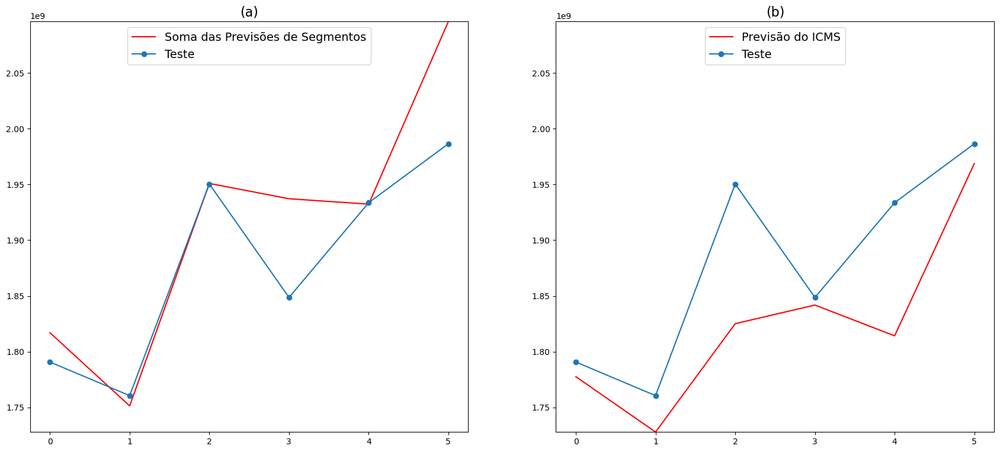

In [ ]:
# Calculando a soma das previsões
soma = np.sum(predict9.iloc[:, :19].T)

# Determinando os valores máximos e mínimos para o eixo y
max_y = max(soma.max(), ZtTest.iloc[:, 19:].values.max(), predict_final_Total['TOTAL'].values.max())
min_y = min(soma.min(), ZtTest.iloc[:, 19:].values.min(), predict_final_Total['TOTAL'].values.min())

# Criando a figura
plt.figure(figsize=(21, 9))

# Primeiro subplot com título (a)
plt.subplot(1, 2, 1)
plt.plot(soma.values, 'r-')
plt.plot(ZtTest.iloc[:, 19:].values, 'o-')
legend = ('Soma das Previsões de Segmentos', 'Teste')
plt.legend(legend, loc='upper center', prop={'size': 14})
plt.ylim(min_y, max_y)
plt.title('(a)', fontsize=16)  # Adicionando o título (a)

# Segundo subplot com título (b)
plt.subplot(1, 2, 2)
plt.plot(predict_final_Total['TOTAL'].values, 'r-')
plt.plot(ZtTest.iloc[:, 19:].values, 'o-')
legenda = ('Previsão do ICMS', 'Teste')
plt.legend(legenda, loc='upper center', prop={'size': 14})
plt.ylim(min_y, max_y)
plt.title('(b)', fontsize=16)  # Adicionando o título (b)

# Exibindo a figura
plt.show()


In [ ]:
mape = mean_absolute_percentage_error(ZtTest.iloc[:, 19:].values, soma.values)*100
mae = mean_absolute_error(ZtTest.iloc[:, 19:].values, soma.values)
rmse = math.sqrt(mean_squared_error(ZtTest.iloc[:, 19:].values, soma.values))

print(f'Modelo REDES NEURAIS SOMA: MAPE = {mape};  rmse = {rmse} ;  mae = {mae}')

Modelo REDES NEURAIS SOMA: MAPE = 2.0668348978292386;  rmse = 58684236.14581135 ;  mae = 39273033.216584004


In [ ]:
mape = mean_absolute_percentage_error(ZtTest.iloc[:, 19:].values, predict_final_Total['TOTAL'].values)*100
mae = mean_absolute_error(ZtTest.iloc[:, 19:].values, predict_final_Total['TOTAL'].values)
rmse = math.sqrt(mean_squared_error(ZtTest.iloc[:, 19:].values, predict_final_Total['TOTAL'].values))

print(f'Modelo REDES NEURAIS ICMS: MAPE = {mape};  rmse = {rmse} ;  mae = {mae}')

Modelo REDES NEURAIS ICMS: MAPE = 2.743011380174673;  rmse = 72556630.52143082 ;  mae = 52536399.92771244
